Modelling with the dataset generated from 04b_joining_datasets

## Import Modules

In [2]:
from sklearn.preprocessing import OrdinalEncoder
from concurrent.futures import ProcessPoolExecutor
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

## Variables

In [180]:
import pandas as pd
import numpy as np
import shap
import optuna
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_absolute_percentage_error
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
import xgboost as xgb
import lightgbm as lgb
import catboost as cb
import openpyxl
import os
import warnings
import pickle

warnings.filterwarnings("ignore")


class ModelTrainer:
    def __init__(self, df, target_col, id_cols=[], drop_cols=[], model_type='xgboost', notes=''):
        self.df = df
        self.target_col = target_col
        self.id_cols = id_cols
        self.drop_cols = drop_cols
        self.model_type = model_type.lower()
        self.notes = notes
        self.now = datetime.now()
        self.date = self.now.strftime('%Y-%m-%d')
        self.time = self.now.strftime('%H:%M:%S')

    def prepare_data(self, test_size=0.2, random_state=42, stratifyby=None):
        # Select the stratify column only from the dataframe 
        if stratifyby is not None:
            self.stratify = True
            stratify = self.df[stratifyby]
        target = self.df[self.target_col] # Extract the target feature

        # Train test split, with stratified (if exists)
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(
            self.df, target, test_size=test_size, random_state=random_state, stratify=stratify
        )

        # Collect the column to stratify by for the training data
        if stratifyby is not None:
            self.X_train_stratify = self.X_train[stratifyby]
        self.train_ids = self.X_train[self.id_cols]
        self.test_ids = self.X_test[self.id_cols]
        # Remove columns not needed for training e.g. id cols and stratify cols
        self.X_train = self.X_train.drop(columns=[self.target_col] + self.id_cols + self.drop_cols, errors='ignore')
        self.X_test = self.X_test.drop(columns=[self.target_col] + self.id_cols + self.drop_cols, errors='ignore')

        # Save the feature names from remaining features
        self.feature_names = self.X_train.columns.tolist()  # Save feature names

    def tune_hyperparams(self, n_trials=20, timeout=300):
        def objective(trial):
            params = self.suggest_params(trial)
            model = self.init_model(params)
            if self.stratify:
                stratifyby = self.X_train_stratify 
            X_train_val, X_val, y_train_val, y_val = train_test_split(self.X_train, self.y_train, stratify=stratifyby, test_size=0.2, random_state=42)
            model.fit(X_train_val, y_train_val)
            pred = model.predict(X_val)
            return mean_squared_error(y_val, pred)

        study = optuna.create_study(direction="minimize", study_name=None)
        study.optimize(objective, n_trials=n_trials, timeout=timeout)
        self.best_params = study.best_params

    def suggest_params(self, trial):
        if self.model_type == 'xgboost':
            return {
                "n_estimators": trial.suggest_int("n_estimators", 50, 300),
                "max_depth": trial.suggest_int("max_depth", 3, 20),
                "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),
                "subsample": trial.suggest_float("subsample", 0.5, 1.0),
                "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
                "gamma": trial.suggest_int("gamma", 0, 1),
                "reg_alpha": trial.suggest_int("reg_alpha", 0, 1),
                "reg_lambda": trial.suggest_int("reg_lambda", 0, 1),
            }
        elif self.model_type == 'lightgbm':
            return {
                "n_estimators": trial.suggest_int("n_estimators", 100, 1000), # 100, 500),
                "max_depth": trial.suggest_int("max_depth", 3, 15), # 3, 6),
                "learning_rate": trial.suggest_float("learning_rate", 1e-4, 0.3, log=True), # 0.01, 0.15, log=True),
                "num_leaves": trial.suggest_int("num_leaves", 20, 150), # 20, 40),
                "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 20, 60),
                "feature_fraction": trial.suggest_float("feature_fraction", 0.7, 1.0),
                "bagging_fraction": trial.suggest_float("bagging_fraction", 0.7, 1.0),
                "bagging_freq": trial.suggest_int("bagging_freq", 1, 3),

                "min_child_samples": trial.suggest_int("min_child_samples", 5, 100),
                "subsample": trial.suggest_float("subsample", 0.6, 1.0),
                "colsample_by_tree": trial.suggest_float("colsample_by_tree", 0.6, 1.0),
                "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 10.0, log=True),
                'reg_lambda': trial.suggest_float("reg_lambda", 1e-8, 10.0, log=True)
            }
        elif self.model_type == 'catboost':
            return {
                # "iterations": trial.suggest_int("iterations", 50, 300),
                # "depth": trial.suggest_int("depth", 3, 10),
                # "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.3, log=True),


                'depth': trial.suggest_int("depth", 3, 10),
                'learning_rate': trial.suggest_float("learning_rate", 1e-4, 0.3, log=True),
                'l2_leaf_reg': trial.suggest_float("l2_leaf_reg", 1e-2, 10.0, log=True),
                'iterations': trial.suggest_int("iterations", 300, 1500),
                'bagging_temperature': trial.suggest_float("bagging_temperature", 0.0, 1.0),
                'random_strength': trial.suggest_float("random_strength", 0.0, 1.0),
                'rsm': trial.suggest_float("rsm", 0.6, 1.0),  # Like colsample_bytree
                'border_count': trial.suggest_int("border_count", 32, 255),  # For quantisation
            }
        elif self.model_type == 'random_forest':
            return {
                "n_estimators": trial.suggest_int("n_estimators", 100, 500),
                "max_depth": trial.suggest_int("max_depth", 5, 20),
                "max_features": trial.suggest_categorical("max_features", ["sqrt", "log2", None]),
                "min_samples_split": trial.suggest_int("min_samples_split", 2, 10),
                "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 10)
            }
        elif self.model_type == 'svr':
            return {
                "C": trial.suggest_float("C", 0.1, 100.0, log=True),
                "epsilon": trial.suggest_float("epsilon", 0.01, 1.0),
                "kernel": trial.suggest_categorical("kernel", ["linear", "rbf", "poly"])
            }

    def init_model(self, params):
        if self.model_type == 'xgboost':
            return xgb.XGBRegressor(random_state=42, **params)
        elif self.model_type == 'lightgbm':
            return lgb.LGBMRegressor(random_state=42, **params)
        elif self.model_type == 'catboost':
            return cb.CatBoostRegressor(random_state=42, **params, verbose=0)
        elif self.model_type == 'random_forest':
            return RandomForestRegressor(**params)
        elif self.model_type == 'svr':
            return SVR(**params)
        else:
            raise ValueError(f"Unsupported model type: {self.model_type}")

    def train_final_model(self, use_log_target=False, custom_params={}, save_model=False):
        if use_log_target:
            self.log_y_train = np.log1p(self.y_train)
            self.log_y_test = np.log1p(self.y_test)
            y_train = self.log_y_train
            y_test = self.log_y_test
        else:
            y_train = self.y_train
            y_test = self.y_test

        params = self.best_params if hasattr(self, 'best_params') else custom_params
        self.model = self.init_model(params)
        self.model.fit(self.X_train, y_train)

        self.log_y_pred_train = self.model.predict(self.X_train)
        self.log_y_pred_test = self.model.predict(self.X_test)

        if use_log_target:
            self.y_pred_train = np.expm1(self.log_y_pred_train)
            self.y_pred_test = np.expm1(self.log_y_pred_test)
        else:
            self.y_pred_train = self.log_y_pred_train
            self.y_pred_test = self.log_y_pred_test
        if save_model:
            model_filename = f"./data/modelling/models/{datetime.now().strftime(format='%Y%m%d_%H%M')}_{self.model_type}.pkl"
            pickle.dump(self.model, open(model_filename, 'wb'))

    def evaluate(self):
        def metrics(y_true, y_pred, prefix):
            return {
                f'{prefix}rmse': np.sqrt(mean_squared_error(y_true, y_pred)),
                f'{prefix}mae': mean_absolute_error(y_true, y_pred),
                f'{prefix}r2': r2_score(y_true, y_pred),
                f'{prefix}mape': mean_absolute_percentage_error(y_true, y_pred)
            }

        # Determine if log was used from model training
        use_log_target = (
            np.any(self.y_train <= 0)
            or np.any(self.y_test <= 0)
            or np.any(self.y_pred_train <= 0)
            or np.any(self.y_pred_test <= 0)
        ) is False and (
            np.allclose(np.log1p(self.y_train), np.log1p(np.expm1(self.y_train)))
        ) is False

        self.metrics = {}

        # Metrics in original scale
        self.metrics.update(metrics(self.y_train, self.y_pred_train, 'train_'))
        self.metrics.update(metrics(self.y_test, self.y_pred_test, ''))

        # If training was done in log scale, also compute log metrics
        if hasattr(self, "log_y_train") and hasattr(self, "log_y_pred_train"):
            self.metrics.update(metrics(self.log_y_train, self.log_y_pred_train, 'log_train_'))
            self.metrics.update(metrics(self.log_y_test, self.log_y_pred_test, 'log_'))



    def compute_feature_importances(self):
        self.importances = {}
        self.feature_names = self.X_train.columns.tolist()

        if hasattr(self.model, 'feature_importances_'):
            self.importances['builtin'] = self.model.feature_importances_

        try:
            explainer = shap.Explainer(self.model, self.X_test)
            shap_values = explainer(self.X_test)
            self.importances['shap'] = np.abs(shap_values.values).mean(axis=0)
        except:
            self.importances['shap'] = [np.nan] * len(self.feature_names)

        try:
            rfe = RFE(self.model, n_features_to_select=5)
            rfe.fit(self.X_train, self.y_train)
            self.importances['rfe'] = rfe.ranking_
        except:
            self.importances['rfe'] = [np.nan] * len(self.feature_names)

        try:
            perm = permutation_importance(self.model, self.X_test, self.y_test)
            self.importances['permutation'] = perm.importances_mean
        except:
            self.importances['permutation'] = [np.nan] * len(self.feature_names)

        try:
            if self.model_type == 'xgboost':
                gain_importance = self.model.get_booster().get_score(importance_type='gain')
                self.importances['gain'] = [gain_importance.get(f, 0) for f in self.feature_names]
            elif self.model_type == 'lightgbm':
                self.importances['gain'] = self.model.booster_.feature_importance(importance_type='gain')
            elif self.model_type == 'catboost':
                self.importances['gain'] = self.model.get_feature_importance(type='PredictionValuesChange')
        except:
            self.importances['gain'] = [np.nan] * len(self.feature_names)

    def save_results(self, model_log_path='model_results.xlsx', importance_log_path='feature_importances.xlsx'):
        row = {
            'date': self.date,
            'time': self.time,
            'model_type': self.model_type,
            'experiment_notes': self.notes,
            'conclusion': ''
        }
        row.update(self.metrics)
        row.update({f'param_{k}': v for k, v in self.model.get_params().items()})
        row['feature_names'] = ', '.join(self.feature_names)
        df_metrics = pd.DataFrame([row])

        if os.path.exists(model_log_path):
            old = pd.read_excel(model_log_path)
            df_metrics = pd.concat([old, df_metrics], ignore_index=True)
        df_metrics.to_excel(model_log_path, index=False)

        if importance_log_path != "":
            importance_df = pd.DataFrame({f: imp for f, imp in self.importances.items()}, index=self.feature_names).reset_index()
            
            importance_df.insert(1, 'date', self.date)
            importance_df.insert(2, 'time', self.time)
            importance_df.insert(3, 'model_type', self.model_type)
            importance_df.insert(4, 'notes', self.notes)

            if os.path.exists(importance_log_path):
                old = pd.read_excel(importance_log_path)
                importance_df = pd.concat([old, importance_df], ignore_index=True)
            importance_df.to_excel(importance_log_path, index=False)


In [ ]:
# Most recent image - any cloud level - experiment 1, 2
# DATASET_FILENAME = "data/modelling/model_csvs/250803_1745_model_dataset_minmaxscaler_allfeatures.csv"

# Most recent non-cloud image - experiment 3, 4, 5, 6, 7, 8
# DATASET_FILENAME = "data/modelling/model_csvs/250803_1743_model_dataset_minmaxscaler_least_cloudy.csv"

# Most recent non-cloud image, plus SAVI and another index for sentinel and landsat - experiment 9
# DATASET_FILENAME = "data/modelling/model_csvs/250805_1728_model_dataset_minmaxscaler_allfeatures_more_indexes.csv"

# Most recent low-cloud within last 365 days - experiment 10
# DATASET_FILENAME = "data/modelling/model_csvs/250807_1633_365days_recent_lowestcloud_minmaxscaler_allfeatures.csv"

# Median values for low-cloud (under 20% cloud prob S2) in last 31 days - experiment 11
# DATASET_FILENAME = "data/modelling/model_csvs/250807_1741_31days_median_lowestcloud_minmaxscaler_allfeatures.csv"

# Median value for low cloud in last year - experiment 12
# DATASET_FILENAME = "data/modelling/model_csvs/250807_1756_365days_median_lowestcloud_minmaxscaler_allfeatures.csv"

# Least cloudy image in last 31 days, with indexes from LS and S2 - experiment 13
# DATASET_FILENAME = "data/modelling/model_csvs/250808_0920_31days_lowestcloud_minmaxscaler_allfeatures.csv"

# Least cloudy image last 31 days, all features, NDVI and SAVI from landsat
DATASET_FILENAME = "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv"

# Least cloudy image in last 6 months, in 1 month windows for sentinel, 2 month windows for landsat 
# DATASET_FILENAME = "data/modelling/model_csvs/250809_1216_lowestcloud_last6months_1to2monthwindows_minmaxscaler_allfeatures.csv"

# Median of lower cloud images in the last 6 months
# DATASET_FILENAME = "data/modelling/model_csvs/250809_1538_lowcloudmedian_182days_minmaxscaler_allfeatures.csv"

df = pd.read_csv(DATASET_FILENAME)

In [281]:
# BASELINE - most recent image - Experiment 101, 102 (with changed stratifying)
# DATASET_FILENAME = "data/modelling/model_csvs/250809_2047_baseline_mostrecent_minmaxscaler_allfeatures.csv"
# DATASET_FILENAME = "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv" # attempt to get lower score

# # 103-104: Least cloudy image last 31 days, all features, NDVI and SAVI from landsat - Experiment 103, 104
# DATASET_FILENAME = "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv"
# NOTES = "Experiment 103: Least cloudy image last 31 days, stratify by LC0_Desc"

# LOWEST CLOUD IMAGES - WITHIN TIME WINDOWS ----------------------------------------------------------------------------------
# # 105: Least cloud image last 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv"
# NOTES = 'Experiment 105: least cloudy 62 days, stratified by LC0_Desc and OC in 10 bins.'

# # 106: Least cloud image last 93 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1000_leastcloudy_93days_allfeatures.csv"
# NOTES = 'Experiment 106: least cloudy 93 days stratified by LC0_Desc and OC in 10 bins.'

# # 107: Least cloud image last 182 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1004_leastcloudy_182days_allfeatures.csv"
# NOTES = 'Experiment 107: least cloudy 182 days stratified by LC0_Desc and OC in 10 bins.'

# # 108: Least cloud image last 365 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1006_leastcloudy_365days_allfeatures.csv"
# NOTES = 'Experiment 108: least cloudy 365 days stratified by LC0_Desc and OC in 10 bins.'

# LOWEST CLOUD IMAGES - WITHIN TIME WINDOWS ----------------------------------------------------------------------------------
# # 109: Most recent low cloud image last 31 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1122_closest_underthresh_31days_allfeatures.csv"
# NOTES = 'Experiment 109: CLosest image under 20 cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.'

# # 110: Most recent low cloud image last 62 days - under 12
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1127_closest_under12_62days_allfeatures.csv"
# NOTES = 'Experiment 110: CLosest image under 12 within 62 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.'

# # 111: Most recent low cloud image last 93 days - under 5
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1141_closest_under5_93days_allfeatures.csv"
# NOTES = 'Experiment 111: CLosest image under 5 within 93 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.'

# # 112: Most recent low cloud image under 3 within last 182 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1308_closest_under3_182days_allfeatures.csv"
# NOTES = "Experiment 112: closest image under cloud_mean 3 within 182 days of survey date. All features."

# # 113: Most recent low cloud image under 2 within last 365 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1313_closest_under2_365days_allfeatures.csv"
# NOTES = "Experiment 113: closest image under cloud_mean 2 within 365 days of survey date. All features."

# # 114: No satellite imagery
# DATASET_FILENAME = "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv" # attempt to get lower score
# NOTES = "Experiment 114: no satellite imagery"

# # 115: Median of cloud_mean <=20 for SR in 31 days, clear==0 for LS in 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1335_median_under20_31to62days_allfeatures.csv"
# NOTES = "Experiment 115: REDO (error before - ignore it) Median of low cloud images (<20 or clear==True) in 31 and 62 days"

# # 116: Median of cloud_mean <=20 for SR in 62 days, clear==0 for LS in 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1355_median_under20_62days_allfeatures.csv"
# NOTES = "Experiment 116: Median of low cloud images (<20 or clear==True) in 62 days"

# # 117: Median of cloud_mean <=20 for SR in 93 days, clear==0 for LS in 93 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1358_median_under20_93days_allfeatures.csv"
# NOTES = "Experiment 117: Median of low cloud images (<20 or clear==True) in 93 days"

# # 118, : Median of cloud_mean <=20 for SR in 182 days, clear==0 for LS in 182 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1402_median_under20_182days_allfeatures.csv"
# NOTES = "Experiment 118: Median of low cloud images (<20 or clear==True) in 182 days"
# NOTES = "Experiment 125: Running Feature Selection. Median of low cloud images (<20 or clear==True) in 182 days"


# # 119: Median of cloud_mean <=20 for SR in 365 days, clear==0 for LS in 365 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1406_median_under20_365days_allfeatures.csv"
# NOTES = "Experiment 119: Median of low cloud images (<20 or clear==True) in 365 days"

# # 120: Mean of cloud_mean <=20 for SR in 31 days, clear==0 for LS in 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1434_mean_under20_31to62days_allfeatures.csv"
# NOTES = "Experiment 120: Mean of low cloud images (<20 or clear==True) in 31 days for sentinel, 62 for landsat"

# # 121: Mean of cloud_mean <=20 for SR in 62 days, clear==0 for LS in 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1437_mean_under20_62days_allfeatures.csv"
# NOTES = "Experiment 121: Mean of low cloud images (<20 or clear==True) in last 62 days"

# # 122: Mean of cloud_mean <=20 for SR in 93 days, clear==0 for LS in 93 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1439_mean_under20_93days_allfeatures.csv"
# NOTES = "Experiment 122: Mean of low cloud images (<20 or clear==True) in last 93 days"

# # 123: Mean of cloud_mean <=20 for SR in 182 days, clear==0 for LS in 182 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1442_mean_under20_182days_allfeatures.csv"
# NOTES = "Experiment 123: Mean of low cloud images (<20 or clear==True) in last 182 days"

# # 124: Mean of cloud_mean <=20 for SR in 182 days, clear==0 for LS in 365 days
# DATASET_FILENAME = "data/modelling/model_csvs/250810_1445_mean_under20_365days_allfeatures.csv"
# NOTES = "Experiment 124: Mean of low cloud images (<20 or clear==True) in last 365 days"

# # 125: 5x5 pixel array - lowest cloud last 31 days
# DATASET_FILENAME = "data/modelling/model_csvs/250811_0739_5x5window_lowestcloud_31days_allfeatures.csv"
# NOTES = "Experiment 125: 5x5 window, lowest cloud last 31 days, stratified by LC0_Desc AND OC"

# # 126: 7x7 pixel array - lowest cloud last 31 days
# DATASET_FILENAME = "data/modelling/model_csvs/250811_0748_7x7window_lowestcloud_31days_allfeatures.csv"
# NOTES = "Experiment 126: 7x7 window, lowest cloud last 31 days, stratified by LC0_Desc"

# # 127: 9x9 pixel array - lowest cloud last 31 days
# DATASET_FILENAME = "data/modelling/model_csvs/250811_0802_9x9window_lowestcloud_31days_allfeatures.csv"
# NOTES = "Experiment 127: 9x9 window, lowest cloud last 31 days, stratified by LC0_Desc"

# # 128: 11x11 pixel array - lowest cloud last 31 days
# DATASET_FILENAME = "data/modelling/model_csvs/250811_0804_11x11window_lowestcloud_31days_allfeatures.csv"
# NOTES = "Experiment 128: 11x11 window, lowest cloud last 31 days, stratified by LC0_Desc"

# # 129: Least cloud image last 62 days - REPEAT 130
# DATASET_FILENAME = "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv"
# NOTES = 'Experiment 129: Repeat 105 for feature selection - least cloudy 62 days, stratified by LC0_Desc only.'
# NOTES = "Experiment 130: top 10 features for 105 - LC0_Desc stratify"
# NOTES = "Experiment 131: REDO top 20 features for 105 - LC0_Desc stratify"
# NOTES = 'Experiment 132: Repeat top 30 features - least cloudy 62 days, stratified by LC0_Desc only.'
# NOTES = 'Experiment 133: Repeat top 40 features - least cloudy 62 days, stratified by LC0_Desc only.'
# NOTES = 'Experiment 134: Repeat top 50 features - least cloudy 62 days, stratified by LC0_Desc only.'
# NOTES = 'Experiment 135: Repeat top 45 features - least cloudy 62 days, stratified by LC0_Desc only.'

# # 136: Aggregations by time - OC top features only (top 45)
# DATASET_FILENAME = "data/modelling/model_csvs/250814_0831_OC_timeseries.csv"
# NOTES = 'Experiment 136: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 6.'
# NOTES = 'Experiment 137: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 2 for sentinel and 3 for landsat.'
# NOTES = 'Experiment 138: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 3 for sentinel and 3 for landsat.'
# NOTES = 'Experiment 139: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 4 for sentinel and 3 for landsat.'
# NOTES = 'Experiment 140: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 5 for sentinel and 3 for landsat.'
# NOTES = 'Experiment 141: Top 45 features, aggregated by least cloudy in 1 month periods for s2, 3 months for ls, up to 6 for sentinel and 3 for landsat.'

# # 142: Least cloud image last 62 days - Cropland only
DATASET_FILENAME = "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv"
# NOTES = 'Experiment 142: least cloudy 62 days, cropland only, stratify by OC binned.'
# NOTES = 'Experiment 143: least cloudy 62 days, woodland only, stratify by OC binned.'
# NOTES = 'Experiment 144: all features, least cloudy 62 days, cropland only, stratify by OC binned.'
# NOTES = 'Experiment 145: all features, least cloudy 62 days, woodland only, stratify by OC binned.'
# NOTES = 'Experiment 147: all features, least cloudy 62 days, woodland only, stratify by OC binned in 20 bins.'
# NOTES = 'Experiment 148: all features, least cloudy 62 days, woodland only, no stratify.'
# NOTES = 'Experiment 149: Top 45 features - removing LU1.'
# NOTES = 'Experiment 146: Top 60 features.'

# # 149: Least cloud image last 62 days - REPEAT 130
# DATASET_FILENAME = "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv"
# NOTES = 'Experiment 149: training to get predictions, to train on a model with nitrogen. least cloudy 62 days, stratified by LC0_Desc only.'

# # 150: Aggregated weather and least cloudy images last 62 days
# DATASET_FILENAME = "data/modelling/model_csvs/250814_1647_OC_aggregated_weather.csv"
# NOTES = 'Experiment 150: Adding weather aggregations, least cloudy 62 days, stratified by LC0_Desc only.'
# NOTES = 'Experiment 151: Train on Cropland only. Adding weather aggregations, least cloudy 62 days, stratified by LC0_Desc only.'

NOTES = "Experiment 110: Retraining with top 45 features for testing on cropland only"
NOTES = "Experiment 153: Train without outliers, top 45 features."


# 154 redo 31 days lowest cloud - with weather (wind and rainfall and cloud cover)
DATASET_FILENAME = "data/modelling/model_csvs/250826_1235_all_features.csv"
NOTES = "Experiment 154: Redo least cloudy 31 days image - including rainfall, cloud and dropping LS variables"

DATASET_FILENAME = "data/modelling/model_csvs/250826_1248_62day_lowestcloud.csv"
NOTES = "Experiment 155: Redo least cloudy 62 days image - including rainfall, cloud and dropping LS variables"



df = pd.read_csv(DATASET_FILENAME)

In [282]:
df.columns.values

array(['point_id', 'Elev', 'LC0_Desc', 'LU1_Desc', 'parcel_area_ha',
       'crop_residues', 'lm_grass_margins', 'grazing', 'LC1_Grouped',
       'soil_stones_perc', 'OC', 'N', 'sr_AOT_mean', 'sr_B1_mean',
       'sr_B2_mean', 'sr_B3_mean', 'sr_B4_mean', 'sr_B5_mean',
       'sr_B6_mean', 'sr_B7_mean', 'sr_B8_mean', 'sr_B8A_mean',
       'sr_B9_mean', 'sr_B11_mean', 'sr_B12_mean', 'sr_WVP_mean',
       'sr_cloud_mean', 'sr_NDVI', 'sr_moisture_index', 'sr_EVI',
       'sr_SAVI', 'sr_days_diff', 'ls_SR_B1', 'ls_SR_B2', 'ls_SR_B3',
       'ls_SR_B4', 'ls_SR_B5', 'ls_SR_B6', 'ls_SR_B7', 'ls_SR_QA_AEROSOL',
       'ls_ST_ATRAN', 'ls_ST_B10', 'ls_ST_CDIST', 'ls_ST_DRAD',
       'ls_ST_EMIS', 'ls_ST_EMSD', 'ls_ST_QA', 'ls_ST_TRAD', 'ls_ST_URAD',
       'ls_days_diff', 'ls_clear', 'ls_NDVI', 'ls_SAVI', 's1_VV_mean',
       's1_VH_mean', 's1_days_diff', 'temperature_2m_max',
       'temperature_2m_min', 'rain_sum', 'daylight_duration',
       'wind_gusts_10m_max', 'et0_fao_evapotranspiration', 

In [182]:
# Train without satellite imagery
# cols = df.columns.values
# cols = [col for col in cols if not col.startswith("sr_m3_")]
# cols = [col for col in cols if not col.startswith("sr_m4_")]
# cols = [col for col in cols if not col.startswith("sr_m5_")]
# cols = [col for col in cols if not col.startswith("sr_m6_")]
# cols = [col for col in cols if not col.startswith("ls_m4to6")]

# df = df[cols]

In [ ]:
# # Calculate IQR for the 'OC' column
# Q1 = df['OC'].quantile(0.25)
# Q3 = df['OC'].quantile(0.75)
# IQR = Q3 - Q1

# # Define lower and upper bounds
# lower_bound = Q1 - 1.5 * IQR
# upper_bound = Q3 + 1.5 * IQR

# # Filter the DataFrame to remove outliers
# df = df[(df['OC'] >= lower_bound) & (df['OC'] <= upper_bound)]


In [275]:
len(df)

15098

In [172]:
all_weather = ['temperature_2m_max',
       'daylight_duration', 'et0_fao_evapotranspiration',
       'relative_humidity_2m_min', 'relative_humidity_2m_max',
       'soil_temperature_7_to_28cm_max', 'soil_moisture_0_to_7cm_mean',
       'w0_mean_rain_sum', 'w0_mean_wind_gusts_10m_max',
       'w0_mean_cloud_cover_min', 'w0_mean_cloud_cover_max',
       'w2_mean_rain_sum', 'w2_mean_wind_gusts_10m_max',
       'w2_mean_cloud_cover_min', 'w2_mean_cloud_cover_max',
       'w4_mean_rain_sum', 'w4_mean_wind_gusts_10m_max',
       'w4_mean_cloud_cover_min', 'w4_mean_cloud_cover_max']

In [ ]:
N_FEATURES = 45

TOP_FEATURES_FILE = "experiment_tracking/feature_importance/top_features.csv"
top_features = pd.read_csv(TOP_FEATURES_FILE)
top_features = top_features.sort_values(by='OC Ranking', ascending=True)
features_in_order = top_features['Feature'].tolist()

features_to_model = list(set(['OC', 'point_id'] + features_in_order[:N_FEATURES]) 
                            #  + all_weather)
                             )

df = df[features_to_model]

In [175]:
# SELECT CROPLAND LAND ONLY 
df = df[df['LC0_Desc'] == 'Cropland']
df = df.drop(columns=['LC0_Desc', 'LU1_Desc'])

In [176]:
len(df)

6510

In [283]:
# Convert to ordinal encoding
cat_cols = [
    'LC0_Desc', 
            'LU1_Desc', 
            'LC1_Grouped'
            ]

encoder = OrdinalEncoder()
enc_df = df.copy()
enc_df[cat_cols] = encoder.fit_transform(enc_df[cat_cols])

enc_df = enc_df.replace({True: 1,
                 False: 0,
                 '< 0.5 ha': 0,
                 '0.5 - 1 ha': 1,
                 '1 - 10 ha': 2,
                 '> 10 ha': 3})

In [284]:
enc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15419 entries, 0 to 15418
Data columns (total 69 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   point_id                        15419 non-null  int64  
 1   Elev                            15419 non-null  float64
 2   LC0_Desc                        15419 non-null  float64
 3   LU1_Desc                        15419 non-null  float64
 4   parcel_area_ha                  15419 non-null  int64  
 5   crop_residues                   15419 non-null  int64  
 6   lm_grass_margins                15419 non-null  int64  
 7   grazing                         15419 non-null  int64  
 8   LC1_Grouped                     15419 non-null  float64
 9   soil_stones_perc                15419 non-null  float64
 10  OC                              15419 non-null  float64
 11  N                               15419 non-null  float64
 12  sr_AOT_mean                     

In [285]:
# Code to stratify by OC or N level - bucket into categories
enc_df['OC_binned'] = pd.qcut(enc_df['OC'], q=20, labels=False)

# Stratify by OC and LC0_Desc
# enc_df['stratify_bin'] = enc_df['LC0_Desc'].astype(str) + "_" + enc_df['OC_binned'].astype(str)
# enc_df = enc_df.drop(columns=['OC_binned'])

In [286]:
# # Train without satellite imagery
# cols = enc_df.columns.values
# cols = [col for col in cols if not col.startswith("sr_")]
# cols = [col for col in cols if not col.startswith("ls_")]
# cols = [col for col in cols if not col.startswith("s1_")]

# enc_df = enc_df[cols]

In [287]:
# NOTES = 'Experiment 102 repeat for repeatability - baseline stratified by LC0_Desc and OC in 10 bins.'

# List of model types to run
model_types = [
    # 'xgboost', 
    'lightgbm', 
    # 'catboost', 
            #    'random_forest', 
            #    'svr'
               ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT', 'OC_binned', 'N', 'date']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = "LC0_Desc" # 'OC_binned' #  'stratify_bin' # 
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
for model_type in model_types:
    print(f"\nTraining model: {model_type.upper()}")
    trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
    trainer.prepare_data(test_size=TEST_SIZE, 
                         stratifyby=stratifyby
                        )

    if TUNE:
        trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
        trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
    else:
        trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

    trainer.evaluate()
    trainer.compute_feature_importances()
    trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-26 12:49:22,237] A new study created in memory with name: no-name-043e0fc7-6d15-43b0-8dbe-2efb83bdec84



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7638031107902881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7638031107902881
[LightGBM] [Warning] bagging_fraction is set=0.7830063868247247, subsample=0.8096138811978847 will be ignored. Current value: bagging_fraction=0.7830063868247247
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7638031107902881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7638031107902881
[LightGBM] [Warning] bagging_fraction is set=0.783

[I 2025-08-26 12:49:22,531] Trial 0 finished with value: 4067.626649053854 and parameters: {'n_estimators': 291, 'max_depth': 4, 'learning_rate': 0.026722378578140443, 'num_leaves': 88, 'min_data_in_leaf': 40, 'feature_fraction': 0.7638031107902881, 'bagging_fraction': 0.7830063868247247, 'bagging_freq': 3, 'min_child_samples': 56, 'subsample': 0.8096138811978847, 'colsample_by_tree': 0.7612361395546698, 'reg_alpha': 0.005212289412966653, 'reg_lambda': 2.986717849814104e-05}. Best is trial 0 with value: 4067.626649053854.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:26,272] Trial 1 finished with value: 4107.307692852087 and parameters: {'n_estimators': 817, 'max_depth': 10, 'learning_rate': 0.001845563819407268, 'num_leaves': 94, 'min_data_in_leaf': 36, 'feature_fraction': 0.7606197683803112, 'bagging_fraction': 0.7456050633359813, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.8116192502022974, 'colsample_by_tree': 0.992840622072464, 'reg_alpha': 0.3321092674582609, 'reg_lambda': 2.8699903175863132e-06}. Best is trial 0 with value: 4067.626649053854.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7606197683803112, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7606197683803112
[LightGBM] [Warning] bagging_fraction is set=0.7456050633359813, subsample=0.8116192502022974 will be ignored. Current value: bagging_fraction=0.7456050633359813
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] U

[I 2025-08-26 12:49:28,106] Trial 2 finished with value: 4519.263960115718 and parameters: {'n_estimators': 656, 'max_depth': 13, 'learning_rate': 0.26919782164547135, 'num_leaves': 42, 'min_data_in_leaf': 23, 'feature_fraction': 0.821443145363769, 'bagging_fraction': 0.9109122187442721, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.9360899795809476, 'colsample_by_tree': 0.6861494438372144, 'reg_alpha': 0.00036679532666619323, 'reg_lambda': 0.424692018131213}. Best is trial 0 with value: 4067.626649053854.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.821443145363769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.821443145363769
[LightGBM] [Warning] bagging_fraction is set=0.9109122187442721, subsample=0.9360899795809476 will be ignored. Current value: bagging_fraction=0.9109122187442721
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8737389561174341, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8737389561174341
[LightGBM] [Warning] bagging_fraction is set=0.983778878687371, subsample=0.76

[I 2025-08-26 12:49:28,772] Trial 3 finished with value: 4859.477211681016 and parameters: {'n_estimators': 512, 'max_depth': 4, 'learning_rate': 0.0007506711176815085, 'num_leaves': 134, 'min_data_in_leaf': 42, 'feature_fraction': 0.8737389561174341, 'bagging_fraction': 0.983778878687371, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.7610944874475202, 'colsample_by_tree': 0.9918562554396522, 'reg_alpha': 0.007008355416678293, 'reg_lambda': 1.5603417535291526}. Best is trial 0 with value: 4067.626649053854.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:29,106] Trial 4 finished with value: 4583.7540546927385 and parameters: {'n_estimators': 492, 'max_depth': 3, 'learning_rate': 0.2398899737805022, 'num_leaves': 140, 'min_data_in_leaf': 59, 'feature_fraction': 0.9338584736568599, 'bagging_fraction': 0.8933926717277104, 'bagging_freq': 3, 'min_child_samples': 92, 'subsample': 0.852483340302895, 'colsample_by_tree': 0.6221931132075338, 'reg_alpha': 3.855207626914704e-05, 'reg_lambda': 1.3300549963828682e-08}. Best is trial 0 with value: 4067.626649053854.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9338584736568599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9338584736568599
[LightGBM] [Warning] bagging_fraction is set=0.8933926717277104, subsample=0.852483340302895 will be ignored. Current value: bagging_fraction=0.8933926717277104
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8756040887707346, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8756040887707346
[LightGBM] [Warning] bagging_fraction is set=0.7152940584120897, subsample=0.

[I 2025-08-26 12:49:30,248] Trial 5 finished with value: 4059.4296848764684 and parameters: {'n_estimators': 531, 'max_depth': 8, 'learning_rate': 0.014678613970857521, 'num_leaves': 115, 'min_data_in_leaf': 45, 'feature_fraction': 0.8756040887707346, 'bagging_fraction': 0.7152940584120897, 'bagging_freq': 3, 'min_child_samples': 68, 'subsample': 0.7751167960881238, 'colsample_by_tree': 0.6139236178458055, 'reg_alpha': 2.0341822046056843, 'reg_lambda': 1.0597342625557353}. Best is trial 5 with value: 4059.4296848764684.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:31,384] Trial 6 finished with value: 4058.41660423421 and parameters: {'n_estimators': 907, 'max_depth': 5, 'learning_rate': 0.007916065874137658, 'num_leaves': 51, 'min_data_in_leaf': 23, 'feature_fraction': 0.7064015883235111, 'bagging_fraction': 0.7722284136376766, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.9166276328544194, 'colsample_by_tree': 0.7560742992480425, 'reg_alpha': 1.0071207601325443e-07, 'reg_lambda': 0.22107680355975495}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:32,801] Trial 7 finished with value: 5117.621614143668 and parameters: {'n_estimators': 629, 'max_depth': 6, 'learning_rate': 0.0002890271807317159, 'num_leaves': 123, 'min_data_in_leaf': 50, 'feature_fraction': 0.7607490033202092, 'bagging_fraction': 0.7693528692056862, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.9509961422209932, 'colsample_by_tree': 0.95504711640414, 'reg_alpha': 0.00018812353706099081, 'reg_lambda': 7.870434243734184e-06}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:33,631] Trial 8 finished with value: 4058.6648484166262 and parameters: {'n_estimators': 480, 'max_depth': 6, 'learning_rate': 0.014227967649305293, 'num_leaves': 97, 'min_data_in_leaf': 42, 'feature_fraction': 0.7972619126962255, 'bagging_fraction': 0.7467778867537005, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.6779852896201983, 'colsample_by_tree': 0.7521740777800863, 'reg_alpha': 0.3958867574885986, 'reg_lambda': 0.17674683801508753}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:34,480] Trial 9 finished with value: 4196.425411946532 and parameters: {'n_estimators': 152, 'max_depth': 8, 'learning_rate': 0.008267852507531197, 'num_leaves': 110, 'min_data_in_leaf': 44, 'feature_fraction': 0.963157019759092, 'bagging_fraction': 0.8991747223673668, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.7073956778238814, 'colsample_by_tree': 0.998200725996595, 'reg_alpha': 2.3806139740574305e-05, 'reg_lambda': 4.099665690511427e-05}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:37,528] Trial 10 finished with value: 5219.3034385996725 and parameters: {'n_estimators': 976, 'max_depth': 12, 'learning_rate': 0.00013086335824832548, 'num_leaves': 45, 'min_data_in_leaf': 22, 'feature_fraction': 0.7012712362840197, 'bagging_fraction': 0.8253554528769296, 'bagging_freq': 2, 'min_child_samples': 73, 'subsample': 0.990440645456506, 'colsample_by_tree': 0.8606286308459496, 'reg_alpha': 1.2514438255266785e-08, 'reg_lambda': 0.011758242806896902}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7012712362840197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7012712362840197
[LightGBM] [Warning] bagging_fraction is set=0.8253554528769296, subsample=0.990440645456506 will be ignored. Current value: bagging_fraction=0.8253554528769296
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7224230187423637, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7224230187423637
[LightGBM] [Warning] bagging_fraction is set=0.701022292478193, subsample=0.6

[I 2025-08-26 12:49:38,088] Trial 11 finished with value: 4117.672481510509 and parameters: {'n_estimators': 337, 'max_depth': 6, 'learning_rate': 0.045912862838138176, 'num_leaves': 63, 'min_data_in_leaf': 32, 'feature_fraction': 0.7224230187423637, 'bagging_fraction': 0.701022292478193, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.6352466775009248, 'colsample_by_tree': 0.7744793325222487, 'reg_alpha': 6.317741452549218e-08, 'reg_lambda': 0.0070706521337958}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:39,440] Trial 12 finished with value: 4084.588057211506 and parameters: {'n_estimators': 831, 'max_depth': 6, 'learning_rate': 0.002867528435546264, 'num_leaves': 21, 'min_data_in_leaf': 29, 'feature_fraction': 0.8170142108063964, 'bagging_fraction': 0.8214598338137791, 'bagging_freq': 2, 'min_child_samples': 35, 'subsample': 0.6082976438190603, 'colsample_by_tree': 0.8398923737552265, 'reg_alpha': 5.573854599284114e-07, 'reg_lambda': 0.015284311624713684}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8170142108063964, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8170142108063964
[LightGBM] [Warning] bagging_fraction is set=0.8214598338137791, subsample=0.6082976438190603 will be ignored. Current value: bagging_fraction=0.8214598338137791
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-26 12:49:43,279] Trial 13 finished with value: 4348.054304173545 and parameters: {'n_estimators': 972, 'max_depth': 15, 'learning_rate': 0.06691515051079032, 'num_leaves': 61, 'min_data_in_leaf': 54, 'feature_fraction': 0.8026925006805333, 'bagging_fraction': 0.7911100710089195, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.885825960854707, 'colsample_by_tree': 0.7086962017662701, 'reg_alpha': 1.7800024789476397e-06, 'reg_lambda': 0.1016366753628351}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8026925006805333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8026925006805333
[LightGBM] [Warning] bagging_fraction is set=0.7911100710089195, subsample=0.885825960854707 will be ignored. Current value: bagging_fraction=0.7911100710089195
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7394337744899404, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7394337744899404
[LightGBM] [Warning] bagging_fraction is set=0.7425191730023601, subsample=0.

[I 2025-08-26 12:49:43,869] Trial 14 finished with value: 4155.411882304271 and parameters: {'n_estimators': 376, 'max_depth': 5, 'learning_rate': 0.004770275058649134, 'num_leaves': 71, 'min_data_in_leaf': 29, 'feature_fraction': 0.7394337744899404, 'bagging_fraction': 0.7425191730023601, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.6956616395536569, 'colsample_by_tree': 0.6976003613295081, 'reg_alpha': 9.37286846017032, 'reg_lambda': 0.0007621886061142058}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-26 12:49:46,884] Trial 15 finished with value: 4355.24790808949 and parameters: {'n_estimators': 710, 'max_depth': 9, 'learning_rate': 0.0012205845539733087, 'num_leaves': 99, 'min_data_in_leaf': 36, 'feature_fraction': 0.7905880921504813, 'bagging_fraction': 0.8607006884958784, 'bagging_freq': 3, 'min_child_samples': 27, 'subsample': 0.6810919571170934, 'colsample_by_tree': 0.8249444931322618, 'reg_alpha': 0.11614853606493072, 'reg_lambda': 2.9915580943485898}. Best is trial 6 with value: 4058.41660423421.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:48,545] Trial 16 finished with value: 4046.9671048631008 and parameters: {'n_estimators': 807, 'max_depth': 7, 'learning_rate': 0.010762768861510518, 'num_leaves': 76, 'min_data_in_leaf': 50, 'feature_fraction': 0.8541223557093977, 'bagging_fraction': 0.742436414877257, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8926757285076377, 'colsample_by_tree': 0.8864195372572047, 'reg_alpha': 0.010261563385664328, 'reg_lambda': 9.957948850099422}. Best is trial 16 with value: 4046.9671048631008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:50,926] Trial 17 finished with value: 4033.700314142145 and parameters: {'n_estimators': 845, 'max_depth': 8, 'learning_rate': 0.005804292127472056, 'num_leaves': 76, 'min_data_in_leaf': 52, 'feature_fraction': 0.9021468374152821, 'bagging_fraction': 0.8139305230003101, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8856033192253475, 'colsample_by_tree': 0.9162022649024423, 'reg_alpha': 0.01311891888603737, 'reg_lambda': 6.3313935312693035}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:49:53,842] Trial 18 finished with value: 4361.2238849497 and parameters: {'n_estimators': 756, 'max_depth': 11, 'learning_rate': 0.0921289854373669, 'num_leaves': 76, 'min_data_in_leaf': 50, 'feature_fraction': 0.9169733893822832, 'bagging_fraction': 0.8232483004076367, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.861988279140739, 'colsample_by_tree': 0.904299745248232, 'reg_alpha': 0.009164955323910326, 'reg_lambda': 8.838637894732484}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9169733893822832, colsample_bytree=1.

[I 2025-08-26 12:49:55,944] Trial 19 finished with value: 4671.804327212228 and parameters: {'n_estimators': 861, 'max_depth': 8, 'learning_rate': 0.00057207280443872, 'num_leaves': 31, 'min_data_in_leaf': 58, 'feature_fraction': 0.9905144900724719, 'bagging_fraction': 0.8589288018461017, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.9897511606351016, 'colsample_by_tree': 0.9036140439541291, 'reg_alpha': 0.02972310163839092, 'reg_lambda': 3.1943218416565336e-07}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9905144900724719, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9905144900724719
[LightGBM] [Warning] bagging_fraction is set=0.8589288018461017, subsample=0.9897511606351016 will be ignored. Current value: bagging_fraction=0.8589288018461017
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8493061323888157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8493061323888157
[LightGBM] [Warning] bagging_fraction is set=0.9555870895047447, subsample=0

[I 2025-08-26 12:49:59,328] Trial 20 finished with value: 4057.0376185333084 and parameters: {'n_estimators': 768, 'max_depth': 10, 'learning_rate': 0.0030492227464575562, 'num_leaves': 78, 'min_data_in_leaf': 50, 'feature_fraction': 0.8493061323888157, 'bagging_fraction': 0.9555870895047447, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8976147204406848, 'colsample_by_tree': 0.9015795842480486, 'reg_alpha': 0.0014408849558650975, 'reg_lambda': 0.0008320560907809888}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8546425537711619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546425537711619
[LightGBM] [Warning] bagging_fraction is set=0.9411892629176145, subsample=0.8877627528987 will be ignored. Current value: bagging_fraction=0.9411892629176145
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8546425537711619, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546425537711619
[LightGBM] [Warning] bagging_fraction is set=0.9411892629176145, subsample=0.8

[I 2025-08-26 12:50:02,530] Trial 21 finished with value: 4051.144729755914 and parameters: {'n_estimators': 764, 'max_depth': 10, 'learning_rate': 0.002867901794124041, 'num_leaves': 79, 'min_data_in_leaf': 49, 'feature_fraction': 0.8546425537711619, 'bagging_fraction': 0.9411892629176145, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8877627528987, 'colsample_by_tree': 0.907770104960523, 'reg_alpha': 0.0009811167599950597, 'reg_lambda': 0.0004938444036392585}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:50:04,281] Trial 22 finished with value: 4076.2405752781024 and parameters: {'n_estimators': 616, 'max_depth': 9, 'learning_rate': 0.01582995705825216, 'num_leaves': 60, 'min_data_in_leaf': 53, 'feature_fraction': 0.8969805097790069, 'bagging_fraction': 0.9372542170966878, 'bagging_freq': 3, 'min_child_samples': 85, 'subsample': 0.8435900780646768, 'colsample_by_tree': 0.9344818016139639, 'reg_alpha': 0.0006848453784627785, 'reg_lambda': 8.87252426867904}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-26 12:50:06,647] Trial 23 finished with value: 4065.0901037345548 and parameters: {'n_estimators': 891, 'max_depth': 7, 'learning_rate': 0.0043582913506816055, 'num_leaves': 84, 'min_data_in_leaf': 55, 'feature_fraction': 0.8498788984021737, 'bagging_fraction': 0.9866818196580436, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.9547342804133349, 'colsample_by_tree': 0.8672114206718468, 'reg_alpha': 0.047730067925255706, 'reg_lambda': 0.045838281636105246}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8498788984021737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8498788984021737
[LightGBM] [Warning] bagging_fraction is set=0.9866818196580436, subsample=0.9547342804133349 will be ignored. Current value: bagging_fraction=0.9866818196580436
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=9

[I 2025-08-26 12:50:09,501] Trial 24 finished with value: 4267.520038285488 and parameters: {'n_estimators': 687, 'max_depth': 11, 'learning_rate': 0.0014770149425833638, 'num_leaves': 68, 'min_data_in_leaf': 48, 'feature_fraction': 0.8843906917709374, 'bagging_fraction': 0.8090501857427463, 'bagging_freq': 2, 'min_child_samples': 92, 'subsample': 0.8816636598318858, 'colsample_by_tree': 0.9484491082796641, 'reg_alpha': 3.469437904810915e-05, 'reg_lambda': 1.3981716487139136e-07}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8843906917709374, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8843906917709374
[LightGBM] [Warning] bagging_fraction is set=0.8090501857427463, subsample=0.8816636598318858 will be ignored. Current value: bagging_fraction=0.8090501857427463
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9398463279487559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9398463279487559
[LightGBM] [Warning] bagging_fraction is set=0.8782643027090454, subsample=0

[I 2025-08-26 12:50:12,554] Trial 25 finished with value: 4036.1568889502446 and parameters: {'n_estimators': 761, 'max_depth': 14, 'learning_rate': 0.008278262084596097, 'num_leaves': 54, 'min_data_in_leaf': 47, 'feature_fraction': 0.9398463279487559, 'bagging_fraction': 0.8782643027090454, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.8338819840893349, 'colsample_by_tree': 0.8066169002994352, 'reg_alpha': 0.001299730028738352, 'reg_lambda': 0.0018865470500139465}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9398463279487559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9398463279487559
[LightGBM] [Warning] bagging_fraction is set=0.8782643027090454, subsample=0.8338819840893349 will be ignored. Current value: bagging_fraction=0.8782643027090454
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9312796918247671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9312796918247671
[LightGBM] [Warning] bagging_fraction is set=0.8846570541063936, subsample=0

[I 2025-08-26 12:50:14,923] Trial 26 finished with value: 4040.6370087393675 and parameters: {'n_estimators': 918, 'max_depth': 13, 'learning_rate': 0.008499282511440213, 'num_leaves': 33, 'min_data_in_leaf': 46, 'feature_fraction': 0.9312796918247671, 'bagging_fraction': 0.8846570541063936, 'bagging_freq': 3, 'min_child_samples': 86, 'subsample': 0.8348833885883062, 'colsample_by_tree': 0.8211914664521611, 'reg_alpha': 0.00451976192761646, 'reg_lambda': 0.8936497807692181}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9312796918247671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9312796918247671
[LightGBM] [Warning] bagging_fraction is set=0.8846570541063936, subsample=0.8348833885883062 will be ignored. Current value: bagging_fraction=0.8846570541063936
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9566176699244133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9566176699244133
[

[I 2025-08-26 12:50:17,236] Trial 27 finished with value: 4184.2640753473015 and parameters: {'n_estimators': 935, 'max_depth': 15, 'learning_rate': 0.0251082860641398, 'num_leaves': 35, 'min_data_in_leaf': 46, 'feature_fraction': 0.9566176699244133, 'bagging_fraction': 0.8517152615359482, 'bagging_freq': 3, 'min_child_samples': 77, 'subsample': 0.7496702415372495, 'colsample_by_tree': 0.8093934608136008, 'reg_alpha': 0.002406454051395672, 'reg_lambda': 0.0034058512090828423}. Best is trial 17 with value: 4033.700314142145.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9566176699244133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9566176699244133
[LightGBM] [Warning] bagging_fraction is set=0.8517152615359482, subsample=0.7496702415372495 will be ignored. Current value: bagging_fraction=0.8517152615359482
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9209134007658267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209134007658267
[LightGBM] [Warning] bagging_fraction is set=0.8831438270546405, subsample=0

[I 2025-08-26 12:50:18,266] Trial 28 finished with value: 4033.006340036665 and parameters: {'n_estimators': 589, 'max_depth': 14, 'learning_rate': 0.006161767450543775, 'num_leaves': 23, 'min_data_in_leaf': 56, 'feature_fraction': 0.9209134007658267, 'bagging_fraction': 0.8831438270546405, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.8307518651816451, 'colsample_by_tree': 0.7889563418697585, 'reg_alpha': 0.00010067790745771781, 'reg_lambda': 0.033411497928818173}. Best is trial 28 with value: 4033.006340036665.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9209134007658267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209134007658267
[LightGBM] [Warning] bagging_fraction is set=0.8831438270546405, subsample=0.8307518651816451 will be ignored. Current value: bagging_fraction=0.8831438270546405
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9911828260266198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9911828260266198
[LightGBM] [Warning] bagging_fraction is set=0.8746568269162923, subsample=0

[I 2025-08-26 12:50:19,364] Trial 29 finished with value: 4163.510800387054 and parameters: {'n_estimators': 581, 'max_depth': 14, 'learning_rate': 0.028716336899914787, 'num_leaves': 22, 'min_data_in_leaf': 57, 'feature_fraction': 0.9911828260266198, 'bagging_fraction': 0.8746568269162923, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.8153097721770355, 'colsample_by_tree': 0.7844895617063898, 'reg_alpha': 6.172207586268679e-06, 'reg_lambda': 8.887608911615333e-05}. Best is trial 28 with value: 4033.006340036665.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9911828260266198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9911828260266198
[LightGBM] [Warning] bagging_fraction is set=0.8746568269162923, subsample=0.8153097721770355 will be ignored. Current value: bagging_fraction=0.8746568269162923
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9209134007658267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209134007658267
[

 98%|===================| 3023/3084 [00:24<00:00]        

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9209134007658267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209134007658267
[LightGBM] [Warning] bagging_fraction is set=0.8831438270546405, subsample=0.8307518651816451 will be ignored. Current value: bagging_fraction=0.8831438270546405
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9209134007658267, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9209134007658267
[LightGBM] [Warning] bagging_fraction is set=0.8831438270546405, subsample=0

## SHAP Importance - one model

In [288]:
experiment_number = 154
model_type = 'lightgbm'

In [297]:
model = trainer.model
X_test = trainer.X_test
y_test = trainer.y_test
X_train = trainer.X_train
y_train = trainer.y_train
y_pred = trainer.y_pred_test
y_pred_train = trainer.y_pred_train
train_ids = trainer.train_ids
test_ids = trainer.test_ids

In [251]:
len(X_test)

3084

In [290]:
X_train = pd.concat([train_ids, X_train], axis=1)
X_test = pd.concat([test_ids, X_test], axis=1)
y_train = pd.concat([train_ids, y_train], axis=1)
y_test = pd.concat([test_ids, y_test], axis=1)
y_test['y_pred'] = y_pred
y_train['y_pred'] = y_pred_train

In [253]:
X_train

,point_id,ls_SR_B1,s1_VH_mean,soil_stones_perc,sr_B2_mean,sr_B8_mean,temperature_2m_max,sr_B11_mean,soil_moisture_0_to_7cm_mean,ls_SR_B4,...,relative_humidity_2m_min,sr_moisture_index,soil_temperature_7_to_28cm_max,ls_ST_B10,sr_B5_mean,sr_B6_mean,sr_B8A_mean,ls_NDVI,ls_ST_EMSD,ls_ST_EMIS
12454,51723320,0.150230,0.693890,0.01,0.071976,0.189089,0.502547,0.484845,0.621011,0.167566,...,0.618041,0.300185,0.438725,0.836582,0.146243,0.178944,0.205396,0.349642,0.004907,0.886486
6367,50424760,0.457347,0.704308,0.02,0.134207,0.236269,0.488020,0.047069,0.183972,0.434628,...,0.378693,0.883801,0.461517,0.567346,0.148852,0.213240,0.232454,0.345515,0.008062,0.851351
3711,30322152,0.121010,0.486108,0.00,0.037898,0.138809,0.719939,0.453896,0.182807,0.148438,...,0.150847,0.267527,0.746244,0.812389,0.107728,0.138401,0.173056,0.349330,0.016474,0.744595
7403,37822978,0.138933,0.543270,0.02,0.067259,0.220147,0.463829,0.644688,0.297464,0.194012,...,0.439779,0.282718,0.614530,0.911728,0.184557,0.202106,0.260058,0.348984,0.016824,0.761486
14728,48664836,0.321411,0.716151,0.00,0.103407,0.265899,0.472112,0.090205,0.161330,0.267320,...,0.537427,0.810899,0.466565,0.579705,0.166578,0.242775,0.259611,0.346253,0.013670,0.961486
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4756,32102010,0.119464,0.645748,0.05,0.030054,0.318254,0.594948,0.451753,0.274710,0.139558,...,0.385092,0.483266,0.532436,0.864071,0.141463,0.288437,0.340393,0.354446,0.010691,0.806081
3501,29482162,0.121215,0.638186,0.00,0.029387,0.206890,0.434806,0.371468,0.504690,0.132709,...,0.585025,0.404446,0.448356,0.867835,0.086460,0.166144,0.216950,0.353792,0.007361,0.889865
4994,32782060,0.130098,0.554361,0.20,0.043877,0.175706,0.725828,0.464543,0.187358,0.138865,...,0.100790,0.323007,0.785712,0.882628,0.112936,0.171782,0.211222,0.352479,0.009288,0.827027
13249,52402654,0.122067,0.632323,0.05,0.031493,0.169053,0.164420,0.467608,0.462179,0.138237,...,0.773948,0.274979,0.162591,0.680954,0.094739,0.137173,0.182725,0.351577,0.022257,0.881757


In [254]:
X_test = X_test.merge(df[['point_id', 'LC0_Desc']].rename(columns={'LC0_Desc': 'landcover'}), on='point_id', how='inner')
X_train = X_train.merge(df[['point_id', 'LC0_Desc']].rename(columns={'LC0_Desc': 'landcover'}), on='point_id', how='inner')

In [255]:
len(X_test)

3084

In [256]:
X_test = X_test[X_test['landcover'] == 'Cropland'].drop(columns='landcover')
X_train = X_train[X_train['landcover'] == 'Cropland'].drop(columns='landcover')

X_test = X_test.merge(y_test, on='point_id')
X_train = X_train.merge(y_train, on='point_id')

In [258]:
X_test

,point_id,ls_SR_B1,s1_VH_mean,soil_stones_perc,sr_B2_mean,sr_B8_mean,temperature_2m_max,sr_B11_mean,soil_moisture_0_to_7cm_mean,ls_SR_B4,...,soil_temperature_7_to_28cm_max,ls_ST_B10,sr_B5_mean,sr_B6_mean,sr_B8A_mean,ls_NDVI,ls_ST_EMSD,ls_ST_EMIS,OC,y_pred
0,43982388,0.121231,0.809894,0.01,0.021934,0.315784,0.707671,0.238676,0.209779,0.125312,...,0.753264,0.856712,0.071464,0.237137,0.344780,0.356307,0.010515,0.807432,14.4,17.736223
1,35522802,0.125049,0.692878,0.00,0.031395,0.278601,0.537646,0.378660,0.484433,0.107714,...,0.523391,0.809149,0.101552,0.231472,0.293773,0.358434,0.002278,0.945946,13.7,23.842918
2,33142118,0.137245,0.692648,0.05,0.092267,0.278601,0.684934,0.662563,0.231311,0.169968,...,0.684343,0.904331,0.216216,0.270034,0.293058,0.352537,0.005608,0.825000,8.2,12.825155
3,52523980,0.131881,0.666112,0.02,0.035189,0.104004,0.557172,0.355542,0.403796,0.146536,...,0.493646,0.834448,0.077004,0.090355,0.120414,0.351423,0.014371,0.883784,23.8,22.441318
4,30742152,0.098418,0.690489,0.05,0.064336,0.195860,0.554129,0.552782,0.360564,0.125199,...,0.517743,0.717057,0.163551,0.176273,0.198595,0.348394,0.016474,0.777027,2.9,15.422420
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1297,36502954,0.168421,0.672905,0.00,0.087469,0.269192,0.583350,0.711811,0.381042,0.244066,...,0.590926,0.858154,0.231063,0.250314,0.299162,0.348338,0.011742,0.833784,6.9,14.603225
1298,31102234,0.130445,0.571277,0.50,0.029920,0.146639,0.524280,0.448706,0.282202,0.152144,...,0.535672,0.719005,0.121224,0.144093,0.154085,0.348747,0.015422,0.754054,10.5,12.671887
1299,36162060,0.147910,0.685334,0.05,0.081242,0.271443,0.621764,0.654892,0.213941,0.225469,...,0.682478,0.855813,0.223936,0.262522,0.286642,0.349552,0.021556,0.789865,10.6,13.426797
1300,51483316,0.138744,0.729072,0.01,0.053853,0.170640,0.497861,0.481390,0.459848,0.156979,...,0.454071,0.836526,0.122332,0.155029,0.187613,0.349494,0.011041,0.873649,9.6,22.553464


In [ ]:
print(f"Test RMSE: {np.sqrt(mean_squared_error(X_test['OC'], X_test['y_pred']))}")
print(f"Test MAE: {mean_absolute_error(X_test['OC'], X_test['y_pred'])}")
print(f"Test R2: {r2_score(X_test['OC'], X_test['y_pred'])}")
print(f"Test MAPE: {mean_absolute_percentage_error(X_test['OC'], X_test['y_pred'])}")

Train RMSE: 16.181868399369918
Train MAE: 8.397121563779406
Train R2: 0.17110335523357134
Train MAPE: 0.5975809067759478


In [261]:
print(f"Train RMSE: {np.sqrt(mean_squared_error(X_train['OC'], X_train['y_pred']))}")
print(f"Train MAE: {mean_absolute_error(X_train['OC'], X_train['y_pred'])}")
print(f"Train R2: {r2_score(X_train['OC'], X_train['y_pred'])}")
print(f"Train MAPE: {mean_absolute_percentage_error(X_train['OC'], X_train['y_pred'])}")

Train RMSE: 15.81628219084573
Train MAE: 7.628189926555743
Train R2: 0.4404631385732979
Train MAPE: 0.5396351848241833


In [291]:
# Save test dataset
train_pred_df = X_train.copy()
train_pred_df['y_true'] = y_train
train_pred_df['y_pred'] = y_pred_train

test_pred_df = X_test.copy()
test_pred_df['y_true'] = y_test
test_pred_df['y_pred'] = y_pred

ValueError: Cannot set a DataFrame with multiple columns to the single column y_true

In [298]:
now = datetime.now().strftime(format="%Y%m%d_%H%M")

# Save model
model_name = f"data/modelling/models/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}.pkl"
pickle.dump(model, open(model_name, 'wb'))

train_df_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_train.csv"
test_df_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_test.csv"

train_pred_df.to_csv(train_df_filename, index=False)
test_pred_df.to_csv(test_df_filename, index=False)

In [299]:
test_df_filename

'data/modelling/prediction_csvs/20250826_1356_OC_lightgbm_ex154_test.csv'

### Load Data Back Again

In [ ]:
now = "20250811_1332"
TARGET_COL = 'OC'
model_type = 'lightgbm'
experiment_number = 129

In [300]:
train_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_train.csv"
test_filename = f"data/modelling/prediction_csvs/{now}_{TARGET_COL}_{model_type}_ex{experiment_number}_test.csv"

train_df = pd.read_csv(train_filename)
test_df = pd.read_csv(test_filename)

X_train = test_df.drop(columns=['y_pred', 'y_true'])
y_train = test_df['y_true']
y_pred_train = test_df['y_pred']

X_test = train_df.drop(columns=['y_pred', 'y_true'])
y_test = train_df['y_true']
y_pred_test = train_df['y_pred']

KeyError: "['y_pred', 'y_true'] not found in axis"

In [ ]:
# Load pkl model

In [293]:
X_test.columns.values

array(['point_id', 'Elev', 'LC0_Desc', 'LU1_Desc', 'parcel_area_ha',
       'crop_residues', 'lm_grass_margins', 'grazing', 'LC1_Grouped',
       'soil_stones_perc', 'sr_AOT_mean', 'sr_B1_mean', 'sr_B2_mean',
       'sr_B3_mean', 'sr_B4_mean', 'sr_B5_mean', 'sr_B6_mean',
       'sr_B7_mean', 'sr_B8_mean', 'sr_B8A_mean', 'sr_B9_mean',
       'sr_B11_mean', 'sr_B12_mean', 'sr_WVP_mean', 'sr_cloud_mean',
       'sr_NDVI', 'sr_moisture_index', 'sr_EVI', 'sr_SAVI',
       'sr_days_diff', 'ls_SR_B1', 'ls_SR_B2', 'ls_SR_B3', 'ls_SR_B4',
       'ls_SR_B5', 'ls_SR_B6', 'ls_SR_B7', 'ls_SR_QA_AEROSOL',
       'ls_ST_ATRAN', 'ls_ST_B10', 'ls_ST_CDIST', 'ls_ST_DRAD',
       'ls_ST_EMIS', 'ls_ST_EMSD', 'ls_ST_QA', 'ls_ST_TRAD', 'ls_ST_URAD',
       'ls_days_diff', 'ls_clear', 'ls_NDVI', 'ls_SAVI', 's1_VV_mean',
       's1_VH_mean', 's1_days_diff', 'temperature_2m_max',
       'temperature_2m_min', 'rain_sum', 'daylight_duration',
       'wind_gusts_10m_max', 'et0_fao_evapotranspiration',
       'rel

In [296]:
shap_values

array([[-8.27329120e-01,  2.30962185e+01,  6.39295653e-01, ...,
         3.57550624e-02, -3.70016446e+00,  2.97496707e-01],
       [-4.89263215e+00,  2.16375763e+01,  5.09681732e-01, ...,
        -1.05961148e-01,  3.84527814e+00,  1.19587690e+00],
       [-1.49323633e+00, -8.80692891e-01, -5.54164535e-01, ...,
        -1.61046199e-02, -3.54228093e+00, -5.42180335e-01],
       ...,
       [-1.28437241e+00,  1.78771794e+01,  4.86682668e+00, ...,
         4.72250689e-01, -5.45913273e+00, -1.01911730e-01],
       [ 8.15879434e+00, -2.35683930e+01, -1.32543956e+00, ...,
        -4.43976887e-02,  6.73984730e+00, -1.39985462e+00],
       [-1.59973520e+00, -2.06893231e-01, -4.97117258e-01, ...,
         2.61481335e-01, -1.81943481e+00, -1.17306977e+00]])

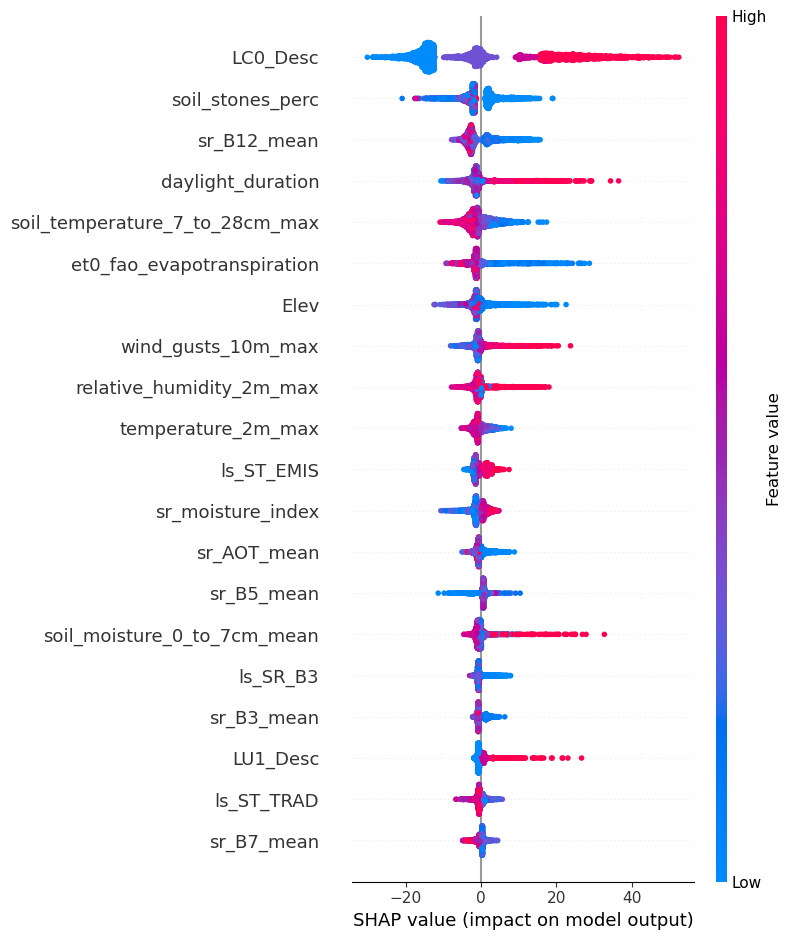

In [302]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Visualise for one prediction
shap.force_plot(explainer.expected_value, shap_values[0, :], X_test.iloc[0, :])

# Summary plot for all predictions
shap.summary_plot(shap_values, X_test)

In [ ]:
shap_importances = np.abs(shap_values).mean(axis=0)
importance_df = pd.DataFrame({
    "feature": X_test.columns,
    "importance": shap_importances
}) .sort_values("importance", ascending=False)

importance_df[importance_df['feature'] == ]

,feature,importance
1,LC0_Desc,15.759661
8,soil_stones_perc,3.721443
21,sr_B12_mean,3.625650
56,daylight_duration,2.886349
63,soil_temperature_7_to_28cm_max,2.822557
58,et0_fao_evapotranspiration,2.821115
0,Elev,2.531410
57,wind_gusts_10m_max,1.905181
60,relative_humidity_2m_max,1.660279
53,temperature_2m_max,1.585532


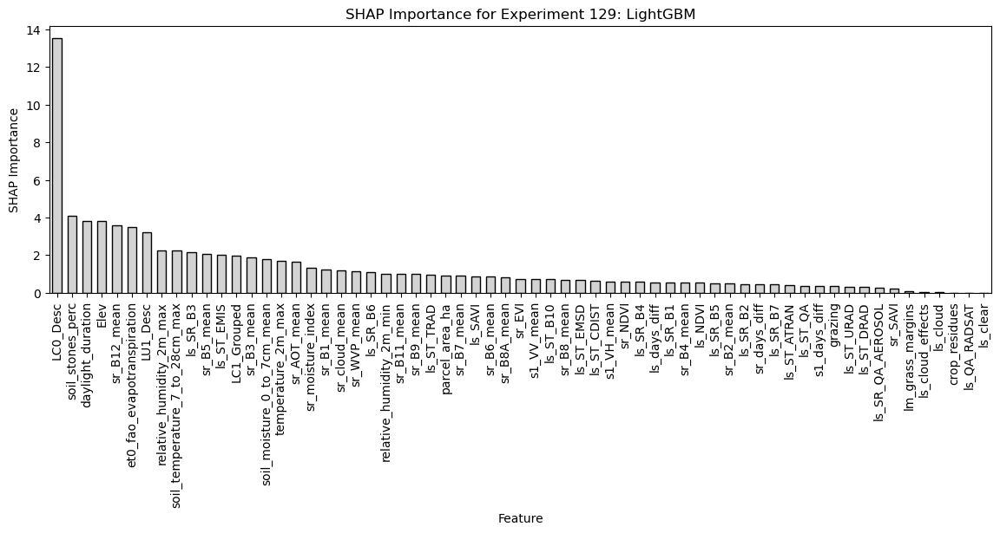

In [101]:
plt.figure(figsize=(14,4))
sns.barplot(importance_df, x='feature', y='importance', color='lightgrey', edgecolor='black', width=0.6)
plt.xticks(rotation=90)
plt.xlabel('Feature')
plt.ylabel('SHAP Importance')
plt.title("SHAP Importance for Experiment 129: LightGBM")
plt.show()

In [309]:
# Save as csv
filename = f"experiment_tracking/feature_importance/{now}_{TARGET_COL}_{experiment_number}_shap_values.csv"
importance_df.to_csv(filename, index=False)

## Model Training

In [61]:
NOTES = f"{NOTES} AND OC"

# List of model types to run
model_types = [
    'xgboost', 
    'lightgbm', 
    'catboost', 
            #    'random_forest', 
            #    'svr'
               ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = 'stratify_bin' # "LC0_Desc" #
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = "" # f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
for model_type in model_types:
    print(f"\nTraining model: {model_type.upper()}")
    trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
    trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

    if TUNE:
        trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
        trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
    else:
        trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

    trainer.evaluate()
    # trainer.compute_feature_importances()
    trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-11 10:49:41,200] A new study created in memory with name: no-name-20b69e99-d8d9-4525-8cd6-cd9f0d0f692a
[I 2025-08-11 10:49:41,386] Trial 0 finished with value: 4631.71848507986 and parameters: {'n_estimators': 53, 'max_depth': 6, 'learning_rate': 0.11664289519051077, 'subsample': 0.5735588014461553, 'colsample_bytree': 0.9370298612039318, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4631.71848507986.



Training model: XGBOOST


[I 2025-08-11 10:49:42,416] Trial 1 finished with value: 4845.640902820365 and parameters: {'n_estimators': 238, 'max_depth': 8, 'learning_rate': 0.04529277721198748, 'subsample': 0.5557541287534904, 'colsample_bytree': 0.7785313065042546, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4631.71848507986.
[I 2025-08-11 10:49:43,756] Trial 2 finished with value: 5852.3575083096575 and parameters: {'n_estimators': 271, 'max_depth': 15, 'learning_rate': 0.2390671902724191, 'subsample': 0.7534829671504323, 'colsample_bytree': 0.5572936714824266, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4631.71848507986.
[I 2025-08-11 10:49:45,308] Trial 3 finished with value: 5126.986054534882 and parameters: {'n_estimators': 127, 'max_depth': 12, 'learning_rate': 0.15185864489356726, 'subsample': 0.6338489296410588, 'colsample_bytree': 0.5816160722900191, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4631.71848507986.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9689519593580995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9689519593580995
[LightGBM] [Warning] bagging_fraction is set=0.8824118276126779, subsample=0.6872407342290571 will be ignored. Current value: bagging_fraction=0.8824118276126779
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9689519593580995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9689519593580995
[LightGBM] [Warning] bagging_fraction is set=0.882

[I 2025-08-11 10:51:36,171] Trial 0 finished with value: 4729.724951689137 and parameters: {'n_estimators': 562, 'max_depth': 12, 'learning_rate': 0.02498510036399392, 'num_leaves': 87, 'min_data_in_leaf': 42, 'feature_fraction': 0.9689519593580995, 'bagging_fraction': 0.8824118276126779, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.6872407342290571, 'colsample_by_tree': 0.8245990453593444, 'reg_alpha': 0.44934058765739915, 'reg_lambda': 0.004057891477814546}. Best is trial 0 with value: 4729.724951689137.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:37,148] Trial 1 finished with value: 5625.4952791855 and parameters: {'n_estimators': 193, 'max_depth': 13, 'learning_rate': 0.0020226713903461497, 'num_leaves': 72, 'min_data_in_leaf': 45, 'feature_fraction': 0.9138238990631378, 'bagging_fraction': 0.9978475588023419, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.979058536795016, 'colsample_by_tree': 0.6682241750416922, 'reg_alpha': 5.089589288335354e-06, 'reg_lambda': 6.632249529012807e-06}. Best is trial 0 with value: 4729.724951689137.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9138238990631378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9138238990631378
[LightGBM] [Warning] bagging_fraction is set=0.9978475588023419, subsample=0.979058536795016 will be ignored. Current value: bagging_fraction=0.9978475588023419
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7031384812307822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031384812307822
[LightGBM] [Warning] bagging_fraction is set=0.824506927034049, subsample=0.6

[I 2025-08-11 10:51:39,499] Trial 2 finished with value: 4783.210633630169 and parameters: {'n_estimators': 962, 'max_depth': 15, 'learning_rate': 0.0019249482561876788, 'num_leaves': 59, 'min_data_in_leaf': 22, 'feature_fraction': 0.7031384812307822, 'bagging_fraction': 0.824506927034049, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.6580031465223556, 'colsample_by_tree': 0.8171299667268404, 'reg_alpha': 0.23757728982754114, 'reg_lambda': 0.003454496155263037}. Best is trial 0 with value: 4729.724951689137.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7031384812307822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7031384812307822
[LightGBM] [Warning] bagging_fraction is set=0.824506927034049, subsample=0.6580031465223556 will be ignored. Current value: bagging_fraction=0.824506927034049
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7132356906805424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7132356906805424
[LightGBM] [Warning] bagging_fraction is set=0.8880946238162146, subsample=0.9

[I 2025-08-11 10:51:42,179] Trial 3 finished with value: 4656.251578679861 and parameters: {'n_estimators': 616, 'max_depth': 15, 'learning_rate': 0.006344151680909836, 'num_leaves': 130, 'min_data_in_leaf': 41, 'feature_fraction': 0.7132356906805424, 'bagging_fraction': 0.8880946238162146, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.9848066116989892, 'colsample_by_tree': 0.892218009755045, 'reg_alpha': 0.17326889640837073, 'reg_lambda': 1.3363978116423477e-06}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:42,754] Trial 4 finished with value: 6190.819566264609 and parameters: {'n_estimators': 586, 'max_depth': 4, 'learning_rate': 0.00016451333336091282, 'num_leaves': 90, 'min_data_in_leaf': 35, 'feature_fraction': 0.7760231584114397, 'bagging_fraction': 0.9979197281335597, 'bagging_freq': 2, 'min_child_samples': 28, 'subsample': 0.8757197373669544, 'colsample_by_tree': 0.8158680189347074, 'reg_alpha': 5.140601639224489, 'reg_lambda': 4.82132855825282e-08}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:45,132] Trial 5 finished with value: 5027.546221103406 and parameters: {'n_estimators': 514, 'max_depth': 12, 'learning_rate': 0.0019876812805505206, 'num_leaves': 142, 'min_data_in_leaf': 38, 'feature_fraction': 0.9311937890514995, 'bagging_fraction': 0.7583762537451758, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.7437165854043142, 'colsample_by_tree': 0.9864704947660557, 'reg_alpha': 3.086587102647005e-08, 'reg_lambda': 1.0626266618940187e-05}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8729188697062679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8729188697062679
[LightGBM] [Warning] bagging_fraction is set=0.8110479516271402, subsample=0.9814644868322961 will be ignored. Current value: bagging_fraction=0.8110479516271402
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8729188697062679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8729188697062679
[LightGBM] [Warning] bagging_fraction is set=0.8110479516271402, subsample=0

[I 2025-08-11 10:51:48,257] Trial 6 finished with value: 4945.628168091238 and parameters: {'n_estimators': 991, 'max_depth': 11, 'learning_rate': 0.13141564279681808, 'num_leaves': 141, 'min_data_in_leaf': 30, 'feature_fraction': 0.8729188697062679, 'bagging_fraction': 0.8110479516271402, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.9814644868322961, 'colsample_by_tree': 0.8647563093835663, 'reg_alpha': 0.010718579681096773, 'reg_lambda': 2.3977225614145328e-06}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8729188697062679, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8729188697062679
[LightGBM] [Warning] bagging_fraction is set=0.8110479516271402, subsample=0.9814644868322961 will be ignored. Current value: bagging_fraction=0.8110479516271402
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7672156623336378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7672156623336378
[LightGBM] [Warning] bagging_fraction is set=0.7698998429628563, subsample=0

[I 2025-08-11 10:51:49,126] Trial 7 finished with value: 5145.1694998158455 and parameters: {'n_estimators': 297, 'max_depth': 13, 'learning_rate': 0.17950869359229898, 'num_leaves': 92, 'min_data_in_leaf': 31, 'feature_fraction': 0.7672156623336378, 'bagging_fraction': 0.7698998429628563, 'bagging_freq': 3, 'min_child_samples': 80, 'subsample': 0.8900678648946919, 'colsample_by_tree': 0.8351442630060647, 'reg_alpha': 3.2714878650982437e-07, 'reg_lambda': 2.80948138570919e-07}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7672156623336378, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7672156623336378
[LightGBM] [Warning] bagging_fraction is set=0.7698998429628563, subsample=0.890

[I 2025-08-11 10:51:49,329] Trial 8 finished with value: 4752.080148271501 and parameters: {'n_estimators': 194, 'max_depth': 5, 'learning_rate': 0.015406536342756643, 'num_leaves': 124, 'min_data_in_leaf': 57, 'feature_fraction': 0.8288707488689724, 'bagging_fraction': 0.7775763999844936, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.6294751524382932, 'colsample_by_tree': 0.7931746009056364, 'reg_alpha': 2.8830092092391157, 'reg_lambda': 1.7753061335977627e-08}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:49,639] Trial 9 finished with value: 4703.191239130938 and parameters: {'n_estimators': 276, 'max_depth': 15, 'learning_rate': 0.0270915449857302, 'num_leaves': 21, 'min_data_in_leaf': 60, 'feature_fraction': 0.935141457795483, 'bagging_fraction': 0.9675565420993781, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.9855881486551659, 'colsample_by_tree': 0.9722144569613437, 'reg_alpha': 0.05632266556626378, 'reg_lambda': 1.4624928667679095e-08}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.935141457795483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.935141457795483
[LightGBM] [Warning] bagging_fraction is set=0.9675565420993781, subsample=0.9855881486551659 will be ignored. Current value: bagging_fraction=0.9675565420993781
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7147774155028261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7147774155028261
[LightGBM] [Warning] bagging_fraction is set=0.8983947137029308, subsample=0.8

[I 2025-08-11 10:51:51,541] Trial 10 finished with value: 6080.808171596491 and parameters: {'n_estimators': 755, 'max_depth': 8, 'learning_rate': 0.00018618155152865244, 'num_leaves': 116, 'min_data_in_leaf': 52, 'feature_fraction': 0.7147774155028261, 'bagging_fraction': 0.8983947137029308, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.8368379361373615, 'colsample_by_tree': 0.7007619498890301, 'reg_alpha': 0.00028442143394882087, 'reg_lambda': 7.44028898040927}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 10:51:52,351] Trial 11 finished with value: 4697.540324559008 and parameters: {'n_estimators': 387, 'max_depth': 15, 'learning_rate': 0.02039759482594214, 'num_leaves': 44, 'min_data_in_leaf': 59, 'feature_fraction': 0.9759685833980581, 'bagging_fraction': 0.9323945181896516, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.9331443396995286, 'colsample_by_tree': 0.964305996717966, 'reg_alpha': 0.004690508819195986, 'reg_lambda': 0.00023434884825985407}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9759685833980581, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9759685833980581
[LightGBM] [Warning] bagging_fraction is set=0.9323945181896516, subsample=0.9331443396995286 will be ignored. Current value: bagging_fraction=0.9323945181896516
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9856711621250213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856711621250213
[LightGBM] [Warning] bagging_fraction is set=0.9247406389711812, subsample=0

[I 2025-08-11 10:51:53,039] Trial 12 finished with value: 4714.7226087962235 and parameters: {'n_estimators': 448, 'max_depth': 9, 'learning_rate': 0.0074484462100911425, 'num_leaves': 33, 'min_data_in_leaf': 47, 'feature_fraction': 0.9856711621250213, 'bagging_fraction': 0.9247406389711812, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.920689010878265, 'colsample_by_tree': 0.9068387522516697, 'reg_alpha': 0.000957765277058903, 'reg_lambda': 0.00032991188914628335}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9856711621250213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9856711621250213
[Ligh

[I 2025-08-11 10:51:54,660] Trial 13 finished with value: 4863.073806939194 and parameters: {'n_estimators': 727, 'max_depth': 15, 'learning_rate': 0.04315168886337919, 'num_leaves': 50, 'min_data_in_leaf': 53, 'feature_fraction': 0.8428795940084284, 'bagging_fraction': 0.7001073491312751, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.7954885403447263, 'colsample_by_tree': 0.9213438089145042, 'reg_alpha': 0.0009552537383298523, 'reg_lambda': 0.00014385982012943602}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7889156530027059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7889156530027059
[LightGBM] [Warning] bagging_fraction is set=0.9317510478704828, subsample=0.9286635081393051 will be ignored. Current value: bagging_fraction=0.9317510478704828
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7889156530027059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7889156530027059
[LightGBM] [Warning] bagging_fraction is set=0.9317510478704828, subsample=0.

[I 2025-08-11 10:51:55,274] Trial 14 finished with value: 4789.445116322345 and parameters: {'n_estimators': 371, 'max_depth': 6, 'learning_rate': 0.006293035447330552, 'num_leaves': 114, 'min_data_in_leaf': 21, 'feature_fraction': 0.7889156530027059, 'bagging_fraction': 0.9317510478704828, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.9286635081393051, 'colsample_by_tree': 0.9298018275834949, 'reg_alpha': 0.008698380199493365, 'reg_lambda': 0.18715691742503998}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:56,693] Trial 15 finished with value: 5486.904355269177 and parameters: {'n_estimators': 733, 'max_depth': 10, 'learning_rate': 0.0006689732962509488, 'num_leaves': 49, 'min_data_in_leaf': 50, 'feature_fraction': 0.7457266362789053, 'bagging_fraction': 0.874711783987849, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.9371704728468777, 'colsample_by_tree': 0.7436988830003032, 'reg_alpha': 3.754937046328099e-05, 'reg_lambda': 0.0005855101877813708}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7457266362789053, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7457266362789053
[LightGBM] [Warning] bagging_fraction is set=0.874711783987849, subsample=0.9371704728468777 will be ignored. Current value: bagging_fraction=0.874711783987849
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8922360332488004, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8922360332488004
[LightGBM] [Warning] bagging_fraction is set=0.9433157675598018, subsample=0.8

[I 2025-08-11 10:51:57,095] Trial 16 finished with value: 4695.314471442877 and parameters: {'n_estimators': 106, 'max_depth': 14, 'learning_rate': 0.07213438939058357, 'num_leaves': 104, 'min_data_in_leaf': 26, 'feature_fraction': 0.8922360332488004, 'bagging_fraction': 0.9433157675598018, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.8232461027282352, 'colsample_by_tree': 0.6063733739939225, 'reg_alpha': 0.047325702177659634, 'reg_lambda': 5.235190931676479e-07}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:51:57,546] Trial 17 finished with value: 4796.757241256315 and parameters: {'n_estimators': 133, 'max_depth': 13, 'learning_rate': 0.08526510660485263, 'num_leaves': 108, 'min_data_in_leaf': 26, 'feature_fraction': 0.8696055350565317, 'bagging_fraction': 0.8508641086214345, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.7696162126121351, 'colsample_by_tree': 0.6082482989105438, 'reg_alpha': 0.15009288899710804, 'reg_lambda': 6.500094496971175e-07}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8696055350565317, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8696055350565317
[LightGBM] [Warning] bagging_fraction is set=0.8508641086214345, subsample=0.7696162126121351 will be ignored. Current value: bagging_fraction=0.8508641086214345
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8144860300375154, colsample_bytre

[I 2025-08-11 10:51:58,642] Trial 18 finished with value: 4876.027991675821 and parameters: {'n_estimators': 667, 'max_depth': 8, 'learning_rate': 0.06997958964354999, 'num_leaves': 128, 'min_data_in_leaf': 36, 'feature_fraction': 0.8144860300375154, 'bagging_fraction': 0.9563116557837259, 'bagging_freq': 1, 'min_child_samples': 86, 'subsample': 0.719412171319838, 'colsample_by_tree': 0.6207015681131233, 'reg_alpha': 1.521417246152622, 'reg_lambda': 2.0859796189037156e-05}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:02,042] Trial 19 finished with value: 5174.750598791279 and parameters: {'n_estimators': 795, 'max_depth': 14, 'learning_rate': 0.23009456042974347, 'num_leaves': 102, 'min_data_in_leaf': 42, 'feature_fraction': 0.8820760195292515, 'bagging_fraction': 0.8951664817570365, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.8553350834179799, 'colsample_by_tree': 0.7482255357008902, 'reg_alpha': 0.02081954944462646, 'reg_lambda': 1.0892308736650103e-07}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8820760195292515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8820760195292515
[LightGBM] [Warning] bagging_fraction is set=0.8951664817570365, subsample=0.8553350834179799 will be ignored. Current value: bagging_fraction=0.8951664817

[I 2025-08-11 10:52:04,365] Trial 20 finished with value: 5667.360577023318 and parameters: {'n_estimators': 481, 'max_depth': 11, 'learning_rate': 0.0007086075974655227, 'num_leaves': 150, 'min_data_in_leaf': 31, 'feature_fraction': 0.7370790308448804, 'bagging_fraction': 0.8507813967447397, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.8213638736269098, 'colsample_by_tree': 0.8841450078992681, 'reg_alpha': 6.097957596226962e-05, 'reg_lambda': 9.505489312938054e-07}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7370790308448804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7370790308448804
[LightGBM] [Warning] bagging_fraction is set=0.8507813967447397, subsample=0.8213638736269098 will be ignored. Current value: bagging_fraction=0.8507813967447397
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=7

[I 2025-08-11 10:52:05,336] Trial 21 finished with value: 4709.243850312155 and parameters: {'n_estimators': 358, 'max_depth': 14, 'learning_rate': 0.01235048368750022, 'num_leaves': 67, 'min_data_in_leaf': 26, 'feature_fraction': 0.9986985190604386, 'bagging_fraction': 0.9346532632443565, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.9335910816689607, 'colsample_by_tree': 0.9577758591976151, 'reg_alpha': 0.002998550973670488, 'reg_lambda': 4.1846127280372594e-05}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9986985190604386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9986985190604386
[LightGBM] [Warning] bagging_fraction is set=0.9346532632443565, subsample=0.9335910816689607 will be ignored. Current value: bagging_fraction=0.9346532632443565
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9536675446736724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9536675446736724
[

[I 2025-08-11 10:52:06,797] Trial 22 finished with value: 4873.951313722724 and parameters: {'n_estimators': 623, 'max_depth': 14, 'learning_rate': 0.04823277602887927, 'num_leaves': 99, 'min_data_in_leaf': 57, 'feature_fraction': 0.9536675446736724, 'bagging_fraction': 0.9652625950892346, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.896952631547503, 'colsample_by_tree': 0.9998339724669243, 'reg_alpha': 0.05919032918594573, 'reg_lambda': 0.00775389957698339}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-11 10:52:08,956] Trial 23 finished with value: 4657.009428178525 and parameters: {'n_estimators': 876, 'max_depth': 15, 'learning_rate': 0.011670808602115848, 'num_leaves': 77, 'min_data_in_leaf': 47, 'feature_fraction': 0.9022458470530735, 'bagging_fraction': 0.9132283896506015, 'bagging_freq': 1, 'min_child_samples': 94, 'subsample': 0.9574933974156109, 'colsample_by_tree': 0.9476763605270054, 'reg_alpha': 1.198032039041147, 'reg_lambda': 2.749892033293077e-06}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:11,614] Trial 24 finished with value: 4666.800405864465 and parameters: {'n_estimators': 864, 'max_depth': 12, 'learning_rate': 0.004318178872135638, 'num_leaves': 77, 'min_data_in_leaf': 47, 'feature_fraction': 0.917822879945255, 'bagging_fraction': 0.9079630202484716, 'bagging_freq': 1, 'min_child_samples': 91, 'subsample': 0.9948145635266985, 'colsample_by_tree': 0.863391695891917, 'reg_alpha': 0.7120077996713015, 'reg_lambda': 2.1329799192254415e-06}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:14,050] Trial 25 finished with value: 4700.912531559844 and parameters: {'n_estimators': 904, 'max_depth': 12, 'learning_rate': 0.003203632867068238, 'num_leaves': 76, 'min_data_in_leaf': 47, 'feature_fraction': 0.9009423883283154, 'bagging_fraction': 0.9044237683872817, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.9942957299533121, 'colsample_by_tree': 0.8680216180919387, 'reg_alpha': 9.443583654228766, 'reg_lambda': 3.0844755898178304e-06}. Best is trial 3 with value: 4656.251578679861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:16,376] Trial 26 finished with value: 4639.585827293111 and parameters: {'n_estimators': 870, 'max_depth': 11, 'learning_rate': 0.004175068249367455, 'num_leaves': 83, 'min_data_in_leaf': 43, 'feature_fraction': 0.8556476369221307, 'bagging_fraction': 0.8706707181169844, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.9597021639222132, 'colsample_by_tree': 0.9372869317818726, 'reg_alpha': 0.6713401284063424, 'reg_lambda': 1.1080236370542138e-07}. Best is trial 26 with value: 4639.585827293111.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8556476369221307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8556476369221307
[LightGBM] [Warning] bagging_fraction is set=0.8706707181169844, subsample=0.9597021639222132 will be ignored. Current value: bagging_fraction=0.8706707181169844
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8123179824452696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123179824452696
[LightGBM] [Warning] bagging_fraction is set=0.8688945470622114, subsample=0

[I 2025-08-11 10:52:18,477] Trial 27 finished with value: 5440.483648871436 and parameters: {'n_estimators': 831, 'max_depth': 10, 'learning_rate': 0.0006252177579118354, 'num_leaves': 63, 'min_data_in_leaf': 41, 'feature_fraction': 0.8123179824452696, 'bagging_fraction': 0.8688945470622114, 'bagging_freq': 1, 'min_child_samples': 75, 'subsample': 0.9571163556162335, 'colsample_by_tree': 0.9419356809775241, 'reg_alpha': 1.2436405892920939, 'reg_lambda': 1.2484048339750867e-07}. Best is trial 26 with value: 4639.585827293111.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8123179824452696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8123179824452696
[LightGBM] [Warning] bagging_fraction is set=0.8688945470622114, subsample=0.9571163556162335 will be ignored. Current value: bagging_fraction=0.8688945470622114
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8513758671179762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8513758671179762
[LightGBM] [Warning] bagging_fraction is set=0.8248480993869876, subsample=0

[I 2025-08-11 10:52:20,144] Trial 28 finished with value: 4645.356223739493 and parameters: {'n_estimators': 922, 'max_depth': 7, 'learning_rate': 0.009040215986701445, 'num_leaves': 82, 'min_data_in_leaf': 38, 'feature_fraction': 0.8513758671179762, 'bagging_fraction': 0.8248480993869876, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.9623559269594616, 'colsample_by_tree': 0.903810711160697, 'reg_alpha': 0.21621482017014695, 'reg_lambda': 9.927240234884595e-08}. Best is trial 26 with value: 4639.585827293111.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:21,658] Trial 29 finished with value: 4637.507567665169 and parameters: {'n_estimators': 929, 'max_depth': 7, 'learning_rate': 0.00805275184758421, 'num_leaves': 85, 'min_data_in_leaf': 37, 'feature_fraction': 0.8557001124784713, 'bagging_fraction': 0.8263566205638275, 'bagging_freq': 3, 'min_child_samples': 64, 'subsample': 0.9613666306439894, 'colsample_by_tree': 0.7864663185295113, 'reg_alpha': 0.23851603584444162, 'reg_lambda': 4.4922159410785216e-08}. Best is trial 29 with value: 4637.507567665169.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 10:52:23,679] A new study created in memory with name: no-name-9fce112e-4349-4173-97b0-e1715e545e0c



Training model: CATBOOST


[I 2025-08-11 10:52:24,179] Trial 0 finished with value: 4970.301816571565 and parameters: {'depth': 4, 'learning_rate': 0.004738654270683233, 'l2_leaf_reg': 0.1663521576550823, 'iterations': 544, 'bagging_temperature': 0.028874760629328033, 'random_strength': 0.5945310933249032, 'rsm': 0.9963500108206187, 'border_count': 193}. Best is trial 0 with value: 4970.301816571565.
[I 2025-08-11 10:52:24,764] Trial 1 finished with value: 5446.098587544689 and parameters: {'depth': 6, 'learning_rate': 0.001989100351954253, 'l2_leaf_reg': 0.058429158456625566, 'iterations': 329, 'bagging_temperature': 0.6229352880336488, 'random_strength': 0.5356027136599965, 'rsm': 0.9111197327447201, 'border_count': 255}. Best is trial 0 with value: 4970.301816571565.
[I 2025-08-11 10:52:25,277] Trial 2 finished with value: 4958.885639016118 and parameters: {'depth': 3, 'learning_rate': 0.21122426245575227, 'l2_leaf_reg': 4.237737547884555, 'iterations': 837, 'bagging_temperature': 0.2642345031915261, 'random_

## Experiment Loop

In [28]:
filenames = {
    101: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv",
    102: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv",
    103: "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv",
    104: "data/modelling/model_csvs/250809_1010_31days_ndvisavilandsat_lowestcloud_minmaxscaler_allfeatures.csv",
    105: "data/modelling/model_csvs/250810_0948_ex105_lowestcloud_62days_allfeatures.csv",
    106: "data/modelling/model_csvs/250810_1000_leastcloudy_93days_allfeatures.csv",
    107: "data/modelling/model_csvs/250810_1004_leastcloudy_182days_allfeatures.csv",
    108: "data/modelling/model_csvs/250810_1006_leastcloudy_365days_allfeatures.csv",
    109: "data/modelling/model_csvs/250810_1122_closest_underthresh_31days_allfeatures.csv",
    110: "data/modelling/model_csvs/250810_1127_closest_under12_62days_allfeatures.csv",
    111: "data/modelling/model_csvs/250810_1141_closest_under5_93days_allfeatures.csv",
    112: "data/modelling/model_csvs/250810_1308_closest_under3_182days_allfeatures.csv",
    113: "data/modelling/model_csvs/250810_1313_closest_under2_365days_allfeatures.csv",
    114: "data/modelling/model_csvs/250810_0951_ex10q_closestimage_allfeatures.csv", # Needs removal of satellite imagery
    115: "data/modelling/model_csvs/250810_1335_median_under20_31to62days_allfeatures.csv",
    116: "data/modelling/model_csvs/250810_1355_median_under20_62days_allfeatures.csv",
    117: "data/modelling/model_csvs/250810_1358_median_under20_93days_allfeatures.csv",
    118: "data/modelling/model_csvs/250810_1402_median_under20_182days_allfeatures.csv",
    119: "data/modelling/model_csvs/250810_1406_median_under20_365days_allfeatures.csv",
    120: "data/modelling/model_csvs/250810_1434_mean_under20_31to62days_allfeatures.csv",
    121: "data/modelling/model_csvs/250810_1437_mean_under20_62days_allfeatures.csv",
    122: "data/modelling/model_csvs/250810_1439_mean_under20_93days_allfeatures.csv",
    123: "data/modelling/model_csvs/250810_1442_mean_under20_182days_allfeatures.csv",
    124: "data/modelling/model_csvs/250810_1445_mean_under20_365days_allfeatures.csv"
}

notes = {
    101: "baseline",
    102: "baseline",
    103: "Experiment 103: Least cloudy image last 31 days, stratify by LC0_Desc",
    104: "Experiment 103: Least cloudy image last 31 days, stratify by LC0_Desc",
    105: "Experiment 105: least cloudy 62 days, stratified by LC0_Desc and OC in 10 bins.",
    106: "Experiment 106: least cloudy 93 days stratified by LC0_Desc and OC in 10 bins.",
    107: "Experiment 107: least cloudy 182 days stratified by LC0_Desc and OC in 10 bins.",
    108: "Experiment 108: least cloudy 365 days stratified by LC0_Desc and OC in 10 bins.",
    109: "Experiment 109: Closest image under 20 cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    110: "Experiment 110: Closest image under 12 within 62 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    111: "Experiment 111: Closest image under 5 within 93 day window cloud_mean s2 and clear LS stratified by LC0_Desc and OC in 10 bins.",
    112: "Experiment 112: closest image under cloud_mean 3 within 182 days of survey date. All features.",
    113: "Experiment 113: closest image under cloud_mean 2 within 365 days of survey date. All features.",
    114: "Experiment 114: No satellite imagery", # Needs removal of satellite imagery
    115: "Experiment 115: REDO (error before - ignore it) Median of low cloud images (<20 or clear==True) in 31 and 62 days",
    116: "Experiment 116: Median of low cloud images (<20 or clear==True) in 62 days",
    117: "Experiment 117: Median of low cloud images (<20 or clear==True) in 93 days",
    118: "Experiment 118: Median of low cloud images (<20 or clear==True) in 182 days",
    119: "Experiment 119: Median of low cloud images (<20 or clear==True) in 365 days",
    120: "Experiment 120: Mean of low cloud images (<20 or clear==True) in 31 days for sentinel, 62 for landsat",
    121: "Experiment 121: Mean of low cloud images (<20 or clear==True) in last 62 days",
    122: "Experiment 122: Mean of low cloud images (<20 or clear==True) in last 93 days",
    123: "Experiment 123: Mean of low cloud images (<20 or clear==True) in last 182 days",
    124: "Experiment 124: Mean of low cloud images (<20 or clear==True) in last 365 days"
}


In [30]:
cat_cols = ['LC0_Desc', 'LU1_Desc', 'LC1_Grouped']

stratifyby = "LC0_Desc" # 'stratify_bin' # 
stratify_description = "LC0_Desc ONLY"

model_types = [
    'xgboost', 
    'lightgbm', 
    'catboost', 
]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = "" #f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

for i in range(110,125):
    DATASET_FILENAME = filenames[i]
    NOTES = notes[i] + f" - Stratify by {stratify_description}"

    df = pd.read_csv(DATASET_FILENAME)
    # Transformations
    encoder = OrdinalEncoder()
    enc_df = df.copy()
    enc_df[cat_cols] = encoder.fit_transform(enc_df[cat_cols])
    enc_df = enc_df.replace({True: 1, False: 0, '< 0.5 ha': 0, '0.5 - 1 ha': 1, '1 - 10 ha': 2, '> 10 ha': 3})

    # Code to stratify by OC or N level - bucket into categories
    enc_df['OC_binned'] = pd.qcut(enc_df['OC'], q=10, labels=False)

    # Stratify by OC and LC0_Desc
    enc_df['stratify_bin'] = enc_df['LC0_Desc'].astype(str) + "_" + enc_df['OC_binned'].astype(str)
    enc_df = enc_df.drop(columns=['OC_binned'])

    # Train without satellite imagery
    if i == 114:
        cols = enc_df.columns.values
        cols = [col for col in cols if not col.startswith("sr_")]
        cols = [col for col in cols if not col.startswith("ls_")]
        cols = [col for col in cols if not col.startswith("s1_")]
        enc_df = enc_df[cols]


    # Loop over models
    for model_type in model_types:
        print(f"\nTraining model: {model_type.upper()}")
        trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
        trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

        if TUNE:
            trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
        else:
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

        trainer.evaluate()
        # trainer.compute_feature_importances()
        trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-10 20:22:08,571] A new study created in memory with name: no-name-1f468669-cee7-47a8-92ab-176272c86ee1



Training model: XGBOOST


[I 2025-08-10 20:22:12,078] Trial 0 finished with value: 4866.967574689134 and parameters: {'n_estimators': 144, 'max_depth': 17, 'learning_rate': 0.09838493951426029, 'subsample': 0.5879705308946073, 'colsample_bytree': 0.553033811285117, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4866.967574689134.
[I 2025-08-10 20:22:13,060] Trial 1 finished with value: 4626.089134162794 and parameters: {'n_estimators': 195, 'max_depth': 8, 'learning_rate': 0.040758105564409675, 'subsample': 0.8636334908230492, 'colsample_bytree': 0.6866439174550878, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 4626.089134162794.
[I 2025-08-10 20:22:13,977] Trial 2 finished with value: 4575.560131353045 and parameters: {'n_estimators': 68, 'max_depth': 13, 'learning_rate': 0.05226425337426798, 'subsample': 0.5202836312717717, 'colsample_bytree': 0.547935781225161, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 2 with value: 4575.560131353045.
[


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8325621399022769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8325621399022769
[LightGBM] [Warning] bagging_fraction is set=0.9202830743269299, subsample=0.9687474219856422 will be ignored. Current value: bagging_fraction=0.9202830743269299
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8325621399022769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8325621399022769
[LightGBM] [Warning] bagging_fraction is set=0.920

[I 2025-08-10 20:26:07,864] Trial 0 finished with value: 5368.676825296601 and parameters: {'n_estimators': 336, 'max_depth': 15, 'learning_rate': 0.0004966895083310287, 'num_leaves': 100, 'min_data_in_leaf': 51, 'feature_fraction': 0.8325621399022769, 'bagging_fraction': 0.9202830743269299, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.9687474219856422, 'colsample_by_tree': 0.6767259684175008, 'reg_alpha': 0.6485732095704076, 'reg_lambda': 0.0009254214774006229}. Best is trial 0 with value: 5368.676825296601.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8325621399022769, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8325621399022769
[LightGBM] [Warning] bagging_fraction is set=0.9202830743269299, subsample=0.9687474219856422 will be ignored. Current value: bagging_fraction=0.9202830743269299
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9739800384392746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9739800384392746
[LightGBM] [Warning] bagging_fraction is set=0.9496139761160014, subsample=0

[I 2025-08-10 20:26:10,769] Trial 1 finished with value: 4567.13097889822 and parameters: {'n_estimators': 708, 'max_depth': 6, 'learning_rate': 0.07793046609903446, 'num_leaves': 41, 'min_data_in_leaf': 59, 'feature_fraction': 0.9739800384392746, 'bagging_fraction': 0.9496139761160014, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.7445854966987707, 'colsample_by_tree': 0.7453462827683133, 'reg_alpha': 4.251364121504093e-06, 'reg_lambda': 0.0002231017856719052}. Best is trial 1 with value: 4567.13097889822.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 20:26:15,091] Trial 2 finished with value: 5130.994719212571 and parameters: {'n_estimators': 595, 'max_depth': 15, 'learning_rate': 0.22437132498834378, 'num_leaves': 34, 'min_data_in_leaf': 25, 'feature_fraction': 0.9222256781884002, 'bagging_fraction': 0.837350070385515, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.8831416544942879, 'colsample_by_tree': 0.9641625426968427, 'reg_alpha': 0.0775171030907751, 'reg_lambda': 7.881972315591938e-05}. Best is trial 1 with value: 4567.13097889822.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9222256781884002, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9222256781884002
[LightGBM] [Warning] bagging_fraction is set=0.837350070385515, subsample=0.8831416544942879 will be ignored. Current value: bagging_fraction=0.837350070385515
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8884656112534205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884656112534205
[LightGBM] [Warning] bagging_fraction is set=0.8046952300041434, subsample=0.8

[I 2025-08-10 20:26:17,946] Trial 3 finished with value: 4328.430841214961 and parameters: {'n_estimators': 601, 'max_depth': 6, 'learning_rate': 0.013121214685391085, 'num_leaves': 70, 'min_data_in_leaf': 37, 'feature_fraction': 0.8884656112534205, 'bagging_fraction': 0.8046952300041434, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.824703300705634, 'colsample_by_tree': 0.7298923572816277, 'reg_alpha': 2.522070648310608e-08, 'reg_lambda': 6.022080659029927e-06}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8884656112534205, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8884656112534205
[LightGBM] [Warning] bagging_fraction is set=0.8046952300041434, subsample=0.824703300705634 will be ignored. Current value: bagging_fraction=0.8046952300041434
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7268285280101843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7268285280101843
[LightGBM] [Warning] bagging_fraction is set=0.9319490221859233, subsample=0.

[I 2025-08-10 20:26:32,702] Trial 4 finished with value: 5460.413542598679 and parameters: {'n_estimators': 800, 'max_depth': 11, 'learning_rate': 0.00015463687638343798, 'num_leaves': 140, 'min_data_in_leaf': 55, 'feature_fraction': 0.7268285280101843, 'bagging_fraction': 0.9319490221859233, 'bagging_freq': 3, 'min_child_samples': 43, 'subsample': 0.6408996307534274, 'colsample_by_tree': 0.7299580033841881, 'reg_alpha': 1.7758134028862563e-07, 'reg_lambda': 5.045712052076644e-05}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7268285280101843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7268285280101843
[LightGBM] [Warning] bagging_fraction is set=0.9319490221859233, subsample=0.6408996307534274 will be ignored. Current value: bagging_fraction=0.9319490221

[I 2025-08-10 20:26:42,782] Trial 5 finished with value: 4388.446365871991 and parameters: {'n_estimators': 645, 'max_depth': 15, 'learning_rate': 0.02093742077833977, 'num_leaves': 85, 'min_data_in_leaf': 57, 'feature_fraction': 0.8140127246060549, 'bagging_fraction': 0.7153762991788236, 'bagging_freq': 1, 'min_child_samples': 56, 'subsample': 0.7828976105784454, 'colsample_by_tree': 0.8562348241866018, 'reg_alpha': 0.00013405097384067382, 'reg_lambda': 1.158240527814023e-07}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8140127246060549, colsample_bytree=1.

[I 2025-08-10 20:26:54,549] Trial 6 finished with value: 5564.956153333807 and parameters: {'n_estimators': 610, 'max_depth': 15, 'learning_rate': 0.00012217010902684908, 'num_leaves': 109, 'min_data_in_leaf': 43, 'feature_fraction': 0.9842323297585931, 'bagging_fraction': 0.9067269537297236, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.8395443730766032, 'colsample_by_tree': 0.9406332897726786, 'reg_alpha': 0.004322676016055988, 'reg_lambda': 0.018377207438718624}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9842323297585931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9842323297585931
[LightGBM] [Warning] bagging_fraction is set=0.9067269537297236, subsample=0.8395443730766032 will be ignored. Current value: bagging_fraction=0.9067269537297236
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9639254000926368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639254000926368
[LightGBM] [Warning] bagging_fraction is set=0.7756533273192925, subsample=0

[I 2025-08-10 20:26:57,619] Trial 7 finished with value: 5305.006500378172 and parameters: {'n_estimators': 199, 'max_depth': 11, 'learning_rate': 0.001025799752811803, 'num_leaves': 60, 'min_data_in_leaf': 49, 'feature_fraction': 0.9639254000926368, 'bagging_fraction': 0.7756533273192925, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.9862935632451555, 'colsample_by_tree': 0.7565060901433975, 'reg_alpha': 1.9498600036801116e-06, 'reg_lambda': 1.39440911626301}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9639254000926368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9639254000926368
[LightGBM] [Warning] bagging_fraction is set=0.7756533273192925, subsample=0.9862935632451555 will be ignored. Current value: bagging_fraction=0.7756533273192925
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7575627111913804, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7575627111913804
[LightGBM] [Warning] bagging_fraction is set=0.8185027481595459, subsample=0

[I 2025-08-10 20:26:58,810] Trial 8 finished with value: 4591.349863764493 and parameters: {'n_estimators': 247, 'max_depth': 5, 'learning_rate': 0.004228266842324317, 'num_leaves': 108, 'min_data_in_leaf': 35, 'feature_fraction': 0.7575627111913804, 'bagging_fraction': 0.8185027481595459, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.7039565095199268, 'colsample_by_tree': 0.6968996999088088, 'reg_alpha': 4.2150229464622575e-07, 'reg_lambda': 0.00983050296329907}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:27:12,327] Trial 9 finished with value: 5508.294936468036 and parameters: {'n_estimators': 878, 'max_depth': 10, 'learning_rate': 0.00011798396356278144, 'num_leaves': 128, 'min_data_in_leaf': 49, 'feature_fraction': 0.760637805518163, 'bagging_fraction': 0.7774772786471975, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.7954583267357414, 'colsample_by_tree': 0.9517466814336569, 'reg_alpha': 1.647385947905371e-07, 'reg_lambda': 0.014058477132638974}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.760637805518163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.760637805518163
[LightGBM] [Warning] bagging_fraction is set=0.7774772786471975, subsample=0.7954583267357414 will be ignored. Current value: bagging_fraction=0.7774772786471975
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8922862901169571, colsample_bytree=1

[I 2025-08-10 20:27:13,026] Trial 10 finished with value: 4470.128388877507 and parameters: {'n_estimators': 419, 'max_depth': 3, 'learning_rate': 0.0084831829428, 'num_leaves': 65, 'min_data_in_leaf': 31, 'feature_fraction': 0.8922862901169571, 'bagging_fraction': 0.9944662572864473, 'bagging_freq': 2, 'min_child_samples': 19, 'subsample': 0.9020371699009282, 'colsample_by_tree': 0.6140671115312908, 'reg_alpha': 0.00012798184429533188, 'reg_lambda': 4.214110378191098e-07}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:27:16,036] Trial 11 finished with value: 4335.923260861754 and parameters: {'n_estimators': 462, 'max_depth': 7, 'learning_rate': 0.017795236979114844, 'num_leaves': 78, 'min_data_in_leaf': 41, 'feature_fraction': 0.8348765902422387, 'bagging_fraction': 0.7168219140148474, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.7860360606401718, 'colsample_by_tree': 0.8228358927528537, 'reg_alpha': 1.0222899515001863e-08, 'reg_lambda': 4.0503690913479695e-08}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 20:27:18,317] Trial 12 finished with value: 4392.1479742373685 and parameters: {'n_estimators': 454, 'max_depth': 7, 'learning_rate': 0.03398051640682231, 'num_leaves': 72, 'min_data_in_leaf': 41, 'feature_fraction': 0.891272468043508, 'bagging_fraction': 0.7154267768459823, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.6919895099714316, 'colsample_by_tree': 0.831255057100994, 'reg_alpha': 1.4627884268161436e-08, 'reg_lambda': 1.3411261679725382e-08}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:27:22,430] Trial 13 finished with value: 4352.310182673744 and parameters: {'n_estimators': 491, 'max_depth': 8, 'learning_rate': 0.003810754645894866, 'num_leaves': 49, 'min_data_in_leaf': 35, 'feature_fraction': 0.8624615474076736, 'bagging_fraction': 0.7588812154046911, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.8519785131038563, 'colsample_by_tree': 0.879506369401045, 'reg_alpha': 2.3228944497317843e-08, 'reg_lambda': 2.9727358290951677e-06}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8624615474076736, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8624615474076736
[LightGBM] [Warning] bagging_fraction is set=0.7588812154046911, subsample=0.8519785131038563 will be ignored. Current value: bagging_fraction=0.7588812154046911
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8075369891718682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8075369891718682
[LightGBM] [Warning] bagging_fraction is set=0.8644792861372727, subsample=0

[I 2025-08-10 20:27:22,766] Trial 14 finished with value: 4472.792515496404 and parameters: {'n_estimators': 109, 'max_depth': 4, 'learning_rate': 0.016359598901668902, 'num_leaves': 21, 'min_data_in_leaf': 21, 'feature_fraction': 0.8075369891718682, 'bagging_fraction': 0.8644792861372727, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.771775242164521, 'colsample_by_tree': 0.7928791018155649, 'reg_alpha': 1.2142003070483866e-05, 'reg_lambda': 7.258946352820709e-06}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:27:29,201] Trial 15 finished with value: 4720.0921998509875 and parameters: {'n_estimators': 976, 'max_depth': 8, 'learning_rate': 0.07512136488896855, 'num_leaves': 91, 'min_data_in_leaf': 44, 'feature_fraction': 0.920741495451967, 'bagging_fraction': 0.7012705290825307, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.9162058457588911, 'colsample_by_tree': 0.6441500238048466, 'reg_alpha': 2.3490281136056117e-08, 'reg_lambda': 1.718874115158214e-08}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8599251457756301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599251457756301
[LightGBM] [Warning] bagging_fraction is set=0.8018300242612708, subsample=0.8330774092339699 will be ignored. Current value: bagging_fraction=0.8018300242612708
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8599251457756301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599251457756301
[LightGBM] [Warning] bagging_fraction is set=0.8018300242612708, subsample=0

[I 2025-08-10 20:27:31,813] Trial 16 finished with value: 4775.4669088295805 and parameters: {'n_estimators': 381, 'max_depth': 6, 'learning_rate': 0.0017236054133738256, 'num_leaves': 72, 'min_data_in_leaf': 36, 'feature_fraction': 0.8599251457756301, 'bagging_fraction': 0.8018300242612708, 'bagging_freq': 3, 'min_child_samples': 47, 'subsample': 0.8330774092339699, 'colsample_by_tree': 0.7942411319002336, 'reg_alpha': 0.0040926670251578215, 'reg_lambda': 6.407957610322472e-07}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:27:39,090] Trial 17 finished with value: 4347.539852387321 and parameters: {'n_estimators': 755, 'max_depth': 9, 'learning_rate': 0.010846195561360968, 'num_leaves': 84, 'min_data_in_leaf': 29, 'feature_fraction': 0.8043178113512535, 'bagging_fraction': 0.8684935150654324, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.7165507789399599, 'colsample_by_tree': 0.8869671098611779, 'reg_alpha': 2.4539294394914296e-05, 'reg_lambda': 5.6418427360960975e-06}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9397407978212067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397407978212067
[LightGBM] [Warning] bagging_fraction is set=0.7456015911978264, subsample=0.6001261554502347 will be ignored. Current value: bagging_fraction=0.7456015911978264
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9397407978212067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397407978212067
[LightGBM] [Warning] bagging_fraction is set=0.7456015911978264, subsample=0

[I 2025-08-10 20:27:40,763] Trial 18 finished with value: 4621.719611979152 and parameters: {'n_estimators': 535, 'max_depth': 5, 'learning_rate': 0.05350664590146976, 'num_leaves': 122, 'min_data_in_leaf': 39, 'feature_fraction': 0.9397407978212067, 'bagging_fraction': 0.7456015911978264, 'bagging_freq': 3, 'min_child_samples': 82, 'subsample': 0.6001261554502347, 'colsample_by_tree': 0.7081571769069732, 'reg_alpha': 3.7654139896093193e-07, 'reg_lambda': 9.03207243764582e-08}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9397407978212067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9397407978212067
[LightGBM] [Warning] bagging_fraction is set=0.7456015911978264, subsample=0.6001261554502347 will be ignored. Current value: bagging_fraction=0.7456015911978264
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:27:43,793] Trial 19 finished with value: 4964.721017450717 and parameters: {'n_estimators': 332, 'max_depth': 12, 'learning_rate': 0.21446598054752944, 'num_leaves': 54, 'min_data_in_leaf': 46, 'feature_fraction': 0.8852498747722537, 'bagging_fraction': 0.7398444412612518, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.9420613702258372, 'colsample_by_tree': 0.8232477857190827, 'reg_alpha': 0.00197450216159869, 'reg_lambda': 7.162024979189233}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8852498747722537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8852498747722537
[LightGBM] [Warning] bagging_fraction is set=0.7398444412612518, subsample=0.9420613702258372 will be ignored. Current value: bagging_fraction=0.7398444412612518
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7804493451221174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7804493451221174
[

[I 2025-08-10 20:27:50,008] Trial 20 finished with value: 4342.913908489939 and parameters: {'n_estimators': 669, 'max_depth': 7, 'learning_rate': 0.0029247354087259167, 'num_leaves': 80, 'min_data_in_leaf': 29, 'feature_fraction': 0.7804493451221174, 'bagging_fraction': 0.8034295212649278, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.8260014807305295, 'colsample_by_tree': 0.9117502311481537, 'reg_alpha': 1.3137611876223342e-08, 'reg_lambda': 8.526683863839995e-07}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7804493451221174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7804493451221174
[LightGBM] [Warning] bagging_fraction is set=0.8034295212649278, subsample=0.8260014807305295 will be ignored. Current value: bagging_fraction=0.8034295212649278
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7773567919571708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7773567919571708
[

[I 2025-08-10 20:27:56,559] Trial 21 finished with value: 4485.74018110025 and parameters: {'n_estimators': 677, 'max_depth': 7, 'learning_rate': 0.001763110244577968, 'num_leaves': 77, 'min_data_in_leaf': 30, 'feature_fraction': 0.7773567919571708, 'bagging_fraction': 0.8063830115993218, 'bagging_freq': 3, 'min_child_samples': 22, 'subsample': 0.8169421374528104, 'colsample_by_tree': 0.9050526831454668, 'reg_alpha': 1.2001824914858127e-08, 'reg_lambda': 1.067816130895012e-06}. Best is trial 3 with value: 4328.430841214961.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:28:05,063] Trial 22 finished with value: 4318.800843275595 and parameters: {'n_estimators': 845, 'max_depth': 8, 'learning_rate': 0.00588560887524181, 'num_leaves': 95, 'min_data_in_leaf': 26, 'feature_fraction': 0.7247483830954334, 'bagging_fraction': 0.8374422621780325, 'bagging_freq': 3, 'min_child_samples': 9, 'subsample': 0.8702753686175108, 'colsample_by_tree': 0.9853203972262492, 'reg_alpha': 9.090062496689839e-08, 'reg_lambda': 1.7425194048497594e-05}. Best is trial 22 with value: 4318.800843275595.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7247483830954334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7247483830954334
[LightGBM] [Warning] bagging_fraction is set=0.8374422621780325, subsample=0.8702753686175108 will be ignored. Current value: bagging_fraction=0.8374422621780325
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 20:28:14,850] Trial 23 finished with value: 4303.61753220475 and parameters: {'n_estimators': 856, 'max_depth': 9, 'learning_rate': 0.0077559315367826615, 'num_leaves': 99, 'min_data_in_leaf': 21, 'feature_fraction': 0.7163291164630339, 'bagging_fraction': 0.8442130892355031, 'bagging_freq': 3, 'min_child_samples': 7, 'subsample': 0.8788898835399416, 'colsample_by_tree': 0.9972394867336937, 'reg_alpha': 1.0683577660917618e-07, 'reg_lambda': 2.0654277742932954e-05}. Best is trial 23 with value: 4303.61753220475.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 20:28:27,119] Trial 24 finished with value: 4318.002320082335 and parameters: {'n_estimators': 990, 'max_depth': 9, 'learning_rate': 0.007984875020342454, 'num_leaves': 97, 'min_data_in_leaf': 20, 'feature_fraction': 0.7051249458822183, 'bagging_fraction': 0.8881757906284067, 'bagging_freq': 3, 'min_child_samples': 10, 'subsample': 0.8651319195939775, 'colsample_by_tree': 0.9984853652564534, 'reg_alpha': 1.5323651633128676e-06, 'reg_lambda': 1.055759408476905e-05}. Best is trial 23 with value: 4303.61753220475.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7051249458822183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7051249458822183
[LightGBM] [Warning] bagging_fraction is set=0.8881757906284067, subsample=0.8651319195939775 will be ignored. Current value: bagging_fraction=0.8881757906284067
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006456723727192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006456723727192
[

[I 2025-08-10 20:28:45,460] Trial 25 finished with value: 4296.345814009756 and parameters: {'n_estimators': 995, 'max_depth': 13, 'learning_rate': 0.006584395178579692, 'num_leaves': 97, 'min_data_in_leaf': 20, 'feature_fraction': 0.7006456723727192, 'bagging_fraction': 0.8786848640239242, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.8680041509044157, 'colsample_by_tree': 0.9992292978077325, 'reg_alpha': 1.2495275205685285e-06, 'reg_lambda': 2.80517955262268e-05}. Best is trial 25 with value: 4296.345814009756.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006456723727192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006456723727192
[LightGBM] [Warning] bagging_fraction is set=0.8786848640239242, subsample=0.8680041509044157 will be ignored. Current value: bagging_fraction=0.8786848640239242
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7001265464074777, colsample_bytree

[I 2025-08-10 20:29:25,049] Trial 26 finished with value: 4822.260683981636 and parameters: {'n_estimators': 983, 'max_depth': 13, 'learning_rate': 0.0005488904167028427, 'num_leaves': 115, 'min_data_in_leaf': 20, 'feature_fraction': 0.7001265464074777, 'bagging_fraction': 0.8923346046178977, 'bagging_freq': 3, 'min_child_samples': 11, 'subsample': 0.935839343761963, 'colsample_by_tree': 0.9982444347303214, 'reg_alpha': 1.4438506712876578e-06, 'reg_lambda': 0.001920482323402152}. Best is trial 25 with value: 4296.345814009756.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7001265464074777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7001265464074777
[LightGBM] [Warning] bagging_fraction is set=0.8923346046178977, subsample=0.935839343761963 will be ignored. Current value: bagging_fraction=0.8923346046178977
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7025071055824942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7025071055824942
[LightGBM] [Warning] bagging_fraction is set=0.884963181623591, subsample=0.8

[I 2025-08-10 20:29:47,446] Trial 27 finished with value: 4289.581489279835 and parameters: {'n_estimators': 908, 'max_depth': 13, 'learning_rate': 0.008200883925833296, 'num_leaves': 102, 'min_data_in_leaf': 23, 'feature_fraction': 0.7025071055824942, 'bagging_fraction': 0.884963181623591, 'bagging_freq': 3, 'min_child_samples': 17, 'subsample': 0.8738394335583533, 'colsample_by_tree': 0.9281927079628033, 'reg_alpha': 1.4754507414518954e-05, 'reg_lambda': 3.970635657603109e-05}. Best is trial 27 with value: 4289.581489279835.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7025071055824942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7025071055824942
[LightGBM] [Warning] bagging_fraction is set=0.884963181623591, subsample=0.8738394335583533 will be ignored. Current value: bagging_fraction=0.884963181623591
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.732973886720395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.732973886720395
[LightGBM] [Warning] bagging_fraction is set=0.9589672567287535, subsample=0.901

[I 2025-08-10 20:30:13,721] Trial 28 finished with value: 4297.275892269723 and parameters: {'n_estimators': 909, 'max_depth': 13, 'learning_rate': 0.002272969917592745, 'num_leaves': 146, 'min_data_in_leaf': 24, 'feature_fraction': 0.732973886720395, 'bagging_fraction': 0.9589672567287535, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.9018298431308855, 'colsample_by_tree': 0.9369999640826032, 'reg_alpha': 2.6132664912465436e-05, 'reg_lambda': 0.00020248898001677562}. Best is trial 27 with value: 4289.581489279835.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.732973886720395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.732973886720395
[LightGBM] [Warning] bagging_fraction is set=0.9589672567287535, subsample=0.9018298431308855 will be ignored. Current value: bagging_fraction=0.9589672567287535
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7410080840361277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7410080840361277
[LightGBM] [Warning] bagging_fraction is set=0.9679643714851548, subsample=0.9

[I 2025-08-10 20:30:46,893] Trial 29 finished with value: 4848.459420782265 and parameters: {'n_estimators': 915, 'max_depth': 13, 'learning_rate': 0.0005465413340608748, 'num_leaves': 148, 'min_data_in_leaf': 24, 'feature_fraction': 0.7410080840361277, 'bagging_fraction': 0.9679643714851548, 'bagging_freq': 3, 'min_child_samples': 17, 'subsample': 0.956705651355799, 'colsample_by_tree': 0.9296492847549175, 'reg_alpha': 2.2576257575525167, 'reg_lambda': 0.0008996329880218567}. Best is trial 27 with value: 4289.581489279835.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7410080840361277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7410080840361277
[LightGBM] [Warning] bagging_fraction is set=0.9679643714851548, subsample=0.956705651355799 will be ignored. Current value: bagging_fraction=0.9679643714851548
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7025071055824942, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7025071055824942
[LightGBM] [Warning] bagging_fraction is set=0.884963181623591, subsample=0.8

[I 2025-08-10 20:31:04,818] A new study created in memory with name: no-name-1e24871f-3713-4b70-84e1-74f29e1ece37



Training model: CATBOOST


[I 2025-08-10 20:31:06,452] Trial 0 finished with value: 4766.8082261250365 and parameters: {'depth': 5, 'learning_rate': 0.0008527357974967508, 'l2_leaf_reg': 0.123009013188194, 'iterations': 1012, 'bagging_temperature': 0.4674490399725235, 'random_strength': 0.20517461020741135, 'rsm': 0.918232076515495, 'border_count': 162}. Best is trial 0 with value: 4766.8082261250365.
[I 2025-08-10 20:31:08,343] Trial 1 finished with value: 4453.469811915654 and parameters: {'depth': 5, 'learning_rate': 0.026218076988220287, 'l2_leaf_reg': 0.031157671416339495, 'iterations': 1295, 'bagging_temperature': 0.31206883512818717, 'random_strength': 0.3740805851918141, 'rsm': 0.9573934127431194, 'border_count': 139}. Best is trial 1 with value: 4453.469811915654.
[I 2025-08-10 20:31:17,445] Trial 2 finished with value: 4342.79753057389 and parameters: {'depth': 9, 'learning_rate': 0.025013216389297734, 'l2_leaf_reg': 0.5140107600443398, 'iterations': 1221, 'bagging_temperature': 0.18327668131520158, 'r


Training model: XGBOOST


[I 2025-08-10 20:33:51,363] Trial 0 finished with value: 3908.971648586803 and parameters: {'n_estimators': 254, 'max_depth': 15, 'learning_rate': 0.06193793567724897, 'subsample': 0.7454752170537409, 'colsample_bytree': 0.7795747657540497, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 3908.971648586803.
[I 2025-08-10 20:33:52,213] Trial 1 finished with value: 3996.028503335236 and parameters: {'n_estimators': 128, 'max_depth': 7, 'learning_rate': 0.055268209347202446, 'subsample': 0.826712545097206, 'colsample_bytree': 0.8763113780906554, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 3908.971648586803.
[I 2025-08-10 20:33:54,892] Trial 2 finished with value: 4195.705899905683 and parameters: {'n_estimators': 191, 'max_depth': 20, 'learning_rate': 0.16230783595705245, 'subsample': 0.9453309429797934, 'colsample_bytree': 0.8364920600339678, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 3908.971648586803.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9724463086971998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724463086971998
[LightGBM] [Warning] bagging_fraction is set=0.7173433783413875, subsample=0.6034116128878511 will be ignored. Current value: bagging_fraction=0.7173433783413875
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9724463086971998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724463086971998
[LightGBM] [Warning] bagging_fraction is set=0.717

[I 2025-08-10 20:35:21,247] Trial 0 finished with value: 4708.098122705617 and parameters: {'n_estimators': 316, 'max_depth': 10, 'learning_rate': 0.0002734963274997278, 'num_leaves': 66, 'min_data_in_leaf': 38, 'feature_fraction': 0.9724463086971998, 'bagging_fraction': 0.7173433783413875, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.6034116128878511, 'colsample_by_tree': 0.974400613532816, 'reg_alpha': 1.4468927652357534e-05, 'reg_lambda': 1.2313221641423648}. Best is trial 0 with value: 4708.098122705617.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9724463086971998, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9724463086971998
[LightGBM] [Warning] bagging_fraction is set=0.7173433783413875, subsample=0.6034116128878511 will be ignored. Current value: bagging_fraction=0.7173433783413875
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8899374239383702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8899374239383702
[LightGBM] [Warning] bagging_fraction is set=0.7781423465832776, subsample=0

[I 2025-08-10 20:35:27,091] Trial 1 finished with value: 4215.93720334059 and parameters: {'n_estimators': 420, 'max_depth': 15, 'learning_rate': 0.0010813101425371913, 'num_leaves': 138, 'min_data_in_leaf': 57, 'feature_fraction': 0.8899374239383702, 'bagging_fraction': 0.7781423465832776, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.6231795691853504, 'colsample_by_tree': 0.6869068585900427, 'reg_alpha': 5.175626441207683, 'reg_lambda': 1.698028339610393e-08}. Best is trial 1 with value: 4215.93720334059.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8899374239383702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8899374239383702
[LightGBM] [Warning] bagging_fraction is set=0.7781423465832776, subsample=0.6231795691853504 will be ignored. Current value: bagging_fraction=0.7781423465832776
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 20:35:28,928] Trial 2 finished with value: 4225.820118149321 and parameters: {'n_estimators': 359, 'max_depth': 7, 'learning_rate': 0.17019888922181436, 'num_leaves': 149, 'min_data_in_leaf': 59, 'feature_fraction': 0.7423224637825061, 'bagging_fraction': 0.9438030002268115, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.8938327651143475, 'colsample_by_tree': 0.78292015415881, 'reg_alpha': 0.008942099389089467, 'reg_lambda': 0.0005022496670835971}. Best is trial 1 with value: 4215.93720334059.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:35:29,687] Trial 3 finished with value: 4513.243507750926 and parameters: {'n_estimators': 170, 'max_depth': 10, 'learning_rate': 0.0013111234582434959, 'num_leaves': 20, 'min_data_in_leaf': 54, 'feature_fraction': 0.7326247106435676, 'bagging_fraction': 0.9776907171992414, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.7168402889368848, 'colsample_by_tree': 0.8329824448699149, 'reg_alpha': 0.009646700487772403, 'reg_lambda': 2.6097619213323396e-08}. Best is trial 1 with value: 4215.93720334059.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7326247106435676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7326247106435676
[LightGBM] [Warning] bagging_fraction is set=0.9776907171992414, subsample=0.7168402889368848 will be ignored. Current value: bagging_fraction=0.9776907171992414
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9272186853351073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9272186853351073
[LightGBM] [Warning] bagging_fraction is set=0.8813757813171518, subsample=0

[I 2025-08-10 20:35:30,446] Trial 4 finished with value: 4756.985604812123 and parameters: {'n_estimators': 448, 'max_depth': 3, 'learning_rate': 0.00016655088537509348, 'num_leaves': 120, 'min_data_in_leaf': 31, 'feature_fraction': 0.9272186853351073, 'bagging_fraction': 0.8813757813171518, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.9177600868319727, 'colsample_by_tree': 0.9388487544804199, 'reg_alpha': 0.005777626393039238, 'reg_lambda': 1.5790180559336776e-08}. Best is trial 1 with value: 4215.93720334059.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:35:36,248] Trial 5 finished with value: 3820.61265095866 and parameters: {'n_estimators': 996, 'max_depth': 6, 'learning_rate': 0.001963479810525608, 'num_leaves': 37, 'min_data_in_leaf': 60, 'feature_fraction': 0.7757468810457677, 'bagging_fraction': 0.8590321934024366, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.7142962119933066, 'colsample_by_tree': 0.8777977268616586, 'reg_alpha': 0.5080245200427449, 'reg_lambda': 1.6155889060246993e-06}. Best is trial 5 with value: 3820.61265095866.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7309771788315516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7309771788315516
[LightGBM] [Warning] bagging_fraction is set=0.8546682688055923, subsample=0.9369799750633501 will be ignored. Current value: bagging_fraction=0.8546682688055923
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7309771788315516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7309771788315516
[LightGBM] [Warning] bagging_fraction is set=0.8546682688055923, subsample=0

[I 2025-08-10 20:35:45,398] Trial 6 finished with value: 3814.449749679564 and parameters: {'n_estimators': 857, 'max_depth': 13, 'learning_rate': 0.020253694611636012, 'num_leaves': 50, 'min_data_in_leaf': 44, 'feature_fraction': 0.7309771788315516, 'bagging_fraction': 0.8546682688055923, 'bagging_freq': 2, 'min_child_samples': 14, 'subsample': 0.9369799750633501, 'colsample_by_tree': 0.7112601723549712, 'reg_alpha': 0.00045678184704947566, 'reg_lambda': 1.1970211087552885e-07}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7309771788315516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7309771788315516
[LightGBM] [Warning] bagging_fraction is set=0.8546682688055923, subsample=0.9369799750633501 will be ignored. Current value: bagging_fraction=0.8546682688055923
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8165091439913579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8165091439913579
[

[I 2025-08-10 20:35:49,528] Trial 7 finished with value: 4142.331037687205 and parameters: {'n_estimators': 317, 'max_depth': 13, 'learning_rate': 0.13228783640819142, 'num_leaves': 86, 'min_data_in_leaf': 55, 'feature_fraction': 0.8165091439913579, 'bagging_fraction': 0.9010716920290334, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.9699413391356267, 'colsample_by_tree': 0.6285178451443864, 'reg_alpha': 8.380155915879401, 'reg_lambda': 8.04589855895875e-06}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8165091439913579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8165091439913579
[LightGBM] [Warning] bagging_fraction is set=0.9010716920290334, subsample=0.9699413391356267 will be ignored. Current value: bagging_fraction=0.9010716920290334
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 20:35:53,455] Trial 8 finished with value: 3912.935135517284 and parameters: {'n_estimators': 554, 'max_depth': 9, 'learning_rate': 0.001930518293989473, 'num_leaves': 40, 'min_data_in_leaf': 51, 'feature_fraction': 0.9460677261369784, 'bagging_fraction': 0.7256907214750582, 'bagging_freq': 2, 'min_child_samples': 26, 'subsample': 0.6853355056282968, 'colsample_by_tree': 0.9984033166069534, 'reg_alpha': 7.840990377013632e-08, 'reg_lambda': 1.4720453909659257}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9460677261369784, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9460677261369784
[LightGBM] [Warning] bagging_fraction is set=0.7256907214750582, subsample=0.6853355056282968 will be ignored. Current value: bagging_fraction=0.7256907214750582
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8980975550816814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980975550816814
[LightGBM] [Warning] bagging_fraction is set=0.8104223916182026, subsample=0

[I 2025-08-10 20:35:57,254] Trial 9 finished with value: 4765.810436900066 and parameters: {'n_estimators': 241, 'max_depth': 7, 'learning_rate': 0.00023472588457494907, 'num_leaves': 100, 'min_data_in_leaf': 41, 'feature_fraction': 0.8980975550816814, 'bagging_fraction': 0.8104223916182026, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.7830081538950373, 'colsample_by_tree': 0.7335322876949265, 'reg_alpha': 3.594577206215357e-06, 'reg_lambda': 0.07215993704073306}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8980975550816814, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8980975550816814
[LightGBM] [Warning] bagging_fraction is set=0.8104223916182026, subsample=0.7830081538950373 will be ignored. Current value: bagging_fraction=0.8104223916182026
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=4

[I 2025-08-10 20:36:07,078] Trial 10 finished with value: 3836.9674304271316 and parameters: {'n_estimators': 871, 'max_depth': 14, 'learning_rate': 0.031190075500056764, 'num_leaves': 60, 'min_data_in_leaf': 24, 'feature_fraction': 0.7049991790554051, 'bagging_fraction': 0.8105829365139416, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.8448589498886977, 'colsample_by_tree': 0.6021804933652555, 'reg_alpha': 8.162820403861337e-05, 'reg_lambda': 0.00042624986400058914}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7921840393192746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7921840393192746
[LightGBM] [Warning] bagging_fraction is set=0.8530833013568297, subsample=0.772007934577272 will be ignored. Current value: bagging_fraction=0.8530833013568297
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7921840393192746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7921840393192746
[LightGBM] [Warning] bagging_fraction is set=0.8530833013568297, subsample=0.

[I 2025-08-10 20:36:08,598] Trial 11 finished with value: 3820.6387507117292 and parameters: {'n_estimators': 982, 'max_depth': 3, 'learning_rate': 0.013364256917733857, 'num_leaves': 41, 'min_data_in_leaf': 45, 'feature_fraction': 0.7921840393192746, 'bagging_fraction': 0.8530833013568297, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.772007934577272, 'colsample_by_tree': 0.8705923842087449, 'reg_alpha': 0.2263784968925521, 'reg_lambda': 1.6762895982243616e-06}. Best is trial 6 with value: 3814.449749679564.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:11,971] Trial 12 finished with value: 3773.519463140191 and parameters: {'n_estimators': 753, 'max_depth': 6, 'learning_rate': 0.007670123095116726, 'num_leaves': 22, 'min_data_in_leaf': 47, 'feature_fraction': 0.7782453481872935, 'bagging_fraction': 0.9111031462148687, 'bagging_freq': 2, 'min_child_samples': 94, 'subsample': 0.9878170093489259, 'colsample_by_tree': 0.9040610088391426, 'reg_alpha': 0.18748711151628505, 'reg_lambda': 1.6558889743259774e-06}. Best is trial 12 with value: 3773.519463140191.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7782453481872935, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7782453481872935
[Ligh

[I 2025-08-10 20:36:15,819] Trial 13 finished with value: 3835.7135634168762 and parameters: {'n_estimators': 704, 'max_depth': 12, 'learning_rate': 0.023531536262580425, 'num_leaves': 22, 'min_data_in_leaf': 47, 'feature_fraction': 0.8342710426749528, 'bagging_fraction': 0.9194209692770409, 'bagging_freq': 2, 'min_child_samples': 95, 'subsample': 0.9710529176061679, 'colsample_by_tree': 0.7367566470005386, 'reg_alpha': 0.001248374129408497, 'reg_lambda': 2.792090983794043e-05}. Best is trial 12 with value: 3773.519463140191.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8342710426749528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8342710426749528
[LightGBM] [Warning] bagging_fraction is set=0.9194209692770409, subsample=0.9710529176061679 will be ignored. Current value: bagging_fraction=0.9194209692770409
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7717107608630215, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717107608630215
[

[I 2025-08-10 20:36:19,335] Trial 14 finished with value: 3772.0990052172806 and parameters: {'n_estimators': 734, 'max_depth': 5, 'learning_rate': 0.007144269862613564, 'num_leaves': 61, 'min_data_in_leaf': 37, 'feature_fraction': 0.7717107608630215, 'bagging_fraction': 0.9977564036115872, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.9957239982759342, 'colsample_by_tree': 0.9109407121633388, 'reg_alpha': 3.9616188446686574e-07, 'reg_lambda': 3.564491915154995e-07}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:24,442] Trial 15 finished with value: 3783.284221471312 and parameters: {'n_estimators': 658, 'max_depth': 6, 'learning_rate': 0.005472621700811016, 'num_leaves': 82, 'min_data_in_leaf': 35, 'feature_fraction': 0.7780716053618345, 'bagging_fraction': 0.9999372713482357, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.9996120903695935, 'colsample_by_tree': 0.9085546155996309, 'reg_alpha': 1.3677944799677258e-08, 'reg_lambda': 3.936820964528074e-07}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:28,024] Trial 16 finished with value: 3779.8277719017988 and parameters: {'n_estimators': 717, 'max_depth': 5, 'learning_rate': 0.007290812482750087, 'num_leaves': 72, 'min_data_in_leaf': 29, 'feature_fraction': 0.8695540005748277, 'bagging_fraction': 0.9531294891846683, 'bagging_freq': 3, 'min_child_samples': 84, 'subsample': 0.8613538543315583, 'colsample_by_tree': 0.8153107161651584, 'reg_alpha': 6.53058121814625e-07, 'reg_lambda': 4.4793407391522246e-05}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8695540005748277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8695540005748277
[LightGBM] [Warning] bagging_fraction is set=0.9531294891846683, subsample=0.8613538543315583 will be ignored. Current value: bagging_fraction=0.9531294891846683
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=8

[I 2025-08-10 20:36:30,296] Trial 17 finished with value: 3886.6234150076325 and parameters: {'n_estimators': 817, 'max_depth': 4, 'learning_rate': 0.04538232466897811, 'num_leaves': 102, 'min_data_in_leaf': 35, 'feature_fraction': 0.8249155673134303, 'bagging_fraction': 0.9429962500068613, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.9996496144638499, 'colsample_by_tree': 0.9405438839169538, 'reg_alpha': 4.7030258736694064e-07, 'reg_lambda': 0.004340894429796328}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:36,178] Trial 18 finished with value: 3779.3239378035396 and parameters: {'n_estimators': 562, 'max_depth': 8, 'learning_rate': 0.004689761692572192, 'num_leaves': 54, 'min_data_in_leaf': 49, 'feature_fraction': 0.760320220536018, 'bagging_fraction': 0.9992945783636513, 'bagging_freq': 3, 'min_child_samples': 86, 'subsample': 0.8420702456837155, 'colsample_by_tree': 0.8623177037163406, 'reg_alpha': 0.09163258678547968, 'reg_lambda': 4.2312592637289476e-07}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.760320220536018, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.760320220536018
[LightGBM] [Warning] bagging_fraction is set=0.9992945783636513, subsample=0.8420702456837155 will be ignored. Current value: bagging_fraction=0.9992945783636513
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 20:36:39,376] Trial 19 finished with value: 4021.3598330922327 and parameters: {'n_estimators': 766, 'max_depth': 5, 'learning_rate': 0.06843225159250568, 'num_leaves': 30, 'min_data_in_leaf': 41, 'feature_fraction': 0.705122240318079, 'bagging_fraction': 0.9062221223892301, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.9344729390296129, 'colsample_by_tree': 0.9187495902567145, 'reg_alpha': 7.147880129150345e-05, 'reg_lambda': 5.836074368811598e-06}. Best is trial 14 with value: 3772.0990052172806.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8078306334571981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8078306334571981
[LightGBM] [Warning] bagging_fraction is set=0.9710846556500125, subsample=0.8883898085757249 will be ignored. Current value: bagging_fraction=0.9710846556500125
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8078306334571981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8078306334571981
[LightGBM] [Warning] bagging_fraction is set=0.9710846556500125, subsample=

[I 2025-08-10 20:36:42,652] Trial 20 finished with value: 3762.505216888299 and parameters: {'n_estimators': 615, 'max_depth': 5, 'learning_rate': 0.010492192111266395, 'num_leaves': 76, 'min_data_in_leaf': 23, 'feature_fraction': 0.8078306334571981, 'bagging_fraction': 0.9710846556500125, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8883898085757249, 'colsample_by_tree': 0.7822392457786672, 'reg_alpha': 1.4715271246938731e-08, 'reg_lambda': 0.00012854369983573494}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:45,434] Trial 21 finished with value: 3788.9615926197907 and parameters: {'n_estimators': 604, 'max_depth': 5, 'learning_rate': 0.009361496769187936, 'num_leaves': 80, 'min_data_in_leaf': 20, 'feature_fraction': 0.8013562923646396, 'bagging_fraction': 0.9740861574068149, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8861291899101228, 'colsample_by_tree': 0.7736173640356303, 'reg_alpha': 1.3228848293470658e-08, 'reg_lambda': 8.988275077769464e-05}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:36:46,957] Trial 22 finished with value: 3885.818610378372 and parameters: {'n_estimators': 482, 'max_depth': 4, 'learning_rate': 0.003849888622273084, 'num_leaves': 95, 'min_data_in_leaf': 27, 'feature_fraction': 0.8511514611563076, 'bagging_fraction': 0.967129982341741, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.9588175470691689, 'colsample_by_tree': 0.8418975364216725, 'reg_alpha': 1.3410891650034182e-07, 'reg_lambda': 0.004006405051074344}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8511514611563076, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8511514611563076
[LightGBM] [Warning] bagging_fraction is set=0.967129982341741, subsample=0.9588175470691689 will be ignored. Current value: bagging_fraction=0.967129982341741
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7619849693154779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7619849693154779
[LightGBM] [Warning] bagging_fraction is set=0.9267870448345874, subsample=0.8

[I 2025-08-10 20:36:55,025] Trial 23 finished with value: 4169.241313520337 and parameters: {'n_estimators': 652, 'max_depth': 7, 'learning_rate': 0.0007670563618597465, 'num_leaves': 119, 'min_data_in_leaf': 20, 'feature_fraction': 0.7619849693154779, 'bagging_fraction': 0.9267870448345874, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.8126701497491243, 'colsample_by_tree': 0.8980891703315278, 'reg_alpha': 2.305514900142755e-06, 'reg_lambda': 1.885197992654138e-07}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7947356524580543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7947356524580543
[LightGBM] [Warning] bagging_fraction is set=0.8834762424495295, subsample=0.9118530806170135 will be ignored. Current value: bagging_fraction=0.8834762424495295
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7947356524580543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7947356524580543
[LightGBM] [Warning] bagging_fraction is set=0.8834762424495295, subsample=0

[I 2025-08-10 20:36:58,785] Trial 24 finished with value: 3782.475279731523 and parameters: {'n_estimators': 787, 'max_depth': 6, 'learning_rate': 0.013480852027104067, 'num_leaves': 68, 'min_data_in_leaf': 34, 'feature_fraction': 0.7947356524580543, 'bagging_fraction': 0.8834762424495295, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.9118530806170135, 'colsample_by_tree': 0.7925850151314608, 'reg_alpha': 6.693898374751409e-08, 'reg_lambda': 0.0023631319140377484}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7947356524580543, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7947356524580543
[Ligh

[I 2025-08-10 20:37:01,560] Trial 25 finished with value: 3884.24848780196 and parameters: {'n_estimators': 623, 'max_depth': 4, 'learning_rate': 0.0032201826562503746, 'num_leaves': 52, 'min_data_in_leaf': 24, 'feature_fraction': 0.8120208596069547, 'bagging_fraction': 0.9842385041386016, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.9557389245999297, 'colsample_by_tree': 0.9694967560487284, 'reg_alpha': 6.431648985704089e-06, 'reg_lambda': 3.9070752836096685e-06}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:37:17,459] Trial 26 finished with value: 4112.461345838046 and parameters: {'n_estimators': 914, 'max_depth': 9, 'learning_rate': 0.0006236437436918621, 'num_leaves': 112, 'min_data_in_leaf': 38, 'feature_fraction': 0.861081607917154, 'bagging_fraction': 0.9480851749202225, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.8794635282346839, 'colsample_by_tree': 0.7527017064868178, 'reg_alpha': 4.4314862551099696e-07, 'reg_lambda': 1.681091624255389e-05}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.861081607917154, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.861081607917154
[LightGBM] [Warning] bagging_fraction is set=0.9480851749202225, subsample=0.8794635282346839 will be ignored. Current value: bagging_fraction=0.9480851749202225
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Un

[I 2025-08-10 20:37:21,250] Trial 27 finished with value: 4095.087254818278 and parameters: {'n_estimators': 524, 'max_depth': 8, 'learning_rate': 0.0850085091022798, 'num_leaves': 74, 'min_data_in_leaf': 51, 'feature_fraction': 0.8360307541986239, 'bagging_fraction': 0.9220852803553364, 'bagging_freq': 2, 'min_child_samples': 91, 'subsample': 0.9994242573879697, 'colsample_by_tree': 0.8136503668680902, 'reg_alpha': 1.4520474737868885e-08, 'reg_lambda': 0.0001262326670009814}. Best is trial 20 with value: 3762.505216888299.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8360307541986239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8360307541986239
[LightGBM] [Warning] bagging_fraction is set=0.9220852803553364, subsample=0.9994242573879697 will be ignored. Current value: bagging_fraction=0.9220852803553364
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=91 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] 

[I 2025-08-10 20:37:24,213] Trial 28 finished with value: 3749.0389523016133 and parameters: {'n_estimators': 730, 'max_depth': 5, 'learning_rate': 0.009651364942125129, 'num_leaves': 29, 'min_data_in_leaf': 44, 'feature_fraction': 0.7533497573427983, 'bagging_fraction': 0.9612227098435043, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.8171007332162339, 'colsample_by_tree': 0.940749625805439, 'reg_alpha': 0.06888252387559085, 'reg_lambda': 5.916397131178761e-08}. Best is trial 28 with value: 3749.0389523016133.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:37:33,841] Trial 29 finished with value: 3783.5049275977653 and parameters: {'n_estimators': 688, 'max_depth': 11, 'learning_rate': 0.015511658020707697, 'num_leaves': 61, 'min_data_in_leaf': 43, 'feature_fraction': 0.749076934558347, 'bagging_fraction': 0.9619494779251484, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.8168127872560879, 'colsample_by_tree': 0.9673277011691462, 'reg_alpha': 4.373120146173837e-05, 'reg_lambda': 7.45327197970544}. Best is trial 28 with value: 3749.0389523016133.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.749076934558347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.749076934558347
[LightG

[I 2025-08-10 20:37:37,886] A new study created in memory with name: no-name-6e6c0536-d840-4679-90f4-2d4924faa1a7



Training model: CATBOOST


[I 2025-08-10 20:37:40,311] Trial 0 finished with value: 3726.49091922414 and parameters: {'depth': 7, 'learning_rate': 0.01591957269771782, 'l2_leaf_reg': 0.20871654043292856, 'iterations': 880, 'bagging_temperature': 0.1424817135419566, 'random_strength': 0.07900282606677778, 'rsm': 0.7659113017167694, 'border_count': 215}. Best is trial 0 with value: 3726.49091922414.
[I 2025-08-10 20:37:40,906] Trial 1 finished with value: 4225.068366338516 and parameters: {'depth': 5, 'learning_rate': 0.0009258511243305326, 'l2_leaf_reg': 0.43022980573313696, 'iterations': 676, 'bagging_temperature': 0.1314045340508866, 'random_strength': 0.8207951845759857, 'rsm': 0.9536524055732006, 'border_count': 50}. Best is trial 0 with value: 3726.49091922414.
[I 2025-08-10 20:37:47,014] Trial 2 finished with value: 3793.575143265368 and parameters: {'depth': 10, 'learning_rate': 0.0587797104765431, 'l2_leaf_reg': 0.04100121910490125, 'iterations': 878, 'bagging_temperature': 0.36010348820065574, 'random_st


Training model: XGBOOST


[I 2025-08-10 20:39:48,517] Trial 0 finished with value: 4972.025486536368 and parameters: {'n_estimators': 216, 'max_depth': 4, 'learning_rate': 0.018027555320173177, 'subsample': 0.6475988585480067, 'colsample_bytree': 0.8485420342449987, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4972.025486536368.
[I 2025-08-10 20:39:51,433] Trial 1 finished with value: 5029.666723973956 and parameters: {'n_estimators': 262, 'max_depth': 5, 'learning_rate': 0.07156964872341905, 'subsample': 0.6126122779188351, 'colsample_bytree': 0.7975005088914917, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4972.025486536368.
[I 2025-08-10 20:40:04,534] Trial 2 finished with value: 4755.2382928786565 and parameters: {'n_estimators': 181, 'max_depth': 20, 'learning_rate': 0.01577109608881146, 'subsample': 0.8133956808171198, 'colsample_bytree': 0.879733408135619, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 4755.2382928786565


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7168851213184474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7168851213184474
[LightGBM] [Warning] bagging_fraction is set=0.7118396544265542, subsample=0.7802040291464376 will be ignored. Current value: bagging_fraction=0.7118396544265542
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7168851213184474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7168851213184474
[LightGBM] [Warning] bagging_fraction is set=0.711

[I 2025-08-10 20:43:34,670] Trial 0 finished with value: 6175.563651302756 and parameters: {'n_estimators': 126, 'max_depth': 8, 'learning_rate': 0.0006476790919885715, 'num_leaves': 138, 'min_data_in_leaf': 44, 'feature_fraction': 0.7168851213184474, 'bagging_fraction': 0.7118396544265542, 'bagging_freq': 1, 'min_child_samples': 66, 'subsample': 0.7802040291464376, 'colsample_by_tree': 0.870312550449214, 'reg_alpha': 5.1680412278915564e-08, 'reg_lambda': 2.4276737003345288e-05}. Best is trial 0 with value: 6175.563651302756.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7168851213184474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7168851213184474
[LightGBM] [Warning] bagging_fraction is set=0.7118396544265542, subsample=0.780

[I 2025-08-10 20:43:39,320] Trial 1 finished with value: 6088.503428785915 and parameters: {'n_estimators': 557, 'max_depth': 8, 'learning_rate': 0.00020902093143542586, 'num_leaves': 44, 'min_data_in_leaf': 26, 'feature_fraction': 0.8121662972072621, 'bagging_fraction': 0.9331017927363209, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.9005463381047897, 'colsample_by_tree': 0.9550147472967039, 'reg_alpha': 4.0536984353348993e-07, 'reg_lambda': 0.0006554100122688945}. Best is trial 1 with value: 6088.503428785915.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8121662972072621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8121662972072621
[LightGBM] [Warning] bagging_fraction is set=0.9331017927363209, subsample=0.9005463381047897 will be ignored. Current value: bagging_fraction=0.9331017927363209
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8915115676189082, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8915115676189082
[LightGBM] [Warning] bagging_fraction is set=0.9280977924666237, subsample=0

[I 2025-08-10 20:43:40,516] Trial 2 finished with value: 5253.008791200344 and parameters: {'n_estimators': 220, 'max_depth': 7, 'learning_rate': 0.17159720474013648, 'num_leaves': 122, 'min_data_in_leaf': 59, 'feature_fraction': 0.8915115676189082, 'bagging_fraction': 0.9280977924666237, 'bagging_freq': 2, 'min_child_samples': 75, 'subsample': 0.7086601967229232, 'colsample_by_tree': 0.9329778833052611, 'reg_alpha': 2.30069389089294e-06, 'reg_lambda': 6.481492906142994e-05}. Best is trial 2 with value: 5253.008791200344.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:43:51,826] Trial 3 finished with value: 5479.256077020904 and parameters: {'n_estimators': 669, 'max_depth': 13, 'learning_rate': 0.0006966895272743089, 'num_leaves': 103, 'min_data_in_leaf': 45, 'feature_fraction': 0.8050409261143587, 'bagging_fraction': 0.7129268948150392, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.852752854459194, 'colsample_by_tree': 0.945261699600635, 'reg_alpha': 1.2140747458534025e-08, 'reg_lambda': 0.3548557741948607}. Best is trial 2 with value: 5253.008791200344.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8050409261143587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8050409261143587
[LightGBM] [Warning] bagging_fraction is set=0.7129268948150392, subsample=0.852752854459194 will be ignored. Current value: bagging_fraction=0.7129268948150392
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] U

[I 2025-08-10 20:43:53,779] Trial 4 finished with value: 6180.95279465498 and parameters: {'n_estimators': 474, 'max_depth': 15, 'learning_rate': 0.00017839015393006095, 'num_leaves': 20, 'min_data_in_leaf': 32, 'feature_fraction': 0.9889818944934158, 'bagging_fraction': 0.7047575830560724, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.8883734559944558, 'colsample_by_tree': 0.9801775397869102, 'reg_alpha': 1.0762586190796238e-08, 'reg_lambda': 1.763046927935731e-05}. Best is trial 2 with value: 5253.008791200344.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9889818944934158, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889818944934158
[LightGBM] [Warning] bagging_fraction is set=0.7047575830560724, subsample=0.8883734559944558 will be ignored. Current value: bagging_fraction=0.7047575830560724
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9888145206164127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888145206164127
[LightGBM] [Warning] bagging_fraction is set=0.9467552849721579, subsample=0

[I 2025-08-10 20:43:58,708] Trial 5 finished with value: 4781.094792870147 and parameters: {'n_estimators': 727, 'max_depth': 13, 'learning_rate': 0.006705029363248572, 'num_leaves': 36, 'min_data_in_leaf': 27, 'feature_fraction': 0.9888145206164127, 'bagging_fraction': 0.9467552849721579, 'bagging_freq': 3, 'min_child_samples': 94, 'subsample': 0.7665241714869028, 'colsample_by_tree': 0.9806420012195078, 'reg_alpha': 0.019151444347838276, 'reg_lambda': 0.09278912076796315}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9888145206164127, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9888145206164127
[LightGBM] [Warning] bagging_fraction is set=0.9467552849721579, subsample=0.7665241714869028 will be ignored. Current value: bagging_fraction=0.9467552849721579
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.854649236538164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.854649236538164
[LightGBM] [Warning] bagging_fraction is set=0.8631579249781759, subsample=0.6

[I 2025-08-10 20:44:01,139] Trial 6 finished with value: 5121.919513123653 and parameters: {'n_estimators': 289, 'max_depth': 9, 'learning_rate': 0.07110147007523983, 'num_leaves': 53, 'min_data_in_leaf': 35, 'feature_fraction': 0.854649236538164, 'bagging_fraction': 0.8631579249781759, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.6959338651057532, 'colsample_by_tree': 0.7505034412405557, 'reg_alpha': 1.9888057320073187e-06, 'reg_lambda': 1.9737686978859816e-07}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.854649236538164, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.854649236538164
[LightGBM] [Warning] bagging_fraction is set=0.8631579249781759, subsample=0.6959338651057532 will be ignored. Current value: bagging_fraction=0.8631579249781759
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=76 

[I 2025-08-10 20:44:14,875] Trial 7 finished with value: 6090.610211531933 and parameters: {'n_estimators': 825, 'max_depth': 11, 'learning_rate': 0.00013601743535566026, 'num_leaves': 98, 'min_data_in_leaf': 60, 'feature_fraction': 0.9902627584235453, 'bagging_fraction': 0.8414538979278112, 'bagging_freq': 3, 'min_child_samples': 60, 'subsample': 0.9107209883992495, 'colsample_by_tree': 0.6909760612950835, 'reg_alpha': 0.0004697554575091108, 'reg_lambda': 1.3795439682735903e-05}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9902627584235453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9902627584235453
[LightGBM] [Warning] bagging_fraction is set=0.8414538979278112, subsample=0.9107209883992495 will be ignored. Current value: bagging_fraction=0.8414538979278112
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9522361319246386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9522361319246386
[LightGBM] [Warning] bagging_fraction is set=0.7260418855639913, subsample=0

[I 2025-08-10 20:44:15,463] Trial 8 finished with value: 5003.36508844688 and parameters: {'n_estimators': 351, 'max_depth': 3, 'learning_rate': 0.08593247327441192, 'num_leaves': 22, 'min_data_in_leaf': 21, 'feature_fraction': 0.9522361319246386, 'bagging_fraction': 0.7260418855639913, 'bagging_freq': 3, 'min_child_samples': 25, 'subsample': 0.7779823801351651, 'colsample_by_tree': 0.9077729136372136, 'reg_alpha': 0.09970779959303362, 'reg_lambda': 1.0735134165901001e-08}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9522361319246386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9522361319246386
[LightGBM] [Warning] bagging_fraction is set=0.7260418855639913, subsample=0.7779823801351651 will be ignored. Current value: bagging_fraction=0.7260418855639913
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7854397841775452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7854397841775452
[LightGBM] [Warning] bagging_fraction is set=0.7624081506294609, subsample=0

[I 2025-08-10 20:44:19,495] Trial 9 finished with value: 4841.35873302828 and parameters: {'n_estimators': 361, 'max_depth': 11, 'learning_rate': 0.010864501219697295, 'num_leaves': 82, 'min_data_in_leaf': 47, 'feature_fraction': 0.7854397841775452, 'bagging_fraction': 0.7624081506294609, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.6661502052347301, 'colsample_by_tree': 0.8260992936398428, 'reg_alpha': 1.680110723791255e-07, 'reg_lambda': 1.2961428883356405}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 20:44:32,272] Trial 10 finished with value: 4792.914425857044 and parameters: {'n_estimators': 996, 'max_depth': 15, 'learning_rate': 0.009745293466842617, 'num_leaves': 67, 'min_data_in_leaf': 20, 'feature_fraction': 0.9055203842327446, 'bagging_fraction': 0.9758590480672577, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.966836702273096, 'colsample_by_tree': 0.6451878653828205, 'reg_alpha': 0.5755529825941645, 'reg_lambda': 0.01243264908065009}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9055203842327446, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9055203842327446
[LightGBM] [Warning] bagging_fraction is set=0.9758590480672577, subsample=0.966836702273096 will be ignored. Current value: bagging_fraction=0.9758590480672577
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9222412715697208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9222412715697208
[LightGBM] [Warning] bagging_fraction is set=0.9988706449827986, subsample=0.

[I 2025-08-10 20:44:44,576] Trial 11 finished with value: 4793.860766336944 and parameters: {'n_estimators': 992, 'max_depth': 15, 'learning_rate': 0.01176516558727415, 'num_leaves': 60, 'min_data_in_leaf': 20, 'feature_fraction': 0.9222412715697208, 'bagging_fraction': 0.9988706449827986, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.994449735428888, 'colsample_by_tree': 0.6068614721212505, 'reg_alpha': 5.9921827371800775, 'reg_lambda': 0.015735829688628567}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9222412715697208, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9222412715697208
[LightGBM] [Warning] bagging_fraction is set=0.9988706449827986, subsample=0.994449735428888 will be ignored. Current value: bagging_fraction=0.9988706449827986
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.925234767052658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.925234767052658
[LightGBM] [Warning] bagging_fraction is set=0.9990668580585913, subsample=0.60

[I 2025-08-10 20:44:56,360] Trial 12 finished with value: 4814.460587135937 and parameters: {'n_estimators': 971, 'max_depth': 13, 'learning_rate': 0.0032122049085330042, 'num_leaves': 69, 'min_data_in_leaf': 28, 'feature_fraction': 0.925234767052658, 'bagging_fraction': 0.9990668580585913, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.6054018464408449, 'colsample_by_tree': 0.6091807391560176, 'reg_alpha': 0.021767523149455324, 'reg_lambda': 0.016613719184153216}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.925234767052658, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.925234767052658
[LightGBM] [Warning] bagging_fraction is set=0.9990668580585913, subsample=0.6054018464408449 will be ignored. Current value: bagging_fraction=0.9990668580585913
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8790346553009541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790346553009541
[LightGBM] [Warning] bagging_fraction is set=0.9384293332496138, subsample=0.

[I 2025-08-10 20:45:02,796] Trial 13 finished with value: 4839.3155329322735 and parameters: {'n_estimators': 775, 'max_depth': 13, 'learning_rate': 0.0033961052123557363, 'num_leaves': 47, 'min_data_in_leaf': 26, 'feature_fraction': 0.8790346553009541, 'bagging_fraction': 0.9384293332496138, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.9958085073082797, 'colsample_by_tree': 0.7316921209946128, 'reg_alpha': 4.296534402983669, 'reg_lambda': 0.026589020113410113}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8790346553009541, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8790346553009541
[LightGBM] [Warning] bagging_fraction is set=0.9384293332496138, subsample=0.9958085073082797 will be ignored. Current value: bagging_fraction=0.9384293332496138
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9586928354326647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9586928354326647
[LightGBM] [Warning] bagging_fraction is set=0.8807840206579818, subsample=0

[I 2025-08-10 20:45:08,649] Trial 14 finished with value: 4868.640158963743 and parameters: {'n_estimators': 843, 'max_depth': 11, 'learning_rate': 0.026163870696684435, 'num_leaves': 36, 'min_data_in_leaf': 36, 'feature_fraction': 0.9586928354326647, 'bagging_fraction': 0.8807840206579818, 'bagging_freq': 3, 'min_child_samples': 42, 'subsample': 0.8244360037262051, 'colsample_by_tree': 0.6776629384715783, 'reg_alpha': 0.046770881847436455, 'reg_lambda': 8.461059452930497}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9586928354326647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9586928354326647
[LightGBM] [Warning] bagging_fraction is set=0.8807840206579818, subsample=0.8244360037262051 will be ignored. Current value: bagging_fraction=0.8807840206579818
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9996588736441298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996588736441298
[LightGBM] [Warning] bagging_fraction is set=0.965069237888962, subsample=0.

[I 2025-08-10 20:45:18,095] Trial 15 finished with value: 5006.685225394473 and parameters: {'n_estimators': 721, 'max_depth': 15, 'learning_rate': 0.0013977023155369549, 'num_leaves': 76, 'min_data_in_leaf': 21, 'feature_fraction': 0.9996588736441298, 'bagging_fraction': 0.965069237888962, 'bagging_freq': 3, 'min_child_samples': 86, 'subsample': 0.9453046716169755, 'colsample_by_tree': 0.8177134266113546, 'reg_alpha': 0.0012417092802076975, 'reg_lambda': 0.0011188604671324522}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9996588736441298, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9996588736441298
[LightGBM] [Warning] bagging_fraction is set=0.965069237888962, subsample=0.9453046716169755 will be ignored. Current value: bagging_fraction=0.965069237888962
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.917810683242424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.917810683242424
[LightGBM] [Warning] bagging_fraction is set=0.8197705354220781, subsample=0.746

[I 2025-08-10 20:45:20,480] Trial 16 finished with value: 4871.84309606471 and parameters: {'n_estimators': 618, 'max_depth': 5, 'learning_rate': 0.02174351904691558, 'num_leaves': 99, 'min_data_in_leaf': 30, 'feature_fraction': 0.917810683242424, 'bagging_fraction': 0.8197705354220781, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.7468854340103402, 'colsample_by_tree': 0.7557214595848757, 'reg_alpha': 0.6222572222761595, 'reg_lambda': 0.15773139151110885}. Best is trial 5 with value: 4781.094792870147.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:45:26,539] Trial 17 finished with value: 4779.28379506383 and parameters: {'n_estimators': 913, 'max_depth': 13, 'learning_rate': 0.006840599883450149, 'num_leaves': 33, 'min_data_in_leaf': 39, 'feature_fraction': 0.9529348389750067, 'bagging_fraction': 0.8990390654509441, 'bagging_freq': 3, 'min_child_samples': 50, 'subsample': 0.8315526874168894, 'colsample_by_tree': 0.8776253769529909, 'reg_alpha': 0.003432131893103368, 'reg_lambda': 0.0020712039334600594}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9529348389750067, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9529348389750067
[LightGBM] [Warning] bagging_fraction is set=0.8990390654509441, subsample=0.8315526874168894 will be ignored. Current value: bagging_fraction=0.8990390654509441
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9630530346026697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9630530346026697
[LightGBM] [Warning] bagging_fraction is set=0.9016378810823895, subsample=0

[I 2025-08-10 20:45:31,764] Trial 18 finished with value: 4923.059920088861 and parameters: {'n_estimators': 887, 'max_depth': 12, 'learning_rate': 0.0017561140068906, 'num_leaves': 32, 'min_data_in_leaf': 51, 'feature_fraction': 0.9630530346026697, 'bagging_fraction': 0.9016378810823895, 'bagging_freq': 3, 'min_child_samples': 50, 'subsample': 0.8357189665182249, 'colsample_by_tree': 0.9993734529628191, 'reg_alpha': 4.298476643453746e-05, 'reg_lambda': 0.0020053075713149476}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9630530346026697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9630530346026697
[LightGBM] [Warning] bagging_fraction is set=0.9016378810823895, subsample=0.8357189665182249 will be ignored. Current value: bagging_fraction=0.9016378810823895
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9470436915474844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9470436915474844
[LightGBM] [Warning] bagging_fraction is set=0.8126976418952827, subsample=0

[I 2025-08-10 20:45:34,886] Trial 19 finished with value: 5087.948401974849 and parameters: {'n_estimators': 494, 'max_depth': 10, 'learning_rate': 0.046816435767770954, 'num_leaves': 33, 'min_data_in_leaf': 40, 'feature_fraction': 0.9470436915474844, 'bagging_fraction': 0.8126976418952827, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.7527501182918002, 'colsample_by_tree': 0.8683685461289598, 'reg_alpha': 0.00325551735812568, 'reg_lambda': 0.00018162942434778146}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9470436915474844, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9470436915474844
[LightGBM] [Warning] bagging_fraction is set=0.8126976418952827, subsample=0.7527501182918002 will be ignored. Current value: bagging_fraction=0.8126976418952827
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8663448980104335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663448980104335
[LightGBM] [Warning] bagging_fraction is set=0.9082247450310879, subsample=0

[I 2025-08-10 20:45:43,869] Trial 20 finished with value: 5749.727398654751 and parameters: {'n_estimators': 889, 'max_depth': 13, 'learning_rate': 0.2974970640811292, 'num_leaves': 55, 'min_data_in_leaf': 39, 'feature_fraction': 0.8663448980104335, 'bagging_fraction': 0.9082247450310879, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.8690047068371284, 'colsample_by_tree': 0.882969410577397, 'reg_alpha': 5.480606305869748e-05, 'reg_lambda': 1.4873631876091394e-06}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8663448980104335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8663448980104335
[LightGBM] [Warning] bagging_fraction is set=0.9082247450310879, subsample=0.8690047068371284 will be ignored. Current value: bagging_fraction=0.9082247450310879
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9010358901191635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9010358901191635
[LightGBM] [Warning] bagging_fraction is set=0.9682269814595792, subsample=0

[I 2025-08-10 20:45:54,979] Trial 21 finished with value: 4793.7523523944765 and parameters: {'n_estimators': 942, 'max_depth': 14, 'learning_rate': 0.00853048407538243, 'num_leaves': 66, 'min_data_in_leaf': 24, 'feature_fraction': 0.9010358901191635, 'bagging_fraction': 0.9682269814595792, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.9515566597504832, 'colsample_by_tree': 0.7844797301916592, 'reg_alpha': 0.41946664448930554, 'reg_lambda': 0.010574264549425172}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9010358901191635, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9010358901191635
[LightGBM] [Warning] bagging_fraction is set=0.9682269814595792, subsample=0.9515566597504832 will be ignored. Current value: bagging_fraction=0.9682269814595792
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9691978762175347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9691978762175347
[

[I 2025-08-10 20:46:01,248] Trial 22 finished with value: 4826.598414926736 and parameters: {'n_estimators': 753, 'max_depth': 14, 'learning_rate': 0.006576668157054333, 'num_leaves': 41, 'min_data_in_leaf': 33, 'feature_fraction': 0.9691978762175347, 'bagging_fraction': 0.9636166072905632, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.8261797738352066, 'colsample_by_tree': 0.8338695840413513, 'reg_alpha': 0.011298405210032976, 'reg_lambda': 0.22660433251930204}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9691978762175347, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9691978762175347
[LightGBM] [Warning] bagging_fraction is set=0.9636166072905632, subsample=0.8261797738352066 will be ignored. Current value: bagging_fraction=0.9636166072905632
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9372718789653838, colsample_bytre

[I 2025-08-10 20:46:06,332] Trial 23 finished with value: 4813.492476164084 and parameters: {'n_estimators': 807, 'max_depth': 14, 'learning_rate': 0.019839406121192477, 'num_leaves': 28, 'min_data_in_leaf': 53, 'feature_fraction': 0.9372718789653838, 'bagging_fraction': 0.9063972455853736, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.9412832868984012, 'colsample_by_tree': 0.6735256287735955, 'reg_alpha': 0.4455069661196533, 'reg_lambda': 0.0034864365344054}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.900769136899261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900769136899261
[LightGBM] [Warning] bagging_fraction is set=0.9613693759288242, subsample=0.797689106117565 will be ignored. Current value: bagging_fraction=0.9613693759288242
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.900769136899261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900769136899261
[LightGBM] [Warning] bagging_fraction is set=0.9613693759288242, subsample=0.7976

[I 2025-08-10 20:46:20,723] Trial 24 finished with value: 4860.929576508154 and parameters: {'n_estimators': 922, 'max_depth': 12, 'learning_rate': 0.0035344361094530458, 'num_leaves': 91, 'min_data_in_leaf': 24, 'feature_fraction': 0.900769136899261, 'bagging_fraction': 0.9613693759288242, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.797689106117565, 'colsample_by_tree': 0.9086146826362773, 'reg_alpha': 0.006056600321214821, 'reg_lambda': 0.062430409096582117}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.900769136899261, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.900769136899261
[LightGBM] [Warning] bagging_fraction is set=0.9613693759288242, subsample=0.797689106117565 will be ignored. Current value: bagging_fraction=0.9613693759288242
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGB

[I 2025-08-10 20:46:27,734] Trial 25 finished with value: 4940.305892053934 and parameters: {'n_estimators': 719, 'max_depth': 12, 'learning_rate': 0.0018307133474459339, 'num_leaves': 49, 'min_data_in_leaf': 29, 'feature_fraction': 0.9786261967028628, 'bagging_fraction': 0.8707883402591575, 'bagging_freq': 3, 'min_child_samples': 21, 'subsample': 0.7332823359515677, 'colsample_by_tree': 0.6461385102544059, 'reg_alpha': 7.705796334584093e-05, 'reg_lambda': 1.7463350207565485}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9786261967028628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9786261967028628
[LightGBM] [Warning] bagging_fraction is set=0.8707883402591575, subsample=0.7332823359515677 will be ignored. Current value: bagging_fraction=0.8707883402591575
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8324409561872973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324409561872973
[LightGBM] [Warning] bagging_fraction is set=0.9800463849703981, subsample=0

[I 2025-08-10 20:46:37,021] Trial 26 finished with value: 4832.572569995343 and parameters: {'n_estimators': 860, 'max_depth': 15, 'learning_rate': 0.004409394217641786, 'num_leaves': 65, 'min_data_in_leaf': 38, 'feature_fraction': 0.8324409561872973, 'bagging_fraction': 0.9800463849703981, 'bagging_freq': 3, 'min_child_samples': 62, 'subsample': 0.6534436238096147, 'colsample_by_tree': 0.7880064845019135, 'reg_alpha': 0.11265980577252453, 'reg_lambda': 0.00030582940141896483}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8324409561872973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324409561872973
[LightGBM] [Warning] bagging_fraction is set=0.9800463849703981, subsample=0.6534436238096147 will be ignored. Current value: bagging_fraction=0.9800463849703981
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7041281501831478, colsample_bytre

[I 2025-08-10 20:46:50,387] Trial 27 finished with value: 4907.086327393865 and parameters: {'n_estimators': 984, 'max_depth': 10, 'learning_rate': 0.016031796975707332, 'num_leaves': 115, 'min_data_in_leaf': 42, 'feature_fraction': 0.7041281501831478, 'bagging_fraction': 0.9445652085639992, 'bagging_freq': 2, 'min_child_samples': 92, 'subsample': 0.7872124927370348, 'colsample_by_tree': 0.7119053533618102, 'reg_alpha': 1.424588247364016, 'reg_lambda': 0.0057393232966809855}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7041281501831478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7041281501831478
[LightGBM] [Warning] bagging_fraction is set=0.9445652085639992, subsample=0.7872124927370348 will be ignored. Current value: bagging_fraction=0.9445652085639992
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 20:47:00,237] Trial 28 finished with value: 4856.56967448192 and parameters: {'n_estimators': 919, 'max_depth': 14, 'learning_rate': 0.04296588366615449, 'num_leaves': 39, 'min_data_in_leaf': 24, 'feature_fraction': 0.9314931567540388, 'bagging_fraction': 0.8977871509881425, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.9675403060202664, 'colsample_by_tree': 0.8502799151101708, 'reg_alpha': 0.0016108789569097887, 'reg_lambda': 0.04839875438312481}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9314931567540388, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314931567540388
[LightGBM] [Warning] bagging_fraction is set=0.8977871509881425, subsample=0.9675403060202664 will be ignored. Current value: bagging_fraction=0.8977871509881425
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7334702381862657, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7334702381862657
[LightGBM] [Warning] bagging_fraction is set=0.9191404568895227, subsample=0

[I 2025-08-10 20:47:08,269] Trial 29 finished with value: 5711.4621603795795 and parameters: {'n_estimators': 642, 'max_depth': 7, 'learning_rate': 0.0004770118357366487, 'num_leaves': 132, 'min_data_in_leaf': 48, 'feature_fraction': 0.7334702381862657, 'bagging_fraction': 0.9191404568895227, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.7638255096938958, 'colsample_by_tree': 0.8971360596127906, 'reg_alpha': 0.03329928310942914, 'reg_lambda': 0.6827601659881863}. Best is trial 17 with value: 4779.28379506383.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 20:47:16,464] A new study created in memory with name: no-name-b398d2a7-3141-46d9-9e45-d826ecb5d4e7



Training model: CATBOOST


[I 2025-08-10 20:47:20,533] Trial 0 finished with value: 4804.008438226377 and parameters: {'depth': 9, 'learning_rate': 0.04124007231845194, 'l2_leaf_reg': 0.025920482466113982, 'iterations': 732, 'bagging_temperature': 0.45627179031764953, 'random_strength': 0.35909748992665524, 'rsm': 0.971506557620036, 'border_count': 83}. Best is trial 0 with value: 4804.008438226377.
[I 2025-08-10 20:47:21,544] Trial 1 finished with value: 5029.952846904317 and parameters: {'depth': 3, 'learning_rate': 0.006086009482550451, 'l2_leaf_reg': 0.08576047152658225, 'iterations': 844, 'bagging_temperature': 0.6550878755098186, 'random_strength': 0.9407403229647978, 'rsm': 0.8108773913848407, 'border_count': 182}. Best is trial 0 with value: 4804.008438226377.
[I 2025-08-10 20:47:27,695] Trial 2 finished with value: 4772.239105267727 and parameters: {'depth': 8, 'learning_rate': 0.028137356853542808, 'l2_leaf_reg': 0.860987413327063, 'iterations': 1441, 'bagging_temperature': 0.8181068303309195, 'random_


Training model: XGBOOST


[I 2025-08-10 20:49:09,650] Trial 0 finished with value: 5342.36064159854 and parameters: {'n_estimators': 153, 'max_depth': 11, 'learning_rate': 0.03263444229179026, 'subsample': 0.5287046680062542, 'colsample_bytree': 0.5142604212729371, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5342.36064159854.
[I 2025-08-10 20:49:14,078] Trial 1 finished with value: 5401.075879849139 and parameters: {'n_estimators': 78, 'max_depth': 20, 'learning_rate': 0.01513920852296901, 'subsample': 0.725771470010022, 'colsample_bytree': 0.6262663880060816, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 5342.36064159854.
[I 2025-08-10 20:49:21,785] Trial 2 finished with value: 5236.40399442421 and parameters: {'n_estimators': 137, 'max_depth': 20, 'learning_rate': 0.026181574326438063, 'subsample': 0.9516002480224424, 'colsample_bytree': 0.7592898349184911, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 5236.40399442421.
[I 2


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7006250870890565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006250870890565
[LightGBM] [Warning] bagging_fraction is set=0.7061987192827915, subsample=0.9441441747866096 will be ignored. Current value: bagging_fraction=0.7061987192827915
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7006250870890565, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006250870890565
[LightGBM] [Warning] bagging_fraction is set=0.706

[I 2025-08-10 20:50:25,350] Trial 0 finished with value: 6282.370017047427 and parameters: {'n_estimators': 563, 'max_depth': 4, 'learning_rate': 0.0005441023441045083, 'num_leaves': 35, 'min_data_in_leaf': 60, 'feature_fraction': 0.7006250870890565, 'bagging_fraction': 0.7061987192827915, 'bagging_freq': 1, 'min_child_samples': 75, 'subsample': 0.9441441747866096, 'colsample_by_tree': 0.8076019638048457, 'reg_alpha': 9.982037733884056, 'reg_lambda': 3.1172361713593653e-05}. Best is trial 0 with value: 6282.370017047427.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:27,885] Trial 1 finished with value: 5118.443884218813 and parameters: {'n_estimators': 442, 'max_depth': 12, 'learning_rate': 0.006669650595127162, 'num_leaves': 31, 'min_data_in_leaf': 32, 'feature_fraction': 0.7067258344090888, 'bagging_fraction': 0.9388314229665032, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.6909596845121929, 'colsample_by_tree': 0.8906701712464795, 'reg_alpha': 0.5236720883305263, 'reg_lambda': 0.08647667933076633}. Best is trial 1 with value: 5118.443884218813.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7067258344090888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7067258344090888
[LightGBM] [Warning] bagging_fraction is set=0.9388314229665032, subsample=0.6909596845121929 will be ignored. Current value: bagging_fraction=0.9388314229665032
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9893487127877097, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9893487127877097
[LightGBM] [Warning] bagging_fraction is set=0.7791359812121988, subsample=0

[I 2025-08-10 20:50:28,929] Trial 2 finished with value: 5521.792002659284 and parameters: {'n_estimators': 743, 'max_depth': 3, 'learning_rate': 0.13055846677150976, 'num_leaves': 38, 'min_data_in_leaf': 60, 'feature_fraction': 0.9893487127877097, 'bagging_fraction': 0.7791359812121988, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.7717510979477846, 'colsample_by_tree': 0.8584294401141506, 'reg_alpha': 1.559641516985407e-06, 'reg_lambda': 4.610791479591139e-05}. Best is trial 1 with value: 5118.443884218813.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:39,913] Trial 3 finished with value: 5149.513472345374 and parameters: {'n_estimators': 923, 'max_depth': 14, 'learning_rate': 0.012333603117529813, 'num_leaves': 95, 'min_data_in_leaf': 47, 'feature_fraction': 0.9624339407308244, 'bagging_fraction': 0.9806477666484122, 'bagging_freq': 2, 'min_child_samples': 17, 'subsample': 0.6573690347173312, 'colsample_by_tree': 0.9222572245276948, 'reg_alpha': 0.35090690650008444, 'reg_lambda': 3.541124297005358e-07}. Best is trial 1 with value: 5118.443884218813.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9624339407308244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9624339407308244
[LightGBM] [Warning] bagging_fraction is set=0.9806477666484122, subsample=0.6573690347173312 will be ignored. Current value: bagging_fraction=0.9806477666484122
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7013738757386141, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7013738757386141
[LightGBM] [Warning] bagging_fraction is set=0.8050034580675519, subsample=0

[I 2025-08-10 20:50:41,462] Trial 4 finished with value: 5150.739769680522 and parameters: {'n_estimators': 622, 'max_depth': 4, 'learning_rate': 0.00962081907623102, 'num_leaves': 75, 'min_data_in_leaf': 27, 'feature_fraction': 0.7013738757386141, 'bagging_fraction': 0.8050034580675519, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.7585055568328343, 'colsample_by_tree': 0.9833126162992359, 'reg_alpha': 0.012734771050374759, 'reg_lambda': 0.1865181877278112}. Best is trial 1 with value: 5118.443884218813.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:50:43,457] Trial 5 finished with value: 6445.463214138261 and parameters: {'n_estimators': 425, 'max_depth': 12, 'learning_rate': 0.00045029727575840667, 'num_leaves': 25, 'min_data_in_leaf': 42, 'feature_fraction': 0.7565815387816373, 'bagging_fraction': 0.7634777872221643, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.7664692953730442, 'colsample_by_tree': 0.8250711006115206, 'reg_alpha': 0.02410827136389544, 'reg_lambda': 0.000439377695364505}. Best is trial 1 with value: 5118.443884218813.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7565815387816373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7565815387816373
[LightGBM] [Warning] bagging_fraction is set=0.7634777872221643, subsample=0.7664692953730442 will be ignored. Current value: bagging_fraction=0.7634777872221643
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7410878672525201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7410878672525201
[LightGBM] [Warning] bagging_fraction is set=0.8583973773972401, subsample=0

[I 2025-08-10 20:50:50,129] Trial 6 finished with value: 5086.145356905065 and parameters: {'n_estimators': 573, 'max_depth': 10, 'learning_rate': 0.02665464677003528, 'num_leaves': 110, 'min_data_in_leaf': 25, 'feature_fraction': 0.7410878672525201, 'bagging_fraction': 0.8583973773972401, 'bagging_freq': 1, 'min_child_samples': 9, 'subsample': 0.6339651560293791, 'colsample_by_tree': 0.6501005990710355, 'reg_alpha': 0.0072536816217666595, 'reg_lambda': 3.2872328720726156e-07}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 20:50:54,509] Trial 7 finished with value: 5205.5224958272765 and parameters: {'n_estimators': 331, 'max_depth': 12, 'learning_rate': 0.035517965369525444, 'num_leaves': 125, 'min_data_in_leaf': 32, 'feature_fraction': 0.8993888920365286, 'bagging_fraction': 0.872374107430349, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.7691510467211025, 'colsample_by_tree': 0.7006377913024747, 'reg_alpha': 0.032858428335677085, 'reg_lambda': 2.691230725437774e-05}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8993888920365286, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8993888920365286
[LightGBM] [Warning] bagging_fraction is set=0.872374107430349, subsample=0.7691510467211025 will be ignored. Current value: bagging_fraction=0.872374107430349
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=31 

[I 2025-08-10 20:51:06,451] Trial 8 finished with value: 5310.793147514533 and parameters: {'n_estimators': 999, 'max_depth': 11, 'learning_rate': 0.055174681180197575, 'num_leaves': 136, 'min_data_in_leaf': 33, 'feature_fraction': 0.806194830992954, 'bagging_fraction': 0.7713178723971865, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.7995309504360377, 'colsample_by_tree': 0.8280836062040848, 'reg_alpha': 0.0009220761655888795, 'reg_lambda': 0.09429418668070491}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.806194830992954, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.806194830992954
[LightGBM] [Warning] bagging_fraction is set=0.7713178723971865, subsample=0.7995309504360377 will be ignored. Current value: bagging_fraction=0.7713178723971865
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7961229532002247, colsample_bytree=

[I 2025-08-10 20:51:07,125] Trial 9 finished with value: 6711.366536194412 and parameters: {'n_estimators': 110, 'max_depth': 12, 'learning_rate': 0.0006626915378180648, 'num_leaves': 30, 'min_data_in_leaf': 58, 'feature_fraction': 0.7961229532002247, 'bagging_fraction': 0.8616377196005932, 'bagging_freq': 1, 'min_child_samples': 87, 'subsample': 0.8776994193438016, 'colsample_by_tree': 0.6370117174602733, 'reg_alpha': 0.00018470748331019934, 'reg_lambda': 6.721459369924054e-05}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7961229532002247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7961229532002247
[LightGBM] [Warning] bagging_fraction is set=0.8616377196005932, subsample=0.8776994193438016 will be ignored. Current value: bagging_fraction=0.8616377196005932
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8704458645551904, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704458645551904
[LightGBM] [Warning] bagging_fraction is set=0.9101330269438538, subsample=0

[I 2025-08-10 20:51:13,702] Trial 10 finished with value: 5714.918688694481 and parameters: {'n_estimators': 793, 'max_depth': 7, 'learning_rate': 0.24616303539626455, 'num_leaves': 99, 'min_data_in_leaf': 20, 'feature_fraction': 0.8704458645551904, 'bagging_fraction': 0.9101330269438538, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.621202553551635, 'colsample_by_tree': 0.7247322177353374, 'reg_alpha': 1.9383895226061337e-08, 'reg_lambda': 1.3498692065957003e-08}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7555503153145893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7555503153145893
[LightGBM] [Warning] bagging_fraction is set=0.9551740263142937, subsample=0.6827459701912619 will be ignored. Current value: bagging_fraction=0.9551740263142937
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7555503153145893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7555503153145893
[LightGBM] [Warning] bagging_fraction is set=0.9551740263142937, subsample=0

[I 2025-08-10 20:51:17,606] Trial 11 finished with value: 5691.838497931779 and parameters: {'n_estimators': 306, 'max_depth': 8, 'learning_rate': 0.0026408162505074935, 'num_leaves': 70, 'min_data_in_leaf': 21, 'feature_fraction': 0.7555503153145893, 'bagging_fraction': 0.9551740263142937, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.6827459701912619, 'colsample_by_tree': 0.6253478536364012, 'reg_alpha': 9.961454943887935, 'reg_lambda': 8.650546607401152}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7555503153145893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7555503153145893
[LightGBM] [Warning] bagging_fraction is set=0.9551740263142937, subsample=0.6827459701912619 will be ignored. Current value: bagging_fraction=0.9551740263142937
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7453001983344387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7453001983344387
[LightGBM] [Warning] bagging_fraction is set=0.9125857415047876, subsample=0

[I 2025-08-10 20:51:27,975] Trial 12 finished with value: 5344.083181579327 and parameters: {'n_estimators': 452, 'max_depth': 15, 'learning_rate': 0.0029192470760164013, 'num_leaves': 118, 'min_data_in_leaf': 30, 'feature_fraction': 0.7453001983344387, 'bagging_fraction': 0.9125857415047876, 'bagging_freq': 1, 'min_child_samples': 94, 'subsample': 0.7004711784207713, 'colsample_by_tree': 0.7379552925141913, 'reg_alpha': 9.599042668827775e-05, 'reg_lambda': 0.017749442430912896}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7453001983344387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7453001983344387
[LightGBM] [Warning] bagging_fraction is set=0.9125857415047876, subsample=0.7004711784207713 will be ignored. Current value: bagging_fraction=0.9125857415047876
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8246336855363983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8246336855363983
[LightGBM] [Warning] bagging_fraction is set=0.9195781989224857, subsample=0

[I 2025-08-10 20:51:33,616] Trial 13 finished with value: 5182.059894787929 and parameters: {'n_estimators': 677, 'max_depth': 10, 'learning_rate': 0.033803653839925576, 'num_leaves': 56, 'min_data_in_leaf': 38, 'feature_fraction': 0.8246336855363983, 'bagging_fraction': 0.9195781989224857, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.6171033172177935, 'colsample_by_tree': 0.9085507283645426, 'reg_alpha': 0.6248245609597658, 'reg_lambda': 8.360524057756402e-07}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8246336855363983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8246336855363983
[LightGBM] [Warning] bagging_fraction is set=0.9195781989224857, subsample=0.6171033172177935 will be ignored. Current value: bagging_fraction=0.9195781989224857
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning]

[I 2025-08-10 20:51:37,784] Trial 14 finished with value: 6014.426555115768 and parameters: {'n_estimators': 199, 'max_depth': 9, 'learning_rate': 0.0020047064627807245, 'num_leaves': 147, 'min_data_in_leaf': 25, 'feature_fraction': 0.7299710273980122, 'bagging_fraction': 0.8338421370334841, 'bagging_freq': 1, 'min_child_samples': 46, 'subsample': 0.7033203809285998, 'colsample_by_tree': 0.9913228289799132, 'reg_alpha': 0.003183274281167654, 'reg_lambda': 0.002737257669563342}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7299710273980122, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7299710273980122
[LightGBM] [Warning] bagging_fraction is set=0.8338421370334841, subsample=0.7033203809285998 will be ignored. Current value: bagging_fraction=0.8338421370334841
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7817967989089548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7817967989089548
[LightGBM] [Warning] bagging_fraction is set=0.9918445355565224, subsample=0

[I 2025-08-10 20:51:40,179] Trial 15 finished with value: 5151.229710517741 and parameters: {'n_estimators': 468, 'max_depth': 6, 'learning_rate': 0.012987186986729505, 'num_leaves': 112, 'min_data_in_leaf': 37, 'feature_fraction': 0.7817967989089548, 'bagging_fraction': 0.9918445355565224, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.8559149847837819, 'colsample_by_tree': 0.766538087949052, 'reg_alpha': 0.2331106755994885, 'reg_lambda': 2.1790288887185603}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:51:45,137] Trial 16 finished with value: 5137.639072658653 and parameters: {'n_estimators': 536, 'max_depth': 14, 'learning_rate': 0.005723789768244163, 'num_leaves': 52, 'min_data_in_leaf': 46, 'feature_fraction': 0.8526511245682358, 'bagging_fraction': 0.9377411096480626, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.6021008577891012, 'colsample_by_tree': 0.6656188248509376, 'reg_alpha': 1.0584066780912577e-05, 'reg_lambda': 1.0714862526580467e-08}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8526511245682358, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8526511245682358
[LightGBM] [Warning] bagging_fraction is set=0.9377411096480626, subsample=0.6021008577891012 will be ignored. Current value: bagging_fraction=0.9377411096480626
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9195569880858151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9195569880858151
[LightGBM] [Warning] bagging_fraction is set=0.8726859492611363, subsample=0

[I 2025-08-10 20:51:51,549] Trial 17 finished with value: 6736.551038530877 and parameters: {'n_estimators': 323, 'max_depth': 10, 'learning_rate': 0.00017954789610931572, 'num_leaves': 90, 'min_data_in_leaf': 25, 'feature_fraction': 0.9195569880858151, 'bagging_fraction': 0.8726859492611363, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.7210178725610895, 'colsample_by_tree': 0.8860835917430958, 'reg_alpha': 1.0133978964467394, 'reg_lambda': 3.0560067058888365e-07}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9195569880858151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9195569880858151
[LightGBM] [Warning] bagging_fraction is set=0.8726859492611363, subsample=0.7210178725610895 will be ignored. Current value: bagging_fraction=0.8726859492611363
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.725444144525731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.725444144525731
[LightGBM] [Warning] bagging_fraction is set=0.8294253200823566, subsample=0.65

[I 2025-08-10 20:52:19,238] Trial 18 finished with value: 5399.863720069169 and parameters: {'n_estimators': 804, 'max_depth': 13, 'learning_rate': 0.07721325931823866, 'num_leaves': 106, 'min_data_in_leaf': 34, 'feature_fraction': 0.725444144525731, 'bagging_fraction': 0.8294253200823566, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.6569192065275258, 'colsample_by_tree': 0.9369541208739353, 'reg_alpha': 2.1893213279703237e-05, 'reg_lambda': 2.85589683741129e-06}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.725444144525731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.725444144525731
[LightGBM] [Warning] bagging_fraction is set=0.8294253200823566, subsample=0.6569192065275258 will be ignored. Current value: bagging_fraction=0.8294253200823566
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8308328717260796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8308328717260796
[LightGBM] [Warning] bagging_fraction is set=0.8946400955279157, subsample=0.9

[I 2025-08-10 20:52:26,072] Trial 19 finished with value: 5100.447671075586 and parameters: {'n_estimators': 654, 'max_depth': 9, 'learning_rate': 0.022398055920518956, 'num_leaves': 76, 'min_data_in_leaf': 28, 'feature_fraction': 0.8308328717260796, 'bagging_fraction': 0.8946400955279157, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.9896791529944309, 'colsample_by_tree': 0.6042600434863353, 'reg_alpha': 0.0013148584409245483, 'reg_lambda': 0.0005709138710505451}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8308328717260796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8308328717260796
[LightGBM] [Warning] bagging_fraction is set=0.8946400955279157, subsample=0.9896791529944309 will be ignored. Current value: bagging_fraction=0.8946400955279157
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8226079242962842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8226079242962842
[LightGBM] [Warning] bagging_fraction is set=0.8997312153163523, subsample=0

[I 2025-08-10 20:52:29,872] Trial 20 finished with value: 5105.046112963738 and parameters: {'n_estimators': 678, 'max_depth': 6, 'learning_rate': 0.018572007694807886, 'num_leaves': 80, 'min_data_in_leaf': 28, 'feature_fraction': 0.8226079242962842, 'bagging_fraction': 0.8997312153163523, 'bagging_freq': 3, 'min_child_samples': 18, 'subsample': 0.9835470100415237, 'colsample_by_tree': 0.6718398203436663, 'reg_alpha': 7.393639898499049e-07, 'reg_lambda': 0.0011170973128347764}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:52:34,211] Trial 21 finished with value: 5111.150389914411 and parameters: {'n_estimators': 692, 'max_depth': 6, 'learning_rate': 0.018146804799508896, 'num_leaves': 78, 'min_data_in_leaf': 28, 'feature_fraction': 0.8258261381225812, 'bagging_fraction': 0.894710786186601, 'bagging_freq': 3, 'min_child_samples': 19, 'subsample': 0.9965998221446805, 'colsample_by_tree': 0.6021359369407242, 'reg_alpha': 3.739000677065757e-08, 'reg_lambda': 0.0013595862523483845}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:52:39,899] Trial 22 finished with value: 5139.859960416624 and parameters: {'n_estimators': 594, 'max_depth': 8, 'learning_rate': 0.024706800570473274, 'num_leaves': 56, 'min_data_in_leaf': 23, 'feature_fraction': 0.8822456488252223, 'bagging_fraction': 0.8893412333792281, 'bagging_freq': 3, 'min_child_samples': 19, 'subsample': 0.9831479367300213, 'colsample_by_tree': 0.677555053477958, 'reg_alpha': 1.8709164909860188e-07, 'reg_lambda': 0.003685479053801123}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8822456488252223, colsample_bytree=1.

[I 2025-08-10 20:52:46,022] Trial 23 finished with value: 5116.945381176397 and parameters: {'n_estimators': 856, 'max_depth': 6, 'learning_rate': 0.06961170420932834, 'num_leaves': 85, 'min_data_in_leaf': 27, 'feature_fraction': 0.7761365083289181, 'bagging_fraction': 0.8420745303292957, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.936991948066804, 'colsample_by_tree': 0.6555097244699769, 'reg_alpha': 0.0019141118792238112, 'reg_lambda': 0.0002549909408432939}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7761365083289181, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7761365083289181
[LightGBM] [Warning] bagging_fraction is set=0.8420745303292957, subsample=0.936991948066804 will be ignored. Current value: bagging_fraction=0.8420745303292957
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8337903020940618, colsample_bytree=

[I 2025-08-10 20:52:57,626] Trial 24 finished with value: 5314.375471834694 and parameters: {'n_estimators': 653, 'max_depth': 9, 'learning_rate': 0.1250999512733536, 'num_leaves': 68, 'min_data_in_leaf': 23, 'feature_fraction': 0.8337903020940618, 'bagging_fraction': 0.8111521834445737, 'bagging_freq': 3, 'min_child_samples': 39, 'subsample': 0.8695517984515341, 'colsample_by_tree': 0.6029956282598502, 'reg_alpha': 9.339302886819944e-07, 'reg_lambda': 2.7519608890928013e-06}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8337903020940618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8337903020940618
[LightGBM] [Warning] bagging_fraction is set=0.8111521834445737, subsample=0.8695517984515341 will be ignored. Current value: bagging_fraction=0.8111521834445737
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9279419971069457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9279419971069457
[

[I 2025-08-10 20:53:04,333] Trial 25 finished with value: 5151.306648888856 and parameters: {'n_estimators': 730, 'max_depth': 7, 'learning_rate': 0.03390088921252968, 'num_leaves': 101, 'min_data_in_leaf': 42, 'feature_fraction': 0.9279419971069457, 'bagging_fraction': 0.888411821986704, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.9229100393526675, 'colsample_by_tree': 0.6969337543509192, 'reg_alpha': 1.5918021681015557e-05, 'reg_lambda': 0.012074396511182408}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9279419971069457, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9279419971069457
[LightGBM] [Warning] bagging_fraction is set=0.888411821986704, subsample=0.9229100393526675 will be ignored. Current value: bagging_fraction=0.888411821986704
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8077765906770441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8077765906770441
[LightGBM] [Warning] bagging_fraction is set=0.9631899916458991, subsample=0.9

[I 2025-08-10 20:53:13,087] Trial 26 finished with value: 5225.100893503772 and parameters: {'n_estimators': 501, 'max_depth': 10, 'learning_rate': 0.003970642056193743, 'num_leaves': 84, 'min_data_in_leaf': 36, 'feature_fraction': 0.8077765906770441, 'bagging_fraction': 0.9631899916458991, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.9701411829597606, 'colsample_by_tree': 0.7651798177984684, 'reg_alpha': 0.0005265532292244697, 'reg_lambda': 0.00035085619627987856}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8077765906770441, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8077765906770441
[LightGBM] [Warning] bagging_fraction is set=0.9631899916458991, subsample=0.9701411829597606 will be ignored. Current value: bagging_fraction=0.9631899916458991
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8535051007353509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535051007353509
[LightGBM] [Warning] bagging_fraction is set=0.8542427726399069, subsample=0

[I 2025-08-10 20:53:17,427] Trial 27 finished with value: 5547.77696165975 and parameters: {'n_estimators': 870, 'max_depth': 5, 'learning_rate': 0.0012328407266295215, 'num_leaves': 126, 'min_data_in_leaf': 29, 'feature_fraction': 0.8535051007353509, 'bagging_fraction': 0.8542427726399069, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.892241642363933, 'colsample_by_tree': 0.6416787914533453, 'reg_alpha': 0.004063464419027234, 'reg_lambda': 8.662867042928578e-06}. Best is trial 6 with value: 5086.145356905065.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8535051007353509, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8535051007353509
[LightGBM] [Warning] bagging_fraction is set=0.8542427726399069, subsample=0.892

[I 2025-08-10 20:53:25,013] Trial 28 finished with value: 5042.032845090055 and parameters: {'n_estimators': 612, 'max_depth': 8, 'learning_rate': 0.020961479660221854, 'num_leaves': 66, 'min_data_in_leaf': 24, 'feature_fraction': 0.7772789471257142, 'bagging_fraction': 0.8068935271175514, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.8421758673514219, 'colsample_by_tree': 0.6881020012580386, 'reg_alpha': 7.658683667332084e-05, 'reg_lambda': 5.517586946484959e-08}. Best is trial 28 with value: 5042.032845090055.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7772789471257142, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7772789471257142
[LightGBM] [Warning] bagging_fraction is set=0.8068935271175514, subsample=0.8421758673514219 will be ignored. Current value: bagging_fraction=0.8068935271175514
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] 

[I 2025-08-10 20:53:29,959] Trial 29 finished with value: 6263.590552988073 and parameters: {'n_estimators': 567, 'max_depth': 8, 'learning_rate': 0.288571202702078, 'num_leaves': 65, 'min_data_in_leaf': 53, 'feature_fraction': 0.7757522657728835, 'bagging_fraction': 0.7100424159330113, 'bagging_freq': 1, 'min_child_samples': 11, 'subsample': 0.7988762920092577, 'colsample_by_tree': 0.6992906994803196, 'reg_alpha': 6.183257899637725e-05, 'reg_lambda': 4.5699030613205466e-08}. Best is trial 28 with value: 5042.032845090055.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7757522657728835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7757522657728835
[LightGBM] [Warning] bagging_fraction is set=0.7100424159330113, subsample=0.7988762920092577 will be ignored. Current value: bagging_fraction=0.7100424159330113
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] 

[I 2025-08-10 20:53:36,746] A new study created in memory with name: no-name-002a7994-eb01-49fa-9abf-5662dc558119



Training model: CATBOOST


[I 2025-08-10 20:53:38,808] Trial 0 finished with value: 5262.412624625537 and parameters: {'depth': 7, 'learning_rate': 0.002590472465019282, 'l2_leaf_reg': 0.055269134964339044, 'iterations': 1136, 'bagging_temperature': 0.49141475767033427, 'random_strength': 0.6178726687623236, 'rsm': 0.8621575608809495, 'border_count': 86}. Best is trial 0 with value: 5262.412624625537.
[I 2025-08-10 20:53:42,528] Trial 1 finished with value: 5349.733732822156 and parameters: {'depth': 7, 'learning_rate': 0.0013992437781023565, 'l2_leaf_reg': 0.012893360790504765, 'iterations': 1351, 'bagging_temperature': 0.5242268479238525, 'random_strength': 0.3221175148072769, 'rsm': 0.9391757428675244, 'border_count': 216}. Best is trial 0 with value: 5262.412624625537.
[I 2025-08-10 20:53:43,574] Trial 2 finished with value: 6480.456920294049 and parameters: {'depth': 7, 'learning_rate': 0.0002768077874444785, 'l2_leaf_reg': 0.23400696158681028, 'iterations': 673, 'bagging_temperature': 0.6241395112015758, '


Training model: XGBOOST


[I 2025-08-10 20:54:38,491] Trial 0 finished with value: 5512.113425760133 and parameters: {'n_estimators': 79, 'max_depth': 11, 'learning_rate': 0.1763120228332334, 'subsample': 0.7004777290839846, 'colsample_bytree': 0.9887542527072823, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5512.113425760133.
[I 2025-08-10 20:54:39,400] Trial 1 finished with value: 5206.391297785777 and parameters: {'n_estimators': 61, 'max_depth': 20, 'learning_rate': 0.07970083347338647, 'subsample': 0.5752631066824745, 'colsample_bytree': 0.9741947803477901, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 5206.391297785777.
[I 2025-08-10 20:54:39,648] Trial 2 finished with value: 4783.404734706167 and parameters: {'n_estimators': 260, 'max_depth': 3, 'learning_rate': 0.11303317152610369, 'subsample': 0.9478275171010263, 'colsample_bytree': 0.5556237189503797, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 4783.404734706167.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7665359716929258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7665359716929258
[LightGBM] [Warning] bagging_fraction is set=0.8723136357538462, subsample=0.7198389543884679 will be ignored. Current value: bagging_fraction=0.8723136357538462
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7665359716929258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7665359716929258
[LightGBM] [Warning] bagging_fraction is set=0.872

[I 2025-08-10 20:54:59,986] Trial 0 finished with value: 4979.439033968926 and parameters: {'n_estimators': 298, 'max_depth': 6, 'learning_rate': 0.0031713446148381504, 'num_leaves': 132, 'min_data_in_leaf': 33, 'feature_fraction': 0.7665359716929258, 'bagging_fraction': 0.8723136357538462, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.7198389543884679, 'colsample_by_tree': 0.9984037655113911, 'reg_alpha': 6.335686170244248, 'reg_lambda': 0.010804017186144932}. Best is trial 0 with value: 4979.439033968926.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7665359716929258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7665359716929258
[LightGBM] [Warning] bagging_fraction is set=0.8723136357538462, subsample=0.7198389543884679 will be ignored. Current value: bagging_fraction=0.8723136357538462
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8068321341818362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8068321341818362
[LightGBM] [Warning] bagging_fraction is set=0.9654666998105856, subsample=0

[I 2025-08-10 20:55:05,973] Trial 1 finished with value: 4733.129271911538 and parameters: {'n_estimators': 646, 'max_depth': 11, 'learning_rate': 0.002289627762248217, 'num_leaves': 59, 'min_data_in_leaf': 42, 'feature_fraction': 0.8068321341818362, 'bagging_fraction': 0.9654666998105856, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.6347589662203315, 'colsample_by_tree': 0.8359174512224389, 'reg_alpha': 6.375528969125766e-07, 'reg_lambda': 1.4826939363134055e-07}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8068321341818362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8068321341818362
[LightGBM] [Warning] bagging_fraction is set=0.9654666998105856, subsample=0.6347589662203315 will be ignored. Current value: bagging_fraction=0.9654666998105856
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9364631430292655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364631430292655
[LightGBM] [Warning] bagging_fraction is set=0.7339147105396402, subsample=0

[I 2025-08-10 20:55:10,498] Trial 2 finished with value: 5282.007897427841 and parameters: {'n_estimators': 872, 'max_depth': 9, 'learning_rate': 0.051570603409548194, 'num_leaves': 39, 'min_data_in_leaf': 52, 'feature_fraction': 0.9364631430292655, 'bagging_fraction': 0.7339147105396402, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.9813200181902798, 'colsample_by_tree': 0.6976147180128772, 'reg_alpha': 0.11702184553842408, 'reg_lambda': 0.32580426589952455}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9364631430292655, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9364631430292655
[LightGBM] [Warning] bagging_fraction is set=0.7339147105396402, subsample=0.9813200181902798 will be ignored. Current value: bagging_fraction=0.7339147105396402
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9815855391328467, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9815855391328467
[LightGBM] [Warning] bagging_fraction is set=0.9706315156532066, subsample=0

[I 2025-08-10 20:55:12,002] Trial 3 finished with value: 5220.613045182266 and parameters: {'n_estimators': 232, 'max_depth': 9, 'learning_rate': 0.15837859863969073, 'num_leaves': 69, 'min_data_in_leaf': 42, 'feature_fraction': 0.9815855391328467, 'bagging_fraction': 0.9706315156532066, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.8391137518517545, 'colsample_by_tree': 0.9178028213283972, 'reg_alpha': 1.4285641489940502, 'reg_lambda': 1.7966304563715927}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:13,481] Trial 4 finished with value: 5115.695695521169 and parameters: {'n_estimators': 345, 'max_depth': 5, 'learning_rate': 0.00227908915718027, 'num_leaves': 62, 'min_data_in_leaf': 42, 'feature_fraction': 0.9829729772166814, 'bagging_fraction': 0.7943582657643118, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.6736218196873661, 'colsample_by_tree': 0.6469661363322673, 'reg_alpha': 4.388033163150296e-07, 'reg_lambda': 1.669755217920848e-07}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:18,215] Trial 5 finished with value: 5060.450074607442 and parameters: {'n_estimators': 451, 'max_depth': 8, 'learning_rate': 0.001695429962103504, 'num_leaves': 104, 'min_data_in_leaf': 59, 'feature_fraction': 0.9207783756182101, 'bagging_fraction': 0.9463277197873862, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.6121860329830936, 'colsample_by_tree': 0.9804674378735327, 'reg_alpha': 0.1283460316974488, 'reg_lambda': 1.5712817978522138e-08}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9207783756182101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9207783756182101
[LightGBM] [Warning] bagging_fraction is set=0.9463277197873862, subsample=0.6121860329830936 will be ignored. Current value: bagging_fraction=0.9463277197873862
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] 

[I 2025-08-10 20:55:19,203] Trial 6 finished with value: 6019.482424666889 and parameters: {'n_estimators': 397, 'max_depth': 4, 'learning_rate': 0.00029755555068764557, 'num_leaves': 124, 'min_data_in_leaf': 23, 'feature_fraction': 0.8299792555989797, 'bagging_fraction': 0.8428399633694781, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.6954508944472975, 'colsample_by_tree': 0.7965736631524081, 'reg_alpha': 0.4783882274134191, 'reg_lambda': 0.018716857193885154}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:19,920] Trial 7 finished with value: 5498.152752865508 and parameters: {'n_estimators': 494, 'max_depth': 3, 'learning_rate': 0.000975123216006569, 'num_leaves': 96, 'min_data_in_leaf': 51, 'feature_fraction': 0.8947807629759521, 'bagging_fraction': 0.897339395657124, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.771062406261486, 'colsample_by_tree': 0.7318428277064529, 'reg_alpha': 1.7854434773268893e-08, 'reg_lambda': 0.04168392759931573}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:23,423] Trial 8 finished with value: 6179.343065616593 and parameters: {'n_estimators': 329, 'max_depth': 15, 'learning_rate': 0.00012964319273120784, 'num_leaves': 66, 'min_data_in_leaf': 57, 'feature_fraction': 0.7395266237743336, 'bagging_fraction': 0.9435431720838886, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.928349737442609, 'colsample_by_tree': 0.7339141331861342, 'reg_alpha': 1.665338914504881e-05, 'reg_lambda': 0.004552821002090336}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7395266237743336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7395266237743336
[LightGBM] [Warning] bagging_fraction is set=0.9435431720838886, subsample=0.928349737442609 will be ignored. Current value: bagging_fraction=0.9435431720838886
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9855275030930924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9855275030930924
[LightGBM] [Warning] bagging_fraction is set=0.7929823965471835, subsample=0.

[I 2025-08-10 20:55:27,835] Trial 9 finished with value: 5724.084803353416 and parameters: {'n_estimators': 644, 'max_depth': 9, 'learning_rate': 0.17200909214345614, 'num_leaves': 147, 'min_data_in_leaf': 45, 'feature_fraction': 0.9855275030930924, 'bagging_fraction': 0.7929823965471835, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.7098202135980545, 'colsample_by_tree': 0.7466264133595095, 'reg_alpha': 0.0011887394530220431, 'reg_lambda': 9.047950759335853e-05}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 20:55:30,701] Trial 10 finished with value: 4735.387496471465 and parameters: {'n_estimators': 744, 'max_depth': 13, 'learning_rate': 0.017161590808562253, 'num_leaves': 22, 'min_data_in_leaf': 31, 'feature_fraction': 0.8051706195623984, 'bagging_fraction': 0.9971118739518074, 'bagging_freq': 3, 'min_child_samples': 77, 'subsample': 0.6077597373639891, 'colsample_by_tree': 0.8721723505809255, 'reg_alpha': 6.988295237099848e-05, 'reg_lambda': 7.965121499281011e-06}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8051706195623984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8051706195623984
[LightGBM] [Warning] bagging_fraction is set=0.9971118739518074, subsample=0.6077597373639891 will be ignored. Current value: bagging_fraction=0.9971118739518074
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8103294084835433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103294084835433
[LightGBM] [Warning] bagging_fraction is set=0.9976018762660633, subsample=0

[I 2025-08-10 20:55:33,352] Trial 11 finished with value: 4741.048696258396 and parameters: {'n_estimators': 717, 'max_depth': 13, 'learning_rate': 0.018015147379929184, 'num_leaves': 22, 'min_data_in_leaf': 31, 'feature_fraction': 0.8103294084835433, 'bagging_fraction': 0.9976018762660633, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.6028394817162015, 'colsample_by_tree': 0.8761167875218867, 'reg_alpha': 4.003560260369895e-05, 'reg_lambda': 4.312655071605848e-06}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8103294084835433, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8103294084835433
[LightGBM] [Warning] bagging_fraction is set=0.9976018762660633, subsample=0.6028394817162015 will be ignored. Current value: bagging_fraction=0.9976018762660633
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7935655393237151, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7935655393237151
[LightGBM] [Warning] bagging_fraction is set=0.9996143300342853, subsample=0

[I 2025-08-10 20:55:38,103] Trial 12 finished with value: 4746.594133266964 and parameters: {'n_estimators': 874, 'max_depth': 12, 'learning_rate': 0.012299834755799866, 'num_leaves': 36, 'min_data_in_leaf': 34, 'feature_fraction': 0.7935655393237151, 'bagging_fraction': 0.9996143300342853, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.6418907260554465, 'colsample_by_tree': 0.8239858523245341, 'reg_alpha': 9.868732615541854e-07, 'reg_lambda': 2.6320873596852947e-06}. Best is trial 1 with value: 4733.129271911538.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7067794276053345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7067794276053345
[LightGBM] [Warning] bagging_fraction is set=0.9121815148816761, subsample=0.8075903154279028 will be ignored. Current value: bagging_fraction=0.9121815148816761
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7067794276053345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7067794276053345
[LightGBM] [Warning] bagging_fraction is set=0.9121815148816761, subsample=0

[I 2025-08-10 20:55:43,369] Trial 13 finished with value: 4716.627116186773 and parameters: {'n_estimators': 729, 'max_depth': 12, 'learning_rate': 0.010404768936907989, 'num_leaves': 46, 'min_data_in_leaf': 23, 'feature_fraction': 0.7067794276053345, 'bagging_fraction': 0.9121815148816761, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.8075903154279028, 'colsample_by_tree': 0.8734712070109553, 'reg_alpha': 0.001531564951108861, 'reg_lambda': 3.704965681470579e-05}. Best is trial 13 with value: 4716.627116186773.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7067794276053345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7067794276053345
[LightGBM] [Warning] bagging_fraction is set=0.9121815148816761, subsample=0.8075903154279028 will be ignored. Current value: bagging_fraction=0.9121815148

[I 2025-08-10 20:55:51,553] Trial 14 finished with value: 5168.091118862733 and parameters: {'n_estimators': 989, 'max_depth': 11, 'learning_rate': 0.0006470433445589565, 'num_leaves': 51, 'min_data_in_leaf': 22, 'feature_fraction': 0.7040764491194559, 'bagging_fraction': 0.9096802965272132, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.8463838551164775, 'colsample_by_tree': 0.9195715377226236, 'reg_alpha': 0.0024700859775128995, 'reg_lambda': 0.00021499497320869924}. Best is trial 13 with value: 4716.627116186773.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7040764491194559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7040764491194559
[LightGBM] [Warning] bagging_fraction is set=0.9096802965272132, subsample=0.8463838551164775 will be ignored. Current value: bagging_fraction=0.9096802965272132
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.867528811564405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.867528811564405
[LightGBM] [Warning] bagging_fraction is set=0.9185510878770955, subsample=0.7

[I 2025-08-10 20:55:59,256] Trial 15 finished with value: 4582.913952280228 and parameters: {'n_estimators': 610, 'max_depth': 15, 'learning_rate': 0.005017968278192893, 'num_leaves': 83, 'min_data_in_leaf': 37, 'feature_fraction': 0.867528811564405, 'bagging_fraction': 0.9185510878770955, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.7847399083354955, 'colsample_by_tree': 0.80735117423723, 'reg_alpha': 0.013287208562356025, 'reg_lambda': 1.1145029284334836e-07}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.867528811564405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.867528811564405
[LightGBM] [Warning] bagging_fraction is set=0.9185510878770955, subsample=0.7847399083354955 will be ignored. Current value: bagging_fraction=0.9185510878770955
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8913851595790157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8913851595790157
[LightGBM] [Warning] bagging_fraction is set=0.8336080384311838, subsample=0.7

[I 2025-08-10 20:56:06,054] Trial 16 finished with value: 4604.99441925567 and parameters: {'n_estimators': 567, 'max_depth': 15, 'learning_rate': 0.007402912452076544, 'num_leaves': 82, 'min_data_in_leaf': 27, 'feature_fraction': 0.8913851595790157, 'bagging_fraction': 0.8336080384311838, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.7746458350320286, 'colsample_by_tree': 0.6010384653408432, 'reg_alpha': 0.010254047621303336, 'reg_lambda': 3.7671773763502245e-07}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8913851595790157, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8913851595790157
[LightGBM] [Warning] bagging_fraction is set=0.8336080384311838, subsample=0.7746458350320286 will be ignored. Current value: bagging_fraction=0.8336080384311838
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 20:56:07,680] Trial 17 finished with value: 5062.756638217935 and parameters: {'n_estimators': 115, 'max_depth': 15, 'learning_rate': 0.005880738184030152, 'num_leaves': 86, 'min_data_in_leaf': 27, 'feature_fraction': 0.8614093461313596, 'bagging_fraction': 0.8303237118103866, 'bagging_freq': 1, 'min_child_samples': 86, 'subsample': 0.7623575316127059, 'colsample_by_tree': 0.6038443508716778, 'reg_alpha': 0.021528691548862593, 'reg_lambda': 2.2430180984255376e-08}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8614093461313596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8614093461313596
[LightGBM] [Warning] bagging_fraction is set=0.8303237118103866, subsample=0.7623575316127059 will be ignored. Current value: bagging_fraction=0.8303237118103866
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8716489404516422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716489404516422
[LightGBM] [Warning] bagging_fraction is set=0.712999004598898, subsample=0.

[I 2025-08-10 20:56:12,482] Trial 18 finished with value: 5068.549449349947 and parameters: {'n_estimators': 505, 'max_depth': 14, 'learning_rate': 0.04489325046793388, 'num_leaves': 110, 'min_data_in_leaf': 38, 'feature_fraction': 0.8716489404516422, 'bagging_fraction': 0.712999004598898, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.8919539101714024, 'colsample_by_tree': 0.7815553940715129, 'reg_alpha': 0.012040882280359764, 'reg_lambda': 3.7724541098196084e-07}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8716489404516422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8716489404516422
[LightGBM] [Warning] bagging_fraction is set=0.712999004598898, subsample=0.8919539101714024 will be ignored. Current value: bagging_fraction=0.712999004598898
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9331865459559362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9331865459559362
[Li

[I 2025-08-10 20:56:18,294] Trial 19 finished with value: 5284.1181657221805 and parameters: {'n_estimators': 590, 'max_depth': 15, 'learning_rate': 0.050519871003470516, 'num_leaves': 80, 'min_data_in_leaf': 37, 'feature_fraction': 0.9331865459559362, 'bagging_fraction': 0.800420168829161, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.7534372089355059, 'colsample_by_tree': 0.6691638001187731, 'reg_alpha': 0.012896671874150306, 'reg_lambda': 0.0010642355339301106}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9331865459559362, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9331865459559362
[LightGBM] [Warning] bagging_fraction is set=0.800420168829161, subsample=0.7534372089355059 will be ignored. Current value: bagging_fraction=0.800420168829161
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=89 

[I 2025-08-10 20:56:25,289] Trial 20 finished with value: 4584.720600337365 and parameters: {'n_estimators': 577, 'max_depth': 13, 'learning_rate': 0.005784010846822848, 'num_leaves': 84, 'min_data_in_leaf': 28, 'feature_fraction': 0.8957191099544248, 'bagging_fraction': 0.8699406345465674, 'bagging_freq': 1, 'min_child_samples': 88, 'subsample': 0.8300384768031107, 'colsample_by_tree': 0.6311615628553955, 'reg_alpha': 0.00023526072549479748, 'reg_lambda': 8.339495242588663e-07}. Best is trial 15 with value: 4582.913952280228.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8957191099544248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8957191099544248
[LightGBM] [Warning] bagging_fraction is set=0.8699406345465674, subsample=0.8300384768031107 will be ignored. Current value: bagging_fraction=0.8699406345465674
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8904272037434667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8904272037434667
[LightGBM] [Warning] bagging_fraction is set=0.8631585606603586, subsample=0

[I 2025-08-10 20:56:31,930] Trial 21 finished with value: 4579.679743761105 and parameters: {'n_estimators': 574, 'max_depth': 14, 'learning_rate': 0.004940688678070017, 'num_leaves': 78, 'min_data_in_leaf': 26, 'feature_fraction': 0.8904272037434667, 'bagging_fraction': 0.8631585606603586, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.822906884733756, 'colsample_by_tree': 0.6067228889687288, 'reg_alpha': 0.00018526615239896501, 'reg_lambda': 5.369096179101395e-07}. Best is trial 21 with value: 4579.679743761105.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8904272037434667, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8904272037434667
[LightGBM] [Warning] bagging_fraction is set=0.8631585606603586, subsample=0.822906884733756 will be ignored. Current value: bagging_fraction=0.8631585606603586
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8481010482421633, colsample_bytree

[I 2025-08-10 20:56:41,141] Trial 22 finished with value: 4579.125096579462 and parameters: {'n_estimators': 631, 'max_depth': 13, 'learning_rate': 0.004412943001728757, 'num_leaves': 95, 'min_data_in_leaf': 28, 'feature_fraction': 0.8481010482421633, 'bagging_fraction': 0.8687513391909307, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.8653884152853913, 'colsample_by_tree': 0.6524511437641451, 'reg_alpha': 0.00011208156729601247, 'reg_lambda': 1.0015394805058349e-06}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8481010482421633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481010482421633
[LightGBM] [Warning] bagging_fraction is set=0.8687513391909307, subsample=0.8653884152853913 will be ignored. Current value: bagging_fraction=0.8687513391909307
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8460857757901445, colsample_bytre

[I 2025-08-10 20:56:52,161] Trial 23 finished with value: 5122.65090383855 and parameters: {'n_estimators': 662, 'max_depth': 14, 'learning_rate': 0.0008983153564424157, 'num_leaves': 97, 'min_data_in_leaf': 20, 'feature_fraction': 0.8460857757901445, 'bagging_fraction': 0.8773622455697715, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.8817829459802526, 'colsample_by_tree': 0.702907701658761, 'reg_alpha': 6.01091115432539e-06, 'reg_lambda': 4.718090480056789e-08}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8460857757901445, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8460857757901445
[LightGBM] [Warning] bagging_fraction is set=0.8773622455697715, subsample=0.8817829459802526 will be ignored. Current value: bagging_fraction=0.8773622455697715
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8396244732955549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396244732955549
[LightGBM] [Warning] bagging_fraction is set=0.9171067777141699, subsample=0

[I 2025-08-10 20:56:59,516] Trial 24 finished with value: 5095.644840753967 and parameters: {'n_estimators': 818, 'max_depth': 11, 'learning_rate': 0.033029621754229466, 'num_leaves': 110, 'min_data_in_leaf': 36, 'feature_fraction': 0.8396244732955549, 'bagging_fraction': 0.9171067777141699, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.8772686019204783, 'colsample_by_tree': 0.6739787610876153, 'reg_alpha': 0.0003146143812922611, 'reg_lambda': 1.8464391042301585e-05}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8396244732955549, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8396244732955549
[LightGBM] [Warning] bagging_fraction is set=0.9171067777141699, subsample=0.8772686019204783 will be ignored. Current value: bagging_fraction=0.9171067777141699
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=6

[I 2025-08-10 20:57:05,057] Trial 25 finished with value: 4659.918037692327 and parameters: {'n_estimators': 428, 'max_depth': 14, 'learning_rate': 0.004049328750349865, 'num_leaves': 74, 'min_data_in_leaf': 29, 'feature_fraction': 0.8704810884481815, 'bagging_fraction': 0.8624238429044879, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.9529426007025974, 'colsample_by_tree': 0.7663733856580717, 'reg_alpha': 4.07061805003196e-06, 'reg_lambda': 3.2162514612983047e-06}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8704810884481815, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8704810884481815
[LightGBM] [Warning] bagging_fraction is set=0.8624238429044879, subsample=0.9529426007025974 will be ignored. Current value: bagging_fraction=0.8624238429044879
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9558067644991497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9558067644991497
[LightGBM] [Warning] bagging_fraction is set=0.8152139659372252, subsample=0

[I 2025-08-10 20:57:16,824] Trial 26 finished with value: 4720.558926136883 and parameters: {'n_estimators': 802, 'max_depth': 12, 'learning_rate': 0.001580020386098643, 'num_leaves': 94, 'min_data_in_leaf': 25, 'feature_fraction': 0.9558067644991497, 'bagging_fraction': 0.8152139659372252, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.8010730026726981, 'colsample_by_tree': 0.6350641794986466, 'reg_alpha': 0.00012022757708947222, 'reg_lambda': 1.0334303997256668e-08}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9558067644991497, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9558067644991497
[LightGBM] [Warning] bagging_fraction is set=0.8152139659372252, subsample=0.8010730026726981 will be ignored. Current value: bagging_fraction=0.8152139659372252
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9101194773410357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101194773410357
[LightGBM] [Warning] bagging_fraction is set=0.7582908977259125, subsample=0

[I 2025-08-10 20:57:26,910] Trial 27 finished with value: 4827.130976401587 and parameters: {'n_estimators': 501, 'max_depth': 14, 'learning_rate': 0.023658239884341802, 'num_leaves': 120, 'min_data_in_leaf': 33, 'feature_fraction': 0.9101194773410357, 'bagging_fraction': 0.7582908977259125, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.9212310936256994, 'colsample_by_tree': 0.6973708832073735, 'reg_alpha': 0.0015638626351184772, 'reg_lambda': 8.121963822480149e-08}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9101194773410357, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9101194773410357
[LightGBM] [Warning] bagging_fraction is set=0.7582908977259125, subsample=0.9212310936256994 will be ignored. Current value: bagging_fraction=0.7582908977259125
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 20:57:43,335] Trial 28 finished with value: 4614.499974924342 and parameters: {'n_estimators': 630, 'max_depth': 10, 'learning_rate': 0.003999134200856599, 'num_leaves': 74, 'min_data_in_leaf': 47, 'feature_fraction': 0.8248274192420129, 'bagging_fraction': 0.8967016544945755, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.8182423649051872, 'colsample_by_tree': 0.6717927779268241, 'reg_alpha': 0.05937572712685295, 'reg_lambda': 9.951980103118193e-07}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8248274192420129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8248274192420129
[LightGBM] [Warning] bagging_fraction is set=0.8967016544945755, subsample=0.8182423649051872 will be ignored. Current value: bagging_fraction=0.8967016544945755
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7821682255867305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7821682255867305
[LightGBM] [Warning] bagging_fraction is set=0.8776888596499686, subsample=0.

[I 2025-08-10 20:57:49,361] Trial 29 finished with value: 5869.399070123539 and parameters: {'n_estimators': 541, 'max_depth': 6, 'learning_rate': 0.00031992198905582056, 'num_leaves': 140, 'min_data_in_leaf': 34, 'feature_fraction': 0.7821682255867305, 'bagging_fraction': 0.8776888596499686, 'bagging_freq': 1, 'min_child_samples': 72, 'subsample': 0.8559696055758176, 'colsample_by_tree': 0.8253083204477254, 'reg_alpha': 8.908981323859429, 'reg_lambda': 2.1054631494799204e-05}. Best is trial 22 with value: 4579.125096579462.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7821682255867305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7821682255867305
[LightGBM] [Warning] bagging_fraction is set=0.8776888596499686, subsample=0.8559696055758176 will be ignored. Current value: bagging_fraction=0.8776888596499686
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] 

[I 2025-08-10 20:58:06,843] A new study created in memory with name: no-name-86834d1c-ba30-48ac-b9da-0f7acc6c8416



Training model: CATBOOST


[I 2025-08-10 20:58:10,373] Trial 0 finished with value: 4713.014871621358 and parameters: {'depth': 10, 'learning_rate': 0.0015492624587957146, 'l2_leaf_reg': 2.3574086996663377, 'iterations': 1325, 'bagging_temperature': 0.14653169357287488, 'random_strength': 0.8074050716586196, 'rsm': 0.7086602712294578, 'border_count': 33}. Best is trial 0 with value: 4713.014871621358.
[I 2025-08-10 20:58:13,867] Trial 1 finished with value: 4955.905640539752 and parameters: {'depth': 9, 'learning_rate': 0.07409180801600292, 'l2_leaf_reg': 0.7114907368597432, 'iterations': 962, 'bagging_temperature': 0.4692315065824796, 'random_strength': 0.1512142557789119, 'rsm': 0.701518550368583, 'border_count': 189}. Best is trial 0 with value: 4713.014871621358.
[I 2025-08-10 20:58:14,690] Trial 2 finished with value: 4789.5514235470655 and parameters: {'depth': 3, 'learning_rate': 0.057905633395979116, 'l2_leaf_reg': 2.0684249452987684, 'iterations': 1221, 'bagging_temperature': 0.14125705140661038, 'rando


Training model: XGBOOST


[I 2025-08-10 20:58:51,554] Trial 0 finished with value: 4553.014108090623 and parameters: {'n_estimators': 185, 'max_depth': 3, 'learning_rate': 0.0104908435377254, 'subsample': 0.8584919723223018, 'colsample_bytree': 0.7846564584806581, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4553.014108090623.
[I 2025-08-10 20:58:52,448] Trial 1 finished with value: 4245.209698215666 and parameters: {'n_estimators': 281, 'max_depth': 6, 'learning_rate': 0.025734791770034158, 'subsample': 0.8252702577091229, 'colsample_bytree': 0.9664914767687981, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 4245.209698215666.
[I 2025-08-10 20:58:55,790] Trial 2 finished with value: 4314.916115730155 and parameters: {'n_estimators': 121, 'max_depth': 16, 'learning_rate': 0.021928669508717413, 'subsample': 0.6314887103164877, 'colsample_bytree': 0.6781706993855916, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 4245.209698215666.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9052937180740559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052937180740559
[LightGBM] [Warning] bagging_fraction is set=0.9447871393317335, subsample=0.9399402384130566 will be ignored. Current value: bagging_fraction=0.9447871393317335
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9052937180740559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052937180740559
[LightGBM] [Warning] bagging_fraction is set=0.944

[I 2025-08-10 21:00:10,848] Trial 0 finished with value: 5224.112540118449 and parameters: {'n_estimators': 361, 'max_depth': 15, 'learning_rate': 0.0007268856236928216, 'num_leaves': 106, 'min_data_in_leaf': 29, 'feature_fraction': 0.9052937180740559, 'bagging_fraction': 0.9447871393317335, 'bagging_freq': 1, 'min_child_samples': 65, 'subsample': 0.9399402384130566, 'colsample_by_tree': 0.970144746901837, 'reg_alpha': 0.05421552845278881, 'reg_lambda': 2.659826452949892e-08}. Best is trial 0 with value: 5224.112540118449.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9052937180740559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052937180740559
[LightGBM] [Warning] bagging_fraction is set=0.9447871393317335, subsample=0.9399402384130566 will be ignored. Current value: bagging_fraction=0.9447871393317335
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9404391787255908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9404391787255908
[LightGBM] [Warning] bagging_fraction is set=0.9126132217255111, subsample=0

[I 2025-08-10 21:00:15,993] Trial 1 finished with value: 5349.118056702688 and parameters: {'n_estimators': 540, 'max_depth': 11, 'learning_rate': 0.00037524932806805365, 'num_leaves': 49, 'min_data_in_leaf': 26, 'feature_fraction': 0.9404391787255908, 'bagging_fraction': 0.9126132217255111, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.7906088543615549, 'colsample_by_tree': 0.6546547179385532, 'reg_alpha': 7.930605100132363e-08, 'reg_lambda': 0.16394250480665806}. Best is trial 0 with value: 5224.112540118449.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9404391787255908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9404391787255908
[LightGBM] [Warning] bagging_fraction is set=0.9126132217255111, subsample=0.7906088543615549 will be ignored. Current value: bagging_fraction=0.9126132217255111
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.764387190726149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.764387190726149
[LightGBM] [Warning] bagging_fraction is set=0.9142829218691696, subsample=0.9

[I 2025-08-10 21:00:17,542] Trial 2 finished with value: 4801.592315805894 and parameters: {'n_estimators': 245, 'max_depth': 7, 'learning_rate': 0.23544417389583755, 'num_leaves': 111, 'min_data_in_leaf': 31, 'feature_fraction': 0.764387190726149, 'bagging_fraction': 0.9142829218691696, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.9122832614241424, 'colsample_by_tree': 0.8295927375705897, 'reg_alpha': 0.12948978207017503, 'reg_lambda': 0.0011960979669926378}. Best is trial 2 with value: 4801.592315805894.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:00:20,343] Trial 3 finished with value: 4293.340530859535 and parameters: {'n_estimators': 653, 'max_depth': 7, 'learning_rate': 0.04050907577029023, 'num_leaves': 91, 'min_data_in_leaf': 50, 'feature_fraction': 0.9493318459477986, 'bagging_fraction': 0.7795001055426964, 'bagging_freq': 3, 'min_child_samples': 33, 'subsample': 0.8327930394022163, 'colsample_by_tree': 0.635921840379458, 'reg_alpha': 0.0006826897821802468, 'reg_lambda': 0.32987293174855375}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:00:27,927] Trial 4 finished with value: 4358.278213089341 and parameters: {'n_estimators': 994, 'max_depth': 10, 'learning_rate': 0.08520898770518687, 'num_leaves': 79, 'min_data_in_leaf': 50, 'feature_fraction': 0.8818647844005066, 'bagging_fraction': 0.8975296262384251, 'bagging_freq': 1, 'min_child_samples': 33, 'subsample': 0.6331957348684761, 'colsample_by_tree': 0.8955435313697643, 'reg_alpha': 0.002325931386705638, 'reg_lambda': 0.0017637377034836494}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8818647844005066, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8818647844005066
[LightGBM] [Warning] bagging_fraction is set=0.8975296262384251, subsample=0.6331957348684761 will be ignored. Current value: bagging_fraction=0.8975296262384251
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=3

[I 2025-08-10 21:00:33,082] Trial 5 finished with value: 4963.267604000923 and parameters: {'n_estimators': 784, 'max_depth': 14, 'learning_rate': 0.0006115644824649218, 'num_leaves': 39, 'min_data_in_leaf': 27, 'feature_fraction': 0.9569081504317434, 'bagging_fraction': 0.7636704320414331, 'bagging_freq': 1, 'min_child_samples': 82, 'subsample': 0.975922939555339, 'colsample_by_tree': 0.627192070177154, 'reg_alpha': 1.422773328670828e-06, 'reg_lambda': 1.3414662612428862e-07}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9569081504317434, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9569081504317434
[LightGBM] [Warning] bagging_fraction is set=0.7636704320414331, subsample=0.975922939555339 will be ignored. Current value: bagging_fraction=0.7636704320414331
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.937271912493888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.937271912493888
[LightGBM] [Warning] bagging_fraction is set=0.801489365528097, subsample=0.654

[I 2025-08-10 21:00:46,796] Trial 6 finished with value: 5041.129125107584 and parameters: {'n_estimators': 812, 'max_depth': 15, 'learning_rate': 0.00047962236862746484, 'num_leaves': 100, 'min_data_in_leaf': 29, 'feature_fraction': 0.937271912493888, 'bagging_fraction': 0.801489365528097, 'bagging_freq': 3, 'min_child_samples': 32, 'subsample': 0.6547318000468226, 'colsample_by_tree': 0.7363967588158434, 'reg_alpha': 0.9851611383240907, 'reg_lambda': 0.18709720157911053}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.937271912493888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.937271912493888
[LightGBM] [Warning] bagging_fraction is set=0.801489365528097, subsample=0.6547318000468226 will be ignored. Current value: bagging_fraction=0.801489365528097
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7080804881808749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7080804881808749
[LightGBM] [Warning] bagging_fraction is set=0.9778364384983723, subsample=0.816

[I 2025-08-10 21:00:48,061] Trial 7 finished with value: 4776.471654062954 and parameters: {'n_estimators': 495, 'max_depth': 4, 'learning_rate': 0.0016668217215325847, 'num_leaves': 103, 'min_data_in_leaf': 27, 'feature_fraction': 0.7080804881808749, 'bagging_fraction': 0.9778364384983723, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.8163730652729151, 'colsample_by_tree': 0.7854170298693616, 'reg_alpha': 8.583926687632397e-08, 'reg_lambda': 1.6559125531192063e-06}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:00:51,691] Trial 8 finished with value: 4817.351615406394 and parameters: {'n_estimators': 339, 'max_depth': 8, 'learning_rate': 0.0018447688085171132, 'num_leaves': 132, 'min_data_in_leaf': 49, 'feature_fraction': 0.8932646315718044, 'bagging_fraction': 0.8684080480220616, 'bagging_freq': 1, 'min_child_samples': 46, 'subsample': 0.8523657187271942, 'colsample_by_tree': 0.6554293306089727, 'reg_alpha': 8.99034430621549e-07, 'reg_lambda': 0.2272781459088047}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8932646315718044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932646315718044
[LightGBM] [Warning] bagging_fraction is set=0.8684080480220616, subsample=0.8523657187271942 will be ignored. Current value: bagging_fraction=0.8684080480220616
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9736166987415825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9736166987415825
[

[I 2025-08-10 21:00:55,713] Trial 9 finished with value: 5639.526568372239 and parameters: {'n_estimators': 204, 'max_depth': 13, 'learning_rate': 0.00030731992486031595, 'num_leaves': 132, 'min_data_in_leaf': 53, 'feature_fraction': 0.9736166987415825, 'bagging_fraction': 0.9355325002676378, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.6348761746789605, 'colsample_by_tree': 0.8651518289165137, 'reg_alpha': 0.0001235456165172464, 'reg_lambda': 1.0702256827212404e-06}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9736166987415825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9736166987415825
[LightGBM] [Warning] bagging_fraction is set=0.9355325002676378, subsample=0.6348761746789605 will be ignored. Current value: bagging_fraction=0.9355325002676378
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:00:57,168] Trial 10 finished with value: 4323.490774870252 and parameters: {'n_estimators': 713, 'max_depth': 4, 'learning_rate': 0.017158256972658985, 'num_leaves': 62, 'min_data_in_leaf': 60, 'feature_fraction': 0.802040048604298, 'bagging_fraction': 0.7045253742077233, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.7255432807293812, 'colsample_by_tree': 0.7177551120605866, 'reg_alpha': 0.00022582703784813945, 'reg_lambda': 8.145834943892915}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:00:58,170] Trial 11 finished with value: 4358.322750971729 and parameters: {'n_estimators': 722, 'max_depth': 3, 'learning_rate': 0.020682584352924135, 'num_leaves': 67, 'min_data_in_leaf': 60, 'feature_fraction': 0.823848655004558, 'bagging_fraction': 0.7021247729951701, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.7314291343376502, 'colsample_by_tree': 0.7204398532645329, 'reg_alpha': 7.88655878909954e-05, 'reg_lambda': 9.8648434716282}. Best is trial 3 with value: 4293.340530859535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:01,460] Trial 12 finished with value: 4259.865980268024 and parameters: {'n_estimators': 686, 'max_depth': 6, 'learning_rate': 0.014300236825271389, 'num_leaves': 62, 'min_data_in_leaf': 60, 'feature_fraction': 0.834440357222257, 'bagging_fraction': 0.7023542253580786, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.727792613610348, 'colsample_by_tree': 0.71403430863053, 'reg_alpha': 0.002285867706040658, 'reg_lambda': 4.967078706207651}. Best is trial 12 with value: 4259.865980268024.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:04,093] Trial 13 finished with value: 4246.054458465792 and parameters: {'n_estimators': 625, 'max_depth': 6, 'learning_rate': 0.014143315996093364, 'num_leaves': 82, 'min_data_in_leaf': 41, 'feature_fraction': 0.9968453261973259, 'bagging_fraction': 0.7754951671835694, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.7348373204487066, 'colsample_by_tree': 0.6007800836243647, 'reg_alpha': 0.005390639999430139, 'reg_lambda': 0.01226751286406842}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:07,952] Trial 14 finished with value: 4277.565142639009 and parameters: {'n_estimators': 959, 'max_depth': 6, 'learning_rate': 0.0055279891437303, 'num_leaves': 28, 'min_data_in_leaf': 39, 'feature_fraction': 0.8425051541929842, 'bagging_fraction': 0.7417311319305999, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.713076235781127, 'colsample_by_tree': 0.6067104216104218, 'reg_alpha': 0.013627188120980295, 'reg_lambda': 0.0001082225119679991}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:10,138] Trial 15 finished with value: 4319.020847047035 and parameters: {'n_estimators': 607, 'max_depth': 5, 'learning_rate': 0.0066718571059654706, 'num_leaves': 74, 'min_data_in_leaf': 40, 'feature_fraction': 0.9965455589914716, 'bagging_fraction': 0.8160901711592605, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.7691170147464539, 'colsample_by_tree': 0.6936028043211311, 'reg_alpha': 8.20371497828042, 'reg_lambda': 0.010933320172941388}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:14,195] Trial 16 finished with value: 4248.131636576314 and parameters: {'n_estimators': 487, 'max_depth': 9, 'learning_rate': 0.013688136001120866, 'num_leaves': 58, 'min_data_in_leaf': 20, 'feature_fraction': 0.7762481728320003, 'bagging_fraction': 0.7432085234016083, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.6834534441455947, 'colsample_by_tree': 0.7649507193243346, 'reg_alpha': 1.0356727556544324e-05, 'reg_lambda': 4.841829223223513e-05}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7762481728320003, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7762481728320003
[LightGBM] [Warning] bagging_fraction is set=0.7432085234016083, subsample=0.6834534441455947 will be ignored. Current value: bagging_fraction=0.7432085234016083
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.766279026713333, colsample_bytree

[I 2025-08-10 21:01:17,861] Trial 17 finished with value: 4359.3895192490645 and parameters: {'n_estimators': 452, 'max_depth': 9, 'learning_rate': 0.08571391035025429, 'num_leaves': 46, 'min_data_in_leaf': 20, 'feature_fraction': 0.766279026713333, 'bagging_fraction': 0.8308498224184513, 'bagging_freq': 2, 'min_child_samples': 77, 'subsample': 0.6757087830698352, 'colsample_by_tree': 0.7953306910879504, 'reg_alpha': 9.906674596020864e-06, 'reg_lambda': 7.756126655504747e-05}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.766279026713333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.766279026713333
[LightGBM] [Warning] bagging_fraction is set=0.8308498224184513, subsample=0.6757087830698352 will be ignored. Current value: bagging_fraction=0.8308498224184513
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.700682368838629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.700682368838629
[LightGBM] [Warning] bagging_fraction is set=0.7386888118213705, subsample=0.610

[I 2025-08-10 21:01:19,505] Trial 18 finished with value: 4678.080289603129 and parameters: {'n_estimators': 414, 'max_depth': 11, 'learning_rate': 0.0023018182087796006, 'num_leaves': 22, 'min_data_in_leaf': 35, 'feature_fraction': 0.700682368838629, 'bagging_fraction': 0.7386888118213705, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.6106862979026756, 'colsample_by_tree': 0.9442142390846316, 'reg_alpha': 1.0740723641564869e-08, 'reg_lambda': 1.589891107455063e-05}. Best is trial 13 with value: 4246.054458465792.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.700682368838629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.700682368838629
[LightGBM] [Warning] bagging_fraction is set=0.7386888118213705, subsample=0.6106862979026756 will be ignored. Current value: bagging_fraction=0.7386888118213705
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7535406359281442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7535406359281442
[LightGBM] [Warning] bagging_fraction is set=0.7826593270181832, subsample=0.6

[I 2025-08-10 21:01:20,623] Trial 19 finished with value: 4241.270980097289 and parameters: {'n_estimators': 117, 'max_depth': 9, 'learning_rate': 0.0446619298644468, 'num_leaves': 146, 'min_data_in_leaf': 45, 'feature_fraction': 0.7535406359281442, 'bagging_fraction': 0.7826593270181832, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.6827411362787378, 'colsample_by_tree': 0.751725531195609, 'reg_alpha': 1.2933307815817131e-05, 'reg_lambda': 0.013500117494356914}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7535406359281442, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7535406359281442
[LightGBM] [Warning] bagging_fraction is set=0.7826593270181832, subsample=0.6827411362787378 will be ignored. Current value: bagging_fraction=0.7826593270181832
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] 

[I 2025-08-10 21:01:22,273] Trial 20 finished with value: 4774.482604225236 and parameters: {'n_estimators': 161, 'max_depth': 12, 'learning_rate': 0.28273709473736214, 'num_leaves': 144, 'min_data_in_leaf': 45, 'feature_fraction': 0.7422126469680801, 'bagging_fraction': 0.8633104498896477, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.7565897100841162, 'colsample_by_tree': 0.834399331763862, 'reg_alpha': 1.0299941650367974e-05, 'reg_lambda': 0.01366285021598097}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7422126469680801, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7422126469680801
[LightGBM] [Warning] bagging_fraction is set=0.8633104498896477, subsample=0.7565897100841162 will be ignored. Current value: bagging_fraction=0.8633104498896477
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7917875871172185, colsample_bytre

[I 2025-08-10 21:01:23,263] Trial 21 finished with value: 4295.107062368292 and parameters: {'n_estimators': 118, 'max_depth': 9, 'learning_rate': 0.04364361268243249, 'num_leaves': 83, 'min_data_in_leaf': 44, 'feature_fraction': 0.7917875871172185, 'bagging_fraction': 0.7764759305332665, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.6915709311254441, 'colsample_by_tree': 0.765618980300896, 'reg_alpha': 1.545366672451001e-05, 'reg_lambda': 0.004660832000436759}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:26,054] Trial 22 finished with value: 4319.473890805952 and parameters: {'n_estimators': 276, 'max_depth': 8, 'learning_rate': 0.009513992027142587, 'num_leaves': 119, 'min_data_in_leaf': 35, 'feature_fraction': 0.7312975704318991, 'bagging_fraction': 0.7485765077292041, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.6785113920257364, 'colsample_by_tree': 0.7572304713981599, 'reg_alpha': 1.3786038199633564e-06, 'reg_lambda': 0.0002704061649772422}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7312975704318991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7312975704318991
[LightGBM] [Warning] bagging_fraction is set=0.7485765077292041, subsample=0.6785113920257364 will be ignored. Current value: bagging_fraction=0.7485765077292041
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:01:33,437] Trial 23 finished with value: 4399.406230677862 and parameters: {'n_estimators': 869, 'max_depth': 8, 'learning_rate': 0.043801191229470744, 'num_leaves': 91, 'min_data_in_leaf': 20, 'feature_fraction': 0.8641532544447788, 'bagging_fraction': 0.7855500394458129, 'bagging_freq': 2, 'min_child_samples': 73, 'subsample': 0.7632453974915688, 'colsample_by_tree': 0.6749374706822505, 'reg_alpha': 3.311717873306683e-05, 'reg_lambda': 0.041760678777844354}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:01:40,291] Trial 24 finished with value: 4354.969000148355 and parameters: {'n_estimators': 581, 'max_depth': 11, 'learning_rate': 0.0033002083905171674, 'num_leaves': 55, 'min_data_in_leaf': 45, 'feature_fraction': 0.7964538741364523, 'bagging_fraction': 0.8374751833923055, 'bagging_freq': 2, 'min_child_samples': 55, 'subsample': 0.6052121976161458, 'colsample_by_tree': 0.8209319382696225, 'reg_alpha': 0.001196063359766984, 'reg_lambda': 1.644570259173286e-05}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7964538741364523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7964538741364523
[LightGBM] [Warning] bagging_fraction is set=0.8374751833923055, subsample=0.6052121976161458 will be ignored. Current value: bagging_fraction=0.8374751833923055
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7649314872102108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7649314872102108
[

[I 2025-08-10 21:01:46,585] Trial 25 finished with value: 5634.310032062154 and parameters: {'n_estimators': 511, 'max_depth': 10, 'learning_rate': 0.00012984238415966157, 'num_leaves': 72, 'min_data_in_leaf': 36, 'feature_fraction': 0.7649314872102108, 'bagging_fraction': 0.729172337586426, 'bagging_freq': 3, 'min_child_samples': 93, 'subsample': 0.6981252565483251, 'colsample_by_tree': 0.9271332047254682, 'reg_alpha': 0.008158666522668712, 'reg_lambda': 0.0009310008855080634}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7649314872102108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7649314872102108
[LightGBM] [Warning] bagging_fraction is set=0.729172337586426, subsample=0.6981252565483251 will be ignored. Current value: bagging_fraction=0.729172337586426
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7308789478596307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308789478596307
[LightGBM] [Warning] bagging_fraction is set=0.8047309093291912, subsample=0.6

[I 2025-08-10 21:01:49,468] Trial 26 finished with value: 4395.827243157442 and parameters: {'n_estimators': 296, 'max_depth': 10, 'learning_rate': 0.10338308334641035, 'num_leaves': 36, 'min_data_in_leaf': 55, 'feature_fraction': 0.7308789478596307, 'bagging_fraction': 0.8047309093291912, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.655470050945494, 'colsample_by_tree': 0.7562942632417926, 'reg_alpha': 2.057616519412779e-06, 'reg_lambda': 1.7538173116305322e-05}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7308789478596307, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308789478596307
[LightGBM] [Warning] bagging_fraction is set=0.8047309093291912, subsample=0.655470050945494 will be ignored. Current value: bagging_fraction=0.8047309093291912
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 21:01:52,643] Trial 27 finished with value: 4283.621382368201 and parameters: {'n_estimators': 406, 'max_depth': 6, 'learning_rate': 0.02675463699982849, 'num_leaves': 123, 'min_data_in_leaf': 42, 'feature_fraction': 0.8117310925839323, 'bagging_fraction': 0.7610396028074741, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.86371573000194, 'colsample_by_tree': 0.6875013742152415, 'reg_alpha': 3.902595857091397e-07, 'reg_lambda': 0.04700017271724906}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8117310925839323, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8117310925839323
[LightGBM] [Warning] bagging_fraction is set=0.7610396028074741, subsample=0.86371573000194 will be ignored. Current value: bagging_fraction=0.7610396028074741
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightG

[I 2025-08-10 21:02:00,238] Trial 28 finished with value: 4284.534148865025 and parameters: {'n_estimators': 623, 'max_depth': 7, 'learning_rate': 0.010435260563609073, 'num_leaves': 150, 'min_data_in_leaf': 47, 'feature_fraction': 0.8582084614579032, 'bagging_fraction': 0.7214934067146312, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.7886503909538249, 'colsample_by_tree': 0.8697470844642586, 'reg_alpha': 6.008961252215053e-06, 'reg_lambda': 1.4622260342996718}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8582084614579032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8582084614579032
[LightGBM] [Warning] bagging_fraction is set=0.7214934067146312, subsample=0.7886503909538249 will be ignored. Current value: bagging_fraction=0.7214934067146312
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9096266611677387, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9096266611677387
[LightGBM] [Warning] bagging_fraction is set=0.79644267497579, subsample=0.7

[I 2025-08-10 21:02:05,210] Trial 29 finished with value: 4623.891370270364 and parameters: {'n_estimators': 363, 'max_depth': 5, 'learning_rate': 0.14579217976750192, 'num_leaves': 91, 'min_data_in_leaf': 37, 'feature_fraction': 0.9096266611677387, 'bagging_fraction': 0.79644267497579, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.7415076682194899, 'colsample_by_tree': 0.9839473120839424, 'reg_alpha': 0.08307460372841098, 'reg_lambda': 0.00038199837293840925}. Best is trial 19 with value: 4241.270980097289.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:02:09,191] A new study created in memory with name: no-name-fa214174-d0bc-459e-b1d5-9d677955df9d



Training model: CATBOOST


[I 2025-08-10 21:02:11,980] Trial 0 finished with value: 5613.963046875616 and parameters: {'depth': 9, 'learning_rate': 0.00010112858717697185, 'l2_leaf_reg': 0.07725518736959053, 'iterations': 814, 'bagging_temperature': 0.3227663418902812, 'random_strength': 0.277345576243632, 'rsm': 0.628998316295205, 'border_count': 51}. Best is trial 0 with value: 5613.963046875616.
[I 2025-08-10 21:02:12,193] Trial 1 finished with value: 5740.396052862096 and parameters: {'depth': 3, 'learning_rate': 0.00010401439694437794, 'l2_leaf_reg': 0.14442652257359534, 'iterations': 303, 'bagging_temperature': 0.21192546693324787, 'random_strength': 0.8076036618662952, 'rsm': 0.645117233984813, 'border_count': 41}. Best is trial 0 with value: 5613.963046875616.
[I 2025-08-10 21:02:13,246] Trial 2 finished with value: 4262.4129316745875 and parameters: {'depth': 7, 'learning_rate': 0.0554179959900052, 'l2_leaf_reg': 0.35574693033541743, 'iterations': 607, 'bagging_temperature': 0.8708238845058757, 'random_


Training model: XGBOOST


[I 2025-08-10 21:03:48,678] Trial 0 finished with value: 5667.658748974047 and parameters: {'n_estimators': 234, 'max_depth': 20, 'learning_rate': 0.25549406939199865, 'subsample': 0.831559054052176, 'colsample_bytree': 0.7588192193093721, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 5667.658748974047.
[I 2025-08-10 21:03:52,644] Trial 1 finished with value: 4605.410018696661 and parameters: {'n_estimators': 129, 'max_depth': 14, 'learning_rate': 0.014231998189516851, 'subsample': 0.8694158189014403, 'colsample_bytree': 0.5854599676987231, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 4605.410018696661.
[I 2025-08-10 21:03:53,978] Trial 2 finished with value: 5257.885483966739 and parameters: {'n_estimators': 66, 'max_depth': 12, 'learning_rate': 0.1616142903744851, 'subsample': 0.6912545515359103, 'colsample_bytree': 0.7770364665952161, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 4605.410018696661.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8216792557256426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8216792557256426
[LightGBM] [Warning] bagging_fraction is set=0.9323470097367551, subsample=0.7603953631026246 will be ignored. Current value: bagging_fraction=0.9323470097367551
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8216792557256426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8216792557256426
[LightGBM] [Warning] bagging_fraction is set=0.932

[I 2025-08-10 21:05:18,218] Trial 0 finished with value: 4616.535822058923 and parameters: {'n_estimators': 114, 'max_depth': 11, 'learning_rate': 0.08729170797981803, 'num_leaves': 114, 'min_data_in_leaf': 37, 'feature_fraction': 0.8216792557256426, 'bagging_fraction': 0.9323470097367551, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.7603953631026246, 'colsample_by_tree': 0.8514909880383204, 'reg_alpha': 0.01209986459812149, 'reg_lambda': 8.858825112353477}. Best is trial 0 with value: 4616.535822058923.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9658127912812515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658127912812515
[LightGBM] [Warning] bagging_fraction is set=0.7595905840923857, subsample=0.9103011597804205 will be ignored. Current value: bagging_fraction=0.7595905840923857
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9658127912812515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658127912812515
[LightGBM] [Warning] bagging_fraction is set=0.7595905840923857, subsample=0.

[I 2025-08-10 21:05:28,040] Trial 1 finished with value: 4440.200398841964 and parameters: {'n_estimators': 622, 'max_depth': 11, 'learning_rate': 0.01573214407204443, 'num_leaves': 114, 'min_data_in_leaf': 31, 'feature_fraction': 0.9658127912812515, 'bagging_fraction': 0.7595905840923857, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.9103011597804205, 'colsample_by_tree': 0.7312765475208544, 'reg_alpha': 3.9320829798095636e-05, 'reg_lambda': 0.00011245812840094407}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9658127912812515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658127912812515
[LightGBM] [Warning] bagging_fraction is set=0.7595905840923857, subsample=0.9103011597804205 will be ignored. Current value: bagging_fraction=0.7595905840923857
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Light

[I 2025-08-10 21:05:47,065] Trial 2 finished with value: 5969.659493996376 and parameters: {'n_estimators': 768, 'max_depth': 13, 'learning_rate': 0.0001225998161278474, 'num_leaves': 137, 'min_data_in_leaf': 29, 'feature_fraction': 0.73219583658152, 'bagging_fraction': 0.9405247230401941, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.7452372396852164, 'colsample_by_tree': 0.7988416762896667, 'reg_alpha': 5.3749551883585614e-05, 'reg_lambda': 0.08055562433198761}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.73219583658152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.73219583658152
[LightGBM] [Warning] bagging_fraction is set=0.9405247230401941, subsample=0.7452372396852164 will be ignored. Current value: bagging_fraction=0.9405247230401941
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9811576367983944, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9811576367983944
[LightGBM] [Warning] bagging_fraction is set=0.9319255964216535, subsample=0.840

[I 2025-08-10 21:05:55,066] Trial 3 finished with value: 4508.387559920336 and parameters: {'n_estimators': 832, 'max_depth': 14, 'learning_rate': 0.013326850622879863, 'num_leaves': 79, 'min_data_in_leaf': 56, 'feature_fraction': 0.9811576367983944, 'bagging_fraction': 0.9319255964216535, 'bagging_freq': 1, 'min_child_samples': 64, 'subsample': 0.8407102797888205, 'colsample_by_tree': 0.7857868056512833, 'reg_alpha': 1.5394296533174157e-08, 'reg_lambda': 1.8995317308746033e-07}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9583616782988055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9583616782988055
[LightGBM] [Warning] bagging_fraction is set=0.7349190430054359, subsample=0.688299497983372 will be ignored. Current value: bagging_fraction=0.7349190430054359
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9583616782988055, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9583616782988055
[LightGBM] [Warning] bagging_fraction is set=0.7349190430054359, subsample=0.

[I 2025-08-10 21:05:55,961] Trial 4 finished with value: 4729.135485486177 and parameters: {'n_estimators': 113, 'max_depth': 8, 'learning_rate': 0.09583091030332154, 'num_leaves': 37, 'min_data_in_leaf': 33, 'feature_fraction': 0.9583616782988055, 'bagging_fraction': 0.7349190430054359, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.688299497983372, 'colsample_by_tree': 0.7343792585001271, 'reg_alpha': 4.3726685143466804e-07, 'reg_lambda': 2.4692556932939213e-08}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:01,262] Trial 5 finished with value: 5138.601496680873 and parameters: {'n_estimators': 484, 'max_depth': 15, 'learning_rate': 0.1594069290430781, 'num_leaves': 134, 'min_data_in_leaf': 55, 'feature_fraction': 0.7950835171451538, 'bagging_fraction': 0.7432666949132373, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.8295321508308, 'colsample_by_tree': 0.9768250763400486, 'reg_alpha': 1.8905024114408088e-06, 'reg_lambda': 0.3013396648322056}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7950835171451538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7950835171451538
[LightGBM] [Warning] bagging_fraction is set=0.7432666949132373, subsample=0.8295321508308 will be ignored. Current value: bagging_fraction=0.7432666949132373
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8102124989989806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8102124989989806
[LightGBM] [Warning] bagging_fraction is set=0.8570868431021688, subsample=0.868

[I 2025-08-10 21:06:06,368] Trial 6 finished with value: 4587.817943238431 and parameters: {'n_estimators': 725, 'max_depth': 7, 'learning_rate': 0.004236760144743167, 'num_leaves': 130, 'min_data_in_leaf': 50, 'feature_fraction': 0.8102124989989806, 'bagging_fraction': 0.8570868431021688, 'bagging_freq': 2, 'min_child_samples': 26, 'subsample': 0.868757040469625, 'colsample_by_tree': 0.8067721692964102, 'reg_alpha': 1.5643579016318323e-05, 'reg_lambda': 8.823371846210182e-06}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8102124989989806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8102124989989806
[LightGBM] [Warning] bagging_fraction is set=0.8570868431021688, subsample=0.868757040469625 will be ignored. Current value: bagging_fraction=0.8570868431021688
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7708695767913567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7708695767913567
[LightGBM] [Warning] bagging_fraction is set=0.8683588136284411, subsample=0.

[I 2025-08-10 21:06:11,428] Trial 7 finished with value: 4784.352740925804 and parameters: {'n_estimators': 220, 'max_depth': 13, 'learning_rate': 0.005650070833243141, 'num_leaves': 136, 'min_data_in_leaf': 37, 'feature_fraction': 0.7708695767913567, 'bagging_fraction': 0.8683588136284411, 'bagging_freq': 3, 'min_child_samples': 87, 'subsample': 0.8955180257574493, 'colsample_by_tree': 0.7360632683715537, 'reg_alpha': 0.00017251158650569728, 'reg_lambda': 0.10338791164842304}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7708695767913567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7708695767913567
[LightGBM] [Warning] bagging_fraction is set=0.8683588136284411, subsample=0.8955180257574493 will be ignored. Current value: bagging_fraction=0.8683588136284411
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:06:12,357] Trial 8 finished with value: 6017.403773694344 and parameters: {'n_estimators': 295, 'max_depth': 4, 'learning_rate': 0.00030441317681304106, 'num_leaves': 74, 'min_data_in_leaf': 56, 'feature_fraction': 0.8200665759248605, 'bagging_fraction': 0.9801185301721757, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.7396584465097235, 'colsample_by_tree': 0.8619283734461795, 'reg_alpha': 1.5149152689137445e-07, 'reg_lambda': 1.5259828106103427e-06}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:06:16,213] Trial 9 finished with value: 4668.990681772138 and parameters: {'n_estimators': 318, 'max_depth': 14, 'learning_rate': 0.07807013009769614, 'num_leaves': 84, 'min_data_in_leaf': 44, 'feature_fraction': 0.7038253879470714, 'bagging_fraction': 0.9704478520201466, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.8227947092792709, 'colsample_by_tree': 0.9810586222719452, 'reg_alpha': 0.0042113538202442425, 'reg_lambda': 2.619608424103205e-06}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7038253879470714, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7038253879470714
[LightGBM] [Warning] bagging_fraction is set=0.9704478520201466, subsample=0.8227947092792709 will be ignored. Current value: bagging_fraction=0.9704478520201466
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8944690598757246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944690598757246
[LightGBM] [Warning] bagging_fraction is set=0.796033938998413, subsample=0.

[I 2025-08-10 21:06:25,928] Trial 10 finished with value: 4931.225145094862 and parameters: {'n_estimators': 559, 'max_depth': 10, 'learning_rate': 0.001550032441119952, 'num_leaves': 104, 'min_data_in_leaf': 20, 'feature_fraction': 0.8944690598757246, 'bagging_fraction': 0.796033938998413, 'bagging_freq': 2, 'min_child_samples': 39, 'subsample': 0.9835685755890835, 'colsample_by_tree': 0.6006524776085849, 'reg_alpha': 1.033982927772872, 'reg_lambda': 0.0003334989937145304}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8944690598757246, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8944690598757246
[LightGBM] [Warning] bagging_fraction is set=0.796033938998413, subsample=0.9835685755890835 will be ignored. Current value: bagging_fraction=0.796033938998413
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9952729547037161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952729547037161
[LightGBM] [Warning] bagging_fraction is set=0.8102876431064421, subsample=0.9

[I 2025-08-10 21:06:34,747] Trial 11 finished with value: 4446.655779708302 and parameters: {'n_estimators': 992, 'max_depth': 11, 'learning_rate': 0.015778337466336362, 'num_leaves': 55, 'min_data_in_leaf': 26, 'feature_fraction': 0.9952729547037161, 'bagging_fraction': 0.8102876431064421, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.9451964421497752, 'colsample_by_tree': 0.6491544669644449, 'reg_alpha': 1.912389830762076e-08, 'reg_lambda': 1.2746845390931282e-08}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9952729547037161, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9952729547037161
[LightGBM] [Warning] bagging_fraction is set=0.8102876431064421, subsample=0.9451964421497752 will be ignored. Current value: bagging_fraction=0.8102876431064421
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] 

[I 2025-08-10 21:06:41,356] Trial 12 finished with value: 4452.599835050423 and parameters: {'n_estimators': 919, 'max_depth': 11, 'learning_rate': 0.020620462521487675, 'num_leaves': 39, 'min_data_in_leaf': 24, 'feature_fraction': 0.9211282353586694, 'bagging_fraction': 0.7994093014947588, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.9724738114828971, 'colsample_by_tree': 0.6209713134801155, 'reg_alpha': 7.387782581763133, 'reg_lambda': 0.0003002961253464444}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9211282353586694, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9211282353586694
[LightGBM] [Warning] bagging_fraction is set=0.7994093014947588, subsample=0.9724738114828971 will be ignored. Current value: bagging_fraction=0.7994093014947588
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8951988922066899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951988922066899
[LightGBM] [Warning] bagging_fraction is set=0.7943929913545839, subsample=0

[I 2025-08-10 21:06:45,411] Trial 13 finished with value: 4476.007640936483 and parameters: {'n_estimators': 992, 'max_depth': 6, 'learning_rate': 0.025609317547334434, 'num_leaves': 54, 'min_data_in_leaf': 26, 'feature_fraction': 0.8951988922066899, 'bagging_fraction': 0.7943929913545839, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.9131511214246327, 'colsample_by_tree': 0.6628252433049536, 'reg_alpha': 1.1672032610088597e-08, 'reg_lambda': 0.00017113519911768102}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8951988922066899, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8951988922066899
[LightGBM] [Warning] bagging_fraction is set=0.7943929913545839, subsample=0.9131511214246327 will be ignored. Current value: bagging_fraction=0.7943929913545839
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9484339607334302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9484339607334302
[LightGBM] [Warning] bagging_fraction is set=0.7034424889336054, subsample=0

[I 2025-08-10 21:06:52,026] Trial 14 finished with value: 5052.6161513833185 and parameters: {'n_estimators': 630, 'max_depth': 9, 'learning_rate': 0.0011603556974011406, 'num_leaves': 62, 'min_data_in_leaf': 31, 'feature_fraction': 0.9484339607334302, 'bagging_fraction': 0.7034424889336054, 'bagging_freq': 2, 'min_child_samples': 28, 'subsample': 0.6217638958891254, 'colsample_by_tree': 0.6881490715008557, 'reg_alpha': 0.00368005237257906, 'reg_lambda': 0.0029579332418138995}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9484339607334302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9484339607334302
[LightGBM] [Warning] bagging_fraction is set=0.7034424889336054, subsample=0.6217638958891254 will be ignored. Current value: bagging_fraction=0.7034424889336054
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=28 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9983603091890902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9983603091890902
[LightGBM] [Warning] bagging_fraction is set=0.8222956916987108, subsample=0

[I 2025-08-10 21:06:58,101] Trial 15 finished with value: 4517.427206375255 and parameters: {'n_estimators': 447, 'max_depth': 12, 'learning_rate': 0.00816321917604562, 'num_leaves': 106, 'min_data_in_leaf': 43, 'feature_fraction': 0.9983603091890902, 'bagging_fraction': 0.8222956916987108, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.9343193598341497, 'colsample_by_tree': 0.6833820079693862, 'reg_alpha': 5.5836299585378564e-06, 'reg_lambda': 4.243759782580798e-08}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9983603091890902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9983603091890902
[LightGBM] [Warning] bagging_fraction is set=0.8222956916987108, subsample=0.9343193598341497 will be ignored. Current value: bagging_fraction=0.8222956916987108
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is 

[I 2025-08-10 21:07:01,196] Trial 16 finished with value: 4559.458473843724 and parameters: {'n_estimators': 657, 'max_depth': 9, 'learning_rate': 0.03570487858887076, 'num_leaves': 24, 'min_data_in_leaf': 21, 'feature_fraction': 0.8754606328263129, 'bagging_fraction': 0.7512855504739835, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.948170614893784, 'colsample_by_tree': 0.7295929137862668, 'reg_alpha': 0.1461402930146893, 'reg_lambda': 2.2769106981267495e-05}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8754606328263129, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8754606328263129
[LightGBM] [Warning] bagging_fraction is set=0.7512855504739835, subsample=0.948170614893784 will be ignored. Current value: bagging_fraction=0.7512855504739835
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9418856007109471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9418856007109471
[LightGBM] [Warning] bagging_fraction is set=0.8391256266557936, subsample=0.

[I 2025-08-10 21:07:17,651] Trial 17 finished with value: 4647.829462239202 and parameters: {'n_estimators': 862, 'max_depth': 11, 'learning_rate': 0.0022376038232367816, 'num_leaves': 150, 'min_data_in_leaf': 34, 'feature_fraction': 0.9418856007109471, 'bagging_fraction': 0.8391256266557936, 'bagging_freq': 1, 'min_child_samples': 28, 'subsample': 0.8814396298531819, 'colsample_by_tree': 0.6419377395821547, 'reg_alpha': 1.7271543094885493e-07, 'reg_lambda': 3.2616547564028757e-07}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9418856007109471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9418856007109471
[LightGBM] [Warning] bagging_fraction is set=0.8391256266557936, subsample=0.881

[I 2025-08-10 21:07:19,050] Trial 18 finished with value: 4642.172977867182 and parameters: {'n_estimators': 426, 'max_depth': 5, 'learning_rate': 0.04307751802509921, 'num_leaves': 97, 'min_data_in_leaf': 27, 'feature_fraction': 0.9801380255227027, 'bagging_fraction': 0.8908349480405893, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.9863874857582069, 'colsample_by_tree': 0.914401589285879, 'reg_alpha': 0.0005908349506939474, 'reg_lambda': 0.0091097937199888}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:07:20,467] Trial 19 finished with value: 5136.724294364339 and parameters: {'n_estimators': 980, 'max_depth': 3, 'learning_rate': 0.24256428226439927, 'num_leaves': 63, 'min_data_in_leaf': 40, 'feature_fraction': 0.8586501464017579, 'bagging_fraction': 0.769343743389278, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.784525146629921, 'colsample_by_tree': 0.7048267236956801, 'reg_alpha': 1.2271309198517703e-06, 'reg_lambda': 1.428319484658289e-08}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:07:28,296] Trial 20 finished with value: 5341.5982252278145 and parameters: {'n_estimators': 732, 'max_depth': 8, 'learning_rate': 0.0006202229412703398, 'num_leaves': 91, 'min_data_in_leaf': 49, 'feature_fraction': 0.9177957747302272, 'bagging_fraction': 0.7176519328092494, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.9324921640569361, 'colsample_by_tree': 0.7644600702625183, 'reg_alpha': 7.130558930590467e-08, 'reg_lambda': 4.669925474686396e-05}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9177957747302272, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9177957747302272
[Ligh

[I 2025-08-10 21:07:35,599] Trial 21 finished with value: 4463.636485525727 and parameters: {'n_estimators': 922, 'max_depth': 11, 'learning_rate': 0.014249068289782334, 'num_leaves': 45, 'min_data_in_leaf': 24, 'feature_fraction': 0.9251319800535901, 'bagging_fraction': 0.7893078485022349, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.9962579543220936, 'colsample_by_tree': 0.6120633465064399, 'reg_alpha': 8.421833129279772, 'reg_lambda': 0.0008015216633772674}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9251319800535901, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9251319800535901
[LightGBM] [Warning] bagging_fraction is set=0.7893078485022349, subsample=0.9962579543220936 will be ignored. Current value: bagging_fraction=0.7893078485022349
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9682755296307559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9682755296307559
[

[I 2025-08-10 21:07:39,278] Trial 22 finished with value: 4575.047555252011 and parameters: {'n_estimators': 879, 'max_depth': 10, 'learning_rate': 0.016230330213329498, 'num_leaves': 21, 'min_data_in_leaf': 23, 'feature_fraction': 0.9682755296307559, 'bagging_fraction': 0.8194649799164789, 'bagging_freq': 1, 'min_child_samples': 56, 'subsample': 0.9598479319153832, 'colsample_by_tree': 0.6544351337292418, 'reg_alpha': 0.08061011530511981, 'reg_lambda': 0.012141951299135798}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9682755296307559, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9682755296307559
[LightGBM] [Warning] bagging_fraction is set=0.8194649799164789, subsample=0.9598479319153832 will be ignored. Current value: bagging_fraction=0.8194649799164789
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9966239579606562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9966239579606562
[LightGBM] [Warning] bagging_fraction is set=0.779213443752754, subsample=0.

[I 2025-08-10 21:07:44,677] Trial 23 finished with value: 4581.195399803669 and parameters: {'n_estimators': 815, 'max_depth': 12, 'learning_rate': 0.0035066337467215963, 'num_leaves': 36, 'min_data_in_leaf': 29, 'feature_fraction': 0.9966239579606562, 'bagging_fraction': 0.779213443752754, 'bagging_freq': 1, 'min_child_samples': 19, 'subsample': 0.8728814384665318, 'colsample_by_tree': 0.6280395722220908, 'reg_alpha': 0.0006567713337814294, 'reg_lambda': 0.00011982653869438784}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9966239579606562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9966239579606562
[LightGBM] [Warning] bagging_fraction is set=0.779213443752754, subsample=0.8728814384665318 will be ignored. Current value: bagging_fraction=0.779213443752754
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9215901990610912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9215901990610912
[LightGBM] [Warning] bagging_fraction is set=0.8169684967696261, subsample=0.9

[I 2025-08-10 21:07:52,254] Trial 24 finished with value: 4495.837559446129 and parameters: {'n_estimators': 930, 'max_depth': 10, 'learning_rate': 0.008327822390946215, 'num_leaves': 49, 'min_data_in_leaf': 25, 'feature_fraction': 0.9215901990610912, 'bagging_fraction': 0.8169684967696261, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.9607565527535269, 'colsample_by_tree': 0.6660684254582475, 'reg_alpha': 5.731318122138947, 'reg_lambda': 0.001116545444157947}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9215901990610912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9215901990610912
[LightGBM] [Warning] bagging_fraction is set=0.8169684967696261, subsample=0.9607565527535269 will be ignored. Current value: bagging_fraction=0.8169684967696261
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9494580270101316, colsample_bytre

[I 2025-08-10 21:07:58,460] Trial 25 finished with value: 4646.797204042156 and parameters: {'n_estimators': 647, 'max_depth': 12, 'learning_rate': 0.025495603052789924, 'num_leaves': 66, 'min_data_in_leaf': 32, 'feature_fraction': 0.9494580270101316, 'bagging_fraction': 0.7601205595688872, 'bagging_freq': 2, 'min_child_samples': 75, 'subsample': 0.9156244572035632, 'colsample_by_tree': 0.7085626160907945, 'reg_alpha': 0.059676774388185444, 'reg_lambda': 1.9037393188499406e-06}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9494580270101316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9494580270101316
[LightGBM] [Warning] bagging_fraction is set=0.7601205595688872, subsample=0.9156244572035632 will be ignored. Current value: bagging_fraction=0.7601205595688872
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.891812530710486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891812530710486
[Li

[I 2025-08-10 21:08:12,832] Trial 26 finished with value: 4593.043525429383 and parameters: {'n_estimators': 994, 'max_depth': 13, 'learning_rate': 0.03555196281381122, 'num_leaves': 119, 'min_data_in_leaf': 28, 'feature_fraction': 0.891812530710486, 'bagging_fraction': 0.8831180805421354, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.8572859769641712, 'colsample_by_tree': 0.6334280767669002, 'reg_alpha': 0.6166454461639995, 'reg_lambda': 2.74380973490329e-07}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.891812530710486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.891812530710486
[LightGBM] [Warning] bagging_fraction is set=0.8831180805421354, subsample=0.8572859769641712 will be ignored. Current value: bagging_fraction=0.8831180805421354
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9313572448775408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9313572448775408
[LightGBM] [Warning] bagging_fraction is set=0.8382054207752188, subsample=0.9

[I 2025-08-10 21:08:16,251] Trial 27 finished with value: 4513.116794220811 and parameters: {'n_estimators': 555, 'max_depth': 8, 'learning_rate': 0.008802678920125411, 'num_leaves': 35, 'min_data_in_leaf': 22, 'feature_fraction': 0.9313572448775408, 'bagging_fraction': 0.8382054207752188, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.9065562001792855, 'colsample_by_tree': 0.7595460921944055, 'reg_alpha': 4.326038087834331e-05, 'reg_lambda': 2.200113300399665e-05}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9313572448775408, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9313572448775408
[LightGBM] [Warning] bagging_fraction is set=0.8382054207752188, subsample=0.9065562001792855 will be ignored. Current value: bagging_fraction=0.8382054207752188
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 21:08:22,254] Trial 28 finished with value: 4533.012100841547 and parameters: {'n_estimators': 764, 'max_depth': 10, 'learning_rate': 0.02159478201985832, 'num_leaves': 56, 'min_data_in_leaf': 36, 'feature_fraction': 0.9654612459600365, 'bagging_fraction': 0.7994165900882847, 'bagging_freq': 1, 'min_child_samples': 13, 'subsample': 0.9712346858034929, 'colsample_by_tree': 0.6846672227108519, 'reg_alpha': 6.409416050200056e-06, 'reg_lambda': 2.3958842218860887}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 21:08:28,323] Trial 29 finished with value: 4659.756311064082 and parameters: {'n_estimators': 877, 'max_depth': 11, 'learning_rate': 0.053890392505941256, 'num_leaves': 117, 'min_data_in_leaf': 60, 'feature_fraction': 0.8566101232092165, 'bagging_fraction': 0.7230251414798133, 'bagging_freq': 2, 'min_child_samples': 62, 'subsample': 0.7917985301655945, 'colsample_by_tree': 0.6227269595142312, 'reg_alpha': 0.016355769087874814, 'reg_lambda': 2.880797568412333}. Best is trial 1 with value: 4440.200398841964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8566101232092165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8566101232092165
[LightGBM] [Warning] bagging_fraction is set=0.7230251414798133, subsample=0.7917985301655945 will be ignored. Current value: bagging_fraction=0.7230251414798133
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9658127912812515, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9658127912812515
[LightGBM] [Warning] bagging_fraction is set=0.7595905840923857, subsample=0

[I 2025-08-10 21:08:35,873] A new study created in memory with name: no-name-f5ac66d9-1775-47a9-8bfd-42f0b275a391



Training model: CATBOOST


[I 2025-08-10 21:08:37,569] Trial 0 finished with value: 4832.556985366034 and parameters: {'depth': 5, 'learning_rate': 0.07793159306816536, 'l2_leaf_reg': 0.3928993145435076, 'iterations': 1471, 'bagging_temperature': 0.9556451042132865, 'random_strength': 0.9062088519143291, 'rsm': 0.8695401337927571, 'border_count': 167}. Best is trial 0 with value: 4832.556985366034.
[I 2025-08-10 21:08:39,407] Trial 1 finished with value: 4542.9878815054235 and parameters: {'depth': 7, 'learning_rate': 0.02450138469969822, 'l2_leaf_reg': 2.6591729238654787, 'iterations': 1109, 'bagging_temperature': 0.3705244812519277, 'random_strength': 0.20415653563344016, 'rsm': 0.871549122856235, 'border_count': 86}. Best is trial 1 with value: 4542.9878815054235.
[I 2025-08-10 21:08:47,931] Trial 2 finished with value: 4994.405159927912 and parameters: {'depth': 9, 'learning_rate': 0.2666809380394472, 'l2_leaf_reg': 0.6329955821207095, 'iterations': 1427, 'bagging_temperature': 0.7993432464530315, 'random_st


Training model: XGBOOST


[I 2025-08-10 21:11:02,586] Trial 0 finished with value: 4288.161044898929 and parameters: {'n_estimators': 231, 'max_depth': 19, 'learning_rate': 0.02687944796352647, 'subsample': 0.710964068184265, 'colsample_bytree': 0.872984665435494, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4288.161044898929.
[I 2025-08-10 21:11:10,253] Trial 1 finished with value: 4431.295361991666 and parameters: {'n_estimators': 283, 'max_depth': 16, 'learning_rate': 0.08323326622470732, 'subsample': 0.899255827458624, 'colsample_bytree': 0.923217240791673, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4288.161044898929.
[I 2025-08-10 21:11:15,770] Trial 2 finished with value: 4552.713966388828 and parameters: {'n_estimators': 196, 'max_depth': 12, 'learning_rate': 0.05488895463767777, 'subsample': 0.8577603713180433, 'colsample_bytree': 0.524177067095081, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4288.161044898929.
[I 


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8117486792607282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8117486792607282
[LightGBM] [Warning] bagging_fraction is set=0.9335897375984997, subsample=0.9637781024185307 will be ignored. Current value: bagging_fraction=0.9335897375984997
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8117486792607282, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8117486792607282
[LightGBM] [Warning] bagging_fraction is set=0.933

[I 2025-08-10 21:12:13,339] Trial 0 finished with value: 4427.558382752103 and parameters: {'n_estimators': 730, 'max_depth': 3, 'learning_rate': 0.11572973770363885, 'num_leaves': 113, 'min_data_in_leaf': 52, 'feature_fraction': 0.8117486792607282, 'bagging_fraction': 0.9335897375984997, 'bagging_freq': 1, 'min_child_samples': 19, 'subsample': 0.9637781024185307, 'colsample_by_tree': 0.8725819012661554, 'reg_alpha': 0.48379135166800763, 'reg_lambda': 5.773637989759895e-06}. Best is trial 0 with value: 4427.558382752103.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:12:35,656] Trial 1 finished with value: 5642.252734742071 and parameters: {'n_estimators': 596, 'max_depth': 13, 'learning_rate': 0.00017404071475926524, 'num_leaves': 143, 'min_data_in_leaf': 35, 'feature_fraction': 0.8580698280638951, 'bagging_fraction': 0.9334557369447317, 'bagging_freq': 1, 'min_child_samples': 45, 'subsample': 0.8905160228080714, 'colsample_by_tree': 0.9894602361993692, 'reg_alpha': 7.101153160384245e-06, 'reg_lambda': 0.003254977552274065}. Best is trial 0 with value: 4427.558382752103.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8580698280638951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8580698280638951
[LightGBM] [Warning] bagging_fraction is set=0.9334557369447317, subsample=0.8905160228080714 will be ignored. Current value: bagging_fraction=0.9334557369447317
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8343084653871108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8343084653871108
[LightGBM] [Warning] bagging_fraction is set=0.99646335378658, subsample=0.8

[I 2025-08-10 21:12:43,204] Trial 2 finished with value: 5744.653672249702 and parameters: {'n_estimators': 470, 'max_depth': 12, 'learning_rate': 0.00014400899916793073, 'num_leaves': 67, 'min_data_in_leaf': 50, 'feature_fraction': 0.8343084653871108, 'bagging_fraction': 0.99646335378658, 'bagging_freq': 2, 'min_child_samples': 67, 'subsample': 0.879395092836885, 'colsample_by_tree': 0.7083702148015028, 'reg_alpha': 2.4498350780296916e-07, 'reg_lambda': 0.010166874779902371}. Best is trial 0 with value: 4427.558382752103.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8343084653871108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8343084653871108
[LightGBM] [Warning] bagging_fraction is set=0.99646335378658, subsample=0.879395092836885 will be ignored. Current value: bagging_fraction=0.99646335378658
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7303378994975098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303378994975098
[LightGBM] [Warning] bagging_fraction is set=0.8533763689376846, subsample=0.6240

[I 2025-08-10 21:12:48,702] Trial 3 finished with value: 4305.826373181495 and parameters: {'n_estimators': 317, 'max_depth': 8, 'learning_rate': 0.005330665241743405, 'num_leaves': 113, 'min_data_in_leaf': 33, 'feature_fraction': 0.7303378994975098, 'bagging_fraction': 0.8533763689376846, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.6240520253714997, 'colsample_by_tree': 0.8794462429458918, 'reg_alpha': 1.368224233103235e-07, 'reg_lambda': 0.9712442018464486}. Best is trial 3 with value: 4305.826373181495.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7303378994975098, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303378994975098
[LightGBM] [Warning] bagging_fraction is set=0.8533763689376846, subsample=0.6240520253714997 will be ignored. Current value: bagging_fraction=0.8533763689376846
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7526826356518233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7526826356518233
[

[I 2025-08-10 21:13:07,265] Trial 4 finished with value: 5020.306048304088 and parameters: {'n_estimators': 696, 'max_depth': 14, 'learning_rate': 0.000615247462834778, 'num_leaves': 131, 'min_data_in_leaf': 31, 'feature_fraction': 0.7526826356518233, 'bagging_fraction': 0.8396835785785975, 'bagging_freq': 3, 'min_child_samples': 68, 'subsample': 0.9474636090758457, 'colsample_by_tree': 0.6810361673380066, 'reg_alpha': 0.00028232973783100354, 'reg_lambda': 4.902402243482402e-05}. Best is trial 3 with value: 4305.826373181495.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7526826356518233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7526826356518233
[LightGBM] [Warning] bagging_fraction is set=0.8396835785785975, subsample=0.9474636090758457 will be ignored. Current value: bagging_fraction=0.8396835785785975
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8712760869108367, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8712760869108367
[LightGBM] [Warning] bagging_fraction is set=0.8987501043674108, subsample=0

[I 2025-08-10 21:13:09,811] Trial 5 finished with value: 4244.093076552423 and parameters: {'n_estimators': 657, 'max_depth': 6, 'learning_rate': 0.03422384509689389, 'num_leaves': 67, 'min_data_in_leaf': 58, 'feature_fraction': 0.8712760869108367, 'bagging_fraction': 0.8987501043674108, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.8665522624535098, 'colsample_by_tree': 0.9506134592410556, 'reg_alpha': 0.07711852021230635, 'reg_lambda': 0.2685492173369253}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:11,737] Trial 6 finished with value: 4900.577273005249 and parameters: {'n_estimators': 227, 'max_depth': 15, 'learning_rate': 0.22237062669287025, 'num_leaves': 45, 'min_data_in_leaf': 27, 'feature_fraction': 0.8476042260517427, 'bagging_fraction': 0.8459127556647267, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.9100951015126031, 'colsample_by_tree': 0.9775723121934811, 'reg_alpha': 6.063590173628079, 'reg_lambda': 3.713690634321476e-05}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8476042260517427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8476042260517427
[LightGBM] [Warning] bagging_fraction is set=0.8459127556647267, subsample=0.9100951015126031 will be ignored. Current value: bagging_fraction=0.8459127556647267
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9539254687938185, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9539254687938185
[LightGBM] [Warning] bagging_fraction is set=0.7795530313092949, subsample=0

[I 2025-08-10 21:13:12,901] Trial 7 finished with value: 4310.386226615629 and parameters: {'n_estimators': 301, 'max_depth': 5, 'learning_rate': 0.008815821218931095, 'num_leaves': 125, 'min_data_in_leaf': 50, 'feature_fraction': 0.9539254687938185, 'bagging_fraction': 0.7795530313092949, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.7334896886804069, 'colsample_by_tree': 0.6469414524080235, 'reg_alpha': 0.0035096604127575724, 'reg_lambda': 6.087317252214911}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:19,188] Trial 8 finished with value: 4320.31829689632 and parameters: {'n_estimators': 365, 'max_depth': 13, 'learning_rate': 0.0044487864651932205, 'num_leaves': 103, 'min_data_in_leaf': 39, 'feature_fraction': 0.909510728142447, 'bagging_fraction': 0.8468904172692179, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.8158164037957707, 'colsample_by_tree': 0.6130025301432106, 'reg_alpha': 0.8810823452725083, 'reg_lambda': 7.978587789949866e-08}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.909510728142447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.909510728142447
[LightGBM] [Warning] bagging_fraction is set=0.8468904172692179, subsample=0.8158164037957707 will be ignored. Current value: bagging_fraction=0.8468904172692179
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7187121951346183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7187121951346183
[Li

[I 2025-08-10 21:13:19,922] Trial 9 finished with value: 4308.170138661877 and parameters: {'n_estimators': 479, 'max_depth': 3, 'learning_rate': 0.08627257729724487, 'num_leaves': 125, 'min_data_in_leaf': 41, 'feature_fraction': 0.7187121951346183, 'bagging_fraction': 0.911023722954153, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.9318429808661531, 'colsample_by_tree': 0.766816529471691, 'reg_alpha': 0.06893463374613597, 'reg_lambda': 1.6562908145934954}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:23,760] Trial 10 finished with value: 4332.5869553429275 and parameters: {'n_estimators': 995, 'max_depth': 8, 'learning_rate': 0.026197062639048852, 'num_leaves': 21, 'min_data_in_leaf': 59, 'feature_fraction': 0.99352710503102, 'bagging_fraction': 0.731666143368315, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.7364927847587486, 'colsample_by_tree': 0.901981808474122, 'reg_alpha': 0.002193589616890222, 'reg_lambda': 0.038659750686146716}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.99352710503102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99352710503102
[LightGBM] [Warning] bagging_fraction is set=0.731666143368315, subsample=0.7364927847587486 will be ignored. Current value: bagging_fraction=0.731666143368315
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknow

[I 2025-08-10 21:13:25,761] Trial 11 finished with value: 4928.1272533597 and parameters: {'n_estimators': 151, 'max_depth': 8, 'learning_rate': 0.003353854997163413, 'num_leaves': 81, 'min_data_in_leaf': 20, 'feature_fraction': 0.7693023443711213, 'bagging_fraction': 0.8960330094004493, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.6036793853561546, 'colsample_by_tree': 0.8805731030304876, 'reg_alpha': 1.5360333187281992e-08, 'reg_lambda': 0.19223928376800614}. Best is trial 5 with value: 4244.093076552423.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7693023443711213, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7693023443711213
[LightGBM] [Warning] bagging_fraction is set=0.8960330094004493, subsample=0.6036793853561546 will be ignored. Current value: bagging_fraction=0.8960330094004493
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8983205882946955, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8983205882946955
[L

[I 2025-08-10 21:13:29,360] Trial 12 finished with value: 4186.557899403951 and parameters: {'n_estimators': 879, 'max_depth': 6, 'learning_rate': 0.017644789489820362, 'num_leaves': 90, 'min_data_in_leaf': 44, 'feature_fraction': 0.8983205882946955, 'bagging_fraction': 0.8029114847548843, 'bagging_freq': 2, 'min_child_samples': 52, 'subsample': 0.6172370166043075, 'colsample_by_tree': 0.8153403624801046, 'reg_alpha': 7.457899021067248e-06, 'reg_lambda': 0.443513701921078}. Best is trial 12 with value: 4186.557899403951.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:13:32,936] Trial 13 finished with value: 4197.36812734728 and parameters: {'n_estimators': 937, 'max_depth': 6, 'learning_rate': 0.023846249758032977, 'num_leaves': 63, 'min_data_in_leaf': 60, 'feature_fraction': 0.9006942240949852, 'bagging_fraction': 0.7787526651754301, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.8020431648509709, 'colsample_by_tree': 0.766402274944012, 'reg_alpha': 4.2136458588396984e-05, 'reg_lambda': 0.00191893198896445}. Best is trial 12 with value: 4186.557899403951.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9006942240949852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9006942240949852
[LightGBM] [Warning] bagging_fraction is set=0.7787526651754301, subsample=0.8020431648509709 will be ignored. Current value: bagging_fraction=0.7787526651754301
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:13:40,678] Trial 14 finished with value: 4184.892060546334 and parameters: {'n_estimators': 960, 'max_depth': 10, 'learning_rate': 0.019896808231734505, 'num_leaves': 88, 'min_data_in_leaf': 44, 'feature_fraction': 0.9192233353478174, 'bagging_fraction': 0.7728386836207628, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.6898407275844254, 'colsample_by_tree': 0.7984835141361155, 'reg_alpha': 1.9368029362740678e-05, 'reg_lambda': 0.0009072914783960203}. Best is trial 14 with value: 4184.892060546334.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9192233353478174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9192233353478174
[LightGBM] [Warning] bagging_fraction is set=0.7728386836207628, subsample=0.6898407275844254 will be ignored. Current value: bagging_fraction=0.7728386836207628
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9340549086667841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340549086667841
[LightGBM] [Warning] bagging_fraction is set=0.7200352619390136, subsample=0

[I 2025-08-10 21:13:56,841] Trial 15 finished with value: 4645.553205274694 and parameters: {'n_estimators': 911, 'max_depth': 10, 'learning_rate': 0.0009021452940076611, 'num_leaves': 93, 'min_data_in_leaf': 44, 'feature_fraction': 0.9340549086667841, 'bagging_fraction': 0.7200352619390136, 'bagging_freq': 2, 'min_child_samples': 23, 'subsample': 0.6830184840789729, 'colsample_by_tree': 0.8235792329947931, 'reg_alpha': 4.380685443516702e-06, 'reg_lambda': 1.3704567826883862e-06}. Best is trial 14 with value: 4184.892060546334.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9340549086667841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340549086667841
[LightGBM] [Warning] bagging_fraction is set=0.7200352619390136, subsample=0.6830184840789729 will be ignored. Current value: bagging_fraction=0.7200352619390136
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9647498684436312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647498684436312
[LightGBM] [Warning] bagging_fraction is set=0.7825965176975314, subsample=0

[I 2025-08-10 21:14:09,745] Trial 16 finished with value: 4382.417808102835 and parameters: {'n_estimators': 844, 'max_depth': 10, 'learning_rate': 0.0016534700014585778, 'num_leaves': 86, 'min_data_in_leaf': 45, 'feature_fraction': 0.9647498684436312, 'bagging_fraction': 0.7825965176975314, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.6559302696774307, 'colsample_by_tree': 0.8011753294147779, 'reg_alpha': 2.3247460523952753e-06, 'reg_lambda': 1.9721020603049214e-08}. Best is trial 14 with value: 4184.892060546334.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9647498684436312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9647498684436312
[LightGBM] [Warning] bagging_fraction is set=0.7825965176975314, subsample=0.655

[I 2025-08-10 21:14:16,322] Trial 17 finished with value: 4443.8561957308975 and parameters: {'n_estimators': 805, 'max_depth': 11, 'learning_rate': 0.0561945238099224, 'num_leaves': 49, 'min_data_in_leaf': 46, 'feature_fraction': 0.8941237381008701, 'bagging_fraction': 0.8054057949512737, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.7191456944076879, 'colsample_by_tree': 0.7296023382393627, 'reg_alpha': 7.567716588930423e-05, 'reg_lambda': 0.00028003818672538833}. Best is trial 14 with value: 4184.892060546334.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8941237381008701, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8941237381008701
[LightGBM] [Warning] bagging_fraction is set=0.8054057949512737, subsample=0.7191456944076879 will be ignored. Current value: bagging_fraction=0.8054057949512737
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8067241167890918, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8067241167890918
[LightGBM] [Warning] bagging_fraction is set=0.7462036099406404, subsample=0.

[I 2025-08-10 21:14:19,140] Trial 18 finished with value: 4168.319531675134 and parameters: {'n_estimators': 828, 'max_depth': 5, 'learning_rate': 0.01268293841064665, 'num_leaves': 100, 'min_data_in_leaf': 40, 'feature_fraction': 0.8067241167890918, 'bagging_fraction': 0.7462036099406404, 'bagging_freq': 1, 'min_child_samples': 38, 'subsample': 0.6814072961130362, 'colsample_by_tree': 0.8330185918780413, 'reg_alpha': 0.0017717466742436518, 'reg_lambda': 0.041292053779679525}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:20,946] Trial 19 finished with value: 4218.397880786939 and parameters: {'n_estimators': 780, 'max_depth': 4, 'learning_rate': 0.010594773375783411, 'num_leaves': 100, 'min_data_in_leaf': 38, 'feature_fraction': 0.8120127852899659, 'bagging_fraction': 0.7006596710063683, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.76353019351236, 'colsample_by_tree': 0.8483498682579179, 'reg_alpha': 0.0017711154050203406, 'reg_lambda': 0.0009534881039656309}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:32,276] Trial 20 finished with value: 5020.717438175425 and parameters: {'n_estimators': 986, 'max_depth': 9, 'learning_rate': 0.2631325783191813, 'num_leaves': 77, 'min_data_in_leaf': 28, 'feature_fraction': 0.7911710559874818, 'bagging_fraction': 0.7465887127623052, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.6776817446150942, 'colsample_by_tree': 0.9223645585046127, 'reg_alpha': 0.03041874745515239, 'reg_lambda': 0.023465754301138633}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7911710559874818, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7911710559874818
[LightGBM] [Warning] bagging_fraction is set=0.7465887127623052, subsample=0.6776817446150942 will be ignored. Current value: bagging_fraction=0.7465887127623052
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9251180461500238, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9251180461500238
[LightGBM] [Warning] bagging_fraction is set=0.7569425378580034, subsample=0

[I 2025-08-10 21:14:35,804] Trial 21 finished with value: 4200.127088119372 and parameters: {'n_estimators': 860, 'max_depth': 6, 'learning_rate': 0.014580152648148359, 'num_leaves': 106, 'min_data_in_leaf': 43, 'feature_fraction': 0.9251180461500238, 'bagging_fraction': 0.7569425378580034, 'bagging_freq': 2, 'min_child_samples': 55, 'subsample': 0.6398900506292093, 'colsample_by_tree': 0.7706198728409421, 'reg_alpha': 2.383660100767482e-05, 'reg_lambda': 0.04931066855798086}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:40,217] Trial 22 finished with value: 4174.712214503993 and parameters: {'n_estimators': 898, 'max_depth': 7, 'learning_rate': 0.013170069410494785, 'num_leaves': 94, 'min_data_in_leaf': 54, 'feature_fraction': 0.8852639918088746, 'bagging_fraction': 0.8054110683604121, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.6924095129030968, 'colsample_by_tree': 0.8267077308242182, 'reg_alpha': 6.571413794702489e-07, 'reg_lambda': 0.00015501988964053542}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:47,390] Trial 23 finished with value: 4350.491587900133 and parameters: {'n_estimators': 757, 'max_depth': 7, 'learning_rate': 0.0022370678694723367, 'num_leaves': 79, 'min_data_in_leaf': 54, 'feature_fraction': 0.8700276762009032, 'bagging_fraction': 0.8191949702634611, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.6977945021186355, 'colsample_by_tree': 0.8393996009709991, 'reg_alpha': 3.799705876796697e-07, 'reg_lambda': 0.00020385736485715417}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:14:49,717] Trial 24 finished with value: 4284.447849476148 and parameters: {'n_estimators': 927, 'max_depth': 4, 'learning_rate': 0.04283835142580392, 'num_leaves': 96, 'min_data_in_leaf': 55, 'feature_fraction': 0.8324832066833054, 'bagging_fraction': 0.7645436432250176, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.7650371166462915, 'colsample_by_tree': 0.7839088392379527, 'reg_alpha': 0.0003469569174416819, 'reg_lambda': 2.845723532740503e-06}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8324832066833054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324832066833054
[LightGBM] [Warning] bagging_fraction is set=0.7645436432250176, subsample=0.7650371166462915 will be ignored. Current value: bagging_fraction=0.7645436432250176
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8787273701527009, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8787273701527009
[LightGBM] [Warning] bagging_fraction is set=0.7352842956442123, subsample=0

[I 2025-08-10 21:14:55,601] Trial 25 finished with value: 4169.93459402269 and parameters: {'n_estimators': 627, 'max_depth': 9, 'learning_rate': 0.008558187677779414, 'num_leaves': 110, 'min_data_in_leaf': 48, 'feature_fraction': 0.8787273701527009, 'bagging_fraction': 0.7352842956442123, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.8330116679050612, 'colsample_by_tree': 0.7276966362378743, 'reg_alpha': 1.5948732468114433e-08, 'reg_lambda': 0.005158240507690858}. Best is trial 18 with value: 4168.319531675134.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:15:00,020] Trial 26 finished with value: 4150.388299278926 and parameters: {'n_estimators': 625, 'max_depth': 7, 'learning_rate': 0.00825618560477511, 'num_leaves': 150, 'min_data_in_leaf': 49, 'feature_fraction': 0.8790559989851144, 'bagging_fraction': 0.7096604193788217, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.8453266448166049, 'colsample_by_tree': 0.7361553072276356, 'reg_alpha': 1.2553711952826866e-08, 'reg_lambda': 0.005355304554151263}. Best is trial 26 with value: 4150.388299278926.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:15:02,779] Trial 27 finished with value: 4819.991091939654 and parameters: {'n_estimators': 598, 'max_depth': 5, 'learning_rate': 0.0011956808648031269, 'num_leaves': 141, 'min_data_in_leaf': 48, 'feature_fraction': 0.7970146609305657, 'bagging_fraction': 0.7128388228210015, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.8353165101306109, 'colsample_by_tree': 0.7279809678688136, 'reg_alpha': 1.2817101955521472e-08, 'reg_lambda': 0.00797931553262725}. Best is trial 26 with value: 4150.388299278926.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 21:15:08,828] Trial 28 finished with value: 4137.996888035931 and parameters: {'n_estimators': 512, 'max_depth': 9, 'learning_rate': 0.007500135537811703, 'num_leaves': 148, 'min_data_in_leaf': 36, 'feature_fraction': 0.7827576934805939, 'bagging_fraction': 0.74047438479977, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8451293523641303, 'colsample_by_tree': 0.6894046985251109, 'reg_alpha': 4.3191595757943895e-08, 'reg_lambda': 0.06800709298506451}. Best is trial 28 with value: 4137.996888035931.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.769914899917977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.769914899917977
[LightGBM] [Warning] bagging_fraction is set=0.744561835878508, subsample=0.9849286429826167 will be ignored. Current value: bagging_fraction=0.744561835878508
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.769914899917977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.769914899917977
[LightGBM] [Warning] bagging_fraction is set=0.744561835878508, subsample=0.984928

[I 2025-08-10 21:15:09,870] Trial 29 finished with value: 5556.864777276736 and parameters: {'n_estimators': 510, 'max_depth': 3, 'learning_rate': 0.0003642193033839559, 'num_leaves': 146, 'min_data_in_leaf': 35, 'feature_fraction': 0.769914899917977, 'bagging_fraction': 0.744561835878508, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.9849286429826167, 'colsample_by_tree': 0.6769118373264572, 'reg_alpha': 7.100371688825686e-08, 'reg_lambda': 0.0445651332709627}. Best is trial 28 with value: 4137.996888035931.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7827576934805939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7827576934805939
[LightGBM] [Warning] bagging_fraction is set=0.74047438479977, subsample=0.8451293523641303 will be ignored. Current value: bagging_fraction=0.74047438479977
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7827576934805939, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7827576934805939
[LightGBM] [Warning] bagging_fraction is set=0.74047438479977, subsample=0.84512

[I 2025-08-10 21:15:15,617] A new study created in memory with name: no-name-63161d5e-be9b-43f3-9e28-d15fb9ded890



Training model: CATBOOST


[I 2025-08-10 21:15:17,544] Trial 0 finished with value: 5767.2091030643915 and parameters: {'depth': 7, 'learning_rate': 0.0001341609045254188, 'l2_leaf_reg': 0.19486071816422937, 'iterations': 535, 'bagging_temperature': 0.16857442906189912, 'random_strength': 0.7289377967072719, 'rsm': 0.8368020742376954, 'border_count': 188}. Best is trial 0 with value: 5767.2091030643915.
[I 2025-08-10 21:15:24,355] Trial 1 finished with value: 4184.003963178022 and parameters: {'depth': 8, 'learning_rate': 0.04946458371007412, 'l2_leaf_reg': 0.45702392014496546, 'iterations': 1212, 'bagging_temperature': 0.9522435381649622, 'random_strength': 0.07409452033655273, 'rsm': 0.632912758308771, 'border_count': 171}. Best is trial 1 with value: 4184.003963178022.
[I 2025-08-10 21:15:39,858] Trial 2 finished with value: 4529.822830987684 and parameters: {'depth': 9, 'learning_rate': 0.13260891893524124, 'l2_leaf_reg': 0.043611248813578994, 'iterations': 1362, 'bagging_temperature': 0.4274539839269428, 'r


Training model: XGBOOST


[I 2025-08-10 21:18:40,607] Trial 0 finished with value: 4648.3608868465135 and parameters: {'n_estimators': 297, 'max_depth': 15, 'learning_rate': 0.02613860104803601, 'subsample': 0.7344093990924725, 'colsample_bytree': 0.9859709398076952, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4648.3608868465135.
[I 2025-08-10 21:18:41,965] Trial 1 finished with value: 4949.429775982209 and parameters: {'n_estimators': 179, 'max_depth': 15, 'learning_rate': 0.26034159072011603, 'subsample': 0.8967010103873421, 'colsample_bytree': 0.5596993548742435, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4648.3608868465135.
[I 2025-08-10 21:18:45,063] Trial 2 finished with value: 5208.273826084799 and parameters: {'n_estimators': 277, 'max_depth': 17, 'learning_rate': 0.15019426130266553, 'subsample': 0.6220242842194408, 'colsample_bytree': 0.6271651974260125, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4648.360886846


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8311221204767405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8311221204767405
[LightGBM] [Warning] bagging_fraction is set=0.9241453595104302, subsample=0.7996777776885755 will be ignored. Current value: bagging_fraction=0.9241453595104302
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8311221204767405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8311221204767405
[LightGBM] [Warning] bagging_fraction is set=0.924

[I 2025-08-10 21:21:37,960] Trial 0 finished with value: 5583.056794628598 and parameters: {'n_estimators': 807, 'max_depth': 11, 'learning_rate': 0.0004150849147566598, 'num_leaves': 144, 'min_data_in_leaf': 52, 'feature_fraction': 0.8311221204767405, 'bagging_fraction': 0.9241453595104302, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.7996777776885755, 'colsample_by_tree': 0.8154141162326252, 'reg_alpha': 9.52220156360646e-07, 'reg_lambda': 0.14219200663748643}. Best is trial 0 with value: 5583.056794628598.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8311221204767405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8311221204767405
[LightGBM] [Warning] bagging_fraction is set=0.9241453595104302, subsample=0.7996777776885755 will be ignored. Current value: bagging_fraction=0.9241453595104302
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7862416546253747, colsample_bytre

[I 2025-08-10 21:21:44,623] Trial 1 finished with value: 4577.158057203967 and parameters: {'n_estimators': 745, 'max_depth': 12, 'learning_rate': 0.007411620192135604, 'num_leaves': 65, 'min_data_in_leaf': 54, 'feature_fraction': 0.7862416546253747, 'bagging_fraction': 0.7837566967918892, 'bagging_freq': 3, 'min_child_samples': 78, 'subsample': 0.6464367692776022, 'colsample_by_tree': 0.7298299807163927, 'reg_alpha': 1.1789356872423873e-08, 'reg_lambda': 0.000672135662351415}. Best is trial 1 with value: 4577.158057203967.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:07,663] Trial 2 finished with value: 5070.421453742074 and parameters: {'n_estimators': 969, 'max_depth': 12, 'learning_rate': 0.0007982015947202159, 'num_leaves': 148, 'min_data_in_leaf': 45, 'feature_fraction': 0.7919160186171456, 'bagging_fraction': 0.9949366807922377, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.9136008962266688, 'colsample_by_tree': 0.6748243732265177, 'reg_alpha': 2.290215576026876e-07, 'reg_lambda': 1.0061543859279652e-08}. Best is trial 1 with value: 4577.158057203967.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7919160186171456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7919160186171456
[LightGBM] [Warning] bagging_fraction is set=0.9949366807922377, subsample=0.9136008962266688 will be ignored. Current value: bagging_fraction=0.9949366807922377
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7898421137626591, colsample_bytre

[I 2025-08-10 21:22:15,689] Trial 3 finished with value: 5934.124298651832 and parameters: {'n_estimators': 845, 'max_depth': 15, 'learning_rate': 0.00017999898357921998, 'num_leaves': 55, 'min_data_in_leaf': 44, 'feature_fraction': 0.7898421137626591, 'bagging_fraction': 0.8461287461908612, 'bagging_freq': 2, 'min_child_samples': 67, 'subsample': 0.9814609090710347, 'colsample_by_tree': 0.7819911213790748, 'reg_alpha': 0.607391512839829, 'reg_lambda': 1.4760455493681461e-08}. Best is trial 1 with value: 4577.158057203967.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7898421137626591, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7898421137626591
[LightGBM] [Warning] bagging_fraction is set=0.8461287461908612, subsample=0.9814609090710347 will be ignored. Current value: bagging_fraction=0.8461287461908612
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7771588344768726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7771588344768726
[LightGBM] [Warning] bagging_fraction is set=0.9305320739493605, subsample=0

[I 2025-08-10 21:22:17,343] Trial 4 finished with value: 5501.79280828789 and parameters: {'n_estimators': 274, 'max_depth': 14, 'learning_rate': 0.0014823536603756043, 'num_leaves': 34, 'min_data_in_leaf': 37, 'feature_fraction': 0.7771588344768726, 'bagging_fraction': 0.9305320739493605, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.6116544954672262, 'colsample_by_tree': 0.7420080487318093, 'reg_alpha': 7.537933719363009e-07, 'reg_lambda': 3.174410776084962e-06}. Best is trial 1 with value: 4577.158057203967.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7771588344768726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7771588344768726
[LightGBM] [Warning] bagging_fraction is set=0.9305320739493605, subsample=0.6116544954672262 will be ignored. Current value: bagging_fraction=0.9305320739493605
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8408820394226821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8408820394226821
[LightGBM] [Warning] bagging_fraction is set=0.8988050306023109, subsample=0

[I 2025-08-10 21:22:18,046] Trial 5 finished with value: 6231.641530243365 and parameters: {'n_estimators': 391, 'max_depth': 3, 'learning_rate': 0.00010414302163811946, 'num_leaves': 63, 'min_data_in_leaf': 52, 'feature_fraction': 0.8408820394226821, 'bagging_fraction': 0.8988050306023109, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.8723877749821396, 'colsample_by_tree': 0.9771531249990438, 'reg_alpha': 2.9100202222752367, 'reg_lambda': 7.610491768977396e-05}. Best is trial 1 with value: 4577.158057203967.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:22,128] Trial 6 finished with value: 4547.856609613689 and parameters: {'n_estimators': 921, 'max_depth': 5, 'learning_rate': 0.0135623255722926, 'num_leaves': 59, 'min_data_in_leaf': 28, 'feature_fraction': 0.9925291308026004, 'bagging_fraction': 0.7673004595348375, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.6402489153913821, 'colsample_by_tree': 0.740889621677456, 'reg_alpha': 3.7610852156954747e-06, 'reg_lambda': 4.089147999825581e-06}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:22,534] Trial 7 finished with value: 4875.092093803873 and parameters: {'n_estimators': 134, 'max_depth': 3, 'learning_rate': 0.02281762453746049, 'num_leaves': 123, 'min_data_in_leaf': 44, 'feature_fraction': 0.8949214404614949, 'bagging_fraction': 0.892027352681853, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.7180851745806603, 'colsample_by_tree': 0.6027455344241911, 'reg_alpha': 1.3352772150389929, 'reg_lambda': 2.7153102405092798e-06}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:35,895] Trial 8 finished with value: 5243.741080406254 and parameters: {'n_estimators': 987, 'max_depth': 8, 'learning_rate': 0.2414024339909732, 'num_leaves': 76, 'min_data_in_leaf': 34, 'feature_fraction': 0.8252767607561415, 'bagging_fraction': 0.7740313018045109, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.8883350162498445, 'colsample_by_tree': 0.8140101887259558, 'reg_alpha': 0.02299127177176046, 'reg_lambda': 0.010381450666432052}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8252767607561415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8252767607561415
[LightGBM] [Warning] bagging_fraction is set=0.7740313018045109, subsample=0.888

[I 2025-08-10 21:22:40,457] Trial 9 finished with value: 6093.772085994882 and parameters: {'n_estimators': 402, 'max_depth': 13, 'learning_rate': 0.00020939711051923537, 'num_leaves': 69, 'min_data_in_leaf': 50, 'feature_fraction': 0.9043653311971885, 'bagging_fraction': 0.7568502116969741, 'bagging_freq': 3, 'min_child_samples': 74, 'subsample': 0.8221105801204295, 'colsample_by_tree': 0.62028539843989, 'reg_alpha': 0.014995913281532776, 'reg_lambda': 5.0025890762776545e-05}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9043653311971885, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9043653311971885
[LightGBM] [Warning] bagging_fraction is set=0.7568502116969741, subsample=0.8221105801204295 will be ignored. Current value: bagging_fraction=0.7568502116969741
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9897209246726225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9897209246726225
[LightGBM] [Warning] bagging_fraction is set=0.7039086096464329, subsample=0

[I 2025-08-10 21:22:43,385] Trial 10 finished with value: 4608.106411112333 and parameters: {'n_estimators': 653, 'max_depth': 6, 'learning_rate': 0.04584914768750375, 'num_leaves': 106, 'min_data_in_leaf': 20, 'feature_fraction': 0.9897209246726225, 'bagging_fraction': 0.7039086096464329, 'bagging_freq': 1, 'min_child_samples': 12, 'subsample': 0.7195813795055771, 'colsample_by_tree': 0.8992760245262355, 'reg_alpha': 8.901687537092224e-05, 'reg_lambda': 7.613467540667624}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:46,869] Trial 11 finished with value: 4623.325926213618 and parameters: {'n_estimators': 722, 'max_depth': 9, 'learning_rate': 0.006195453173448824, 'num_leaves': 24, 'min_data_in_leaf': 60, 'feature_fraction': 0.7149227799788993, 'bagging_fraction': 0.8023488718485079, 'bagging_freq': 3, 'min_child_samples': 27, 'subsample': 0.6049993794718672, 'colsample_by_tree': 0.7141107576597227, 'reg_alpha': 3.09312273792489e-08, 'reg_lambda': 0.0033308919585641203}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7149227799788993, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7149227799788993
[LightGBM] [Warning] bagging_fraction is set=0.8023488718485079, subsample=0.6049993794718672 will be ignored. Current value: bagging_fraction=0.8023488718485079
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=2

[I 2025-08-10 21:22:53,437] Trial 12 finished with value: 4607.5612540995835 and parameters: {'n_estimators': 574, 'max_depth': 7, 'learning_rate': 0.005137896845228984, 'num_leaves': 91, 'min_data_in_leaf': 28, 'feature_fraction': 0.9962785963385763, 'bagging_fraction': 0.7137686890690892, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.683912863225993, 'colsample_by_tree': 0.674131827212699, 'reg_alpha': 2.4627007700620276e-05, 'reg_lambda': 7.455239743775302e-07}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:22:58,972] Trial 13 finished with value: 4611.31728102255 and parameters: {'n_estimators': 807, 'max_depth': 5, 'learning_rate': 0.016548560407849116, 'num_leaves': 44, 'min_data_in_leaf': 29, 'feature_fraction': 0.9332232960257766, 'bagging_fraction': 0.8189580132757355, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.6488707547097351, 'colsample_by_tree': 0.8796411258687163, 'reg_alpha': 1.782144362377775e-08, 'reg_lambda': 0.0007676517843660803}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:23:15,010] Trial 14 finished with value: 4670.735278302548 and parameters: {'n_estimators': 896, 'max_depth': 10, 'learning_rate': 0.0031213622636105925, 'num_leaves': 93, 'min_data_in_leaf': 59, 'feature_fraction': 0.7243149278732288, 'bagging_fraction': 0.7535948430824002, 'bagging_freq': 2, 'min_child_samples': 10, 'subsample': 0.7638327754194699, 'colsample_by_tree': 0.7531654342247888, 'reg_alpha': 6.957906855157122e-06, 'reg_lambda': 0.10092196223079691}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7243149278732288, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7243149278732288
[LightGBM] [Warning] bagging_fraction is set=0.7535948430824002, subsample=0.7638327754194699 will be ignored. Current value: bagging_fraction=0.7535948430824002
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 21:23:17,731] Trial 15 finished with value: 4765.760365924129 and parameters: {'n_estimators': 667, 'max_depth': 5, 'learning_rate': 0.08741105696691408, 'num_leaves': 51, 'min_data_in_leaf': 23, 'feature_fraction': 0.8840601260914229, 'bagging_fraction': 0.7964533736023944, 'bagging_freq': 3, 'min_child_samples': 56, 'subsample': 0.6606242279738084, 'colsample_by_tree': 0.6858402475951035, 'reg_alpha': 0.0008314830320087325, 'reg_lambda': 2.2436481421649548e-07}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:23:30,026] Trial 16 finished with value: 4572.2746706319995 and parameters: {'n_estimators': 559, 'max_depth': 11, 'learning_rate': 0.011399301601332476, 'num_leaves': 85, 'min_data_in_leaf': 32, 'feature_fraction': 0.9474031468017953, 'bagging_fraction': 0.7358002268679401, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.7237255791436231, 'colsample_by_tree': 0.8569953108571371, 'reg_alpha': 1.2655615812785584e-07, 'reg_lambda': 2.1098139854651247e-05}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9423269482267111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9423269482267111
[LightGBM] [Warning] bagging_fraction is set=0.7303049846523083, subsample=0.7470951626212813 will be ignored. Current value: bagging_fraction=0.7303049846523083
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9423269482267111, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9423269482267111
[LightGBM] [Warning] bagging_fraction is set=0.7303049846523083, subsample=0

[I 2025-08-10 21:23:33,621] Trial 17 finished with value: 4594.048949669616 and parameters: {'n_estimators': 483, 'max_depth': 9, 'learning_rate': 0.016635962251153536, 'num_leaves': 83, 'min_data_in_leaf': 32, 'feature_fraction': 0.9423269482267111, 'bagging_fraction': 0.7303049846523083, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.7470951626212813, 'colsample_by_tree': 0.8795202413788972, 'reg_alpha': 5.97317093514808e-06, 'reg_lambda': 2.1185931841965564e-05}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:23:37,191] Trial 18 finished with value: 4724.859810695008 and parameters: {'n_estimators': 552, 'max_depth': 7, 'learning_rate': 0.09415761210843965, 'num_leaves': 113, 'min_data_in_leaf': 25, 'feature_fraction': 0.9629267564448647, 'bagging_fraction': 0.8495011282303271, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.6870895391102417, 'colsample_by_tree': 0.9270194038177382, 'reg_alpha': 0.0006169690180088616, 'reg_lambda': 1.4467042125782214e-07}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:23:42,292] Trial 19 finished with value: 5746.9946074686795 and parameters: {'n_estimators': 121, 'max_depth': 10, 'learning_rate': 0.0019427953230017805, 'num_leaves': 101, 'min_data_in_leaf': 39, 'feature_fraction': 0.9613581194917462, 'bagging_fraction': 0.7341052049452281, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.7883281686185079, 'colsample_by_tree': 0.8445942314039546, 'reg_alpha': 2.8179226888670374e-07, 'reg_lambda': 2.729276326121902e-05}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9613581194917462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9613581194917462
[LightGBM] [Warning] bagging_fraction is set=0.7341052049452281, subsample=0.7883281686185079 will be ignored. Current value: bagging_fraction=0.7341052049452281
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8743389758509258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8743389758509258
[LightGBM] [Warning] bagging_fraction is set=0.822085974588238, subsample=0.

[I 2025-08-10 21:23:45,333] Trial 20 finished with value: 4625.515094290536 and parameters: {'n_estimators': 259, 'max_depth': 5, 'learning_rate': 0.0416270596817595, 'num_leaves': 122, 'min_data_in_leaf': 33, 'feature_fraction': 0.8743389758509258, 'bagging_fraction': 0.822085974588238, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.8400374496649679, 'colsample_by_tree': 0.9732998804257417, 'reg_alpha': 3.0576501456591037e-06, 'reg_lambda': 4.962748568853612e-06}. Best is trial 6 with value: 4547.856609613689.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:23:55,142] Trial 21 finished with value: 4530.804957031628 and parameters: {'n_estimators': 738, 'max_depth': 12, 'learning_rate': 0.008120653827344549, 'num_leaves': 65, 'min_data_in_leaf': 28, 'feature_fraction': 0.7438558606356654, 'bagging_fraction': 0.778112151461983, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.6360118428064917, 'colsample_by_tree': 0.7846921371261518, 'reg_alpha': 5.520783312287755e-08, 'reg_lambda': 0.00026920296809667966}. Best is trial 21 with value: 4530.804957031628.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7438558606356654, colsample_bytree=1.

[I 2025-08-10 21:24:08,413] Trial 22 finished with value: 4554.304442280404 and parameters: {'n_estimators': 895, 'max_depth': 12, 'learning_rate': 0.010085153875931578, 'num_leaves': 80, 'min_data_in_leaf': 28, 'feature_fraction': 0.7473316139986136, 'bagging_fraction': 0.753703313386224, 'bagging_freq': 2, 'min_child_samples': 62, 'subsample': 0.7075251483479177, 'colsample_by_tree': 0.7796439443614925, 'reg_alpha': 9.767765534927207e-08, 'reg_lambda': 0.0002108946508331591}. Best is trial 21 with value: 4530.804957031628.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7473316139986136, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7473316139986136
[LightGBM] [Warning] bagging_fraction is set=0.753703313386224, subsample=0.7075251483479177 will be ignored. Current value: bagging_fraction=0.753703313386224
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 21:24:19,715] Trial 23 finished with value: 4620.154748940912 and parameters: {'n_estimators': 905, 'max_depth': 14, 'learning_rate': 0.0033110891491127405, 'num_leaves': 43, 'min_data_in_leaf': 27, 'feature_fraction': 0.7503486203812029, 'bagging_fraction': 0.7616032538970904, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.6315721833747586, 'colsample_by_tree': 0.776966552203198, 'reg_alpha': 9.996467316890253e-08, 'reg_lambda': 0.00023791922599214818}. Best is trial 21 with value: 4530.804957031628.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7503486203812029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7503486203812029
[LightGBM] [Warning] bagging_fraction is set=0.7616032538970904, subsample=0.6315721833747586 will be ignored. Current value: bagging_fraction=0.7616032538970904
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7500010331160564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7500010331160564
[LightGBM] [Warning] bagging_fraction is set=0.8179087267938374, subsample=0

[I 2025-08-10 21:24:37,630] Trial 24 finished with value: 4561.880062969243 and parameters: {'n_estimators': 882, 'max_depth': 13, 'learning_rate': 0.03368522104406479, 'num_leaves': 75, 'min_data_in_leaf': 21, 'feature_fraction': 0.7500010331160564, 'bagging_fraction': 0.8179087267938374, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.6941466602315898, 'colsample_by_tree': 0.7830232672685346, 'reg_alpha': 1.4592904680161517e-06, 'reg_lambda': 0.0064723856687160545}. Best is trial 21 with value: 4530.804957031628.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7500010331160564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7500010331160564
[LightGBM] [Warning] bagging_fraction is set=0.8179087267938374, subsample=0.6941466602315898 will be ignored. Current value: bagging_fraction=0.8179087267938374
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7390399084984813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7390399084984813
[LightGBM] [Warning] bagging_fraction is set=0.7831321022992781, subsample=0

[I 2025-08-10 21:24:45,761] Trial 25 finished with value: 4520.656407737331 and parameters: {'n_estimators': 727, 'max_depth': 12, 'learning_rate': 0.01258762475224766, 'num_leaves': 56, 'min_data_in_leaf': 25, 'feature_fraction': 0.7390399084984813, 'bagging_fraction': 0.7831321022992781, 'bagging_freq': 2, 'min_child_samples': 47, 'subsample': 0.6787831545648585, 'colsample_by_tree': 0.6998757902683739, 'reg_alpha': 4.5335732809574455e-05, 'reg_lambda': 0.00022308668193058554}. Best is trial 25 with value: 4520.656407737331.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7390399084984813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7390399084984813
[LightGBM] [Warning] bagging_fraction is set=0.7831321022992781, subsample=0.6787831545648585 will be ignored. Current value: bagging_fraction=0.7831321022992781
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:24:55,665] Trial 26 finished with value: 4619.899440067366 and parameters: {'n_estimators': 744, 'max_depth': 15, 'learning_rate': 0.0033927749442623817, 'num_leaves': 56, 'min_data_in_leaf': 24, 'feature_fraction': 0.8141701108175965, 'bagging_fraction': 0.8796245116190542, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.600150866876619, 'colsample_by_tree': 0.6478126621332121, 'reg_alpha': 6.369060061554697e-05, 'reg_lambda': 0.039630865374960945}. Best is trial 25 with value: 4520.656407737331.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8141701108175965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8141701108175965
[LightGBM] [Warning] bagging_fraction is set=0.8796245116190542, subsample=0.600150866876619 will be ignored. Current value: bagging_fraction=0.8796245116190542
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7030760697968989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7030760697968989
[LightGBM] [Warning] bagging_fraction is set=0.784936666795664, subsample=0.6

[I 2025-08-10 21:24:59,629] Trial 27 finished with value: 4780.369038642127 and parameters: {'n_estimators': 673, 'max_depth': 10, 'learning_rate': 0.11311714457054396, 'num_leaves': 20, 'min_data_in_leaf': 37, 'feature_fraction': 0.7030760697968989, 'bagging_fraction': 0.784936666795664, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.6333453126767092, 'colsample_by_tree': 0.6986568724249447, 'reg_alpha': 0.0069033480414417234, 'reg_lambda': 0.0014101645236122816}. Best is trial 25 with value: 4520.656407737331.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7030760697968989, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7030760697968989
[LightGBM] [Warning] bagging_fraction is set=0.784936666795664, subsample=0.6333453126767092 will be ignored. Current value: bagging_fraction=0.784936666795664
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8591895363466283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8591895363466283
[LightGBM] [Warning] bagging_fraction is set=0.828571176035432, subsample=0.67

[I 2025-08-10 21:25:03,840] Trial 28 finished with value: 4613.140639761191 and parameters: {'n_estimators': 612, 'max_depth': 11, 'learning_rate': 0.02503554510003404, 'num_leaves': 35, 'min_data_in_leaf': 30, 'feature_fraction': 0.8591895363466283, 'bagging_fraction': 0.828571176035432, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.679034513696357, 'colsample_by_tree': 0.7590301000882793, 'reg_alpha': 1.9715533870282526e-05, 'reg_lambda': 5.412133371096297e-07}. Best is trial 25 with value: 4520.656407737331.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8591895363466283, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8591895363466283
[LightGBM] [Warning] bagging_fraction is set=0.828571176035432, subsample=0.679034513696357 will be ignored. Current value: bagging_fraction=0.828571176035432
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7353341392179035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7353341392179035
[Lig

[I 2025-08-10 21:25:12,446] Trial 29 finished with value: 5205.884370704952 and parameters: {'n_estimators': 792, 'max_depth': 8, 'learning_rate': 0.0008235588065369745, 'num_leaves': 62, 'min_data_in_leaf': 26, 'feature_fraction': 0.7353341392179035, 'bagging_fraction': 0.8047139904750336, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.746255755984573, 'colsample_by_tree': 0.8315689654359693, 'reg_alpha': 0.00023032865905895053, 'reg_lambda': 2.3263521084776824}. Best is trial 25 with value: 4520.656407737331.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7353341392179035, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7353341392179035
[LightGBM] [Warning] bagging_fraction is set=0.8047139904750336, subsample=0.746255755984573 will be ignored. Current value: bagging_fraction=0.8047139904750336
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7390399084984813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7390399084984813
[LightGBM] [Warning] bagging_fraction is set=0.7831321022992781, subsample=0.

[I 2025-08-10 21:25:19,891] A new study created in memory with name: no-name-c15c8c5a-3e59-4a54-b268-b47c2b49135e



Training model: CATBOOST


[I 2025-08-10 21:25:20,318] Trial 0 finished with value: 4869.563393197623 and parameters: {'depth': 3, 'learning_rate': 0.015103942362149753, 'l2_leaf_reg': 6.458661013448936, 'iterations': 430, 'bagging_temperature': 0.18396994846788506, 'random_strength': 0.5068156291213369, 'rsm': 0.8587871890491392, 'border_count': 221}. Best is trial 0 with value: 4869.563393197623.
[I 2025-08-10 21:25:21,435] Trial 1 finished with value: 4667.029459534749 and parameters: {'depth': 8, 'learning_rate': 0.08781857527277566, 'l2_leaf_reg': 0.040460949703376034, 'iterations': 603, 'bagging_temperature': 0.2773182136722019, 'random_strength': 0.6954979538285383, 'rsm': 0.6054345773691703, 'border_count': 35}. Best is trial 1 with value: 4667.029459534749.
[I 2025-08-10 21:25:22,805] Trial 2 finished with value: 5166.8626745529755 and parameters: {'depth': 8, 'learning_rate': 0.001466135612230595, 'l2_leaf_reg': 0.8980984420673386, 'iterations': 601, 'bagging_temperature': 0.6967791128351438, 'random_s


Training model: XGBOOST


[I 2025-08-10 21:26:54,883] Trial 0 finished with value: 4449.094887314831 and parameters: {'n_estimators': 289, 'max_depth': 13, 'learning_rate': 0.03346944324536371, 'subsample': 0.764896682638136, 'colsample_bytree': 0.9364240538375617, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4449.094887314831.
[I 2025-08-10 21:26:59,487] Trial 1 finished with value: 4982.216927672984 and parameters: {'n_estimators': 294, 'max_depth': 15, 'learning_rate': 0.21623451149041548, 'subsample': 0.9375556047658948, 'colsample_bytree': 0.6635540999873721, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4449.094887314831.
[I 2025-08-10 21:27:01,729] Trial 2 finished with value: 4430.3460248211095 and parameters: {'n_estimators': 241, 'max_depth': 10, 'learning_rate': 0.013552372289869321, 'subsample': 0.7487061475376084, 'colsample_bytree': 0.7760747334322501, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 2 with value: 4430.34602482110


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.877830962113051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877830962113051
[LightGBM] [Warning] bagging_fraction is set=0.8171073921956714, subsample=0.9332526780988785 will be ignored. Current value: bagging_fraction=0.8171073921956714
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.877830962113051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877830962113051
[LightGBM] [Warning] bagging_fraction is set=0.8171073

[I 2025-08-10 21:28:35,672] Trial 0 finished with value: 4903.360816993449 and parameters: {'n_estimators': 376, 'max_depth': 14, 'learning_rate': 0.23449205468778936, 'num_leaves': 141, 'min_data_in_leaf': 58, 'feature_fraction': 0.877830962113051, 'bagging_fraction': 0.8171073921956714, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.9332526780988785, 'colsample_by_tree': 0.7014759509615166, 'reg_alpha': 2.825566508820305e-07, 'reg_lambda': 1.9359251299683393}. Best is trial 0 with value: 4903.360816993449.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.877830962113051, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.877830962113051
[LightGBM] [Warning] bagging_fraction is set=0.8171073921956714, subsample=0.9332526780988785 will be ignored. Current value: bagging_fraction=0.8171073921956714
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9513218890337374, colsample_bytree=

[I 2025-08-10 21:28:50,338] Trial 1 finished with value: 5714.825534265019 and parameters: {'n_estimators': 827, 'max_depth': 13, 'learning_rate': 0.0002904296571245078, 'num_leaves': 133, 'min_data_in_leaf': 52, 'feature_fraction': 0.9513218890337374, 'bagging_fraction': 0.741487218761929, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.8385809919997411, 'colsample_by_tree': 0.8060226746265212, 'reg_alpha': 0.08688978679652525, 'reg_lambda': 2.7715559271245707e-07}. Best is trial 0 with value: 4903.360816993449.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7213874147748863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7213874147748863
[LightGBM] [Warning] bagging_fraction is set=0.8374279175341586, subsample=0.604179518305182 will be ignored. Current value: bagging_fraction=0.8374279175341586
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7213874147748863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7213874147748863
[LightGBM] [Warning] bagging_fraction is set=0.8374279175341586, subsample=0.

[I 2025-08-10 21:28:54,746] Trial 2 finished with value: 5101.068602867028 and parameters: {'n_estimators': 725, 'max_depth': 8, 'learning_rate': 0.2415522179987424, 'num_leaves': 56, 'min_data_in_leaf': 60, 'feature_fraction': 0.7213874147748863, 'bagging_fraction': 0.8374279175341586, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.604179518305182, 'colsample_by_tree': 0.6234473000005978, 'reg_alpha': 0.0029100415501302763, 'reg_lambda': 1.5525862258555387e-06}. Best is trial 0 with value: 4903.360816993449.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7213874147748863, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7213874147748863
[LightGBM] [Warning] bagging_fraction is set=0.8374279175341586, subsample=0.604

[I 2025-08-10 21:28:59,329] Trial 3 finished with value: 4814.414377341219 and parameters: {'n_estimators': 531, 'max_depth': 12, 'learning_rate': 0.0019447004707227587, 'num_leaves': 49, 'min_data_in_leaf': 42, 'feature_fraction': 0.9506624055806197, 'bagging_fraction': 0.9343890137957894, 'bagging_freq': 3, 'min_child_samples': 28, 'subsample': 0.8728077624311406, 'colsample_by_tree': 0.609174105379596, 'reg_alpha': 0.00015283277468499905, 'reg_lambda': 1.65057909694359e-08}. Best is trial 3 with value: 4814.414377341219.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9506624055806197, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9506624055806197
[LightGBM] [Warning] bagging_fraction is set=0.9343890137957894, subsample=0.8728077624311406 will be ignored. Current value: bagging_fraction=0.9343890137957894
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=28 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7357976268579245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7357976268579245
[LightGBM] [Warning] bagging_fraction is set=0.8414494523617857, subsample=0

[I 2025-08-10 21:29:06,497] Trial 4 finished with value: 4662.551961623023 and parameters: {'n_estimators': 591, 'max_depth': 10, 'learning_rate': 0.14539689391818736, 'num_leaves': 150, 'min_data_in_leaf': 33, 'feature_fraction': 0.7357976268579245, 'bagging_fraction': 0.8414494523617857, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.9009105991173001, 'colsample_by_tree': 0.9292306069599248, 'reg_alpha': 0.0013335593632752619, 'reg_lambda': 9.760409892721876e-06}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7357976268579245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7357976268579245
[LightGBM] [Warning] bagging_fraction is set=0.8414494523617857, subsample=0.9009105991173001 will be ignored. Current value: bagging_fraction=0.8414494523617857
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9651976090712934, colsample_bytre

[I 2025-08-10 21:29:15,521] Trial 5 finished with value: 5337.371469992126 and parameters: {'n_estimators': 714, 'max_depth': 8, 'learning_rate': 0.0006555128794214276, 'num_leaves': 34, 'min_data_in_leaf': 29, 'feature_fraction': 0.9651976090712934, 'bagging_fraction': 0.7881494901934083, 'bagging_freq': 2, 'min_child_samples': 97, 'subsample': 0.7861712005441172, 'colsample_by_tree': 0.8146256702884614, 'reg_alpha': 3.92109350090896e-08, 'reg_lambda': 0.0003311752060597369}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9651976090712934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9651976090712934
[LightGBM] [Warning] bagging_fraction is set=0.7881494901934083, subsample=0.7861712005441172 will be ignored. Current value: bagging_fraction=0.7881494901934083
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8959201439778495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959201439778495
[LightGBM] [Warning] bagging_fraction is set=0.7323041928588997, subsample=0

[I 2025-08-10 21:29:51,881] Trial 6 finished with value: 5424.277004453562 and parameters: {'n_estimators': 736, 'max_depth': 12, 'learning_rate': 0.0005323448501455928, 'num_leaves': 148, 'min_data_in_leaf': 38, 'feature_fraction': 0.8959201439778495, 'bagging_fraction': 0.7323041928588997, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.9577050323178284, 'colsample_by_tree': 0.8144335469146221, 'reg_alpha': 1.069960156917537e-06, 'reg_lambda': 6.063796080075312e-06}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8959201439778495, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8959201439778495
[LightGBM] [Warning] bagging_fraction is set=0.7323041928588997, subsample=0.9577050323178284 will be ignored. Current value: bagging_fraction=0.7323041928588997
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8894720286460235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894720286460235
[LightGBM] [Warning] bagging_fraction is set=0.9461209429346281, subsample=0

[I 2025-08-10 21:29:53,088] Trial 7 finished with value: 6194.254896358376 and parameters: {'n_estimators': 176, 'max_depth': 8, 'learning_rate': 0.0002706863769492228, 'num_leaves': 25, 'min_data_in_leaf': 39, 'feature_fraction': 0.8894720286460235, 'bagging_fraction': 0.9461209429346281, 'bagging_freq': 2, 'min_child_samples': 30, 'subsample': 0.8285060016560045, 'colsample_by_tree': 0.7511055171776035, 'reg_alpha': 2.2913813416854453e-07, 'reg_lambda': 6.435824495439276e-05}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8894720286460235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8894720286460235
[LightGBM] [Warning] bagging_fraction is set=0.9461209429346281, subsample=0.8285060016560045 will be ignored. Current value: bagging_fraction=0.9461209429346281
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9170765296602204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9170765296602204
[LightGBM] [Warning] bagging_fraction is set=0.7528104567314212, subsample=0

[I 2025-08-10 21:29:56,427] Trial 8 finished with value: 6065.501636375736 and parameters: {'n_estimators': 443, 'max_depth': 12, 'learning_rate': 0.00021370769559658664, 'num_leaves': 31, 'min_data_in_leaf': 53, 'feature_fraction': 0.9170765296602204, 'bagging_fraction': 0.7528104567314212, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.991298244613485, 'colsample_by_tree': 0.738264445674384, 'reg_alpha': 0.7319574729233265, 'reg_lambda': 0.014884153761183154}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9170765296602204, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9170765296602204
[LightGBM] [Warning] bagging_fraction is set=0.7528104567314212, subsample=0.991298244613485 will be ignored. Current value: bagging_fraction=0.7528104567314212
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9554203757929488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9554203757929488
[LightGBM] [Warning] bagging_fraction is set=0.7132577773688668, subsample=0.

[I 2025-08-10 21:29:59,587] Trial 9 finished with value: 5390.790083215563 and parameters: {'n_estimators': 482, 'max_depth': 4, 'learning_rate': 0.0010878951464651648, 'num_leaves': 120, 'min_data_in_leaf': 37, 'feature_fraction': 0.9554203757929488, 'bagging_fraction': 0.7132577773688668, 'bagging_freq': 2, 'min_child_samples': 38, 'subsample': 0.7316241267479793, 'colsample_by_tree': 0.8760100236852191, 'reg_alpha': 4.292855048359176, 'reg_lambda': 0.005671900365337739}. Best is trial 4 with value: 4662.551961623023.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9554203757929488, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9554203757929488
[LightGBM] [Warning] bagging_fraction is set=0.7132577773688668, subsample=0.7316241267479793 will be ignored. Current value: bagging_fraction=0.7132577773688668
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=3

[I 2025-08-10 21:30:06,497] Trial 10 finished with value: 4443.052784573063 and parameters: {'n_estimators': 923, 'max_depth': 5, 'learning_rate': 0.028392250659595126, 'num_leaves': 97, 'min_data_in_leaf': 21, 'feature_fraction': 0.7699387427002914, 'bagging_fraction': 0.8949009987461299, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.7125952274837143, 'colsample_by_tree': 0.9793188021951895, 'reg_alpha': 5.591274330327434e-05, 'reg_lambda': 5.00357842882436}. Best is trial 10 with value: 4443.052784573063.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:09,955] Trial 11 finished with value: 4448.925022446724 and parameters: {'n_estimators': 963, 'max_depth': 4, 'learning_rate': 0.02514442735971609, 'num_leaves': 99, 'min_data_in_leaf': 23, 'feature_fraction': 0.7607821282389656, 'bagging_fraction': 0.89583853390102, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.6837129835805283, 'colsample_by_tree': 0.9878580261872275, 'reg_alpha': 5.9260959377861474e-05, 'reg_lambda': 0.5285665060981454}. Best is trial 10 with value: 4443.052784573063.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:12,318] Trial 12 finished with value: 4520.241945674751 and parameters: {'n_estimators': 980, 'max_depth': 3, 'learning_rate': 0.024040907544029565, 'num_leaves': 97, 'min_data_in_leaf': 21, 'feature_fraction': 0.7888436294785721, 'bagging_fraction': 0.8982605861079308, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.6623699406668392, 'colsample_by_tree': 0.9994756999549936, 'reg_alpha': 1.704586870201022e-05, 'reg_lambda': 9.977283070886948}. Best is trial 10 with value: 4443.052784573063.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:17,263] Trial 13 finished with value: 4428.173900859024 and parameters: {'n_estimators': 993, 'max_depth': 5, 'learning_rate': 0.019460341287789555, 'num_leaves': 90, 'min_data_in_leaf': 20, 'feature_fraction': 0.8060028947326906, 'bagging_fraction': 0.8912003813621308, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.7171022929352219, 'colsample_by_tree': 0.9907521058194815, 'reg_alpha': 1.5411206466635613e-05, 'reg_lambda': 0.7089518759954386}. Best is trial 13 with value: 4428.173900859024.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 21:30:21,026] Trial 14 finished with value: 4372.8472185541605 and parameters: {'n_estimators': 877, 'max_depth': 6, 'learning_rate': 0.013901992981611374, 'num_leaves': 76, 'min_data_in_leaf': 27, 'feature_fraction': 0.8167276209058649, 'bagging_fraction': 0.9901415190648688, 'bagging_freq': 3, 'min_child_samples': 74, 'subsample': 0.7561584776579089, 'colsample_by_tree': 0.926277550901965, 'reg_alpha': 4.476939515452622e-06, 'reg_lambda': 0.0808770637360799}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:24,453] Trial 15 finished with value: 4549.812494577028 and parameters: {'n_estimators': 861, 'max_depth': 5, 'learning_rate': 0.004395213725337275, 'num_leaves': 71, 'min_data_in_leaf': 28, 'feature_fraction': 0.8144680575689253, 'bagging_fraction': 0.9954105220043289, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.7684645002759546, 'colsample_by_tree': 0.8970441105943565, 'reg_alpha': 2.607236536389022e-06, 'reg_lambda': 0.07452864245428226}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:33,667] Trial 16 finished with value: 4436.010408320152 and parameters: {'n_estimators': 822, 'max_depth': 6, 'learning_rate': 0.008712462157766594, 'num_leaves': 80, 'min_data_in_leaf': 27, 'feature_fraction': 0.8275885561221119, 'bagging_fraction': 0.9943100160936749, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.7509716752916012, 'colsample_by_tree': 0.9397655401312903, 'reg_alpha': 1.1987124201897696e-08, 'reg_lambda': 0.0019817286761514637}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8275885561221119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8275885561221119
[LightGBM] [Warning] bagging_fraction is set=0.9943100160936749, subsample=0.7509716752916012 will be ignored. Current value: bagging_fraction=0.9943100160936749
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8365681903410384, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365681903410384
[

[I 2025-08-10 21:30:36,982] Trial 17 finished with value: 4404.5627455549375 and parameters: {'n_estimators': 629, 'max_depth': 6, 'learning_rate': 0.061086645482999545, 'num_leaves': 71, 'min_data_in_leaf': 46, 'feature_fraction': 0.8365681903410384, 'bagging_fraction': 0.9489585103863786, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.618974611176186, 'colsample_by_tree': 0.8669694679762979, 'reg_alpha': 0.007022544961606501, 'reg_lambda': 0.28453195660634417}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:30:49,698] Trial 18 finished with value: 4480.812990739466 and parameters: {'n_estimators': 611, 'max_depth': 7, 'learning_rate': 0.06849702329728682, 'num_leaves': 68, 'min_data_in_leaf': 44, 'feature_fraction': 0.8390621342039108, 'bagging_fraction': 0.9538194351868998, 'bagging_freq': 1, 'min_child_samples': 60, 'subsample': 0.6017719951971006, 'colsample_by_tree': 0.8569237251034227, 'reg_alpha': 0.008480925417323657, 'reg_lambda': 0.07768463454535501}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8390621342039108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8390621342039108
[LightGBM] [Warning] bagging_fraction is set=0.9538194351868998, subsample=0.601

[I 2025-08-10 21:30:57,627] Trial 19 finished with value: 4377.790539591871 and parameters: {'n_estimators': 310, 'max_depth': 10, 'learning_rate': 0.06420281109714585, 'num_leaves': 115, 'min_data_in_leaf': 47, 'feature_fraction': 0.9995625388056456, 'bagging_fraction': 0.9730087686755137, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.6492885230813219, 'colsample_by_tree': 0.8527174894216, 'reg_alpha': 0.12392430124120962, 'reg_lambda': 0.1512198901176727}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9995625388056456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995625388056456
[LightGBM] [Warning] bagging_fraction is set=0.9730087686755137, subsample=0.6492885230813219 will be ignored. Current value: bagging_fraction=0.9730087686755137
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 21:31:02,747] Trial 20 finished with value: 4481.640490236503 and parameters: {'n_estimators': 268, 'max_depth': 10, 'learning_rate': 0.007917203611848951, 'num_leaves': 117, 'min_data_in_leaf': 48, 'feature_fraction': 0.9939532389429163, 'bagging_fraction': 0.969926735047596, 'bagging_freq': 1, 'min_child_samples': 8, 'subsample': 0.6566735653454776, 'colsample_by_tree': 0.9291727959344405, 'reg_alpha': 0.061493303904269235, 'reg_lambda': 0.0008819419942681935}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9939532389429163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9939532389429163
[LightGBM] [Warning] bagging_fraction is set=0.969926735047596, subsample=0.6566735653454776 will be ignored. Current value: bagging_fraction=0.969926735047596
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unk

[I 2025-08-10 21:31:07,963] Trial 21 finished with value: 4426.971150849988 and parameters: {'n_estimators': 346, 'max_depth': 10, 'learning_rate': 0.07022959861102668, 'num_leaves': 113, 'min_data_in_leaf': 46, 'feature_fraction': 0.860559511885334, 'bagging_fraction': 0.9231972860717215, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.6364741895226086, 'colsample_by_tree': 0.8501645074381833, 'reg_alpha': 0.02127206846219884, 'reg_lambda': 0.06743637104808059}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.860559511885334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.860559511885334
[LightGBM] [Warning] bagging_fraction is set=0.9231972860717215, subsample=0.63647

[I 2025-08-10 21:31:09,842] Trial 22 finished with value: 4411.868940566769 and parameters: {'n_estimators': 134, 'max_depth': 7, 'learning_rate': 0.06852988312257227, 'num_leaves': 53, 'min_data_in_leaf': 50, 'feature_fraction': 0.851317087776401, 'bagging_fraction': 0.9752174335278936, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.6866199217479888, 'colsample_by_tree': 0.8995523307508, 'reg_alpha': 0.4722967247994395, 'reg_lambda': 0.4545512100707598}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.851317087776401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.851317087776401
[LightGBM] [Warning] bagging_fraction is set=0.9752174335278936, subsample=0.6866199217479888 will be ignored. Current value: bagging_fraction=0.9752174335278936
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=6 w

[I 2025-08-10 21:31:15,601] Trial 23 finished with value: 4467.783476906059 and parameters: {'n_estimators': 656, 'max_depth': 9, 'learning_rate': 0.05381647374039786, 'num_leaves': 77, 'min_data_in_leaf': 56, 'feature_fraction': 0.9083200064804179, 'bagging_fraction': 0.9992116333739562, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.6297452424832698, 'colsample_by_tree': 0.8428851070334236, 'reg_alpha': 0.0011096716945804604, 'reg_lambda': 0.049478375707033825}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:31:17,990] Trial 24 finished with value: 4466.878278423927 and parameters: {'n_estimators': 235, 'max_depth': 6, 'learning_rate': 0.014849264389235459, 'num_leaves': 109, 'min_data_in_leaf': 33, 'feature_fraction': 0.7885663046456179, 'bagging_fraction': 0.9643192468732495, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.6902064402515952, 'colsample_by_tree': 0.775153196669119, 'reg_alpha': 0.5145650357731812, 'reg_lambda': 0.010712435311320845}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:31:22,688] Trial 25 finished with value: 4627.297342555214 and parameters: {'n_estimators': 373, 'max_depth': 11, 'learning_rate': 0.14123109825288396, 'num_leaves': 63, 'min_data_in_leaf': 43, 'feature_fraction': 0.8665630316912292, 'bagging_fraction': 0.917883868417835, 'bagging_freq': 1, 'min_child_samples': 83, 'subsample': 0.8129028183561219, 'colsample_by_tree': 0.9532153455176842, 'reg_alpha': 5.5287725855388015, 'reg_lambda': 0.29687283782911184}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8665630316912292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8665630316912292
[LightGBM] [Warning] bagging_fraction is set=0.917883868417835, subsample=0.8129028183561219 will be ignored. Current value: bagging_fraction=0.917883868417835
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9244613131227438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9244613131227438
[LightGBM] [Warning] bagging_fraction is set=0.9763705463896044, subsample=0.6

[I 2025-08-10 21:31:30,363] Trial 26 finished with value: 4566.608052324232 and parameters: {'n_estimators': 515, 'max_depth': 7, 'learning_rate': 0.0035225741479101985, 'num_leaves': 127, 'min_data_in_leaf': 35, 'feature_fraction': 0.9244613131227438, 'bagging_fraction': 0.9763705463896044, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.6303469918135604, 'colsample_by_tree': 0.8977794841549848, 'reg_alpha': 0.0006044872883681126, 'reg_lambda': 2.185227356808686}. Best is trial 14 with value: 4372.8472185541605.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9244613131227438, colsample_bytree=1.

[I 2025-08-10 21:31:34,100] Trial 27 finished with value: 4327.250163808549 and parameters: {'n_estimators': 300, 'max_depth': 9, 'learning_rate': 0.037243605215235176, 'num_leaves': 88, 'min_data_in_leaf': 46, 'feature_fraction': 0.8253238201374867, 'bagging_fraction': 0.8693681068467092, 'bagging_freq': 1, 'min_child_samples': 44, 'subsample': 0.6635394292072595, 'colsample_by_tree': 0.8689999273315622, 'reg_alpha': 0.00724957661319352, 'reg_lambda': 0.00012244898099021372}. Best is trial 27 with value: 4327.250163808549.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:31:40,440] Trial 28 finished with value: 4450.363769894001 and parameters: {'n_estimators': 266, 'max_depth': 15, 'learning_rate': 0.010166539961057323, 'num_leaves': 89, 'min_data_in_leaf': 49, 'feature_fraction': 0.70365899755227, 'bagging_fraction': 0.78980203112292, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.7401276610949997, 'colsample_by_tree': 0.826992907019816, 'reg_alpha': 0.0913303087945184, 'reg_lambda': 3.0133433829295277e-05}. Best is trial 27 with value: 4327.250163808549.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.70365899755227, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70365899755227
[LightGBM] [Warning] bagging_fraction is set=0.78980203112292, subsample=0.7401276610949997 will be ignored. Current value: bagging_fraction=0.78980203112292
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9960094257029672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9960094257029672
[LightGBM

[I 2025-08-10 21:31:44,161] Trial 29 finished with value: 4365.279978101983 and parameters: {'n_estimators': 433, 'max_depth': 9, 'learning_rate': 0.038918898664731735, 'num_leaves': 103, 'min_data_in_leaf': 55, 'feature_fraction': 0.9960094257029672, 'bagging_fraction': 0.8134179500021377, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.662526188061098, 'colsample_by_tree': 0.6612937682889926, 'reg_alpha': 1.4283753758634403e-06, 'reg_lambda': 0.00018077766005683189}. Best is trial 27 with value: 4327.250163808549.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9960094257029672, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9960094257029672
[LightGBM] [Warning] bagging_fraction is set=0.8134179500021377, subsample=0.662526188061098 will be ignored. Current value: bagging_fraction=0.8134179500021377
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8253238201374867, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8253238201374867
[LightGBM] [Warning] bagging_fraction is set=0.8693681068467092, subsample=0.

[I 2025-08-10 21:31:47,698] A new study created in memory with name: no-name-ad9ae372-a7ab-4d39-9afa-ccc3f408ad6f



Training model: CATBOOST


[I 2025-08-10 21:31:48,585] Trial 0 finished with value: 4639.859317779148 and parameters: {'depth': 3, 'learning_rate': 0.015936493468644657, 'l2_leaf_reg': 0.0674308937264956, 'iterations': 1036, 'bagging_temperature': 0.29061896437209744, 'random_strength': 0.8427791262348157, 'rsm': 0.9857261931584598, 'border_count': 209}. Best is trial 0 with value: 4639.859317779148.
[I 2025-08-10 21:31:49,424] Trial 1 finished with value: 5191.971101537087 and parameters: {'depth': 3, 'learning_rate': 0.0008231673697814746, 'l2_leaf_reg': 5.299875024509069, 'iterations': 1249, 'bagging_temperature': 0.5098609838821824, 'random_strength': 0.34608831530692086, 'rsm': 0.9563592008843768, 'border_count': 64}. Best is trial 0 with value: 4639.859317779148.
[I 2025-08-10 21:31:53,448] Trial 2 finished with value: 4463.657087501759 and parameters: {'depth': 9, 'learning_rate': 0.013231873389553507, 'l2_leaf_reg': 1.1317970621826647, 'iterations': 546, 'bagging_temperature': 0.6932144737479068, 'random


Training model: XGBOOST


[I 2025-08-10 21:32:58,818] Trial 0 finished with value: 4826.5601500285875 and parameters: {'n_estimators': 255, 'max_depth': 20, 'learning_rate': 0.18116718733979964, 'subsample': 0.6190415241378615, 'colsample_bytree': 0.8651639126679238, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4826.5601500285875.
[I 2025-08-10 21:33:00,899] Trial 1 finished with value: 4468.794590273883 and parameters: {'n_estimators': 132, 'max_depth': 16, 'learning_rate': 0.1466286846179506, 'subsample': 0.8624214293372578, 'colsample_bytree': 0.5805552922911781, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 4468.794590273883.
[I 2025-08-10 21:33:03,336] Trial 2 finished with value: 4420.0044618285465 and parameters: {'n_estimators': 146, 'max_depth': 11, 'learning_rate': 0.026238699749500615, 'subsample': 0.9657747368580399, 'colsample_bytree': 0.9081348645441252, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 2 with value: 4420.004461828


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.803867999687857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803867999687857
[LightGBM] [Warning] bagging_fraction is set=0.9054674779854783, subsample=0.9814413166268277 will be ignored. Current value: bagging_fraction=0.9054674779854783
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.803867999687857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803867999687857
[LightGBM] [Warning] bagging_fraction is set=0.9054674

[I 2025-08-10 21:35:34,867] Trial 0 finished with value: 5490.029371316302 and parameters: {'n_estimators': 745, 'max_depth': 5, 'learning_rate': 0.00018571490075395611, 'num_leaves': 32, 'min_data_in_leaf': 22, 'feature_fraction': 0.803867999687857, 'bagging_fraction': 0.9054674779854783, 'bagging_freq': 3, 'min_child_samples': 14, 'subsample': 0.9814413166268277, 'colsample_by_tree': 0.617984886885613, 'reg_alpha': 2.4274360617025402e-05, 'reg_lambda': 0.0008850664363321609}. Best is trial 0 with value: 5490.029371316302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.803867999687857, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803867999687857
[LightGBM] [Warning] bagging_fraction is set=0.9054674779854783, subsample=0.9814413166268277 will be ignored. Current value: bagging_fraction=0.9054674779854783
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8557015623680599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8557015623680599
[Li

[I 2025-08-10 21:35:37,072] Trial 1 finished with value: 4201.78329844081 and parameters: {'n_estimators': 293, 'max_depth': 8, 'learning_rate': 0.03456409017938655, 'num_leaves': 140, 'min_data_in_leaf': 35, 'feature_fraction': 0.8557015623680599, 'bagging_fraction': 0.9612207690154067, 'bagging_freq': 2, 'min_child_samples': 8, 'subsample': 0.9876176224453085, 'colsample_by_tree': 0.8652279279874956, 'reg_alpha': 2.435450257191873e-08, 'reg_lambda': 3.6789506818058627e-07}. Best is trial 1 with value: 4201.78329844081.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:41,835] Trial 2 finished with value: 4295.937908752642 and parameters: {'n_estimators': 610, 'max_depth': 7, 'learning_rate': 0.004472177126501317, 'num_leaves': 137, 'min_data_in_leaf': 44, 'feature_fraction': 0.9305049970148673, 'bagging_fraction': 0.9203038521612008, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.8856833300441984, 'colsample_by_tree': 0.8526069737085057, 'reg_alpha': 0.00018527447976319174, 'reg_lambda': 0.0004892678842500556}. Best is trial 1 with value: 4201.78329844081.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:42,832] Trial 3 finished with value: 4435.055139924124 and parameters: {'n_estimators': 372, 'max_depth': 4, 'learning_rate': 0.008857681396111587, 'num_leaves': 67, 'min_data_in_leaf': 54, 'feature_fraction': 0.8668050508276954, 'bagging_fraction': 0.7459648423143039, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.9938253209462308, 'colsample_by_tree': 0.7151577593437143, 'reg_alpha': 0.27676813226670294, 'reg_lambda': 0.8898180413066821}. Best is trial 1 with value: 4201.78329844081.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:45,542] Trial 4 finished with value: 4173.221909265347 and parameters: {'n_estimators': 321, 'max_depth': 8, 'learning_rate': 0.025859621325969025, 'num_leaves': 101, 'min_data_in_leaf': 26, 'feature_fraction': 0.7616318960342261, 'bagging_fraction': 0.9562820934924887, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.760522400243581, 'colsample_by_tree': 0.9671920815275914, 'reg_alpha': 9.917284577918809e-08, 'reg_lambda': 0.0027190227685854667}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:47,847] Trial 5 finished with value: 5500.815013352309 and parameters: {'n_estimators': 263, 'max_depth': 15, 'learning_rate': 0.0004948571851087201, 'num_leaves': 53, 'min_data_in_leaf': 54, 'feature_fraction': 0.9772427570250486, 'bagging_fraction': 0.8679562768932658, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.7039317681164109, 'colsample_by_tree': 0.7576408188759799, 'reg_alpha': 0.00015416150397584507, 'reg_lambda': 4.298406507590133}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9772427570250486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9772427570250486
[LightGBM] [Warning] bagging_fraction is set=0.8679562768932658, subsample=0.7039317681164109 will be ignored. Current value: bagging_fraction=0.8679562768932658
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8803165582171417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8803165582171417
[LightGBM] [Warning] bagging_fraction is set=0.8366405476835761, subsample=0

[I 2025-08-10 21:35:49,989] Trial 6 finished with value: 4295.032318931232 and parameters: {'n_estimators': 423, 'max_depth': 8, 'learning_rate': 0.05118044922123008, 'num_leaves': 34, 'min_data_in_leaf': 50, 'feature_fraction': 0.8803165582171417, 'bagging_fraction': 0.8366405476835761, 'bagging_freq': 2, 'min_child_samples': 52, 'subsample': 0.6690994201520161, 'colsample_by_tree': 0.6726268239090443, 'reg_alpha': 2.9369819918459546e-08, 'reg_lambda': 0.000540094105372052}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:35:56,050] Trial 7 finished with value: 4238.333229135999 and parameters: {'n_estimators': 939, 'max_depth': 10, 'learning_rate': 0.06081329711883852, 'num_leaves': 30, 'min_data_in_leaf': 42, 'feature_fraction': 0.7761737670278454, 'bagging_fraction': 0.9548039957821837, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.8183663166944608, 'colsample_by_tree': 0.9199914147316053, 'reg_alpha': 0.16509202061891196, 'reg_lambda': 3.544898751414744e-06}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7761737670278454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7761737670278454
[LightGBM] [Warning] bagging_fraction is set=0.9548039957821837, subsample=0.8183663166944608 will be ignored. Current value: bagging_fraction=0.9548039957821837
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.794112901789241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.794112901789241
[LightGBM] [Warning] bagging_fraction is set=0.7873815713223448, subsample=0.6

[I 2025-08-10 21:35:57,335] Trial 8 finished with value: 4353.317915747249 and parameters: {'n_estimators': 872, 'max_depth': 3, 'learning_rate': 0.022153373676381923, 'num_leaves': 84, 'min_data_in_leaf': 35, 'feature_fraction': 0.794112901789241, 'bagging_fraction': 0.7873815713223448, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.6341851737376591, 'colsample_by_tree': 0.737482555106918, 'reg_alpha': 1.1993899752878534e-06, 'reg_lambda': 0.7168424561773046}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:06,675] Trial 9 finished with value: 4287.776721678968 and parameters: {'n_estimators': 843, 'max_depth': 10, 'learning_rate': 0.05428352443049198, 'num_leaves': 67, 'min_data_in_leaf': 31, 'feature_fraction': 0.9309223856330905, 'bagging_fraction': 0.9711091104170391, 'bagging_freq': 1, 'min_child_samples': 29, 'subsample': 0.9659919712391294, 'colsample_by_tree': 0.7611646988151135, 'reg_alpha': 2.1536395342483858e-08, 'reg_lambda': 0.032230768569321784}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9309223856330905, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9309223856330905
[LightGBM] [Warning] bagging_fraction is set=0.9711091104170391, subsample=0.9659919712391294 will be ignored. Current value: bagging_fraction=0.9711091104170391
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7114669548508312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7114669548508312
[LightGBM] [Warning] bagging_fraction is set=0.9987836983127942, subsample=0

[I 2025-08-10 21:36:10,100] Trial 10 finished with value: 4459.825662922962 and parameters: {'n_estimators': 174, 'max_depth': 14, 'learning_rate': 0.24597981367076308, 'num_leaves': 114, 'min_data_in_leaf': 20, 'feature_fraction': 0.7114669548508312, 'bagging_fraction': 0.9987836983127942, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.7499839429954929, 'colsample_by_tree': 0.992890769453878, 'reg_alpha': 0.007670886367923555, 'reg_lambda': 1.0490647360912292e-05}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7114669548508312, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7114669548508312
[LightGBM] [Warning] bagging_fraction is set=0.9987836983127942, subsample=0.7499839429954929 will be ignored. Current value: bagging_fraction=0.9987836983127942
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7129777867005861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7129777867005861
[

[I 2025-08-10 21:36:12,747] Trial 11 finished with value: 4643.064312033838 and parameters: {'n_estimators': 112, 'max_depth': 11, 'learning_rate': 0.007456508550568852, 'num_leaves': 149, 'min_data_in_leaf': 31, 'feature_fraction': 0.7129777867005861, 'bagging_fraction': 0.9270706464544713, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.8313723128183598, 'colsample_by_tree': 0.8649227136564964, 'reg_alpha': 9.388544531655086e-07, 'reg_lambda': 1.520015724456779e-08}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7129777867005861, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7129777867005861
[LightGBM] [Warning] bagging_fraction is set=0.9270706464544713, subsample=0.8313723128183598 will be ignored. Current value: bagging_fraction=0.9270706464544713
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8212013805527186, colsample_bytree

[I 2025-08-10 21:36:16,124] Trial 12 finished with value: 4768.507837820748 and parameters: {'n_estimators': 461, 'max_depth': 6, 'learning_rate': 0.0015242562394466642, 'num_leaves': 115, 'min_data_in_leaf': 27, 'feature_fraction': 0.8212013805527186, 'bagging_fraction': 0.8681963440689373, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.9011083969521291, 'colsample_by_tree': 0.9942820756740521, 'reg_alpha': 4.2703685587243617e-07, 'reg_lambda': 1.1080335243724727e-08}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:18,171] Trial 13 finished with value: 4415.152447601978 and parameters: {'n_estimators': 276, 'max_depth': 8, 'learning_rate': 0.19744156381748715, 'num_leaves': 111, 'min_data_in_leaf': 34, 'feature_fraction': 0.7472319193708421, 'bagging_fraction': 0.9918035541665693, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.777055588681013, 'colsample_by_tree': 0.9168069417003674, 'reg_alpha': 1.1590744040802856e-08, 'reg_lambda': 2.885928069990074e-06}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:24,630] Trial 14 finished with value: 4193.161022100699 and parameters: {'n_estimators': 590, 'max_depth': 12, 'learning_rate': 0.02457070501903613, 'num_leaves': 96, 'min_data_in_leaf': 38, 'feature_fraction': 0.9003409219665365, 'bagging_fraction': 0.947940647082282, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.7200082937864628, 'colsample_by_tree': 0.926296925644038, 'reg_alpha': 8.686203921173278e-06, 'reg_lambda': 0.021016181796739707}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 21:36:35,185] Trial 15 finished with value: 4360.466589428767 and parameters: {'n_estimators': 580, 'max_depth': 12, 'learning_rate': 0.00297508073306101, 'num_leaves': 98, 'min_data_in_leaf': 47, 'feature_fraction': 0.9103667657698958, 'bagging_fraction': 0.8220029398799855, 'bagging_freq': 1, 'min_child_samples': 66, 'subsample': 0.7414370275541314, 'colsample_by_tree': 0.9389628307508482, 'reg_alpha': 9.981581228579246e-06, 'reg_lambda': 0.010207757432726573}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9103667657698958, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9103667657698958
[LightGBM] [Warning] bagging_fraction is set=0.8220029398799855, subsample=0.7414370275541314 will be ignored. Current value: bagging_fraction=0.8220029398799855
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:36:45,338] Trial 16 finished with value: 4195.844258062777 and parameters: {'n_estimators': 681, 'max_depth': 13, 'learning_rate': 0.013651647212317576, 'num_leaves': 88, 'min_data_in_leaf': 59, 'feature_fraction': 0.998728987366474, 'bagging_fraction': 0.8982787537790057, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.6014567459633943, 'colsample_by_tree': 0.8252772334173973, 'reg_alpha': 0.0024188240682274913, 'reg_lambda': 0.021805550503771257}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:36:52,768] Trial 17 finished with value: 4350.889462879949 and parameters: {'n_estimators': 531, 'max_depth': 12, 'learning_rate': 0.12237729010822389, 'num_leaves': 126, 'min_data_in_leaf': 27, 'feature_fraction': 0.8291841879804396, 'bagging_fraction': 0.9289748342182951, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.6963651581607645, 'colsample_by_tree': 0.9536590448335607, 'reg_alpha': 5.656747675849783e-06, 'reg_lambda': 0.11044321899517463}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8291841879804396, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8291841879804396
[Ligh

[I 2025-08-10 21:36:58,711] Trial 18 finished with value: 4767.688174183808 and parameters: {'n_estimators': 497, 'max_depth': 10, 'learning_rate': 0.001374029982567584, 'num_leaves': 96, 'min_data_in_leaf': 39, 'feature_fraction': 0.7530699928839122, 'bagging_fraction': 0.7002094849652143, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.86158695500135, 'colsample_by_tree': 0.8936986238579351, 'reg_alpha': 3.6273950843999683, 'reg_lambda': 0.004670715950345332}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9057574528652852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9057574528652852
[LightGBM] [Warning] bagging_fraction is set=0.8716652683091716, subsample=0.7722879067234445 will be ignored. Current value: bagging_fraction=0.8716652683091716
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9057574528652852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9057574528652852
[LightGBM] [Warning] bagging_fraction is set=0.8716652683091716, subsample=0

[I 2025-08-10 21:37:18,644] Trial 19 finished with value: 4173.671914009457 and parameters: {'n_estimators': 693, 'max_depth': 15, 'learning_rate': 0.01246140783906545, 'num_leaves': 77, 'min_data_in_leaf': 24, 'feature_fraction': 0.9057574528652852, 'bagging_fraction': 0.8716652683091716, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.7722879067234445, 'colsample_by_tree': 0.799502411972338, 'reg_alpha': 2.0933034317333368e-07, 'reg_lambda': 5.775169883857511e-05}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9057574528652852, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9057574528652852
[LightGBM] [Warning] bagging_fraction is set=0.8716652683091716, subsample=0.7722879067234445 will be ignored. Current value: bagging_fraction=0.8716652683091716
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9679353623713041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679353623713041
[LightGBM] [Warning] bagging_fraction is set=0.8092733660776403, subsample=0

[I 2025-08-10 21:37:33,606] Trial 20 finished with value: 4335.974128154895 and parameters: {'n_estimators': 765, 'max_depth': 15, 'learning_rate': 0.0021412671114228203, 'num_leaves': 71, 'min_data_in_leaf': 25, 'feature_fraction': 0.9679353623713041, 'bagging_fraction': 0.8092733660776403, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.779319009044999, 'colsample_by_tree': 0.8068592313166306, 'reg_alpha': 2.1523942370587256e-07, 'reg_lambda': 5.3157267878056515e-05}. Best is trial 4 with value: 4173.221909265347.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9679353623713041, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9679353623713041
[LightGBM] [Warning] bagging_fraction is set=0.8092733660776403, subsample=0.779319009044999 will be ignored. Current value: bagging_fraction=0.8092733660776403
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9050855177213372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050855177213372
[LightGBM] [Warning] bagging_fraction is set=0.8831407005601435, subsample=0.

[I 2025-08-10 21:37:51,084] Trial 21 finished with value: 4160.653106216936 and parameters: {'n_estimators': 662, 'max_depth': 13, 'learning_rate': 0.013868223847963556, 'num_leaves': 78, 'min_data_in_leaf': 25, 'feature_fraction': 0.9050855177213372, 'bagging_fraction': 0.8831407005601435, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.7320286984872457, 'colsample_by_tree': 0.9705581891520683, 'reg_alpha': 1.814828511823107e-07, 'reg_lambda': 3.212833899024968e-05}. Best is trial 21 with value: 4160.653106216936.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9050855177213372, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9050855177213372
[LightGBM] [Warning] bagging_fraction is set=0.8831407005601435, subsample=0.7320286984872457 will be ignored. Current value: bagging_fraction=0.8831407005601435
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 21:37:59,299] Trial 22 finished with value: 4162.728913909569 and parameters: {'n_estimators': 677, 'max_depth': 14, 'learning_rate': 0.01578904158835496, 'num_leaves': 54, 'min_data_in_leaf': 24, 'feature_fraction': 0.9363640794537244, 'bagging_fraction': 0.8751888886313239, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.7844909393482743, 'colsample_by_tree': 0.9743063016712666, 'reg_alpha': 1.1301711090792601e-07, 'reg_lambda': 3.649618792057495e-05}. Best is trial 21 with value: 4160.653106216936.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9363640794537244, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9363640794537244
[LightGBM] [Warning] bagging_fraction is set=0.8751888886313239, subsample=0.7844909393482743 will be ignored. Current value: bagging_fraction=0.8751888886313239
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9459646864698257, colsample_bytre

[I 2025-08-10 21:38:08,034] Trial 23 finished with value: 4182.632732698792 and parameters: {'n_estimators': 659, 'max_depth': 13, 'learning_rate': 0.015362226894992795, 'num_leaves': 52, 'min_data_in_leaf': 31, 'feature_fraction': 0.9459646864698257, 'bagging_fraction': 0.8916356773020424, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.6648146440145333, 'colsample_by_tree': 0.9682095731179611, 'reg_alpha': 1.1153228101924012e-07, 'reg_lambda': 3.710958881978413e-05}. Best is trial 21 with value: 4160.653106216936.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9459646864698257, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9459646864698257
[LightGBM] [Warning] bagging_fraction is set=0.8916356773020424, subsample=0.6648146440145333 will be ignored. Current value: bagging_fraction=0.8916356773020424
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8863865347024472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863865347024472
[

[I 2025-08-10 21:38:16,964] Trial 24 finished with value: 4342.076844212998 and parameters: {'n_estimators': 800, 'max_depth': 14, 'learning_rate': 0.10956722077604518, 'num_leaves': 52, 'min_data_in_leaf': 20, 'feature_fraction': 0.8863865347024472, 'bagging_fraction': 0.8489714613914005, 'bagging_freq': 1, 'min_child_samples': 74, 'subsample': 0.8285028365925143, 'colsample_by_tree': 0.970837572872236, 'reg_alpha': 1.184006205049129e-06, 'reg_lambda': 7.174913016105805e-07}. Best is trial 21 with value: 4160.653106216936.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8863865347024472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863865347024472
[LightGBM] [Warning] bagging_fraction is set=0.8489714613914005, subsample=0.8285028365925143 will be ignored. Current value: bagging_fraction=0.8489714613914005
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8333953033808639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333953033808639
[LightGBM] [Warning] bagging_fraction is set=0.7863876589314939, subsample=0

[I 2025-08-10 21:38:20,776] Trial 25 finished with value: 4353.952064849657 and parameters: {'n_estimators': 341, 'max_depth': 9, 'learning_rate': 0.004993948565512702, 'num_leaves': 60, 'min_data_in_leaf': 28, 'feature_fraction': 0.8333953033808639, 'bagging_fraction': 0.7863876589314939, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.7333621218934002, 'colsample_by_tree': 0.963955227211049, 'reg_alpha': 5.998811143232087e-05, 'reg_lambda': 0.002702186376906093}. Best is trial 21 with value: 4160.653106216936.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8333953033808639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8333953033808639
[LightGBM] [Warning] bagging_fraction is set=0.7863876589314939, subsample=0.7333621218934002 will be ignored. Current value: bagging_fraction=0.7863876589314939
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.956390659257567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.956390659257567
[Li

[I 2025-08-10 21:38:30,748] Trial 26 finished with value: 4152.701573921352 and parameters: {'n_estimators': 925, 'max_depth': 13, 'learning_rate': 0.027465307826584667, 'num_leaves': 41, 'min_data_in_leaf': 24, 'feature_fraction': 0.956390659257567, 'bagging_fraction': 0.8812335389820264, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.803865926061246, 'colsample_by_tree': 0.9023713127590922, 'reg_alpha': 6.523425078987867e-08, 'reg_lambda': 0.00010785470167186274}. Best is trial 26 with value: 4152.701573921352.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.956390659257567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.956390659257567
[LightGBM] [Warning] bagging_fraction is set=0.8812335389820264, subsample=0.803865926061246 will be ignored. Current value: bagging_fraction=0.8812335389820264
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9584259067889822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584259067889822
[LightGBM] [Warning] bagging_fraction is set=0.8796672038416465, subsample=0.8

[I 2025-08-10 21:38:40,370] Trial 27 finished with value: 4741.946218952239 and parameters: {'n_estimators': 919, 'max_depth': 13, 'learning_rate': 0.0007420429922818326, 'num_leaves': 44, 'min_data_in_leaf': 23, 'feature_fraction': 0.9584259067889822, 'bagging_fraction': 0.8796672038416465, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.8005084832682697, 'colsample_by_tree': 0.8972612548363745, 'reg_alpha': 3.427553584403058e-06, 'reg_lambda': 0.00010847750658645174}. Best is trial 26 with value: 4152.701573921352.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9584259067889822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9584259067889822
[LightGBM] [Warning] bagging_fraction is set=0.8796672038416465, subsample=0.8005084832682697 will be ignored. Current value: bagging_fraction=0.8796672038416465
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9976057356111682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9976057356111682
[LightGBM] [Warning] bagging_fraction is set=0.8447150582360877, subsample=0

[I 2025-08-10 21:38:50,806] Trial 28 finished with value: 4514.148066601365 and parameters: {'n_estimators': 984, 'max_depth': 14, 'learning_rate': 0.07793653959330656, 'num_leaves': 42, 'min_data_in_leaf': 29, 'feature_fraction': 0.9976057356111682, 'bagging_fraction': 0.8447150582360877, 'bagging_freq': 2, 'min_child_samples': 87, 'subsample': 0.850319036054134, 'colsample_by_tree': 0.8936637182550962, 'reg_alpha': 0.00208888767963798, 'reg_lambda': 1.1048199973446515e-07}. Best is trial 26 with value: 4152.701573921352.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9976057356111682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9976057356111682
[LightGBM] [Warning] bagging_fraction is set=0.8447150582360877, subsample=0.850319036054134 will be ignored. Current value: bagging_fraction=0.8447150582360877
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9330243540524353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9330243540524353
[LightGBM] [Warning] bagging_fraction is set=0.9045037946702904, subsample=0.

[I 2025-08-10 21:38:54,333] Trial 29 finished with value: 4216.374141869171 and parameters: {'n_estimators': 732, 'max_depth': 11, 'learning_rate': 0.007384905069994552, 'num_leaves': 24, 'min_data_in_leaf': 23, 'feature_fraction': 0.9330243540524353, 'bagging_fraction': 0.9045037946702904, 'bagging_freq': 3, 'min_child_samples': 90, 'subsample': 0.9001092418358522, 'colsample_by_tree': 0.6237761301085657, 'reg_alpha': 3.321997197324673e-05, 'reg_lambda': 9.93649901881504e-06}. Best is trial 26 with value: 4152.701573921352.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9330243540524353, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9330243540524353
[LightGBM] [Warning] bagging_fraction is set=0.9045037946702904, subsample=0.9001092418358522 will be ignored. Current value: bagging_fraction=0.9045037946702904
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.956390659257567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.956390659257567
[LightGBM] [Warning] bagging_fraction is set=0.8812335389820264, subsample=0.8

[I 2025-08-10 21:39:02,112] A new study created in memory with name: no-name-2275ce8d-5577-42f1-8b89-5a22957f2126



Training model: CATBOOST


[I 2025-08-10 21:39:07,605] Trial 0 finished with value: 4238.88446618645 and parameters: {'depth': 9, 'learning_rate': 0.047866011186936355, 'l2_leaf_reg': 2.3465408144311386, 'iterations': 1213, 'bagging_temperature': 0.6244185794424368, 'random_strength': 0.400378211939701, 'rsm': 0.8515407826577966, 'border_count': 98}. Best is trial 0 with value: 4238.88446618645.
[I 2025-08-10 21:39:09,410] Trial 1 finished with value: 4328.055653860782 and parameters: {'depth': 6, 'learning_rate': 0.008751643236994778, 'l2_leaf_reg': 0.03268818616146222, 'iterations': 1217, 'bagging_temperature': 0.08189737341487635, 'random_strength': 0.2746336856918118, 'rsm': 0.6214373928334957, 'border_count': 164}. Best is trial 0 with value: 4238.88446618645.
[I 2025-08-10 21:39:12,171] Trial 2 finished with value: 4985.2892238984905 and parameters: {'depth': 6, 'learning_rate': 0.2349613292282423, 'l2_leaf_reg': 0.2044399009645749, 'iterations': 1480, 'bagging_temperature': 0.24976135631847285, 'random_st


Training model: XGBOOST


[I 2025-08-10 21:41:29,526] Trial 0 finished with value: 4815.273774569612 and parameters: {'n_estimators': 78, 'max_depth': 15, 'learning_rate': 0.03565994882778912, 'subsample': 0.9854101553085053, 'colsample_bytree': 0.7334042815322348, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4815.273774569612.
[I 2025-08-10 21:41:32,720] Trial 1 finished with value: 4976.83293867844 and parameters: {'n_estimators': 288, 'max_depth': 17, 'learning_rate': 0.09634734075513711, 'subsample': 0.7139302060590936, 'colsample_bytree': 0.6001904094381885, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4815.273774569612.
[I 2025-08-10 21:41:36,991] Trial 2 finished with value: 4842.675727202649 and parameters: {'n_estimators': 151, 'max_depth': 20, 'learning_rate': 0.10454513512485918, 'subsample': 0.5653180749359659, 'colsample_bytree': 0.5446781524750889, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4815.273774569612.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8404882522571471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404882522571471
[LightGBM] [Warning] bagging_fraction is set=0.9897359864609298, subsample=0.7176321512988357 will be ignored. Current value: bagging_fraction=0.9897359864609298
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8404882522571471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404882522571471
[LightGBM] [Warning] bagging_fraction is set=0.989

[I 2025-08-10 21:42:38,415] Trial 0 finished with value: 4927.943827859807 and parameters: {'n_estimators': 227, 'max_depth': 14, 'learning_rate': 0.19021964945895506, 'num_leaves': 107, 'min_data_in_leaf': 47, 'feature_fraction': 0.8404882522571471, 'bagging_fraction': 0.9897359864609298, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.7176321512988357, 'colsample_by_tree': 0.7441349997423212, 'reg_alpha': 5.366221858382439e-06, 'reg_lambda': 1.0540600908134167e-08}. Best is trial 0 with value: 4927.943827859807.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8404882522571471, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8404882522571471
[LightGBM] [Warning] bagging_fraction is set=0.9897359864609298, subsample=0.7176321512988357 will be ignored. Current value: bagging_fraction=0.9897359864609298
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9619183510557984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619183510557984
[LightGBM] [Warning] bagging_fraction is set=0.9857136620707279, subsample=0

[I 2025-08-10 21:42:46,547] Trial 1 finished with value: 5964.379330090532 and parameters: {'n_estimators': 922, 'max_depth': 13, 'learning_rate': 0.00011101686061319748, 'num_leaves': 48, 'min_data_in_leaf': 37, 'feature_fraction': 0.9619183510557984, 'bagging_fraction': 0.9857136620707279, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.6904593119308747, 'colsample_by_tree': 0.6592803524947519, 'reg_alpha': 2.4791423212742676, 'reg_lambda': 0.2967926033656138}. Best is trial 0 with value: 4927.943827859807.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9619183510557984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9619183510557984
[LightGBM] [Warning] bagging_fraction is set=0.9857136620707279, subsample=0.6904593119308747 will be ignored. Current value: bagging_fraction=0.9857136620707279
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.892160609361642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.892160609361642
[LightGBM] [Warning] bagging_fraction is set=0.7274296299204099, subsample=0.6

[I 2025-08-10 21:42:48,529] Trial 2 finished with value: 4785.429629475106 and parameters: {'n_estimators': 460, 'max_depth': 12, 'learning_rate': 0.0039596686764123085, 'num_leaves': 22, 'min_data_in_leaf': 23, 'feature_fraction': 0.892160609361642, 'bagging_fraction': 0.7274296299204099, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.6349841766249056, 'colsample_by_tree': 0.8959179646731505, 'reg_alpha': 0.0005863343826182769, 'reg_lambda': 0.0005637146255578334}. Best is trial 2 with value: 4785.429629475106.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.892160609361642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.892160609361642
[LightGBM] [Warning] bagging_fraction is set=0.7274296299204099, subsample=0.6349841766249056 will be ignored. Current value: bagging_fraction=0.7274296299204099
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9685917057058148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9685917057058148
[LightGBM] [Warning] bagging_fraction is set=0.8364829190353885, subsample=0.7

[I 2025-08-10 21:42:49,575] Trial 3 finished with value: 4665.1152391260875 and parameters: {'n_estimators': 269, 'max_depth': 6, 'learning_rate': 0.036414382240969004, 'num_leaves': 129, 'min_data_in_leaf': 55, 'feature_fraction': 0.9685917057058148, 'bagging_fraction': 0.8364829190353885, 'bagging_freq': 3, 'min_child_samples': 47, 'subsample': 0.7457277619929313, 'colsample_by_tree': 0.6705801233889858, 'reg_alpha': 1.831946913258023e-06, 'reg_lambda': 0.02618165484484431}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-10 21:42:50,133] Trial 4 finished with value: 4862.42506572147 and parameters: {'n_estimators': 353, 'max_depth': 3, 'learning_rate': 0.1576888331181677, 'num_leaves': 20, 'min_data_in_leaf': 45, 'feature_fraction': 0.9010390648949559, 'bagging_fraction': 0.7775674740773645, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.8203696826307098, 'colsample_by_tree': 0.7916306270488703, 'reg_alpha': 1.394166929433831e-08, 'reg_lambda': 1.7517324837920302e-07}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:42:55,608] Trial 5 finished with value: 4802.11615206425 and parameters: {'n_estimators': 570, 'max_depth': 13, 'learning_rate': 0.1314815704605951, 'num_leaves': 77, 'min_data_in_leaf': 55, 'feature_fraction': 0.9669671977125568, 'bagging_fraction': 0.7829886497543336, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7039124479239147, 'colsample_by_tree': 0.9300411779027359, 'reg_alpha': 6.180613865102722, 'reg_lambda': 2.0274530561432446e-08}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9669671977125568, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9669671977125568
[LightGBM] [Warning] bagging_fraction is set=0.7829886497543336, subsample=0.7039124479239147 will be ignored. Current value: bagging_fraction=0.7829886497543336
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8444057719336555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8444057719336555
[LightGBM] [Warning] bagging_fraction is set=0.9511542801411713, subsample=0

[I 2025-08-10 21:42:57,150] Trial 6 finished with value: 6053.608234062413 and parameters: {'n_estimators': 361, 'max_depth': 15, 'learning_rate': 0.00020665932271323356, 'num_leaves': 20, 'min_data_in_leaf': 22, 'feature_fraction': 0.8444057719336555, 'bagging_fraction': 0.9511542801411713, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.9523961725137213, 'colsample_by_tree': 0.7959691825339024, 'reg_alpha': 0.011153535810972335, 'reg_lambda': 0.37858663137781534}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8444057719336555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8444057719336555
[LightGBM] [Warning] bagging_fraction is set=0.9511542801411713, subsample=0.9523961725137213 will be ignored. Current value: bagging_fraction=0.9511542801411713
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8600363751571329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600363751571329
[LightGBM] [Warning] bagging_fraction is set=0.8834942144244305, subsample=0

[I 2025-08-10 21:43:03,175] Trial 7 finished with value: 4753.17813411505 and parameters: {'n_estimators': 584, 'max_depth': 15, 'learning_rate': 0.05490183073299804, 'num_leaves': 92, 'min_data_in_leaf': 53, 'feature_fraction': 0.8600363751571329, 'bagging_fraction': 0.8834942144244305, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.7054248017861884, 'colsample_by_tree': 0.9303576415814283, 'reg_alpha': 0.0025716032798605557, 'reg_lambda': 1.1124466294907045e-07}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8600363751571329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600363751571329
[Ligh

[I 2025-08-10 21:43:05,039] Trial 8 finished with value: 5014.7342110476075 and parameters: {'n_estimators': 126, 'max_depth': 10, 'learning_rate': 0.006776674709528661, 'num_leaves': 84, 'min_data_in_leaf': 47, 'feature_fraction': 0.8238912504295169, 'bagging_fraction': 0.8814586127257252, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.7265679640605198, 'colsample_by_tree': 0.8096660114774838, 'reg_alpha': 7.152827103252287e-07, 'reg_lambda': 3.5037058496265595e-06}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8238912504295169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8238912504295169
[LightGBM] [Warning] bagging_fraction is set=0.8814586127257252, subsample=0.7265679640605198 will be ignored. Current value: bagging_fraction=0.8814586127257252
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 21:43:21,242] Trial 9 finished with value: 5754.8508032026075 and parameters: {'n_estimators': 609, 'max_depth': 8, 'learning_rate': 0.00033468444094103946, 'num_leaves': 115, 'min_data_in_leaf': 59, 'feature_fraction': 0.8836542506718486, 'bagging_fraction': 0.7678287680131918, 'bagging_freq': 2, 'min_child_samples': 65, 'subsample': 0.9119019577806345, 'colsample_by_tree': 0.7116287194381703, 'reg_alpha': 4.985306288128928e-08, 'reg_lambda': 0.1555951267176939}. Best is trial 3 with value: 4665.1152391260875.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8836542506718486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8836542506718486
[LightGBM] [Warning] bagging_fraction is set=0.7678287680131918, subsample=0.9119019577806345 will be ignored. Current value: bagging_fraction=0.7678287680

[I 2025-08-10 21:43:27,151] Trial 10 finished with value: 4629.271878005643 and parameters: {'n_estimators': 810, 'max_depth': 5, 'learning_rate': 0.016658507297677747, 'num_leaves': 150, 'min_data_in_leaf': 35, 'feature_fraction': 0.7239329300886441, 'bagging_fraction': 0.8352610507961626, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.8644891485723272, 'colsample_by_tree': 0.6052650202775274, 'reg_alpha': 8.936890256988817e-06, 'reg_lambda': 0.002462379248317566}. Best is trial 10 with value: 4629.271878005643.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:43:31,654] Trial 11 finished with value: 4652.3905601292545 and parameters: {'n_estimators': 938, 'max_depth': 5, 'learning_rate': 0.017598370976343817, 'num_leaves': 150, 'min_data_in_leaf': 35, 'feature_fraction': 0.7026512454864545, 'bagging_fraction': 0.8353251584357251, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.8416375463732059, 'colsample_by_tree': 0.6271046828685494, 'reg_alpha': 1.331503506130661e-05, 'reg_lambda': 0.0014023845371127761}. Best is trial 10 with value: 4629.271878005643.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:43:39,045] Trial 12 finished with value: 4654.454545375371 and parameters: {'n_estimators': 959, 'max_depth': 4, 'learning_rate': 0.007501347774834874, 'num_leaves': 147, 'min_data_in_leaf': 33, 'feature_fraction': 0.704628689985703, 'bagging_fraction': 0.8409866551296012, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.8535595291980587, 'colsample_by_tree': 0.6126936398000277, 'reg_alpha': 9.955039903168406e-05, 'reg_lambda': 0.00029515344887238955}. Best is trial 10 with value: 4629.271878005643.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:43:48,488] Trial 13 finished with value: 4969.549297944274 and parameters: {'n_estimators': 753, 'max_depth': 6, 'learning_rate': 0.0013399743624794, 'num_leaves': 147, 'min_data_in_leaf': 30, 'feature_fraction': 0.7044445433270417, 'bagging_fraction': 0.9137920665475626, 'bagging_freq': 1, 'min_child_samples': 74, 'subsample': 0.8848358415636302, 'colsample_by_tree': 0.6046577022680969, 'reg_alpha': 3.2381074612207174e-05, 'reg_lambda': 0.0014799267006626517}. Best is trial 10 with value: 4629.271878005643.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7044445433270417, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7044445433270417
[LightGBM] [Warning] bagging_fraction is set=0.9137920665475626, subsample=0.8848358415636302 will be ignored. Current value: bagging_fraction=0.9137920665475626
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7634850315685903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7634850315685903
[LightGBM] [Warning] bagging_fraction is set=0.810671573537195, subsample=0.

[I 2025-08-10 21:43:56,065] Trial 14 finished with value: 4644.832760666439 and parameters: {'n_estimators': 801, 'max_depth': 6, 'learning_rate': 0.022839111864303107, 'num_leaves': 129, 'min_data_in_leaf': 28, 'feature_fraction': 0.7634850315685903, 'bagging_fraction': 0.810671573537195, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.9867469303632002, 'colsample_by_tree': 0.6671640227583182, 'reg_alpha': 0.035361017846140985, 'reg_lambda': 3.834962846582212e-05}. Best is trial 10 with value: 4629.271878005643.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:44:03,933] Trial 15 finished with value: 4627.288447638295 and parameters: {'n_estimators': 764, 'max_depth': 8, 'learning_rate': 0.024396703062594494, 'num_leaves': 127, 'min_data_in_leaf': 27, 'feature_fraction': 0.7765832540309147, 'bagging_fraction': 0.8050787442734779, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.998086454994893, 'colsample_by_tree': 0.9993730585906319, 'reg_alpha': 0.0748516088921595, 'reg_lambda': 1.4014441287002831e-05}. Best is trial 15 with value: 4627.288447638295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:44:09,470] Trial 16 finished with value: 4766.3545556437775 and parameters: {'n_estimators': 727, 'max_depth': 9, 'learning_rate': 0.0021717891953985454, 'num_leaves': 129, 'min_data_in_leaf': 40, 'feature_fraction': 0.7726997827998505, 'bagging_fraction': 0.7004963933609728, 'bagging_freq': 1, 'min_child_samples': 80, 'subsample': 0.994724660345801, 'colsample_by_tree': 0.9978129369148296, 'reg_alpha': 0.10136198563916544, 'reg_lambda': 8.179989306929235}. Best is trial 15 with value: 4627.288447638295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:44:15,150] Trial 17 finished with value: 4555.633147102309 and parameters: {'n_estimators': 833, 'max_depth': 8, 'learning_rate': 0.013669222748359515, 'num_leaves': 110, 'min_data_in_leaf': 27, 'feature_fraction': 0.7646123535411429, 'bagging_fraction': 0.8722810758281199, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.7718858223231463, 'colsample_by_tree': 0.8442341076976392, 'reg_alpha': 0.32748869493766763, 'reg_lambda': 8.052278577039378e-06}. Best is trial 17 with value: 4555.633147102309.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7646123535411429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7646123535411429
[LightGBM] [Warning] bagging_fraction is set=0.8722810758281199, subsample=0.7718858223231463 will be ignored. Current value: bagging_fraction=0.8722810758281199
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7922048999320375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7922048999320375
[LightGBM] [Warning] bagging_fraction is set=0.897898606564699, subsample=0.

[I 2025-08-10 21:44:28,221] Trial 18 finished with value: 5247.627056312828 and parameters: {'n_estimators': 675, 'max_depth': 8, 'learning_rate': 0.0008022023017782958, 'num_leaves': 103, 'min_data_in_leaf': 26, 'feature_fraction': 0.7922048999320375, 'bagging_fraction': 0.897898606564699, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7762326934924074, 'colsample_by_tree': 0.9863097799343696, 'reg_alpha': 0.4187565389982806, 'reg_lambda': 5.36186406911992e-06}. Best is trial 17 with value: 4555.633147102309.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7922048999320375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7922048999320375
[LightGBM] [Warning] bagging_fraction is set=0.897898606564699, subsample=0.7762326934924074 will be ignored. Current value: bagging_fraction=0.897898606564699
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 21:44:40,623] Trial 19 finished with value: 4569.762228790589 and parameters: {'n_estimators': 860, 'max_depth': 11, 'learning_rate': 0.06423697488536352, 'num_leaves': 65, 'min_data_in_leaf': 20, 'feature_fraction': 0.7488903414186822, 'bagging_fraction': 0.9181285335109748, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.7833038293807172, 'colsample_by_tree': 0.8644380380790783, 'reg_alpha': 0.5193701149551999, 'reg_lambda': 3.2694861312290936e-06}. Best is trial 17 with value: 4555.633147102309.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7488903414186822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7488903414186822
[LightGBM] [Warning] bagging_fraction is set=0.9181285335109748, subsample=0.7833038293807172 will be ignored. Current value: bagging_fraction=0.9181285335109748
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7471843201298682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7471843201298682
[LightGBM] [Warning] bagging_fraction is set=0.9345622195884062, subsample=0

[I 2025-08-10 21:44:58,000] Trial 20 finished with value: 4725.18093494501 and parameters: {'n_estimators': 871, 'max_depth': 11, 'learning_rate': 0.08316793108266927, 'num_leaves': 69, 'min_data_in_leaf': 21, 'feature_fraction': 0.7471843201298682, 'bagging_fraction': 0.9345622195884062, 'bagging_freq': 2, 'min_child_samples': 9, 'subsample': 0.775898482525081, 'colsample_by_tree': 0.8537797052556069, 'reg_alpha': 0.7225702372596641, 'reg_lambda': 7.324121140735143e-07}. Best is trial 17 with value: 4555.633147102309.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7471843201298682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7471843201298682
[LightGBM] [Warning] bagging_fraction is set=0.9345622195884062, subsample=0.775898482525081 will be ignored. Current value: bagging_fraction=0.9345622195884062
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8004001363495379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8004001363495379
[LightGBM] [Warning] bagging_fraction is set=0.8670993881223985, subsample=0.7

[I 2025-08-10 21:45:09,827] Trial 21 finished with value: 4552.858831540504 and parameters: {'n_estimators': 848, 'max_depth': 8, 'learning_rate': 0.011859713018954214, 'num_leaves': 59, 'min_data_in_leaf': 26, 'feature_fraction': 0.8004001363495379, 'bagging_fraction': 0.8670993881223985, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.7936022809092256, 'colsample_by_tree': 0.8588883362654602, 'reg_alpha': 0.17341623105155382, 'reg_lambda': 4.356163358763411e-05}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.810004872856551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.810004872856551
[LightGBM] [Warning] bagging_fraction is set=0.8716747832905223, subsample=0.7971449456670074 will be ignored. Current value: bagging_fraction=0.8716747832905223
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.810004872856551, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.810004872856551
[LightGBM] [Warning] bagging_fraction is set=0.8716747832905223, subsample=0.797

[I 2025-08-10 21:45:21,992] Trial 22 finished with value: 4569.482353707112 and parameters: {'n_estimators': 993, 'max_depth': 10, 'learning_rate': 0.011176692356472267, 'num_leaves': 58, 'min_data_in_leaf': 24, 'feature_fraction': 0.810004872856551, 'bagging_fraction': 0.8716747832905223, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.7971449456670074, 'colsample_by_tree': 0.8534211175064255, 'reg_alpha': 0.5573605456157247, 'reg_lambda': 0.00012642843873693726}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8057172282411988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8057172282411988
[LightGBM] [Warning] bagging_fraction is set=0.8669329991810809, subsample=0.8105521837150836 will be ignored. Current value: bagging_fraction=0.8669329991810809
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8057172282411988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8057172282411988
[LightGBM] [Warning] bagging_fraction is set=0.8669329991810809, subsample=0

[I 2025-08-10 21:45:46,815] Trial 23 finished with value: 4597.503810079585 and parameters: {'n_estimators': 987, 'max_depth': 9, 'learning_rate': 0.010265559211691798, 'num_leaves': 47, 'min_data_in_leaf': 31, 'feature_fraction': 0.8057172282411988, 'bagging_fraction': 0.8669329991810809, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.8105521837150836, 'colsample_by_tree': 0.8349998530901542, 'reg_alpha': 0.0038944828759718392, 'reg_lambda': 6.486552533436337e-05}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8057172282411988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8057172282411988
[LightGBM] [Warning] bagging_fraction is set=0.8669329991810809, subsample=0.8105521837150836 will be ignored. Current value: bagging_fraction=0.8669329991810809
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:45:56,686] Trial 24 finished with value: 4634.405780320936 and parameters: {'n_estimators': 865, 'max_depth': 7, 'learning_rate': 0.0032398526976302917, 'num_leaves': 54, 'min_data_in_leaf': 25, 'feature_fraction': 0.8093719047105256, 'bagging_fraction': 0.8629612436317181, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.7527240518521195, 'colsample_by_tree': 0.8952121765159923, 'reg_alpha': 6.944199150070836, 'reg_lambda': 0.00011682354384800267}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:46:06,756] Trial 25 finished with value: 4622.629723117572 and parameters: {'n_estimators': 997, 'max_depth': 10, 'learning_rate': 0.010145490645115947, 'num_leaves': 38, 'min_data_in_leaf': 30, 'feature_fraction': 0.929864968683409, 'bagging_fraction': 0.962801590383583, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.6289207395597822, 'colsample_by_tree': 0.7381471976975389, 'reg_alpha': 0.22542027935468908, 'reg_lambda': 0.010782291133346486}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7923551604773753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7923551604773753
[LightGBM] [Warning] bagging_fraction is set=0.9029702775148646, subsample=0.6705786512973283 will be ignored. Current value: bagging_fraction=0.9029702775148646
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7923551604773753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7923551604773753
[LightGBM] [Warning] bagging_fraction is set=0.9029702775148646, subsample=0

[I 2025-08-10 21:46:16,741] Trial 26 finished with value: 4773.709332960699 and parameters: {'n_estimators': 677, 'max_depth': 10, 'learning_rate': 0.00209480478507637, 'num_leaves': 59, 'min_data_in_leaf': 24, 'feature_fraction': 0.7923551604773753, 'bagging_fraction': 0.9029702775148646, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.6705786512973283, 'colsample_by_tree': 0.8873721724871553, 'reg_alpha': 0.013697640943865191, 'reg_lambda': 2.0156557956111707e-05}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7923551604773753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7923551604773753
[LightGBM] [Warning] bagging_fraction is set=0.9029702775148646, subsample=0.6705786512973283 will be ignored. Current value: bagging_fraction=0.9029702775148646
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7417962834997881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7417962834997881
[LightGBM] [Warning] bagging_fraction is set=0.8621442997407079, subsample=0

[I 2025-08-10 21:46:23,130] Trial 27 finished with value: 4705.100552058253 and parameters: {'n_estimators': 892, 'max_depth': 7, 'learning_rate': 0.039842107242553645, 'num_leaves': 36, 'min_data_in_leaf': 41, 'feature_fraction': 0.7417962834997881, 'bagging_fraction': 0.8621442997407079, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.8218205153893289, 'colsample_by_tree': 0.8261254419101294, 'reg_alpha': 1.773981278717076, 'reg_lambda': 4.25427541795591e-07}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7417962834997881, colsample_bytree=1.

[I 2025-08-10 21:46:30,217] Trial 28 finished with value: 4647.363484926361 and parameters: {'n_estimators': 478, 'max_depth': 11, 'learning_rate': 0.004703752656968161, 'num_leaves': 73, 'min_data_in_leaf': 29, 'feature_fraction': 0.8267591327878674, 'bagging_fraction': 0.8114051633513168, 'bagging_freq': 3, 'min_child_samples': 80, 'subsample': 0.9046074633886912, 'colsample_by_tree': 0.7666209256031641, 'reg_alpha': 0.0011609168711008335, 'reg_lambda': 0.00018546471683347012}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8267591327878674, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267591327878674
[LightGBM] [Warning] bagging_fraction is set=0.8114051633513168, subsample=0.9046074633886912 will be ignored. Current value: bagging_fraction=0.8114051633513168
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8236090781684562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8236090781684562
[LightGBM] [Warning] bagging_fraction is set=0.8844233416009553, subsample=0

[I 2025-08-10 21:46:36,998] Trial 29 finished with value: 4611.956140111449 and parameters: {'n_estimators': 839, 'max_depth': 7, 'learning_rate': 0.010318403665226085, 'num_leaves': 95, 'min_data_in_leaf': 33, 'feature_fraction': 0.8236090781684562, 'bagging_fraction': 0.8844233416009553, 'bagging_freq': 3, 'min_child_samples': 28, 'subsample': 0.743347775727403, 'colsample_by_tree': 0.956087037940071, 'reg_alpha': 0.04987289435681271, 'reg_lambda': 1.6007437867854714e-06}. Best is trial 21 with value: 4552.858831540504.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8004001363495379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8004001363495379
[LightGBM] [Warning] bagging_fraction is set=0.8670993881223985, subsample=0.7936022809092256 will be ignored. Current value: bagging_fraction=0.8670993881223985
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8004001363495379, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8004001363495379
[LightGBM] [Warning] bagging_fraction is set=0.8670993881223985, subsample=0

[I 2025-08-10 21:46:44,308] A new study created in memory with name: no-name-34ee9d26-cfe8-4d17-b516-de0999b378df



Training model: CATBOOST


[I 2025-08-10 21:46:48,058] Trial 0 finished with value: 4541.168548199152 and parameters: {'depth': 8, 'learning_rate': 0.026229268888209256, 'l2_leaf_reg': 0.020621705317770668, 'iterations': 773, 'bagging_temperature': 0.9254888031884013, 'random_strength': 0.6426415742232175, 'rsm': 0.6423651217037277, 'border_count': 218}. Best is trial 0 with value: 4541.168548199152.
[I 2025-08-10 21:46:48,861] Trial 1 finished with value: 5864.731395148322 and parameters: {'depth': 3, 'learning_rate': 0.00018894635622670488, 'l2_leaf_reg': 0.17958948905326705, 'iterations': 1126, 'bagging_temperature': 0.8868486691561113, 'random_strength': 0.3162832532183357, 'rsm': 0.9850586616237258, 'border_count': 179}. Best is trial 0 with value: 4541.168548199152.
[I 2025-08-10 21:46:51,316] Trial 2 finished with value: 4627.820516491078 and parameters: {'depth': 7, 'learning_rate': 0.01652978989646212, 'l2_leaf_reg': 2.707599255355214, 'iterations': 951, 'bagging_temperature': 0.534380363476505, 'random


Training model: XGBOOST


[I 2025-08-10 21:48:54,345] Trial 0 finished with value: 4673.065403411679 and parameters: {'n_estimators': 158, 'max_depth': 13, 'learning_rate': 0.12344746355846235, 'subsample': 0.8168331168305281, 'colsample_bytree': 0.7675630648174046, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4673.065403411679.
[I 2025-08-10 21:48:57,777] Trial 1 finished with value: 4631.576494733472 and parameters: {'n_estimators': 69, 'max_depth': 17, 'learning_rate': 0.016882380234425638, 'subsample': 0.9083271392140084, 'colsample_bytree': 0.9284927062305195, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 4631.576494733472.
[I 2025-08-10 21:49:00,628] Trial 2 finished with value: 4465.47473388674 and parameters: {'n_estimators': 288, 'max_depth': 10, 'learning_rate': 0.04035896195871236, 'subsample': 0.8001630063956484, 'colsample_bytree': 0.5454854567343237, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 2 with value: 4465.47473388674.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7072540274141449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7072540274141449
[LightGBM] [Warning] bagging_fraction is set=0.9993744847117569, subsample=0.9091937074197619 will be ignored. Current value: bagging_fraction=0.9993744847117569
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7072540274141449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7072540274141449
[LightGBM] [Warning] bagging_fraction is set=0.999

[I 2025-08-10 21:50:00,901] Trial 0 finished with value: 4629.33396970428 and parameters: {'n_estimators': 995, 'max_depth': 9, 'learning_rate': 0.13866261113679124, 'num_leaves': 118, 'min_data_in_leaf': 49, 'feature_fraction': 0.7072540274141449, 'bagging_fraction': 0.9993744847117569, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.9091937074197619, 'colsample_by_tree': 0.6983192646875228, 'reg_alpha': 5.529553828313763, 'reg_lambda': 0.0007637360567693232}. Best is trial 0 with value: 4629.33396970428.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7072540274141449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7072540274141449
[LightGBM] [Warning] bagging_fraction is set=0.9993744847117569, subsample=0.909

[I 2025-08-10 21:50:10,277] Trial 1 finished with value: 4233.631286062948 and parameters: {'n_estimators': 912, 'max_depth': 8, 'learning_rate': 0.0035891413924756367, 'num_leaves': 132, 'min_data_in_leaf': 33, 'feature_fraction': 0.9329790812234764, 'bagging_fraction': 0.8119554183630767, 'bagging_freq': 2, 'min_child_samples': 38, 'subsample': 0.7990136486106544, 'colsample_by_tree': 0.9952772191394751, 'reg_alpha': 3.87455387468582e-05, 'reg_lambda': 5.001766758350437e-07}. Best is trial 1 with value: 4233.631286062948.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9329790812234764, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9329790812234764
[LightGBM] [Warning] bagging_fraction is set=0.8119554183630767, subsample=0.7990136486106544 will be ignored. Current value: bagging_fraction=0.8119554183

[I 2025-08-10 21:50:10,864] Trial 2 finished with value: 4222.041180804824 and parameters: {'n_estimators': 359, 'max_depth': 3, 'learning_rate': 0.0888475783949291, 'num_leaves': 131, 'min_data_in_leaf': 48, 'feature_fraction': 0.9478509752993829, 'bagging_fraction': 0.9474173645154216, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.9215738632384025, 'colsample_by_tree': 0.6285959306738432, 'reg_alpha': 0.000577399191599816, 'reg_lambda': 0.0020446297817447406}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:50:28,402] Trial 3 finished with value: 5399.341052686319 and parameters: {'n_estimators': 883, 'max_depth': 14, 'learning_rate': 0.00024822484546451314, 'num_leaves': 110, 'min_data_in_leaf': 59, 'feature_fraction': 0.7541222751765484, 'bagging_fraction': 0.8822154958690177, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.8919565700153039, 'colsample_by_tree': 0.9076772229696427, 'reg_alpha': 2.7436135016770496e-07, 'reg_lambda': 4.9234058271005625e-08}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9162354440809646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9162354440809646
[LightGBM] [Warning] bagging_fraction is set=0.7195305269821594, subsample=0.8573321840978145 will be ignored. Current value: bagging_fraction=0.7195305269821594
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9162354440809646, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9162354440809646
[LightGBM] [Warning] bagging_fraction is set=0.7195305269821594, subsample=0

[I 2025-08-10 21:50:31,801] Trial 4 finished with value: 5539.4138346185 and parameters: {'n_estimators': 542, 'max_depth': 6, 'learning_rate': 0.00029584684325456405, 'num_leaves': 118, 'min_data_in_leaf': 36, 'feature_fraction': 0.9162354440809646, 'bagging_fraction': 0.7195305269821594, 'bagging_freq': 2, 'min_child_samples': 24, 'subsample': 0.8573321840978145, 'colsample_by_tree': 0.7590789278694108, 'reg_alpha': 9.748015497460095e-05, 'reg_lambda': 0.022962018786971045}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 21:50:33,334] Trial 5 finished with value: 4756.618778839914 and parameters: {'n_estimators': 703, 'max_depth': 3, 'learning_rate': 0.28217913728558824, 'num_leaves': 147, 'min_data_in_leaf': 57, 'feature_fraction': 0.8850137519514153, 'bagging_fraction': 0.9496386872943472, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.8392557062583303, 'colsample_by_tree': 0.726262559603747, 'reg_alpha': 3.190029890669302e-06, 'reg_lambda': 0.0013013273563350013}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8850137519514153, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8850137519514153
[LightGBM] [Warning] bagging_fraction is set=0.9496386872943472, subsample=0.8392557062583303 will be ignored. Current value: bagging_fraction=0.9496386872943472
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] 

[I 2025-08-10 21:50:34,900] Trial 6 finished with value: 4375.896576658806 and parameters: {'n_estimators': 840, 'max_depth': 3, 'learning_rate': 0.005915709898180845, 'num_leaves': 64, 'min_data_in_leaf': 45, 'feature_fraction': 0.9511904003980424, 'bagging_fraction': 0.8597729927086692, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.631811246168612, 'colsample_by_tree': 0.6293587681728062, 'reg_alpha': 0.00045254475730267883, 'reg_lambda': 4.842693905003996e-07}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:50:41,662] Trial 7 finished with value: 4909.371929208238 and parameters: {'n_estimators': 478, 'max_depth': 7, 'learning_rate': 0.24475208166568305, 'num_leaves': 91, 'min_data_in_leaf': 25, 'feature_fraction': 0.9338338060967991, 'bagging_fraction': 0.7348200896834197, 'bagging_freq': 1, 'min_child_samples': 19, 'subsample': 0.9886047983375407, 'colsample_by_tree': 0.8020344133756955, 'reg_alpha': 1.4770874126720091e-07, 'reg_lambda': 0.002011750020451843}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9338338060967991, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9338338060967991
[LightGBM] [Warning] bagging_fraction is set=0.7348200896834197, subsample=0.9886047983375407 will be ignored. Current value: bagging_fraction=0.7348200896834197
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] 

[I 2025-08-10 21:50:46,636] Trial 8 finished with value: 4362.141234493441 and parameters: {'n_estimators': 750, 'max_depth': 4, 'learning_rate': 0.003961635672347724, 'num_leaves': 82, 'min_data_in_leaf': 27, 'feature_fraction': 0.7209545136878625, 'bagging_fraction': 0.8984151101549203, 'bagging_freq': 2, 'min_child_samples': 62, 'subsample': 0.6995509823268092, 'colsample_by_tree': 0.9240144036207183, 'reg_alpha': 8.958795558964247e-05, 'reg_lambda': 0.004555351059782594}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:50:56,933] Trial 9 finished with value: 5382.816243760159 and parameters: {'n_estimators': 583, 'max_depth': 8, 'learning_rate': 0.00039313893867479844, 'num_leaves': 92, 'min_data_in_leaf': 50, 'feature_fraction': 0.7025536815805126, 'bagging_fraction': 0.89294717496945, 'bagging_freq': 1, 'min_child_samples': 10, 'subsample': 0.7387068824343647, 'colsample_by_tree': 0.75634928349282, 'reg_alpha': 0.0028208362648111953, 'reg_lambda': 2.7645824592866243e-07}. Best is trial 2 with value: 4222.041180804824.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7025536815805126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7025536815805126
[LightGBM] [Warning] bagging_fraction is set=0.89294717496945, subsample=0.7387068824343647 will be ignored. Current value: bagging_fraction=0.89294717496945
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 21:50:57,765] Trial 10 finished with value: 4206.549208079899 and parameters: {'n_estimators': 203, 'max_depth': 13, 'learning_rate': 0.03519444094260648, 'num_leaves': 20, 'min_data_in_leaf': 41, 'feature_fraction': 0.9890543895781834, 'bagging_fraction': 0.9870399604203111, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.9589094712047169, 'colsample_by_tree': 0.6065191648732026, 'reg_alpha': 0.18803051350997524, 'reg_lambda': 5.527544191187227}. Best is trial 10 with value: 4206.549208079899.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9890543895781834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9890543895781834
[LightGBM] [Warning] bagging_fraction is set=0.9870399604203111, subsample=0.9589094712047169 will be ignored. Current value: bagging_fraction=0.9870399604203111
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9880028680812265, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9880028680812265
[LightGBM] [Warning] bagging_fraction is set=0.9956063226559447, subsample=0

[I 2025-08-10 21:50:58,732] Trial 11 finished with value: 4174.347286473929 and parameters: {'n_estimators': 197, 'max_depth': 13, 'learning_rate': 0.031771718641473407, 'num_leaves': 29, 'min_data_in_leaf': 43, 'feature_fraction': 0.9880028680812265, 'bagging_fraction': 0.9956063226559447, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.9896401100470908, 'colsample_by_tree': 0.6030614886289125, 'reg_alpha': 0.13448377546983345, 'reg_lambda': 7.408708590524264}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9880028680812265, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9880028680812265
[LightGBM] [Warning] bagging_fraction is set=0.9956063226559447, subsample=0.9896401100470908 will be ignored. Current value: bagging_fraction=0.9956063226559447
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9963454982781407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9963454982781407
[LightGBM] [Warning] bagging_fraction is set=0.9976813821259912, subsample=0

[I 2025-08-10 21:50:59,414] Trial 12 finished with value: 4269.217658274143 and parameters: {'n_estimators': 127, 'max_depth': 14, 'learning_rate': 0.031330450750804185, 'num_leaves': 24, 'min_data_in_leaf': 39, 'feature_fraction': 0.9963454982781407, 'bagging_fraction': 0.9976813821259912, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.9974706943443686, 'colsample_by_tree': 0.6043641787969564, 'reg_alpha': 0.1628583512734797, 'reg_lambda': 4.445877670699782}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9963454982781407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9963454982781407
[LightGBM] [Warning] bagging_fraction is set=0.9976813821259912, subsample=0.9974706943443686 will be ignored. Current value: bagging_fraction=0.9976813821259912
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9989923418456086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989923418456086
[LightGBM] [Warning] bagging_fraction is set=0.9489502260187989, subsample=0

[I 2025-08-10 21:50:59,850] Trial 13 finished with value: 4363.138628604023 and parameters: {'n_estimators': 106, 'max_depth': 12, 'learning_rate': 0.01929322910303792, 'num_leaves': 20, 'min_data_in_leaf': 42, 'feature_fraction': 0.9989923418456086, 'bagging_fraction': 0.9489502260187989, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.963811547010451, 'colsample_by_tree': 0.6753370708677336, 'reg_alpha': 0.08088525017899739, 'reg_lambda': 8.831796221140365}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9989923418456086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9989923418456086
[LightGBM] [Warning] bagging_fraction is set=0.9489502260187989, subsample=0.963811547010451 will be ignored. Current value: bagging_fraction=0.9489502260187989
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8035105729417309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8035105729417309
[LightGBM] [Warning] bagging_fraction is set=0.8085779341854804, subsample=0.

[I 2025-08-10 21:51:01,707] Trial 14 finished with value: 4212.722889929701 and parameters: {'n_estimators': 292, 'max_depth': 11, 'learning_rate': 0.030087754317199664, 'num_leaves': 44, 'min_data_in_leaf': 32, 'feature_fraction': 0.8035105729417309, 'bagging_fraction': 0.8085779341854804, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.9466337316718448, 'colsample_by_tree': 0.8214336298683863, 'reg_alpha': 9.04123239164255, 'reg_lambda': 0.2871628746094705}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8035105729417309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8035105729417309
[LightGBM] [Warning] bagging_fraction is set=0.8085779341854804, subsample=0.9466337316718448 will be ignored. Current value: bagging_fraction=0.8085779341854804
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8348446342385439, colsample_bytre

[I 2025-08-10 21:51:04,130] Trial 15 finished with value: 4262.989443238137 and parameters: {'n_estimators': 247, 'max_depth': 12, 'learning_rate': 0.0102477608564847, 'num_leaves': 45, 'min_data_in_leaf': 54, 'feature_fraction': 0.8348446342385439, 'bagging_fraction': 0.9644415069938024, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.7909112944936005, 'colsample_by_tree': 0.6603653176529304, 'reg_alpha': 0.060127398995788756, 'reg_lambda': 2.9003761687067392e-05}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8348446342385439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8348446342385439
[LightGBM] [Warning] bagging_fraction is set=0.9644415069938024, subsample=0.7909112944936005 will be ignored. Current value: bagging_fraction=0.9644415069938024
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8907778119775767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907778119775767
[

[I 2025-08-10 21:51:07,751] Trial 16 finished with value: 5137.380864265719 and parameters: {'n_estimators': 380, 'max_depth': 11, 'learning_rate': 0.0010132636077655154, 'num_leaves': 40, 'min_data_in_leaf': 41, 'feature_fraction': 0.8907778119775767, 'bagging_fraction': 0.9203610311137119, 'bagging_freq': 3, 'min_child_samples': 58, 'subsample': 0.8750819636489247, 'colsample_by_tree': 0.6010569517566962, 'reg_alpha': 0.7171923376975381, 'reg_lambda': 0.3207211907444202}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8907778119775767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8907778119775767
[LightGBM] [Warning] bagging_fraction is set=0.9203610311137119, subsample=0.8750819636489247 will be ignored. Current value: bagging_fraction=0.9203610311137119
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9813818305252449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9813818305252449
[LightGBM] [Warning] bagging_fraction is set=0.8106505773034952, subsample=0

[I 2025-08-10 21:51:09,989] Trial 17 finished with value: 4466.006322694894 and parameters: {'n_estimators': 209, 'max_depth': 15, 'learning_rate': 0.08416570298615711, 'num_leaves': 64, 'min_data_in_leaf': 31, 'feature_fraction': 0.9813818305252449, 'bagging_fraction': 0.8106505773034952, 'bagging_freq': 1, 'min_child_samples': 73, 'subsample': 0.92972615106413, 'colsample_by_tree': 0.8529779423623349, 'reg_alpha': 0.011078705707155993, 'reg_lambda': 0.2629309212696623}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9813818305252449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9813818305252449
[LightGBM] [Warning] bagging_fraction is set=0.8106505773034952, subsample=0.92972615106413 will be ignored. Current value: bagging_fraction=0.8106505773034952
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9698327541699133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9698327541699133
[Li

[I 2025-08-10 21:51:12,906] Trial 18 finished with value: 4245.568443288555 and parameters: {'n_estimators': 417, 'max_depth': 13, 'learning_rate': 0.03688580983059637, 'num_leaves': 34, 'min_data_in_leaf': 20, 'feature_fraction': 0.9698327541699133, 'bagging_fraction': 0.9757214548403242, 'bagging_freq': 2, 'min_child_samples': 97, 'subsample': 0.9644061271517768, 'colsample_by_tree': 0.7040224262049242, 'reg_alpha': 0.8053568993667929, 'reg_lambda': 5.066634286458504e-05}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9698327541699133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9698327541699133
[LightGBM] [Warning] bagging_fraction is set=0.9757214548403242, subsample=0.9644061271517768 will be ignored. Current value: bagging_fraction=0.9757214548403242
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8599242090130277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599242090130277
[LightGBM] [Warning] bagging_fraction is set=0.9191210135930337, subsample=0

[I 2025-08-10 21:51:15,310] Trial 19 finished with value: 5151.397624818883 and parameters: {'n_estimators': 216, 'max_depth': 10, 'learning_rate': 0.0016845490678033413, 'num_leaves': 58, 'min_data_in_leaf': 44, 'feature_fraction': 0.8599242090130277, 'bagging_fraction': 0.9191210135930337, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.6015242469682451, 'colsample_by_tree': 0.6570728716099717, 'reg_alpha': 1.0133271881191302e-08, 'reg_lambda': 1.103707665537354}. Best is trial 11 with value: 4174.347286473929.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8599242090130277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8599242090130277
[LightGBM] [Warning] bagging_fraction is set=0.9191210135930337, subsample=0.6015242469682451 will be ignored. Current value: bagging_fraction=0.9191210135930337
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9088091943647716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088091943647716
[LightGBM] [Warning] bagging_fraction is set=0.7578652861311398, subsample=0

[I 2025-08-10 21:51:18,454] Trial 20 finished with value: 4174.125638256074 and parameters: {'n_estimators': 312, 'max_depth': 15, 'learning_rate': 0.018173247493856126, 'num_leaves': 77, 'min_data_in_leaf': 37, 'feature_fraction': 0.9088091943647716, 'bagging_fraction': 0.7578652861311398, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.7401516658106183, 'colsample_by_tree': 0.744869527815642, 'reg_alpha': 0.010372558158487965, 'reg_lambda': 0.07068996776404288}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9680060520860423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680060520860423
[LightGBM] [Warning] bagging_fraction is set=0.7586441554286817, subsample=0.7423037523699801 will be ignored. Current value: bagging_fraction=0.7586441554286817
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9680060520860423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680060520860423
[LightGBM] [Warning] bagging_fraction is set=0.7586441554286817, subsample=0

[I 2025-08-10 21:51:21,890] Trial 21 finished with value: 4260.440188150139 and parameters: {'n_estimators': 314, 'max_depth': 15, 'learning_rate': 0.011757297288970648, 'num_leaves': 77, 'min_data_in_leaf': 37, 'feature_fraction': 0.9680060520860423, 'bagging_fraction': 0.7586441554286817, 'bagging_freq': 2, 'min_child_samples': 73, 'subsample': 0.7423037523699801, 'colsample_by_tree': 0.742088898359331, 'reg_alpha': 0.006412544613070088, 'reg_lambda': 0.026161083319410038}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9680060520860423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9680060520860423
[LightGBM] [Warning] bagging_fraction is set=0.7586441554286817, subsample=0.7423037523699801 will be ignored. Current value: bagging_fraction=0.7586441554286817
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975204765293292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8975204765293292
[

[I 2025-08-10 21:51:25,473] Trial 22 finished with value: 4211.0829659610845 and parameters: {'n_estimators': 169, 'max_depth': 13, 'learning_rate': 0.058251247409536154, 'num_leaves': 29, 'min_data_in_leaf': 36, 'feature_fraction': 0.8975204765293292, 'bagging_fraction': 0.7806979852236713, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.6855465388774019, 'colsample_by_tree': 0.6468629070645829, 'reg_alpha': 0.018425024312576886, 'reg_lambda': 1.4340962522582783}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8975204765293292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8975204765293292
[LightGBM] [Warning] bagging_fraction is set=0.7806979852236713, subsample=0.6855465388774019 will be ignored. Current value: bagging_fraction=0.7806979852236713
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8518031945698483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8518031945698483
[LightGBM] [Warning] bagging_fraction is set=0.8418151322502633, subsample=0

[I 2025-08-10 21:51:31,574] Trial 23 finished with value: 4224.296699616547 and parameters: {'n_estimators': 269, 'max_depth': 14, 'learning_rate': 0.013149497815821852, 'num_leaves': 50, 'min_data_in_leaf': 45, 'feature_fraction': 0.8518031945698483, 'bagging_fraction': 0.8418151322502633, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.8321505834412573, 'colsample_by_tree': 0.8565031338114693, 'reg_alpha': 0.909787840693991, 'reg_lambda': 0.03943800042895189}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8518031945698483, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8518031945698483
[LightGBM] [Warning] bagging_fraction is set=0.8418151322502633, subsample=0.8321505834412573 will be ignored. Current value: bagging_fraction=0.8418151322502633
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 21:51:35,749] Trial 24 finished with value: 4413.78516760455 and parameters: {'n_estimators': 451, 'max_depth': 15, 'learning_rate': 0.05290872460371805, 'num_leaves': 32, 'min_data_in_leaf': 39, 'feature_fraction': 0.9198896715959216, 'bagging_fraction': 0.7004809574202175, 'bagging_freq': 1, 'min_child_samples': 88, 'subsample': 0.7691095175683407, 'colsample_by_tree': 0.6942971318165418, 'reg_alpha': 0.0011187114520756073, 'reg_lambda': 1.6572031804279712}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9198896715959216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9198896715959216
[LightGBM] [Warning] bagging_fraction is set=0.7004809574202175, subsample=0.7691095175683407 will be ignored. Current value: bagging_fraction=0.7004809574202175
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8108252872536527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8108252872536527
[LightGBM] [Warning] bagging_fraction is set=0.9745180590675626, subsample=0

[I 2025-08-10 21:51:37,312] Trial 25 finished with value: 4446.11046577064 and parameters: {'n_estimators': 174, 'max_depth': 13, 'learning_rate': 0.00820354252829561, 'num_leaves': 56, 'min_data_in_leaf': 51, 'feature_fraction': 0.8108252872536527, 'bagging_fraction': 0.9745180590675626, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.6841758885142692, 'colsample_by_tree': 0.6047642619622013, 'reg_alpha': 0.2602370157583158, 'reg_lambda': 0.12322229100805386}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8108252872536527, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8108252872536527
[LightGBM] [Warning] bagging_fraction is set=0.9745180590675626, subsample=0.6841758885142692 will be ignored. Current value: bagging_fraction=0.9745180590675626
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9667935212829966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9667935212829966
[LightGBM] [Warning] bagging_fraction is set=0.7631658333349566, subsample=0

[I 2025-08-10 21:51:41,233] Trial 26 finished with value: 4193.8620552032835 and parameters: {'n_estimators': 322, 'max_depth': 12, 'learning_rate': 0.015875482507174587, 'num_leaves': 75, 'min_data_in_leaf': 29, 'feature_fraction': 0.9667935212829966, 'bagging_fraction': 0.7631658333349566, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.997542922883253, 'colsample_by_tree': 0.7220714196820444, 'reg_alpha': 0.018678873945845276, 'reg_lambda': 8.421613898575522}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9667935212829966, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9667935212829966
[LightGBM] [Warning] bagging_fraction is set=0.7631658333349566, subsample=0.997542922883253 will be ignored. Current value: bagging_fraction=0.7631658333349566
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 21:51:48,773] Trial 27 finished with value: 4204.680827143325 and parameters: {'n_estimators': 342, 'max_depth': 11, 'learning_rate': 0.01700475934876255, 'num_leaves': 73, 'min_data_in_leaf': 26, 'feature_fraction': 0.9667192225641745, 'bagging_fraction': 0.7668057162998718, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.7229718351858456, 'colsample_by_tree': 0.770862604451077, 'reg_alpha': 0.02288160318636243, 'reg_lambda': 0.00013077496694579422}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:52:02,300] Trial 28 finished with value: 4323.322798971861 and parameters: {'n_estimators': 578, 'max_depth': 12, 'learning_rate': 0.003477151654081297, 'num_leaves': 99, 'min_data_in_leaf': 29, 'feature_fraction': 0.911189469655402, 'bagging_fraction': 0.7869362967148656, 'bagging_freq': 3, 'min_child_samples': 89, 'subsample': 0.6536211301773266, 'colsample_by_tree': 0.7957275028169376, 'reg_alpha': 0.0016365051294763041, 'reg_lambda': 0.09448459633792149}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.911189469655402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.911189469655402
[LightGBM] [Warning] bagging_fraction is set=0.7869362967148656, subsample=0.6536211301773266 will be ignored. Current value: bagging_fraction=0.7869362967148656
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9450539518460206, colsample_bytree=

[I 2025-08-10 21:52:10,217] Trial 29 finished with value: 4721.930896222314 and parameters: {'n_estimators': 522, 'max_depth': 9, 'learning_rate': 0.1586294173262746, 'num_leaves': 103, 'min_data_in_leaf': 23, 'feature_fraction': 0.9450539518460206, 'bagging_fraction': 0.7425747879062377, 'bagging_freq': 3, 'min_child_samples': 78, 'subsample': 0.90620889444181, 'colsample_by_tree': 0.690489847010088, 'reg_alpha': 1.4723882937580108, 'reg_lambda': 0.011036524912976554}. Best is trial 20 with value: 4174.125638256074.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9088091943647716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088091943647716
[LightGBM] [Warning] bagging_fraction is set=0.7578652861311398, subsample=0.7401516658106183 will be ignored. Current value: bagging_fraction=0.7578652861311398
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9088091943647716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9088091943647716
[LightGBM] [Warning] bagging_fraction is set=0.7578652861311398, subsample=0

[I 2025-08-10 21:52:16,953] A new study created in memory with name: no-name-5a5e7fa1-6b67-4154-b2b2-e81da8f66361



Training model: CATBOOST


[I 2025-08-10 21:52:27,875] Trial 0 finished with value: 4346.364310192346 and parameters: {'depth': 10, 'learning_rate': 0.002864821400325813, 'l2_leaf_reg': 0.07805215787957935, 'iterations': 1126, 'bagging_temperature': 0.4982161401366476, 'random_strength': 0.14727259995316289, 'rsm': 0.7958855952902543, 'border_count': 197}. Best is trial 0 with value: 4346.364310192346.
[I 2025-08-10 21:52:28,838] Trial 1 finished with value: 5000.957670398758 and parameters: {'depth': 4, 'learning_rate': 0.2662461875766908, 'l2_leaf_reg': 0.1325519478083031, 'iterations': 684, 'bagging_temperature': 0.7458319177493904, 'random_strength': 0.6643726200446368, 'rsm': 0.776064665389119, 'border_count': 202}. Best is trial 0 with value: 4346.364310192346.
[I 2025-08-10 21:52:29,871] Trial 2 finished with value: 4407.612672320866 and parameters: {'depth': 5, 'learning_rate': 0.009677832610422741, 'l2_leaf_reg': 0.017986527579895415, 'iterations': 465, 'bagging_temperature': 0.8494552812582309, 'random


Training model: XGBOOST


[I 2025-08-10 21:54:26,401] Trial 0 finished with value: 4577.599231505787 and parameters: {'n_estimators': 277, 'max_depth': 5, 'learning_rate': 0.017348875449171148, 'subsample': 0.5742486219441768, 'colsample_bytree': 0.9459779853462611, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4577.599231505787.
[I 2025-08-10 21:54:30,758] Trial 1 finished with value: 6024.626955248668 and parameters: {'n_estimators': 208, 'max_depth': 13, 'learning_rate': 0.2714424084867671, 'subsample': 0.5817545503503148, 'colsample_bytree': 0.6822204290527032, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4577.599231505787.
[I 2025-08-10 21:54:31,945] Trial 2 finished with value: 5239.123417900719 and parameters: {'n_estimators': 123, 'max_depth': 16, 'learning_rate': 0.2936049336951543, 'subsample': 0.9611877311282853, 'colsample_bytree': 0.7317698667802486, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4577.599231505787.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7953633712695474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7953633712695474
[LightGBM] [Warning] bagging_fraction is set=0.7654649887820112, subsample=0.6680038630337425 will be ignored. Current value: bagging_fraction=0.7654649887820112
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7953633712695474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7953633712695474
[LightGBM] [Warning] bagging_fraction is set=0.765

[I 2025-08-10 21:55:46,391] Trial 0 finished with value: 5081.8404070962215 and parameters: {'n_estimators': 423, 'max_depth': 5, 'learning_rate': 0.13087582341085444, 'num_leaves': 94, 'min_data_in_leaf': 29, 'feature_fraction': 0.7953633712695474, 'bagging_fraction': 0.7654649887820112, 'bagging_freq': 2, 'min_child_samples': 15, 'subsample': 0.6680038630337425, 'colsample_by_tree': 0.8880624143900568, 'reg_alpha': 1.6776294577441467e-08, 'reg_lambda': 7.089479002599695e-06}. Best is trial 0 with value: 5081.8404070962215.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:55:48,919] Trial 1 finished with value: 6282.265768730774 and parameters: {'n_estimators': 130, 'max_depth': 11, 'learning_rate': 0.00011092346709709792, 'num_leaves': 113, 'min_data_in_leaf': 49, 'feature_fraction': 0.8686975119882603, 'bagging_fraction': 0.9063749776057408, 'bagging_freq': 3, 'min_child_samples': 30, 'subsample': 0.6043577498458321, 'colsample_by_tree': 0.8560778384860805, 'reg_alpha': 3.406605965075232e-08, 'reg_lambda': 0.006123893137086461}. Best is trial 0 with value: 5081.8404070962215.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8686975119882603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8686975119882603
[LightGBM] [Warning] bagging_fraction is set=0.9063749776057408, subsample=0.6043577498458321 will be ignored. Current value: bagging_fraction=0.9063749776057408
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9899034374690061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9899034374690061
[LightGBM] [Warning] bagging_fraction is set=0.7284444601542369, subsample=0

[I 2025-08-10 21:55:55,659] Trial 2 finished with value: 4729.512577210976 and parameters: {'n_estimators': 867, 'max_depth': 11, 'learning_rate': 0.013006405029194468, 'num_leaves': 93, 'min_data_in_leaf': 54, 'feature_fraction': 0.9899034374690061, 'bagging_fraction': 0.7284444601542369, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.6318938024173296, 'colsample_by_tree': 0.8948106990189064, 'reg_alpha': 0.032304316952841035, 'reg_lambda': 0.002279976225228428}. Best is trial 2 with value: 4729.512577210976.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:55:58,662] Trial 3 finished with value: 5976.402471642283 and parameters: {'n_estimators': 446, 'max_depth': 6, 'learning_rate': 0.00032339521155156135, 'num_leaves': 130, 'min_data_in_leaf': 57, 'feature_fraction': 0.7018060181231056, 'bagging_fraction': 0.8667103933137141, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.8051979650912421, 'colsample_by_tree': 0.6280832876157931, 'reg_alpha': 1.096589782959485e-06, 'reg_lambda': 0.8671558740169434}. Best is trial 2 with value: 4729.512577210976.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:09,191] Trial 4 finished with value: 4831.317325403486 and parameters: {'n_estimators': 815, 'max_depth': 8, 'learning_rate': 0.0016190057033434145, 'num_leaves': 84, 'min_data_in_leaf': 38, 'feature_fraction': 0.7079744793119163, 'bagging_fraction': 0.9218432648926173, 'bagging_freq': 3, 'min_child_samples': 90, 'subsample': 0.8640658296478984, 'colsample_by_tree': 0.8190265402662139, 'reg_alpha': 0.017769159164348552, 'reg_lambda': 0.001240614031894703}. Best is trial 2 with value: 4729.512577210976.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7079744793119163, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7079744793119163
[LightGBM] [Warning] bagging_fraction is set=0.9218432648926173, subsample=0.8640658296478984 will be ignored. Current value: bagging_fraction=0.9218432648926173
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.766047946910462, colsample_bytree

[I 2025-08-10 21:56:20,495] Trial 5 finished with value: 5031.773695183621 and parameters: {'n_estimators': 806, 'max_depth': 15, 'learning_rate': 0.11482785120053726, 'num_leaves': 150, 'min_data_in_leaf': 52, 'feature_fraction': 0.766047946910462, 'bagging_fraction': 0.9170571664498826, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.7292483754781081, 'colsample_by_tree': 0.6869416127904698, 'reg_alpha': 1.9820270448840338e-08, 'reg_lambda': 3.849478323181714e-05}. Best is trial 2 with value: 4729.512577210976.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.766047946910462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.766047946910462
[LightGBM] [Warning] bagging_fraction is set=0.9170571664498826, subsample=0.7292483754781081 will be ignored. Current value: bagging_fraction=0.9170571664498826
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7690181908550721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7690181908550721
[LightGBM] [Warning] bagging_fraction is set=0.7579636804353331, subsample=0.7

[I 2025-08-10 21:56:26,522] Trial 6 finished with value: 4624.41170849295 and parameters: {'n_estimators': 465, 'max_depth': 11, 'learning_rate': 0.006216528284885686, 'num_leaves': 83, 'min_data_in_leaf': 37, 'feature_fraction': 0.7690181908550721, 'bagging_fraction': 0.7579636804353331, 'bagging_freq': 2, 'min_child_samples': 8, 'subsample': 0.7176218411483765, 'colsample_by_tree': 0.8226309271764038, 'reg_alpha': 4.188482582980198e-08, 'reg_lambda': 0.0002177527348442714}. Best is trial 6 with value: 4624.41170849295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7690181908550721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7690181908550721
[LightGBM] [Warning] bagging_fraction is set=0.7579636804353331, subsample=0.7176218411483765 will be ignored. Current value: bagging_fraction=0.7579636804353331
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 21:56:28,268] Trial 7 finished with value: 4734.926121948535 and parameters: {'n_estimators': 696, 'max_depth': 4, 'learning_rate': 0.00510935022912037, 'num_leaves': 133, 'min_data_in_leaf': 53, 'feature_fraction': 0.9314085207430126, 'bagging_fraction': 0.9705149000751734, 'bagging_freq': 3, 'min_child_samples': 22, 'subsample': 0.9622619977810827, 'colsample_by_tree': 0.8075888589960396, 'reg_alpha': 0.0016579878925645222, 'reg_lambda': 0.11750405321142132}. Best is trial 6 with value: 4624.41170849295.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9314085207430126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314085207430126
[LightGBM] [Warning] bagging_fraction is set=0.9705149000751734, subsample=0.9622619977810827 will be ignored. Current value: bagging_fraction=0.9705149000751734
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7710250965382094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7710250965382094
[LightGBM] [Warning] bagging_fraction is set=0.7398581295707845, subsample=0

[I 2025-08-10 21:56:32,736] Trial 8 finished with value: 5585.352820948726 and parameters: {'n_estimators': 736, 'max_depth': 6, 'learning_rate': 0.0005222965426290216, 'num_leaves': 47, 'min_data_in_leaf': 53, 'feature_fraction': 0.7710250965382094, 'bagging_fraction': 0.7398581295707845, 'bagging_freq': 1, 'min_child_samples': 72, 'subsample': 0.8480364145781704, 'colsample_by_tree': 0.9513933811966936, 'reg_alpha': 9.206625433684096, 'reg_lambda': 6.132846120403967}. Best is trial 6 with value: 4624.41170849295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:56:35,541] Trial 9 finished with value: 4779.140438411985 and parameters: {'n_estimators': 358, 'max_depth': 7, 'learning_rate': 0.004817974555903194, 'num_leaves': 48, 'min_data_in_leaf': 55, 'feature_fraction': 0.8140654634921599, 'bagging_fraction': 0.8775257530616539, 'bagging_freq': 3, 'min_child_samples': 34, 'subsample': 0.7580959234340264, 'colsample_by_tree': 0.6428998611710737, 'reg_alpha': 1.1845358618033604e-06, 'reg_lambda': 0.10453735195789653}. Best is trial 6 with value: 4624.41170849295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8140654634921599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8140654634921599
[Ligh

[I 2025-08-10 21:56:39,851] Trial 10 finished with value: 4620.302367534201 and parameters: {'n_estimators': 994, 'max_depth': 15, 'learning_rate': 0.026872378184935177, 'num_leaves': 22, 'min_data_in_leaf': 22, 'feature_fraction': 0.8656421063534947, 'bagging_fraction': 0.8000067066168892, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.9777339710870353, 'colsample_by_tree': 0.7282266511558407, 'reg_alpha': 1.4752197898358652e-05, 'reg_lambda': 1.692245132874355e-08}. Best is trial 10 with value: 4620.302367534201.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8656421063534947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8656421063534947
[LightGBM] [Warning] bagging_fraction is set=0.8000067066168892, subsample=0.9777339710870353 will be ignored. Current value: bagging_fraction=0.8000067066168892
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8732625563635893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732625563635893
[LightGBM] [Warning] bagging_fraction is set=0.8007463833653325, subsample=0

[I 2025-08-10 21:56:45,512] Trial 11 finished with value: 4581.478009504147 and parameters: {'n_estimators': 979, 'max_depth': 15, 'learning_rate': 0.021826533791334802, 'num_leaves': 27, 'min_data_in_leaf': 20, 'feature_fraction': 0.8732625563635893, 'bagging_fraction': 0.8007463833653325, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.9924506507309581, 'colsample_by_tree': 0.7293991780457894, 'reg_alpha': 1.2087946350194334e-05, 'reg_lambda': 1.2702312562630675e-08}. Best is trial 11 with value: 4581.478009504147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8732625563635893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732625563635893
[LightGBM] [Warning] bagging_fraction is set=0.8007463833653325, subsample=0.9924506507309581 will be ignored. Current value: bagging_fraction=0.8007463833653325
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8755914577617938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755914577617938
[LightGBM] [Warning] bagging_fraction is set=0.8068730680145895, subsample=0

[I 2025-08-10 21:56:49,582] Trial 12 finished with value: 4606.530874362417 and parameters: {'n_estimators': 1000, 'max_depth': 15, 'learning_rate': 0.034935066193136174, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.8755914577617938, 'bagging_fraction': 0.8068730680145895, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.9910059215054301, 'colsample_by_tree': 0.7303722892925226, 'reg_alpha': 2.9712996069814916e-05, 'reg_lambda': 1.3008086325940441e-08}. Best is trial 11 with value: 4581.478009504147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8755914577617938, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755914577617938
[LightGBM] [Warning] bagging_fraction is set=0.8068730680145895, subsample=0.9910059215054301 will be ignored. Current value: bagging_fraction=0.8068730680145895
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9115593556494225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9115593556494225
[LightGBM] [Warning] bagging_fraction is set=0.8150025442457356, subsample=0

[I 2025-08-10 21:56:53,625] Trial 13 finished with value: 4566.441779760432 and parameters: {'n_estimators': 977, 'max_depth': 13, 'learning_rate': 0.03556049863954213, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.9115593556494225, 'bagging_fraction': 0.8150025442457356, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.9209384264675202, 'colsample_by_tree': 0.7379303385874839, 'reg_alpha': 8.309225821331085e-05, 'reg_lambda': 1.241201055221935e-08}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9115593556494225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9115593556494225
[LightGBM] [Warning] bagging_fraction is set=0.8150025442457356, subsample=0.9209384264675202 will be ignored. Current value: bagging_fraction=0.8150025442457356
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.930234602748841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930234602748841
[LightGBM] [Warning] bagging_fraction is set=0.8165858432718122, subsample=0.9

[I 2025-08-10 21:56:59,342] Trial 14 finished with value: 4759.357671518121 and parameters: {'n_estimators': 618, 'max_depth': 13, 'learning_rate': 0.04794301686334429, 'num_leaves': 50, 'min_data_in_leaf': 29, 'feature_fraction': 0.930234602748841, 'bagging_fraction': 0.8165858432718122, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.9010414353271331, 'colsample_by_tree': 0.7453304121032502, 'reg_alpha': 0.0002854103671217219, 'reg_lambda': 4.3126317860625885e-07}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.930234602748841, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.930234602748841
[LightGBM] [Warning] bagging_fraction is set=0.8165858432718122, subsample=0.9010414353271331 will be ignored. Current value: bagging_fraction=0.8165858432718122
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9203230338068831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9203230338068831
[LightGBM] [Warning] bagging_fraction is set=0.7012006147531201, subsample=0.9

[I 2025-08-10 21:57:05,255] Trial 15 finished with value: 4633.252677278216 and parameters: {'n_estimators': 911, 'max_depth': 13, 'learning_rate': 0.01429688914464878, 'num_leaves': 35, 'min_data_in_leaf': 28, 'feature_fraction': 0.9203230338068831, 'bagging_fraction': 0.7012006147531201, 'bagging_freq': 1, 'min_child_samples': 65, 'subsample': 0.9178060108024126, 'colsample_by_tree': 0.7660885265379827, 'reg_alpha': 3.0958073166058542e-06, 'reg_lambda': 3.180483784899456e-07}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9203230338068831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9203230338068831
[LightGBM] [Warning] bagging_fraction is set=0.7012006147531201, subsample=0.9178060108024126 will be ignored. Current value: bagging_fraction=0.7012006147531201
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9835945000485898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835945000485898
[LightGBM] [Warning] bagging_fraction is set=0.8397980080457588, subsample=0

[I 2025-08-10 21:57:14,061] Trial 16 finished with value: 5013.381016815475 and parameters: {'n_estimators': 611, 'max_depth': 13, 'learning_rate': 0.08264863346515197, 'num_leaves': 67, 'min_data_in_leaf': 44, 'feature_fraction': 0.9835945000485898, 'bagging_fraction': 0.8397980080457588, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.9427473013342738, 'colsample_by_tree': 0.6853389034685502, 'reg_alpha': 0.00033672304980424014, 'reg_lambda': 2.6168402276733194e-07}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9835945000485898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9835945000485898
[LightGBM] [Warning] bagging_fraction is set=0.8397980080457588, subsample=0.9427473013342738 will be ignored. Current value: bagging_fraction=0.8397980080457588
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.905654093229735, colsample_bytree

[I 2025-08-10 21:57:29,402] Trial 17 finished with value: 5375.359625322313 and parameters: {'n_estimators': 914, 'max_depth': 10, 'learning_rate': 0.18671511251122105, 'num_leaves': 64, 'min_data_in_leaf': 25, 'feature_fraction': 0.905654093229735, 'bagging_fraction': 0.7817403430651351, 'bagging_freq': 1, 'min_child_samples': 64, 'subsample': 0.8637240553170433, 'colsample_by_tree': 0.6768258159667999, 'reg_alpha': 0.6436035163072547, 'reg_lambda': 5.019044767671706e-06}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.905654093229735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.905654093229735
[LightGBM] [Warning] bagging_fraction is set=0.7817403430651351, subsample=0.8637240553170433 will be ignored. Current value: bagging_fraction=0.7817403430651351
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8331384818608609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8331384818608609
[LightGBM] [Warning] bagging_fraction is set=0.8406742463243261, subsample=0.9

[I 2025-08-10 21:57:31,211] Trial 18 finished with value: 5336.162085311834 and parameters: {'n_estimators': 242, 'max_depth': 13, 'learning_rate': 0.28932081432193546, 'num_leaves': 38, 'min_data_in_leaf': 33, 'feature_fraction': 0.8331384818608609, 'bagging_fraction': 0.8406742463243261, 'bagging_freq': 2, 'min_child_samples': 94, 'subsample': 0.9986275485493716, 'colsample_by_tree': 0.7647111904994548, 'reg_alpha': 7.970141385226637e-05, 'reg_lambda': 1.000571420761418e-08}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8331384818608609, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8331384818608609
[LightGBM] [Warning] bagging_fraction is set=0.8406742463243261, subsample=0.9986275485493716 will be ignored. Current value: bagging_fraction=0.8406742463243261
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9593505779327538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9593505779327538
[LightGBM] [Warning] bagging_fraction is set=0.8256339737231936, subsample=0

[I 2025-08-10 21:57:36,766] Trial 19 finished with value: 4851.534411429753 and parameters: {'n_estimators': 713, 'max_depth': 14, 'learning_rate': 0.001980437832901918, 'num_leaves': 31, 'min_data_in_leaf': 20, 'feature_fraction': 0.9593505779327538, 'bagging_fraction': 0.8256339737231936, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.9349838594440616, 'colsample_by_tree': 0.9627693796822357, 'reg_alpha': 0.002408321359436502, 'reg_lambda': 1.1433533533324927e-07}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9593505779327538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9593505779327538
[LightGBM] [Warning] bagging_fraction is set=0.8256339737231936, subsample=0.9349838594440616 will be ignored. Current value: bagging_fraction=0.8256339737231936
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9052667660572148, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9052667660572148
[LightGBM] [Warning] bagging_fraction is set=0.9947787823118445, subsample=0

[I 2025-08-10 21:57:42,907] Trial 20 finished with value: 4607.527731211191 and parameters: {'n_estimators': 568, 'max_depth': 9, 'learning_rate': 0.017757876795164055, 'num_leaves': 69, 'min_data_in_leaf': 33, 'feature_fraction': 0.9052667660572148, 'bagging_fraction': 0.9947787823118445, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.8147982726625579, 'colsample_by_tree': 0.7069227463889901, 'reg_alpha': 2.0573347080247496e-07, 'reg_lambda': 2.4033378714640506e-06}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:57:47,895] Trial 21 finished with value: 4730.411608778801 and parameters: {'n_estimators': 983, 'max_depth': 15, 'learning_rate': 0.042244329291115844, 'num_leaves': 24, 'min_data_in_leaf': 24, 'feature_fraction': 0.8776577977795703, 'bagging_fraction': 0.7911444900932907, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.9956300708977913, 'colsample_by_tree': 0.7773754026886823, 'reg_alpha': 1.9717684479381528e-05, 'reg_lambda': 5.812096144286604e-08}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8776577977795703, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8776577977795703
[LightGBM] [Warning] bagging_fraction is set=0.7911444900932907, subsample=0.9956300708977913 will be ignored. Current value: bagging_fraction=0.7911444900932907
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8419571249354145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8419571249354145
[LightGBM] [Warning] bagging_fraction is set=0.8677198334973767, subsample=0

[I 2025-08-10 21:57:53,040] Trial 22 finished with value: 4603.406626390967 and parameters: {'n_estimators': 964, 'max_depth': 14, 'learning_rate': 0.04246288507084921, 'num_leaves': 23, 'min_data_in_leaf': 20, 'feature_fraction': 0.8419571249354145, 'bagging_fraction': 0.8677198334973767, 'bagging_freq': 1, 'min_child_samples': 46, 'subsample': 0.8954558917434041, 'colsample_by_tree': 0.724062880841563, 'reg_alpha': 1.720803048175961e-05, 'reg_lambda': 1.0879059577153933e-08}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8419571249354145, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8419571249354145
[LightGBM] [Warning] bagging_fraction is set=0.8677198334973767, subsample=0.8954558917434041 will be ignored. Current value: bagging_fraction=0.8677198334973767
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8364545500606086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8364545500606086
[LightGBM] [Warning] bagging_fraction is set=0.866768178143464, subsample=0.

[I 2025-08-10 21:58:04,785] Trial 23 finished with value: 4809.559381087779 and parameters: {'n_estimators': 898, 'max_depth': 12, 'learning_rate': 0.06899236513113052, 'num_leaves': 38, 'min_data_in_leaf': 25, 'feature_fraction': 0.8364545500606086, 'bagging_fraction': 0.866768178143464, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.8946188091014222, 'colsample_by_tree': 0.6620048960598396, 'reg_alpha': 5.385493945136362e-06, 'reg_lambda': 1.0609470833647678e-06}. Best is trial 13 with value: 4566.441779760432.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8364545500606086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8364545500606086
[LightGBM] [Warning] bagging_fraction is set=0.866768178143464, subsample=0.8946188091014222 will be ignored. Current value: bagging_fraction=0.866768178143464
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9548669717144569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9548669717144569
[LightGBM] [Warning] bagging_fraction is set=0.9460517624791118, subsample=0.9

[I 2025-08-10 21:58:13,978] Trial 24 finished with value: 4536.644462809072 and parameters: {'n_estimators': 805, 'max_depth': 14, 'learning_rate': 0.00881708692483579, 'num_leaves': 60, 'min_data_in_leaf': 20, 'feature_fraction': 0.9548669717144569, 'bagging_fraction': 0.9460517624791118, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.9500284040579041, 'colsample_by_tree': 0.7111137841238989, 'reg_alpha': 0.0002737364063346929, 'reg_lambda': 6.008673704491368e-08}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9548669717144569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9548669717144569
[LightGBM] [Warning] bagging_fraction is set=0.9460517624791118, subsample=0.9500284040579041 will be ignored. Current value: bagging_fraction=0.9460517624791118
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9656830120093355, colsample_bytre

[I 2025-08-10 21:58:24,809] Trial 25 finished with value: 4564.0678919703 and parameters: {'n_estimators': 804, 'max_depth': 14, 'learning_rate': 0.009120443518039752, 'num_leaves': 57, 'min_data_in_leaf': 33, 'feature_fraction': 0.9656830120093355, 'bagging_fraction': 0.9420688124713457, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.9575882614275965, 'colsample_by_tree': 0.6109514874542015, 'reg_alpha': 0.00029887362031681095, 'reg_lambda': 8.508805044333646e-08}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9656830120093355, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9656830120093355
[LightGBM] [Warning] bagging_fraction is set=0.9420688124713457, subsample=0.9575882614275965 will be ignored. Current value: bagging_fraction=0.9420688124713457
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 21:58:40,060] Trial 26 finished with value: 4587.511628405352 and parameters: {'n_estimators': 787, 'max_depth': 12, 'learning_rate': 0.009554590196236223, 'num_leaves': 58, 'min_data_in_leaf': 44, 'feature_fraction': 0.9601398319695303, 'bagging_fraction': 0.9564490369448725, 'bagging_freq': 1, 'min_child_samples': 64, 'subsample': 0.9513560384335495, 'colsample_by_tree': 0.6035337341887996, 'reg_alpha': 0.007410842671021789, 'reg_lambda': 2.144879512617912e-05}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9601398319695303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9601398319695303
[Ligh

[I 2025-08-10 21:58:52,869] Trial 27 finished with value: 4663.368722283559 and parameters: {'n_estimators': 837, 'max_depth': 14, 'learning_rate': 0.0024833138755182135, 'num_leaves': 72, 'min_data_in_leaf': 34, 'feature_fraction': 0.9601684303389981, 'bagging_fraction': 0.9505230937095352, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.8362685463834791, 'colsample_by_tree': 0.6011019206394982, 'reg_alpha': 0.00021502634262125726, 'reg_lambda': 8.85477281484663e-08}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9601684303389981, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9601684303389981
[LightGBM] [Warning] bagging_fraction is set=0.9505230937095352, subsample=0.8362685463834791 will be ignored. Current value: bagging_fraction=0.9505230937095352
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9990489206269856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990489206269856
[LightGBM] [Warning] bagging_fraction is set=0.8975322673041708, subsample=0

[I 2025-08-10 21:59:01,637] Trial 28 finished with value: 4623.132612748893 and parameters: {'n_estimators': 673, 'max_depth': 12, 'learning_rate': 0.003319466080103579, 'num_leaves': 56, 'min_data_in_leaf': 28, 'feature_fraction': 0.9990489206269856, 'bagging_fraction': 0.8975322673041708, 'bagging_freq': 1, 'min_child_samples': 72, 'subsample': 0.9201186805135764, 'colsample_by_tree': 0.6382898813684956, 'reg_alpha': 0.1681536138451931, 'reg_lambda': 9.010011681981462e-07}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9990489206269856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9990489206269856
[LightGBM] [Warning] bagging_fraction is set=0.8975322673041708, subsample=0.9201186805135764 will be ignored. Current value: bagging_fraction=0.8975322673041708
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9454205009835243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9454205009835243
[LightGBM] [Warning] bagging_fraction is set=0.9384141826522171, subsample=0

[I 2025-08-10 21:59:03,218] Trial 29 finished with value: 4714.463257867774 and parameters: {'n_estimators': 743, 'max_depth': 3, 'learning_rate': 0.009800728201290958, 'num_leaves': 106, 'min_data_in_leaf': 30, 'feature_fraction': 0.9454205009835243, 'bagging_fraction': 0.9384141826522171, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.7686719900406029, 'colsample_by_tree': 0.8424805088571381, 'reg_alpha': 0.001354389756663052, 'reg_lambda': 3.967218350427784e-05}. Best is trial 24 with value: 4536.644462809072.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 21:59:24,242] A new study created in memory with name: no-name-65af75b6-874e-4d6f-82d4-6f1e5dedfa69



Training model: CATBOOST


[I 2025-08-10 21:59:28,919] Trial 0 finished with value: 6030.156108108549 and parameters: {'depth': 6, 'learning_rate': 0.00010454276284664591, 'l2_leaf_reg': 0.011839520508682666, 'iterations': 1236, 'bagging_temperature': 0.5165599940181166, 'random_strength': 0.10098412665206913, 'rsm': 0.6053611546211234, 'border_count': 218}. Best is trial 0 with value: 6030.156108108549.
[I 2025-08-10 21:59:34,392] Trial 1 finished with value: 4567.519908419938 and parameters: {'depth': 8, 'learning_rate': 0.05762294602834515, 'l2_leaf_reg': 0.09025496305924746, 'iterations': 1139, 'bagging_temperature': 0.5668599715016154, 'random_strength': 0.7739791828452913, 'rsm': 0.621368992317586, 'border_count': 89}. Best is trial 1 with value: 4567.519908419938.
[I 2025-08-10 21:59:40,003] Trial 2 finished with value: 4873.230397203516 and parameters: {'depth': 10, 'learning_rate': 0.0029199502535846014, 'l2_leaf_reg': 0.7885849989445282, 'iterations': 532, 'bagging_temperature': 0.12488073091742902, 'r


Training model: XGBOOST


[I 2025-08-10 22:02:02,913] Trial 0 finished with value: 4535.466899326221 and parameters: {'n_estimators': 83, 'max_depth': 6, 'learning_rate': 0.02010589887610929, 'subsample': 0.7448445592955657, 'colsample_bytree': 0.9783586768464598, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4535.466899326221.
[I 2025-08-10 22:02:03,222] Trial 1 finished with value: 4580.393169006074 and parameters: {'n_estimators': 112, 'max_depth': 3, 'learning_rate': 0.04903855988303282, 'subsample': 0.6137582007678124, 'colsample_bytree': 0.8782220061207286, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4535.466899326221.
[I 2025-08-10 22:02:03,533] Trial 2 finished with value: 4922.242319116353 and parameters: {'n_estimators': 91, 'max_depth': 5, 'learning_rate': 0.14798329697273443, 'subsample': 0.5084820494433993, 'colsample_bytree': 0.5989553340772097, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4535.466899326221.
[I 


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8012154498741443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012154498741443
[LightGBM] [Warning] bagging_fraction is set=0.9788089474646202, subsample=0.6995124846144333 will be ignored. Current value: bagging_fraction=0.9788089474646202
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8012154498741443, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012154498741443
[LightGBM] [Warning] bagging_fraction is set=0.978

[I 2025-08-10 22:04:19,982] Trial 0 finished with value: 4488.267817586658 and parameters: {'n_estimators': 731, 'max_depth': 4, 'learning_rate': 0.031824868745736715, 'num_leaves': 128, 'min_data_in_leaf': 54, 'feature_fraction': 0.8012154498741443, 'bagging_fraction': 0.9788089474646202, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.6995124846144333, 'colsample_by_tree': 0.673783747426579, 'reg_alpha': 7.036645745791221, 'reg_lambda': 0.0002617056823248389}. Best is trial 0 with value: 4488.267817586658.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:04:23,114] Trial 1 finished with value: 4348.693858627835 and parameters: {'n_estimators': 765, 'max_depth': 6, 'learning_rate': 0.016237226081231154, 'num_leaves': 102, 'min_data_in_leaf': 41, 'feature_fraction': 0.8312164322463879, 'bagging_fraction': 0.759082471897458, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.940149476060461, 'colsample_by_tree': 0.6104680834033712, 'reg_alpha': 0.2653203196626005, 'reg_lambda': 1.991961789804031e-05}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:04:25,802] Trial 2 finished with value: 5213.6151193694295 and parameters: {'n_estimators': 276, 'max_depth': 13, 'learning_rate': 0.0018675881318193032, 'num_leaves': 53, 'min_data_in_leaf': 32, 'feature_fraction': 0.8183753936316731, 'bagging_fraction': 0.9924528944017493, 'bagging_freq': 3, 'min_child_samples': 92, 'subsample': 0.9820600359237104, 'colsample_by_tree': 0.70036103258673, 'reg_alpha': 0.058393712257754506, 'reg_lambda': 0.00014783869972732804}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8183753936316731, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8183753936316731
[LightGBM] [Warning] bagging_fraction is set=0.9924528944017493, subsample=0.9820600359237104 will be ignored. Current value: bagging_fraction=0.9924528944017493
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7185492253300385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7185492253300385
[LightGBM] [Warning] bagging_fraction is set=0.7939891233669057, subsample=0

[I 2025-08-10 22:04:35,097] Trial 3 finished with value: 6085.426550425279 and parameters: {'n_estimators': 478, 'max_depth': 9, 'learning_rate': 0.0001655882580116705, 'num_leaves': 122, 'min_data_in_leaf': 24, 'feature_fraction': 0.7185492253300385, 'bagging_fraction': 0.7939891233669057, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.6177270488793051, 'colsample_by_tree': 0.9173035594467212, 'reg_alpha': 0.6004439058176909, 'reg_lambda': 0.0004144689713831137}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7185492253300385, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7185492253300385
[LightGBM] [Warning] bagging_fraction is set=0.7939891233669057, subsample=0.6177270488793051 will be ignored. Current value: bagging_fraction=0.7939891233669057
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9540317198098476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9540317198098476
[

[I 2025-08-10 22:04:40,079] Trial 4 finished with value: 4444.725711911611 and parameters: {'n_estimators': 479, 'max_depth': 14, 'learning_rate': 0.05199358946321197, 'num_leaves': 118, 'min_data_in_leaf': 50, 'feature_fraction': 0.9540317198098476, 'bagging_fraction': 0.9638947919514267, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.7705471500367225, 'colsample_by_tree': 0.8834211114370772, 'reg_alpha': 0.0026014935317918036, 'reg_lambda': 6.418352454593547e-08}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9540317198098476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9540317198098476
[LightGBM] [Warning] bagging_fraction is set=0.9638947919514267, subsample=0.7705471500367225 will be ignored. Current value: bagging_fraction=0.9638947919514267
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 22:04:53,765] Trial 5 finished with value: 6079.61805802559 and parameters: {'n_estimators': 588, 'max_depth': 15, 'learning_rate': 0.0001395112795876536, 'num_leaves': 148, 'min_data_in_leaf': 53, 'feature_fraction': 0.8030447788748212, 'bagging_fraction': 0.9322590345423881, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.6549846809889649, 'colsample_by_tree': 0.736763290780067, 'reg_alpha': 1.2592981146512905e-08, 'reg_lambda': 2.7586445868617894e-08}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8030447788748212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8030447788748212
[LightGBM] [Warning] bagging_fraction is set=0.9322590345423881, subsample=0.6549846809889649 will be ignored. Current value: bagging_fraction=0.9322590345423881
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Lig

[I 2025-08-10 22:05:16,642] Trial 6 finished with value: 4382.7960632168915 and parameters: {'n_estimators': 951, 'max_depth': 15, 'learning_rate': 0.0022248881847375876, 'num_leaves': 143, 'min_data_in_leaf': 33, 'feature_fraction': 0.9985269096298043, 'bagging_fraction': 0.8885495720736964, 'bagging_freq': 3, 'min_child_samples': 60, 'subsample': 0.6527235293697862, 'colsample_by_tree': 0.783064721937883, 'reg_alpha': 1.2484680340671185e-06, 'reg_lambda': 0.026587989666863324}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9985269096298043, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9985269096298043
[LightGBM] [Warning] bagging_fraction is set=0.8885495720736964, subsample=0.6527235293697862 will be ignored. Current value: bagging_fraction=0.8885495720736964
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9937860516205005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9937860516205005
[

[I 2025-08-10 22:05:24,391] Trial 7 finished with value: 4678.373351729247 and parameters: {'n_estimators': 635, 'max_depth': 14, 'learning_rate': 0.13767049048327779, 'num_leaves': 111, 'min_data_in_leaf': 43, 'feature_fraction': 0.9937860516205005, 'bagging_fraction': 0.71637642244559, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.7107372807766422, 'colsample_by_tree': 0.9181416100898415, 'reg_alpha': 0.21321158472441365, 'reg_lambda': 2.1221666232605085e-07}. Best is trial 1 with value: 4348.693858627835.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7247584785261786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7247584785261786
[LightGBM] [Warning] bagging_fraction is set=0.7845906224945949, subsample=0.9993426920462001 will be ignored. Current value: bagging_fraction=0.7845906224945949
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=10 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7247584785261786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7247584785261786
[LightGBM] [Warning] bagging_fraction is set=0.7845906224945949, subsample=0

[I 2025-08-10 22:05:28,106] Trial 8 finished with value: 4292.792288184378 and parameters: {'n_estimators': 506, 'max_depth': 9, 'learning_rate': 0.010835519544115274, 'num_leaves': 69, 'min_data_in_leaf': 52, 'feature_fraction': 0.7247584785261786, 'bagging_fraction': 0.7845906224945949, 'bagging_freq': 3, 'min_child_samples': 10, 'subsample': 0.9993426920462001, 'colsample_by_tree': 0.9212309731197075, 'reg_alpha': 3.132553687089208e-08, 'reg_lambda': 0.1583153624357651}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:05:31,919] Trial 9 finished with value: 4738.1225663664545 and parameters: {'n_estimators': 274, 'max_depth': 12, 'learning_rate': 0.20412316705959063, 'num_leaves': 77, 'min_data_in_leaf': 22, 'feature_fraction': 0.8038326065289689, 'bagging_fraction': 0.8867887925391323, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.8037176178563824, 'colsample_by_tree': 0.6039958363059386, 'reg_alpha': 0.2376287255621502, 'reg_lambda': 3.081228666804962e-06}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8038326065289689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8038326065289689
[LightGBM] [Warning] bagging_fraction is set=0.8867887925391323, subsample=0.8037176178563824 will be ignored. Current value: bagging_fraction=0.8867887925391323
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.70010939942887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70010939942887
[LightGBM] [Warning] bagging_fraction is set=0.8174356572852477, subsample=0.903

[I 2025-08-10 22:05:32,545] Trial 10 finished with value: 5138.146118682834 and parameters: {'n_estimators': 111, 'max_depth': 9, 'learning_rate': 0.006206622322160329, 'num_leaves': 22, 'min_data_in_leaf': 59, 'feature_fraction': 0.70010939942887, 'bagging_fraction': 0.8174356572852477, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.903424494891419, 'colsample_by_tree': 0.9974475216866335, 'reg_alpha': 8.077857017543894e-06, 'reg_lambda': 6.25492775512787}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.70010939942887, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70010939942887
[LightGBM] [Warning] bagging_fraction is set=0.8174356572852477, subsample=0.903424494891419 will be ignored. Current value: bagging_fraction=0.8174356572852477
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8863954207059277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8863954207059277
[LightGBM] [Warning] bagging_fraction is set=0.7432733782065015, subsample=0.98359

[I 2025-08-10 22:05:35,944] Trial 11 finished with value: 4376.820721208508 and parameters: {'n_estimators': 855, 'max_depth': 6, 'learning_rate': 0.01011907783941365, 'num_leaves': 87, 'min_data_in_leaf': 43, 'feature_fraction': 0.8863954207059277, 'bagging_fraction': 0.7432733782065015, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.9835950435269278, 'colsample_by_tree': 0.8454325401612646, 'reg_alpha': 0.0006378188126166556, 'reg_lambda': 0.2733720919247546}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:05:39,194] Trial 12 finished with value: 4368.728219719371 and parameters: {'n_estimators': 763, 'max_depth': 6, 'learning_rate': 0.02024688368772762, 'num_leaves': 83, 'min_data_in_leaf': 36, 'feature_fraction': 0.7495738218005596, 'bagging_fraction': 0.7760000749587521, 'bagging_freq': 2, 'min_child_samples': 35, 'subsample': 0.894783955384668, 'colsample_by_tree': 0.6061221956365194, 'reg_alpha': 1.2721918044402137e-08, 'reg_lambda': 0.012052693312132746}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:05:42,784] Trial 13 finished with value: 5408.182931059942 and parameters: {'n_estimators': 377, 'max_depth': 7, 'learning_rate': 0.0010559955001874872, 'num_leaves': 58, 'min_data_in_leaf': 47, 'feature_fraction': 0.8901982288367454, 'bagging_fraction': 0.8415508692791664, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.9147767348266536, 'colsample_by_tree': 0.9805817725061302, 'reg_alpha': 6.033027198416358e-06, 'reg_lambda': 1.0238916747087501e-05}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8901982288367454, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8901982288367454
[LightGBM] [Warning] bagging_fraction is set=0.8415508692791664, subsample=0.9147767348266536 will be ignored. Current value: bagging_fraction=0.8415508692791664
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7477041999050952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7477041999050952
[LightGBM] [Warning] bagging_fraction is set=0.7583653023175041, subsample=0.

[I 2025-08-10 22:05:44,026] Trial 14 finished with value: 4499.918029186594 and parameters: {'n_estimators': 740, 'max_depth': 3, 'learning_rate': 0.05681533626351514, 'num_leaves': 99, 'min_data_in_leaf': 39, 'feature_fraction': 0.7477041999050952, 'bagging_fraction': 0.7583653023175041, 'bagging_freq': 2, 'min_child_samples': 21, 'subsample': 0.9982993712990328, 'colsample_by_tree': 0.8035580348286944, 'reg_alpha': 0.008767953029136336, 'reg_lambda': 0.004149160694039084}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7477041999050952, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7477041999050952
[Ligh

[I 2025-08-10 22:05:51,339] Trial 15 finished with value: 4351.110569305257 and parameters: {'n_estimators': 995, 'max_depth': 11, 'learning_rate': 0.011676019746598508, 'num_leaves': 64, 'min_data_in_leaf': 59, 'feature_fraction': 0.8608327242560116, 'bagging_fraction': 0.7036347601599613, 'bagging_freq': 3, 'min_child_samples': 42, 'subsample': 0.8461408738716439, 'colsample_by_tree': 0.8226543150426467, 'reg_alpha': 4.0466315220570744e-05, 'reg_lambda': 8.64854955492159}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8608327242560116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8608327242560116
[LightGBM] [Warning] bagging_fraction is set=0.7036347601599613, subsample=0.8461408738716439 will be ignored. Current value: bagging_fraction=0.7036347601599613
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=4

[I 2025-08-10 22:06:03,760] Trial 16 finished with value: 5375.11722962515 and parameters: {'n_estimators': 645, 'max_depth': 8, 'learning_rate': 0.0006567436857000651, 'num_leaves': 43, 'min_data_in_leaf': 46, 'feature_fraction': 0.7654286067776026, 'bagging_fraction': 0.8136139388929388, 'bagging_freq': 2, 'min_child_samples': 17, 'subsample': 0.9411470833541218, 'colsample_by_tree': 0.6667654526841704, 'reg_alpha': 2.2604441743035024e-07, 'reg_lambda': 0.3158517373533814}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7654286067776026, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7654286067776026
[LightGBM] [Warning] bagging_fraction is set=0.8136139388929388, subsample=0.9411470833541218 will be ignored. Current value: bagging_fraction=0.8136139388929388
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8465483153055948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8465483153055948
[LightGBM] [Warning] bagging_fraction is set=0.737657731065088, subsample=0.

[I 2025-08-10 22:06:19,929] Trial 17 finished with value: 4359.032171701042 and parameters: {'n_estimators': 847, 'max_depth': 11, 'learning_rate': 0.003148555698091621, 'num_leaves': 101, 'min_data_in_leaf': 29, 'feature_fraction': 0.8465483153055948, 'bagging_fraction': 0.737657731065088, 'bagging_freq': 3, 'min_child_samples': 76, 'subsample': 0.8540123934237464, 'colsample_by_tree': 0.7527542734025209, 'reg_alpha': 8.642223734697188, 'reg_lambda': 4.115987167603048e-06}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8465483153055948, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8465483153055948
[LightGBM] [Warning] bagging_fraction is set=0.737657731065088, subsample=0.8540123934237464 will be ignored. Current value: bagging_fraction=0.73765773106

[I 2025-08-10 22:06:21,534] Trial 18 finished with value: 4580.232998366771 and parameters: {'n_estimators': 491, 'max_depth': 5, 'learning_rate': 0.09428685903741353, 'num_leaves': 35, 'min_data_in_leaf': 53, 'feature_fraction': 0.9218386002606299, 'bagging_fraction': 0.8592192857128924, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.9479138555164697, 'colsample_by_tree': 0.9464635981142204, 'reg_alpha': 0.00012979574391775933, 'reg_lambda': 3.1193876508531945e-05}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:06:24,305] Trial 19 finished with value: 4295.225332185143 and parameters: {'n_estimators': 364, 'max_depth': 10, 'learning_rate': 0.015768458751319922, 'num_leaves': 67, 'min_data_in_leaf': 41, 'feature_fraction': 0.7713822723891837, 'bagging_fraction': 0.7805272117604256, 'bagging_freq': 2, 'min_child_samples': 13, 'subsample': 0.8585271002039655, 'colsample_by_tree': 0.8732586708705401, 'reg_alpha': 1.3852799854334347e-07, 'reg_lambda': 4.800890310389453e-07}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:06:28,750] Trial 20 finished with value: 4445.636528021577 and parameters: {'n_estimators': 369, 'max_depth': 10, 'learning_rate': 0.005531671868920363, 'num_leaves': 71, 'min_data_in_leaf': 47, 'feature_fraction': 0.7719984519934407, 'bagging_fraction': 0.795125453434288, 'bagging_freq': 3, 'min_child_samples': 28, 'subsample': 0.7725780295266893, 'colsample_by_tree': 0.8683538722660656, 'reg_alpha': 1.808100951091818e-07, 'reg_lambda': 2.6950877143897824e-07}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7719984519934407, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7719984519934407
[Ligh

[I 2025-08-10 22:06:32,815] Trial 21 finished with value: 4325.735175245217 and parameters: {'n_estimators': 357, 'max_depth': 8, 'learning_rate': 0.01767658186482492, 'num_leaves': 89, 'min_data_in_leaf': 38, 'feature_fraction': 0.7318461619812593, 'bagging_fraction': 0.771719197128775, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.867587805688822, 'colsample_by_tree': 0.8975170318499168, 'reg_alpha': 1.2615723834030433e-07, 'reg_lambda': 4.6230845005327986e-07}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:06:36,393] Trial 22 finished with value: 4323.3128077249685 and parameters: {'n_estimators': 330, 'max_depth': 8, 'learning_rate': 0.03079879881029566, 'num_leaves': 89, 'min_data_in_leaf': 37, 'feature_fraction': 0.728439593603675, 'bagging_fraction': 0.8335829878390075, 'bagging_freq': 2, 'min_child_samples': 19, 'subsample': 0.850134181781126, 'colsample_by_tree': 0.8942428130348843, 'reg_alpha': 9.564907028294364e-08, 'reg_lambda': 1.411418937870084e-06}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.728439593603675, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.728439593603675
[LightG

[I 2025-08-10 22:06:38,423] Trial 23 finished with value: 4339.94325181744 and parameters: {'n_estimators': 156, 'max_depth': 10, 'learning_rate': 0.038765461378078805, 'num_leaves': 48, 'min_data_in_leaf': 28, 'feature_fraction': 0.7074570061340371, 'bagging_fraction': 0.833419971940496, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.812993418820439, 'colsample_by_tree': 0.9611694243165501, 'reg_alpha': 4.344596303174429e-08, 'reg_lambda': 1.221644633677967e-06}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7074570061340371, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7074570061340371
[LightGBM] [Warning] bagging_fraction is set=0.833419971940496, subsample=0.812993418820439 will be ignored. Current value: bagging_fraction=0.833419971940496
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7689389855119753, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7689389855119753
[Lig

[I 2025-08-10 22:06:42,400] Trial 24 finished with value: 4517.59033390136 and parameters: {'n_estimators': 237, 'max_depth': 8, 'learning_rate': 0.007459163821856489, 'num_leaves': 69, 'min_data_in_leaf': 33, 'feature_fraction': 0.7689389855119753, 'bagging_fraction': 0.8685169240628576, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.8360235812388804, 'colsample_by_tree': 0.8428874735634913, 'reg_alpha': 1.1903293123927648e-06, 'reg_lambda': 0.0018959749652421264}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 22:06:48,614] Trial 25 finished with value: 4985.634194855872 and parameters: {'n_estimators': 428, 'max_depth': 10, 'learning_rate': 0.27486107956403644, 'num_leaves': 64, 'min_data_in_leaf': 36, 'feature_fraction': 0.7272748840749648, 'bagging_fraction': 0.8029875972839863, 'bagging_freq': 1, 'min_child_samples': 26, 'subsample': 0.7658939319350282, 'colsample_by_tree': 0.9298723799025264, 'reg_alpha': 1.0740205101631206e-06, 'reg_lambda': 1.180979781121404e-08}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7272748840749648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7272748840749648
[LightGBM] [Warning] bagging_fraction is set=0.8029875972839863, subsample=0.7658939319350282 will be ignored. Current value: bagging_fraction=0.8029875972839863
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7790086209087237, colsample_bytre

[I 2025-08-10 22:06:58,617] Trial 26 finished with value: 4580.940746122148 and parameters: {'n_estimators': 557, 'max_depth': 11, 'learning_rate': 0.09852490807976359, 'num_leaves': 78, 'min_data_in_leaf': 44, 'feature_fraction': 0.7790086209087237, 'bagging_fraction': 0.8987076406528136, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.8740020495280605, 'colsample_by_tree': 0.8854814997501224, 'reg_alpha': 4.950605738159635e-08, 'reg_lambda': 0.16571262696162556}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7447257621993855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447257621993855
[LightGBM] [Warning] bagging_fraction is set=0.8224006807661889, subsample=0.7267103972695529 will be ignored. Current value: bagging_fraction=0.8224006807661889
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7447257621993855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7447257621993855
[LightGBM] [Warning] bagging_fraction is set=0.8224006807661889, subsample=0

[I 2025-08-10 22:07:01,356] Trial 27 finished with value: 4370.886027473304 and parameters: {'n_estimators': 222, 'max_depth': 9, 'learning_rate': 0.03085871384248353, 'num_leaves': 94, 'min_data_in_leaf': 56, 'feature_fraction': 0.7447257621993855, 'bagging_fraction': 0.8224006807661889, 'bagging_freq': 3, 'min_child_samples': 73, 'subsample': 0.7267103972695529, 'colsample_by_tree': 0.8558836795817056, 'reg_alpha': 2.527180193297856e-05, 'reg_lambda': 7.294838526085988e-05}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:07:04,183] Trial 28 finished with value: 4357.336578388698 and parameters: {'n_estimators': 322, 'max_depth': 7, 'learning_rate': 0.02384060201068475, 'num_leaves': 38, 'min_data_in_leaf': 49, 'feature_fraction': 0.7890407553011186, 'bagging_fraction': 0.7837797126269022, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.8197422491138276, 'colsample_by_tree': 0.9576050604235754, 'reg_alpha': 5.54853085229859e-07, 'reg_lambda': 1.6664252759139127}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7252151211563648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7252151211563648
[LightGBM] [Warning] bagging_fraction is set=0.8484923099351892, subsample=0.960279122930411 will be ignored. Current value: bagging_fraction=0.8484923099351892
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7252151211563648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7252151211563648
[LightGBM] [Warning] bagging_fraction is set=0.8484923099351892, subsample=0.

[I 2025-08-10 22:07:17,634] Trial 29 finished with value: 4479.461304243854 and parameters: {'n_estimators': 512, 'max_depth': 12, 'learning_rate': 0.0038333555637365944, 'num_leaves': 109, 'min_data_in_leaf': 51, 'feature_fraction': 0.7252151211563648, 'bagging_fraction': 0.8484923099351892, 'bagging_freq': 3, 'min_child_samples': 33, 'subsample': 0.960279122930411, 'colsample_by_tree': 0.8994218823229574, 'reg_alpha': 3.6678019356398163e-06, 'reg_lambda': 0.000985197777743637}. Best is trial 8 with value: 4292.792288184378.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7252151211563648, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7252151211563648
[LightGBM] [Warning] bagging_fraction is set=0.8484923099351892, subsample=0.960279122930411 will be ignored. Current value: bagging_fraction=0.8484923099351892
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] U

[I 2025-08-10 22:07:23,238] A new study created in memory with name: no-name-04de6365-8f20-4519-9703-0716b7eb5c36



Training model: CATBOOST


[I 2025-08-10 22:07:28,548] Trial 0 finished with value: 5947.886427376647 and parameters: {'depth': 10, 'learning_rate': 0.00019173155605772894, 'l2_leaf_reg': 0.023755368413308196, 'iterations': 786, 'bagging_temperature': 0.20302238352404, 'random_strength': 0.8183402124025553, 'rsm': 0.8278368103943731, 'border_count': 113}. Best is trial 0 with value: 5947.886427376647.
[I 2025-08-10 22:07:29,047] Trial 1 finished with value: 6133.461173731491 and parameters: {'depth': 4, 'learning_rate': 0.00022116099348466574, 'l2_leaf_reg': 0.06734294914068731, 'iterations': 362, 'bagging_temperature': 0.8333486789481709, 'random_strength': 0.1056029784582928, 'rsm': 0.9955358612230094, 'border_count': 177}. Best is trial 0 with value: 5947.886427376647.
[I 2025-08-10 22:07:30,854] Trial 2 finished with value: 4676.638988633517 and parameters: {'depth': 7, 'learning_rate': 0.0015959191728495835, 'l2_leaf_reg': 0.03309527710176258, 'iterations': 1172, 'bagging_temperature': 0.37799778983192356, 

## Stratify by LC0_Desc and OC

In [31]:
cat_cols = ['LC0_Desc', 'LU1_Desc', 'LC1_Grouped']

stratifyby = 'stratify_bin' # "LC0_Desc" # 
stratify_description = "LC0_Desc AND OC level in 10 bins"

model_types = [
    'xgboost', 
    'lightgbm', 
    'catboost', 
]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = "" #f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

for i in range(101,125):
    DATASET_FILENAME = filenames[i]
    NOTES = notes[i] + f" - Stratify by {stratify_description}"

    df = pd.read_csv(DATASET_FILENAME)
    # Transformations
    encoder = OrdinalEncoder()
    enc_df = df.copy()
    enc_df[cat_cols] = encoder.fit_transform(enc_df[cat_cols])
    enc_df = enc_df.replace({True: 1, False: 0, '< 0.5 ha': 0, '0.5 - 1 ha': 1, '1 - 10 ha': 2, '> 10 ha': 3})

    # Code to stratify by OC or N level - bucket into categories
    enc_df['OC_binned'] = pd.qcut(enc_df['OC'], q=10, labels=False)

    # Stratify by OC and LC0_Desc
    enc_df['stratify_bin'] = enc_df['LC0_Desc'].astype(str) + "_" + enc_df['OC_binned'].astype(str)
    enc_df = enc_df.drop(columns=['OC_binned'])

    # Train without satellite imagery
    if i == 114:
        cols = enc_df.columns.values
        cols = [col for col in cols if not col.startswith("sr_")]
        cols = [col for col in cols if not col.startswith("ls_")]
        cols = [col for col in cols if not col.startswith("s1_")]
        enc_df = enc_df[cols]


    # Loop over models
    for model_type in model_types:
        print(f"\nTraining model: {model_type.upper()}")
        trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
        trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

        if TUNE:
            trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
        else:
            trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

        trainer.evaluate()
        # trainer.compute_feature_importances()
        trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-10 22:09:39,970] A new study created in memory with name: no-name-6718f1f4-d4a7-4247-8cf4-c06a6830085e



Training model: XGBOOST


[I 2025-08-10 22:09:42,486] Trial 0 finished with value: 5785.605365731948 and parameters: {'n_estimators': 260, 'max_depth': 9, 'learning_rate': 0.11778880037480899, 'subsample': 0.9752570640119472, 'colsample_bytree': 0.9860767909955304, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5785.605365731948.
[I 2025-08-10 22:09:42,846] Trial 1 finished with value: 5620.423906718657 and parameters: {'n_estimators': 56, 'max_depth': 7, 'learning_rate': 0.15564749439698058, 'subsample': 0.8025813263887902, 'colsample_bytree': 0.6285069742853093, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 5620.423906718657.
[I 2025-08-10 22:09:43,603] Trial 2 finished with value: 5379.3356968659145 and parameters: {'n_estimators': 120, 'max_depth': 7, 'learning_rate': 0.03376143926584747, 'subsample': 0.6697800787736085, 'colsample_bytree': 0.9525957526999587, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 5379.3356968659145.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8565624682867791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565624682867791
[LightGBM] [Warning] bagging_fraction is set=0.7462200344308452, subsample=0.7671556362631274 will be ignored. Current value: bagging_fraction=0.7462200344308452
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8565624682867791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565624682867791
[LightGBM] [Warning] bagging_fraction is set=0.746

[I 2025-08-10 22:10:43,235] Trial 0 finished with value: 7065.271441506984 and parameters: {'n_estimators': 224, 'max_depth': 6, 'learning_rate': 0.00013598731045598623, 'num_leaves': 104, 'min_data_in_leaf': 58, 'feature_fraction': 0.8565624682867791, 'bagging_fraction': 0.7462200344308452, 'bagging_freq': 1, 'min_child_samples': 94, 'subsample': 0.7671556362631274, 'colsample_by_tree': 0.6159076376675364, 'reg_alpha': 2.142633084514324e-05, 'reg_lambda': 0.5585698701565931}. Best is trial 0 with value: 7065.271441506984.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:10:51,655] Trial 1 finished with value: 5967.514760342056 and parameters: {'n_estimators': 852, 'max_depth': 9, 'learning_rate': 0.18241673640498016, 'num_leaves': 66, 'min_data_in_leaf': 28, 'feature_fraction': 0.946545301457472, 'bagging_fraction': 0.9842750099538656, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.649392833319196, 'colsample_by_tree': 0.9028790503089661, 'reg_alpha': 3.361909890585575, 'reg_lambda': 0.06598566339873893}. Best is trial 1 with value: 5967.514760342056.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.946545301457472, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.946545301457472
[LightGBM] [Warning] bagging_fraction is set=0.9842750099538656, subsample=0.649392833319196 will be ignored. Current value: bagging_fraction=0.9842750099538656
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9293096401547352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9293096401547352
[LightGBM] [Warning] bagging_fraction is set=0.916590957609841, subsample=0.636

[I 2025-08-10 22:10:52,840] Trial 2 finished with value: 5444.324781949896 and parameters: {'n_estimators': 700, 'max_depth': 3, 'learning_rate': 0.008129266764723442, 'num_leaves': 101, 'min_data_in_leaf': 52, 'feature_fraction': 0.9293096401547352, 'bagging_fraction': 0.916590957609841, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.6364157020256523, 'colsample_by_tree': 0.750731751353144, 'reg_alpha': 0.0007509082369495891, 'reg_lambda': 7.654465146035501}. Best is trial 2 with value: 5444.324781949896.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:10:55,784] Trial 3 finished with value: 5578.748290677991 and parameters: {'n_estimators': 154, 'max_depth': 14, 'learning_rate': 0.06984479583386959, 'num_leaves': 71, 'min_data_in_leaf': 30, 'feature_fraction': 0.7105510479868038, 'bagging_fraction': 0.7951686725665823, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.7608814756760256, 'colsample_by_tree': 0.6353906118063609, 'reg_alpha': 0.9939393551665228, 'reg_lambda': 2.521655395818344e-06}. Best is trial 2 with value: 5444.324781949896.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7105510479868038, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7105510479868038
[LightGBM] [Warning] bagging_fraction is set=0.7951686725665823, subsample=0.7608814756760256 will be ignored. Current value: bagging_fraction=0.7951686725665823
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 22:10:58,513] Trial 4 finished with value: 5661.194799269447 and parameters: {'n_estimators': 410, 'max_depth': 7, 'learning_rate': 0.14404459579180978, 'num_leaves': 27, 'min_data_in_leaf': 28, 'feature_fraction': 0.9572814767691107, 'bagging_fraction': 0.902133490088205, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.6010166966287545, 'colsample_by_tree': 0.6205005440284653, 'reg_alpha': 0.02072798719086076, 'reg_lambda': 0.007435543076931347}. Best is trial 2 with value: 5444.324781949896.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9572814767691107, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9572814767691107
[LightGBM] [Warning] bagging_fraction is set=0.902133490088205, subsample=0.6010166966287545 will be ignored. Current value: bagging_fraction=0.902133490088205
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9326754920054036, colsample_bytree=

[I 2025-08-10 22:11:06,561] Trial 5 finished with value: 6611.927633414753 and parameters: {'n_estimators': 351, 'max_depth': 14, 'learning_rate': 0.0005901137532678825, 'num_leaves': 126, 'min_data_in_leaf': 25, 'feature_fraction': 0.9326754920054036, 'bagging_fraction': 0.8100518465785377, 'bagging_freq': 1, 'min_child_samples': 45, 'subsample': 0.8121433184760739, 'colsample_by_tree': 0.8993699432009927, 'reg_alpha': 1.9487123129759013e-08, 'reg_lambda': 0.12322165188507463}. Best is trial 2 with value: 5444.324781949896.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9326754920054036, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9326754920054036
[LightGBM] [Warning] bagging_fraction is set=0.8100518465785377, subsample=0.8121433184760739 will be ignored. Current value: bagging_fraction=0.8100518465785377
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7191073405022106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7191073405022106
[LightGBM] [Warning] bagging_fraction is set=0.7219892333307565, subsample=0

[I 2025-08-10 22:11:14,628] Trial 6 finished with value: 5400.300141526514 and parameters: {'n_estimators': 600, 'max_depth': 12, 'learning_rate': 0.019207153979753675, 'num_leaves': 91, 'min_data_in_leaf': 31, 'feature_fraction': 0.7191073405022106, 'bagging_fraction': 0.7219892333307565, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.8132534019767426, 'colsample_by_tree': 0.8915562453118437, 'reg_alpha': 0.0017096774152529654, 'reg_lambda': 3.802130417514636e-06}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7191073405022106, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7191073405022106
[LightGBM] [Warning] bagging_fraction is set=0.7219892333307565, subsample=0.8132534019767426 will be ignored. Current value: bagging_fraction=0.7219892333307565
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] 

[I 2025-08-10 22:11:28,799] Trial 7 finished with value: 6082.954348293088 and parameters: {'n_estimators': 666, 'max_depth': 12, 'learning_rate': 0.19488724551688003, 'num_leaves': 91, 'min_data_in_leaf': 23, 'feature_fraction': 0.7006524342028934, 'bagging_fraction': 0.8625074109526988, 'bagging_freq': 2, 'min_child_samples': 21, 'subsample': 0.8245107833259854, 'colsample_by_tree': 0.9731305100279438, 'reg_alpha': 3.585149201958681e-05, 'reg_lambda': 7.567267658910657e-06}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7006524342028934, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006524342028934
[LightGBM] [Warning] bagging_fraction is set=0.8625074109526988, subsample=0.8245107833259854 will be ignored. Current value: bagging_fraction=0.8625074109526988
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9123870661173642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9123870661173642
[

[I 2025-08-10 22:11:31,492] Trial 8 finished with value: 5952.906597300663 and parameters: {'n_estimators': 127, 'max_depth': 13, 'learning_rate': 0.005346849814749856, 'num_leaves': 78, 'min_data_in_leaf': 41, 'feature_fraction': 0.9123870661173642, 'bagging_fraction': 0.7736084495409388, 'bagging_freq': 2, 'min_child_samples': 19, 'subsample': 0.9146475627547918, 'colsample_by_tree': 0.924157429124508, 'reg_alpha': 0.0010938831900516664, 'reg_lambda': 1.2666970752093878}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9123870661173642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9123870661173642
[LightGBM] [Warning] bagging_fraction is set=0.7736084495409388, subsample=0.9146475627547918 will be ignored. Current value: bagging_fraction=0.7736084495409388
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=19 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.949823154945838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949823154945838
[LightGBM] [Warning] bagging_fraction is set=0.8104837372848098, subsample=0.8

[I 2025-08-10 22:11:43,615] Trial 9 finished with value: 6809.207318380543 and parameters: {'n_estimators': 566, 'max_depth': 10, 'learning_rate': 0.00021468793420568023, 'num_leaves': 126, 'min_data_in_leaf': 20, 'feature_fraction': 0.949823154945838, 'bagging_fraction': 0.8104837372848098, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.888692447276098, 'colsample_by_tree': 0.8253978036740613, 'reg_alpha': 4.844039184356441e-07, 'reg_lambda': 0.000744479194030375}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.949823154945838, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.949823154945838
[LightGBM] [Warning] bagging_fraction is set=0.8104837372848098, subsample=0.888692447276098 will be ignored. Current value: bagging_fraction=0.8104837372848098
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.783956519917528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.783956519917528
[LightGBM] [Warning] bagging_fraction is set=0.7119684546179496, subsample=0.9947

[I 2025-08-10 22:11:53,820] Trial 10 finished with value: 5503.182519530673 and parameters: {'n_estimators': 970, 'max_depth': 11, 'learning_rate': 0.019543629927751247, 'num_leaves': 147, 'min_data_in_leaf': 38, 'feature_fraction': 0.783956519917528, 'bagging_fraction': 0.7119684546179496, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.9947805370294575, 'colsample_by_tree': 0.7808141211974836, 'reg_alpha': 0.013503910890988702, 'reg_lambda': 2.1237154519496523e-08}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.783956519917528, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.783956519917528
[LightGBM] [Warning] bagging_fraction is set=0.7119684546179496, subsample=0.9947805370294575 will be ignored. Current value: bagging_fraction=0.7119684546179496
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8565227966913567, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8565227966913567
[Li

[I 2025-08-10 22:11:55,037] Trial 11 finished with value: 5550.262898716456 and parameters: {'n_estimators': 721, 'max_depth': 3, 'learning_rate': 0.004158536669033357, 'num_leaves': 47, 'min_data_in_leaf': 55, 'feature_fraction': 0.8565227966913567, 'bagging_fraction': 0.9319578815184236, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7022747036096467, 'colsample_by_tree': 0.7362436402579619, 'reg_alpha': 0.0009786324328399131, 'reg_lambda': 1.0656031627130611e-05}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:11:56,090] Trial 12 finished with value: 5427.409231793859 and parameters: {'n_estimators': 730, 'max_depth': 3, 'learning_rate': 0.02204556248087931, 'num_leaves': 110, 'min_data_in_leaf': 49, 'feature_fraction': 0.9998936357878403, 'bagging_fraction': 0.8801533066722996, 'bagging_freq': 3, 'min_child_samples': 76, 'subsample': 0.6737515918869721, 'colsample_by_tree': 0.7121452951356919, 'reg_alpha': 0.05587066076608531, 'reg_lambda': 4.282898299616816e-08}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:11:59,343] Trial 13 finished with value: 5473.664766283088 and parameters: {'n_estimators': 501, 'max_depth': 8, 'learning_rate': 0.02481670299000439, 'num_leaves': 114, 'min_data_in_leaf': 46, 'feature_fraction': 0.9994856433380417, 'bagging_fraction': 0.8486294847685353, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.7147291152723682, 'colsample_by_tree': 0.6931897361119979, 'reg_alpha': 0.12205648741349123, 'reg_lambda': 3.3681681324586577e-08}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:12:03,228] Trial 14 finished with value: 5888.57649752404 and parameters: {'n_estimators': 865, 'max_depth': 5, 'learning_rate': 0.0009635024014037961, 'num_leaves': 149, 'min_data_in_leaf': 38, 'feature_fraction': 0.7820158820002082, 'bagging_fraction': 0.7050557456455254, 'bagging_freq': 3, 'min_child_samples': 58, 'subsample': 0.8513598409943627, 'colsample_by_tree': 0.8256215754168493, 'reg_alpha': 0.10836436752525917, 'reg_lambda': 5.868708100166187e-07}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:12:09,174] Trial 15 finished with value: 5551.881223339947 and parameters: {'n_estimators': 574, 'max_depth': 15, 'learning_rate': 0.03859749966799426, 'num_leaves': 57, 'min_data_in_leaf': 47, 'feature_fraction': 0.7632151998850694, 'bagging_fraction': 0.8614243852975042, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.7124637793430868, 'colsample_by_tree': 0.8570301587368463, 'reg_alpha': 3.157306272455001e-05, 'reg_lambda': 2.6598836952074874e-07}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8198520679473873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8198520679473873
[LightGBM] [Warning] bagging_fraction is set=0.9446438500639871, subsample=0.7653647651691682 will be ignored. Current value: bagging_fraction=0.9446438500639871
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8198520679473873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8198520679473873
[LightGBM] [Warning] bagging_fraction is set=0.9446438500639871, subsample=0

[I 2025-08-10 22:12:12,948] Trial 16 finished with value: 5683.937525430273 and parameters: {'n_estimators': 812, 'max_depth': 5, 'learning_rate': 0.0015014320104769741, 'num_leaves': 91, 'min_data_in_leaf': 33, 'feature_fraction': 0.8198520679473873, 'bagging_fraction': 0.9446438500639871, 'bagging_freq': 3, 'min_child_samples': 62, 'subsample': 0.7653647651691682, 'colsample_by_tree': 0.681271488666898, 'reg_alpha': 0.008127153559876851, 'reg_lambda': 0.0002975976121468175}. Best is trial 6 with value: 5400.300141526514.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:12:17,806] Trial 17 finished with value: 5390.367162223223 and parameters: {'n_estimators': 450, 'max_depth': 10, 'learning_rate': 0.011621343209670296, 'num_leaves': 125, 'min_data_in_leaf': 48, 'feature_fraction': 0.8928980913426784, 'bagging_fraction': 0.885974326463695, 'bagging_freq': 1, 'min_child_samples': 82, 'subsample': 0.971837460761662, 'colsample_by_tree': 0.9829253751865841, 'reg_alpha': 9.621547828254107, 'reg_lambda': 0.0003227205126036897}. Best is trial 17 with value: 5390.367162223223.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:12:22,794] Trial 18 finished with value: 5392.423790475993 and parameters: {'n_estimators': 306, 'max_depth': 11, 'learning_rate': 0.009881098897004094, 'num_leaves': 130, 'min_data_in_leaf': 41, 'feature_fraction': 0.889506677057113, 'bagging_fraction': 0.8315145245182233, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.9851742222569035, 'colsample_by_tree': 0.9962616266007606, 'reg_alpha': 7.485672049737767e-07, 'reg_lambda': 0.00016856897713859068}. Best is trial 17 with value: 5390.367162223223.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.89006689861336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89006689861336
[LightGBM] [Warning] bagging_fraction is set=0.9683945176310791, subsample=0.9841250115176247 will be ignored. Current value: bagging_fraction=0.9683945176310791
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.89006689861336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89006689861336
[LightGBM] [Warning] bagging_fraction is set=0.9683945176310791, subsample=0.9841250

[I 2025-08-10 22:12:31,641] Trial 19 finished with value: 5676.0822609570805 and parameters: {'n_estimators': 312, 'max_depth': 10, 'learning_rate': 0.0036276952945889724, 'num_leaves': 131, 'min_data_in_leaf': 43, 'feature_fraction': 0.89006689861336, 'bagging_fraction': 0.9683945176310791, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.9841250115176247, 'colsample_by_tree': 0.9979021496843474, 'reg_alpha': 5.253767213362309e-07, 'reg_lambda': 0.0005436072825643457}. Best is trial 17 with value: 5390.367162223223.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.89006689861336, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89006689861336
[LightGBM] [Warning] bagging_fraction is set=0.9683945176310791, subsample=0.9841250

[I 2025-08-10 22:12:39,856] Trial 20 finished with value: 5385.4924938764925 and parameters: {'n_estimators': 451, 'max_depth': 9, 'learning_rate': 0.00766838758179189, 'num_leaves': 137, 'min_data_in_leaf': 35, 'feature_fraction': 0.8865542693174209, 'bagging_fraction': 0.8334070172491613, 'bagging_freq': 1, 'min_child_samples': 50, 'subsample': 0.9528902717371872, 'colsample_by_tree': 0.9469600981736866, 'reg_alpha': 6.001991560508048e-07, 'reg_lambda': 7.088589113088436e-05}. Best is trial 20 with value: 5385.4924938764925.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8865542693174209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8865542693174209
[LightGBM] [Warning] bagging_fraction is set=0.8334070172491613, subsample=0.9528902717371872 will be ignored. Current value: bagging_fraction=0.8334070172491613
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:12:44,984] Trial 21 finished with value: 5372.842172982531 and parameters: {'n_estimators': 447, 'max_depth': 9, 'learning_rate': 0.009627081028425284, 'num_leaves': 139, 'min_data_in_leaf': 36, 'feature_fraction': 0.8870011571036489, 'bagging_fraction': 0.8179688239700909, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.9394036593235915, 'colsample_by_tree': 0.9548297623921783, 'reg_alpha': 1.257154173883999e-06, 'reg_lambda': 5.7328051715051306e-05}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8870011571036489, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8870011571036489
[LightGBM] [Warning] bagging_fraction is set=0.8179688239700909, subsample=0.9394036593235915 will be ignored. Current value: bagging_fraction=0.8179688239700909
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8708000619341871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8708000619341871
[LightGBM] [Warning] bagging_fraction is set=0.8918912538280165, subsample=0

[I 2025-08-10 22:12:52,506] Trial 22 finished with value: 5790.9205761476305 and parameters: {'n_estimators': 464, 'max_depth': 8, 'learning_rate': 0.0019201323356281246, 'num_leaves': 139, 'min_data_in_leaf': 35, 'feature_fraction': 0.8708000619341871, 'bagging_fraction': 0.8918912538280165, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.9410672397565917, 'colsample_by_tree': 0.9485854496341116, 'reg_alpha': 1.831507345549208e-08, 'reg_lambda': 4.929709415800567e-05}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 22:12:58,849] Trial 23 finished with value: 5384.297597097243 and parameters: {'n_estimators': 410, 'max_depth': 9, 'learning_rate': 0.00970626334699883, 'num_leaves': 139, 'min_data_in_leaf': 37, 'feature_fraction': 0.8272710344340146, 'bagging_fraction': 0.8320314564912253, 'bagging_freq': 1, 'min_child_samples': 28, 'subsample': 0.9437979277028478, 'colsample_by_tree': 0.9470283771822464, 'reg_alpha': 2.9838420826510783e-06, 'reg_lambda': 0.0023588956806053817}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:13:01,451] Trial 24 finished with value: 5502.007697577149 and parameters: {'n_estimators': 389, 'max_depth': 8, 'learning_rate': 0.048183683743347, 'num_leaves': 140, 'min_data_in_leaf': 37, 'feature_fraction': 0.8302499940399087, 'bagging_fraction': 0.7713169272817404, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.8813110086797761, 'colsample_by_tree': 0.9386377296298675, 'reg_alpha': 7.595466914123493e-06, 'reg_lambda': 0.004452687597561202}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:13:10,847] Trial 25 finished with value: 5625.5707314293795 and parameters: {'n_estimators': 499, 'max_depth': 9, 'learning_rate': 0.0023473978279131254, 'num_leaves': 117, 'min_data_in_leaf': 34, 'feature_fraction': 0.8231988398325767, 'bagging_fraction': 0.8295225411842145, 'bagging_freq': 1, 'min_child_samples': 6, 'subsample': 0.9376165277460569, 'colsample_by_tree': 0.862596590872811, 'reg_alpha': 2.7325906719542894e-06, 'reg_lambda': 0.0069462592388156354}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8231988398325767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8231988398325767
[Ligh

[I 2025-08-10 22:13:15,290] Trial 26 finished with value: 5462.508459356248 and parameters: {'n_estimators': 249, 'max_depth': 7, 'learning_rate': 0.00826533543022954, 'num_leaves': 139, 'min_data_in_leaf': 42, 'feature_fraction': 0.7978020125709344, 'bagging_fraction': 0.7798551409583453, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.9482039402388331, 'colsample_by_tree': 0.9566339185027846, 'reg_alpha': 1.9503062182167405e-07, 'reg_lambda': 6.328638982905612e-05}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7978020125709344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7978020125709344
[LightGBM] [Warning] bagging_fraction is set=0.7798551409583453, subsample=0.9482039402388331 will be ignored. Current value: bagging_fraction=0.7798551409583453
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=3

[I 2025-08-10 22:13:23,309] Trial 27 finished with value: 5716.790747716963 and parameters: {'n_estimators': 636, 'max_depth': 7, 'learning_rate': 0.08153563743793542, 'num_leaves': 140, 'min_data_in_leaf': 44, 'feature_fraction': 0.9070895350422916, 'bagging_fraction': 0.8329825207742825, 'bagging_freq': 1, 'min_child_samples': 50, 'subsample': 0.9085070957258892, 'colsample_by_tree': 0.8720755997706686, 'reg_alpha': 8.549067952417635e-08, 'reg_lambda': 0.003019733967032134}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:13:33,712] Trial 28 finished with value: 6555.911101478454 and parameters: {'n_estimators': 401, 'max_depth': 11, 'learning_rate': 0.0006025451721323358, 'num_leaves': 119, 'min_data_in_leaf': 36, 'feature_fraction': 0.7442102191564091, 'bagging_fraction': 0.8053679216892754, 'bagging_freq': 1, 'min_child_samples': 60, 'subsample': 0.8638571755573294, 'colsample_by_tree': 0.9182055910574022, 'reg_alpha': 0.00016656238572815892, 'reg_lambda': 3.298227837005729e-05}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7442102191564091, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7442102191564091
[LightGBM] [Warning] bagging_fraction is set=0.8053679216892754, subsample=0.8638571755573294 will be ignored. Current value: bagging_fraction=0.8053679216892754
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8473296776702524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8473296776702524
[LightGBM] [Warning] bagging_fraction is set=0.7412721414238509, subsample=0

[I 2025-08-10 22:13:36,038] Trial 29 finished with value: 5876.882185178229 and parameters: {'n_estimators': 225, 'max_depth': 6, 'learning_rate': 0.003562485819124268, 'num_leaves': 105, 'min_data_in_leaf': 32, 'feature_fraction': 0.8473296776702524, 'bagging_fraction': 0.7412721414238509, 'bagging_freq': 1, 'min_child_samples': 28, 'subsample': 0.9554363321280376, 'colsample_by_tree': 0.9652451494261629, 'reg_alpha': 3.5671713075276364e-06, 'reg_lambda': 0.039395192917419074}. Best is trial 21 with value: 5372.842172982531.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8473296776702524, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8473296776702524
[LightGBM] [Warning] bagging_fraction is set=0.7412721414238509, subsample=0.9554363321280376 will be ignored. Current value: bagging_fraction=0.7412721414238509
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=2

[I 2025-08-10 22:13:43,769] A new study created in memory with name: no-name-5e62270a-dbc8-4340-bf6b-ec13087aefa1



Training model: CATBOOST


[I 2025-08-10 22:13:47,902] Trial 0 finished with value: 5358.039455427351 and parameters: {'depth': 7, 'learning_rate': 0.026820006533542155, 'l2_leaf_reg': 0.23456524832614953, 'iterations': 817, 'bagging_temperature': 0.6286140743990947, 'random_strength': 0.2506731376040202, 'rsm': 0.6495858652868178, 'border_count': 187}. Best is trial 0 with value: 5358.039455427351.
[I 2025-08-10 22:13:49,547] Trial 1 finished with value: 5387.073684237053 and parameters: {'depth': 7, 'learning_rate': 0.016382867092574742, 'l2_leaf_reg': 0.21493770630972722, 'iterations': 424, 'bagging_temperature': 0.9722222961847117, 'random_strength': 0.7094672163128289, 'rsm': 0.9528706857723147, 'border_count': 115}. Best is trial 0 with value: 5358.039455427351.
[I 2025-08-10 22:13:53,063] Trial 2 finished with value: 5469.442117260446 and parameters: {'depth': 6, 'learning_rate': 0.06061589139614166, 'l2_leaf_reg': 0.4439975121679422, 'iterations': 1294, 'bagging_temperature': 0.7765721929020708, 'random_


Training model: XGBOOST


[I 2025-08-10 22:15:04,656] Trial 0 finished with value: 5513.059815873545 and parameters: {'n_estimators': 157, 'max_depth': 15, 'learning_rate': 0.013488892047064658, 'subsample': 0.6952857427145194, 'colsample_bytree': 0.6836792600420762, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5513.059815873545.
[I 2025-08-10 22:15:11,536] Trial 1 finished with value: 5910.546942303815 and parameters: {'n_estimators': 136, 'max_depth': 16, 'learning_rate': 0.09406082700603349, 'subsample': 0.5901574680865026, 'colsample_bytree': 0.6572071408133844, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5513.059815873545.
[I 2025-08-10 22:15:18,155] Trial 2 finished with value: 5739.683701469988 and parameters: {'n_estimators': 155, 'max_depth': 16, 'learning_rate': 0.04430317904095394, 'subsample': 0.5467821357349751, 'colsample_bytree': 0.8823520417497631, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5513.05981587354


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9871796775399855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9871796775399855
[LightGBM] [Warning] bagging_fraction is set=0.9190903879708129, subsample=0.8413283952028447 will be ignored. Current value: bagging_fraction=0.9190903879708129
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9871796775399855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9871796775399855
[LightGBM] [Warning] bagging_fraction is set=0.919

[I 2025-08-10 22:16:24,235] Trial 0 finished with value: 5656.93331104901 and parameters: {'n_estimators': 422, 'max_depth': 7, 'learning_rate': 0.0944549642247135, 'num_leaves': 88, 'min_data_in_leaf': 20, 'feature_fraction': 0.9871796775399855, 'bagging_fraction': 0.9190903879708129, 'bagging_freq': 1, 'min_child_samples': 73, 'subsample': 0.8413283952028447, 'colsample_by_tree': 0.7964578007260074, 'reg_alpha': 0.11056286733356874, 'reg_lambda': 0.004592834269157088}. Best is trial 0 with value: 5656.93331104901.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9871796775399855, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9871796775399855
[LightGBM] [Warning] bagging_fraction is set=0.9190903879708129, subsample=0.8413283952028447 will be ignored. Current value: bagging_fraction=0.9190903879708129
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9728264707068239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728264707068239
[LightGBM] [Warning] bagging_fraction is set=0.7352464566292545, subsample=0

[I 2025-08-10 22:16:43,680] Trial 1 finished with value: 5927.106351251616 and parameters: {'n_estimators': 917, 'max_depth': 7, 'learning_rate': 0.0007705654539741619, 'num_leaves': 99, 'min_data_in_leaf': 21, 'feature_fraction': 0.9728264707068239, 'bagging_fraction': 0.7352464566292545, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.7271718703572878, 'colsample_by_tree': 0.6234636671407882, 'reg_alpha': 0.0005484270052292029, 'reg_lambda': 5.133703819067296e-06}. Best is trial 0 with value: 5656.93331104901.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9728264707068239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9728264707068239
[LightGBM] [Warning] bagging_fraction is set=0.7352464566292545, subsample=0.7271718703572878 will be ignored. Current value: bagging_fraction=0.7352464566292545
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:16:57,412] Trial 2 finished with value: 6054.403211017596 and parameters: {'n_estimators': 674, 'max_depth': 11, 'learning_rate': 0.0008583732409652582, 'num_leaves': 74, 'min_data_in_leaf': 27, 'feature_fraction': 0.8377783165529351, 'bagging_fraction': 0.7964132160010795, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.9278794754135012, 'colsample_by_tree': 0.9746677391615088, 'reg_alpha': 8.222201264065063e-08, 'reg_lambda': 0.000517184481810906}. Best is trial 0 with value: 5656.93331104901.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8377783165529351, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8377783165529351
[LightGBM] [Warning] bagging_fraction is set=0.7964132160010795, subsample=0.9278794754135012 will be ignored. Current value: bagging_fraction=0.7964132160010795
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9442590286085027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9442590286085027
[LightGBM] [Warning] bagging_fraction is set=0.7524105435910332, subsample=0

[I 2025-08-10 22:16:59,612] Trial 3 finished with value: 5704.913792664084 and parameters: {'n_estimators': 196, 'max_depth': 7, 'learning_rate': 0.12277023948869126, 'num_leaves': 32, 'min_data_in_leaf': 51, 'feature_fraction': 0.9442590286085027, 'bagging_fraction': 0.7524105435910332, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.835536395446924, 'colsample_by_tree': 0.6528250622949793, 'reg_alpha': 6.833161474414339e-07, 'reg_lambda': 0.9777237586365182}. Best is trial 0 with value: 5656.93331104901.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:17:02,923] Trial 4 finished with value: 5516.235341061419 and parameters: {'n_estimators': 656, 'max_depth': 3, 'learning_rate': 0.07639782613896215, 'num_leaves': 144, 'min_data_in_leaf': 32, 'feature_fraction': 0.7000850758419277, 'bagging_fraction': 0.7911673011887046, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.9334645991696531, 'colsample_by_tree': 0.7849391707767229, 'reg_alpha': 0.5601602375121281, 'reg_lambda': 0.00029634723521584824}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7000850758419277, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7000850758419277
[LightGBM] [Warning] bagging_fraction is set=0.7911673011887046, subsample=0.9334645991696531 will be ignored. Current value: bagging_fraction=0.7911673011887046
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8792832696134835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792832696134835
[LightGBM] [Warning] bagging_fraction is set=0.951913977129929, subsample=0.

[I 2025-08-10 22:17:12,671] Trial 5 finished with value: 6152.2942139725765 and parameters: {'n_estimators': 335, 'max_depth': 10, 'learning_rate': 0.0016669153265114194, 'num_leaves': 139, 'min_data_in_leaf': 29, 'feature_fraction': 0.8792832696134835, 'bagging_fraction': 0.951913977129929, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.8983750287226389, 'colsample_by_tree': 0.859069452839201, 'reg_alpha': 1.4852327873061838e-06, 'reg_lambda': 8.562958347832414}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8792832696134835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792832696134835
[LightGBM] [Warning] bagging_fraction is set=0.951913977129929, subsample=0.8983750287226389 will be ignored. Current value: bagging_fraction=0.951913977129929
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-10 22:17:14,424] Trial 6 finished with value: 6472.893289706879 and parameters: {'n_estimators': 738, 'max_depth': 3, 'learning_rate': 0.29998034461113193, 'num_leaves': 83, 'min_data_in_leaf': 20, 'feature_fraction': 0.81371544811708, 'bagging_fraction': 0.7289559229231894, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.6751952508413958, 'colsample_by_tree': 0.8166927804533308, 'reg_alpha': 0.0971409912243437, 'reg_lambda': 0.0176497014468021}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:17:16,849] Trial 7 finished with value: 6129.872604585982 and parameters: {'n_estimators': 476, 'max_depth': 6, 'learning_rate': 0.20391134848934322, 'num_leaves': 80, 'min_data_in_leaf': 43, 'feature_fraction': 0.8394882536597311, 'bagging_fraction': 0.7140912358544119, 'bagging_freq': 3, 'min_child_samples': 86, 'subsample': 0.8932695666808996, 'colsample_by_tree': 0.8499544614676243, 'reg_alpha': 0.9897947488004575, 'reg_lambda': 0.0004747943559019857}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:17:19,830] Trial 8 finished with value: 5687.266619115683 and parameters: {'n_estimators': 600, 'max_depth': 9, 'learning_rate': 0.11822164479524981, 'num_leaves': 22, 'min_data_in_leaf': 28, 'feature_fraction': 0.914084114530031, 'bagging_fraction': 0.9385683891603769, 'bagging_freq': 1, 'min_child_samples': 22, 'subsample': 0.7266727841434967, 'colsample_by_tree': 0.9467637189148762, 'reg_alpha': 1.2492380302557782, 'reg_lambda': 9.982938201991232}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.914084114530031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.914084114530031
[LightGBM] [Warning] bagging_fraction is set=0.9385683891603769, subsample=0.7266727841434967 will be ignored. Current value: bagging_fraction=0.9385683891603769
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7837247998265817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7837247998265817
[LightGBM] [Warning] bagging_fraction is set=0.8597534446207997, subsample=0.7

[I 2025-08-10 22:17:24,727] Trial 9 finished with value: 6159.330778344083 and parameters: {'n_estimators': 838, 'max_depth': 9, 'learning_rate': 0.2163940250008414, 'num_leaves': 26, 'min_data_in_leaf': 41, 'feature_fraction': 0.7837247998265817, 'bagging_fraction': 0.8597534446207997, 'bagging_freq': 3, 'min_child_samples': 66, 'subsample': 0.7226847485851958, 'colsample_by_tree': 0.809904093659176, 'reg_alpha': 8.755766898513918e-05, 'reg_lambda': 3.281175133671215e-05}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7837247998265817, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7837247998265817
[LightGBM] [Warning] bagging_fraction is set=0.8597534446207997, subsample=0.7226847485851958 will be ignored. Current value: bagging_fraction=0.8597534446207997
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7002607773726459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7002607773726459
[LightGBM] [Warning] bagging_fraction is set=0.8321843191941741, subsample=0

[I 2025-08-10 22:17:38,163] Trial 10 finished with value: 5520.680074553032 and parameters: {'n_estimators': 976, 'max_depth': 15, 'learning_rate': 0.018967724402606682, 'num_leaves': 144, 'min_data_in_leaf': 60, 'feature_fraction': 0.7002607773726459, 'bagging_fraction': 0.8321843191941741, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.9629284590201522, 'colsample_by_tree': 0.718120638722945, 'reg_alpha': 0.0017311942522017067, 'reg_lambda': 1.40527495139522e-08}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 22:17:51,047] Trial 11 finished with value: 5534.848201438334 and parameters: {'n_estimators': 926, 'max_depth': 15, 'learning_rate': 0.02763130588964557, 'num_leaves': 146, 'min_data_in_leaf': 57, 'feature_fraction': 0.7037750487179791, 'bagging_fraction': 0.8392821192566517, 'bagging_freq': 2, 'min_child_samples': 11, 'subsample': 0.992942197504403, 'colsample_by_tree': 0.72013164359225, 'reg_alpha': 0.0021769545256194703, 'reg_lambda': 8.699727853859544e-08}. Best is trial 4 with value: 5516.235341061419.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7037750487179791, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7037750487179791
[LightGBM] [Warning] bagging_fraction is set=0.8392821192566517, subsample=0.992942197504403 will be ignored. Current value: bagging_fraction=0.8392821192566517
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.701183482354028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.701183482354028
[LightGBM] [Warning] bagging_fraction is set=0.811140463447161, subsample=0.986

[I 2025-08-10 22:18:07,050] Trial 12 finished with value: 5466.946992180507 and parameters: {'n_estimators': 991, 'max_depth': 15, 'learning_rate': 0.010656288289659801, 'num_leaves': 119, 'min_data_in_leaf': 35, 'feature_fraction': 0.701183482354028, 'bagging_fraction': 0.811140463447161, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.9866847070937292, 'colsample_by_tree': 0.7300749892534766, 'reg_alpha': 0.008446902876735956, 'reg_lambda': 1.0237275215897349e-08}. Best is trial 12 with value: 5466.946992180507.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.701183482354028, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.701183482354028
[LightGBM] [Warning] bagging_fraction is set=0.811140463447161, subsample=0.9866847070937292 will be ignored. Current value: bagging_fraction=0.811140463447161
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7547960595162331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7547960595162331
[LightGBM] [Warning] bagging_fraction is set=0.7860376960903493, subsample=0.994

[I 2025-08-10 22:18:08,465] Trial 13 finished with value: 6964.688281763224 and parameters: {'n_estimators': 770, 'max_depth': 3, 'learning_rate': 0.00010196654060103763, 'num_leaves': 118, 'min_data_in_leaf': 34, 'feature_fraction': 0.7547960595162331, 'bagging_fraction': 0.7860376960903493, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.9942480600540347, 'colsample_by_tree': 0.7245447788248457, 'reg_alpha': 0.03476947586372742, 'reg_lambda': 7.573998275315293e-07}. Best is trial 12 with value: 5466.946992180507.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:18:18,538] Trial 14 finished with value: 5414.8685434962 and parameters: {'n_estimators': 564, 'max_depth': 13, 'learning_rate': 0.013291381977262158, 'num_leaves': 121, 'min_data_in_leaf': 36, 'feature_fraction': 0.7514495426884537, 'bagging_fraction': 0.8873441605931307, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.6000925548168498, 'colsample_by_tree': 0.7579038508607885, 'reg_alpha': 3.057707233834623, 'reg_lambda': 9.796699708165324e-07}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7514495426884537, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7514495426884537
[LightGBM] [Warning] bagging_fraction is set=0.8873441605931307, subsample=0.6000925548168498 will be ignored. Current value: bagging_fraction=0.8873441605931307
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] 

[I 2025-08-10 22:18:20,709] Trial 15 finished with value: 5980.815783941385 and parameters: {'n_estimators': 102, 'max_depth': 13, 'learning_rate': 0.006300204147340397, 'num_leaves': 118, 'min_data_in_leaf': 37, 'feature_fraction': 0.7498575256659116, 'bagging_fraction': 0.8910533984950633, 'bagging_freq': 1, 'min_child_samples': 58, 'subsample': 0.6048422313679476, 'colsample_by_tree': 0.676485175408599, 'reg_alpha': 3.2454416568008256e-05, 'reg_lambda': 2.496909749042429e-07}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7498575256659116, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7498575256659116
[LightGBM] [Warning] bagging_fraction is set=0.8910533984950633, subsample=0.6048422313679476 will be ignored. Current value: bagging_fraction=0.8910533984950633
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7478379043747225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7478379043747225
[LightGBM] [Warning] bagging_fraction is set=0.8848254841967138, subsample=0

[I 2025-08-10 22:18:26,266] Trial 16 finished with value: 5500.901224232833 and parameters: {'n_estimators': 299, 'max_depth': 13, 'learning_rate': 0.005900738561398268, 'num_leaves': 124, 'min_data_in_leaf': 46, 'feature_fraction': 0.7478379043747225, 'bagging_fraction': 0.8848254841967138, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.777089484308217, 'colsample_by_tree': 0.758217861870448, 'reg_alpha': 8.684595780707133, 'reg_lambda': 1.3737249161189168e-08}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7478379043747225, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7478379043747225
[LightGBM] [Warning] bagging_fraction is set=0.8848254841967138, subsample=0.777089484308217 will be ignored. Current value: bagging_fraction=0.8848254841967138
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7896443254403149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7896443254403149
[L

[I 2025-08-10 22:18:31,664] Trial 17 finished with value: 5449.994232447097 and parameters: {'n_estimators': 537, 'max_depth': 13, 'learning_rate': 0.01966547339122337, 'num_leaves': 55, 'min_data_in_leaf': 49, 'feature_fraction': 0.7896443254403149, 'bagging_fraction': 0.9970681269069477, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.6012707875930104, 'colsample_by_tree': 0.8838277805262963, 'reg_alpha': 0.01115389412344081, 'reg_lambda': 3.4563870221557272e-06}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7896443254403149, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7896443254403149
[LightGBM] [Warning] bagging_fraction is set=0.9970681269069477, subsample=0.6012707875930104 will be ignored. Current value: bagging_fraction=0.9970681269069477
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7986217832058078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7986217832058078
[

[I 2025-08-10 22:18:38,833] Trial 18 finished with value: 5514.645646942163 and parameters: {'n_estimators': 527, 'max_depth': 13, 'learning_rate': 0.02883695420832487, 'num_leaves': 53, 'min_data_in_leaf': 49, 'feature_fraction': 0.7986217832058078, 'bagging_fraction': 0.9973890664686345, 'bagging_freq': 3, 'min_child_samples': 39, 'subsample': 0.6065281875884122, 'colsample_by_tree': 0.8833171758019133, 'reg_alpha': 9.58541495264322, 'reg_lambda': 6.732540429638398e-06}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7986217832058078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7986217832058078
[LightGBM] [Warning] bagging_fraction is set=0.9973890664686345, subsample=0.6065281875884122 will be ignored. Current value: bagging_fraction=0.9973890664686345
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7707010403392444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7707010403392444
[

[I 2025-08-10 22:18:45,179] Trial 19 finished with value: 5690.015235696817 and parameters: {'n_estimators': 420, 'max_depth': 12, 'learning_rate': 0.0026641243188172863, 'num_leaves': 56, 'min_data_in_leaf': 52, 'feature_fraction': 0.7707010403392444, 'bagging_fraction': 0.9986885765164295, 'bagging_freq': 3, 'min_child_samples': 62, 'subsample': 0.6537871761228576, 'colsample_by_tree': 0.9251442696816703, 'reg_alpha': 0.01895080984578323, 'reg_lambda': 2.5321627778079378e-06}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7707010403392444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7707010403392444
[LightGBM] [Warning] bagging_fraction is set=0.9986885765164295, subsample=0.6537871761228576 will be ignored. Current value: bagging_fraction=0.9986885765164295
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8193885813605297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8193885813605297
[LightGBM] [Warning] bagging_fraction is set=0.9587738772242599, subsample=0

[I 2025-08-10 22:18:52,946] Trial 20 finished with value: 5505.642577150757 and parameters: {'n_estimators': 577, 'max_depth': 11, 'learning_rate': 0.03596116304342054, 'num_leaves': 56, 'min_data_in_leaf': 44, 'feature_fraction': 0.8193885813605297, 'bagging_fraction': 0.9587738772242599, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.659771586488591, 'colsample_by_tree': 0.9147902300976827, 'reg_alpha': 0.30131206519904896, 'reg_lambda': 3.513431679652563e-05}. Best is trial 14 with value: 5414.8685434962.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8193885813605297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8193885813605297
[LightGBM] [Warning] bagging_fraction is set=0.9587738772242599, subsample=0.659771586488591 will be ignored. Current value: bagging_fraction=0.9587738772242599
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7314565830524252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7314565830524252
[LightGBM] [Warning] bagging_fraction is set=0.8197379459917733, subsample=0.

[I 2025-08-10 22:19:09,217] Trial 21 finished with value: 5380.288481099537 and parameters: {'n_estimators': 799, 'max_depth': 14, 'learning_rate': 0.01190643979323333, 'num_leaves': 100, 'min_data_in_leaf': 39, 'feature_fraction': 0.7314565830524252, 'bagging_fraction': 0.8197379459917733, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.636610088252082, 'colsample_by_tree': 0.749066641792619, 'reg_alpha': 0.006503421173760449, 'reg_lambda': 1.802646575606014e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7314565830524252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7314565830524252
[LightGBM] [Warning] bagging_fraction is set=0.8197379459917733, subsample=0.636610088252082 will be ignored. Current value: bagging_fraction=0.8197379459917733
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7280284983876344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7280284983876344
[L

[I 2025-08-10 22:19:23,120] Trial 22 finished with value: 5441.404656748927 and parameters: {'n_estimators': 805, 'max_depth': 14, 'learning_rate': 0.013011742161387414, 'num_leaves': 102, 'min_data_in_leaf': 39, 'feature_fraction': 0.7280284983876344, 'bagging_fraction': 0.8728395721994003, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.634802651652207, 'colsample_by_tree': 0.7613146358992826, 'reg_alpha': 2.7779992704303884e-05, 'reg_lambda': 1.6342591389352613e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7280284983876344, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7280284983876344
[LightGBM] [Warning] bagging_fraction is set=0.8728395721994003, subsample=0.634802651652207 will be ignored. Current value: bagging_fraction=0.8728395721994003
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 22:19:34,761] Trial 23 finished with value: 5440.96304305659 and parameters: {'n_estimators': 830, 'max_depth': 14, 'learning_rate': 0.010908636465847808, 'num_leaves': 96, 'min_data_in_leaf': 38, 'feature_fraction': 0.7439108806091461, 'bagging_fraction': 0.870836230194402, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.6425324781906752, 'colsample_by_tree': 0.7614635512384814, 'reg_alpha': 7.67243562298053e-06, 'reg_lambda': 1.2734922155946396e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 22:19:56,109] Trial 24 finished with value: 5432.268323588557 and parameters: {'n_estimators': 867, 'max_depth': 14, 'learning_rate': 0.0029562865910788137, 'num_leaves': 103, 'min_data_in_leaf': 39, 'feature_fraction': 0.7315772926719326, 'bagging_fraction': 0.9108071019312637, 'bagging_freq': 2, 'min_child_samples': 21, 'subsample': 0.6905431328168815, 'colsample_by_tree': 0.7576079429678717, 'reg_alpha': 4.712231178307596e-06, 'reg_lambda': 1.1698773037114141e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7315772926719326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7315772926719326
[LightGBM] [Warning] bagging_fraction is set=0.9108071019312637, subsample=0.6905431328168815 will be ignored. Current value: bagging_fraction=0.9108071019312637
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 22:20:14,674] Trial 25 finished with value: 5434.020544703191 and parameters: {'n_estimators': 869, 'max_depth': 12, 'learning_rate': 0.002720731772626507, 'num_leaves': 107, 'min_data_in_leaf': 41, 'feature_fraction': 0.8767607064942664, 'bagging_fraction': 0.9221916504345918, 'bagging_freq': 1, 'min_child_samples': 20, 'subsample': 0.6835531281395475, 'colsample_by_tree': 0.6829782971487052, 'reg_alpha': 1.8452197630683237e-07, 'reg_lambda': 8.909824063871941e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8767607064942664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8767607064942664
[LightGBM] [Warning] bagging_fraction is set=0.9221916504345918, subsample=0.6835531281395475 will be ignored. Current value: bagging_fraction=0.9221916504345918
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.730596470549034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.730596470549034
[Li

[I 2025-08-10 22:20:37,149] Trial 26 finished with value: 6510.337563029133 and parameters: {'n_estimators': 708, 'max_depth': 14, 'learning_rate': 0.00037606074900521376, 'num_leaves': 131, 'min_data_in_leaf': 31, 'feature_fraction': 0.730596470549034, 'bagging_fraction': 0.9102527823176725, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.7023593351258464, 'colsample_by_tree': 0.685688975483687, 'reg_alpha': 1.6663943002191398e-08, 'reg_lambda': 3.0403585724218395e-05}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.730596470549034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.730596470549034
[LightGBM] [Warning] bagging_fraction is set=0.9102527823176725, subsample=0.7023593351258464 will be ignored. Current value: bagging_fraction=0.9102527823176725
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7710906549424414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7710906549424414
[LightGBM] [Warning] bagging_fraction is set=0.8244461004941637, subsample=0.7

[I 2025-08-10 22:20:54,791] Trial 27 finished with value: 5442.406879769016 and parameters: {'n_estimators': 661, 'max_depth': 12, 'learning_rate': 0.003222951930411094, 'num_leaves': 112, 'min_data_in_leaf': 35, 'feature_fraction': 0.7710906549424414, 'bagging_fraction': 0.8244461004941637, 'bagging_freq': 2, 'min_child_samples': 56, 'subsample': 0.7661912128185996, 'colsample_by_tree': 0.8318218756593169, 'reg_alpha': 3.1205821965262553e-06, 'reg_lambda': 7.777087961997261e-08}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7710906549424414, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7710906549424414
[LightGBM] [Warning] bagging_fraction is set=0.8244461004941637, subsample=0.7661912128185996 will be ignored. Current value: bagging_fraction=0.8244461004941637
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7296449638312762, colsample_bytre

[I 2025-08-10 22:21:04,733] Trial 28 finished with value: 5640.08141024816 and parameters: {'n_estimators': 772, 'max_depth': 11, 'learning_rate': 0.04406016828826378, 'num_leaves': 129, 'min_data_in_leaf': 44, 'feature_fraction': 0.7296449638312762, 'bagging_fraction': 0.7702325116091506, 'bagging_freq': 1, 'min_child_samples': 15, 'subsample': 0.6290884617544111, 'colsample_by_tree': 0.7678782234056596, 'reg_alpha': 0.000217645809068803, 'reg_lambda': 4.419227090423903e-07}. Best is trial 21 with value: 5380.288481099537.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7296449638312762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7296449638312762
[LightGBM] [Warning] bagging_fraction is set=0.7702325116091506, subsample=0.6290884617544111 will be ignored. Current value: bagging_fraction=0.7702325116091506
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=1

[I 2025-08-10 22:21:28,228] Trial 29 finished with value: 5363.379993616231 and parameters: {'n_estimators': 901, 'max_depth': 14, 'learning_rate': 0.004802684834229992, 'num_leaves': 92, 'min_data_in_leaf': 26, 'feature_fraction': 0.7250609481883922, 'bagging_fraction': 0.9116501515658393, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.7592951140160233, 'colsample_by_tree': 0.7929127519891243, 'reg_alpha': 1.181768733042828e-05, 'reg_lambda': 0.00749100356484748}. Best is trial 29 with value: 5363.379993616231.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7250609481883922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7250609481883922
[LightGBM] [Warning] bagging_fraction is set=0.9116501515658393, subsample=0.7592951140160233 will be ignored. Current value: bagging_fraction=0.9116501515658393
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7250609481883922, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7250609481883922
[LightGBM] [Warning] bagging_fraction is set=0.9116501515658393, subsample=0

[I 2025-08-10 22:21:50,861] A new study created in memory with name: no-name-1a3951da-3c38-4246-8e19-2fb9ec245c4c



Training model: CATBOOST


[I 2025-08-10 22:21:53,250] Trial 0 finished with value: 6481.644322534842 and parameters: {'depth': 5, 'learning_rate': 0.0002566338759592527, 'l2_leaf_reg': 1.1814135093406322, 'iterations': 1349, 'bagging_temperature': 0.3170246800825973, 'random_strength': 0.31595471765493177, 'rsm': 0.8386081302443351, 'border_count': 188}. Best is trial 0 with value: 6481.644322534842.
[I 2025-08-10 22:21:55,741] Trial 1 finished with value: 5417.583863878184 and parameters: {'depth': 8, 'learning_rate': 0.04209686938552871, 'l2_leaf_reg': 0.38994104592734835, 'iterations': 780, 'bagging_temperature': 0.2397915243977441, 'random_strength': 0.15817297037382616, 'rsm': 0.7309093972870485, 'border_count': 100}. Best is trial 1 with value: 5417.583863878184.
[I 2025-08-10 22:21:59,938] Trial 2 finished with value: 6382.933575616021 and parameters: {'depth': 9, 'learning_rate': 0.0006339224202431597, 'l2_leaf_reg': 0.04525122384364031, 'iterations': 607, 'bagging_temperature': 0.6185849938073645, 'ran


Training model: XGBOOST


[I 2025-08-10 22:23:56,688] Trial 0 finished with value: 4136.5413971000235 and parameters: {'n_estimators': 79, 'max_depth': 5, 'learning_rate': 0.04116529122567127, 'subsample': 0.961159532846938, 'colsample_bytree': 0.6758886408241587, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4136.5413971000235.
[I 2025-08-10 22:23:59,817] Trial 1 finished with value: 4154.268216998365 and parameters: {'n_estimators': 61, 'max_depth': 18, 'learning_rate': 0.03837594399789843, 'subsample': 0.8313128416343891, 'colsample_bytree': 0.8227335012724695, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4136.5413971000235.
[I 2025-08-10 22:24:00,166] Trial 2 finished with value: 4147.541006432245 and parameters: {'n_estimators': 236, 'max_depth': 3, 'learning_rate': 0.04023911310085042, 'subsample': 0.9601007346740145, 'colsample_bytree': 0.8098124356890519, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4136.5413971000235.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063477653860871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063477653860871
[LightGBM] [Warning] bagging_fraction is set=0.7450902744640071, subsample=0.6265046446351892 will be ignored. Current value: bagging_fraction=0.7450902744640071
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063477653860871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063477653860871
[LightGBM] [Warning] bagging_fraction is set=0.745

[I 2025-08-10 22:25:51,772] Trial 0 finished with value: 4943.229724807268 and parameters: {'n_estimators': 507, 'max_depth': 10, 'learning_rate': 0.0002953674813265898, 'num_leaves': 139, 'min_data_in_leaf': 26, 'feature_fraction': 0.9063477653860871, 'bagging_fraction': 0.7450902744640071, 'bagging_freq': 2, 'min_child_samples': 29, 'subsample': 0.6265046446351892, 'colsample_by_tree': 0.9579843088391498, 'reg_alpha': 1.1988211760521887e-06, 'reg_lambda': 1.648745198356714e-05}. Best is trial 0 with value: 4943.229724807268.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063477653860871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063477653860871
[LightGBM] [Warning] bagging_fraction is set=0.7450902744640071, subsample=0.6265046446351892 will be ignored. Current value: bagging_fraction=0.7450902744640071
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.998757689870349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.998757689870349
[Li

[I 2025-08-10 22:26:00,547] Trial 1 finished with value: 3980.11333396012 and parameters: {'n_estimators': 688, 'max_depth': 13, 'learning_rate': 0.014270102499492763, 'num_leaves': 55, 'min_data_in_leaf': 21, 'feature_fraction': 0.998757689870349, 'bagging_fraction': 0.8740844536743407, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.9255671842532859, 'colsample_by_tree': 0.8737668493648434, 'reg_alpha': 2.2256432983452676e-06, 'reg_lambda': 0.04837625326706556}. Best is trial 1 with value: 3980.11333396012.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.998757689870349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.998757689870349
[LightGBM] [Warning] bagging_fraction is set=0.8740844536743407, subsample=0.9255671842532859 will be ignored. Current value: bagging_fraction=0.8740844536743407
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8217792396576671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8217792396576671
[Li

[I 2025-08-10 22:26:05,049] Trial 2 finished with value: 4464.127324213141 and parameters: {'n_estimators': 257, 'max_depth': 15, 'learning_rate': 0.20106169677881006, 'num_leaves': 110, 'min_data_in_leaf': 40, 'feature_fraction': 0.8217792396576671, 'bagging_fraction': 0.8905467427671622, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.8783468261615268, 'colsample_by_tree': 0.9274857121850664, 'reg_alpha': 2.004745060323995e-05, 'reg_lambda': 7.39302781925061e-06}. Best is trial 1 with value: 3980.11333396012.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8217792396576671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8217792396576671
[LightGBM] [Warning] bagging_fraction is set=0.8905467427671622, subsample=0.8783468261615268 will be ignored. Current value: bagging_fraction=0.8905467427671622
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8131302782343822, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131302782343822
[

[I 2025-08-10 22:26:09,053] Trial 3 finished with value: 4012.2808917831994 and parameters: {'n_estimators': 765, 'max_depth': 5, 'learning_rate': 0.005391355903602553, 'num_leaves': 102, 'min_data_in_leaf': 28, 'feature_fraction': 0.8131302782343822, 'bagging_fraction': 0.8228822402491321, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.7709878727018687, 'colsample_by_tree': 0.6507467766626034, 'reg_alpha': 0.0004032774351839678, 'reg_lambda': 8.540670846524941e-05}. Best is trial 1 with value: 3980.11333396012.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:26:15,141] Trial 4 finished with value: 4519.150806708562 and parameters: {'n_estimators': 383, 'max_depth': 10, 'learning_rate': 0.18181374101792638, 'num_leaves': 149, 'min_data_in_leaf': 43, 'feature_fraction': 0.7980235435058094, 'bagging_fraction': 0.9959378301708143, 'bagging_freq': 1, 'min_child_samples': 9, 'subsample': 0.7453627127095741, 'colsample_by_tree': 0.9666009713432338, 'reg_alpha': 0.047075575874272135, 'reg_lambda': 0.0005577318441109435}. Best is trial 1 with value: 3980.11333396012.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7980235435058094, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7980235435058094
[LightGBM] [Warning] bagging_fraction is set=0.9959378301708143, subsample=0.7453627127095741 will be ignored. Current value: bagging_fraction=0.9959378301708143
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 22:26:37,782] Trial 5 finished with value: 3985.1961447553745 and parameters: {'n_estimators': 942, 'max_depth': 15, 'learning_rate': 0.02014450155661591, 'num_leaves': 81, 'min_data_in_leaf': 38, 'feature_fraction': 0.7858140541756321, 'bagging_fraction': 0.7534425461292096, 'bagging_freq': 2, 'min_child_samples': 11, 'subsample': 0.8628180021381812, 'colsample_by_tree': 0.9532948188834718, 'reg_alpha': 0.0005761630384236903, 'reg_lambda': 1.4769148389436804}. Best is trial 1 with value: 3980.11333396012.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7858140541756321, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7858140541756321
[LightGBM] [Warning] bagging_fraction is set=0.7534425461292096, subsample=0.8628180021381812 will be ignored. Current value: bagging_fraction=0.7534425461292096
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7168592668184626, colsample_bytre

[I 2025-08-10 22:26:52,046] Trial 6 finished with value: 3944.27950859724 and parameters: {'n_estimators': 920, 'max_depth': 14, 'learning_rate': 0.0103838390126775, 'num_leaves': 38, 'min_data_in_leaf': 31, 'feature_fraction': 0.7168592668184626, 'bagging_fraction': 0.9025616247436196, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.8039216530336044, 'colsample_by_tree': 0.6431946872697316, 'reg_alpha': 0.3567412327204197, 'reg_lambda': 1.6495435151275028e-08}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7168592668184626, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7168592668184626
[LightGBM] [Warning] bagging_fraction is set=0.9025616247436196, subsample=0.8039216530336044 will be ignored. Current value: bagging_fraction=0.9025616247436196
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8721531536559086, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8721531536559086
[LightGBM] [Warning] bagging_fraction is set=0.9014898251406823, subsample=0

[I 2025-08-10 22:27:05,986] Trial 7 finished with value: 3955.1790411638426 and parameters: {'n_estimators': 378, 'max_depth': 10, 'learning_rate': 0.00939753463343358, 'num_leaves': 121, 'min_data_in_leaf': 24, 'feature_fraction': 0.8721531536559086, 'bagging_fraction': 0.9014898251406823, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.601128829592747, 'colsample_by_tree': 0.8004763205419333, 'reg_alpha': 0.002612169147553865, 'reg_lambda': 0.02096404797711263}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:27:11,109] Trial 8 finished with value: 4296.305639877672 and parameters: {'n_estimators': 410, 'max_depth': 12, 'learning_rate': 0.0016666513963646105, 'num_leaves': 67, 'min_data_in_leaf': 35, 'feature_fraction': 0.9814936696686087, 'bagging_fraction': 0.8292568791783792, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.8624642584077891, 'colsample_by_tree': 0.6393641234697869, 'reg_alpha': 0.1560968414918738, 'reg_lambda': 0.00022501815262266964}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9814936696686087, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9814936696686087
[LightGBM] [Warning] bagging_fraction is set=0.8292568791783792, subsample=0.8624642584077891 will be ignored. Current value: bagging_fraction=0.8292568791783792
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.926119957840606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926119957840606
[LightGBM] [Warning] bagging_fraction is set=0.7550726393967128, subsample=0.9

[I 2025-08-10 22:27:18,758] Trial 9 finished with value: 5090.198570448181 and parameters: {'n_estimators': 770, 'max_depth': 11, 'learning_rate': 0.0001086766971503508, 'num_leaves': 61, 'min_data_in_leaf': 46, 'feature_fraction': 0.926119957840606, 'bagging_fraction': 0.7550726393967128, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.985650800674138, 'colsample_by_tree': 0.678502578680197, 'reg_alpha': 0.03439427977786796, 'reg_lambda': 1.0163628757655641e-07}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.926119957840606, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.926119957840606
[LightGBM] [Warning] bagging_fraction is set=0.7550726393967128, subsample=0.985650800674138 will be ignored. Current value: bagging_fraction=0.7550726393967128
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7081546960718316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7081546960718316
[LightGBM] [Warning] bagging_fraction is set=0.97747881084129, subsample=0.6949

[I 2025-08-10 22:27:22,366] Trial 10 finished with value: 4162.319583613776 and parameters: {'n_estimators': 969, 'max_depth': 6, 'learning_rate': 0.0564096844589643, 'num_leaves': 22, 'min_data_in_leaf': 60, 'feature_fraction': 0.7081546960718316, 'bagging_fraction': 0.97747881084129, 'bagging_freq': 3, 'min_child_samples': 35, 'subsample': 0.6949276491397471, 'colsample_by_tree': 0.7340763128625822, 'reg_alpha': 1.735139858671246e-08, 'reg_lambda': 4.8064977709511705e-08}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7081546960718316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7081546960718316
[LightGBM] [Warning] bagging_fraction is set=0.97747881084129, subsample=0.6949276491397471 will be ignored. Current value: bagging_fraction=0.97747881084129
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:27:25,269] Trial 11 finished with value: 4748.88332916486 and parameters: {'n_estimators': 108, 'max_depth': 7, 'learning_rate': 0.0028020915705660593, 'num_leaves': 24, 'min_data_in_leaf': 31, 'feature_fraction': 0.7076863205391618, 'bagging_fraction': 0.9285013700423534, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.615105171593765, 'colsample_by_tree': 0.801960351757577, 'reg_alpha': 5.719120715151919, 'reg_lambda': 0.0466474289376671}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7076863205391618, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7076863205391618
[LightGBM] [Warning] bagging_fraction is set=0.9285013700423534, subsample=0.615105171593765 will be ignored. Current value: bagging_fraction=0.9285013700423534
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8632899334876192, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632899334876192
[LightGBM] [Warning] bagging_fraction is set=0.940122560335614, subsample=0.7

[I 2025-08-10 22:27:38,367] Trial 12 finished with value: 4285.7983553133 and parameters: {'n_estimators': 614, 'max_depth': 8, 'learning_rate': 0.0011260043479297218, 'num_leaves': 124, 'min_data_in_leaf': 22, 'feature_fraction': 0.8632899334876192, 'bagging_fraction': 0.940122560335614, 'bagging_freq': 3, 'min_child_samples': 47, 'subsample': 0.7003253004102987, 'colsample_by_tree': 0.8014123546651736, 'reg_alpha': 4.769571975880666, 'reg_lambda': 0.02023386920915388}. Best is trial 6 with value: 3944.27950859724.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:27:41,180] Trial 13 finished with value: 3927.397189889803 and parameters: {'n_estimators': 272, 'max_depth': 13, 'learning_rate': 0.015995473221636983, 'num_leaves': 46, 'min_data_in_leaf': 31, 'feature_fraction': 0.7657473149353895, 'bagging_fraction': 0.9081437936983607, 'bagging_freq': 3, 'min_child_samples': 77, 'subsample': 0.8148147516873075, 'colsample_by_tree': 0.7367924834131293, 'reg_alpha': 0.0035737819142923357, 'reg_lambda': 1.0175923446182868e-06}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7657473149353895, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7657473149353895
[LightGBM] [Warning] bagging_fraction is set=0.9081437936983607, subsample=0.8148147516873075 will be ignored. Current value: bagging_fraction=0.9081437936983607
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7510474891841916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7510474891841916
[

[I 2025-08-10 22:27:41,443] Trial 14 finished with value: 4099.019799010398 and parameters: {'n_estimators': 107, 'max_depth': 3, 'learning_rate': 0.04301481378355331, 'num_leaves': 41, 'min_data_in_leaf': 50, 'feature_fraction': 0.7510474891841916, 'bagging_fraction': 0.8524095886325038, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.812929141264828, 'colsample_by_tree': 0.6024665042987388, 'reg_alpha': 0.4950638878283328, 'reg_lambda': 6.21083927665454e-07}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:27:54,381] Trial 15 finished with value: 4236.434669738827 and parameters: {'n_estimators': 859, 'max_depth': 13, 'learning_rate': 0.042440541305128844, 'num_leaves': 41, 'min_data_in_leaf': 32, 'feature_fraction': 0.7509248917250333, 'bagging_fraction': 0.7975129779640581, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.8123456107960245, 'colsample_by_tree': 0.7467909994880163, 'reg_alpha': 0.0049788257919232744, 'reg_lambda': 2.227883118424663e-08}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7509248917250333, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7509248917250333
[LightGBM] [Warning] bagging_fraction is set=0.7975129779640581, subsample=0.8123456107960245 will be ignored. Current value: bagging_fraction=0.7975129779640581
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.754271451740583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.754271451740583
[LightGBM] [Warning] bagging_fraction is set=0.9483403342569584, subsample=0.9

[I 2025-08-10 22:27:57,605] Trial 16 finished with value: 4175.979830163928 and parameters: {'n_estimators': 222, 'max_depth': 14, 'learning_rate': 0.004537875058840806, 'num_leaves': 42, 'min_data_in_leaf': 35, 'feature_fraction': 0.754271451740583, 'bagging_fraction': 0.9483403342569584, 'bagging_freq': 3, 'min_child_samples': 22, 'subsample': 0.9252758193235067, 'colsample_by_tree': 0.7224002150073053, 'reg_alpha': 0.6662377141544759, 'reg_lambda': 1.9307748048530302e-06}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.754271451740583, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.754271451740583
[LightGBM] [Warning] bagging_fraction is set=0.9483403342569584, subsample=0.9252758193235067 will be ignored. Current value: bagging_fraction=0.9483403342569584
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7301528270731352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7301528270731352
[LightGBM] [Warning] bagging_fraction is set=0.9184975820498922, subsample=0.7

[I 2025-08-10 22:28:14,689] Trial 17 finished with value: 4364.831638384845 and parameters: {'n_estimators': 525, 'max_depth': 12, 'learning_rate': 0.001123965806607659, 'num_leaves': 86, 'min_data_in_leaf': 29, 'feature_fraction': 0.7301528270731352, 'bagging_fraction': 0.9184975820498922, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.7354257792418202, 'colsample_by_tree': 0.686132292171905, 'reg_alpha': 2.6749777439490254e-05, 'reg_lambda': 2.802135382250601e-07}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7301528270731352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7301528270731352
[LightGBM] [Warning] bagging_fraction is set=0.9184975820498922, subsample=0.7354257792418202 will be ignored. Current value: bagging_fraction=0.9184975820498922
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7836816586176947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7836816586176947
[LightGBM] [Warning] bagging_fraction is set=0.8647688294343521, subsample=0

[I 2025-08-10 22:28:21,150] Trial 18 finished with value: 4089.604788559865 and parameters: {'n_estimators': 230, 'max_depth': 14, 'learning_rate': 0.07792581053854378, 'num_leaves': 76, 'min_data_in_leaf': 51, 'feature_fraction': 0.7836816586176947, 'bagging_fraction': 0.8647688294343521, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.8222504000013837, 'colsample_by_tree': 0.8578961086655265, 'reg_alpha': 0.008430699000936237, 'reg_lambda': 1.2095195155718733e-08}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7836816586176947, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7836816586176947
[LightGBM] [Warning] bagging_fraction is set=0.8647688294343521, subsample=0.8222504000013837 will be ignored. Current value: bagging_fraction=0.8647688294343521
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8365444144735166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365444144735166
[

[I 2025-08-10 22:28:28,615] Trial 19 finished with value: 3966.0942228144304 and parameters: {'n_estimators': 613, 'max_depth': 12, 'learning_rate': 0.021782892802293206, 'num_leaves': 51, 'min_data_in_leaf': 35, 'feature_fraction': 0.8365444144735166, 'bagging_fraction': 0.9639370927583064, 'bagging_freq': 3, 'min_child_samples': 19, 'subsample': 0.68276535926056, 'colsample_by_tree': 0.6152455276596865, 'reg_alpha': 1.9824532791830825e-05, 'reg_lambda': 3.233382694351878e-06}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8365444144735166, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8365444144735166
[Ligh

[I 2025-08-10 22:28:33,998] Trial 20 finished with value: 3927.4199501866774 and parameters: {'n_estimators': 872, 'max_depth': 9, 'learning_rate': 0.008954448441125109, 'num_leaves': 30, 'min_data_in_leaf': 40, 'feature_fraction': 0.7725879413547485, 'bagging_fraction': 0.7865320036362938, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.7777482023635313, 'colsample_by_tree': 0.7617926892618844, 'reg_alpha': 0.6847153955537628, 'reg_lambda': 2.8097223621425944e-07}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7725879413547485, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7725879413547485
[LightGBM] [Warning] bagging_fraction is set=0.7865320036362938, subsample=0.7777482023635313 will be ignored. Current value: bagging_fraction=0.7865320036362938
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7633896835607598, colsample_bytre

[I 2025-08-10 22:28:48,619] Trial 21 finished with value: 3961.4258284845114 and parameters: {'n_estimators': 899, 'max_depth': 8, 'learning_rate': 0.009403771613212158, 'num_leaves': 33, 'min_data_in_leaf': 39, 'feature_fraction': 0.7633896835607598, 'bagging_fraction': 0.7158387144254575, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.7602986221905996, 'colsample_by_tree': 0.7534093713392059, 'reg_alpha': 0.6456666225226724, 'reg_lambda': 3.5077063255798584e-07}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7633896835607598, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7633896835607598
[LightGBM] [Warning] bagging_fraction is set=0.7158387144254575, subsample=0.7602986221905996 will be ignored. Current value: bagging_fraction=0.7158387144254575
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7247400295913132, colsample_bytre

[I 2025-08-10 22:28:55,554] Trial 22 finished with value: 3963.6547636609703 and parameters: {'n_estimators': 804, 'max_depth': 9, 'learning_rate': 0.003422652079359244, 'num_leaves': 29, 'min_data_in_leaf': 44, 'feature_fraction': 0.7247400295913132, 'bagging_fraction': 0.7914817909029341, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.7870749948430582, 'colsample_by_tree': 0.6881957909989554, 'reg_alpha': 9.531584254173085, 'reg_lambda': 1.0714832761342412e-08}. Best is trial 13 with value: 3927.397189889803.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7247400295913132, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7247400295913132
[LightGBM] [Warning] bagging_fraction is set=0.7914817909029341, subsample=0.7870749948430582 will be ignored. Current value: bagging_fraction=0.7914817909029341
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7300336672133287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7300336672133287
[

[I 2025-08-10 22:29:06,728] Trial 23 finished with value: 3887.0322609269956 and parameters: {'n_estimators': 696, 'max_depth': 14, 'learning_rate': 0.00952815584065366, 'num_leaves': 49, 'min_data_in_leaf': 33, 'feature_fraction': 0.7300336672133287, 'bagging_fraction': 0.9026113550835893, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.8366193648093047, 'colsample_by_tree': 0.8433447258063986, 'reg_alpha': 0.044178879451299266, 'reg_lambda': 3.267589242839714e-05}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7300336672133287, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7300336672133287
[LightGBM] [Warning] bagging_fraction is set=0.9026113550835893, subsample=0.8366193648093047 will be ignored. Current value: bagging_fraction=0.9026113550835893
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7814047738339787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7814047738339787
[LightGBM] [Warning] bagging_fraction is set=0.8335461973376987, subsample=0

[I 2025-08-10 22:29:20,308] Trial 24 finished with value: 3986.052508648495 and parameters: {'n_estimators': 683, 'max_depth': 11, 'learning_rate': 0.027081922289117735, 'num_leaves': 54, 'min_data_in_leaf': 36, 'feature_fraction': 0.7814047738339787, 'bagging_fraction': 0.8335461973376987, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.8442925967775056, 'colsample_by_tree': 0.8411019984328606, 'reg_alpha': 0.02725298356872756, 'reg_lambda': 4.235209748593797e-05}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7814047738339787, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7814047738339787
[LightGBM] [Warning] bagging_fraction is set=0.8335461973376987, subsample=0.8442925967775056 will be ignored. Current value: bagging_fraction=0.8335461973376987
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7396224507496285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7396224507496285
[LightGBM] [Warning] bagging_fraction is set=0.7803719324345071, subsample=0

[I 2025-08-10 22:29:32,987] Trial 25 finished with value: 4240.993277231451 and parameters: {'n_estimators': 695, 'max_depth': 9, 'learning_rate': 0.12378243524807003, 'num_leaves': 70, 'min_data_in_leaf': 48, 'feature_fraction': 0.7396224507496285, 'bagging_fraction': 0.7803719324345071, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.9238138467991801, 'colsample_by_tree': 0.8975103426053715, 'reg_alpha': 0.0017325638517229954, 'reg_lambda': 0.0013580787509347727}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7396224507496285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7396224507496285
[Ligh

[I 2025-08-10 22:29:54,398] Trial 26 finished with value: 4614.159488757721 and parameters: {'n_estimators': 835, 'max_depth': 13, 'learning_rate': 0.0004309983069311267, 'num_leaves': 91, 'min_data_in_leaf': 42, 'feature_fraction': 0.7688599548727462, 'bagging_fraction': 0.87945930102213, 'bagging_freq': 2, 'min_child_samples': 77, 'subsample': 0.9050828754079798, 'colsample_by_tree': 0.7723493463948325, 'reg_alpha': 0.10377363252259275, 'reg_lambda': 1.1365658675334038e-06}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7688599548727462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7688599548727462
[LightGBM] [Warning] bagging_fraction is set=0.87945930102213, subsample=0.9050828754079798 will be ignored. Current value: bagging_fraction=0.87945930102213
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8106440139703491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8106440139703491
[LightGBM] [Warning] bagging_fraction is set=0.9143328321621539, subsample=0.715

[I 2025-08-10 22:30:03,314] Trial 27 finished with value: 3932.58909288746 and parameters: {'n_estimators': 481, 'max_depth': 11, 'learning_rate': 0.006545394974725253, 'num_leaves': 49, 'min_data_in_leaf': 53, 'feature_fraction': 0.8106440139703491, 'bagging_fraction': 0.9143328321621539, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.7154084934783413, 'colsample_by_tree': 0.8300405738920594, 'reg_alpha': 0.00010182411648773308, 'reg_lambda': 1.784807688005458e-05}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8106440139703491, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8106440139703491
[LightGBM] [Warning] bagging_fraction is set=0.9143328321621539, subsample=0.7154084934783413 will be ignored. Current value: bagging_fraction=0.9143328321621539
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7028361746478123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7028361746478123
[LightGBM] [Warning] bagging_fraction is set=0.8118424661495496, subsample=0

[I 2025-08-10 22:30:09,309] Trial 28 finished with value: 4117.294289676546 and parameters: {'n_estimators': 601, 'max_depth': 15, 'learning_rate': 0.002404288954700586, 'num_leaves': 22, 'min_data_in_leaf': 27, 'feature_fraction': 0.7028361746478123, 'bagging_fraction': 0.8118424661495496, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.660985859554683, 'colsample_by_tree': 0.7731757461864199, 'reg_alpha': 0.014850682142960493, 'reg_lambda': 9.089337826893195e-08}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7028361746478123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7028361746478123
[LightGBM] [Warning] bagging_fraction is set=0.8118424661495496, subsample=0.660985859554683 will be ignored. Current value: bagging_fraction=0.8118424661495496
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9007615086102165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9007615086102165
[LightGBM] [Warning] bagging_fraction is set=0.7054694552948415, subsample=0.

[I 2025-08-10 22:30:21,040] Trial 29 finished with value: 3991.283345901791 and parameters: {'n_estimators': 998, 'max_depth': 8, 'learning_rate': 0.013866368647426575, 'num_leaves': 61, 'min_data_in_leaf': 33, 'feature_fraction': 0.9007615086102165, 'bagging_fraction': 0.7054694552948415, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.8357343800263136, 'colsample_by_tree': 0.9955213022930781, 'reg_alpha': 1.4025473646381466, 'reg_lambda': 5.435314593258737e-06}. Best is trial 23 with value: 3887.0322609269956.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9007615086102165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9007615086102165
[LightGBM] [Warning] bagging_fraction is set=0.7054694552948415, subsample=0.8357343800263136 will be ignored. Current value: bagging_fraction=0.7054694552948415
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] 

[I 2025-08-10 22:30:32,711] A new study created in memory with name: no-name-30564ca4-d1b4-4545-aedc-7c091d9a76b9



Training model: CATBOOST


[I 2025-08-10 22:30:33,604] Trial 0 finished with value: 4639.124181574033 and parameters: {'depth': 4, 'learning_rate': 0.0006379558015069923, 'l2_leaf_reg': 0.02437984534656241, 'iterations': 798, 'bagging_temperature': 0.7348983372002496, 'random_strength': 0.6459763101545959, 'rsm': 0.8022947246981654, 'border_count': 196}. Best is trial 0 with value: 4639.124181574033.
[I 2025-08-10 22:30:33,996] Trial 1 finished with value: 4493.302434256803 and parameters: {'depth': 3, 'learning_rate': 0.21588032697821066, 'l2_leaf_reg': 0.04909950520312334, 'iterations': 503, 'bagging_temperature': 0.14614542535139674, 'random_strength': 0.3796804840670339, 'rsm': 0.9957866717364909, 'border_count': 170}. Best is trial 1 with value: 4493.302434256803.
[I 2025-08-10 22:30:35,942] Trial 2 finished with value: 4836.382690692783 and parameters: {'depth': 7, 'learning_rate': 0.00024025576329430933, 'l2_leaf_reg': 7.4185056281736115, 'iterations': 1181, 'bagging_temperature': 0.06156879614943822, 'ra


Training model: XGBOOST


[I 2025-08-10 22:32:32,599] Trial 0 finished with value: 4035.113130964168 and parameters: {'n_estimators': 207, 'max_depth': 6, 'learning_rate': 0.01740800963133796, 'subsample': 0.8111206008181092, 'colsample_bytree': 0.799146282794377, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4035.113130964168.
[I 2025-08-10 22:32:52,837] Trial 1 finished with value: 4308.592359426849 and parameters: {'n_estimators': 282, 'max_depth': 18, 'learning_rate': 0.016654790592108514, 'subsample': 0.707209689904189, 'colsample_bytree': 0.9401702351519676, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4035.113130964168.
[I 2025-08-10 22:33:00,576] Trial 2 finished with value: 4385.412624264185 and parameters: {'n_estimators': 295, 'max_depth': 13, 'learning_rate': 0.046939393299890435, 'subsample': 0.5300983847674264, 'colsample_bytree': 0.8451127925378583, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4035.113130964168.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9983505642213614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9983505642213614
[LightGBM] [Warning] bagging_fraction is set=0.7537914471305852, subsample=0.9711832097517055 will be ignored. Current value: bagging_fraction=0.7537914471305852
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9983505642213614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9983505642213614
[LightGBM] [Warning] bagging_fraction is set=0.753

[I 2025-08-10 22:34:10,923] Trial 0 finished with value: 4286.629907594034 and parameters: {'n_estimators': 955, 'max_depth': 6, 'learning_rate': 0.09170295820531574, 'num_leaves': 146, 'min_data_in_leaf': 43, 'feature_fraction': 0.9983505642213614, 'bagging_fraction': 0.7537914471305852, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.9711832097517055, 'colsample_by_tree': 0.7726349842581854, 'reg_alpha': 5.0463346240136175, 'reg_lambda': 0.0012588311924154184}. Best is trial 0 with value: 4286.629907594034.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:34:22,355] Trial 1 finished with value: 3988.139189097752 and parameters: {'n_estimators': 905, 'max_depth': 13, 'learning_rate': 0.01555184919379051, 'num_leaves': 68, 'min_data_in_leaf': 21, 'feature_fraction': 0.8330692867501553, 'bagging_fraction': 0.7548420143280412, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.6176276520809408, 'colsample_by_tree': 0.8508358094430705, 'reg_alpha': 1.7340481943022158e-07, 'reg_lambda': 7.417664191819642e-07}. Best is trial 1 with value: 3988.139189097752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7319242308568629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7319242308568629
[LightGBM] [Warning] bagging_fraction is set=0.8651380939136503, subsample=0.9828441311539349 will be ignored. Current value: bagging_fraction=0.8651380939136503
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7319242308568629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7319242308568629
[LightGBM] [Warning] bagging_fraction is set=0.8651380939136503, subsample=0

[I 2025-08-10 22:34:30,480] Trial 2 finished with value: 4915.4198639766755 and parameters: {'n_estimators': 576, 'max_depth': 9, 'learning_rate': 0.00029924366605558165, 'num_leaves': 101, 'min_data_in_leaf': 52, 'feature_fraction': 0.7319242308568629, 'bagging_fraction': 0.8651380939136503, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.9828441311539349, 'colsample_by_tree': 0.9703683113890265, 'reg_alpha': 2.5630892910006753, 'reg_lambda': 5.4088052574980246e-06}. Best is trial 1 with value: 3988.139189097752.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7319242308568629, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7319242308568629
[LightGBM] [Warning] bagging_fraction is set=0.8651380939136503, subsample=0.9828441311539349 will be ignored. Current value: bagging_fraction=0.8651380939

[I 2025-08-10 22:34:42,771] Trial 3 finished with value: 4022.977815095801 and parameters: {'n_estimators': 887, 'max_depth': 13, 'learning_rate': 0.019778678003473528, 'num_leaves': 59, 'min_data_in_leaf': 27, 'feature_fraction': 0.997744498296834, 'bagging_fraction': 0.8759103141434227, 'bagging_freq': 3, 'min_child_samples': 94, 'subsample': 0.8585108009226075, 'colsample_by_tree': 0.7769526221305814, 'reg_alpha': 2.0413629969654114e-06, 'reg_lambda': 0.0002763337230540763}. Best is trial 1 with value: 3988.139189097752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.997744498296834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.997744498296834
[LightGBM] [Warning] bagging_fraction is set=0.8759103141434227, subsample=0.8585108009226075 will be ignored. Current value: bagging_fraction=0.8759103141434227
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9832072569453965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832072569453965
[LightGBM] [Warning] bagging_fraction is set=0.9866498110936778, subsample=0.8

[I 2025-08-10 22:34:47,870] Trial 4 finished with value: 4893.790009356589 and parameters: {'n_estimators': 382, 'max_depth': 15, 'learning_rate': 0.00047893591843747976, 'num_leaves': 81, 'min_data_in_leaf': 49, 'feature_fraction': 0.9832072569453965, 'bagging_fraction': 0.9866498110936778, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.8700962865270929, 'colsample_by_tree': 0.8233161121167437, 'reg_alpha': 0.5192305781581967, 'reg_lambda': 1.3493504854798444e-07}. Best is trial 1 with value: 3988.139189097752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9832072569453965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9832072569453965
[LightGBM] [Warning] bagging_fraction is set=0.9866498110936778, subsample=0.8700962865270929 will be ignored. Current value: bagging_fraction=0.9866498110936778
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7731849342735297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7731849342735297
[LightGBM] [Warning] bagging_fraction is set=0.7345010029813147, subsample=0

[I 2025-08-10 22:34:51,747] Trial 5 finished with value: 5129.289813201294 and parameters: {'n_estimators': 248, 'max_depth': 15, 'learning_rate': 0.00026555835879284287, 'num_leaves': 80, 'min_data_in_leaf': 33, 'feature_fraction': 0.7731849342735297, 'bagging_fraction': 0.7345010029813147, 'bagging_freq': 3, 'min_child_samples': 88, 'subsample': 0.8134473200357984, 'colsample_by_tree': 0.717869185460205, 'reg_alpha': 4.774763806666103e-06, 'reg_lambda': 1.1006975785487306e-05}. Best is trial 1 with value: 3988.139189097752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7731849342735297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7731849342735297
[LightGBM] [Warning] bagging_fraction is set=0.7345010029813147, subsample=0.8134473200357984 will be ignored. Current value: bagging_fraction=0.7345010029813147
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8952178417652117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8952178417652117
[LightGBM] [Warning] bagging_fraction is set=0.9556286693447938, subsample=0

[I 2025-08-10 22:35:10,331] Trial 6 finished with value: 3915.700874816554 and parameters: {'n_estimators': 743, 'max_depth': 14, 'learning_rate': 0.0043683302618866115, 'num_leaves': 121, 'min_data_in_leaf': 33, 'feature_fraction': 0.8952178417652117, 'bagging_fraction': 0.9556286693447938, 'bagging_freq': 3, 'min_child_samples': 39, 'subsample': 0.7216244684814277, 'colsample_by_tree': 0.7509502253322324, 'reg_alpha': 7.916158133663606e-08, 'reg_lambda': 2.8719004759751392e-08}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8952178417652117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8952178417652117
[LightGBM] [Warning] bagging_fraction is set=0.9556286693447938, subsample=0.7216244684814277 will be ignored. Current value: bagging_fraction=0.9556286693447938
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:35:21,558] Trial 7 finished with value: 4031.930113544541 and parameters: {'n_estimators': 920, 'max_depth': 7, 'learning_rate': 0.001526443564177406, 'num_leaves': 95, 'min_data_in_leaf': 25, 'feature_fraction': 0.7854663858055343, 'bagging_fraction': 0.8648020168361582, 'bagging_freq': 3, 'min_child_samples': 13, 'subsample': 0.9224532030205199, 'colsample_by_tree': 0.9515094706602938, 'reg_alpha': 3.5886511424533516e-06, 'reg_lambda': 2.1440287256611145e-05}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7854663858055343, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7854663858055343
[LightGBM] [Warning] bagging_fraction is set=0.8648020168361582, subsample=0.9224532030205199 will be ignored. Current value: bagging_fraction=0.8648020168361582
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8516113598492897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8516113598492897
[LightGBM] [Warning] bagging_fraction is set=0.8182239215062577, subsample=0

[I 2025-08-10 22:35:33,803] Trial 8 finished with value: 3917.149893216337 and parameters: {'n_estimators': 635, 'max_depth': 15, 'learning_rate': 0.009573622035135482, 'num_leaves': 123, 'min_data_in_leaf': 41, 'feature_fraction': 0.8516113598492897, 'bagging_fraction': 0.8182239215062577, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.8464555424726614, 'colsample_by_tree': 0.8119424294122705, 'reg_alpha': 0.5373183257682054, 'reg_lambda': 1.5189969056857972e-07}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8516113598492897, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8516113598492897
[LightGBM] [Warning] bagging_fraction is set=0.8182239215062577, subsample=0.8464555424726614 will be ignored. Current value: bagging_fraction=0.8182239215062577
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8872596065400816, colsample_bytre

[I 2025-08-10 22:35:34,197] Trial 9 finished with value: 5142.243608522146 and parameters: {'n_estimators': 103, 'max_depth': 3, 'learning_rate': 0.0007599069495782437, 'num_leaves': 86, 'min_data_in_leaf': 45, 'feature_fraction': 0.8872596065400816, 'bagging_fraction': 0.9459338911267764, 'bagging_freq': 1, 'min_child_samples': 66, 'subsample': 0.8700010077186059, 'colsample_by_tree': 0.9855100302719593, 'reg_alpha': 0.007811031998295171, 'reg_lambda': 2.3105735231341854e-08}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:35:39,771] Trial 10 finished with value: 4430.395205397974 and parameters: {'n_estimators': 726, 'max_depth': 11, 'learning_rate': 0.21718700108006378, 'num_leaves': 34, 'min_data_in_leaf': 60, 'feature_fraction': 0.9230906798589349, 'bagging_fraction': 0.9301436697047304, 'bagging_freq': 2, 'min_child_samples': 9, 'subsample': 0.690989386235324, 'colsample_by_tree': 0.6013228613299884, 'reg_alpha': 1.3709418918846564e-08, 'reg_lambda': 0.6355620601876208}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9230906798589349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9230906798589349
[LightGBM] [Warning] bagging_fraction is set=0.9301436697047304, subsample=0.690989386235324 will be ignored. Current value: bagging_fraction=0.9301436697047304
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8635932946446659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8635932946446659
[Li

[I 2025-08-10 22:35:56,994] Trial 11 finished with value: 3935.9407148476403 and parameters: {'n_estimators': 684, 'max_depth': 13, 'learning_rate': 0.00436826677003625, 'num_leaves': 130, 'min_data_in_leaf': 33, 'feature_fraction': 0.8635932946446659, 'bagging_fraction': 0.7987258535012761, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.7346640321195373, 'colsample_by_tree': 0.6831031903372045, 'reg_alpha': 0.0015456204775340103, 'reg_lambda': 1.3115837648834451e-08}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8635932946446659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8635932946446659
[LightGBM] [Warning] bagging_fraction is set=0.7987258535012761, subsample=0.7346640321195373 will be ignored. Current value: bagging_fraction=0.7987258535012761
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9277985248833411, colsample_bytre

[I 2025-08-10 22:36:05,758] Trial 12 finished with value: 3951.887076000029 and parameters: {'n_estimators': 487, 'max_depth': 11, 'learning_rate': 0.004971761001162321, 'num_leaves': 121, 'min_data_in_leaf': 35, 'feature_fraction': 0.9277985248833411, 'bagging_fraction': 0.8091992190609864, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.7492503242939383, 'colsample_by_tree': 0.8829877018609847, 'reg_alpha': 0.04572998622115998, 'reg_lambda': 0.024506415256837475}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9277985248833411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9277985248833411
[LightGBM] [Warning] bagging_fraction is set=0.8091992190609864, subsample=0.7492503242939383 will be ignored. Current value: bagging_fraction=0.8091992190609864
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091255996371025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091255996371025
[LightGBM] [Warning] bagging_fraction is set=0.9129816985546956, subsample=0

[I 2025-08-10 22:36:28,282] Trial 13 finished with value: 4068.1660987514806 and parameters: {'n_estimators': 721, 'max_depth': 15, 'learning_rate': 0.02295431169173028, 'num_leaves': 116, 'min_data_in_leaf': 38, 'feature_fraction': 0.8091255996371025, 'bagging_fraction': 0.9129816985546956, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.6569787310290661, 'colsample_by_tree': 0.7143895719110787, 'reg_alpha': 9.771408968097107e-05, 'reg_lambda': 4.6240883465820636e-07}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091255996371025, colsample_bytree=1.

[I 2025-08-10 22:36:56,924] Trial 14 finished with value: 4180.471738502957 and parameters: {'n_estimators': 524, 'max_depth': 11, 'learning_rate': 0.0016120222404911605, 'num_leaves': 149, 'min_data_in_leaf': 29, 'feature_fraction': 0.8957973653042696, 'bagging_fraction': 0.8136272402277045, 'bagging_freq': 3, 'min_child_samples': 80, 'subsample': 0.7835944042514413, 'colsample_by_tree': 0.8977243508100243, 'reg_alpha': 0.00011279805888846523, 'reg_lambda': 1.2554501500730125e-08}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8457815289282605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8457815289282605
[LightGBM] [Warning] bagging_fraction is set=0.9881466228726319, subsample=0.7139906725672956 will be ignored. Current value: bagging_fraction=0.9881466228726319
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8457815289282605, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8457815289282605
[LightGBM] [Warning] bagging_fraction is set=0.9881466228726319, subsample=0

[I 2025-08-10 22:37:49,201] Trial 15 finished with value: 5093.785606889988 and parameters: {'n_estimators': 797, 'max_depth': 13, 'learning_rate': 0.00011111390667172262, 'num_leaves': 131, 'min_data_in_leaf': 40, 'feature_fraction': 0.8457815289282605, 'bagging_fraction': 0.9881466228726319, 'bagging_freq': 2, 'min_child_samples': 56, 'subsample': 0.7139906725672956, 'colsample_by_tree': 0.6475307098753712, 'reg_alpha': 0.08459919512116156, 'reg_lambda': 6.710890310150987}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9423822214538886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9423822214538886
[LightGBM] [Warning] bagging_fraction is set=0.8992251426529047, subsample=0.8053642059433369 will be ignored. Current value: bagging_fraction=0.8992251426529047
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9423822214538886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9423822214538886
[LightGBM] [Warning] bagging_fraction is set=0.8992251426529047, subsample=0

[I 2025-08-10 22:37:54,074] Trial 16 finished with value: 4079.7317216206097 and parameters: {'n_estimators': 621, 'max_depth': 9, 'learning_rate': 0.05678503527557495, 'num_leaves': 112, 'min_data_in_leaf': 51, 'feature_fraction': 0.9423822214538886, 'bagging_fraction': 0.8992251426529047, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.8053642059433369, 'colsample_by_tree': 0.7568653450632401, 'reg_alpha': 1.178875775666843e-08, 'reg_lambda': 0.00012478471957649463}. Best is trial 6 with value: 3915.700874816554.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9423822214538886, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9423822214538886
[LightGBM] [Warning] bagging_fraction is set=0.8992251426529047, subsample=0.8053642059433369 will be ignored. Current value: bagging_fraction=0.8992251426529047
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 22:37:59,892] Trial 17 finished with value: 3914.9230273384555 and parameters: {'n_estimators': 415, 'max_depth': 14, 'learning_rate': 0.008890965823369361, 'num_leaves': 104, 'min_data_in_leaf': 46, 'feature_fraction': 0.8848001647475555, 'bagging_fraction': 0.8393221361617828, 'bagging_freq': 1, 'min_child_samples': 56, 'subsample': 0.7670946766501574, 'colsample_by_tree': 0.8315393701684671, 'reg_alpha': 0.00098562994761346, 'reg_lambda': 3.0804639347102385e-07}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8848001647475555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8848001647475555
[LightGBM] [Warning] bagging_fraction is set=0.8393221361617828, subsample=0.7670946766501574 will be ignored. Current value: bagging_fraction=0.8393221361617828
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:38:03,453] Trial 18 finished with value: 4312.806419534296 and parameters: {'n_estimators': 267, 'max_depth': 12, 'learning_rate': 0.0026178374589464395, 'num_leaves': 103, 'min_data_in_leaf': 57, 'feature_fraction': 0.9579412030426184, 'bagging_fraction': 0.702659831319038, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.659578863211368, 'colsample_by_tree': 0.9120796458606316, 'reg_alpha': 2.4375903159004798e-05, 'reg_lambda': 2.2474088150450937e-06}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9579412030426184, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9579412030426184
[LightGBM] [Warning] bagging_fraction is set=0.702659831319038, subsample=0.659578863211368 will be ignored. Current value: bagging_fraction=0.702659831319038
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=

[I 2025-08-10 22:38:06,166] Trial 19 finished with value: 4002.0681639376994 and parameters: {'n_estimators': 434, 'max_depth': 7, 'learning_rate': 0.0454085408184104, 'num_leaves': 53, 'min_data_in_leaf': 47, 'feature_fraction': 0.8931930046513851, 'bagging_fraction': 0.9631395743268109, 'bagging_freq': 1, 'min_child_samples': 36, 'subsample': 0.7560749123917434, 'colsample_by_tree': 0.8504708175927287, 'reg_alpha': 0.002498701111037952, 'reg_lambda': 0.013406891470220119}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8931930046513851, colsample_bytree=1.

[I 2025-08-10 22:38:11,219] Trial 20 finished with value: 3941.2139334231824 and parameters: {'n_estimators': 328, 'max_depth': 9, 'learning_rate': 0.009605851859558624, 'num_leaves': 140, 'min_data_in_leaf': 37, 'feature_fraction': 0.8749427425316274, 'bagging_fraction': 0.8428719194034912, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.6775047223705175, 'colsample_by_tree': 0.7464479067499661, 'reg_alpha': 1.8533583059361793e-07, 'reg_lambda': 1.700151780196887e-07}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 22:38:32,397] Trial 21 finished with value: 3918.127854367155 and parameters: {'n_estimators': 639, 'max_depth': 14, 'learning_rate': 0.008815784906200507, 'num_leaves': 125, 'min_data_in_leaf': 42, 'feature_fraction': 0.8266134234665045, 'bagging_fraction': 0.8414412781448251, 'bagging_freq': 2, 'min_child_samples': 75, 'subsample': 0.8310812550579181, 'colsample_by_tree': 0.8250535298135654, 'reg_alpha': 0.08939635039176848, 'reg_lambda': 7.762901155659672e-08}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8266134234665045, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8266134234665045
[LightGBM] [Warning] bagging_fraction is set=0.8414412781448251, subsample=0.8310812550579181 will be ignored. Current value: bagging_fraction=0.8414412781448251
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9035974490201123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035974490201123
[LightGBM] [Warning] bagging_fraction is set=0.7788901414282274, subsample=0

[I 2025-08-10 22:38:54,824] Trial 22 finished with value: 3932.6082816936982 and parameters: {'n_estimators': 778, 'max_depth': 14, 'learning_rate': 0.002731495242999314, 'num_leaves': 109, 'min_data_in_leaf': 31, 'feature_fraction': 0.9035974490201123, 'bagging_fraction': 0.7788901414282274, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.7839905046031893, 'colsample_by_tree': 0.8013116833099585, 'reg_alpha': 0.0008618406965393932, 'reg_lambda': 1.1252162826442745e-06}. Best is trial 17 with value: 3914.9230273384555.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9035974490201123, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9035974490201123
[LightGBM] [Warning] bagging_fraction is set=0.7788901414282274, subsample=0.7839905046031893 will be ignored. Current value: bagging_fraction=0.7788901414282274
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 22:39:11,930] Trial 23 finished with value: 3910.471485576753 and parameters: {'n_estimators': 807, 'max_depth': 14, 'learning_rate': 0.009076409411633282, 'num_leaves': 135, 'min_data_in_leaf': 41, 'feature_fraction': 0.8567684813268114, 'bagging_fraction': 0.8270947743002403, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.91707461545385, 'colsample_by_tree': 0.8003469520648611, 'reg_alpha': 0.007640696096086518, 'reg_lambda': 7.549125988890406e-08}. Best is trial 23 with value: 3910.471485576753.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8567684813268114, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8567684813268114
[Ligh

[I 2025-08-10 22:39:38,504] A new study created in memory with name: no-name-f4dba357-546b-492d-9284-4523729b862f



Training model: CATBOOST


[I 2025-08-10 22:39:39,507] Trial 0 finished with value: 4082.33578466593 and parameters: {'depth': 6, 'learning_rate': 0.008191921385190662, 'l2_leaf_reg': 2.651758729954926, 'iterations': 487, 'bagging_temperature': 0.5064439021994884, 'random_strength': 0.2250644194599708, 'rsm': 0.9905458709695518, 'border_count': 123}. Best is trial 0 with value: 4082.33578466593.
[I 2025-08-10 22:39:41,117] Trial 1 finished with value: 5050.0372948051745 and parameters: {'depth': 8, 'learning_rate': 0.00039439922183734003, 'l2_leaf_reg': 0.10127473909298866, 'iterations': 300, 'bagging_temperature': 0.780482363021331, 'random_strength': 0.5782196945936444, 'rsm': 0.8067138865861625, 'border_count': 160}. Best is trial 0 with value: 4082.33578466593.
[I 2025-08-10 22:39:41,644] Trial 2 finished with value: 4170.622989600856 and parameters: {'depth': 4, 'learning_rate': 0.07479094368280416, 'l2_leaf_reg': 0.06804298659133919, 'iterations': 367, 'bagging_temperature': 0.9492002634840557, 'random_str


Training model: XGBOOST


[I 2025-08-10 22:41:44,396] Trial 0 finished with value: 5191.469967948582 and parameters: {'n_estimators': 52, 'max_depth': 10, 'learning_rate': 0.2071828241768271, 'subsample': 0.8973523292257695, 'colsample_bytree': 0.690512132123591, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 5191.469967948582.
[I 2025-08-10 22:41:44,778] Trial 1 finished with value: 4862.786196966298 and parameters: {'n_estimators': 117, 'max_depth': 6, 'learning_rate': 0.03175419238389677, 'subsample': 0.617008679485189, 'colsample_bytree': 0.8812248206427801, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 4862.786196966298.
[I 2025-08-10 22:41:48,326] Trial 2 finished with value: 4820.702707677996 and parameters: {'n_estimators': 201, 'max_depth': 12, 'learning_rate': 0.014833413094459614, 'subsample': 0.8302401970108786, 'colsample_bytree': 0.79080323888049, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 4820.702707677996.
[I 2


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7707229602234931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7707229602234931
[LightGBM] [Warning] bagging_fraction is set=0.9643673430579836, subsample=0.8910372985038627 will be ignored. Current value: bagging_fraction=0.9643673430579836
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7707229602234931, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7707229602234931
[LightGBM] [Warning] bagging_fraction is set=0.964

[I 2025-08-10 22:44:31,851] Trial 0 finished with value: 4918.125375861968 and parameters: {'n_estimators': 676, 'max_depth': 6, 'learning_rate': 0.04706370189802576, 'num_leaves': 118, 'min_data_in_leaf': 34, 'feature_fraction': 0.7707229602234931, 'bagging_fraction': 0.9643673430579836, 'bagging_freq': 1, 'min_child_samples': 96, 'subsample': 0.8910372985038627, 'colsample_by_tree': 0.9677233169057629, 'reg_alpha': 2.613957212139426, 'reg_lambda': 1.9209173474663095e-06}. Best is trial 0 with value: 4918.125375861968.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:44:33,834] Trial 1 finished with value: 5372.51136865516 and parameters: {'n_estimators': 710, 'max_depth': 4, 'learning_rate': 0.0015500114549514845, 'num_leaves': 21, 'min_data_in_leaf': 42, 'feature_fraction': 0.9305836569841656, 'bagging_fraction': 0.8860088802919598, 'bagging_freq': 3, 'min_child_samples': 50, 'subsample': 0.8062710593104029, 'colsample_by_tree': 0.8437553771667923, 'reg_alpha': 1.1448525050192532e-05, 'reg_lambda': 0.00028999719003383373}. Best is trial 0 with value: 4918.125375861968.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:44:36,166] Trial 2 finished with value: 4809.621554219147 and parameters: {'n_estimators': 381, 'max_depth': 6, 'learning_rate': 0.0119849521880306, 'num_leaves': 82, 'min_data_in_leaf': 24, 'feature_fraction': 0.9092460626478234, 'bagging_fraction': 0.8866102500815773, 'bagging_freq': 3, 'min_child_samples': 74, 'subsample': 0.6663231766042136, 'colsample_by_tree': 0.8221275055716954, 'reg_alpha': 0.0018472244338762107, 'reg_lambda': 1.491558530210388e-06}. Best is trial 2 with value: 4809.621554219147.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:44:38,852] Trial 3 finished with value: 4843.253194585667 and parameters: {'n_estimators': 623, 'max_depth': 6, 'learning_rate': 0.04106217866620974, 'num_leaves': 47, 'min_data_in_leaf': 41, 'feature_fraction': 0.7954294697702587, 'bagging_fraction': 0.7348127671118947, 'bagging_freq': 3, 'min_child_samples': 42, 'subsample': 0.9686224790883929, 'colsample_by_tree': 0.7138344496179866, 'reg_alpha': 0.004897569896161203, 'reg_lambda': 1.665904698236782}. Best is trial 2 with value: 4809.621554219147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.761777668761898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.761777668761898
[LightGBM] [Warning] bagging_fraction is set=0.975751417547036, subsample=0.8886422952658968 will be ignored. Current value: bagging_fraction=0.975751417547036
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.761777668761898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.761777668761898
[LightGBM] [Warning] bagging_fraction is set=0.975751417547036, subsample=0.888642

[I 2025-08-10 22:44:42,581] Trial 4 finished with value: 6550.768379890266 and parameters: {'n_estimators': 144, 'max_depth': 10, 'learning_rate': 0.00047919006763869195, 'num_leaves': 150, 'min_data_in_leaf': 26, 'feature_fraction': 0.761777668761898, 'bagging_fraction': 0.975751417547036, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.8886422952658968, 'colsample_by_tree': 0.7115986204185322, 'reg_alpha': 0.0031618181171670016, 'reg_lambda': 7.243665474578902e-07}. Best is trial 2 with value: 4809.621554219147.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.761777668761898, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.761777668761898
[LightGBM] [Warning] bagging_fraction is set=0.975751417547036, subsample=0.8886422952658968 will be ignored. Current value: bagging_fraction=0.975751417547036
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9509162876469016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9509162876469016
[LightGBM] [Warning] bagging_fraction is set=0.8399287726416039, subsample=0.887

[I 2025-08-10 22:44:45,584] Trial 5 finished with value: 4755.698705942793 and parameters: {'n_estimators': 365, 'max_depth': 10, 'learning_rate': 0.02184303372827449, 'num_leaves': 55, 'min_data_in_leaf': 56, 'feature_fraction': 0.9509162876469016, 'bagging_fraction': 0.8399287726416039, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.8871724986086832, 'colsample_by_tree': 0.9928950666062943, 'reg_alpha': 4.282019267981797e-05, 'reg_lambda': 0.00295279097618084}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9509162876469016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9509162876469016
[LightGBM] [Warning] bagging_fraction is set=0.8399287726416039, subsample=0.8871724986086832 will be ignored. Current value: bagging_fraction=0.8399287726416039
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7851894778455063, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7851894778455063
[

[I 2025-08-10 22:45:17,307] Trial 6 finished with value: 5939.650967874235 and parameters: {'n_estimators': 952, 'max_depth': 11, 'learning_rate': 0.0003670692569039147, 'num_leaves': 139, 'min_data_in_leaf': 51, 'feature_fraction': 0.7851894778455063, 'bagging_fraction': 0.8719967096529759, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.8836319323166262, 'colsample_by_tree': 0.8835063969750958, 'reg_alpha': 1.8242764920077799, 'reg_lambda': 1.9562040861130283e-07}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9568299327472977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9568299327472977
[LightGBM] [Warning] bagging_fraction is set=0.9794258583021013, subsample=0.8371560403405571 will be ignored. Current value: bagging_fraction=0.9794258583021013
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9568299327472977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9568299327472977
[LightGBM] [Warning] bagging_fraction is set=0.9794258583021013, subsample=0

[I 2025-08-10 22:45:28,897] Trial 7 finished with value: 5001.313097239273 and parameters: {'n_estimators': 499, 'max_depth': 10, 'learning_rate': 0.0031456917580169456, 'num_leaves': 111, 'min_data_in_leaf': 30, 'feature_fraction': 0.9568299327472977, 'bagging_fraction': 0.9794258583021013, 'bagging_freq': 1, 'min_child_samples': 84, 'subsample': 0.8371560403405571, 'colsample_by_tree': 0.9603561307376661, 'reg_alpha': 0.10772020209620059, 'reg_lambda': 0.00014497266105733067}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9568299327472977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9568299327472977
[LightGBM] [Warning] bagging_fraction is set=0.9794258583021013, subsample=0.8371560403405571 will be ignored. Current value: bagging_fraction=0.9794258583021013
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8932137589531574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8932137589531574
[

[I 2025-08-10 22:45:30,726] Trial 8 finished with value: 5029.682416779576 and parameters: {'n_estimators': 357, 'max_depth': 5, 'learning_rate': 0.09484030472365526, 'num_leaves': 124, 'min_data_in_leaf': 28, 'feature_fraction': 0.8932137589531574, 'bagging_fraction': 0.912596831098594, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.7259141015877087, 'colsample_by_tree': 0.8200927620487894, 'reg_alpha': 3.453726919274754e-06, 'reg_lambda': 2.2986044773981035e-05}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:45:33,486] Trial 9 finished with value: 4877.888886475075 and parameters: {'n_estimators': 176, 'max_depth': 13, 'learning_rate': 0.05058543775494858, 'num_leaves': 126, 'min_data_in_leaf': 43, 'feature_fraction': 0.7491420904067381, 'bagging_fraction': 0.7531222989429863, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.9786547269766471, 'colsample_by_tree': 0.8561009538280359, 'reg_alpha': 7.685968934165214e-06, 'reg_lambda': 0.00011271703008697227}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7491420904067381, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7491420904067381
[LightGBM] [Warning] bagging_fraction is set=0.7531222989429863, subsample=0.9786547269766471 will be ignored. Current value: bagging_fraction=0.7531222989429863
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9980410427365285, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9980410427365285
[LightGBM] [Warning] bagging_fraction is set=0.8020360443174336, subsample=0

[I 2025-08-10 22:45:45,933] Trial 10 finished with value: 4763.06763794526 and parameters: {'n_estimators': 889, 'max_depth': 15, 'learning_rate': 0.009660016727583052, 'num_leaves': 74, 'min_data_in_leaf': 55, 'feature_fraction': 0.9980410427365285, 'bagging_fraction': 0.8020360443174336, 'bagging_freq': 2, 'min_child_samples': 10, 'subsample': 0.6003918579569035, 'colsample_by_tree': 0.630620762013379, 'reg_alpha': 3.789374415253105e-08, 'reg_lambda': 0.042378180394190744}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.99898487119463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99898487119463
[LightGBM] [Warning] bagging_fraction is set=0.806126846635327, subsample=0.6303499489087014 will be ignored. Current value: bagging_fraction=0.806126846635327
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.99898487119463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99898487119463
[LightGBM] [Warning] bagging_fraction is set=0.806126846635327, subsample=0.6303499489

[I 2025-08-10 22:46:01,286] Trial 11 finished with value: 4771.629718790084 and parameters: {'n_estimators': 966, 'max_depth': 15, 'learning_rate': 0.009699328039966214, 'num_leaves': 75, 'min_data_in_leaf': 60, 'feature_fraction': 0.99898487119463, 'bagging_fraction': 0.806126846635327, 'bagging_freq': 2, 'min_child_samples': 11, 'subsample': 0.6303499489087014, 'colsample_by_tree': 0.6201233014097738, 'reg_alpha': 2.0385294351917534e-08, 'reg_lambda': 0.08156130758867773}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.99898487119463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.99898487119463
[LightGBM] [Warning] bagging_fraction is set=0.806126846635327, subsample=0.6303499489087014 will be ignored. Current value: bagging_fraction=0.806126846635327
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9961170784961951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9961170784961951
[LightGBM] [Warning] bagging_fraction is set=0.8100059645363457, subsample=0.73219

[I 2025-08-10 22:46:13,217] Trial 12 finished with value: 5544.756221634946 and parameters: {'n_estimators': 785, 'max_depth': 15, 'learning_rate': 0.1933288137468544, 'num_leaves': 56, 'min_data_in_leaf': 60, 'feature_fraction': 0.9961170784961951, 'bagging_fraction': 0.8100059645363457, 'bagging_freq': 2, 'min_child_samples': 29, 'subsample': 0.7321929532015182, 'colsample_by_tree': 0.6281794542778032, 'reg_alpha': 2.0591786151325534e-08, 'reg_lambda': 0.016943430614472725}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9961170784961951, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9961170784961951
[LightGBM] [Warning] bagging_fraction is set=0.8100059645363457, subsample=0.7321929532015182 will be ignored. Current value: bagging_fraction=0.8100059645363457
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 22:46:17,683] Trial 13 finished with value: 4778.197664618304 and parameters: {'n_estimators': 445, 'max_depth': 8, 'learning_rate': 0.013973215728682034, 'num_leaves': 62, 'min_data_in_leaf': 51, 'feature_fraction': 0.8493873652963675, 'bagging_fraction': 0.8115621423352016, 'bagging_freq': 1, 'min_child_samples': 65, 'subsample': 0.7312562538019403, 'colsample_by_tree': 0.7536887103250889, 'reg_alpha': 3.1813782767547613e-07, 'reg_lambda': 0.00777528154898297}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 22:46:23,882] Trial 14 finished with value: 5495.2746774839015 and parameters: {'n_estimators': 304, 'max_depth': 13, 'learning_rate': 0.002363451405231058, 'num_leaves': 99, 'min_data_in_leaf': 52, 'feature_fraction': 0.9560993026405649, 'bagging_fraction': 0.7677601790156611, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.6659589720818344, 'colsample_by_tree': 0.9083357543783498, 'reg_alpha': 0.00013402635028791928, 'reg_lambda': 4.447772570147128}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9560993026405649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9560993026405649
[LightGBM] [Warning] bagging_fraction is set=0.7677601790156611, subsample=0.6659589720818344 will be ignored. Current value: bagging_fraction=0.7677601790156611
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] 

[I 2025-08-10 22:46:32,096] Trial 15 finished with value: 4793.685863345477 and parameters: {'n_estimators': 802, 'max_depth': 12, 'learning_rate': 0.005991671481493928, 'num_leaves': 33, 'min_data_in_leaf': 55, 'feature_fraction': 0.8589956079052758, 'bagging_fraction': 0.7049448461349774, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.6086900832320423, 'colsample_by_tree': 0.6746468036824238, 'reg_alpha': 2.1647814321946598e-07, 'reg_lambda': 0.00490400027542128}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8589956079052758, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8589956079052758
[LightGBM] [Warning] bagging_fraction is set=0.7049448461349774, subsample=0.6086900832320423 will be ignored. Current value: bagging_fraction=0.7049448461349774
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 22:46:35,536] Trial 16 finished with value: 4771.03752702175 and parameters: {'n_estimators': 260, 'max_depth': 8, 'learning_rate': 0.021969450685710063, 'num_leaves': 94, 'min_data_in_leaf': 46, 'feature_fraction': 0.7139892819364664, 'bagging_fraction': 0.8358972427914355, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.7663250618873203, 'colsample_by_tree': 0.7783415423015108, 'reg_alpha': 0.00011344333067925674, 'reg_lambda': 0.24510834402538192}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7139892819364664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7139892819364664
[LightGBM] [Warning] bagging_fraction is set=0.8358972427914355, subsample=0.7663250618873203 will be ignored. Current value: bagging_fraction=0.8358972427914355
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] 

[I 2025-08-10 22:46:45,028] Trial 17 finished with value: 5754.097891096277 and parameters: {'n_estimators': 528, 'max_depth': 14, 'learning_rate': 0.0008710218612806801, 'num_leaves': 63, 'min_data_in_leaf': 35, 'feature_fraction': 0.9570916450173291, 'bagging_fraction': 0.9369853453917574, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.931645021064259, 'colsample_by_tree': 0.9326929744217697, 'reg_alpha': 2.0760103689513386e-07, 'reg_lambda': 0.0027455308028489817}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9570916450173291, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9570916450173291
[LightGBM] [Warning] bagging_fraction is set=0.9369853453917574, subsample=0.931645021064259 will be ignored. Current value: bagging_fraction=0.9369853453917574
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=81 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8486694094115992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8486694094115992
[LightGBM] [Warning] bagging_fraction is set=0.8424131522293388, subsample=0.

[I 2025-08-10 22:46:53,365] Trial 18 finished with value: 5305.837109516492 and parameters: {'n_estimators': 880, 'max_depth': 8, 'learning_rate': 0.17394145067690545, 'num_leaves': 44, 'min_data_in_leaf': 56, 'feature_fraction': 0.8486694094115992, 'bagging_fraction': 0.8424131522293388, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.8395581617150077, 'colsample_by_tree': 0.6724432055571556, 'reg_alpha': 0.04134306365587205, 'reg_lambda': 0.2415467059593829}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8486694094115992, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8486694094115992
[LightGBM] [Warning] bagging_fraction is set=0.8424131522293388, subsample=0.8395581617150077 will be ignored. Current value: bagging_fraction=0.8424131522293388
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:46:54,693] Trial 19 finished with value: 4955.23531817088 and parameters: {'n_estimators': 599, 'max_depth': 3, 'learning_rate': 0.02327191945871884, 'num_leaves': 74, 'min_data_in_leaf': 49, 'feature_fraction': 0.9736573130951768, 'bagging_fraction': 0.7776845167759805, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.9209881148891886, 'colsample_by_tree': 0.9972793573262526, 'reg_alpha': 7.263499398256599e-07, 'reg_lambda': 2.9346998354312966e-08}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:46:59,434] Trial 20 finished with value: 6664.094011455249 and parameters: {'n_estimators': 232, 'max_depth': 12, 'learning_rate': 0.00013832215820422378, 'num_leaves': 95, 'min_data_in_leaf': 47, 'feature_fraction': 0.9195647389047068, 'bagging_fraction': 0.861782633773284, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.7890546777214436, 'colsample_by_tree': 0.7689767996226261, 'reg_alpha': 6.945888640066646e-05, 'reg_lambda': 0.0015929413861681943}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9195647389047068, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9195647389047068
[LightGBM] [Warning] bagging_fraction is set=0.861782633773284, subsample=0.7890546777214436 will be ignored. Current value: bagging_fraction=0.861782633773284
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7267144041223986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7267144041223986
[LightGBM] [Warning] bagging_fraction is set=0.8330213549677675, subsample=0.7

[I 2025-08-10 22:47:03,991] Trial 21 finished with value: 5120.798768591556 and parameters: {'n_estimators': 247, 'max_depth': 9, 'learning_rate': 0.0050012692424697665, 'num_leaves': 93, 'min_data_in_leaf': 46, 'feature_fraction': 0.7267144041223986, 'bagging_fraction': 0.8330213549677675, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.7621853923101228, 'colsample_by_tree': 0.7835785153157647, 'reg_alpha': 0.0005158370287505594, 'reg_lambda': 0.2413640757162035}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7267144041223986, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7267144041223986
[LightGBM] [Warning] bagging_fraction is set=0.8330213549677675, subsample=0.7621853923101228 will be ignored. Current value: bagging_fraction=0.8330213549677675
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:47:07,690] Trial 22 finished with value: 4814.459900755731 and parameters: {'n_estimators': 436, 'max_depth': 8, 'learning_rate': 0.027503506526358815, 'num_leaves': 72, 'min_data_in_leaf': 55, 'feature_fraction': 0.8112512341894894, 'bagging_fraction': 0.7899905578851389, 'bagging_freq': 3, 'min_child_samples': 57, 'subsample': 0.6821196586344122, 'colsample_by_tree': 0.7382856218732866, 'reg_alpha': 5.7939080696898506e-05, 'reg_lambda': 0.04374478045749092}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8112512341894894, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8112512341894894
[LightGBM] [Warning] bagging_fraction is set=0.7899905578851389, subsample=0.6821196586344122 will be ignored. Current value: bagging_fraction=0.7899905578851389
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.704702157439262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.704702157439262
[Li

[I 2025-08-10 22:47:10,969] Trial 23 finished with value: 4912.505274288004 and parameters: {'n_estimators': 281, 'max_depth': 7, 'learning_rate': 0.08152441547647198, 'num_leaves': 86, 'min_data_in_leaf': 20, 'feature_fraction': 0.704702157439262, 'bagging_fraction': 0.8299927530477479, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.8354153073329825, 'colsample_by_tree': 0.6590073382504656, 'reg_alpha': 2.300903964801553e-06, 'reg_lambda': 0.9619924537987115}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:47:14,653] Trial 24 finished with value: 4873.2572787376575 and parameters: {'n_estimators': 114, 'max_depth': 10, 'learning_rate': 0.020127762670339906, 'num_leaves': 107, 'min_data_in_leaf': 37, 'feature_fraction': 0.8727610436381745, 'bagging_fraction': 0.9020510355480056, 'bagging_freq': 3, 'min_child_samples': 80, 'subsample': 0.7071686611120849, 'colsample_by_tree': 0.8785314854626305, 'reg_alpha': 0.03743264891237588, 'reg_lambda': 0.001119793360600428}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8727610436381745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8727610436381745
[LightGBM] [Warning] bagging_fraction is set=0.9020510355480056, subsample=0.7071686611120849 will be ignored. Current value: bagging_fraction=0.9020510355480056
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8182963268212621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8182963268212621
[LightGBM] [Warning] bagging_fraction is set=0.8513044608472324, subsample=0

[I 2025-08-10 22:47:20,387] Trial 25 finished with value: 4882.1055828547405 and parameters: {'n_estimators': 352, 'max_depth': 9, 'learning_rate': 0.0071186957861746935, 'num_leaves': 48, 'min_data_in_leaf': 57, 'feature_fraction': 0.8182963268212621, 'bagging_fraction': 0.8513044608472324, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.7888625060231315, 'colsample_by_tree': 0.8042119570846391, 'reg_alpha': 2.9996167458642722e-05, 'reg_lambda': 0.18618285984078972}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8182963268212621, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8182963268212621
[LightGBM] [Warning] bagging_fraction is set=0.8513044608472324, subsample=0.7888625060231315 will be ignored. Current value: bagging_fraction=0.8513044608472324
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.936607292811254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936607292811254
[LightGBM] [Warning] bagging_fraction is set=0.7374412494130747, subsample=0.9

[I 2025-08-10 22:47:24,649] Trial 26 finished with value: 5466.657064197423 and parameters: {'n_estimators': 216, 'max_depth': 11, 'learning_rate': 0.0032904026509379017, 'num_leaves': 65, 'min_data_in_leaf': 46, 'feature_fraction': 0.936607292811254, 'bagging_fraction': 0.7374412494130747, 'bagging_freq': 3, 'min_child_samples': 90, 'subsample': 0.9998583572652124, 'colsample_by_tree': 0.712687633610546, 'reg_alpha': 0.0003744582667543262, 'reg_lambda': 0.020802426005581888}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.936607292811254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.936607292811254
[LightGBM] [Warning] bagging_fraction is set=0.7374412494130747, subsample=0.9998583572652124 will be ignored. Current value: bagging_fraction=0.7374412494130747
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.981482060253641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981482060253641
[LightGBM] [Warning] bagging_fraction is set=0.8256683565270939, subsample=0.636

[I 2025-08-10 22:47:30,038] Trial 27 finished with value: 4776.926367027887 and parameters: {'n_estimators': 432, 'max_depth': 14, 'learning_rate': 0.014808084387760705, 'num_leaves': 85, 'min_data_in_leaf': 53, 'feature_fraction': 0.981482060253641, 'bagging_fraction': 0.8256683565270939, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.6363379095390516, 'colsample_by_tree': 0.6499879745839168, 'reg_alpha': 6.109148966148298e-08, 'reg_lambda': 2.237913735689995e-05}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.981482060253641, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.981482060253641
[LightGBM] [Warning] bagging_fraction is set=0.8256683565270939, subsample=0.6363379095390516 will be ignored. Current value: bagging_fraction=0.8256683565270939
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 22:47:31,444] Trial 28 finished with value: 4825.060307683108 and parameters: {'n_estimators': 321, 'max_depth': 7, 'learning_rate': 0.03209932812931806, 'num_leaves': 34, 'min_data_in_leaf': 58, 'feature_fraction': 0.7000563080287054, 'bagging_fraction': 0.8021982933158209, 'bagging_freq': 3, 'min_child_samples': 64, 'subsample': 0.8649562504071068, 'colsample_by_tree': 0.605108624448122, 'reg_alpha': 1.1481248370777945e-06, 'reg_lambda': 7.007178110181687}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9059817405997842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9059817405997842
[LightGBM] [Warning] bagging_fraction is set=0.8595525137786488, subsample=0.9349349514020151 will be ignored. Current value: bagging_fraction=0.8595525137786488
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9059817405997842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9059817405997842
[LightGBM] [Warning] bagging_fraction is set=0.8595525137786488, subsample=0

[I 2025-08-10 22:47:33,727] Trial 29 finished with value: 4893.0534356325925 and parameters: {'n_estimators': 669, 'max_depth': 5, 'learning_rate': 0.05234863039118166, 'num_leaves': 102, 'min_data_in_leaf': 38, 'feature_fraction': 0.9059817405997842, 'bagging_fraction': 0.8595525137786488, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.9349349514020151, 'colsample_by_tree': 0.9937510153908301, 'reg_alpha': 4.3758903491363546, 'reg_lambda': 1.0159683168452196}. Best is trial 5 with value: 4755.698705942793.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9059817405997842, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9059817405997842
[LightGBM] [Warning] bagging_fraction is set=0.8595525137786488, subsample=0.9349349514020151 will be ignored. Current value: bagging_fraction=0.8595525137786488
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9509162876469016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9509162876469016
[LightGBM] [Warning] bagging_fraction is set=0.8399287726416039, subsample=0

[I 2025-08-10 22:47:37,320] A new study created in memory with name: no-name-9fc1620b-8f8b-4995-a4d9-0115964a871f



Training model: CATBOOST


[I 2025-08-10 22:47:38,104] Trial 0 finished with value: 5066.184266484524 and parameters: {'depth': 3, 'learning_rate': 0.12561167780835927, 'l2_leaf_reg': 2.4946355319737834, 'iterations': 1217, 'bagging_temperature': 0.676114499642156, 'random_strength': 0.427767658018793, 'rsm': 0.9023403182770104, 'border_count': 54}. Best is trial 0 with value: 5066.184266484524.
[I 2025-08-10 22:47:38,412] Trial 1 finished with value: 6210.023812077212 and parameters: {'depth': 3, 'learning_rate': 0.0008605598012172491, 'l2_leaf_reg': 0.594329332008999, 'iterations': 380, 'bagging_temperature': 0.06525114715652247, 'random_strength': 0.9073305447477806, 'rsm': 0.7684119726414479, 'border_count': 157}. Best is trial 0 with value: 5066.184266484524.
[I 2025-08-10 22:47:41,753] Trial 2 finished with value: 5245.063988693324 and parameters: {'depth': 8, 'learning_rate': 0.2898731387175352, 'l2_leaf_reg': 1.4650416425010453, 'iterations': 727, 'bagging_temperature': 0.7722431903909786, 'random_streng


Training model: XGBOOST


[I 2025-08-10 22:50:01,619] Trial 0 finished with value: 4541.370000416628 and parameters: {'n_estimators': 194, 'max_depth': 9, 'learning_rate': 0.057316191199699836, 'subsample': 0.9669335883641885, 'colsample_bytree': 0.860020524549256, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4541.370000416628.
[I 2025-08-10 22:50:02,016] Trial 1 finished with value: 4532.209441295755 and parameters: {'n_estimators': 180, 'max_depth': 5, 'learning_rate': 0.03969061185698922, 'subsample': 0.51615543876499, 'colsample_bytree': 0.6356955770785104, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 4532.209441295755.
[I 2025-08-10 22:50:03,930] Trial 2 finished with value: 4453.622592391939 and parameters: {'n_estimators': 187, 'max_depth': 11, 'learning_rate': 0.025189480262511273, 'subsample': 0.570006976455796, 'colsample_bytree': 0.5804498718016392, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 4453.622592391939.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.803028956920534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803028956920534
[LightGBM] [Warning] bagging_fraction is set=0.7950550031805759, subsample=0.903774793940213 will be ignored. Current value: bagging_fraction=0.7950550031805759
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.803028956920534, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.803028956920534
[LightGBM] [Warning] bagging_fraction is set=0.79505500

[I 2025-08-10 22:51:15,197] Trial 0 finished with value: 4500.9207374828775 and parameters: {'n_estimators': 857, 'max_depth': 3, 'learning_rate': 0.05822278961911928, 'num_leaves': 21, 'min_data_in_leaf': 33, 'feature_fraction': 0.803028956920534, 'bagging_fraction': 0.7950550031805759, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.903774793940213, 'colsample_by_tree': 0.9992649925493781, 'reg_alpha': 2.1235978321146472e-06, 'reg_lambda': 1.690675330598543e-08}. Best is trial 0 with value: 4500.9207374828775.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:51:17,928] Trial 1 finished with value: 5448.78084164747 and parameters: {'n_estimators': 973, 'max_depth': 4, 'learning_rate': 0.00017015881885573233, 'num_leaves': 72, 'min_data_in_leaf': 53, 'feature_fraction': 0.907666654390412, 'bagging_fraction': 0.9835820898021237, 'bagging_freq': 3, 'min_child_samples': 86, 'subsample': 0.8313246978814339, 'colsample_by_tree': 0.9403078509759448, 'reg_alpha': 0.31132163061802226, 'reg_lambda': 3.88515161073173e-08}. Best is trial 0 with value: 4500.9207374828775.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:51:23,671] Trial 2 finished with value: 4321.736721672316 and parameters: {'n_estimators': 533, 'max_depth': 9, 'learning_rate': 0.007204315577683986, 'num_leaves': 144, 'min_data_in_leaf': 59, 'feature_fraction': 0.9201062463027245, 'bagging_fraction': 0.8940938797980255, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.66346971582001, 'colsample_by_tree': 0.7211993832330117, 'reg_alpha': 1.1549081613337489, 'reg_lambda': 0.0006685121920307885}. Best is trial 2 with value: 4321.736721672316.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9201062463027245, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9201062463027245
[LightGBM] [Warning] bagging_fraction is set=0.8940938797980255, subsample=0.66346971582001 will be ignored. Current value: bagging_fraction=0.8940938797980255
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Un

[I 2025-08-10 22:51:24,989] Trial 3 finished with value: 5637.625740052489 and parameters: {'n_estimators': 125, 'max_depth': 10, 'learning_rate': 0.0004918961229267617, 'num_leaves': 53, 'min_data_in_leaf': 44, 'feature_fraction': 0.9443795224473259, 'bagging_fraction': 0.7134608663154854, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.8187610162418963, 'colsample_by_tree': 0.8764489780890131, 'reg_alpha': 4.422075385212454e-06, 'reg_lambda': 9.820391818608936e-06}. Best is trial 2 with value: 4321.736721672316.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9443795224473259, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9443795224473259
[LightGBM] [Warning] bagging_fraction is set=0.7134608663154854, subsample=0.8187610162418963 will be ignored. Current value: bagging_fraction=0.7134608663154854
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8462749210657803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462749210657803
[LightGBM] [Warning] bagging_fraction is set=0.9825016984979938, subsample=0

[I 2025-08-10 22:51:31,502] Trial 4 finished with value: 5067.070736435348 and parameters: {'n_estimators': 862, 'max_depth': 7, 'learning_rate': 0.00043552564355291037, 'num_leaves': 43, 'min_data_in_leaf': 26, 'feature_fraction': 0.8462749210657803, 'bagging_fraction': 0.9825016984979938, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.9431429534659591, 'colsample_by_tree': 0.8280376370491657, 'reg_alpha': 0.0001948119750480588, 'reg_lambda': 1.5294963741197465}. Best is trial 2 with value: 4321.736721672316.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8462749210657803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462749210657803
[LightGBM] [Warning] bagging_fraction is set=0.9825016984979938, subsample=0.9431429534659591 will be ignored. Current value: bagging_fraction=0.9825016984979938
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7686377030850119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7686377030850119
[LightGBM] [Warning] bagging_fraction is set=0.9969363969695739, subsample=0

[I 2025-08-10 22:51:41,912] Trial 5 finished with value: 4625.071942113398 and parameters: {'n_estimators': 786, 'max_depth': 14, 'learning_rate': 0.1564114605950451, 'num_leaves': 67, 'min_data_in_leaf': 52, 'feature_fraction': 0.7686377030850119, 'bagging_fraction': 0.9969363969695739, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.7773948839569823, 'colsample_by_tree': 0.8784394382061169, 'reg_alpha': 8.404981047738211e-05, 'reg_lambda': 4.549532921698378}. Best is trial 2 with value: 4321.736721672316.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7686377030850119, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7686377030850119
[LightGBM] [Warning] bagging_fraction is set=0.9969363969695739, subsample=0.7773948839569823 will be ignored. Current value: bagging_fraction=0.9969363969695739
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8504011983244302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8504011983244302
[

[I 2025-08-10 22:51:48,988] Trial 6 finished with value: 5229.216855580795 and parameters: {'n_estimators': 738, 'max_depth': 15, 'learning_rate': 0.0003473073268461484, 'num_leaves': 49, 'min_data_in_leaf': 42, 'feature_fraction': 0.8504011983244302, 'bagging_fraction': 0.9507012644264335, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.8815496082989496, 'colsample_by_tree': 0.8496100209698833, 'reg_alpha': 2.8040890293112547e-05, 'reg_lambda': 1.2835055442902412e-08}. Best is trial 2 with value: 4321.736721672316.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8504011983244302, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8504011983244302
[LightGBM] [Warning] bagging_fraction is set=0.9507012644264335, subsample=0.8815496082989496 will be ignored. Current value: bagging_fraction=0.9507012644264335
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7075145291386223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7075145291386223
[LightGBM] [Warning] bagging_fraction is set=0.7741774706579685, subsample=0

[I 2025-08-10 22:51:58,287] Trial 7 finished with value: 4313.985251340116 and parameters: {'n_estimators': 542, 'max_depth': 10, 'learning_rate': 0.005281484595477965, 'num_leaves': 62, 'min_data_in_leaf': 31, 'feature_fraction': 0.7075145291386223, 'bagging_fraction': 0.7741774706579685, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.8616121944709447, 'colsample_by_tree': 0.9176541291443578, 'reg_alpha': 0.5425663055927192, 'reg_lambda': 5.698214256867884e-06}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7075145291386223, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7075145291386223
[LightGBM] [Warning] bagging_fraction is set=0.7741774706579685, subsample=0.8616121944709447 will be ignored. Current value: bagging_fraction=0.7741774706579685
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9368255279777464, colsample_bytre

[I 2025-08-10 22:51:59,753] Trial 8 finished with value: 4424.199959208197 and parameters: {'n_estimators': 608, 'max_depth': 3, 'learning_rate': 0.03534529965886374, 'num_leaves': 94, 'min_data_in_leaf': 24, 'feature_fraction': 0.9368255279777464, 'bagging_fraction': 0.9063203912790494, 'bagging_freq': 3, 'min_child_samples': 18, 'subsample': 0.8024478813441266, 'colsample_by_tree': 0.7860430881948791, 'reg_alpha': 5.620933489296966e-05, 'reg_lambda': 0.007100877605994345}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:52:01,908] Trial 9 finished with value: 4446.101525927611 and parameters: {'n_estimators': 152, 'max_depth': 14, 'learning_rate': 0.04178297831100965, 'num_leaves': 88, 'min_data_in_leaf': 32, 'feature_fraction': 0.9126144453923897, 'bagging_fraction': 0.9884941377807384, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.9967335744515547, 'colsample_by_tree': 0.9181521270935666, 'reg_alpha': 2.694250183978358e-07, 'reg_lambda': 3.1295697168678165e-08}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9126144453923897, colsample_bytree=1.

[I 2025-08-10 22:52:08,934] Trial 10 finished with value: 4473.5490471363155 and parameters: {'n_estimators': 339, 'max_depth': 11, 'learning_rate': 0.0032834846770204693, 'num_leaves': 117, 'min_data_in_leaf': 34, 'feature_fraction': 0.7019937951025532, 'bagging_fraction': 0.7857050129889871, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.6934559553474062, 'colsample_by_tree': 0.6139531460452663, 'reg_alpha': 0.018715058547159, 'reg_lambda': 4.605653071356162e-06}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7019937951025532, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7019937951025532
[LightGBM] [Warning] bagging_fraction is set=0.7857050129889871, subsample=0.6934559553474062 will be ignored. Current value: bagging_fraction=0.7857050129889871
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 22:52:13,391] Trial 11 finished with value: 4350.515932592316 and parameters: {'n_estimators': 463, 'max_depth': 8, 'learning_rate': 0.004863087107829846, 'num_leaves': 148, 'min_data_in_leaf': 59, 'feature_fraction': 0.9767237692600199, 'bagging_fraction': 0.8528690016157096, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.6140792881275775, 'colsample_by_tree': 0.7345680730033081, 'reg_alpha': 2.553830443671557, 'reg_lambda': 0.0009832971229140808}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9767237692600199, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9767237692600199
[LightGBM] [Warning] bagging_fraction is set=0.8528690016157096, subsample=0.6140792881275775 will be ignored. Current value: bagging_fraction=0.8528690016157096
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 22:52:27,551] Trial 12 finished with value: 4454.923527247179 and parameters: {'n_estimators': 537, 'max_depth': 12, 'learning_rate': 0.0022110495415938684, 'num_leaves': 149, 'min_data_in_leaf': 46, 'feature_fraction': 0.7050764095046661, 'bagging_fraction': 0.8592148762502234, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.70301055163894, 'colsample_by_tree': 0.7152685266442396, 'reg_alpha': 0.015438111017702616, 'reg_lambda': 1.734885448210909e-05}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7050764095046661, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7050764095046661
[LightGBM] [Warning] bagging_fraction is set=0.8592148762502234, subsample=0.70301055163894 will be ignored. Current value: bagging_fraction=0.8592148762502234
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8620680393719997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8620680393719997
[LightGBM] [Warning] bagging_fraction is set=0.7820718313752466, subsample=0.6

[I 2025-08-10 22:52:30,261] Trial 13 finished with value: 4360.464257929699 and parameters: {'n_estimators': 350, 'max_depth': 6, 'learning_rate': 0.01242151826136978, 'num_leaves': 115, 'min_data_in_leaf': 21, 'feature_fraction': 0.8620680393719997, 'bagging_fraction': 0.7820718313752466, 'bagging_freq': 2, 'min_child_samples': 40, 'subsample': 0.606099449217449, 'colsample_by_tree': 0.6448357629229995, 'reg_alpha': 6.352411055597642, 'reg_lambda': 0.04383221257948673}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8620680393719997, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8620680393719997
[LightGBM] [Warning] bagging_fraction is set=0.7820718313752466, subsample=0.606099449217449 will be ignored. Current value: bagging_fraction=0.7820718313752466
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 22:52:34,553] Trial 14 finished with value: 4335.082853330376 and parameters: {'n_estimators': 631, 'max_depth': 9, 'learning_rate': 0.01329036168078325, 'num_leaves': 121, 'min_data_in_leaf': 60, 'feature_fraction': 0.9999094616807859, 'bagging_fraction': 0.725054069752968, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.7214854742750275, 'colsample_by_tree': 0.7512860629859739, 'reg_alpha': 0.010403640563175267, 'reg_lambda': 0.00020078923514823998}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7553522587105503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7553522587105503
[LightGBM] [Warning] bagging_fraction is set=0.8961302028845557, subsample=0.7511843273987647 will be ignored. Current value: bagging_fraction=0.8961302028845557
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7553522587105503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7553522587105503
[LightGBM] [Warning] bagging_fraction is set=0.8961302028845557, subsample=0

[I 2025-08-10 22:52:43,115] Trial 15 finished with value: 4625.938660502707 and parameters: {'n_estimators': 402, 'max_depth': 12, 'learning_rate': 0.001960718525194624, 'num_leaves': 98, 'min_data_in_leaf': 37, 'feature_fraction': 0.7553522587105503, 'bagging_fraction': 0.8961302028845557, 'bagging_freq': 3, 'min_child_samples': 43, 'subsample': 0.7511843273987647, 'colsample_by_tree': 0.6531440961184288, 'reg_alpha': 0.3514594696686389, 'reg_lambda': 3.6363726031942423e-07}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7553522587105503, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7553522587105503
[LightGBM] [Warning] bagging_fraction is set=0.8961302028845557, subsample=0.7511843273987647 will be ignored. Current value: bagging_fraction=0.8961302028845557
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8792641613991234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792641613991234
[LightGBM] [Warning] bagging_fraction is set=0.821115131756297, subsample=0.

[I 2025-08-10 22:52:46,981] Trial 16 finished with value: 4389.668672866022 and parameters: {'n_estimators': 670, 'max_depth': 9, 'learning_rate': 0.011056118112607254, 'num_leaves': 22, 'min_data_in_leaf': 29, 'feature_fraction': 0.8792641613991234, 'bagging_fraction': 0.821115131756297, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.8590679489706289, 'colsample_by_tree': 0.9848566968265495, 'reg_alpha': 0.0012879567958712693, 'reg_lambda': 0.00020021769741481517}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8792641613991234, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8792641613991234
[LightGBM] [Warning] bagging_fraction is set=0.821115131756297, subsample=0.8590679489706289 will be ignored. Current value: bagging_fraction=0.821115131756297
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightG

[I 2025-08-10 22:52:49,444] Trial 17 finished with value: 5077.534229502972 and parameters: {'n_estimators': 243, 'max_depth': 6, 'learning_rate': 0.0014905595123343265, 'num_leaves': 133, 'min_data_in_leaf': 49, 'feature_fraction': 0.7891097961297185, 'bagging_fraction': 0.9009324327626856, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.6558928813031294, 'colsample_by_tree': 0.6936885165052753, 'reg_alpha': 0.21374023926560135, 'reg_lambda': 0.1770664565690652}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:53:08,471] Trial 18 finished with value: 4914.837882209941 and parameters: {'n_estimators': 512, 'max_depth': 11, 'learning_rate': 0.0009273586999498676, 'num_leaves': 72, 'min_data_in_leaf': 39, 'feature_fraction': 0.8212181473029196, 'bagging_fraction': 0.7461662222414995, 'bagging_freq': 3, 'min_child_samples': 73, 'subsample': 0.9381609671676782, 'colsample_by_tree': 0.7974383131015541, 'reg_alpha': 1.8803232399589776e-08, 'reg_lambda': 9.844939310470806e-07}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8212181473029196, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8212181473029196
[LightGBM] [Warning] bagging_fraction is set=0.7461662222414995, subsample=0.9381609671676782 will be ignored. Current value: bagging_fraction=0.7461662222414995
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.741774878101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.741774878101
[LightGBM] [Warning] bagging_fraction is set=0.8226862771802309, subsample=0.6638740

[I 2025-08-10 22:53:12,708] Trial 19 finished with value: 4339.235836248712 and parameters: {'n_estimators': 456, 'max_depth': 8, 'learning_rate': 0.008855135109471038, 'num_leaves': 101, 'min_data_in_leaf': 57, 'feature_fraction': 0.741774878101, 'bagging_fraction': 0.8226862771802309, 'bagging_freq': 1, 'min_child_samples': 60, 'subsample': 0.663874000434168, 'colsample_by_tree': 0.7734261459497198, 'reg_alpha': 1.5354056752061207, 'reg_lambda': 0.0023546064403276827}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.741774878101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.741774878101
[LightGBM] [Warning] bagging_fraction is set=0.8226862771802309, subsample=0.663874000434168 will be ignored. Current value: bagging_fraction=0.8226862771802309
[L

[I 2025-08-10 22:53:13,896] Trial 20 finished with value: 4362.321372284154 and parameters: {'n_estimators': 267, 'max_depth': 5, 'learning_rate': 0.025903393925441918, 'num_leaves': 60, 'min_data_in_leaf': 37, 'feature_fraction': 0.89234764299976, 'bagging_fraction': 0.7508612126384573, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7615985707367829, 'colsample_by_tree': 0.9341312503326489, 'reg_alpha': 0.0017637088497099607, 'reg_lambda': 1.677748264599839e-05}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.89234764299976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.89234764299976
[LightGBM] [Warning] bagging_fraction is set=0.7508612126384573, subsample=0.7615985707367829 will be ignored. Current value: bagging_fraction=0.7508612126384573
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unkn

[I 2025-08-10 22:53:18,155] Trial 21 finished with value: 4410.61081381816 and parameters: {'n_estimators': 616, 'max_depth': 9, 'learning_rate': 0.018523518891478664, 'num_leaves': 130, 'min_data_in_leaf': 60, 'feature_fraction': 0.9940518391384388, 'bagging_fraction': 0.704722724688841, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.7186206497411701, 'colsample_by_tree': 0.7509364474549622, 'reg_alpha': 0.02675797479056433, 'reg_lambda': 0.0003866439070326672}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:53:27,910] Trial 22 finished with value: 4321.932489353334 and parameters: {'n_estimators': 677, 'max_depth': 10, 'learning_rate': 0.005282830155950546, 'num_leaves': 135, 'min_data_in_leaf': 54, 'feature_fraction': 0.9588492320382078, 'bagging_fraction': 0.7431313656998221, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.7349219369848472, 'colsample_by_tree': 0.7055317095963785, 'reg_alpha': 0.08230737324239497, 'reg_lambda': 8.137553548758654e-05}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9588492320382078, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9588492320382078
[LightGBM] [Warning] bagging_fraction is set=0.7431313656998221, subsample=0.7349219369848472 will be ignored. Current value: bagging_fraction=0.7431313656998221
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Light

[I 2025-08-10 22:53:41,715] Trial 23 finished with value: 4332.411155982354 and parameters: {'n_estimators': 719, 'max_depth': 11, 'learning_rate': 0.0056557086923129515, 'num_leaves': 136, 'min_data_in_leaf': 54, 'feature_fraction': 0.9529690860313921, 'bagging_fraction': 0.7626488658808163, 'bagging_freq': 3, 'min_child_samples': 18, 'subsample': 0.6510720983161706, 'colsample_by_tree': 0.6910767703112309, 'reg_alpha': 0.08639227380264226, 'reg_lambda': 3.270636144209645e-05}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9648714946263909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648714946263909
[LightGBM] [Warning] bagging_fraction is set=0.8773285356849345, subsample=0.8445321283852248 will be ignored. Current value: bagging_fraction=0.8773285356849345
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9648714946263909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648714946263909
[LightGBM] [Warning] bagging_fraction is set=0.8773285356849345, subsample=0

[I 2025-08-10 22:53:47,090] Trial 24 finished with value: 4508.303698643639 and parameters: {'n_estimators': 563, 'max_depth': 10, 'learning_rate': 0.08895787907306991, 'num_leaves': 109, 'min_data_in_leaf': 47, 'feature_fraction': 0.9648714946263909, 'bagging_fraction': 0.8773285356849345, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.8445321283852248, 'colsample_by_tree': 0.6743512521836317, 'reg_alpha': 9.07959715406506, 'reg_lambda': 1.0228781268072307e-06}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9648714946263909, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9648714946263909
[LightGBM] [Warning] bagging_fraction is set=0.8773285356849345, subsample=0.8445321283852248 will be ignored. Current value: bagging_fraction=0.8773285356

[I 2025-08-10 22:53:50,835] Trial 25 finished with value: 4375.745180166217 and parameters: {'n_estimators': 472, 'max_depth': 13, 'learning_rate': 0.005590504406345921, 'num_leaves': 35, 'min_data_in_leaf': 56, 'feature_fraction': 0.920681590490095, 'bagging_fraction': 0.809631363493866, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.7853208021836855, 'colsample_by_tree': 0.6061855680493466, 'reg_alpha': 1.0277287597455493, 'reg_lambda': 0.008268140004464332}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.920681590490095, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.920681590490095
[LightGBM] [Warning] bagging_fraction is set=0.809631363493866, subsample=0.7853208021836855 will be ignored. Current value: bagging_fraction=0.809631363493866
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9327845273121382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9327845273121382
[LightGBM] [Warning] bagging_fraction is set=0.7379526647446913, subsample=0.689

[I 2025-08-10 22:53:59,206] Trial 26 finished with value: 4336.043558438782 and parameters: {'n_estimators': 684, 'max_depth': 10, 'learning_rate': 0.003420069467522351, 'num_leaves': 81, 'min_data_in_leaf': 49, 'feature_fraction': 0.9327845273121382, 'bagging_fraction': 0.7379526647446913, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.6892476279861102, 'colsample_by_tree': 0.8278570827909171, 'reg_alpha': 0.0030561637507044432, 'reg_lambda': 9.958501913905749e-05}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:54:08,706] Trial 27 finished with value: 4714.724531521802 and parameters: {'n_estimators': 785, 'max_depth': 8, 'learning_rate': 0.0008757709778916066, 'num_leaves': 141, 'min_data_in_leaf': 51, 'feature_fraction': 0.9726342170319484, 'bagging_fraction': 0.9483886299945974, 'bagging_freq': 3, 'min_child_samples': 32, 'subsample': 0.7360610462342395, 'colsample_by_tree': 0.7165779340497226, 'reg_alpha': 0.5676837219582138, 'reg_lambda': 1.9638138349018116e-06}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9726342170319484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726342170319484
[LightGBM] [Warning] bagging_fraction is set=0.9483886299945974, subsample=0.7360610462342395 will be ignored. Current value: bagging_fraction=0.9483886299945974
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8882974293971363, colsample_bytre

[I 2025-08-10 22:54:12,830] Trial 28 finished with value: 4321.613255347947 and parameters: {'n_estimators': 563, 'max_depth': 7, 'learning_rate': 0.006731580799750342, 'num_leaves': 126, 'min_data_in_leaf': 57, 'feature_fraction': 0.8882974293971363, 'bagging_fraction': 0.8357722415952292, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.6242654543284988, 'colsample_by_tree': 0.7698608586475149, 'reg_alpha': 0.12249956136077814, 'reg_lambda': 1.274935987220636e-07}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8882974293971363, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8882974293971363
[LightGBM] [Warning] bagging_fraction is set=0.8357722415952292, subsample=0.6242654543284988 will be ignored. Current value: bagging_fraction=0.8357722415

[I 2025-08-10 22:54:21,646] Trial 29 finished with value: 4464.600837041883 and parameters: {'n_estimators': 562, 'max_depth': 7, 'learning_rate': 0.05542542293576064, 'num_leaves': 122, 'min_data_in_leaf': 33, 'feature_fraction': 0.8237992651265541, 'bagging_fraction': 0.8399531037948268, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.6316925080866623, 'colsample_by_tree': 0.9921190348216509, 'reg_alpha': 0.12525992612923184, 'reg_lambda': 1.3351493111811014e-07}. Best is trial 7 with value: 4313.985251340116.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-10 22:54:28,874] A new study created in memory with name: no-name-c6858177-4d0a-4260-acac-d0dd212edc1d



Training model: CATBOOST


[I 2025-08-10 22:54:31,589] Trial 0 finished with value: 4432.219706525217 and parameters: {'depth': 7, 'learning_rate': 0.003288564053713497, 'l2_leaf_reg': 0.4286164359952664, 'iterations': 717, 'bagging_temperature': 0.5781884296207698, 'random_strength': 0.029108848122202602, 'rsm': 0.9667056996605573, 'border_count': 239}. Best is trial 0 with value: 4432.219706525217.
[I 2025-08-10 22:54:34,156] Trial 1 finished with value: 5367.525565279841 and parameters: {'depth': 7, 'learning_rate': 0.00021145216924949397, 'l2_leaf_reg': 0.0585702419953712, 'iterations': 1038, 'bagging_temperature': 0.5179320439670076, 'random_strength': 0.40969149643399216, 'rsm': 0.7014148226893449, 'border_count': 108}. Best is trial 0 with value: 4432.219706525217.
[I 2025-08-10 22:54:39,532] Trial 2 finished with value: 4758.009495849691 and parameters: {'depth': 10, 'learning_rate': 0.0006102216758065916, 'l2_leaf_reg': 0.46158917628729773, 'iterations': 1269, 'bagging_temperature': 0.9594806246193402, 


Training model: XGBOOST


[I 2025-08-10 22:56:06,841] Trial 0 finished with value: 6804.640964214999 and parameters: {'n_estimators': 257, 'max_depth': 7, 'learning_rate': 0.27313766045453847, 'subsample': 0.6051353704999838, 'colsample_bytree': 0.6672054127821576, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 6804.640964214999.
[I 2025-08-10 22:56:07,521] Trial 1 finished with value: 5358.528751543867 and parameters: {'n_estimators': 54, 'max_depth': 10, 'learning_rate': 0.035889466985314, 'subsample': 0.7104026186939025, 'colsample_bytree': 0.6794408880213008, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 5358.528751543867.
[I 2025-08-10 22:56:08,158] Trial 2 finished with value: 5272.898493745526 and parameters: {'n_estimators': 214, 'max_depth': 5, 'learning_rate': 0.018314476749225612, 'subsample': 0.5902920835011574, 'colsample_bytree': 0.6942076193724285, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 5272.898493745526.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9044328668078462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9044328668078462
[LightGBM] [Warning] bagging_fraction is set=0.7420474036488075, subsample=0.8178857218803248 will be ignored. Current value: bagging_fraction=0.7420474036488075
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9044328668078462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9044328668078462
[LightGBM] [Warning] bagging_fraction is set=0.742

[I 2025-08-10 22:58:07,755] Trial 0 finished with value: 6200.11500077868 and parameters: {'n_estimators': 550, 'max_depth': 4, 'learning_rate': 0.0009216954395068594, 'num_leaves': 69, 'min_data_in_leaf': 47, 'feature_fraction': 0.9044328668078462, 'bagging_fraction': 0.7420474036488075, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.8178857218803248, 'colsample_by_tree': 0.8292596603353662, 'reg_alpha': 2.5608887246505763e-08, 'reg_lambda': 8.38562101178461e-05}. Best is trial 0 with value: 6200.11500077868.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:58:09,240] Trial 1 finished with value: 6209.208189207322 and parameters: {'n_estimators': 222, 'max_depth': 6, 'learning_rate': 0.00205254910671174, 'num_leaves': 129, 'min_data_in_leaf': 49, 'feature_fraction': 0.8682598868187759, 'bagging_fraction': 0.9219622100252932, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.8404469605020427, 'colsample_by_tree': 0.8603506877068473, 'reg_alpha': 9.284855706857768e-07, 'reg_lambda': 9.601517984981715}. Best is trial 0 with value: 6200.11500077868.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8682598868187759, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8682598868187759
[LightGBM] [Warning] bagging_fraction is set=0.9219622100252932, subsample=0.8404469605020427 will be ignored. Current value: bagging_fraction=0.9219622100252932
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.825488488185695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.825488488185695
[LightGBM] [Warning] bagging_fraction is set=0.7682850977798451, subsample=0.6

[I 2025-08-10 22:58:16,782] Trial 2 finished with value: 5619.250811487313 and parameters: {'n_estimators': 739, 'max_depth': 11, 'learning_rate': 0.17769145907446857, 'num_leaves': 73, 'min_data_in_leaf': 56, 'feature_fraction': 0.825488488185695, 'bagging_fraction': 0.7682850977798451, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.6834195245688599, 'colsample_by_tree': 0.9615428103167093, 'reg_alpha': 0.0003968131293602944, 'reg_lambda': 0.0006419736702969743}. Best is trial 2 with value: 5619.250811487313.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.825488488185695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.825488488185695
[LightGBM] [Warning] bagging_fraction is set=0.7682850977798451, subsample=0.6834195245688599 will be ignored. Current value: bagging_fraction=0.7682850977798451
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 22:58:18,621] Trial 3 finished with value: 5165.798773280284 and parameters: {'n_estimators': 142, 'max_depth': 14, 'learning_rate': 0.04673690047196464, 'num_leaves': 145, 'min_data_in_leaf': 54, 'feature_fraction': 0.7572408710385198, 'bagging_fraction': 0.8203968403743619, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.9615622691550516, 'colsample_by_tree': 0.958382788111164, 'reg_alpha': 1.4642615603711756e-06, 'reg_lambda': 1.386919540829956e-05}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7572408710385198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7572408710385198
[LightGBM] [Warning] bagging_fraction is set=0.8203968403743619, subsample=0.9615622691550516 will be ignored. Current value: bagging_fraction=0.8203968403

[I 2025-08-10 22:58:19,970] Trial 4 finished with value: 5436.989080733642 and parameters: {'n_estimators': 820, 'max_depth': 3, 'learning_rate': 0.004289887109610637, 'num_leaves': 47, 'min_data_in_leaf': 50, 'feature_fraction': 0.8406520051244826, 'bagging_fraction': 0.7949701650180762, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.8559896802323144, 'colsample_by_tree': 0.7946618841789606, 'reg_alpha': 0.005667578502542825, 'reg_lambda': 0.020420837711755048}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7379398991813925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7379398991813925
[LightGBM] [Warning] bagging_fraction is set=0.7804287446046031, subsample=0.8764590002852658 will be ignored. Current value: bagging_fraction=0.7804287446046031
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7379398991813925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7379398991813925
[LightGBM] [Warning] bagging_fraction is set=0.7804287446046031, subsample=0

[I 2025-08-10 22:58:21,826] Trial 5 finished with value: 6270.8363052234035 and parameters: {'n_estimators': 389, 'max_depth': 6, 'learning_rate': 0.001054660098165805, 'num_leaves': 26, 'min_data_in_leaf': 59, 'feature_fraction': 0.7379398991813925, 'bagging_fraction': 0.7804287446046031, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.8764590002852658, 'colsample_by_tree': 0.7159247298368255, 'reg_alpha': 2.2089866702487084e-06, 'reg_lambda': 0.003474742320292247}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7379398991813925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7379398991813925
[LightGBM] [Warning] bagging_fraction is set=0.7804287446046031, subsample=0.8764590002852658 will be ignored. Current value: bagging_fraction=0.7804287446046031
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9060413710773335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9060413710773335
[LightGBM] [Warning] bagging_fraction is set=0.7745361076229687, subsample=0

[I 2025-08-10 22:58:25,730] Trial 6 finished with value: 5311.08006498002 and parameters: {'n_estimators': 887, 'max_depth': 10, 'learning_rate': 0.04542743599104386, 'num_leaves': 22, 'min_data_in_leaf': 38, 'feature_fraction': 0.9060413710773335, 'bagging_fraction': 0.7745361076229687, 'bagging_freq': 1, 'min_child_samples': 87, 'subsample': 0.927283496748457, 'colsample_by_tree': 0.7181032413835048, 'reg_alpha': 0.29928109975995354, 'reg_lambda': 0.0007117535399141298}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9060413710773335, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9060413710773335
[LightGBM] [Warning] bagging_fraction is set=0.7745361076229687, subsample=0.927283496748457 will be ignored. Current value: bagging_fraction=0.7745361076229687
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9099469113771057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099469113771057
[LightGBM] [Warning] bagging_fraction is set=0.9714493883948574, subsample=0.

[I 2025-08-10 22:58:28,619] Trial 7 finished with value: 5256.309903268255 and parameters: {'n_estimators': 521, 'max_depth': 6, 'learning_rate': 0.006051511121007994, 'num_leaves': 86, 'min_data_in_leaf': 57, 'feature_fraction': 0.9099469113771057, 'bagging_fraction': 0.9714493883948574, 'bagging_freq': 3, 'min_child_samples': 10, 'subsample': 0.8591005207662659, 'colsample_by_tree': 0.7863920431173598, 'reg_alpha': 0.0470290278281915, 'reg_lambda': 4.3087914002091454e-06}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9099469113771057, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9099469113771057
[LightGBM] [Warning] bagging_fraction is set=0.9714493883948574, subsample=0.859

[I 2025-08-10 22:58:32,392] Trial 8 finished with value: 5690.642729392039 and parameters: {'n_estimators': 403, 'max_depth': 7, 'learning_rate': 0.0022382035860313756, 'num_leaves': 89, 'min_data_in_leaf': 58, 'feature_fraction': 0.9713295515090028, 'bagging_fraction': 0.9669386189223589, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.9252364668823071, 'colsample_by_tree': 0.8935066541655761, 'reg_alpha': 9.764953646213905e-08, 'reg_lambda': 0.004918818532225425}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 22:58:36,118] Trial 9 finished with value: 5275.346639058918 and parameters: {'n_estimators': 969, 'max_depth': 6, 'learning_rate': 0.024749959706178437, 'num_leaves': 55, 'min_data_in_leaf': 37, 'feature_fraction': 0.845629619372093, 'bagging_fraction': 0.7435446075611359, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.93441920048612, 'colsample_by_tree': 0.9400124535525798, 'reg_alpha': 8.979438081997468, 'reg_lambda': 8.36713276880992e-05}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 22:58:38,930] Trial 10 finished with value: 7077.283330165452 and parameters: {'n_estimators': 120, 'max_depth': 14, 'learning_rate': 0.000192203346784642, 'num_leaves': 147, 'min_data_in_leaf': 30, 'feature_fraction': 0.7046798461283368, 'bagging_fraction': 0.8642393828706393, 'bagging_freq': 2, 'min_child_samples': 24, 'subsample': 0.7132060179818351, 'colsample_by_tree': 0.6094782488454171, 'reg_alpha': 1.700652284924586e-05, 'reg_lambda': 1.4700907690702537e-08}. Best is trial 3 with value: 5165.798773280284.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7046798461283368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7046798461283368
[LightGBM] [Warning] bagging_fraction is set=0.8642393828706393, subsample=0.7132060179818351 will be ignored. Current value: bagging_fraction=0.8642393828706393
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7767037596981231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7767037596981231
[LightGBM] [Warning] bagging_fraction is set=0.858776077388233, subsample=0.

[I 2025-08-10 22:58:50,154] Trial 11 finished with value: 5151.390850245285 and parameters: {'n_estimators': 613, 'max_depth': 15, 'learning_rate': 0.01924344948794564, 'num_leaves': 105, 'min_data_in_leaf': 20, 'feature_fraction': 0.7767037596981231, 'bagging_fraction': 0.858776077388233, 'bagging_freq': 2, 'min_child_samples': 9, 'subsample': 0.9994370068441983, 'colsample_by_tree': 0.9960766113318477, 'reg_alpha': 0.011354134774215674, 'reg_lambda': 1.0587918574709303e-06}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7767037596981231, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7767037596981231
[LightGBM] [Warning] bagging_fraction is set=0.858776077388233, subsample=0.9994370068441983 will be ignored. Current value: bagging_fraction=0.858776077388233
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7717283182817405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717283182817405
[LightGBM] [Warning] bagging_fraction is set=0.8506361671289784, subsample=0.99

[I 2025-08-10 22:59:03,994] Trial 12 finished with value: 5220.851672510819 and parameters: {'n_estimators': 715, 'max_depth': 15, 'learning_rate': 0.027043312269087728, 'num_leaves': 112, 'min_data_in_leaf': 21, 'feature_fraction': 0.7717283182817405, 'bagging_fraction': 0.8506361671289784, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.9909169798004548, 'colsample_by_tree': 0.9877531569013958, 'reg_alpha': 0.00012597971930166388, 'reg_lambda': 3.2018365619037545e-07}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7717283182817405, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717283182817405
[LightGBM] [Warning] bagging_fraction is set=0.8506361671289784, subsample=0.9909169798004548 will be ignored. Current value: bagging_fraction=0.8506361671289784
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.787456031300209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.787456031300209
[LightGBM] [Warning] bagging_fraction is set=0.907554195180547, subsample=0.991

[I 2025-08-10 22:59:09,811] Trial 13 finished with value: 5645.196244277828 and parameters: {'n_estimators': 304, 'max_depth': 13, 'learning_rate': 0.24793097996058316, 'num_leaves': 111, 'min_data_in_leaf': 21, 'feature_fraction': 0.787456031300209, 'bagging_fraction': 0.907554195180547, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.9913866479566533, 'colsample_by_tree': 0.9168380277835153, 'reg_alpha': 0.00495430209913012, 'reg_lambda': 2.576376346698584e-06}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.787456031300209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.787456031300209
[LightGBM] [Warning] bagging_fraction is set=0.907554195180547, subsample=0.9913866479566533 will be ignored. Current value: bagging_fraction=0.907554195180547
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7741218436059061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741218436059061
[Ligh

[I 2025-08-10 22:59:19,050] Trial 14 finished with value: 5373.274321205968 and parameters: {'n_estimators': 584, 'max_depth': 12, 'learning_rate': 0.08865361687013731, 'num_leaves': 144, 'min_data_in_leaf': 30, 'feature_fraction': 0.7741218436059061, 'bagging_fraction': 0.8180904296371969, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.7567200850268224, 'colsample_by_tree': 0.9991683107602206, 'reg_alpha': 4.3235370491264365e-05, 'reg_lambda': 1.3044153855831135e-08}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7741218436059061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741218436059061
[LightGBM] [Warning] bagging_fraction is set=0.8180904296371969, subsample=0.756

[I 2025-08-10 22:59:28,882] Trial 15 finished with value: 5166.505895135344 and parameters: {'n_estimators': 651, 'max_depth': 15, 'learning_rate': 0.010876459198907196, 'num_leaves': 111, 'min_data_in_leaf': 43, 'feature_fraction': 0.7184373922643711, 'bagging_fraction': 0.8925611283302877, 'bagging_freq': 2, 'min_child_samples': 23, 'subsample': 0.6357753436532495, 'colsample_by_tree': 0.8999966520344336, 'reg_alpha': 0.0009007489323016039, 'reg_lambda': 8.491030735529841e-07}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7184373922643711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7184373922643711
[LightGBM] [Warning] bagging_fraction is set=0.8925611283302877, subsample=0.6357753436532495 will be ignored. Current value: bagging_fraction=0.8925611283302877
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=2

[I 2025-08-10 22:59:30,342] Trial 16 finished with value: 5267.393716325924 and parameters: {'n_estimators': 144, 'max_depth': 9, 'learning_rate': 0.0690085107615429, 'num_leaves': 128, 'min_data_in_leaf': 29, 'feature_fraction': 0.7988534586035801, 'bagging_fraction': 0.7071305391903311, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.9983096451022558, 'colsample_by_tree': 0.9481688351628452, 'reg_alpha': 2.7198066349597556e-06, 'reg_lambda': 1.4538653842770242e-05}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 22:59:36,705] Trial 17 finished with value: 5170.536488287358 and parameters: {'n_estimators': 410, 'max_depth': 13, 'learning_rate': 0.015270910359512975, 'num_leaves': 99, 'min_data_in_leaf': 26, 'feature_fraction': 0.7507790514613322, 'bagging_fraction': 0.8272592208040465, 'bagging_freq': 2, 'min_child_samples': 17, 'subsample': 0.9508235561761814, 'colsample_by_tree': 0.8669740719434986, 'reg_alpha': 0.61421101090518, 'reg_lambda': 0.12133633302106739}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7507790514613322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7507790514613322
[LightGBM] [Warning] bagging_fraction is set=0.8272592208040465, subsample=0.9508235561761814 will be ignored. Current value: bagging_fraction=0.8272592208040465
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 22:59:41,309] Trial 18 finished with value: 5349.846636117864 and parameters: {'n_estimators': 486, 'max_depth': 9, 'learning_rate': 0.09507799118030211, 'num_leaves': 132, 'min_data_in_leaf': 35, 'feature_fraction': 0.8085327401883093, 'bagging_fraction': 0.885597586442708, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.7707386906654059, 'colsample_by_tree': 0.9997683124790597, 'reg_alpha': 1.7216496601236164e-07, 'reg_lambda': 8.364102425468306e-08}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 22:59:46,480] Trial 19 finished with value: 5263.441564773176 and parameters: {'n_estimators': 232, 'max_depth': 13, 'learning_rate': 0.010306283904414315, 'num_leaves': 150, 'min_data_in_leaf': 43, 'feature_fraction': 0.7510501298104564, 'bagging_fraction': 0.9370796666628357, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.9101755068076763, 'colsample_by_tree': 0.7507401671341141, 'reg_alpha': 0.0052726636590153565, 'reg_lambda': 2.017392803007212e-05}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7510501298104564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7510501298104564
[LightGBM] [Warning] bagging_fraction is set=0.9370796666628357, subsample=0.9101755068076763 will be ignored. Current value: bagging_fraction=0.9370796666628357
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8732570369880881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732570369880881
[

[I 2025-08-10 22:59:57,833] Trial 20 finished with value: 6933.437807436197 and parameters: {'n_estimators': 648, 'max_depth': 15, 'learning_rate': 0.00011003199954904728, 'num_leaves': 100, 'min_data_in_leaf': 43, 'feature_fraction': 0.8732570369880881, 'bagging_fraction': 0.8298812421290116, 'bagging_freq': 3, 'min_child_samples': 58, 'subsample': 0.9580618661595818, 'colsample_by_tree': 0.6289917475549558, 'reg_alpha': 1.5865238595851916e-05, 'reg_lambda': 1.9134624672488068e-07}. Best is trial 11 with value: 5151.390850245285.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8732570369880881, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8732570369880881
[LightGBM] [Warning] bagging_fraction is set=0.8298812421290116, subsample=0.9580618661595818 will be ignored. Current value: bagging_fraction=0.8298812421290116
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.71011518368174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.71011518368174
[LightGBM] [Warning] bagging_fraction is set=0.8809948803412833, subsample=0.615

[I 2025-08-10 23:00:13,992] Trial 21 finished with value: 5146.794312792863 and parameters: {'n_estimators': 657, 'max_depth': 15, 'learning_rate': 0.011202577025811676, 'num_leaves': 115, 'min_data_in_leaf': 53, 'feature_fraction': 0.71011518368174, 'bagging_fraction': 0.8809948803412833, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.6155505525049121, 'colsample_by_tree': 0.9040629003567394, 'reg_alpha': 0.001073040988521203, 'reg_lambda': 1.3163587102139467e-06}. Best is trial 21 with value: 5146.794312792863.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.71011518368174, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.71011518368174
[LightGBM] [Warning] bagging_fraction is set=0.8809948803412833, subsample=0.6155505525049121 will be ignored. Current value: bagging_fraction=0.8809948803412833
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:00:26,059] Trial 22 finished with value: 5198.330092841042 and parameters: {'n_estimators': 764, 'max_depth': 14, 'learning_rate': 0.02821034820451778, 'num_leaves': 123, 'min_data_in_leaf': 55, 'feature_fraction': 0.7003865173221672, 'bagging_fraction': 0.8702888989825545, 'bagging_freq': 2, 'min_child_samples': 15, 'subsample': 0.637192398320594, 'colsample_by_tree': 0.9464932713760411, 'reg_alpha': 0.06777750137805173, 'reg_lambda': 2.0417058156891446e-06}. Best is trial 21 with value: 5146.794312792863.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7305933728526207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7305933728526207
[LightGBM] [Warning] bagging_fraction is set=0.8101370403347431, subsample=0.8885146586005556 will be ignored. Current value: bagging_fraction=0.8101370403347431
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7305933728526207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7305933728526207
[LightGBM] [Warning] bagging_fraction is set=0.8101370403347431, subsample=0.

[I 2025-08-10 23:00:37,432] Trial 23 finished with value: 5144.728989614947 and parameters: {'n_estimators': 656, 'max_depth': 11, 'learning_rate': 0.006453868166736708, 'num_leaves': 120, 'min_data_in_leaf': 53, 'feature_fraction': 0.7305933728526207, 'bagging_fraction': 0.8101370403347431, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.8885146586005556, 'colsample_by_tree': 0.9127948195949148, 'reg_alpha': 0.0018012628750614017, 'reg_lambda': 1.874258123109172e-05}. Best is trial 23 with value: 5144.728989614947.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7305933728526207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7305933728526207
[LightGBM] [Warning] bagging_fraction is set=0.8101370403347431, subsample=0.8885146586005556 will be ignored. Current value: bagging_fraction=0.8101370403347431
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Light

[I 2025-08-10 23:00:53,030] Trial 24 finished with value: 5211.182647756066 and parameters: {'n_estimators': 643, 'max_depth': 11, 'learning_rate': 0.0050845113771001696, 'num_leaves': 118, 'min_data_in_leaf': 52, 'feature_fraction': 0.7249965341943364, 'bagging_fraction': 0.8484820070696295, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.6020631654920116, 'colsample_by_tree': 0.855065111325903, 'reg_alpha': 0.001441417565122654, 'reg_lambda': 6.335262167195129e-08}. Best is trial 23 with value: 5144.728989614947.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:01:11,757] Trial 25 finished with value: 5252.28715022169 and parameters: {'n_estimators': 822, 'max_depth': 12, 'learning_rate': 0.002622537070724085, 'num_leaves': 100, 'min_data_in_leaf': 47, 'feature_fraction': 0.7284046780631342, 'bagging_fraction': 0.9442223354769282, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.8829979321803776, 'colsample_by_tree': 0.9236084848953361, 'reg_alpha': 0.036204044125045236, 'reg_lambda': 7.725201122110251e-05}. Best is trial 23 with value: 5144.728989614947.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7741704603960345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741704603960345
[LightGBM] [Warning] bagging_fraction is set=0.999332035149125, subsample=0.7880782191991598 will be ignored. Current value: bagging_fraction=0.999332035149125
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7741704603960345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741704603960345
[LightGBM] [Warning] bagging_fraction is set=0.999332035149125, subsample=0.78

[I 2025-08-10 23:01:21,986] Trial 26 finished with value: 5164.5127708728405 and parameters: {'n_estimators': 605, 'max_depth': 10, 'learning_rate': 0.016106319704349507, 'num_leaves': 94, 'min_data_in_leaf': 60, 'feature_fraction': 0.7741704603960345, 'bagging_fraction': 0.999332035149125, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.7880782191991598, 'colsample_by_tree': 0.8807394869999544, 'reg_alpha': 0.00012875999424093453, 'reg_lambda': 5.885534644115102e-07}. Best is trial 23 with value: 5144.728989614947.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7741704603960345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7741704603960345
[LightGBM] [Warning] bagging_fraction is set=0.999332035149125, subsample=0.7880782191991598 will be ignored. Current value: bagging_fraction=0.999332035149125
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=31 

[I 2025-08-10 23:01:35,279] Trial 27 finished with value: 6487.29767702231 and parameters: {'n_estimators': 488, 'max_depth': 8, 'learning_rate': 0.0005307181371966278, 'num_leaves': 106, 'min_data_in_leaf': 33, 'feature_fraction': 0.7432511925683006, 'bagging_fraction': 0.8004586972417538, 'bagging_freq': 2, 'min_child_samples': 13, 'subsample': 0.7166414059134244, 'colsample_by_tree': 0.9731096938913263, 'reg_alpha': 0.9057166552080222, 'reg_lambda': 6.069248572320993e-06}. Best is trial 23 with value: 5144.728989614947.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9973212106028444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9973212106028444
[LightGBM] [Warning] bagging_fraction is set=0.8877841513524461, subsample=0.8133082299426511 will be ignored. Current value: bagging_fraction=0.8877841513524461
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9973212106028444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9973212106028444
[LightGBM] [Warning] bagging_fraction is set=0.8877841513524461, subsample=0

[I 2025-08-10 23:01:43,592] Trial 28 finished with value: 5144.53814832205 and parameters: {'n_estimators': 692, 'max_depth': 12, 'learning_rate': 0.008001844417465038, 'num_leaves': 77, 'min_data_in_leaf': 52, 'feature_fraction': 0.9973212106028444, 'bagging_fraction': 0.8877841513524461, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.8133082299426511, 'colsample_by_tree': 0.8156430690207468, 'reg_alpha': 0.013810288794269905, 'reg_lambda': 1.2275053573174063e-06}. Best is trial 28 with value: 5144.53814832205.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9973212106028444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9973212106028444
[LightGBM] [Warning] bagging_fraction is set=0.8877841513524461, subsample=0.8133082299426511 will be ignored. Current value: bagging_fraction=0.8877841513524461
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9726175226626936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726175226626936
[LightGBM] [Warning] bagging_fraction is set=0.8819350422323368, subsample=0

[I 2025-08-10 23:01:53,210] Trial 29 finished with value: 5157.273174115827 and parameters: {'n_estimators': 691, 'max_depth': 11, 'learning_rate': 0.0078093912601277385, 'num_leaves': 75, 'min_data_in_leaf': 46, 'feature_fraction': 0.9726175226626936, 'bagging_fraction': 0.8819350422323368, 'bagging_freq': 1, 'min_child_samples': 20, 'subsample': 0.8069228019721315, 'colsample_by_tree': 0.8132127457470749, 'reg_alpha': 0.0011872185540579528, 'reg_lambda': 0.00021586278846250813}. Best is trial 28 with value: 5144.53814832205.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9726175226626936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9726175226626936
[LightGBM] [Warning] bagging_fraction is set=0.8819350422323368, subsample=0.8069228019721315 will be ignored. Current value: bagging_fraction=0.8819350422323368
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9973212106028444, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9973212106028444
[LightGBM] [Warning] bagging_fraction is set=0.8877841513524461, subsample=0

[I 2025-08-10 23:02:06,810] A new study created in memory with name: no-name-dbe9c963-e926-4dce-8ef7-75e7ca17cc47



Training model: CATBOOST


[I 2025-08-10 23:02:07,764] Trial 0 finished with value: 5714.724005367391 and parameters: {'depth': 7, 'learning_rate': 0.002721120817408061, 'l2_leaf_reg': 0.4740801978734317, 'iterations': 434, 'bagging_temperature': 0.5458505375539682, 'random_strength': 0.4254593904224597, 'rsm': 0.6789896580847787, 'border_count': 37}. Best is trial 0 with value: 5714.724005367391.
[I 2025-08-10 23:02:09,760] Trial 1 finished with value: 5375.594864720916 and parameters: {'depth': 7, 'learning_rate': 0.00376992336582738, 'l2_leaf_reg': 0.03301827721758487, 'iterations': 838, 'bagging_temperature': 0.6800781372995479, 'random_strength': 0.6042742616533135, 'rsm': 0.717015168614139, 'border_count': 69}. Best is trial 1 with value: 5375.594864720916.
[I 2025-08-10 23:02:14,308] Trial 2 finished with value: 5228.687175569272 and parameters: {'depth': 8, 'learning_rate': 0.09795400136186168, 'l2_leaf_reg': 3.9106064133987704, 'iterations': 1440, 'bagging_temperature': 0.7508673872843118, 'random_stren


Training model: XGBOOST


[I 2025-08-10 23:03:44,753] Trial 0 finished with value: 5712.519658889572 and parameters: {'n_estimators': 204, 'max_depth': 8, 'learning_rate': 0.2871634291021366, 'subsample': 0.8099094674624907, 'colsample_bytree': 0.675779870225931, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 5712.519658889572.
[I 2025-08-10 23:03:48,293] Trial 1 finished with value: 5333.540468134782 and parameters: {'n_estimators': 192, 'max_depth': 11, 'learning_rate': 0.01626390350302091, 'subsample': 0.7365149675885817, 'colsample_bytree': 0.5485210427982088, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 5333.540468134782.
[I 2025-08-10 23:03:55,797] Trial 2 finished with value: 5286.996837493831 and parameters: {'n_estimators': 213, 'max_depth': 16, 'learning_rate': 0.0678489252921502, 'subsample': 0.7209772246165653, 'colsample_bytree': 0.5697254750445253, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 5286.996837493831.
[I


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8462781216035103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462781216035103
[LightGBM] [Warning] bagging_fraction is set=0.8830740305231605, subsample=0.9370552781609809 will be ignored. Current value: bagging_fraction=0.8830740305231605
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8462781216035103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462781216035103
[LightGBM] [Warning] bagging_fraction is set=0.883

[I 2025-08-10 23:07:10,593] Trial 0 finished with value: 5772.086944316186 and parameters: {'n_estimators': 628, 'max_depth': 12, 'learning_rate': 0.0012406280921798977, 'num_leaves': 62, 'min_data_in_leaf': 51, 'feature_fraction': 0.8462781216035103, 'bagging_fraction': 0.8830740305231605, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.9370552781609809, 'colsample_by_tree': 0.8104533286869537, 'reg_alpha': 4.9657492560285405e-06, 'reg_lambda': 0.1884676239231514}. Best is trial 0 with value: 5772.086944316186.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8462781216035103, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8462781216035103
[LightGBM] [Warning] bagging_fraction is set=0.8830740305231605, subsample=0.9370552781609809 will be ignored. Current value: bagging_fraction=0.8830740305231605
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9966835649738603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9966835649738603
[LightGBM] [Warning] bagging_fraction is set=0.7089892800486528, subsample=0

[I 2025-08-10 23:07:11,776] Trial 1 finished with value: 7030.978439596157 and parameters: {'n_estimators': 422, 'max_depth': 4, 'learning_rate': 0.00010498950158229032, 'num_leaves': 122, 'min_data_in_leaf': 25, 'feature_fraction': 0.9966835649738603, 'bagging_fraction': 0.7089892800486528, 'bagging_freq': 1, 'min_child_samples': 93, 'subsample': 0.7521585401573415, 'colsample_by_tree': 0.7462622184361981, 'reg_alpha': 7.118653227475902e-07, 'reg_lambda': 1.1865826853609336}. Best is trial 0 with value: 5772.086944316186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:07:29,337] Trial 2 finished with value: 6776.743549085107 and parameters: {'n_estimators': 971, 'max_depth': 15, 'learning_rate': 0.00013470861851319646, 'num_leaves': 104, 'min_data_in_leaf': 54, 'feature_fraction': 0.9090406954107786, 'bagging_fraction': 0.8488314002599068, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.8280400285264691, 'colsample_by_tree': 0.7092667039443586, 'reg_alpha': 5.401660457735388e-06, 'reg_lambda': 0.005813312940425095}. Best is trial 0 with value: 5772.086944316186.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9090406954107786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9090406954107786
[LightGBM] [Warning] bagging_fraction is set=0.8488314002599068, subsample=0.8280400285264691 will be ignored. Current value: bagging_fraction=0.8488314002599068
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7718103466688873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7718103466688873
[LightGBM] [Warning] bagging_fraction is set=0.8311595521354879, subsample=0

[I 2025-08-10 23:07:36,798] Trial 3 finished with value: 5056.393466314987 and parameters: {'n_estimators': 932, 'max_depth': 7, 'learning_rate': 0.006444736372044317, 'num_leaves': 76, 'min_data_in_leaf': 22, 'feature_fraction': 0.7718103466688873, 'bagging_fraction': 0.8311595521354879, 'bagging_freq': 1, 'min_child_samples': 92, 'subsample': 0.7939370002645877, 'colsample_by_tree': 0.9162936749933075, 'reg_alpha': 0.0005727510186576258, 'reg_lambda': 0.6689662756830143}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7718103466688873, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7718103466688873
[LightGBM] [Warning] bagging_fraction is set=0.8311595521354879, subsample=0.7939370002645877 will be ignored. Current value: bagging_fraction=0.8311595521354879
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=92 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8237904342897194, colsample_bytre

[I 2025-08-10 23:07:37,576] Trial 4 finished with value: 5264.678007606907 and parameters: {'n_estimators': 165, 'max_depth': 13, 'learning_rate': 0.1575033365709058, 'num_leaves': 22, 'min_data_in_leaf': 33, 'feature_fraction': 0.8237904342897194, 'bagging_fraction': 0.9153290029155216, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.6806562162968259, 'colsample_by_tree': 0.7432415491438696, 'reg_alpha': 0.00872170591396247, 'reg_lambda': 0.7186333284757352}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8237904342897194, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8237904342897194
[LightGBM] [Warning] bagging_fraction is set=0.9153290029155216, subsample=0.6806562162968259 will be ignored. Current value: bagging_fraction=0.9153290029155216
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7874308727705301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7874308727705301
[LightGBM] [Warning] bagging_fraction is set=0.7327833123568785, subsample=0

[I 2025-08-10 23:07:39,282] Trial 5 finished with value: 5383.87431421023 and parameters: {'n_estimators': 579, 'max_depth': 5, 'learning_rate': 0.0950717770187611, 'num_leaves': 24, 'min_data_in_leaf': 58, 'feature_fraction': 0.7874308727705301, 'bagging_fraction': 0.7327833123568785, 'bagging_freq': 2, 'min_child_samples': 97, 'subsample': 0.7044001520730946, 'colsample_by_tree': 0.6599636037382569, 'reg_alpha': 0.0909424414655729, 'reg_lambda': 1.0751057328633408e-07}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:07:43,401] Trial 6 finished with value: 5289.127177162932 and parameters: {'n_estimators': 658, 'max_depth': 6, 'learning_rate': 0.0034874610107429086, 'num_leaves': 66, 'min_data_in_leaf': 46, 'feature_fraction': 0.8459417072984396, 'bagging_fraction': 0.9918311059958984, 'bagging_freq': 1, 'min_child_samples': 59, 'subsample': 0.9974320203960165, 'colsample_by_tree': 0.9684645390826082, 'reg_alpha': 0.0013498781096693742, 'reg_lambda': 1.140126951205621e-07}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:07:44,681] Trial 7 finished with value: 5208.7787148419 and parameters: {'n_estimators': 111, 'max_depth': 11, 'learning_rate': 0.07873858590232335, 'num_leaves': 73, 'min_data_in_leaf': 35, 'feature_fraction': 0.7815471161183136, 'bagging_fraction': 0.7056589980731258, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.6985365659612561, 'colsample_by_tree': 0.7621940137549789, 'reg_alpha': 6.910503909195759, 'reg_lambda': 1.0625573352131963}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:07:48,986] Trial 8 finished with value: 5429.422137113872 and parameters: {'n_estimators': 676, 'max_depth': 7, 'learning_rate': 0.17858225815855966, 'num_leaves': 148, 'min_data_in_leaf': 45, 'feature_fraction': 0.7580530156403514, 'bagging_fraction': 0.8913766864228702, 'bagging_freq': 3, 'min_child_samples': 57, 'subsample': 0.6520194723857627, 'colsample_by_tree': 0.6173880971879883, 'reg_alpha': 6.27818108849126e-05, 'reg_lambda': 0.0001008491028155841}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:07:50,852] Trial 9 finished with value: 5339.274453094882 and parameters: {'n_estimators': 357, 'max_depth': 7, 'learning_rate': 0.12298231124664313, 'num_leaves': 120, 'min_data_in_leaf': 60, 'feature_fraction': 0.8830656985610935, 'bagging_fraction': 0.8374893749298835, 'bagging_freq': 2, 'min_child_samples': 45, 'subsample': 0.9007037237852544, 'colsample_by_tree': 0.6363598908325164, 'reg_alpha': 1.3914842346026276e-06, 'reg_lambda': 0.24171188706497604}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:07:59,755] Trial 10 finished with value: 5158.616148315401 and parameters: {'n_estimators': 989, 'max_depth': 9, 'learning_rate': 0.01599170877536974, 'num_leaves': 50, 'min_data_in_leaf': 20, 'feature_fraction': 0.7014919372735726, 'bagging_fraction': 0.7978231865711127, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.8222952283890969, 'colsample_by_tree': 0.9260250731506771, 'reg_alpha': 0.21459702826169463, 'reg_lambda': 7.528125791188762e-05}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7014919372735726, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7014919372735726
[LightGBM] [Warning] bagging_fraction is set=0.7978231865711127, subsample=0.8222952283890969 will be ignored. Current value: bagging_fraction=0.7978231865711127
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7027719007366577, colsample_bytre

[I 2025-08-10 23:08:08,323] Trial 11 finished with value: 5105.120572597773 and parameters: {'n_estimators': 990, 'max_depth': 9, 'learning_rate': 0.00986267638942921, 'num_leaves': 50, 'min_data_in_leaf': 23, 'feature_fraction': 0.7027719007366577, 'bagging_fraction': 0.7885525326865185, 'bagging_freq': 3, 'min_child_samples': 11, 'subsample': 0.8129437570673816, 'colsample_by_tree': 0.9282197673941729, 'reg_alpha': 0.19826685943516137, 'reg_lambda': 3.221137154087564e-05}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7027719007366577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7027719007366577
[LightGBM] [Warning] bagging_fraction is set=0.7885525326865185, subsample=0.8129437570673816 will be ignored. Current value: bagging_fraction=0.7885525326865185
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7027626968786125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7027626968786125
[LightGBM] [Warning] bagging_fraction is set=0.7838694175792171, subsample=0

[I 2025-08-10 23:08:15,313] Trial 12 finished with value: 5076.716971176484 and parameters: {'n_estimators': 833, 'max_depth': 9, 'learning_rate': 0.013056516588298064, 'num_leaves': 46, 'min_data_in_leaf': 27, 'feature_fraction': 0.7027626968786125, 'bagging_fraction': 0.7838694175792171, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.7767813481275251, 'colsample_by_tree': 0.8897755824956373, 'reg_alpha': 3.998261429756509e-08, 'reg_lambda': 4.599369394205645e-06}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7027626968786125, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7027626968786125
[LightGBM] [Warning] bagging_fraction is set=0.7838694175792171, subsample=0.7767813481275251 will be ignored. Current value: bagging_fraction=0.7838694175792171
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] 

[I 2025-08-10 23:08:16,700] Trial 13 finished with value: 5734.273700117651 and parameters: {'n_estimators': 807, 'max_depth': 3, 'learning_rate': 0.0017062742409044136, 'num_leaves': 85, 'min_data_in_leaf': 29, 'feature_fraction': 0.7427718464308535, 'bagging_fraction': 0.7759238305971417, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.7535237814390244, 'colsample_by_tree': 0.8565894875347031, 'reg_alpha': 2.0754620864560535e-08, 'reg_lambda': 9.965419452697604e-07}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:08:23,612] Trial 14 finished with value: 5177.285283632346 and parameters: {'n_estimators': 811, 'max_depth': 10, 'learning_rate': 0.025234543410179708, 'num_leaves': 43, 'min_data_in_leaf': 29, 'feature_fraction': 0.736386628574946, 'bagging_fraction': 0.8172777668520586, 'bagging_freq': 2, 'min_child_samples': 29, 'subsample': 0.6142400729002474, 'colsample_by_tree': 0.8907135124079903, 'reg_alpha': 2.7919852311823123e-08, 'reg_lambda': 0.004455757381920524}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.736386628574946, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.736386628574946
[LightGBM] [Warning] bagging_fraction is set=0.8172777668520586, subsample=0.6142400729002474 will be ignored. Current value: bagging_fraction=0.8172777668520586
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-10 23:08:34,891] Trial 15 finished with value: 6205.766540143029 and parameters: {'n_estimators': 819, 'max_depth': 8, 'learning_rate': 0.0005077931008385633, 'num_leaves': 96, 'min_data_in_leaf': 36, 'feature_fraction': 0.7997497860492221, 'bagging_fraction': 0.7651478545532168, 'bagging_freq': 3, 'min_child_samples': 84, 'subsample': 0.8767678010855973, 'colsample_by_tree': 0.8360020100502261, 'reg_alpha': 0.000239701720219502, 'reg_lambda': 3.178785508614646e-06}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7997497860492221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7997497860492221
[LightGBM] [Warning] bagging_fraction is set=0.7651478545532168, subsample=0.8767678010855973 will be ignored. Current value: bagging_fraction=0.7651478545

[I 2025-08-10 23:08:38,960] Trial 16 finished with value: 5141.541485015452 and parameters: {'n_estimators': 861, 'max_depth': 6, 'learning_rate': 0.03407884167536567, 'num_leaves': 37, 'min_data_in_leaf': 27, 'feature_fraction': 0.7328410267605965, 'bagging_fraction': 0.9477499343148651, 'bagging_freq': 1, 'min_child_samples': 26, 'subsample': 0.7570479462878996, 'colsample_by_tree': 0.9907204062494502, 'reg_alpha': 4.700760520780603e-05, 'reg_lambda': 0.0021139021625603736}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7328410267605965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7328410267605965
[LightGBM] [Warning] bagging_fraction is set=0.9477499343148651, subsample=0.7570479462878996 will be ignored. Current value: bagging_fraction=0.9477499343148651
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:08:47,559] Trial 17 finished with value: 5131.769553576662 and parameters: {'n_estimators': 480, 'max_depth': 10, 'learning_rate': 0.005592054589441346, 'num_leaves': 75, 'min_data_in_leaf': 20, 'feature_fraction': 0.9529486844234595, 'bagging_fraction': 0.751912791661713, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.8599867537683075, 'colsample_by_tree': 0.8847600098496765, 'reg_alpha': 0.004775855094181985, 'reg_lambda': 1.1178489886658634e-08}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9529486844234595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9529486844234595
[LightGBM] [Warning] bagging_fraction is set=0.751912791661713, subsample=0.8599867537683075 will be ignored. Current value: bagging_fraction=0.751912791661713
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-10 23:09:06,040] Trial 18 finished with value: 5089.894745680521 and parameters: {'n_estimators': 730, 'max_depth': 13, 'learning_rate': 0.005450951261362927, 'num_leaves': 89, 'min_data_in_leaf': 32, 'feature_fraction': 0.7617079882458474, 'bagging_fraction': 0.8718456374145109, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.7763034739030643, 'colsample_by_tree': 0.9492544404076324, 'reg_alpha': 1.7896366489377213e-07, 'reg_lambda': 6.239448783788283}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7617079882458474, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7617079882458474
[LightGBM] [Warning] bagging_fraction is set=0.8718456374145109, subsample=0.7763034739030643 will be ignored. Current value: bagging_fraction=0.8718456374145109
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7181014476883021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7181014476883021
[LightGBM] [Warning] bagging_fraction is set=0.8130275922620767, subsample=0

[I 2025-08-10 23:09:13,009] Trial 19 finished with value: 5171.235167170854 and parameters: {'n_estimators': 897, 'max_depth': 8, 'learning_rate': 0.03582032631315001, 'num_leaves': 57, 'min_data_in_leaf': 39, 'feature_fraction': 0.7181014476883021, 'bagging_fraction': 0.8130275922620767, 'bagging_freq': 1, 'min_child_samples': 8, 'subsample': 0.7255343242789448, 'colsample_by_tree': 0.8924895648370089, 'reg_alpha': 3.2942673586607773e-05, 'reg_lambda': 0.021774899068522247}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7181014476883021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7181014476883021
[LightGBM] [Warning] bagging_fraction is set=0.8130275922620767, subsample=0.7255343242789448 will be ignored. Current value: bagging_fraction=0.8130275922620767
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8125512975523268, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8125512975523268
[LightGBM] [Warning] bagging_fraction is set=0.9262858938434555, subsample=0.

[I 2025-08-10 23:09:16,036] Trial 20 finished with value: 6040.439742564186 and parameters: {'n_estimators': 735, 'max_depth': 5, 'learning_rate': 0.0008026319455843462, 'num_leaves': 33, 'min_data_in_leaf': 23, 'feature_fraction': 0.8125512975523268, 'bagging_fraction': 0.9262858938434555, 'bagging_freq': 2, 'min_child_samples': 87, 'subsample': 0.7896971642363921, 'colsample_by_tree': 0.7982255111943322, 'reg_alpha': 1.3835014204228468e-07, 'reg_lambda': 3.002497952014317e-06}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:09:35,643] Trial 21 finished with value: 5113.515402993978 and parameters: {'n_estimators': 748, 'max_depth': 14, 'learning_rate': 0.004203209821517934, 'num_leaves': 91, 'min_data_in_leaf': 31, 'feature_fraction': 0.7636186904269254, 'bagging_fraction': 0.8713488603669994, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.7853152651096378, 'colsample_by_tree': 0.9498447643351356, 'reg_alpha': 2.597800293648371e-07, 'reg_lambda': 4.65597619807411}. Best is trial 3 with value: 5056.393466314987.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7636186904269254, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7636186904269254
[LightGBM] [Warning] bagging_fraction is set=0.8713488603669994, subsample=0.7853152651096378 will be ignored. Current value: bagging_fraction=0.8713488603669994
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7717565363677916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717565363677916
[LightGBM] [Warning] bagging_fraction is set=0.8350833237417142, subsample=0

[I 2025-08-10 23:09:54,703] Trial 22 finished with value: 5027.441285467454 and parameters: {'n_estimators': 896, 'max_depth': 12, 'learning_rate': 0.00971146813810148, 'num_leaves': 111, 'min_data_in_leaf': 26, 'feature_fraction': 0.7717565363677916, 'bagging_fraction': 0.8350833237417142, 'bagging_freq': 3, 'min_child_samples': 17, 'subsample': 0.8483984159789018, 'colsample_by_tree': 0.9969868491402288, 'reg_alpha': 7.722526873814708e-08, 'reg_lambda': 6.407124111934419}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7717565363677916, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717565363677916
[LightGBM] [Warning] bagging_fraction is set=0.8350833237417142, subsample=0.8483984159789018 will be ignored. Current value: bagging_fraction=0.8350833237417142
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 23:10:16,893] Trial 23 finished with value: 5061.387118744588 and parameters: {'n_estimators': 866, 'max_depth': 11, 'learning_rate': 0.01010747461158007, 'num_leaves': 113, 'min_data_in_leaf': 25, 'feature_fraction': 0.8224122734410084, 'bagging_fraction': 0.8319300331543265, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.8555450876109401, 'colsample_by_tree': 0.9871593611712908, 'reg_alpha': 1.1952274828001318e-08, 'reg_lambda': 0.056103206509937255}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8224122734410084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8224122734410084
[LightGBM] [Warning] bagging_fraction is set=0.8319300331543265, subsample=0.8555450876109401 will be ignored. Current value: bagging_fraction=0.8319300331543265
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8814209322641325, colsample_bytre

[I 2025-08-10 23:10:42,695] Trial 24 finished with value: 5193.011382430217 and parameters: {'n_estimators': 914, 'max_depth': 11, 'learning_rate': 0.002349730565477351, 'num_leaves': 113, 'min_data_in_leaf': 23, 'feature_fraction': 0.8814209322641325, 'bagging_fraction': 0.8305746134282307, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.9442042736144227, 'colsample_by_tree': 0.9906356680976687, 'reg_alpha': 1.1035930845941317e-08, 'reg_lambda': 0.05254699493477509}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8814209322641325, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8814209322641325
[LightGBM] [Warning] bagging_fraction is set=0.8305746134282307, subsample=0.9442042736144227 will be ignored. Current value: bagging_fraction=0.8305746134282307
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8161667648216671, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8161667648216671
[

[I 2025-08-10 23:10:56,933] Trial 25 finished with value: 5046.354759493466 and parameters: {'n_estimators': 916, 'max_depth': 11, 'learning_rate': 0.008542576180508672, 'num_leaves': 136, 'min_data_in_leaf': 40, 'feature_fraction': 0.8161667648216671, 'bagging_fraction': 0.8564039071877871, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.8535008723261052, 'colsample_by_tree': 0.9874106271279591, 'reg_alpha': 6.460419429982165e-06, 'reg_lambda': 9.23488576192402}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8161667648216671, colsample_bytree=1.

[I 2025-08-10 23:11:09,751] Trial 26 finished with value: 5202.79650984877 and parameters: {'n_estimators': 930, 'max_depth': 12, 'learning_rate': 0.05960959448434729, 'num_leaves': 139, 'min_data_in_leaf': 45, 'feature_fraction': 0.7827312319666386, 'bagging_fraction': 0.8634442282693475, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.9092387502212756, 'colsample_by_tree': 0.9298755725598694, 'reg_alpha': 7.27781742794115e-06, 'reg_lambda': 7.065177075150231}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7827312319666386, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7827312319666386
[LightGBM] [Warning] bagging_fraction is set=0.8634442282693475, subsample=0.9092387502212756 will be ignored. Current value: bagging_fraction=0.8634442282

[I 2025-08-10 23:11:27,165] Trial 27 finished with value: 6342.025061898756 and parameters: {'n_estimators': 923, 'max_depth': 14, 'learning_rate': 0.00036089241045992275, 'num_leaves': 135, 'min_data_in_leaf': 41, 'feature_fraction': 0.8685385689186359, 'bagging_fraction': 0.911746177602823, 'bagging_freq': 1, 'min_child_samples': 16, 'subsample': 0.8449539139219203, 'colsample_by_tree': 0.9586817627578008, 'reg_alpha': 0.0005295140698868777, 'reg_lambda': 1.8319330956930795}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8685385689186359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8685385689186359
[LightGBM] [Warning] bagging_fraction is set=0.911746177602823, subsample=0.8449539139219203 will be ignored. Current value: bagging_fraction=0.911746177602823
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=16 

[I 2025-08-10 23:11:35,940] Trial 28 finished with value: 5124.0156225665005 and parameters: {'n_estimators': 524, 'max_depth': 12, 'learning_rate': 0.007439789567115967, 'num_leaves': 128, 'min_data_in_leaf': 40, 'feature_fraction': 0.8044263728728794, 'bagging_fraction': 0.8081002657383358, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.8857906044457383, 'colsample_by_tree': 0.9154249487141238, 'reg_alpha': 1.3976181455332731e-06, 'reg_lambda': 0.0008342826344455417}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8411074918874191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411074918874191
[LightGBM] [Warning] bagging_fraction is set=0.8900657187269039, subsample=0.942435772559128 will be ignored. Current value: bagging_fraction=0.8900657187269039
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8411074918874191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411074918874191
[LightGBM] [Warning] bagging_fraction is set=0.8900657187269039, subsample=0.

[I 2025-08-10 23:11:40,760] Trial 29 finished with value: 5762.0863911806855 and parameters: {'n_estimators': 290, 'max_depth': 10, 'learning_rate': 0.002720129089000986, 'num_leaves': 104, 'min_data_in_leaf': 54, 'feature_fraction': 0.8411074918874191, 'bagging_fraction': 0.8900657187269039, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.942435772559128, 'colsample_by_tree': 0.8369635338013127, 'reg_alpha': 1.148341393934158e-05, 'reg_lambda': 0.2259737979846386}. Best is trial 22 with value: 5027.441285467454.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8411074918874191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8411074918874191
[LightGBM] [Warning] bagging_fraction is set=0.8900657187269039, subsample=0.942435772559128 will be ignored. Current value: bagging_fraction=0.8900657187269039
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=51

[I 2025-08-10 23:11:56,136] A new study created in memory with name: no-name-cc88a9ce-129c-454b-a675-34ef76ef8b06



Training model: CATBOOST


[I 2025-08-10 23:12:03,102] Trial 0 finished with value: 5280.942253230929 and parameters: {'depth': 8, 'learning_rate': 0.11334211018591951, 'l2_leaf_reg': 0.03021746146785412, 'iterations': 1309, 'bagging_temperature': 0.8936486499171029, 'random_strength': 0.42644050110884624, 'rsm': 0.6591657042694362, 'border_count': 241}. Best is trial 0 with value: 5280.942253230929.
[I 2025-08-10 23:12:03,644] Trial 1 finished with value: 6862.398777008195 and parameters: {'depth': 3, 'learning_rate': 0.00017931819998990016, 'l2_leaf_reg': 4.849291180043286, 'iterations': 781, 'bagging_temperature': 0.49897755830804824, 'random_strength': 0.16833324635422575, 'rsm': 0.9914110956497839, 'border_count': 119}. Best is trial 0 with value: 5280.942253230929.
[I 2025-08-10 23:12:04,524] Trial 2 finished with value: 5286.8227471952105 and parameters: {'depth': 5, 'learning_rate': 0.07284145430520822, 'l2_leaf_reg': 0.3240036640127044, 'iterations': 768, 'bagging_temperature': 0.7276050062478316, 'rand


Training model: XGBOOST


[I 2025-08-10 23:13:55,993] Trial 0 finished with value: 4344.6449083063735 and parameters: {'n_estimators': 166, 'max_depth': 17, 'learning_rate': 0.12963950168276317, 'subsample': 0.7920327573181263, 'colsample_bytree': 0.6114663791048761, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4344.6449083063735.
[I 2025-08-10 23:14:10,151] Trial 1 finished with value: 3987.53808161223 and parameters: {'n_estimators': 299, 'max_depth': 14, 'learning_rate': 0.01325907944796693, 'subsample': 0.9527342206961129, 'colsample_bytree': 0.6632762063824399, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 3987.53808161223.
[I 2025-08-10 23:14:11,928] Trial 2 finished with value: 4048.190804574707 and parameters: {'n_estimators': 252, 'max_depth': 4, 'learning_rate': 0.014056872604224448, 'subsample': 0.7062971967511944, 'colsample_bytree': 0.8826040884380044, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 3987.53808161223.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7824525547579562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7824525547579562
[LightGBM] [Warning] bagging_fraction is set=0.9683747296158697, subsample=0.6487528368621954 will be ignored. Current value: bagging_fraction=0.9683747296158697
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7824525547579562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7824525547579562
[LightGBM] [Warning] bagging_fraction is set=0.968

[I 2025-08-10 23:15:39,863] Trial 0 finished with value: 4033.0989173038415 and parameters: {'n_estimators': 918, 'max_depth': 3, 'learning_rate': 0.03292348109517905, 'num_leaves': 126, 'min_data_in_leaf': 34, 'feature_fraction': 0.7824525547579562, 'bagging_fraction': 0.9683747296158697, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.6487528368621954, 'colsample_by_tree': 0.8869280839123549, 'reg_alpha': 0.08385232698767395, 'reg_lambda': 0.0005575132694667961}. Best is trial 0 with value: 4033.0989173038415.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:15:46,183] Trial 1 finished with value: 4042.5466800710337 and parameters: {'n_estimators': 643, 'max_depth': 6, 'learning_rate': 0.0031563064936013115, 'num_leaves': 121, 'min_data_in_leaf': 50, 'feature_fraction': 0.9587614627036236, 'bagging_fraction': 0.7290663601703489, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.6769030565685401, 'colsample_by_tree': 0.9989734713897003, 'reg_alpha': 0.0009947816590569363, 'reg_lambda': 2.0727799407635447e-06}. Best is trial 0 with value: 4033.0989173038415.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:15:46,983] Trial 2 finished with value: 5480.853753728195 and parameters: {'n_estimators': 208, 'max_depth': 4, 'learning_rate': 0.0002786759190483851, 'num_leaves': 23, 'min_data_in_leaf': 26, 'feature_fraction': 0.8146716193284195, 'bagging_fraction': 0.7078398273554101, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.7284921454931516, 'colsample_by_tree': 0.6403403118513888, 'reg_alpha': 0.06276412073112174, 'reg_lambda': 2.8204124529518143e-05}. Best is trial 0 with value: 4033.0989173038415.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:15:52,673] Trial 3 finished with value: 3933.6785185498793 and parameters: {'n_estimators': 999, 'max_depth': 6, 'learning_rate': 0.0040585448677109524, 'num_leaves': 24, 'min_data_in_leaf': 55, 'feature_fraction': 0.956143684811797, 'bagging_fraction': 0.776150722157897, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.9923172691683106, 'colsample_by_tree': 0.8150585487228362, 'reg_alpha': 4.6067930386347136e-08, 'reg_lambda': 1.8024132885659745}. Best is trial 3 with value: 3933.6785185498793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.956143684811797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.956143684811797
[LightGBM] [Warning] bagging_fraction is set=0.776150722157897, subsample=0.9923172691683106 will be ignored. Current value: bagging_fraction=0.776150722157897
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=49 wi

[I 2025-08-10 23:15:57,831] Trial 4 finished with value: 5195.524001751844 and parameters: {'n_estimators': 973, 'max_depth': 4, 'learning_rate': 0.00020760272034641732, 'num_leaves': 146, 'min_data_in_leaf': 21, 'feature_fraction': 0.7663985611396759, 'bagging_fraction': 0.8294591636124375, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.8951794308170603, 'colsample_by_tree': 0.8342660536923218, 'reg_alpha': 2.6492140461186005e-07, 'reg_lambda': 9.604787410888195e-05}. Best is trial 3 with value: 3933.6785185498793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:16:02,364] Trial 5 finished with value: 4070.7710988817526 and parameters: {'n_estimators': 518, 'max_depth': 6, 'learning_rate': 0.10530316891559155, 'num_leaves': 107, 'min_data_in_leaf': 24, 'feature_fraction': 0.7578630707755917, 'bagging_fraction': 0.8780721130193389, 'bagging_freq': 2, 'min_child_samples': 49, 'subsample': 0.7644776314431775, 'colsample_by_tree': 0.9959690791519296, 'reg_alpha': 0.25011237345590426, 'reg_lambda': 9.939381593434244e-06}. Best is trial 3 with value: 3933.6785185498793.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7578630707755917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7578630707755917
[LightGBM] [Warning] bagging_fraction is set=0.8780721130193389, subsample=0.7644776314431775 will be ignored. Current value: bagging_fraction=0.8780721130193389
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8408991115525486, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8408991115525486
[

[I 2025-08-10 23:16:09,598] Trial 6 finished with value: 3908.848081657182 and parameters: {'n_estimators': 727, 'max_depth': 8, 'learning_rate': 0.006298694908934787, 'num_leaves': 64, 'min_data_in_leaf': 56, 'feature_fraction': 0.8408991115525486, 'bagging_fraction': 0.7176194648864216, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.6002718253566603, 'colsample_by_tree': 0.7933512286212471, 'reg_alpha': 4.753209257599161e-08, 'reg_lambda': 1.3343031398297129e-05}. Best is trial 6 with value: 3908.848081657182.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:16:17,334] Trial 7 finished with value: 3998.2111452321897 and parameters: {'n_estimators': 792, 'max_depth': 8, 'learning_rate': 0.04204284786919411, 'num_leaves': 125, 'min_data_in_leaf': 31, 'feature_fraction': 0.9765075440304516, 'bagging_fraction': 0.754123108634114, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.7044826006934266, 'colsample_by_tree': 0.9936115651030247, 'reg_alpha': 9.120752010069661e-06, 'reg_lambda': 1.2100587422757633e-06}. Best is trial 6 with value: 3908.848081657182.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:16:26,994] Trial 8 finished with value: 3878.2000645456433 and parameters: {'n_estimators': 926, 'max_depth': 12, 'learning_rate': 0.003945511944578398, 'num_leaves': 41, 'min_data_in_leaf': 34, 'feature_fraction': 0.8998263042211032, 'bagging_fraction': 0.8996380706105149, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.8656054024361239, 'colsample_by_tree': 0.7450180794430977, 'reg_alpha': 0.9122153678411109, 'reg_lambda': 5.453464928548764e-08}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8998263042211032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8998263042211032
[LightGBM] [Warning] bagging_fraction is set=0.8996380706105149, subsample=0.8656054024361239 will be ignored. Current value: bagging_fraction=0.8996380706105149
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8561430189557315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561430189557315
[LightGBM] [Warning] bagging_fraction is set=0.8079962529514786, subsample=0

[I 2025-08-10 23:16:34,658] Trial 9 finished with value: 3988.5830107984966 and parameters: {'n_estimators': 518, 'max_depth': 9, 'learning_rate': 0.004370179659151979, 'num_leaves': 107, 'min_data_in_leaf': 50, 'feature_fraction': 0.8561430189557315, 'bagging_fraction': 0.8079962529514786, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.6658009640652598, 'colsample_by_tree': 0.8465172985060256, 'reg_alpha': 0.0012102848826727039, 'reg_lambda': 0.1436431340919219}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8561430189557315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8561430189557315
[LightGBM] [Warning] bagging_fraction is set=0.8079962529514786, subsample=0.6658009640652598 will be ignored. Current value: bagging_fraction=0.8079962529

[I 2025-08-10 23:16:40,628] Trial 10 finished with value: 5022.269543222204 and parameters: {'n_estimators': 312, 'max_depth': 14, 'learning_rate': 0.000866058549213763, 'num_leaves': 60, 'min_data_in_leaf': 42, 'feature_fraction': 0.9160791475362131, 'bagging_fraction': 0.9091128024798801, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.8372628386717825, 'colsample_by_tree': 0.6670525293391678, 'reg_alpha': 4.43804727305218, 'reg_lambda': 1.5384776372960892e-08}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9160791475362131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9160791475362131
[LightGBM] [Warning] bagging_fraction is set=0.9091128024798801, subsample=0.8372628386717825 will be ignored. Current value: bagging_fraction=0.9091128024798801
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8807348446586419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8807348446586419
[LightGBM] [Warning] bagging_fraction is set=0.9204555683276863, subsample=0.

[I 2025-08-10 23:16:48,495] Trial 11 finished with value: 3958.09502847577 and parameters: {'n_estimators': 747, 'max_depth': 13, 'learning_rate': 0.015772445781892228, 'num_leaves': 57, 'min_data_in_leaf': 40, 'feature_fraction': 0.8807348446586419, 'bagging_fraction': 0.9204555683276863, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.8681527708958784, 'colsample_by_tree': 0.7300714815865837, 'reg_alpha': 2.2420082330440732e-05, 'reg_lambda': 1.0022360683915325e-08}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8807348446586419, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8807348446586419
[LightGBM] [Warning] bagging_fraction is set=0.9204555683276863, subsample=0.8681527708958784 will be ignored. Current value: bagging_fraction=0.9204555683276863
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=2

[I 2025-08-10 23:16:57,006] Trial 12 finished with value: 4252.418280243912 and parameters: {'n_estimators': 804, 'max_depth': 12, 'learning_rate': 0.001375770805502344, 'num_leaves': 58, 'min_data_in_leaf': 59, 'feature_fraction': 0.7006058544044708, 'bagging_fraction': 0.8768371844943288, 'bagging_freq': 3, 'min_child_samples': 68, 'subsample': 0.6054663284472924, 'colsample_by_tree': 0.7386307811680732, 'reg_alpha': 2.3528486203437797e-06, 'reg_lambda': 0.006448941934450572}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006058544044708, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006058544044708
[LightGBM] [Warning] bagging_fraction is set=0.8768371844943288, subsample=0.6054663284472924 will be ignored. Current value: bagging_fraction=0.8768371844943288
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.898024299741893, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898024299741893
[LightGBM] [Warning] bagging_fraction is set=0.9712737147194355, subsample=0.9

[I 2025-08-10 23:17:03,388] Trial 13 finished with value: 3912.3965756817274 and parameters: {'n_estimators': 646, 'max_depth': 11, 'learning_rate': 0.012871192692969687, 'num_leaves': 76, 'min_data_in_leaf': 41, 'feature_fraction': 0.898024299741893, 'bagging_fraction': 0.9712737147194355, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.9430361729782929, 'colsample_by_tree': 0.7439408324423542, 'reg_alpha': 1.5440996597265167e-08, 'reg_lambda': 3.7273913320197677e-07}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:17:10,503] Trial 14 finished with value: 4475.109736962628 and parameters: {'n_estimators': 860, 'max_depth': 15, 'learning_rate': 0.19746232968852148, 'num_leaves': 47, 'min_data_in_leaf': 34, 'feature_fraction': 0.8316017027237337, 'bagging_fraction': 0.7814500439779147, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.7976381838521674, 'colsample_by_tree': 0.905481242040015, 'reg_alpha': 8.241040065758565, 'reg_lambda': 1.6050514700420806e-07}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8316017027237337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8316017027237337
[LightGBM] [Warning] bagging_fraction is set=0.7814500439779147, subsample=0.7976381838521674 will be ignored. Current value: bagging_fraction=0.7814500439779147
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9314196838829756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314196838829756
[LightGBM] [Warning] bagging_fraction is set=0.9273648681536112, subsample=0

[I 2025-08-10 23:17:15,963] Trial 15 finished with value: 4818.3780977123315 and parameters: {'n_estimators': 393, 'max_depth': 10, 'learning_rate': 0.0010227136965426928, 'num_leaves': 81, 'min_data_in_leaf': 47, 'feature_fraction': 0.9314196838829756, 'bagging_fraction': 0.9273648681536112, 'bagging_freq': 3, 'min_child_samples': 18, 'subsample': 0.909876297043906, 'colsample_by_tree': 0.6960515225033779, 'reg_alpha': 0.00018487545738863885, 'reg_lambda': 0.0030519476228610893}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9314196838829756, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9314196838829756
[LightGBM] [Warning] bagging_fraction is set=0.9273648681536112, subsample=0.909876297043906 will be ignored. Current value: bagging_fraction=0.9273648681536112
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8595938302995348, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8595938302995348
[LightGBM] [Warning] bagging_fraction is set=0.8525084091173951, subsample=0.

[I 2025-08-10 23:17:19,720] Trial 16 finished with value: 3905.821464070045 and parameters: {'n_estimators': 678, 'max_depth': 8, 'learning_rate': 0.00803176759071741, 'num_leaves': 39, 'min_data_in_leaf': 60, 'feature_fraction': 0.8595938302995348, 'bagging_fraction': 0.8525084091173951, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.8262713948863888, 'colsample_by_tree': 0.7841193937411418, 'reg_alpha': 0.0028855488193683526, 'reg_lambda': 1.1950737304831877e-07}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:17:23,879] Trial 17 finished with value: 3879.0789253672665 and parameters: {'n_estimators': 641, 'max_depth': 11, 'learning_rate': 0.01268286927092362, 'num_leaves': 35, 'min_data_in_leaf': 31, 'feature_fraction': 0.8764287887437047, 'bagging_fraction': 0.8640650753948289, 'bagging_freq': 2, 'min_child_samples': 65, 'subsample': 0.819060338834543, 'colsample_by_tree': 0.6066036325337654, 'reg_alpha': 0.01606664562339946, 'reg_lambda': 6.613368135526593e-08}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8764287887437047, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8764287887437047
[LightGBM] [Warning] bagging_fraction is set=0.8640650753948289, subsample=0.819060338834543 will be ignored. Current value: bagging_fraction=0.8640650753948289
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9976070513864538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9976070513864538
[LightGBM] [Warning] bagging_fraction is set=0.9917722982617532, subsample=0.

[I 2025-08-10 23:17:26,940] Trial 18 finished with value: 4043.450059815632 and parameters: {'n_estimators': 462, 'max_depth': 11, 'learning_rate': 0.03615934575503027, 'num_leaves': 35, 'min_data_in_leaf': 30, 'feature_fraction': 0.9976070513864538, 'bagging_fraction': 0.9917722982617532, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.7664985029770951, 'colsample_by_tree': 0.625401283419593, 'reg_alpha': 0.013615677417362141, 'reg_lambda': 6.803376814353924e-08}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9976070513864538, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9976070513864538
[LightGBM] [Warning] bagging_fraction is set=0.9917722982617532, subsample=0.7664985029770951 will be ignored. Current value: bagging_fraction=0.9917722982617532
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=80 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8943469153778382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8943469153778382
[LightGBM] [Warning] bagging_fraction is set=0.8853530042685533, subsample=0

[I 2025-08-10 23:17:28,089] Trial 19 finished with value: 4959.149195412788 and parameters: {'n_estimators': 144, 'max_depth': 13, 'learning_rate': 0.0021632590218009125, 'num_leaves': 42, 'min_data_in_leaf': 37, 'feature_fraction': 0.8943469153778382, 'bagging_fraction': 0.8853530042685533, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.9622449252602012, 'colsample_by_tree': 0.6006011330252681, 'reg_alpha': 0.4644394390240133, 'reg_lambda': 1.4780100368473185e-06}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8943469153778382, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8943469153778382
[LightGBM] [Warning] bagging_fraction is set=0.8853530042685533, subsample=0.9622449252602012 will be ignored. Current value: bagging_fraction=0.8853530042685533
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8034078696829523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8034078696829523
[LightGBM] [Warning] bagging_fraction is set=0.8463063979113817, subsample=0

[I 2025-08-10 23:17:30,544] Trial 20 finished with value: 3902.9806321071446 and parameters: {'n_estimators': 603, 'max_depth': 15, 'learning_rate': 0.013846961241204851, 'num_leaves': 20, 'min_data_in_leaf': 29, 'feature_fraction': 0.8034078696829523, 'bagging_fraction': 0.8463063979113817, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.8482741732358208, 'colsample_by_tree': 0.7065138104341437, 'reg_alpha': 0.8963840494257693, 'reg_lambda': 0.03946415806534682}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8034078696829523, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8034078696829523
[LightGBM] [Warning] bagging_fraction is set=0.8463063979113817, subsample=0.8482741732358208 will be ignored. Current value: bagging_fraction=0.8463063979113817
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7960450755060209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7960450755060209
[LightGBM] [Warning] bagging_fraction is set=0.8505213986148671, subsample=0

[I 2025-08-10 23:17:33,336] Trial 21 finished with value: 3924.358543551636 and parameters: {'n_estimators': 578, 'max_depth': 15, 'learning_rate': 0.01515198032089126, 'num_leaves': 23, 'min_data_in_leaf': 28, 'feature_fraction': 0.7960450755060209, 'bagging_fraction': 0.8505213986148671, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.867312305229969, 'colsample_by_tree': 0.6906890425608153, 'reg_alpha': 1.1442840286850837, 'reg_lambda': 0.020495098581407092}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7960450755060209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7960450755060209
[LightGBM] [Warning] bagging_fraction is set=0.8505213986148671, subsample=0.867312305229969 will be ignored. Current value: bagging_fraction=0.8505213986148671
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7356131868140126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7356131868140126
[LightGBM] [Warning] bagging_fraction is set=0.8137455158551941, subsample=0.

[I 2025-08-10 23:17:36,073] Trial 22 finished with value: 4048.1700064672877 and parameters: {'n_estimators': 407, 'max_depth': 13, 'learning_rate': 0.0638819240348681, 'num_leaves': 35, 'min_data_in_leaf': 34, 'feature_fraction': 0.7356131868140126, 'bagging_fraction': 0.8137455158551941, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.8000975496599277, 'colsample_by_tree': 0.6652530900994517, 'reg_alpha': 0.015935369688118584, 'reg_lambda': 4.604546448900214}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7356131868140126, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7356131868140126
[LightGBM] [Warning] bagging_fraction is set=0.8137455158551941, subsample=0.8000975496599277 will be ignored. Current value: bagging_fraction=0.8137455158551941
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8122343551587806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8122343551587806
[LightGBM] [Warning] bagging_fraction is set=0.9441589834062256, subsample=0

[I 2025-08-10 23:17:39,808] Trial 23 finished with value: 4848.9472004232475 and parameters: {'n_estimators': 875, 'max_depth': 11, 'learning_rate': 0.0005010512204284927, 'num_leaves': 21, 'min_data_in_leaf': 21, 'feature_fraction': 0.8122343551587806, 'bagging_fraction': 0.9441589834062256, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.8535123288034568, 'colsample_by_tree': 0.7516414179267665, 'reg_alpha': 1.8517866779730958, 'reg_lambda': 0.26282716276793566}. Best is trial 8 with value: 3878.2000645456433.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8122343551587806, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8122343551587806
[LightGBM] [Warning] bagging_fraction is set=0.9441589834062256, subsample=0.8535123288034568 will be ignored. Current value: bagging_fraction=0.9441589834062256
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8736414194163903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8736414194163903
[LightGBM] [Warning] bagging_fraction is set=0.8839374077284365, subsample=0

[I 2025-08-10 23:17:45,407] Trial 24 finished with value: 3877.888892579001 and parameters: {'n_estimators': 615, 'max_depth': 14, 'learning_rate': 0.011248937638187594, 'num_leaves': 50, 'min_data_in_leaf': 31, 'feature_fraction': 0.8736414194163903, 'bagging_fraction': 0.8839374077284365, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.8879919059734771, 'colsample_by_tree': 0.707909880979153, 'reg_alpha': 0.02810348877801626, 'reg_lambda': 0.001314248384430243}. Best is trial 24 with value: 3877.888892579001.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8736414194163903, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8736414194163903
[LightGBM] [Warning] bagging_fraction is set=0.8839374077284365, subsample=0.8879919059734771 will be ignored. Current value: bagging_fraction=0.8839374077284365
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8755192700051165, colsample_bytre

[I 2025-08-10 23:17:51,586] Trial 25 finished with value: 5411.457362677968 and parameters: {'n_estimators': 725, 'max_depth': 12, 'learning_rate': 0.00011082794653693899, 'num_leaves': 48, 'min_data_in_leaf': 37, 'feature_fraction': 0.8755192700051165, 'bagging_fraction': 0.899075415381076, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.9138302062691683, 'colsample_by_tree': 0.7710941279659953, 'reg_alpha': 0.008739552113918955, 'reg_lambda': 0.0006392648060404865}. Best is trial 24 with value: 3877.888892579001.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8755192700051165, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755192700051165
[LightGBM] [Warning] bagging_fraction is set=0.899075415381076, subsample=0.9138302062691683 will be ignored. Current value: bagging_fraction=0.899075415381076
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9216978941025176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216978941025176
[LightGBM] [Warning] bagging_fraction is set=0.9417573198228399, subsample=0.8

[I 2025-08-10 23:17:55,776] Trial 26 finished with value: 4503.76156165662 and parameters: {'n_estimators': 341, 'max_depth': 14, 'learning_rate': 0.00200450614186468, 'num_leaves': 70, 'min_data_in_leaf': 44, 'feature_fraction': 0.9216978941025176, 'bagging_fraction': 0.9417573198228399, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.884756755681807, 'colsample_by_tree': 0.6074309964536169, 'reg_alpha': 0.09143275666881204, 'reg_lambda': 0.00015182272595007224}. Best is trial 24 with value: 3877.888892579001.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9216978941025176, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216978941025176
[LightGBM] [Warning] bagging_fraction is set=0.9417573198228399, subsample=0.884756755681807 will be ignored. Current value: bagging_fraction=0.9417573198228399
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9029800503828289, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9029800503828289
[LightGBM] [Warning] bagging_fraction is set=0.8674651845089826, subsample=0.

[I 2025-08-10 23:18:04,465] Trial 27 finished with value: 3862.34214581995 and parameters: {'n_estimators': 820, 'max_depth': 10, 'learning_rate': 0.00733517517548296, 'num_leaves': 98, 'min_data_in_leaf': 37, 'feature_fraction': 0.9029800503828289, 'bagging_fraction': 0.8674651845089826, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.9346232140926082, 'colsample_by_tree': 0.6574865725275877, 'reg_alpha': 0.00015380450174814242, 'reg_lambda': 4.254938619629745e-08}. Best is trial 27 with value: 3862.34214581995.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 23:18:14,087] Trial 28 finished with value: 3836.704409741083 and parameters: {'n_estimators': 904, 'max_depth': 10, 'learning_rate': 0.006494600043340359, 'num_leaves': 98, 'min_data_in_leaf': 36, 'feature_fraction': 0.9303541686987735, 'bagging_fraction': 0.8927229264294946, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.9318028566142379, 'colsample_by_tree': 0.6591607657675914, 'reg_alpha': 6.709693074673383e-05, 'reg_lambda': 0.002242828914959392}. Best is trial 28 with value: 3836.704409741083.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9303541686987735, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9303541686987735
[LightGBM] [Warning] bagging_fraction is set=0.8927229264294946, subsample=0.9318028566142379 will be ignored. Current value: bagging_fraction=0.8927229264294946
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=8

[I 2025-08-10 23:18:21,729] Trial 29 finished with value: 3898.303304380638 and parameters: {'n_estimators': 841, 'max_depth': 9, 'learning_rate': 0.00823682907204776, 'num_leaves': 94, 'min_data_in_leaf': 37, 'feature_fraction': 0.9471352320888544, 'bagging_fraction': 0.8247646116778066, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.9436949998058128, 'colsample_by_tree': 0.6590406380311757, 'reg_alpha': 6.153362193388334e-05, 'reg_lambda': 0.001167840580674721}. Best is trial 28 with value: 3836.704409741083.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:18:32,406] A new study created in memory with name: no-name-46d6118b-a0c6-427c-9f9a-07097234cdb2



Training model: CATBOOST


[I 2025-08-10 23:18:36,417] Trial 0 finished with value: 5324.9719099639005 and parameters: {'depth': 9, 'learning_rate': 0.00018939811760601213, 'l2_leaf_reg': 6.564693693758168, 'iterations': 809, 'bagging_temperature': 0.5113324827353196, 'random_strength': 0.516250571316786, 'rsm': 0.8116839641773789, 'border_count': 126}. Best is trial 0 with value: 5324.9719099639005.
[I 2025-08-10 23:18:42,364] Trial 1 finished with value: 5349.39050392466 and parameters: {'depth': 10, 'learning_rate': 0.00016687599393565256, 'l2_leaf_reg': 1.9342280638111424, 'iterations': 778, 'bagging_temperature': 0.6665438393736605, 'random_strength': 0.07409573166390526, 'rsm': 0.7635238771779055, 'border_count': 199}. Best is trial 0 with value: 5324.9719099639005.
[I 2025-08-10 23:18:42,967] Trial 2 finished with value: 4884.328017043229 and parameters: {'depth': 6, 'learning_rate': 0.00146200957266157, 'l2_leaf_reg': 0.030716665263916892, 'iterations': 317, 'bagging_temperature': 0.5063512411318523, 'ra


Training model: XGBOOST


[I 2025-08-10 23:20:19,406] Trial 0 finished with value: 5189.868750694222 and parameters: {'n_estimators': 61, 'max_depth': 7, 'learning_rate': 0.01668743023191545, 'subsample': 0.820625653896746, 'colsample_bytree': 0.7512604715985208, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 5189.868750694222.
[I 2025-08-10 23:20:20,876] Trial 1 finished with value: 4690.556972553586 and parameters: {'n_estimators': 199, 'max_depth': 8, 'learning_rate': 0.02950583744877476, 'subsample': 0.7555252478181135, 'colsample_bytree': 0.8842876104111468, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 4690.556972553586.
[I 2025-08-10 23:20:21,311] Trial 2 finished with value: 4795.040153360396 and parameters: {'n_estimators': 71, 'max_depth': 7, 'learning_rate': 0.05010961839823702, 'subsample': 0.6942132264576379, 'colsample_bytree': 0.8918865002534353, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 4690.556972553586.
[I 2


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7959873831270402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7959873831270402
[LightGBM] [Warning] bagging_fraction is set=0.9767929277856231, subsample=0.6517405955019415 will be ignored. Current value: bagging_fraction=0.9767929277856231
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7959873831270402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7959873831270402
[LightGBM] [Warning] bagging_fraction is set=0.9767

[I 2025-08-10 23:22:37,649] Trial 0 finished with value: 5193.607279719288 and parameters: {'n_estimators': 177, 'max_depth': 9, 'learning_rate': 0.2604410966764608, 'num_leaves': 136, 'min_data_in_leaf': 33, 'feature_fraction': 0.7959873831270402, 'bagging_fraction': 0.9767929277856231, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.6517405955019415, 'colsample_by_tree': 0.6690150700737347, 'reg_alpha': 1.4936512289338204, 'reg_lambda': 6.868302625964707e-06}. Best is trial 0 with value: 5193.607279719288.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7959873831270402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7959873831270402
[Ligh

[I 2025-08-10 23:22:39,831] Trial 1 finished with value: 6119.318477275243 and parameters: {'n_estimators': 239, 'max_depth': 5, 'learning_rate': 0.0008160858070561206, 'num_leaves': 32, 'min_data_in_leaf': 53, 'feature_fraction': 0.7071513841991052, 'bagging_fraction': 0.892473525307405, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.611925493792071, 'colsample_by_tree': 0.7146174220373056, 'reg_alpha': 0.0004771642933524948, 'reg_lambda': 0.10949117157724682}. Best is trial 0 with value: 5193.607279719288.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7071513841991052, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7071513841991052
[LightGBM] [Warning] bagging_fraction is set=0.892473525307405, subsample=0.611925493792071 will be ignored. Current value: bagging_fraction=0.892473525307405
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGB

[I 2025-08-10 23:23:00,493] Trial 2 finished with value: 4739.098594586046 and parameters: {'n_estimators': 854, 'max_depth': 15, 'learning_rate': 0.0035788937089735466, 'num_leaves': 132, 'min_data_in_leaf': 42, 'feature_fraction': 0.762648179726139, 'bagging_fraction': 0.7691587034317998, 'bagging_freq': 2, 'min_child_samples': 38, 'subsample': 0.6359483687035107, 'colsample_by_tree': 0.835519515746083, 'reg_alpha': 8.405013168316582e-06, 'reg_lambda': 4.6716164988961065e-07}. Best is trial 2 with value: 4739.098594586046.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9128813464568765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9128813464568765
[LightGBM] [Warning] bagging_fraction is set=0.9129627201175199, subsample=0.9610928757677569 will be ignored. Current value: bagging_fraction=0.9129627201175199
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9128813464568765, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9128813464568765
[LightGBM] [Warning] bagging_fraction is set=0.9129627201175199, subsample=0

[I 2025-08-10 23:23:02,016] Trial 3 finished with value: 4749.87936609079 and parameters: {'n_estimators': 306, 'max_depth': 5, 'learning_rate': 0.0850323084224116, 'num_leaves': 69, 'min_data_in_leaf': 30, 'feature_fraction': 0.9128813464568765, 'bagging_fraction': 0.9129627201175199, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.9610928757677569, 'colsample_by_tree': 0.6184053307805435, 'reg_alpha': 1.0097031531485819e-08, 'reg_lambda': 0.006495003264951861}. Best is trial 2 with value: 4739.098594586046.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:23:04,239] Trial 4 finished with value: 5619.532562649102 and parameters: {'n_estimators': 124, 'max_depth': 15, 'learning_rate': 0.004028058126729621, 'num_leaves': 63, 'min_data_in_leaf': 58, 'feature_fraction': 0.7496768846680959, 'bagging_fraction': 0.8261777026401789, 'bagging_freq': 1, 'min_child_samples': 48, 'subsample': 0.8981845067237095, 'colsample_by_tree': 0.7651846420757099, 'reg_alpha': 0.009283442402391503, 'reg_lambda': 0.00019263449762201972}. Best is trial 2 with value: 4739.098594586046.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7496768846680959, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7496768846680959
[LightGBM] [Warning] bagging_fraction is set=0.8261777026401789, subsample=0.8981845067237095 will be ignored. Current value: bagging_fraction=0.8261777026401789
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7725016228716924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7725016228716924
[LightGBM] [Warning] bagging_fraction is set=0.9229784655739666, subsample=0

[I 2025-08-10 23:23:10,480] Trial 5 finished with value: 4742.07273034316 and parameters: {'n_estimators': 429, 'max_depth': 12, 'learning_rate': 0.11322587518580955, 'num_leaves': 46, 'min_data_in_leaf': 22, 'feature_fraction': 0.7725016228716924, 'bagging_fraction': 0.9229784655739666, 'bagging_freq': 1, 'min_child_samples': 38, 'subsample': 0.6607852813009036, 'colsample_by_tree': 0.7738225765329187, 'reg_alpha': 0.9452706599677344, 'reg_lambda': 2.1788892321166546}. Best is trial 2 with value: 4739.098594586046.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7725016228716924, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7725016228716924
[LightGBM] [Warning] bagging_fraction is set=0.9229784655739666, subsample=0.6607852813009036 will be ignored. Current value: bagging_fraction=0.9229784655739666
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=38 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7411598782843373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7411598782843373
[LightGBM] [Warning] bagging_fraction is set=0.8535111907909433, subsample=0

[I 2025-08-10 23:23:14,173] Trial 6 finished with value: 4642.534896342036 and parameters: {'n_estimators': 437, 'max_depth': 10, 'learning_rate': 0.019905470158947024, 'num_leaves': 39, 'min_data_in_leaf': 50, 'feature_fraction': 0.7411598782843373, 'bagging_fraction': 0.8535111907909433, 'bagging_freq': 1, 'min_child_samples': 20, 'subsample': 0.7100156011964053, 'colsample_by_tree': 0.7290146994923563, 'reg_alpha': 0.06635267281123287, 'reg_lambda': 6.412124704903823e-06}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7411598782843373, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7411598782843373
[LightGBM] [Warning] bagging_fraction is set=0.8535111907909433, subsample=0.7100156011964053 will be ignored. Current value: bagging_fraction=0.8535111907

[I 2025-08-10 23:23:21,937] Trial 7 finished with value: 6463.145867168323 and parameters: {'n_estimators': 348, 'max_depth': 12, 'learning_rate': 0.0001042478782092555, 'num_leaves': 94, 'min_data_in_leaf': 49, 'feature_fraction': 0.7998900805316772, 'bagging_fraction': 0.9562582675114923, 'bagging_freq': 2, 'min_child_samples': 13, 'subsample': 0.9435937458841941, 'colsample_by_tree': 0.7724251311364494, 'reg_alpha': 1.673901816499205e-05, 'reg_lambda': 2.0654367696074218e-06}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7998900805316772, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7998900805316772
[LightGBM] [Warning] bagging_fraction is set=0.9562582675114923, subsample=0.9435937458841941 will be ignored. Current value: bagging_fraction=0.9562582675114923
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9147088887454159, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9147088887454159
[LightGBM] [Warning] bagging_fraction is set=0.7418217523033582, subsample=0

[I 2025-08-10 23:23:22,829] Trial 8 finished with value: 6244.373851331157 and parameters: {'n_estimators': 123, 'max_depth': 5, 'learning_rate': 0.0010657911094309718, 'num_leaves': 147, 'min_data_in_leaf': 53, 'feature_fraction': 0.9147088887454159, 'bagging_fraction': 0.7418217523033582, 'bagging_freq': 3, 'min_child_samples': 21, 'subsample': 0.9200238482340029, 'colsample_by_tree': 0.7944954881603568, 'reg_alpha': 0.001488042264907775, 'reg_lambda': 0.0009900594567819633}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3

[I 2025-08-10 23:23:25,346] Trial 9 finished with value: 6470.254333530149 and parameters: {'n_estimators': 283, 'max_depth': 6, 'learning_rate': 0.00012226292456148433, 'num_leaves': 39, 'min_data_in_leaf': 41, 'feature_fraction': 0.7863127128035574, 'bagging_fraction': 0.8398586868162893, 'bagging_freq': 3, 'min_child_samples': 38, 'subsample': 0.6237541453769694, 'colsample_by_tree': 0.9720302249810189, 'reg_alpha': 0.0034019377532970908, 'reg_lambda': 0.3198369134898274}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7863127128035574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7863127128035574
[LightGBM] [Warning] bagging_fraction is set=0.8398586868162893, subsample=0.6237541453769694 will be ignored. Current value: bagging_fraction=0.8398586868162893
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=38 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9953355465373592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9953355465373592
[

[I 2025-08-10 23:23:32,360] Trial 10 finished with value: 4710.823779492503 and parameters: {'n_estimators': 686, 'max_depth': 9, 'learning_rate': 0.023153213611656003, 'num_leaves': 102, 'min_data_in_leaf': 45, 'feature_fraction': 0.9953355465373592, 'bagging_fraction': 0.7919770935357668, 'bagging_freq': 1, 'min_child_samples': 89, 'subsample': 0.7554840269097538, 'colsample_by_tree': 0.9353260546523305, 'reg_alpha': 0.10790276802235875, 'reg_lambda': 1.723690232594746e-08}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9953355465373592, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9953355465373592
[LightGBM] [Warning] bagging_fraction is set=0.7919770935357668, subsample=0.7554840269097538 will be ignored. Current value: bagging_fraction=0.7919770935357668
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 23:23:39,094] Trial 11 finished with value: 4681.532559457775 and parameters: {'n_estimators': 688, 'max_depth': 9, 'learning_rate': 0.020869408371564927, 'num_leaves': 102, 'min_data_in_leaf': 46, 'feature_fraction': 0.991776789505323, 'bagging_fraction': 0.7973001485850767, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.7493534533117708, 'colsample_by_tree': 0.9367475895954472, 'reg_alpha': 0.10422234028143644, 'reg_lambda': 1.0053728409678354e-08}. Best is trial 6 with value: 4642.534896342036.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:23:45,208] Trial 12 finished with value: 4633.348198368736 and parameters: {'n_estimators': 589, 'max_depth': 11, 'learning_rate': 0.022452710755757166, 'num_leaves': 114, 'min_data_in_leaf': 60, 'feature_fraction': 0.8694113037272595, 'bagging_fraction': 0.700720900870158, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.7684244374076791, 'colsample_by_tree': 0.8774987540586688, 'reg_alpha': 0.06288564596140257, 'reg_lambda': 8.16434912580882e-08}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:23:48,553] Trial 13 finished with value: 4656.081265480449 and parameters: {'n_estimators': 529, 'max_depth': 12, 'learning_rate': 0.018964076976705446, 'num_leaves': 20, 'min_data_in_leaf': 60, 'feature_fraction': 0.8544589190343502, 'bagging_fraction': 0.8638543683928239, 'bagging_freq': 1, 'min_child_samples': 75, 'subsample': 0.8336715880192144, 'colsample_by_tree': 0.8630730682985505, 'reg_alpha': 8.595967375548456, 'reg_lambda': 2.3107763002528595e-05}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8544589190343502, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8544589190343502
[LightGBM] [Warning] bagging_fraction is set=0.8638543683928239, subsample=0.8336715880192144 will be ignored. Current value: bagging_fraction=0.8638543683928239
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=75 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8544907431993976, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8544907431993976
[LightGBM] [Warning] bagging_fraction is set=0.7021250590550838, subsample=0

[I 2025-08-10 23:23:57,551] Trial 14 finished with value: 4644.464449851747 and parameters: {'n_estimators': 606, 'max_depth': 11, 'learning_rate': 0.010540258421787945, 'num_leaves': 118, 'min_data_in_leaf': 54, 'feature_fraction': 0.8544907431993976, 'bagging_fraction': 0.7021250590550838, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.7168830807666143, 'colsample_by_tree': 0.8764501881007274, 'reg_alpha': 0.04332086753483984, 'reg_lambda': 2.2894740097473022e-07}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:24:04,233] Trial 15 finished with value: 4736.5639520692375 and parameters: {'n_estimators': 954, 'max_depth': 7, 'learning_rate': 0.04987626817465936, 'num_leaves': 77, 'min_data_in_leaf': 60, 'feature_fraction': 0.8871032709474262, 'bagging_fraction': 0.734737374331612, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.8269413646315905, 'colsample_by_tree': 0.7009026522563441, 'reg_alpha': 6.182141173502108e-05, 'reg_lambda': 2.2784012269735444e-07}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8871032709474262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8871032709474262
[LightGBM] [Warning] bagging_fraction is set=0.734737374331612, subsample=0.8269413646315905 will be ignored. Current value: bagging_fraction=0.73473737433

[I 2025-08-10 23:24:05,398] Trial 16 finished with value: 5566.397763717105 and parameters: {'n_estimators': 461, 'max_depth': 3, 'learning_rate': 0.0016271322986796104, 'num_leaves': 55, 'min_data_in_leaf': 35, 'feature_fraction': 0.7118961500862665, 'bagging_fraction': 0.8710017041388314, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.6975958393974732, 'colsample_by_tree': 0.8882373450207756, 'reg_alpha': 1.0554759154288963e-06, 'reg_lambda': 6.104193660762222e-05}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-10 23:24:13,074] Trial 17 finished with value: 4691.673176307108 and parameters: {'n_estimators': 722, 'max_depth': 11, 'learning_rate': 0.007994446522289641, 'num_leaves': 116, 'min_data_in_leaf': 50, 'feature_fraction': 0.8260956047098482, 'bagging_fraction': 0.8155569156520236, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.7827552510608639, 'colsample_by_tree': 0.609673465013312, 'reg_alpha': 0.5056390223530617, 'reg_lambda': 1.974896200769237e-06}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8885448074144475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885448074144475
[LightGBM] [Warning] bagging_fraction is set=0.7086581522304383, subsample=0.8523816180766195 will be ignored. Current value: bagging_fraction=0.7086581522304383
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8885448074144475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8885448074144475
[LightGBM] [Warning] bagging_fraction is set=0.7086581522304383, subsample=

[I 2025-08-10 23:24:16,723] Trial 18 finished with value: 4693.815548994846 and parameters: {'n_estimators': 405, 'max_depth': 13, 'learning_rate': 0.04585472382774386, 'num_leaves': 81, 'min_data_in_leaf': 56, 'feature_fraction': 0.8885448074144475, 'bagging_fraction': 0.7086581522304383, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8523816180766195, 'colsample_by_tree': 0.8269922907914042, 'reg_alpha': 0.011026490385429044, 'reg_lambda': 0.006035685514668708}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:24:23,189] Trial 19 finished with value: 5346.876276903632 and parameters: {'n_estimators': 798, 'max_depth': 8, 'learning_rate': 0.26800333951332145, 'num_leaves': 114, 'min_data_in_leaf': 49, 'feature_fraction': 0.9520715846666695, 'bagging_fraction': 0.7673912889277167, 'bagging_freq': 1, 'min_child_samples': 29, 'subsample': 0.6995602966194853, 'colsample_by_tree': 0.6972714762758071, 'reg_alpha': 8.669682560709022, 'reg_lambda': 9.157959088983822e-08}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9520715846666695, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9520715846666695
[LightGBM] [Warning] bagging_fraction is set=0.7673912889277167, subsample=0.6995602966194853 will be ignored. Current value: bagging_fraction=0.7673912889277167
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8356345434295994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8356345434295994
[LightGBM] [Warning] bagging_fraction is set=0.9458446237215389, subsample=0

[I 2025-08-10 23:24:32,029] Trial 20 finished with value: 5945.859824237931 and parameters: {'n_estimators': 568, 'max_depth': 10, 'learning_rate': 0.0004623933064455019, 'num_leaves': 91, 'min_data_in_leaf': 37, 'feature_fraction': 0.8356345434295994, 'bagging_fraction': 0.9458446237215389, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.9984765259498258, 'colsample_by_tree': 0.7396711227735092, 'reg_alpha': 0.00022919740562067336, 'reg_lambda': 7.6282109872532885e-06}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8356345434295994, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8356345434295994
[LightGBM] [Warning] bagging_fraction is set=0.9458446237215389, subsample=0.9984765259498258 will be ignored. Current value: bagging_fraction=0.9458446237215389
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8626497823615349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8626497823615349
[LightGBM] [Warning] bagging_fraction is set=0.716270749940999, subsample=0.

[I 2025-08-10 23:24:37,662] Trial 21 finished with value: 4690.210608568257 and parameters: {'n_estimators': 593, 'max_depth': 11, 'learning_rate': 0.009573360808602101, 'num_leaves': 112, 'min_data_in_leaf': 55, 'feature_fraction': 0.8626497823615349, 'bagging_fraction': 0.716270749940999, 'bagging_freq': 2, 'min_child_samples': 79, 'subsample': 0.7143511233745576, 'colsample_by_tree': 0.8928289272425838, 'reg_alpha': 0.07561200458490949, 'reg_lambda': 1.0078218174109814e-07}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8626497823615349, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8626497823615349
[LightGBM] [Warning] bagging_fraction is set=0.716270749940999, subsample=0.7143511233745576 will be ignored. Current value: bagging_fraction=0.716270749940999
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8207202562084548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8207202562084548
[LightGBM] [Warning] bagging_fraction is set=0.7518406863214805, subsample=0.7

[I 2025-08-10 23:24:43,496] Trial 22 finished with value: 4662.771500788227 and parameters: {'n_estimators': 519, 'max_depth': 13, 'learning_rate': 0.011606508269472874, 'num_leaves': 126, 'min_data_in_leaf': 52, 'feature_fraction': 0.8207202562084548, 'bagging_fraction': 0.7518406863214805, 'bagging_freq': 3, 'min_child_samples': 70, 'subsample': 0.7489233952352579, 'colsample_by_tree': 0.8348555053558131, 'reg_alpha': 0.03403587608040138, 'reg_lambda': 1.8452643981607365e-06}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8207202562084548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8207202562084548
[LightGBM] [Warning] bagging_fraction is set=0.7518406863214805, subsample=0.7489233952352579 will be ignored. Current value: bagging_fraction=0.7518406863214805
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8755345353904668, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8755345353904668
[

[I 2025-08-10 23:24:47,656] Trial 23 finished with value: 4690.1401090105155 and parameters: {'n_estimators': 621, 'max_depth': 10, 'learning_rate': 0.037529680305388696, 'num_leaves': 147, 'min_data_in_leaf': 56, 'feature_fraction': 0.8755345353904668, 'bagging_fraction': 0.7052459323409385, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.7949690792185083, 'colsample_by_tree': 0.9078793169849597, 'reg_alpha': 0.3587889702387357, 'reg_lambda': 7.88428039558624e-08}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 23:24:56,973] Trial 24 finished with value: 5028.850995729434 and parameters: {'n_estimators': 460, 'max_depth': 14, 'learning_rate': 0.002903547283898071, 'num_leaves': 124, 'min_data_in_leaf': 45, 'feature_fraction': 0.7405572394082803, 'bagging_fraction': 0.7888348301714693, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.6772045419285068, 'colsample_by_tree': 0.9982625361330106, 'reg_alpha': 0.016325888021639184, 'reg_lambda': 1.2590916637637201e-06}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7405572394082803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7405572394082803
[LightGBM] [Warning] bagging_fraction is set=0.7888348301714693, subsample=0.6772045419285068 will be ignored. Current value: bagging_fraction=0.7888348301714693
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is 

[I 2025-08-10 23:25:02,985] Trial 25 finished with value: 4721.9740639266365 and parameters: {'n_estimators': 641, 'max_depth': 10, 'learning_rate': 0.0063701734799654205, 'num_leaves': 105, 'min_data_in_leaf': 57, 'feature_fraction': 0.920016621657679, 'bagging_fraction': 0.7317133784031613, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.7237472318449178, 'colsample_by_tree': 0.8632855351464888, 'reg_alpha': 0.002539079031048575, 'reg_lambda': 3.190281856507013e-08}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:25:07,709] Trial 26 finished with value: 4663.297104172709 and parameters: {'n_estimators': 798, 'max_depth': 8, 'learning_rate': 0.013209698425508063, 'num_leaves': 93, 'min_data_in_leaf': 60, 'feature_fraction': 0.9474395104750427, 'bagging_fraction': 0.8528097035132592, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.7726929335742954, 'colsample_by_tree': 0.6523778611060314, 'reg_alpha': 0.24372964907669592, 'reg_lambda': 4.592633119689373e-07}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9474395104750427, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9474395104750427
[LightGBM] [Warning] bagging_fraction is set=0.8528097035132592, subsample=0.772

[I 2025-08-10 23:25:11,292] Trial 27 finished with value: 4903.720149387688 and parameters: {'n_estimators': 374, 'max_depth': 11, 'learning_rate': 0.10909402288479374, 'num_leaves': 136, 'min_data_in_leaf': 51, 'feature_fraction': 0.8112420301746408, 'bagging_fraction': 0.8852457282333843, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.7254876845197927, 'colsample_by_tree': 0.806977678014974, 'reg_alpha': 2.5633389817761096, 'reg_lambda': 1.4182559289971472e-05}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:25:13,566] Trial 28 finished with value: 4705.815323417685 and parameters: {'n_estimators': 497, 'max_depth': 13, 'learning_rate': 0.031268592253616244, 'num_leaves': 23, 'min_data_in_leaf': 47, 'feature_fraction': 0.8435955661455912, 'bagging_fraction': 0.8135763232401689, 'bagging_freq': 2, 'min_child_samples': 93, 'subsample': 0.8591048734047129, 'colsample_by_tree': 0.921629474413588, 'reg_alpha': 0.0004593515104468773, 'reg_lambda': 0.00030825863350176835}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8435955661455912, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8435955661455912
[LightGBM] [Warning] bagging_fraction is set=0.8135763232401689, subsample=0.8591048734047129 will be ignored. Current value: bagging_fraction=0.8135763232401689
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=93 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7260346217533284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7260346217533284
[LightGBM] [Warning] bagging_fraction is set=0.9983334633256381, subsample=0

[I 2025-08-10 23:25:20,038] Trial 29 finished with value: 5059.564445718878 and parameters: {'n_estimators': 771, 'max_depth': 9, 'learning_rate': 0.16059387353484392, 'num_leaves': 122, 'min_data_in_leaf': 54, 'feature_fraction': 0.7260346217533284, 'bagging_fraction': 0.9983334633256381, 'bagging_freq': 1, 'min_child_samples': 11, 'subsample': 0.6742552634711496, 'colsample_by_tree': 0.6638425156666008, 'reg_alpha': 1.5177334156423168, 'reg_lambda': 4.6005136505621616e-05}. Best is trial 12 with value: 4633.348198368736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7260346217533284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7260346217533284
[LightGBM] [Warning] bagging_fraction is set=0.9983334633256381, subsample=0.6742552634711496 will be ignored. Current value: bagging_fraction=0.9983334633256381
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8694113037272595, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8694113037272595
[

[I 2025-08-10 23:25:25,497] A new study created in memory with name: no-name-dc5992c3-3d2d-4cbe-878b-5bd4b8d1aff5



Training model: CATBOOST


[I 2025-08-10 23:25:26,389] Trial 0 finished with value: 4739.816233191185 and parameters: {'depth': 5, 'learning_rate': 0.08024561337195739, 'l2_leaf_reg': 4.27697228650498, 'iterations': 777, 'bagging_temperature': 0.5962448915940195, 'random_strength': 0.4523023521946068, 'rsm': 0.7728642348866833, 'border_count': 123}. Best is trial 0 with value: 4739.816233191185.
[I 2025-08-10 23:25:38,409] Trial 1 finished with value: 4734.220323926227 and parameters: {'depth': 10, 'learning_rate': 0.036151810929796496, 'l2_leaf_reg': 1.801766653170122, 'iterations': 1492, 'bagging_temperature': 0.18600532124045221, 'random_strength': 0.05798551737269664, 'rsm': 0.8492288484089424, 'border_count': 190}. Best is trial 1 with value: 4734.220323926227.
[I 2025-08-10 23:25:42,376] Trial 2 finished with value: 4872.634601978645 and parameters: {'depth': 9, 'learning_rate': 0.005991605840445323, 'l2_leaf_reg': 0.3026071645945579, 'iterations': 737, 'bagging_temperature': 0.6918495136951018, 'random_st


Training model: XGBOOST


[I 2025-08-10 23:28:16,677] Trial 0 finished with value: 4345.208464908271 and parameters: {'n_estimators': 209, 'max_depth': 19, 'learning_rate': 0.02091709034757482, 'subsample': 0.6412081304021815, 'colsample_bytree': 0.7958595122863422, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4345.208464908271.
[I 2025-08-10 23:28:17,275] Trial 1 finished with value: 4404.772646812272 and parameters: {'n_estimators': 87, 'max_depth': 5, 'learning_rate': 0.018787965757097205, 'subsample': 0.9882824464823736, 'colsample_bytree': 0.5009352771125932, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4345.208464908271.
[I 2025-08-10 23:28:21,979] Trial 2 finished with value: 4999.448751181132 and parameters: {'n_estimators': 207, 'max_depth': 13, 'learning_rate': 0.24398763335875714, 'subsample': 0.7611302942098308, 'colsample_bytree': 0.9173009676795479, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4345.208464908271.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7139052093646797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7139052093646797
[LightGBM] [Warning] bagging_fraction is set=0.9578395667258545, subsample=0.7262043362073047 will be ignored. Current value: bagging_fraction=0.9578395667258545
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7139052093646797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7139052093646797
[LightGBM] [Warning] bagging_fraction is set=0.957

[I 2025-08-10 23:31:49,535] Trial 0 finished with value: 5273.204381310541 and parameters: {'n_estimators': 411, 'max_depth': 4, 'learning_rate': 0.0005289039226714252, 'num_leaves': 97, 'min_data_in_leaf': 20, 'feature_fraction': 0.7139052093646797, 'bagging_fraction': 0.9578395667258545, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.7262043362073047, 'colsample_by_tree': 0.6462172849224148, 'reg_alpha': 2.1776356417101536e-08, 'reg_lambda': 0.01447838107406257}. Best is trial 0 with value: 5273.204381310541.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7139052093646797, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7139052093646797
[LightGBM] [Warning] bagging_fraction is set=0.9578395667258545, subsample=0.7262043362073047 will be ignored. Current value: bagging_fraction=0.9578395667258545
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7064819409190745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7064819409190745
[LightGBM] [Warning] bagging_fraction is set=0.9248169857386984, subsample=0

[I 2025-08-10 23:32:02,395] Trial 1 finished with value: 5411.389072413569 and parameters: {'n_estimators': 660, 'max_depth': 11, 'learning_rate': 0.0001703392760042544, 'num_leaves': 115, 'min_data_in_leaf': 28, 'feature_fraction': 0.7064819409190745, 'bagging_fraction': 0.9248169857386984, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.8693941192435594, 'colsample_by_tree': 0.7849547920666566, 'reg_alpha': 0.11353746650756322, 'reg_lambda': 1.4627978961567885e-06}. Best is trial 0 with value: 5273.204381310541.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7064819409190745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7064819409190745
[LightGBM] [Warning] bagging_fraction is set=0.9248169857386984, subsample=0.8693941192435594 will be ignored. Current value: bagging_fraction=0.9248169857386984
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7409156130187273, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7409156130187273
[LightGBM] [Warning] bagging_fraction is set=0.7530115093354425, subsample=0

[I 2025-08-10 23:32:03,659] Trial 2 finished with value: 5010.342358542736 and parameters: {'n_estimators': 733, 'max_depth': 3, 'learning_rate': 0.0006244270069236693, 'num_leaves': 25, 'min_data_in_leaf': 44, 'feature_fraction': 0.7409156130187273, 'bagging_fraction': 0.7530115093354425, 'bagging_freq': 3, 'min_child_samples': 17, 'subsample': 0.9220901030130754, 'colsample_by_tree': 0.8228602129382767, 'reg_alpha': 2.2316552776714018e-05, 'reg_lambda': 3.0384228938720627e-06}. Best is trial 2 with value: 5010.342358542736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:32:06,639] Trial 3 finished with value: 5333.646371747233 and parameters: {'n_estimators': 648, 'max_depth': 5, 'learning_rate': 0.0002532535985595295, 'num_leaves': 32, 'min_data_in_leaf': 34, 'feature_fraction': 0.9211871652616869, 'bagging_fraction': 0.8924869735719484, 'bagging_freq': 3, 'min_child_samples': 92, 'subsample': 0.7403609693527465, 'colsample_by_tree': 0.7248593091815403, 'reg_alpha': 2.1068166143529237e-08, 'reg_lambda': 2.240127059484956e-08}. Best is trial 2 with value: 5010.342358542736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:32:10,078] Trial 4 finished with value: 5437.682475771711 and parameters: {'n_estimators': 801, 'max_depth': 5, 'learning_rate': 0.00013809614144826333, 'num_leaves': 83, 'min_data_in_leaf': 56, 'feature_fraction': 0.9701942865416444, 'bagging_fraction': 0.9539014864246071, 'bagging_freq': 3, 'min_child_samples': 9, 'subsample': 0.7086137861674083, 'colsample_by_tree': 0.933066651954084, 'reg_alpha': 5.205006702644578e-07, 'reg_lambda': 1.1711382213739364e-05}. Best is trial 2 with value: 5010.342358542736.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:32:13,279] Trial 5 finished with value: 4302.554328896762 and parameters: {'n_estimators': 333, 'max_depth': 15, 'learning_rate': 0.015209813441343095, 'num_leaves': 55, 'min_data_in_leaf': 60, 'feature_fraction': 0.7230125905661425, 'bagging_fraction': 0.7381064949669717, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.7551390175413191, 'colsample_by_tree': 0.6316169968133329, 'reg_alpha': 0.0002845528461433612, 'reg_lambda': 5.216771075381184e-05}. Best is trial 5 with value: 4302.554328896762.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7230125905661425, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7230125905661425
[LightGBM] [Warning] bagging_fraction is set=0.7381064949669717, subsample=0.7551390175413191 will be ignored. Current value: bagging_fraction=0.7381064949669717
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:32:19,949] Trial 6 finished with value: 4308.853841063804 and parameters: {'n_estimators': 904, 'max_depth': 9, 'learning_rate': 0.008610428786786658, 'num_leaves': 48, 'min_data_in_leaf': 41, 'feature_fraction': 0.8583469910176911, 'bagging_fraction': 0.974950961413776, 'bagging_freq': 1, 'min_child_samples': 9, 'subsample': 0.7734797969072663, 'colsample_by_tree': 0.628599696408475, 'reg_alpha': 2.856464220224978e-06, 'reg_lambda': 0.16903120678830427}. Best is trial 5 with value: 4302.554328896762.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:32:24,078] Trial 7 finished with value: 4296.091014792201 and parameters: {'n_estimators': 833, 'max_depth': 7, 'learning_rate': 0.007296069642277237, 'num_leaves': 31, 'min_data_in_leaf': 51, 'feature_fraction': 0.7843567464174924, 'bagging_fraction': 0.9877500720932926, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.7220172962633497, 'colsample_by_tree': 0.8208313557042834, 'reg_alpha': 0.01655306466383815, 'reg_lambda': 2.9122968553631552e-08}. Best is trial 7 with value: 4296.091014792201.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:32:30,727] Trial 8 finished with value: 5456.76172930429 and parameters: {'n_estimators': 254, 'max_depth': 9, 'learning_rate': 0.00037393309009357806, 'num_leaves': 105, 'min_data_in_leaf': 27, 'feature_fraction': 0.7180539108587305, 'bagging_fraction': 0.704052409033389, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.6754105354385682, 'colsample_by_tree': 0.8020808854499045, 'reg_alpha': 0.004631114098340546, 'reg_lambda': 0.0017715445491441174}. Best is trial 7 with value: 4296.091014792201.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7180539108587305, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7180539108587305
[LightGBM] [Warning] bagging_fraction is set=0.704052409033389, subsample=0.6754105354385682 will be ignored. Current value: bagging_fraction=0.704052409033389
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9055852757131654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9055852757131654
[LightGBM] [Warning] bagging_fraction is set=0.9467948947782002, subsample=0.6

[I 2025-08-10 23:32:33,428] Trial 9 finished with value: 5490.089720545273 and parameters: {'n_estimators': 187, 'max_depth': 9, 'learning_rate': 0.00041121552942296, 'num_leaves': 91, 'min_data_in_leaf': 50, 'feature_fraction': 0.9055852757131654, 'bagging_fraction': 0.9467948947782002, 'bagging_freq': 3, 'min_child_samples': 9, 'subsample': 0.6829662500205044, 'colsample_by_tree': 0.7697210964711905, 'reg_alpha': 3.4682000300487456e-07, 'reg_lambda': 0.21147602862837064}. Best is trial 7 with value: 4296.091014792201.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9055852757131654, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9055852757131654
[LightGBM] [Warning] bagging_fraction is set=0.9467948947782002, subsample=0.6829662500205044 will be ignored. Current value: bagging_fraction=0.9467948947782002
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] U

[I 2025-08-10 23:32:44,272] Trial 10 finished with value: 5053.959539335467 and parameters: {'n_estimators': 940, 'max_depth': 12, 'learning_rate': 0.28322847392023176, 'num_leaves': 140, 'min_data_in_leaf': 50, 'feature_fraction': 0.7911749170630267, 'bagging_fraction': 0.8327304393124038, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.601710919304249, 'colsample_by_tree': 0.9965616814721068, 'reg_alpha': 1.0353197129713392, 'reg_lambda': 1.3424305970865264e-08}. Best is trial 7 with value: 4296.091014792201.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7787343201675766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7787343201675766
[LightGBM] [Warning] bagging_fraction is set=0.8205795610773002, subsample=0.8345287796169817 will be ignored. Current value: bagging_fraction=0.8205795610773002
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7787343201675766, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7787343201675766
[LightGBM] [Warning] bagging_fraction is set=0.8205795610773002, subsample=0

[I 2025-08-10 23:32:48,481] Trial 11 finished with value: 4289.405328878625 and parameters: {'n_estimators': 441, 'max_depth': 15, 'learning_rate': 0.014018403180765351, 'num_leaves': 62, 'min_data_in_leaf': 60, 'feature_fraction': 0.7787343201675766, 'bagging_fraction': 0.8205795610773002, 'bagging_freq': 1, 'min_child_samples': 44, 'subsample': 0.8345287796169817, 'colsample_by_tree': 0.86547599294583, 'reg_alpha': 0.0026213350882555784, 'reg_lambda': 6.683744614589702}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-10 23:32:53,544] Trial 12 finished with value: 4444.507267892605 and parameters: {'n_estimators': 497, 'max_depth': 15, 'learning_rate': 0.043607529686590096, 'num_leaves': 65, 'min_data_in_leaf': 52, 'feature_fraction': 0.791117233960133, 'bagging_fraction': 0.8114414610334871, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8438489574458568, 'colsample_by_tree': 0.8771404253159372, 'reg_alpha': 0.009798922781499861, 'reg_lambda': 3.3968800013968066}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.791117233960133, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.791117233960133
[LightGBM] [Warning] bagging_fraction is set=0.8114414610334871, subsample=0.8438489574458568 will be ignored. Current value: bagging_fraction=0.8114414610334871
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8125968003704754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8125968003704754
[LightGBM] [Warning] bagging_fraction is set=0.8735949524720268, subsample=0.9

[I 2025-08-10 23:32:57,264] Trial 13 finished with value: 4487.27410202365 and parameters: {'n_estimators': 544, 'max_depth': 7, 'learning_rate': 0.001991007101395517, 'num_leaves': 40, 'min_data_in_leaf': 60, 'feature_fraction': 0.8125968003704754, 'bagging_fraction': 0.8735949524720268, 'bagging_freq': 1, 'min_child_samples': 33, 'subsample': 0.9749432883112774, 'colsample_by_tree': 0.8858516941012363, 'reg_alpha': 0.0011676802521598, 'reg_lambda': 6.162219542460841}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8125968003704754, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8125968003704754
[LightGBM] [Warning] bagging_fraction is set=0.8735949524720268, subsample=0.9749432883112774 will be ignored. Current value: bagging_fraction=0.8735949524720268
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8271568939818587, colsample_bytre

[I 2025-08-10 23:33:01,718] Trial 14 finished with value: 4522.068174579067 and parameters: {'n_estimators': 479, 'max_depth': 12, 'learning_rate': 0.0393599711333637, 'num_leaves': 70, 'min_data_in_leaf': 46, 'feature_fraction': 0.8271568939818587, 'bagging_fraction': 0.7976901852017617, 'bagging_freq': 1, 'min_child_samples': 59, 'subsample': 0.8297318816517154, 'colsample_by_tree': 0.7198945034583296, 'reg_alpha': 4.920781271888011, 'reg_lambda': 3.5711063264432564e-07}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8271568939818587, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8271568939818587
[LightGBM] [Warning] bagging_fraction is set=0.7976901852017617, subsample=0.8297318816517154 will be ignored. Current value: bagging_fraction=0.7976901852017617
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 23:33:02,244] Trial 15 finished with value: 5116.724991917919 and parameters: {'n_estimators': 105, 'max_depth': 7, 'learning_rate': 0.002726791477226509, 'num_leaves': 25, 'min_data_in_leaf': 55, 'feature_fraction': 0.7651741666393229, 'bagging_fraction': 0.9999930073129573, 'bagging_freq': 1, 'min_child_samples': 29, 'subsample': 0.896565882960469, 'colsample_by_tree': 0.8939290090038446, 'reg_alpha': 0.07790933917804119, 'reg_lambda': 0.0005363880202061847}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7651741666393229, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7651741666393229
[LightGBM] [Warning] bagging_fraction is set=0.9999930073129573, subsample=0.896565882960469 will be ignored. Current value: bagging_fraction=0.9999930073129573
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8506733156407777, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8506733156407777
[LightGBM] [Warning] bagging_fraction is set=0.9019882217627905, subsample=0.

[I 2025-08-10 23:33:07,117] Trial 16 finished with value: 4439.72830250465 and parameters: {'n_estimators': 822, 'max_depth': 7, 'learning_rate': 0.03333796082397286, 'num_leaves': 67, 'min_data_in_leaf': 36, 'feature_fraction': 0.8506733156407777, 'bagging_fraction': 0.9019882217627905, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.8018254248241307, 'colsample_by_tree': 0.8495767357488297, 'reg_alpha': 0.0001950236851713265, 'reg_lambda': 0.010225944264143466}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:33:12,601] Trial 17 finished with value: 4872.717261763956 and parameters: {'n_estimators': 653, 'max_depth': 13, 'learning_rate': 0.154263664937213, 'num_leaves': 46, 'min_data_in_leaf': 55, 'feature_fraction': 0.7631276191342696, 'bagging_fraction': 0.8574015120663552, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.6258407081919106, 'colsample_by_tree': 0.9410653430736826, 'reg_alpha': 0.08650203303553272, 'reg_lambda': 1.999073201295047e-07}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7631276191342696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7631276191342696
[LightGBM] [Warning] bagging_fraction is set=0.8574015120663552, subsample=0.6258407081919106 will be ignored. Current value: bagging_fraction=0.8574015120663552
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8858300091631309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858300091631309
[LightGBM] [Warning] bagging_fraction is set=0.7819365587524605, subsample=0

[I 2025-08-10 23:33:17,214] Trial 18 finished with value: 4396.074853011094 and parameters: {'n_estimators': 378, 'max_depth': 10, 'learning_rate': 0.003445973519840009, 'num_leaves': 76, 'min_data_in_leaf': 46, 'feature_fraction': 0.8858300091631309, 'bagging_fraction': 0.7819365587524605, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.9638843723398977, 'colsample_by_tree': 0.7330688295442883, 'reg_alpha': 5.372127485535877e-05, 'reg_lambda': 5.505309787773734e-05}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8858300091631309, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8858300091631309
[LightGBM] [Warning] bagging_fraction is set=0.7819365587524605, subsample=0.9638843723398977 will be ignored. Current value: bagging_fraction=0.7819365587524605
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 23:33:26,368] Trial 19 finished with value: 4401.515742855314 and parameters: {'n_estimators': 969, 'max_depth': 14, 'learning_rate': 0.0012938004046646764, 'num_leaves': 55, 'min_data_in_leaf': 60, 'feature_fraction': 0.7679829498030262, 'bagging_fraction': 0.8302663339809102, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.7851974813430767, 'colsample_by_tree': 0.8445359955029231, 'reg_alpha': 0.002354278759311302, 'reg_lambda': 0.3893535165550779}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7679829498030262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7679829498030262
[LightGBM] [Warning] bagging_fraction is set=0.8302663339809102, subsample=0.7851974813430767 will be ignored. Current value: bagging_fraction=0.8302663339809102
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.818322522202011, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.818322522202011
[LightGBM] [Warning] bagging_fraction is set=0.9148078246347259, subsample=0.8

[I 2025-08-10 23:33:30,288] Trial 20 finished with value: 4328.180642677016 and parameters: {'n_estimators': 863, 'max_depth': 6, 'learning_rate': 0.007699484502189971, 'num_leaves': 36, 'min_data_in_leaf': 50, 'feature_fraction': 0.818322522202011, 'bagging_fraction': 0.9148078246347259, 'bagging_freq': 2, 'min_child_samples': 37, 'subsample': 0.8211264646139889, 'colsample_by_tree': 0.937862837998293, 'reg_alpha': 0.012929727783313288, 'reg_lambda': 0.011933743475270046}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:33:33,459] Trial 21 finished with value: 4302.639252271642 and parameters: {'n_estimators': 315, 'max_depth': 15, 'learning_rate': 0.015557215257685763, 'num_leaves': 56, 'min_data_in_leaf': 58, 'feature_fraction': 0.735126836800522, 'bagging_fraction': 0.735570748257673, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.763919991519526, 'colsample_by_tree': 0.6656461838252586, 'reg_alpha': 0.000674596107493046, 'reg_lambda': 8.794462061716444e-05}. Best is trial 11 with value: 4289.405328878625.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-10 23:33:37,118] Trial 22 finished with value: 4282.595311576377 and parameters: {'n_estimators': 379, 'max_depth': 14, 'learning_rate': 0.016090360330551553, 'num_leaves': 57, 'min_data_in_leaf': 53, 'feature_fraction': 0.7448563616471875, 'bagging_fraction': 0.7603578307267272, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.6606128380704921, 'colsample_by_tree': 0.6871543527189494, 'reg_alpha': 0.00016073025189090084, 'reg_lambda': 1.0305526321218503e-07}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7448563616471875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7448563616471875
[LightGBM] [Warning] bagging_fraction is set=0.7603578307267272, subsample=0.6606128380704921 will be ignored. Current value: bagging_fraction=0.7603578307267272
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7867931929971084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7867931929971084
[LightGBM] [Warning] bagging_fraction is set=0.7853066798665029, subsample=0

[I 2025-08-10 23:33:39,130] Trial 23 finished with value: 4750.183907713905 and parameters: {'n_estimators': 444, 'max_depth': 13, 'learning_rate': 0.09308468935761431, 'num_leaves': 22, 'min_data_in_leaf': 53, 'feature_fraction': 0.7867931929971084, 'bagging_fraction': 0.7853066798665029, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.6596607979724932, 'colsample_by_tree': 0.7061991308567366, 'reg_alpha': 2.429251493796696e-05, 'reg_lambda': 9.720960353159441e-08}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7867931929971084, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7867931929971084
[LightGBM] [Warning] bagging_fraction is set=0.7853066798665029, subsample=0.6596607979724932 will be ignored. Current value: bagging_fraction=0.7853066798665029
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=52 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7511590956420544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7511590956420544
[LightGBM] [Warning] bagging_fraction is set=0.7662643925854866, subsample=0

[I 2025-08-10 23:33:45,412] Trial 24 finished with value: 4366.076648085675 and parameters: {'n_estimators': 577, 'max_depth': 14, 'learning_rate': 0.016229547170279482, 'num_leaves': 78, 'min_data_in_leaf': 47, 'feature_fraction': 0.7511590956420544, 'bagging_fraction': 0.7662643925854866, 'bagging_freq': 1, 'min_child_samples': 24, 'subsample': 0.6420537522454538, 'colsample_by_tree': 0.760759144789979, 'reg_alpha': 0.025625035622924643, 'reg_lambda': 1.6640651660308135e-06}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7511590956420544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7511590956420544
[LightGBM] [Warning] bagging_fraction is set=0.7662643925854866, subsample=0.6420537522454538 will be ignored. Current value: bagging_fraction=0.7662643925854866
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] 

[I 2025-08-10 23:33:48,017] Trial 25 finished with value: 4401.098281003441 and parameters: {'n_estimators': 263, 'max_depth': 8, 'learning_rate': 0.005004717976729404, 'num_leaves': 60, 'min_data_in_leaf': 56, 'feature_fraction': 0.7918003784384359, 'bagging_fraction': 0.8234770641782038, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.7013230611053778, 'colsample_by_tree': 0.6017301672726723, 'reg_alpha': 0.6840320933933852, 'reg_lambda': 3.6498360592766245e-08}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7918003784384359, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7918003784384359
[LightGBM] [Warning] bagging_fraction is set=0.8234770641782038, subsample=0.7013230611053778 will be ignored. Current value: bagging_fraction=0.8234770641

[I 2025-08-10 23:33:52,618] Trial 26 finished with value: 4519.598150659602 and parameters: {'n_estimators': 558, 'max_depth': 11, 'learning_rate': 0.07029413379461143, 'num_leaves': 47, 'min_data_in_leaf': 41, 'feature_fraction': 0.8329388846684426, 'bagging_fraction': 0.8655128263087966, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.7144942210554492, 'colsample_by_tree': 0.6841429133417415, 'reg_alpha': 4.4479460821097385e-06, 'reg_lambda': 4.433515760278058e-07}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8329388846684426, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8329388846684426
[LightGBM] [Warning] bagging_fraction is set=0.8655128263087966, subsample=0.7144942210554492 will be ignored. Current value: bagging_fraction=0.8655128263087966
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=47 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:33:55,065] Trial 27 finished with value: 4380.107032234316 and parameters: {'n_estimators': 366, 'max_depth': 14, 'learning_rate': 0.024052227492748345, 'num_leaves': 36, 'min_data_in_leaf': 52, 'feature_fraction': 0.9881597933932401, 'bagging_fraction': 0.712303485543568, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.6139804496804108, 'colsample_by_tree': 0.8024474356373014, 'reg_alpha': 0.00019803669765628787, 'reg_lambda': 7.889142009177358e-06}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9881597933932401, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9881597933932401
[LightGBM] [Warning] bagging_fraction is set=0.712303485543568, subsample=0.6139804496804108 will be ignored. Current value: bagging_fraction=0.712303485543568
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699673611908796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8699673611908796
[Li

[I 2025-08-10 23:34:00,815] Trial 28 finished with value: 4320.858582377656 and parameters: {'n_estimators': 754, 'max_depth': 11, 'learning_rate': 0.007081263406090799, 'num_leaves': 44, 'min_data_in_leaf': 37, 'feature_fraction': 0.8699673611908796, 'bagging_fraction': 0.8426062212012028, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.8624297928816284, 'colsample_by_tree': 0.839673182584989, 'reg_alpha': 0.0025197423607177917, 'reg_lambda': 6.418188291169374e-08}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8699673611908796, colsample_bytree=1.

[I 2025-08-10 23:34:08,827] Trial 29 finished with value: 4846.749996068 and parameters: {'n_estimators': 477, 'max_depth': 13, 'learning_rate': 0.0009672081587285721, 'num_leaves': 99, 'min_data_in_leaf': 20, 'feature_fraction': 0.777149348700177, 'bagging_fraction': 0.8030077022146884, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.7345577170333052, 'colsample_by_tree': 0.7452737362602109, 'reg_alpha': 0.03889803026953585, 'reg_lambda': 0.0008647341087228466}. Best is trial 22 with value: 4282.595311576377.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.777149348700177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.777149348700177
[LightGBM] [Warning] bagging_fraction is set=0.8030077022146884, subsample=0.7345577170333052 will be ignored. Current value: bagging_fraction=0.8030077022146884
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7448563616471875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7448563616471875
[LightGBM] [Warning] bagging_fraction is set=0.7603578307267272, subsample=0.6

[I 2025-08-10 23:34:13,206] A new study created in memory with name: no-name-cd5a4a04-ecc7-433a-aea0-3169ad6170d4



Training model: CATBOOST


[I 2025-08-10 23:34:16,653] Trial 0 finished with value: 4371.242910362792 and parameters: {'depth': 10, 'learning_rate': 0.0031502552290545533, 'l2_leaf_reg': 6.577939970088331, 'iterations': 784, 'bagging_temperature': 0.9665478617837486, 'random_strength': 0.2864988107462265, 'rsm': 0.8105818065441732, 'border_count': 85}. Best is trial 0 with value: 4371.242910362792.
[I 2025-08-10 23:34:18,854] Trial 1 finished with value: 5289.303955311414 and parameters: {'depth': 7, 'learning_rate': 0.00015743976741118838, 'l2_leaf_reg': 2.659863516127939, 'iterations': 1395, 'bagging_temperature': 0.07023472216562043, 'random_strength': 0.8011497991166441, 'rsm': 0.8957931772309595, 'border_count': 63}. Best is trial 0 with value: 4371.242910362792.
[I 2025-08-10 23:34:19,815] Trial 2 finished with value: 4829.230709220664 and parameters: {'depth': 3, 'learning_rate': 0.00062170263075906, 'l2_leaf_reg': 0.0661880234373991, 'iterations': 1296, 'bagging_temperature': 0.09646518195857301, 'random


Training model: XGBOOST


[I 2025-08-10 23:35:36,353] Trial 0 finished with value: 4946.120722976784 and parameters: {'n_estimators': 184, 'max_depth': 3, 'learning_rate': 0.17074690361406164, 'subsample': 0.7021609033080607, 'colsample_bytree': 0.5140671581850249, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4946.120722976784.
[I 2025-08-10 23:35:39,013] Trial 1 finished with value: 4869.296345455334 and parameters: {'n_estimators': 155, 'max_depth': 12, 'learning_rate': 0.05632683036793316, 'subsample': 0.5626000166016982, 'colsample_bytree': 0.6954610056862922, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 4869.296345455334.
[I 2025-08-10 23:35:39,876] Trial 2 finished with value: 4833.860844495993 and parameters: {'n_estimators': 113, 'max_depth': 8, 'learning_rate': 0.06613269589807688, 'subsample': 0.7014925893751871, 'colsample_bytree': 0.7325745754964952, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 2 with value: 4833.860844495993.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7273022075580717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7273022075580717
[LightGBM] [Warning] bagging_fraction is set=0.7893274239631731, subsample=0.7833965972016949 will be ignored. Current value: bagging_fraction=0.7893274239631731
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7273022075580717, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7273022075580717
[LightGBM] [Warning] bagging_fraction is set=0.789

[I 2025-08-10 23:37:31,065] Trial 0 finished with value: 4770.359833434187 and parameters: {'n_estimators': 450, 'max_depth': 5, 'learning_rate': 0.12587048386187016, 'num_leaves': 65, 'min_data_in_leaf': 59, 'feature_fraction': 0.7273022075580717, 'bagging_fraction': 0.7893274239631731, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.7833965972016949, 'colsample_by_tree': 0.6320638141286469, 'reg_alpha': 1.930189474281397e-07, 'reg_lambda': 0.002004744268246217}. Best is trial 0 with value: 4770.359833434187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:37:40,436] Trial 1 finished with value: 4693.548492911922 and parameters: {'n_estimators': 946, 'max_depth': 10, 'learning_rate': 0.0009610994409885069, 'num_leaves': 45, 'min_data_in_leaf': 49, 'feature_fraction': 0.7528861549233702, 'bagging_fraction': 0.998545905935152, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.7189448879051473, 'colsample_by_tree': 0.7453638783226387, 'reg_alpha': 2.691012832797297e-05, 'reg_lambda': 1.005708319057701e-06}. Best is trial 1 with value: 4693.548492911922.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7528861549233702, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7528861549233702
[LightGBM] [Warning] bagging_fraction is set=0.998545905935152, subsample=0.7189448879051473 will be ignored. Current value: bagging_fraction=0.998545905935152
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7752334629011856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7752334629011856
[LightGBM] [Warning] bagging_fraction is set=0.753828817792544, subsample=0.64

[I 2025-08-10 23:37:58,903] Trial 2 finished with value: 4663.436897874194 and parameters: {'n_estimators': 789, 'max_depth': 13, 'learning_rate': 0.05192006130875099, 'num_leaves': 126, 'min_data_in_leaf': 28, 'feature_fraction': 0.7752334629011856, 'bagging_fraction': 0.753828817792544, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.6450182810133158, 'colsample_by_tree': 0.716377841097788, 'reg_alpha': 1.0521364584877521e-05, 'reg_lambda': 0.00014283421465553425}. Best is trial 2 with value: 4663.436897874194.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7752334629011856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7752334629011856
[LightGBM] [Warning] bagging_fraction is set=0.753828817792544, subsample=0.6450182810133158 will be ignored. Current value: bagging_fraction=0.753828817792544
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Un

[I 2025-08-10 23:38:06,563] Trial 3 finished with value: 4486.814955678208 and parameters: {'n_estimators': 458, 'max_depth': 11, 'learning_rate': 0.048542435301707154, 'num_leaves': 89, 'min_data_in_leaf': 27, 'feature_fraction': 0.7493477513321516, 'bagging_fraction': 0.7594927114292341, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.713730804464801, 'colsample_by_tree': 0.9184192800743626, 'reg_alpha': 0.33616140362167435, 'reg_lambda': 0.3816263078294765}. Best is trial 3 with value: 4486.814955678208.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7493477513321516, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7493477513321516
[LightGBM] [Warning] bagging_fraction is set=0.7594927114292341, subsample=0.713730804464801 will be ignored. Current value: bagging_fraction=0.7594927114292341
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9302748136776507, colsample_bytree

[I 2025-08-10 23:38:10,125] Trial 4 finished with value: 4793.771537661444 and parameters: {'n_estimators': 305, 'max_depth': 10, 'learning_rate': 0.10224573829560325, 'num_leaves': 147, 'min_data_in_leaf': 45, 'feature_fraction': 0.9302748136776507, 'bagging_fraction': 0.8888007338474995, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.990637951843587, 'colsample_by_tree': 0.6667853097937956, 'reg_alpha': 1.631691600167203e-08, 'reg_lambda': 0.02699394688833444}. Best is trial 3 with value: 4486.814955678208.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9302748136776507, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9302748136776507
[Ligh

[I 2025-08-10 23:38:17,340] Trial 5 finished with value: 4688.810057494342 and parameters: {'n_estimators': 699, 'max_depth': 8, 'learning_rate': 0.04581751293007054, 'num_leaves': 81, 'min_data_in_leaf': 46, 'feature_fraction': 0.9933116686597424, 'bagging_fraction': 0.7674316611836026, 'bagging_freq': 3, 'min_child_samples': 54, 'subsample': 0.6646072279342131, 'colsample_by_tree': 0.98745112994775, 'reg_alpha': 0.12130469916597174, 'reg_lambda': 4.668155070495649e-07}. Best is trial 3 with value: 4486.814955678208.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9933116686597424, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9933116686597424
[LightGBM] [Warning] bagging_fraction is set=0.7674316611836026, subsample=0.6646072279342131 will be ignored. Current value: bagging_fraction=0.7674316611836026
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:38:23,120] Trial 6 finished with value: 5272.433910213477 and parameters: {'n_estimators': 899, 'max_depth': 5, 'learning_rate': 0.00037136521294127547, 'num_leaves': 132, 'min_data_in_leaf': 44, 'feature_fraction': 0.8137915739553071, 'bagging_fraction': 0.8326571824807341, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.8955645103192866, 'colsample_by_tree': 0.9162614583044286, 'reg_alpha': 0.002739137943456026, 'reg_lambda': 0.1312820353411721}. Best is trial 3 with value: 4486.814955678208.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8137915739553071, colsample_bytree=1.

[I 2025-08-10 23:38:25,273] Trial 7 finished with value: 4458.4979282302975 and parameters: {'n_estimators': 409, 'max_depth': 5, 'learning_rate': 0.03495798292134823, 'num_leaves': 126, 'min_data_in_leaf': 25, 'feature_fraction': 0.758055742124747, 'bagging_fraction': 0.7470060658007753, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.7410046317126963, 'colsample_by_tree': 0.9771910742129197, 'reg_alpha': 0.12539094318031935, 'reg_lambda': 2.1211142798686025}. Best is trial 7 with value: 4458.4979282302975.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:38:30,305] Trial 8 finished with value: 4663.8965612935535 and parameters: {'n_estimators': 381, 'max_depth': 8, 'learning_rate': 0.08276603217095455, 'num_leaves': 78, 'min_data_in_leaf': 24, 'feature_fraction': 0.8026620405794044, 'bagging_fraction': 0.9970930110573891, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.6038195946189807, 'colsample_by_tree': 0.6798197901672735, 'reg_alpha': 8.32670688563901, 'reg_lambda': 0.00015200323653050357}. Best is trial 7 with value: 4458.4979282302975.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8026620405794044, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8026620405794044
[LightGBM] [Warning] bagging_fraction is set=0.9970930110573891, subsample=0.6038195946189807 will be ignored. Current value: bagging_fraction=0.9970930110573891
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 23:38:30,872] Trial 9 finished with value: 4815.835574486069 and parameters: {'n_estimators': 261, 'max_depth': 3, 'learning_rate': 0.20879163943918883, 'num_leaves': 131, 'min_data_in_leaf': 43, 'feature_fraction': 0.8167910672469301, 'bagging_fraction': 0.805078639001965, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.7602228643494229, 'colsample_by_tree': 0.9142515230775824, 'reg_alpha': 2.605090831692539e-06, 'reg_lambda': 0.003187254171875006}. Best is trial 7 with value: 4458.4979282302975.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8167910672469301, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8167910672469301
[LightGBM] [Warning] bagging_fraction is set=0.805078639001965, subsample=0.7602228643494229 will be ignored. Current value: bagging_fraction=0.80507863900

[I 2025-08-10 23:38:33,206] Trial 10 finished with value: 4796.920031846456 and parameters: {'n_estimators': 109, 'max_depth': 15, 'learning_rate': 0.007463767357821086, 'num_leaves': 104, 'min_data_in_leaf': 32, 'feature_fraction': 0.8883960693230845, 'bagging_fraction': 0.7018695991421985, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.8678651928293455, 'colsample_by_tree': 0.8276195388194203, 'reg_alpha': 0.002248083652366179, 'reg_lambda': 9.908116134533394}. Best is trial 7 with value: 4458.4979282302975.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8883960693230845, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8883960693230845
[LightGBM] [Warning] bagging_fraction is set=0.7018695991421985, subsample=0.8678651928293455 will be ignored. Current value: bagging_fraction=0.7018695991421985
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7310463474542974, colsample_bytre

[I 2025-08-10 23:38:43,830] Trial 11 finished with value: 4411.624762201822 and parameters: {'n_estimators': 580, 'max_depth': 12, 'learning_rate': 0.009010039532121716, 'num_leaves': 104, 'min_data_in_leaf': 21, 'feature_fraction': 0.7310463474542974, 'bagging_fraction': 0.7007622560158011, 'bagging_freq': 3, 'min_child_samples': 11, 'subsample': 0.7283994381983647, 'colsample_by_tree': 0.9873625882458532, 'reg_alpha': 0.5243523362581421, 'reg_lambda': 2.038482006413615}. Best is trial 11 with value: 4411.624762201822.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7310463474542974, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7310463474542974
[LightGBM] [Warning] bagging_fraction is set=0.7007622560158011, subsample=0.7283994381983647 will be ignored. Current value: bagging_fraction=0.7007622560158011
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=11 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7049853941036449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7049853941036449
[LightGBM] [Warning] bagging_fraction is set=0.7017958686495844, subsample=0

[I 2025-08-10 23:38:58,774] Trial 12 finished with value: 4351.436624057497 and parameters: {'n_estimators': 656, 'max_depth': 13, 'learning_rate': 0.007322539749325302, 'num_leaves': 113, 'min_data_in_leaf': 20, 'feature_fraction': 0.7049853941036449, 'bagging_fraction': 0.7017958686495844, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.8482531265567583, 'colsample_by_tree': 0.9867754579327993, 'reg_alpha': 0.14060327859567112, 'reg_lambda': 9.482410191470787}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7049853941036449, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7049853941036449
[LightGBM] [Warning] bagging_fraction is set=0.7017958686495844, subsample=0.8482531265567583 will be ignored. Current value: bagging_fraction=0.7017958686495844
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] 

[I 2025-08-10 23:39:08,802] Trial 13 finished with value: 4366.683224197529 and parameters: {'n_estimators': 620, 'max_depth': 13, 'learning_rate': 0.004977234783616507, 'num_leaves': 106, 'min_data_in_leaf': 20, 'feature_fraction': 0.7026661849623577, 'bagging_fraction': 0.7038698108060268, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.8494710241430795, 'colsample_by_tree': 0.8426266149711025, 'reg_alpha': 9.979240534381494, 'reg_lambda': 8.876747269513281}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7026661849623577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7026661849623577
[LightGBM] [Warning] bagging_fraction is set=0.7038698108060268, subsample=0.8494710241430795 will be ignored. Current value: bagging_fraction=0.7038698108060268
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Light

[I 2025-08-10 23:39:18,937] Trial 14 finished with value: 4541.35580666517 and parameters: {'n_estimators': 633, 'max_depth': 15, 'learning_rate': 0.0019158188712740513, 'num_leaves': 99, 'min_data_in_leaf': 35, 'feature_fraction': 0.7124684940347429, 'bagging_fraction': 0.9007387877422098, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.8438932907314716, 'colsample_by_tree': 0.8316178410573122, 'reg_alpha': 3.165675024090882, 'reg_lambda': 1.0749101908510082e-08}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7124684940347429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7124684940347429
[LightGBM] [Warning] bagging_fraction is set=0.9007387877422098, subsample=0.8438932907314716 will be ignored. Current value: bagging_fraction=0.9007387877422098
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8633298962833518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8633298962833518
[LightGBM] [Warning] bagging_fraction is set=0.7180775191519538, subsample=0.

[I 2025-08-10 23:39:22,783] Trial 15 finished with value: 5713.207004579547 and parameters: {'n_estimators': 776, 'max_depth': 13, 'learning_rate': 0.00012192842535261237, 'num_leaves': 25, 'min_data_in_leaf': 20, 'feature_fraction': 0.8633298962833518, 'bagging_fraction': 0.7180775191519538, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.932768177315851, 'colsample_by_tree': 0.7795817390651222, 'reg_alpha': 0.01345471373540363, 'reg_lambda': 9.202726386448763}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8633298962833518, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8633298962833518
[LightGBM] [Warning] bagging_fraction is set=0.7180775191519538, subsample=0.932768177315851 will be ignored. Current value: bagging_fraction=0.7180775191519538
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7028692762464155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7028692762464155
[LightGBM] [Warning] bagging_fraction is set=0.877799085964502, subsample=0.8

[I 2025-08-10 23:39:28,271] Trial 16 finished with value: 4419.2877449794905 and parameters: {'n_estimators': 541, 'max_depth': 14, 'learning_rate': 0.014463654792275335, 'num_leaves': 61, 'min_data_in_leaf': 36, 'feature_fraction': 0.7028692762464155, 'bagging_fraction': 0.877799085964502, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.8182141777086656, 'colsample_by_tree': 0.8653410817248692, 'reg_alpha': 8.350682116224771, 'reg_lambda': 0.0568974505860409}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7028692762464155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7028692762464155
[LightGBM] [Warning] bagging_fraction is set=0.877799085964502, subsample=0.8182141777086656 will be ignored. Current value: bagging_fraction=0.877799085964502
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=24 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.794013994067689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.794013994067689
[LightGBM] [Warning] bagging_fraction is set=0.9256556170038093, subsample=0.917

[I 2025-08-10 23:39:43,065] Trial 17 finished with value: 4421.329848541718 and parameters: {'n_estimators': 752, 'max_depth': 12, 'learning_rate': 0.0026528246901835768, 'num_leaves': 116, 'min_data_in_leaf': 30, 'feature_fraction': 0.794013994067689, 'bagging_fraction': 0.9256556170038093, 'bagging_freq': 2, 'min_child_samples': 35, 'subsample': 0.9177753181128826, 'colsample_by_tree': 0.8781324755357032, 'reg_alpha': 0.013033154531762552, 'reg_lambda': 9.925155818921797e-06}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.794013994067689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.794013994067689
[LightGBM] [Warning] bagging_fraction is set=0.9256556170038093, subsample=0.9177753181128826 will be ignored. Current value: bagging_fraction=0.9256556170038093
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=35 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7007811162990181, colsample_bytree=

[I 2025-08-10 23:39:50,989] Trial 18 finished with value: 4422.71826322993 and parameters: {'n_estimators': 880, 'max_depth': 9, 'learning_rate': 0.0032122904791080874, 'num_leaves': 143, 'min_data_in_leaf': 57, 'feature_fraction': 0.7007811162990181, 'bagging_fraction': 0.7343611121440525, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.9887366093708554, 'colsample_by_tree': 0.943779600542311, 'reg_alpha': 0.0002404268399432888, 'reg_lambda': 0.6628758792332871}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:39:58,800] Trial 19 finished with value: 4506.177817578142 and parameters: {'n_estimators': 680, 'max_depth': 13, 'learning_rate': 0.019623703737391574, 'num_leaves': 115, 'min_data_in_leaf': 39, 'feature_fraction': 0.8549186353474908, 'bagging_fraction': 0.8189745838210737, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.8187975015195244, 'colsample_by_tree': 0.7861604244465217, 'reg_alpha': 1.020004225207981, 'reg_lambda': 0.005981702204554249}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8549186353474908, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8549186353474908
[LightGBM] [Warning] bagging_fraction is set=0.8189745838210737, subsample=0.8187975015195244 will be ignored. Current value: bagging_fraction=0.8189745838210737
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=6

[I 2025-08-10 23:40:06,960] Trial 20 finished with value: 5028.3451742561065 and parameters: {'n_estimators': 527, 'max_depth': 11, 'learning_rate': 0.0008720921638322902, 'num_leaves': 92, 'min_data_in_leaf': 20, 'feature_fraction': 0.9605069753258673, 'bagging_fraction': 0.786249626972931, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.8600235699495395, 'colsample_by_tree': 0.8600248477466831, 'reg_alpha': 0.04042585917946315, 'reg_lambda': 0.029118808126283313}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9605069753258673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9605069753258673
[LightGBM] [Warning] bagging_fraction is set=0.786249626972931, subsample=0.8600235699495395 will be ignored. Current value: bagging_fraction=0.786249626972931
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7365114024836577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7365114024836577
[LightGBM] [Warning] bagging_fraction is set=0.7012971222584466, subsample=0.7

[I 2025-08-10 23:40:15,983] Trial 21 finished with value: 4385.454985593601 and parameters: {'n_estimators': 606, 'max_depth': 12, 'learning_rate': 0.008823177626730608, 'num_leaves': 105, 'min_data_in_leaf': 20, 'feature_fraction': 0.7365114024836577, 'bagging_fraction': 0.7012971222584466, 'bagging_freq': 3, 'min_child_samples': 13, 'subsample': 0.7883867371162744, 'colsample_by_tree': 0.9956029145152103, 'reg_alpha': 1.2024579683620737, 'reg_lambda': 1.564408813296932}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7365114024836577, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7365114024836577
[LightGBM] [Warning] bagging_fraction is set=0.7012971222584466, subsample=0.7883867371162744 will be ignored. Current value: bagging_fraction=0.7012971222584466
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Ligh

[I 2025-08-10 23:40:26,573] Trial 22 finished with value: 4366.667512533631 and parameters: {'n_estimators': 605, 'max_depth': 14, 'learning_rate': 0.004741545621176483, 'num_leaves': 115, 'min_data_in_leaf': 24, 'feature_fraction': 0.735610556404579, 'bagging_fraction': 0.7266318113268813, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.7859864560513232, 'colsample_by_tree': 0.960771890623873, 'reg_alpha': 1.1124046007968234, 'reg_lambda': 1.6612234509697383}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.735610556404579, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.735610556404579
[LightGBM] [Warning] bagging_fraction is set=0.7266318113268813, subsample=0.7859864560513232 will be ignored. Current value: bagging_fraction=0.7266318113268813
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-10 23:40:39,406] Trial 23 finished with value: 4389.8770521899005 and parameters: {'n_estimators': 685, 'max_depth': 14, 'learning_rate': 0.004047776075155591, 'num_leaves': 120, 'min_data_in_leaf': 24, 'feature_fraction': 0.7717121649058749, 'bagging_fraction': 0.7288720195268946, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.8331135742320052, 'colsample_by_tree': 0.949644033002226, 'reg_alpha': 9.333028538158413, 'reg_lambda': 0.26582008765893755}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7717121649058749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7717121649058749
[LightGBM] [Warning] bagging_fraction is set=0.7288720195268946, subsample=0.8331135742320052 will be ignored. Current value: bagging_fraction=0.7288720195268946
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7128000192646468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7128000192646468
[LightGBM] [Warning] bagging_fraction is set=0.771410198492352, subsample=0.

[I 2025-08-10 23:40:57,852] Trial 24 finished with value: 5043.478226740726 and parameters: {'n_estimators': 518, 'max_depth': 14, 'learning_rate': 0.0009900864243663984, 'num_leaves': 113, 'min_data_in_leaf': 32, 'feature_fraction': 0.7128000192646468, 'bagging_fraction': 0.771410198492352, 'bagging_freq': 3, 'min_child_samples': 21, 'subsample': 0.8825189167593547, 'colsample_by_tree': 0.9396965122811513, 'reg_alpha': 0.23162311935572977, 'reg_lambda': 8.971368978949826}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7128000192646468, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7128000192646468
[LightGBM] [Warning] bagging_fraction is set=0.771410198492352, subsample=0.8825189167593547 will be ignored. Current value: bagging_fraction=0.771410198492352
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=21 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Un

[I 2025-08-10 23:41:17,353] Trial 25 finished with value: 4386.417233170011 and parameters: {'n_estimators': 834, 'max_depth': 15, 'learning_rate': 0.018106322752775888, 'num_leaves': 139, 'min_data_in_leaf': 23, 'feature_fraction': 0.7783924159697789, 'bagging_fraction': 0.7244306722941579, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.9493075000921561, 'colsample_by_tree': 0.8845918407439257, 'reg_alpha': 1.571103569568054, 'reg_lambda': 2.241430060266676}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7783924159697789, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7783924159697789
[LightGBM] [Warning] bagging_fraction is set=0.7244306722941579, subsample=0.9493075000921561 will be ignored. Current value: bagging_fraction=0.7244306722941579
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.729933974501233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.729933974501233
[LightGBM] [Warning] bagging_fraction is set=0.851790194512563, subsample=0.796

[I 2025-08-10 23:41:24,135] Trial 26 finished with value: 4585.5386137286905 and parameters: {'n_estimators': 636, 'max_depth': 11, 'learning_rate': 0.0017281164488787033, 'num_leaves': 73, 'min_data_in_leaf': 27, 'feature_fraction': 0.729933974501233, 'bagging_fraction': 0.851790194512563, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.7960473082588228, 'colsample_by_tree': 0.8258149862528344, 'reg_alpha': 0.00047584115354230275, 'reg_lambda': 0.20783169904307308}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.729933974501233, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.729933974501233
[LightGBM] [Warning] bagging_fraction is set=0.851790194512563, subsample=0.7960473082588228 will be ignored. Current value: bagging_fraction=0.851790194512563
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006368326969941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006368326969941
[LightGBM] [Warning] bagging_fraction is set=0.7387964815255199, subsample=0.762

[I 2025-08-10 23:41:36,367] Trial 27 finished with value: 4402.04773572086 and parameters: {'n_estimators': 734, 'max_depth': 13, 'learning_rate': 0.005850308955161532, 'num_leaves': 95, 'min_data_in_leaf': 30, 'feature_fraction': 0.7006368326969941, 'bagging_fraction': 0.7387964815255199, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.7623923377322136, 'colsample_by_tree': 0.9001457193637895, 'reg_alpha': 0.03497063331076113, 'reg_lambda': 0.0008467035926376802}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7006368326969941, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006368326969941
[LightGBM] [Warning] bagging_fraction is set=0.7387964815255199, subsample=0.7623923377322136 will be ignored. Current value: bagging_fraction=0.7387964815255199
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442106028549984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7442106028549984
[

[I 2025-08-10 23:41:44,857] Trial 28 finished with value: 5478.490620524058 and parameters: {'n_estimators': 487, 'max_depth': 14, 'learning_rate': 0.00037407737482445636, 'num_leaves': 111, 'min_data_in_leaf': 23, 'feature_fraction': 0.7442106028549984, 'bagging_fraction': 0.9523984982049042, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.8955899667568438, 'colsample_by_tree': 0.9689308561427111, 'reg_alpha': 1.8703763017483446, 'reg_lambda': 0.020294712658975825}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7442106028549984, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7442106028549984
[LightGBM] [Warning] bagging_fraction is set=0.9523984982049042, subsample=0.8955899667568438 will be ignored. Current value: bagging_fraction=0.9523984982049042
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7230796899925586, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7230796899925586
[LightGBM] [Warning] bagging_fraction is set=0.79640589725061, subsample=0.7

[I 2025-08-10 23:41:47,914] Trial 29 finished with value: 4397.238191388762 and parameters: {'n_estimators': 578, 'max_depth': 7, 'learning_rate': 0.01236941278582626, 'num_leaves': 61, 'min_data_in_leaf': 53, 'feature_fraction': 0.7230796899925586, 'bagging_fraction': 0.79640589725061, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.769600683555749, 'colsample_by_tree': 0.9562507305896509, 'reg_alpha': 0.0025043121309215994, 'reg_lambda': 1.140853739723948}. Best is trial 12 with value: 4351.436624057497.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:42:01,296] A new study created in memory with name: no-name-bfcb4af1-0e04-4306-9183-ba35418e1f42



Training model: CATBOOST


[I 2025-08-10 23:42:05,259] Trial 0 finished with value: 4368.8327000117615 and parameters: {'depth': 9, 'learning_rate': 0.018410079102742193, 'l2_leaf_reg': 3.3240152109457646, 'iterations': 966, 'bagging_temperature': 0.2219923304812509, 'random_strength': 0.5483745630727175, 'rsm': 0.614877432376298, 'border_count': 98}. Best is trial 0 with value: 4368.8327000117615.
[I 2025-08-10 23:42:11,232] Trial 1 finished with value: 4879.564757765665 and parameters: {'depth': 10, 'learning_rate': 0.0008791535068789661, 'l2_leaf_reg': 9.615808215073928, 'iterations': 1313, 'bagging_temperature': 0.9791152480770487, 'random_strength': 0.9519528240423656, 'rsm': 0.8538735195654275, 'border_count': 81}. Best is trial 0 with value: 4368.8327000117615.
[I 2025-08-10 23:42:25,939] Trial 2 finished with value: 5056.275847354683 and parameters: {'depth': 10, 'learning_rate': 0.000560781964156487, 'l2_leaf_reg': 5.928575092070066, 'iterations': 1388, 'bagging_temperature': 0.5637486075002461, 'random


Training model: XGBOOST


[I 2025-08-10 23:43:38,463] Trial 0 finished with value: 5443.450388758628 and parameters: {'n_estimators': 165, 'max_depth': 14, 'learning_rate': 0.054879389573156336, 'subsample': 0.7450910102908134, 'colsample_bytree': 0.5910081134551348, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 5443.450388758628.
[I 2025-08-10 23:43:39,940] Trial 1 finished with value: 5587.749219709338 and parameters: {'n_estimators': 99, 'max_depth': 13, 'learning_rate': 0.20522436449613957, 'subsample': 0.805472001295964, 'colsample_bytree': 0.7382139600322808, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 5443.450388758628.
[I 2025-08-10 23:43:41,049] Trial 2 finished with value: 5528.297408308777 and parameters: {'n_estimators': 52, 'max_depth': 13, 'learning_rate': 0.048421749756976995, 'subsample': 0.690861408133269, 'colsample_bytree': 0.8830594566218057, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 5443.450388758628.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9889327674180727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889327674180727
[LightGBM] [Warning] bagging_fraction is set=0.7967847664760199, subsample=0.887993568671537 will be ignored. Current value: bagging_fraction=0.7967847664760199
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9889327674180727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889327674180727
[LightGBM] [Warning] bagging_fraction is set=0.7967

[I 2025-08-10 23:45:06,764] Trial 0 finished with value: 5431.779194615156 and parameters: {'n_estimators': 911, 'max_depth': 15, 'learning_rate': 0.028495516917703342, 'num_leaves': 31, 'min_data_in_leaf': 41, 'feature_fraction': 0.9889327674180727, 'bagging_fraction': 0.7967847664760199, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.887993568671537, 'colsample_by_tree': 0.9709076011869451, 'reg_alpha': 2.9311711426000374e-06, 'reg_lambda': 0.0037663597776021376}. Best is trial 0 with value: 5431.779194615156.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9889327674180727, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9889327674180727
[LightGBM] [Warning] bagging_fraction is set=0.7967847664760199, subsample=0.887993568671537 will be ignored. Current value: bagging_fraction=0.7967847664760199
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9357079488537813, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9357079488537813
[LightGBM] [Warning] bagging_fraction is set=0.7953112870145458, subsample=0.

[I 2025-08-10 23:45:07,085] Trial 1 finished with value: 6214.400900702223 and parameters: {'n_estimators': 143, 'max_depth': 3, 'learning_rate': 0.005441373510224854, 'num_leaves': 24, 'min_data_in_leaf': 36, 'feature_fraction': 0.9357079488537813, 'bagging_fraction': 0.7953112870145458, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.6001278322346352, 'colsample_by_tree': 0.9749737807877124, 'reg_alpha': 0.004015887403032052, 'reg_lambda': 0.018510167826157872}. Best is trial 0 with value: 5431.779194615156.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:45:12,171] Trial 2 finished with value: 5614.376060160446 and parameters: {'n_estimators': 430, 'max_depth': 14, 'learning_rate': 0.06904477987950558, 'num_leaves': 139, 'min_data_in_leaf': 45, 'feature_fraction': 0.8326125852024594, 'bagging_fraction': 0.7624407000744581, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.6340274724937701, 'colsample_by_tree': 0.7287352026005111, 'reg_alpha': 1.759979759811452e-08, 'reg_lambda': 0.5097306776668507}. Best is trial 0 with value: 5431.779194615156.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8326125852024594, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8326125852024594
[LightGBM] [Warning] bagging_fraction is set=0.7624407000744581, subsample=0.6340274724937701 will be ignored. Current value: bagging_fraction=0.7624407000

[I 2025-08-10 23:45:14,019] Trial 3 finished with value: 6013.565993366425 and parameters: {'n_estimators': 302, 'max_depth': 7, 'learning_rate': 0.22557319982016535, 'num_leaves': 55, 'min_data_in_leaf': 35, 'feature_fraction': 0.9495650346677801, 'bagging_fraction': 0.9293023566092443, 'bagging_freq': 3, 'min_child_samples': 41, 'subsample': 0.8191385402326473, 'colsample_by_tree': 0.7731908559664397, 'reg_alpha': 1.163393641685284, 'reg_lambda': 2.6039075595332885e-08}. Best is trial 0 with value: 5431.779194615156.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:45:23,877] Trial 4 finished with value: 5427.211257133222 and parameters: {'n_estimators': 784, 'max_depth': 15, 'learning_rate': 0.027635691801233965, 'num_leaves': 72, 'min_data_in_leaf': 23, 'feature_fraction': 0.7514176809261113, 'bagging_fraction': 0.7649361561420154, 'bagging_freq': 3, 'min_child_samples': 17, 'subsample': 0.7731716035636045, 'colsample_by_tree': 0.93524855010969, 'reg_alpha': 0.0017708767054977028, 'reg_lambda': 0.21991470209339417}. Best is trial 4 with value: 5427.211257133222.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7514176809261113, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7514176809261113
[LightGBM] [Warning] bagging_fraction is set=0.7649361561420154, subsample=0.7731716035636045 will be ignored. Current value: bagging_fraction=0.7649361561420154
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.996307465193339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.996307465193339
[LightGBM] [Warning] bagging_fraction is set=0.9763694442441597, subsample=0.6

[I 2025-08-10 23:45:29,865] Trial 5 finished with value: 5781.6051824554415 and parameters: {'n_estimators': 666, 'max_depth': 11, 'learning_rate': 0.1820470514350905, 'num_leaves': 56, 'min_data_in_leaf': 47, 'feature_fraction': 0.996307465193339, 'bagging_fraction': 0.9763694442441597, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.6962000411015503, 'colsample_by_tree': 0.6687470197745649, 'reg_alpha': 0.005645900971512981, 'reg_lambda': 0.009630969375380181}. Best is trial 4 with value: 5427.211257133222.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.996307465193339, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.996307465193339
[LightGBM] [Warning] bagging_fraction is set=0.9763694442441597, subsample=0.6962000411015503 will be ignored. Current value: bagging_fraction=0.9763694442441597
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8864799263417706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8864799263417706
[Li

[I 2025-08-10 23:45:31,141] Trial 6 finished with value: 5591.465055698093 and parameters: {'n_estimators': 783, 'max_depth': 3, 'learning_rate': 0.01416840058226547, 'num_leaves': 113, 'min_data_in_leaf': 22, 'feature_fraction': 0.8864799263417706, 'bagging_fraction': 0.7730497087344248, 'bagging_freq': 1, 'min_child_samples': 53, 'subsample': 0.7464678579089049, 'colsample_by_tree': 0.8856591791322854, 'reg_alpha': 0.0027548758404450616, 'reg_lambda': 0.00015467125173394163}. Best is trial 4 with value: 5427.211257133222.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:45:38,632] Trial 7 finished with value: 5357.164618652752 and parameters: {'n_estimators': 877, 'max_depth': 14, 'learning_rate': 0.005979000076252463, 'num_leaves': 50, 'min_data_in_leaf': 32, 'feature_fraction': 0.7211690788993169, 'bagging_fraction': 0.894306279336368, 'bagging_freq': 1, 'min_child_samples': 62, 'subsample': 0.6679501596147729, 'colsample_by_tree': 0.7361982458031866, 'reg_alpha': 0.08376732329058495, 'reg_lambda': 1.753732005789459e-05}. Best is trial 7 with value: 5357.164618652752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7211690788993169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7211690788993169
[LightGBM] [Warning] bagging_fraction is set=0.894306279336368, subsample=0.6679501596147729 will be ignored. Current value: bagging_fraction=0.894306279336368
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.727038383132395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.727038383132395
[LightGBM] [Warning] bagging_fraction is set=0.961977400706734, subsample=0.6425

[I 2025-08-10 23:45:42,298] Trial 8 finished with value: 6266.31463687093 and parameters: {'n_estimators': 302, 'max_depth': 8, 'learning_rate': 0.0015211809024614632, 'num_leaves': 71, 'min_data_in_leaf': 26, 'feature_fraction': 0.727038383132395, 'bagging_fraction': 0.961977400706734, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.6425964510645067, 'colsample_by_tree': 0.8587541295517706, 'reg_alpha': 0.00037169052000678057, 'reg_lambda': 0.00012621917159556713}. Best is trial 7 with value: 5357.164618652752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.727038383132395, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.727038383132395
[LightGBM] [Warning] bagging_fraction is set=0.961977400706734, subsample=0.6425964510645067 will be ignored. Current value: bagging_fraction=0.961977400706734
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=95 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8263918268987303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8263918268987303
[LightGBM] [Warning] bagging_fraction is set=0.9046431852418314, subsample=0.728

[I 2025-08-10 23:45:49,291] Trial 9 finished with value: 5712.386687309259 and parameters: {'n_estimators': 562, 'max_depth': 11, 'learning_rate': 0.0018817794627167268, 'num_leaves': 73, 'min_data_in_leaf': 25, 'feature_fraction': 0.8263918268987303, 'bagging_fraction': 0.9046431852418314, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.7284713250144679, 'colsample_by_tree': 0.6998925660557265, 'reg_alpha': 2.970207292100865, 'reg_lambda': 3.066269062202371e-08}. Best is trial 7 with value: 5357.164618652752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8263918268987303, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8263918268987303
[LightGBM] [Warning] bagging_fraction is set=0.9046431852418314, subsample=0.7284713250144679 will be ignored. Current value: bagging_fraction=0.9046431852418314
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7796379875941599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7796379875941599
[LightGBM] [Warning] bagging_fraction is set=0.8804183351731353, subsample=0

[I 2025-08-10 23:46:06,931] Trial 10 finished with value: 6627.21719893803 and parameters: {'n_estimators': 984, 'max_depth': 12, 'learning_rate': 0.0002512627306482462, 'num_leaves': 102, 'min_data_in_leaf': 54, 'feature_fraction': 0.7796379875941599, 'bagging_fraction': 0.8804183351731353, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.9991182512505279, 'colsample_by_tree': 0.613511284554127, 'reg_alpha': 0.37784225345775896, 'reg_lambda': 3.3366784924415893e-06}. Best is trial 7 with value: 5357.164618652752.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7796379875941599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7796379875941599
[LightGBM] [Warning] bagging_fraction is set=0.8804183351731353, subsample=0.9991182512505279 will be ignored. Current value: bagging_fraction=0.8804183351731353
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7057448462790089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7057448462790089
[LightGBM] [Warning] bagging_fraction is set=0.8485972337327489, subsample=0

[I 2025-08-10 23:46:14,244] Trial 11 finished with value: 5345.089857297358 and parameters: {'n_estimators': 789, 'max_depth': 15, 'learning_rate': 0.005995516807159708, 'num_leaves': 48, 'min_data_in_leaf': 30, 'feature_fraction': 0.7057448462790089, 'bagging_fraction': 0.8485972337327489, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.8179839250724568, 'colsample_by_tree': 0.8446317515181725, 'reg_alpha': 9.06799514670452e-06, 'reg_lambda': 3.816472925431346}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7057448462790089, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7057448462790089
[LightGBM] [Warning] bagging_fraction is set=0.8485972337327489, subsample=0.8179839250724568 will be ignored. Current value: bagging_fraction=0.8485972337327489
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7084188593536843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7084188593536843
[LightGBM] [Warning] bagging_fraction is set=0.8430325545187456, subsample=0.

[I 2025-08-10 23:46:20,655] Trial 12 finished with value: 5453.107502091455 and parameters: {'n_estimators': 814, 'max_depth': 13, 'learning_rate': 0.003318420787697247, 'num_leaves': 44, 'min_data_in_leaf': 31, 'feature_fraction': 0.7084188593536843, 'bagging_fraction': 0.8430325545187456, 'bagging_freq': 2, 'min_child_samples': 7, 'subsample': 0.852436380353453, 'colsample_by_tree': 0.8176181779050112, 'reg_alpha': 5.278723914690787e-06, 'reg_lambda': 1.895423812097407e-06}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7084188593536843, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7084188593536843
[LightGBM] [Warning] bagging_fraction is set=0.8430325545187456, subsample=0.852436380353453 will be ignored. Current value: bagging_fraction=0.8430325545187456
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7712172424852428, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7712172424852428
[LightGBM] [Warning] bagging_fraction is set=0.8450475208386665, subsample=0.9

[I 2025-08-10 23:46:26,874] Trial 13 finished with value: 6819.803798086391 and parameters: {'n_estimators': 653, 'max_depth': 10, 'learning_rate': 0.0002660037602029058, 'num_leaves': 40, 'min_data_in_leaf': 30, 'feature_fraction': 0.7712172424852428, 'bagging_fraction': 0.8450475208386665, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.9317291195004345, 'colsample_by_tree': 0.7795223306282391, 'reg_alpha': 1.0580404039064252e-05, 'reg_lambda': 7.225627062724416}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7712172424852428, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7712172424852428
[LightGBM] [Warning] bagging_fraction is set=0.8450475208386665, subsample=0.9317291195004345 will be ignored. Current value: bagging_fraction=0.8450475208386665
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7928966762041547, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7928966762041547
[LightGBM] [Warning] bagging_fraction is set=0.8729083131724586, subsample=0

[I 2025-08-10 23:46:37,234] Trial 14 finished with value: 6079.921071971482 and parameters: {'n_estimators': 861, 'max_depth': 6, 'learning_rate': 0.0007718055421919549, 'num_leaves': 88, 'min_data_in_leaf': 33, 'feature_fraction': 0.7928966762041547, 'bagging_fraction': 0.8729083131724586, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.6897608066133395, 'colsample_by_tree': 0.8387508189614722, 'reg_alpha': 0.07392430413095129, 'reg_lambda': 5.51040248898381e-06}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-10 23:46:46,995] Trial 15 finished with value: 5377.123039779277 and parameters: {'n_estimators': 665, 'max_depth': 13, 'learning_rate': 0.010827513364386851, 'num_leaves': 57, 'min_data_in_leaf': 41, 'feature_fraction': 0.7159286535116917, 'bagging_fraction': 0.7065237217601752, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.8112324960651904, 'colsample_by_tree': 0.7367651497539047, 'reg_alpha': 3.5706555911694316e-05, 'reg_lambda': 3.1826710404267e-05}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7159286535116917, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7159286535116917
[LightGBM] [Warning] bagging_fraction is set=0.7065237217601752, subsample=0.8112324960651904 will be ignored. Current value: bagging_fraction=0.7065237217601752
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-10 23:46:53,688] Trial 16 finished with value: 5416.761367050241 and parameters: {'n_estimators': 996, 'max_depth': 15, 'learning_rate': 0.009224094068165864, 'num_leaves': 22, 'min_data_in_leaf': 59, 'feature_fraction': 0.8853560434341211, 'bagging_fraction': 0.9378293853506934, 'bagging_freq': 1, 'min_child_samples': 26, 'subsample': 0.8927498717975485, 'colsample_by_tree': 0.879312669661874, 'reg_alpha': 3.1536733407966664e-07, 'reg_lambda': 0.0008011287964663865}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8853560434341211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8853560434341211
[LightGBM] [Warning] bagging_fraction is set=0.9378293853506934, subsample=0.8927498717975485 will be ignored. Current value: bagging_fraction=0.9378293853506934
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7438159059262689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7438159059262689
[LightGBM] [Warning] bagging_fraction is set=0.9997769381055268, subsample=0

[I 2025-08-10 23:47:10,516] Trial 17 finished with value: 7011.992004821994 and parameters: {'n_estimators': 732, 'max_depth': 13, 'learning_rate': 0.00010094394189447726, 'num_leaves': 89, 'min_data_in_leaf': 20, 'feature_fraction': 0.7438159059262689, 'bagging_fraction': 0.9997769381055268, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.7927490324973828, 'colsample_by_tree': 0.6552085453278365, 'reg_alpha': 0.029705094746142177, 'reg_lambda': 3.4846231631867483e-07}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7438159059262689, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7438159059262689
[LightGBM] [Warning] bagging_fraction is set=0.9997769381055268, subsample=0.7927490324973828 will be ignored. Current value: bagging_fraction=0.9997769381055268
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7051315233426751, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7051315233426751
[LightGBM] [Warning] bagging_fraction is set=0.8233558244092216, subsample=0.

[I 2025-08-10 23:47:15,285] Trial 18 finished with value: 6419.969709256303 and parameters: {'n_estimators': 526, 'max_depth': 5, 'learning_rate': 0.0008275065641281206, 'num_leaves': 42, 'min_data_in_leaf': 28, 'feature_fraction': 0.7051315233426751, 'bagging_fraction': 0.8233558244092216, 'bagging_freq': 1, 'min_child_samples': 86, 'subsample': 0.6898715827607019, 'colsample_by_tree': 0.7951926133794717, 'reg_alpha': 8.142559770358945e-05, 'reg_lambda': 9.487298273471755}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.797270720172217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797270720172217
[LightGBM] [Warning] bagging_fraction is set=0.8859660225871624, subsample=0.853218481253792 will be ignored. Current value: bagging_fraction=0.8859660225871624
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.797270720172217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797270720172217
[LightGBM] [Warning] bagging_fraction is set=0.8859660225871624, subsample=0.8532

[I 2025-08-10 23:47:28,985] Trial 19 finished with value: 5459.760754487501 and parameters: {'n_estimators': 917, 'max_depth': 10, 'learning_rate': 0.05555370134756289, 'num_leaves': 139, 'min_data_in_leaf': 37, 'feature_fraction': 0.797270720172217, 'bagging_fraction': 0.8859660225871624, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.853218481253792, 'colsample_by_tree': 0.9099158867155439, 'reg_alpha': 9.199478986785394, 'reg_lambda': 0.1343811862825863}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.797270720172217, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.797270720172217
[LightGBM] [Warning] bagging_fraction is set=0.8859660225871624, subsample=0.853218481253792 will be ignored. Current value: bagging_fraction=0.8859660225871

[I 2025-08-10 23:47:44,592] Trial 20 finished with value: 5553.589151200967 and parameters: {'n_estimators': 554, 'max_depth': 14, 'learning_rate': 0.003147829660716455, 'num_leaves': 107, 'min_data_in_leaf': 48, 'feature_fraction': 0.8694768436922826, 'bagging_fraction': 0.9045459885702518, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.7387234135601498, 'colsample_by_tree': 0.7484361386881977, 'reg_alpha': 3.3955315329370523e-07, 'reg_lambda': 0.0012696401533594795}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8694768436922826, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8694768436922826
[LightGBM] [Warning] bagging_fraction is set=0.9045459885702518, subsample=0.7387234135601498 will be ignored. Current value: bagging_fraction=0.9045459885702518
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-10 23:47:52,406] Trial 21 finished with value: 5402.744696931886 and parameters: {'n_estimators': 692, 'max_depth': 13, 'learning_rate': 0.010171314859464178, 'num_leaves': 54, 'min_data_in_leaf': 43, 'feature_fraction': 0.7020274275008763, 'bagging_fraction': 0.7335587563919981, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.8041250813135168, 'colsample_by_tree': 0.7516461993864844, 'reg_alpha': 9.36044029199717e-05, 'reg_lambda': 2.6645587011245324e-05}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7411250773349839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7411250773349839
[LightGBM] [Warning] bagging_fraction is set=0.7156477936763227, subsample=0.8290265116140939 will be ignored. Current value: bagging_fraction=0.7156477936763227
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7411250773349839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7411250773349839
[LightGBM] [Warning] bagging_fraction is set=0.7156477936763227, subsample=0

[I 2025-08-10 23:48:00,664] Trial 22 finished with value: 5453.0504299543745 and parameters: {'n_estimators': 862, 'max_depth': 12, 'learning_rate': 0.01940576352860954, 'num_leaves': 64, 'min_data_in_leaf': 39, 'feature_fraction': 0.7411250773349839, 'bagging_fraction': 0.7156477936763227, 'bagging_freq': 2, 'min_child_samples': 65, 'subsample': 0.8290265116140939, 'colsample_by_tree': 0.712477819330489, 'reg_alpha': 5.775208870915143e-05, 'reg_lambda': 3.517427397380001e-05}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7411250773349839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7411250773349839
[LightGBM] [Warning] bagging_fraction is set=0.7156477936763227, subsample=0.8290265116140939 will be ignored. Current value: bagging_fraction=0.7156477936763227
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:48:04,171] Trial 23 finished with value: 5469.820716678897 and parameters: {'n_estimators': 594, 'max_depth': 14, 'learning_rate': 0.004895916414131997, 'num_leaves': 33, 'min_data_in_leaf': 32, 'feature_fraction': 0.7630189984905571, 'bagging_fraction': 0.7056523488901854, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.7774334596574767, 'colsample_by_tree': 0.8212300733993997, 'reg_alpha': 5.949782088454989e-07, 'reg_lambda': 2.185577596879888e-07}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7630189984905571, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7630189984905571
[LightGBM] [Warning] bagging_fraction is set=0.7056523488901854, subsample=0.7774334596574767 will be ignored. Current value: bagging_fraction=0.7056523488901854
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7264229597580902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7264229597580902
[LightGBM] [Warning] bagging_fraction is set=0.8131920962252899, subsample=0

[I 2025-08-10 23:48:08,241] Trial 24 finished with value: 5415.790965028484 and parameters: {'n_estimators': 462, 'max_depth': 12, 'learning_rate': 0.007968271824357597, 'num_leaves': 49, 'min_data_in_leaf': 50, 'feature_fraction': 0.7264229597580902, 'bagging_fraction': 0.8131920962252899, 'bagging_freq': 1, 'min_child_samples': 48, 'subsample': 0.9119133560700567, 'colsample_by_tree': 0.6674419814902292, 'reg_alpha': 0.0003491222241288525, 'reg_lambda': 3.332438069511113e-05}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7264229597580902, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7264229597580902
[LightGBM] [Warning] bagging_fraction is set=0.8131920962252899, subsample=0.9119133560700567 will be ignored. Current value: bagging_fraction=0.8131920962252899
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.807997513440477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.807997513440477
[Li

[I 2025-08-10 23:48:16,387] Trial 25 finished with value: 5579.142998364908 and parameters: {'n_estimators': 743, 'max_depth': 15, 'learning_rate': 0.04232873589748789, 'num_leaves': 63, 'min_data_in_leaf': 39, 'feature_fraction': 0.807997513440477, 'bagging_fraction': 0.7407449358791253, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.8524700420273655, 'colsample_by_tree': 0.693498520672634, 'reg_alpha': 2.9674263782235707e-08, 'reg_lambda': 8.744203156148758e-07}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.807997513440477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.807997513440477
[LightGBM] [Warning] bagging_fraction is set=0.7407449358791253, subsample=0.8524700420273655 will be ignored. Current value: bagging_fraction=0.7407449358791253
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=60 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7255916967590724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7255916967590724
[Li

[I 2025-08-10 23:48:28,835] Trial 26 finished with value: 5537.141619828661 and parameters: {'n_estimators': 851, 'max_depth': 14, 'learning_rate': 0.09660623983904947, 'num_leaves': 81, 'min_data_in_leaf': 29, 'feature_fraction': 0.7255916967590724, 'bagging_fraction': 0.8641316012854258, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.9494622465779818, 'colsample_by_tree': 0.61934713586088, 'reg_alpha': 1.743115253723902e-05, 'reg_lambda': 7.61023056873802e-06}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7603852725366251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7603852725366251
[LightGBM] [Warning] bagging_fraction is set=0.9186361197777319, subsample=0.7604268315676114 will be ignored. Current value: bagging_fraction=0.9186361197777319
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7603852725366251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7603852725366251
[LightGBM] [Warning] bagging_fraction is set=0.9186361197777319, subsample=0

[I 2025-08-10 23:48:35,409] Trial 27 finished with value: 5570.28534248135 and parameters: {'n_estimators': 924, 'max_depth': 9, 'learning_rate': 0.001985624077561013, 'num_leaves': 39, 'min_data_in_leaf': 34, 'feature_fraction': 0.7603852725366251, 'bagging_fraction': 0.9186361197777319, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.7604268315676114, 'colsample_by_tree': 0.7413700661225624, 'reg_alpha': 1.2109071701873483e-06, 'reg_lambda': 0.0002540485444339685}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7603852725366251, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7603852725366251
[LightGBM] [Warning] bagging_fraction is set=0.9186361197777319, subsample=0.7604268315676114 will be ignored. Current value: bagging_fraction=0.9186361197777319
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=83 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7243881552358512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7243881552358512
[LightGBM] [Warning] bagging_fraction is set=0.9507108217742879, subsample=0

[I 2025-08-10 23:48:41,692] Trial 28 finished with value: 5364.972731209227 and parameters: {'n_estimators': 628, 'max_depth': 13, 'learning_rate': 0.016110983355993272, 'num_leaves': 61, 'min_data_in_leaf': 42, 'feature_fraction': 0.7243881552358512, 'bagging_fraction': 0.9507108217742879, 'bagging_freq': 1, 'min_child_samples': 15, 'subsample': 0.7170470195349308, 'colsample_by_tree': 0.7738412409207871, 'reg_alpha': 0.05811639514759033, 'reg_lambda': 0.06069670369996478}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7243881552358512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7243881552358512
[LightGBM] [Warning] bagging_fraction is set=0.9507108217742879, subsample=0.7170470195349308 will be ignored. Current value: bagging_fraction=0.9507108217742879
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:48:48,991] Trial 29 finished with value: 5400.875690982002 and parameters: {'n_estimators': 609, 'max_depth': 15, 'learning_rate': 0.022581216022386524, 'num_leaves': 79, 'min_data_in_leaf': 43, 'feature_fraction': 0.7388358756459228, 'bagging_fraction': 0.9609843012729539, 'bagging_freq': 1, 'min_child_samples': 14, 'subsample': 0.6562591974629618, 'colsample_by_tree': 0.9331517696431558, 'reg_alpha': 0.04242774972146001, 'reg_lambda': 1.2564665087534792}. Best is trial 11 with value: 5345.089857297358.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7388358756459228, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7388358756459228
[LightGBM] [Warning] bagging_fraction is set=0.9609843012729539, subsample=0.6562591974629618 will be ignored. Current value: bagging_fraction=0.9609843012729539
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=1

[I 2025-08-10 23:48:56,129] A new study created in memory with name: no-name-139506df-127f-4a4a-9769-d945f814fbc6



Training model: CATBOOST


[I 2025-08-10 23:48:58,283] Trial 0 finished with value: 5544.453491702078 and parameters: {'depth': 7, 'learning_rate': 0.007218244936558232, 'l2_leaf_reg': 3.2129750395416887, 'iterations': 1091, 'bagging_temperature': 0.27262094446211493, 'random_strength': 0.9974879412682486, 'rsm': 0.6365577265472081, 'border_count': 138}. Best is trial 0 with value: 5544.453491702078.
[I 2025-08-10 23:48:58,693] Trial 1 finished with value: 5970.084649056141 and parameters: {'depth': 5, 'learning_rate': 0.0032299642392431727, 'l2_leaf_reg': 0.02329940189995948, 'iterations': 457, 'bagging_temperature': 0.45727745390769114, 'random_strength': 0.9440303678408976, 'rsm': 0.7423874695656077, 'border_count': 53}. Best is trial 0 with value: 5544.453491702078.
[I 2025-08-10 23:48:59,302] Trial 2 finished with value: 5735.775866343636 and parameters: {'depth': 5, 'learning_rate': 0.007302021862487629, 'l2_leaf_reg': 0.17434651266955423, 'iterations': 503, 'bagging_temperature': 0.3059677885194133, 'rand


Training model: XGBOOST


[I 2025-08-10 23:51:49,174] Trial 0 finished with value: 5528.886044537172 and parameters: {'n_estimators': 184, 'max_depth': 18, 'learning_rate': 0.017660504762401618, 'subsample': 0.7737335625950558, 'colsample_bytree': 0.5174812555591992, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 5528.886044537172.
[I 2025-08-10 23:51:51,989] Trial 1 finished with value: 5858.22886499196 and parameters: {'n_estimators': 142, 'max_depth': 20, 'learning_rate': 0.026921109681851838, 'subsample': 0.8169014505161996, 'colsample_bytree': 0.9691912683480555, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 5528.886044537172.
[I 2025-08-10 23:51:52,151] Trial 2 finished with value: 5605.147554366777 and parameters: {'n_estimators': 57, 'max_depth': 7, 'learning_rate': 0.020995614577397587, 'subsample': 0.5447791500631831, 'colsample_bytree': 0.787008139040491, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 5528.886044537172.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8879016906248839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879016906248839
[LightGBM] [Warning] bagging_fraction is set=0.9087859640963676, subsample=0.9563130061118724 will be ignored. Current value: bagging_fraction=0.9087859640963676
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8879016906248839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8879016906248839
[LightGBM] [Warning] bagging_fraction is set=0.908

[I 2025-08-10 23:52:16,339] Trial 0 finished with value: 5343.605513948692 and parameters: {'n_estimators': 713, 'max_depth': 9, 'learning_rate': 0.010223720619106452, 'num_leaves': 131, 'min_data_in_leaf': 54, 'feature_fraction': 0.8879016906248839, 'bagging_fraction': 0.9087859640963676, 'bagging_freq': 3, 'min_child_samples': 61, 'subsample': 0.9563130061118724, 'colsample_by_tree': 0.9834508608271255, 'reg_alpha': 4.9866401353379323e-08, 'reg_lambda': 4.258677404310755e-07}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:52:18,435] Trial 1 finished with value: 5652.322729214872 and parameters: {'n_estimators': 213, 'max_depth': 11, 'learning_rate': 0.005145815520840567, 'num_leaves': 38, 'min_data_in_leaf': 29, 'feature_fraction': 0.7184481778952083, 'bagging_fraction': 0.9490846884742523, 'bagging_freq': 3, 'min_child_samples': 22, 'subsample': 0.9987244842157398, 'colsample_by_tree': 0.8464298699273156, 'reg_alpha': 0.5316028730307046, 'reg_lambda': 0.008470775606189326}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7184481778952083, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7184481778952083
[LightGBM] [Warning] bagging_fraction is set=0.9490846884742523, subsample=0.9987244842157398 will be ignored. Current value: bagging_fraction=0.9490846884742523
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8843573378834211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8843573378834211
[LightGBM] [Warning] bagging_fraction is set=0.8526557797535632, subsample=0

[I 2025-08-10 23:52:26,413] Trial 2 finished with value: 5437.558796809888 and parameters: {'n_estimators': 418, 'max_depth': 14, 'learning_rate': 0.03704924301080688, 'num_leaves': 128, 'min_data_in_leaf': 47, 'feature_fraction': 0.8843573378834211, 'bagging_fraction': 0.8526557797535632, 'bagging_freq': 3, 'min_child_samples': 84, 'subsample': 0.9647570442187143, 'colsample_by_tree': 0.9017211007935729, 'reg_alpha': 1.3691871533930987e-06, 'reg_lambda': 4.96630737773838}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8843573378834211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8843573378834211
[LightGBM] [Warning] bagging_fraction is set=0.8526557797535632, subsample=0.9647570442187143 will be ignored. Current value: bagging_fraction=0.8526557797535632
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.898284354650029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898284354650029
[LightGBM] [Warning] bagging_fraction is set=0.7779795655447208, subsample=0.6

[I 2025-08-10 23:52:45,280] Trial 3 finished with value: 5838.411663022436 and parameters: {'n_estimators': 531, 'max_depth': 11, 'learning_rate': 0.0014417538706361782, 'num_leaves': 131, 'min_data_in_leaf': 47, 'feature_fraction': 0.898284354650029, 'bagging_fraction': 0.7779795655447208, 'bagging_freq': 1, 'min_child_samples': 33, 'subsample': 0.6798608294570543, 'colsample_by_tree': 0.9174459559256959, 'reg_alpha': 0.7428198831284845, 'reg_lambda': 2.7208660711125668e-06}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.898284354650029, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.898284354650029
[LightGBM] [Warning] bagging_fraction is set=0.7779795655447208, subsample=0.6798608294570543 will be ignored. Current value: bagging_fraction=0.7779795655447208
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9061936759103871, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9061936759103871
[LightGBM] [Warning] bagging_fraction is set=0.8780635143596592, subsample=0.6

[I 2025-08-10 23:52:53,298] Trial 4 finished with value: 5801.180229105378 and parameters: {'n_estimators': 910, 'max_depth': 3, 'learning_rate': 0.0013205891397472045, 'num_leaves': 43, 'min_data_in_leaf': 42, 'feature_fraction': 0.9061936759103871, 'bagging_fraction': 0.8780635143596592, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.6547390297892902, 'colsample_by_tree': 0.8201966376126779, 'reg_alpha': 1.1294074426863746e-06, 'reg_lambda': 0.0004134672401086737}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:53:16,685] Trial 5 finished with value: 5711.669791429208 and parameters: {'n_estimators': 728, 'max_depth': 8, 'learning_rate': 0.0013034097030150539, 'num_leaves': 124, 'min_data_in_leaf': 58, 'feature_fraction': 0.9278828718377865, 'bagging_fraction': 0.9026095846069258, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.921188001201338, 'colsample_by_tree': 0.7734577653557284, 'reg_alpha': 0.004213126664872932, 'reg_lambda': 2.3566230173211862e-07}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9278828718377865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9278828718377865
[LightGBM] [Warning] bagging_fraction is set=0.9026095846069258, subsample=0.921188001201338 will be ignored. Current value: bagging_fraction=0.9026095846069258
[LightGBM] [Warning] min_data_in_leaf is set=58, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=58
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8457728251605455, colsample_bytree

[I 2025-08-10 23:53:19,762] Trial 6 finished with value: 5565.606330768272 and parameters: {'n_estimators': 732, 'max_depth': 7, 'learning_rate': 0.06066462670351637, 'num_leaves': 78, 'min_data_in_leaf': 51, 'feature_fraction': 0.8457728251605455, 'bagging_fraction': 0.8754144521372536, 'bagging_freq': 3, 'min_child_samples': 38, 'subsample': 0.793347996000048, 'colsample_by_tree': 0.6618934537362957, 'reg_alpha': 0.0035912351412187554, 'reg_lambda': 7.153221440225959e-08}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:53:21,564] Trial 7 finished with value: 6590.055800706893 and parameters: {'n_estimators': 203, 'max_depth': 15, 'learning_rate': 0.271954029349842, 'num_leaves': 57, 'min_data_in_leaf': 29, 'feature_fraction': 0.8187039138590977, 'bagging_fraction': 0.7089338337514439, 'bagging_freq': 2, 'min_child_samples': 38, 'subsample': 0.8089802309743775, 'colsample_by_tree': 0.9105868356861893, 'reg_alpha': 1.0200307190947726, 'reg_lambda': 0.008100707150098514}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8187039138590977, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8187039138590977
[LightGBM] [Warning] bagging_fraction is set=0.7089338337514439, subsample=0.8089802309743775 will be ignored. Current value: bagging_fraction=0.7089338337514439
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=38 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7710569587084835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7710569587084835
[

[I 2025-08-10 23:53:23,933] Trial 8 finished with value: 5811.737828506235 and parameters: {'n_estimators': 224, 'max_depth': 12, 'learning_rate': 0.0036057156934720578, 'num_leaves': 58, 'min_data_in_leaf': 45, 'feature_fraction': 0.7710569587084835, 'bagging_fraction': 0.883877115397133, 'bagging_freq': 1, 'min_child_samples': 9, 'subsample': 0.6915222142275605, 'colsample_by_tree': 0.6085169607759894, 'reg_alpha': 1.1826431858851534e-06, 'reg_lambda': 4.600804536509127e-07}. Best is trial 0 with value: 5343.605513948692.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7710569587084835, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7710569587084835
[LightGBM] [Warning] bagging_fraction is set=0.883877115397133, subsample=0.6915222142275605 will be ignored. Current value: bagging_fraction=0.883877115397133
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=9 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8049317093275906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8049317093275906
[LightGBM] [Warning] bagging_fraction is set=0.7904237685613543, subsample=0.75

[I 2025-08-10 23:53:26,172] Trial 9 finished with value: 5332.742147929964 and parameters: {'n_estimators': 793, 'max_depth': 5, 'learning_rate': 0.016659077386347504, 'num_leaves': 55, 'min_data_in_leaf': 34, 'feature_fraction': 0.8049317093275906, 'bagging_fraction': 0.7904237685613543, 'bagging_freq': 1, 'min_child_samples': 13, 'subsample': 0.7540483323297211, 'colsample_by_tree': 0.694535482032831, 'reg_alpha': 2.3412805596902344e-08, 'reg_lambda': 1.6333184081304122e-08}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:53:29,312] Trial 10 finished with value: 6851.969098602186 and parameters: {'n_estimators': 941, 'max_depth': 4, 'learning_rate': 0.00012489267593491227, 'num_leaves': 98, 'min_data_in_leaf': 20, 'feature_fraction': 0.9861566926536146, 'bagging_fraction': 0.7911291378251839, 'bagging_freq': 1, 'min_child_samples': 95, 'subsample': 0.7799246128121593, 'colsample_by_tree': 0.7222061458958469, 'reg_alpha': 1.6557683114667e-08, 'reg_lambda': 1.1333949870216176e-08}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9861566926536146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9861566926536146
[LightGBM] [Warning] bagging_fraction is set=0.7911291378251839, subsample=0.7799246128121593 will be ignored. Current value: bagging_fraction=0.7911291378

[I 2025-08-10 23:53:33,315] Trial 11 finished with value: 5416.729443852552 and parameters: {'n_estimators': 742, 'max_depth': 6, 'learning_rate': 0.02782509720116801, 'num_leaves': 96, 'min_data_in_leaf': 34, 'feature_fraction': 0.7946608060366926, 'bagging_fraction': 0.9949776155634001, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.873476473086896, 'colsample_by_tree': 0.9982245870345756, 'reg_alpha': 1.0425437292362242e-08, 'reg_lambda': 1.7736858561784504e-05}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7946608060366926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7946608060366926
[LightGBM] [Warning] bagging_fraction is set=0.9949776155634001, subsample=0.873476473086896 will be ignored. Current value: bagging_fraction=0.9949776155634001
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] U

[I 2025-08-10 23:53:40,420] Trial 12 finished with value: 5374.081178991369 and parameters: {'n_estimators': 602, 'max_depth': 5, 'learning_rate': 0.013588080088908234, 'num_leaves': 150, 'min_data_in_leaf': 60, 'feature_fraction': 0.7472667205941749, 'bagging_fraction': 0.7902056109172264, 'bagging_freq': 3, 'min_child_samples': 64, 'subsample': 0.7385619640973738, 'colsample_by_tree': 0.7214372070504634, 'reg_alpha': 3.4897834281306645e-05, 'reg_lambda': 1.1635656819069068e-08}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8472432290651891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472432290651891
[LightGBM] [Warning] bagging_fraction is set=0.7340449040047872, subsample=0.8643232243819241 will be ignored. Current value: bagging_fraction=0.7340449040047872
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8472432290651891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472432290651891
[LightGBM] [Warning] bagging_fraction is set=0.7340449040047872, subsample=0.

[I 2025-08-10 23:53:51,031] Trial 13 finished with value: 5863.2320259657 and parameters: {'n_estimators': 850, 'max_depth': 9, 'learning_rate': 0.10005547684288806, 'num_leaves': 21, 'min_data_in_leaf': 36, 'feature_fraction': 0.8472432290651891, 'bagging_fraction': 0.7340449040047872, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.8643232243819241, 'colsample_by_tree': 0.9962101673515721, 'reg_alpha': 1.3470392819164617e-07, 'reg_lambda': 1.970544351120079e-05}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8472432290651891, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8472432290651891
[LightGBM] [Warning] bagging_fraction is set=0.7340449040047872, subsample=0.8643232243819241 will be ignored. Current value: bagging_fraction=0.7340449040047872
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9535075107873596, colsample_bytree

[I 2025-08-10 23:53:54,059] Trial 14 finished with value: 5341.469771327158 and parameters: {'n_estimators': 589, 'max_depth': 6, 'learning_rate': 0.013942714418321754, 'num_leaves': 76, 'min_data_in_leaf': 53, 'feature_fraction': 0.9535075107873596, 'bagging_fraction': 0.9305199825445643, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.8602718422598454, 'colsample_by_tree': 0.7488943914276222, 'reg_alpha': 4.7586433252116456e-05, 'reg_lambda': 3.999291663471988e-06}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9535075107873596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9535075107873596
[LightGBM] [Warning] bagging_fraction is set=0.9305199825445643, subsample=0.8602718422598454 will be ignored. Current value: bagging_fraction=0.9305199825445643
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9950195166201361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9950195166201361
[LightGBM] [Warning] bagging_fraction is set=0.8270249528290251, subsample=0

[I 2025-08-10 23:54:03,320] Trial 15 finished with value: 6835.293465516973 and parameters: {'n_estimators': 420, 'max_depth': 6, 'learning_rate': 0.00026999136242564535, 'num_leaves': 78, 'min_data_in_leaf': 38, 'feature_fraction': 0.9950195166201361, 'bagging_fraction': 0.8270249528290251, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.611656078836327, 'colsample_by_tree': 0.7457664000179351, 'reg_alpha': 0.0001899288187233032, 'reg_lambda': 0.00012269752736709125}. Best is trial 9 with value: 5332.742147929964.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:04,851] Trial 16 finished with value: 5304.971517583161 and parameters: {'n_estimators': 608, 'max_depth': 4, 'learning_rate': 0.014442207799782293, 'num_leaves': 65, 'min_data_in_leaf': 29, 'feature_fraction': 0.951913687861833, 'bagging_fraction': 0.9514016214410397, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.8518851401241379, 'colsample_by_tree': 0.67776728825367, 'reg_alpha': 1.305373905302426e-05, 'reg_lambda': 1.668693838090275e-06}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:05,786] Trial 17 finished with value: 5442.741720760768 and parameters: {'n_estimators': 442, 'max_depth': 4, 'learning_rate': 0.09867717585546561, 'num_leaves': 58, 'min_data_in_leaf': 23, 'feature_fraction': 0.8127572298081684, 'bagging_fraction': 0.9847526930388992, 'bagging_freq': 1, 'min_child_samples': 78, 'subsample': 0.742751791096588, 'colsample_by_tree': 0.6654027489760145, 'reg_alpha': 0.0023274916213311186, 'reg_lambda': 7.1872089877054846}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:07,551] Trial 18 finished with value: 5520.158376630494 and parameters: {'n_estimators': 998, 'max_depth': 3, 'learning_rate': 0.0028453923222269873, 'num_leaves': 20, 'min_data_in_leaf': 30, 'feature_fraction': 0.9438545594380745, 'bagging_fraction': 0.8200494168886027, 'bagging_freq': 2, 'min_child_samples': 100, 'subsample': 0.8308282491305032, 'colsample_by_tree': 0.6039967245258882, 'reg_alpha': 7.089010623673652e-06, 'reg_lambda': 6.386602717065448e-08}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:09,937] Trial 19 finished with value: 6444.0887818831825 and parameters: {'n_estimators': 823, 'max_depth': 5, 'learning_rate': 0.2821074302019376, 'num_leaves': 42, 'min_data_in_leaf': 25, 'feature_fraction': 0.7120951972503596, 'bagging_fraction': 0.764154426777052, 'bagging_freq': 2, 'min_child_samples': 77, 'subsample': 0.757952655741468, 'colsample_by_tree': 0.6691498359141714, 'reg_alpha': 0.04364285310879279, 'reg_lambda': 0.0004938459299857891}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7120951972503596, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7120951972503596
[LightGBM] [Warning] bagging_fraction is set=0.764154426777052, subsample=0.757952655741468 will be ignored. Current value: bagging_fraction=0.764154426777052
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unk

[I 2025-08-10 23:54:20,478] Trial 20 finished with value: 5372.705233208792 and parameters: {'n_estimators': 645, 'max_depth': 7, 'learning_rate': 0.022306067560192634, 'num_leaves': 68, 'min_data_in_leaf': 33, 'feature_fraction': 0.8632127527405243, 'bagging_fraction': 0.969546822681602, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.9010745958045595, 'colsample_by_tree': 0.6974387544893381, 'reg_alpha': 2.1051356742571478e-07, 'reg_lambda': 2.5305052512218937e-06}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8632127527405243, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632127527405243
[LightGBM] [Warning] bagging_fraction is set=0.969546822681602, subsample=0.9010745958045595 will be ignored. Current value: bagging_fraction=0.969546822681602
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=17 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightG

[I 2025-08-10 23:54:24,212] Trial 21 finished with value: 5352.888961054077 and parameters: {'n_estimators': 529, 'max_depth': 5, 'learning_rate': 0.008616867895722134, 'num_leaves': 93, 'min_data_in_leaf': 42, 'feature_fraction': 0.9571998580559924, 'bagging_fraction': 0.9403019043220237, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.834448181041551, 'colsample_by_tree': 0.7659162125125832, 'reg_alpha': 7.668197025278617e-05, 'reg_lambda': 5.33415563092322e-06}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9684015269819733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9684015269819733
[LightGBM] [Warning] bagging_fraction is set=0.9347245010068536, subsample=0.8564234897169419 will be ignored. Current value: bagging_fraction=0.9347245010068536
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9684015269819733, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9684015269819733
[LightGBM] [Warning] bagging_fraction is set=0.9347245010068536, subsample=0

[I 2025-08-10 23:54:27,119] Trial 22 finished with value: 5307.315208999187 and parameters: {'n_estimators': 337, 'max_depth': 7, 'learning_rate': 0.015185855782288009, 'num_leaves': 69, 'min_data_in_leaf': 26, 'feature_fraction': 0.9684015269819733, 'bagging_fraction': 0.9347245010068536, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.8564234897169419, 'colsample_by_tree': 0.6413462530601268, 'reg_alpha': 1.0258735965580895e-05, 'reg_lambda': 9.721962633981746e-07}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:29,464] Trial 23 finished with value: 5409.589490675326 and parameters: {'n_estimators': 317, 'max_depth': 7, 'learning_rate': 0.05065142825992943, 'num_leaves': 65, 'min_data_in_leaf': 24, 'feature_fraction': 0.9665997905758774, 'bagging_fraction': 0.963235893305694, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.7078569121080143, 'colsample_by_tree': 0.64000690316794, 'reg_alpha': 8.980746859455144e-06, 'reg_lambda': 7.434912872969963e-08}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9665997905758774, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9665997905758774
[LightGBM] [Warning] bagging_fraction is set=0.963235893305694, subsample=0.7078569121080143 will be ignored. Current value: bagging_fraction=0.963235893305694
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=46 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightG

[I 2025-08-10 23:54:29,818] Trial 24 finished with value: 5422.436991069429 and parameters: {'n_estimators': 114, 'max_depth': 4, 'learning_rate': 0.021017582906515085, 'num_leaves': 109, 'min_data_in_leaf': 27, 'feature_fraction': 0.9270070070703644, 'bagging_fraction': 0.8364187626523164, 'bagging_freq': 2, 'min_child_samples': 71, 'subsample': 0.9120301300562621, 'colsample_by_tree': 0.6381918569311678, 'reg_alpha': 0.0009386667926903024, 'reg_lambda': 5.759940847442412e-05}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:54:34,587] Trial 25 finished with value: 5323.0495026005 and parameters: {'n_estimators': 472, 'max_depth': 8, 'learning_rate': 0.007122239456826727, 'num_leaves': 48, 'min_data_in_leaf': 32, 'feature_fraction': 0.9813283228275438, 'bagging_fraction': 0.9137051280714665, 'bagging_freq': 1, 'min_child_samples': 45, 'subsample': 0.8304989149694086, 'colsample_by_tree': 0.697125634890286, 'reg_alpha': 6.545008327424731e-06, 'reg_lambda': 4.2820566815029843e-07}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9797495560309222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797495560309222
[LightGBM] [Warning] bagging_fraction is set=0.9169796264690308, subsample=0.8239098758728893 will be ignored. Current value: bagging_fraction=0.9169796264690308
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9797495560309222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797495560309222
[LightGBM] [Warning] bagging_fraction is set=0.9169796264690308, subsample=0

[I 2025-08-10 23:54:40,572] Trial 26 finished with value: 5375.814195581521 and parameters: {'n_estimators': 339, 'max_depth': 10, 'learning_rate': 0.006032933690787971, 'num_leaves': 32, 'min_data_in_leaf': 21, 'feature_fraction': 0.9797495560309222, 'bagging_fraction': 0.9169796264690308, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.8239098758728893, 'colsample_by_tree': 0.6988733222263055, 'reg_alpha': 8.6286707220691e-06, 'reg_lambda': 1.0687365261583917e-06}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9797495560309222, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9797495560309222
[LightGBM] [Warning] bagging_fraction is set=0.9169796264690308, subsample=0.8239098758728893 will be ignored. Current value: bagging_fraction=0.9169796264690308
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9283794152260179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9283794152260179
[LightGBM] [Warning] bagging_fraction is set=0.9454907211345098, subsample=0

[I 2025-08-10 23:54:47,392] Trial 27 finished with value: 5643.853898046113 and parameters: {'n_estimators': 483, 'max_depth': 8, 'learning_rate': 0.002218596788867793, 'num_leaves': 47, 'min_data_in_leaf': 30, 'feature_fraction': 0.9283794152260179, 'bagging_fraction': 0.9454907211345098, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.8834991389832475, 'colsample_by_tree': 0.7916902349728013, 'reg_alpha': 0.00030876374097689815, 'reg_lambda': 0.0019935319147476745}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9283794152260179, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9283794152260179
[LightGBM] [Warning] bagging_fraction is set=0.9454907211345098, subsample=0.8834991389832475 will be ignored. Current value: bagging_fraction=0.9454907211345098
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=55 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9974907373761016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9974907373761016
[LightGBM] [Warning] bagging_fraction is set=0.9692618819787652, subsample=0

[I 2025-08-10 23:54:51,897] Trial 28 finished with value: 6690.056541122968 and parameters: {'n_estimators': 323, 'max_depth': 8, 'learning_rate': 0.0005547055696454628, 'num_leaves': 32, 'min_data_in_leaf': 27, 'feature_fraction': 0.9974907373761016, 'bagging_fraction': 0.9692618819787652, 'bagging_freq': 1, 'min_child_samples': 72, 'subsample': 0.8460832492551749, 'colsample_by_tree': 0.6268068255508408, 'reg_alpha': 3.3869928932574856e-06, 'reg_lambda': 0.27630252037132513}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9974907373761016, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9974907373761016
[LightGBM] [Warning] bagging_fraction is set=0.9692618819787652, subsample=0.8460832492551749 will be ignored. Current value: bagging_fraction=0.9692618819787652
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9704089054517576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9704089054517576
[LightGBM] [Warning] bagging_fraction is set=0.9159757376691791, subsample=0

[I 2025-08-10 23:55:06,103] Trial 29 finished with value: 5337.362359837826 and parameters: {'n_estimators': 647, 'max_depth': 10, 'learning_rate': 0.008900564743899135, 'num_leaves': 86, 'min_data_in_leaf': 32, 'feature_fraction': 0.9704089054517576, 'bagging_fraction': 0.9159757376691791, 'bagging_freq': 3, 'min_child_samples': 62, 'subsample': 0.9610237773530086, 'colsample_by_tree': 0.6735575206062555, 'reg_alpha': 1.7564614728308848e-07, 'reg_lambda': 4.7292629223306676e-07}. Best is trial 16 with value: 5304.971517583161.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9704089054517576, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9704089054517576
[LightGBM] [Warning] bagging_fraction is set=0.9159757376691791, subsample=0.9610237773530086 will be ignored. Current value: bagging_fraction=0.9159757376691791
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.951913687861833, colsample_bytree

[I 2025-08-10 23:55:08,914] A new study created in memory with name: no-name-c888e2a0-fbf1-4755-b2b0-10a3c822608e



Training model: CATBOOST


[I 2025-08-10 23:55:10,860] Trial 0 finished with value: 5632.926772449319 and parameters: {'depth': 6, 'learning_rate': 0.06158535165706091, 'l2_leaf_reg': 0.027574081473068633, 'iterations': 1406, 'bagging_temperature': 0.07250557673509184, 'random_strength': 0.43367504841691007, 'rsm': 0.9727562905551879, 'border_count': 246}. Best is trial 0 with value: 5632.926772449319.
[I 2025-08-10 23:55:12,084] Trial 1 finished with value: 5497.484771624576 and parameters: {'depth': 7, 'learning_rate': 0.03765223861559707, 'l2_leaf_reg': 0.2227836745499628, 'iterations': 1049, 'bagging_temperature': 0.664450627022308, 'random_strength': 0.6614075493067516, 'rsm': 0.6044750399041593, 'border_count': 52}. Best is trial 1 with value: 5497.484771624576.
[I 2025-08-10 23:55:12,648] Trial 2 finished with value: 6638.269208280861 and parameters: {'depth': 7, 'learning_rate': 0.0005991566835719516, 'l2_leaf_reg': 2.634995251984599, 'iterations': 400, 'bagging_temperature': 0.5155071548622323, 'random_


Training model: XGBOOST


[I 2025-08-10 23:56:03,599] Trial 0 finished with value: 4217.700929532947 and parameters: {'n_estimators': 169, 'max_depth': 13, 'learning_rate': 0.1250300426084816, 'subsample': 0.7757059864018767, 'colsample_bytree': 0.6051847270147929, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4217.700929532947.
[I 2025-08-10 23:56:08,216] Trial 1 finished with value: 3742.259311868196 and parameters: {'n_estimators': 271, 'max_depth': 12, 'learning_rate': 0.015541119508446645, 'subsample': 0.8879244162429576, 'colsample_bytree': 0.7255252595734805, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 3742.259311868196.
[I 2025-08-10 23:56:09,998] Trial 2 finished with value: 4240.950129879344 and parameters: {'n_estimators': 51, 'max_depth': 19, 'learning_rate': 0.011927631162694853, 'subsample': 0.6080646059275909, 'colsample_bytree': 0.8402358829066698, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 3742.259311868196


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7489043557708022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7489043557708022
[LightGBM] [Warning] bagging_fraction is set=0.781473102646902, subsample=0.688611633711586 will be ignored. Current value: bagging_fraction=0.781473102646902
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7489043557708022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7489043557708022
[LightGBM] [Warning] bagging_fraction is set=0.781473

[I 2025-08-10 23:57:43,786] Trial 0 finished with value: 5006.821367155032 and parameters: {'n_estimators': 259, 'max_depth': 8, 'learning_rate': 0.00026049374541426605, 'num_leaves': 97, 'min_data_in_leaf': 43, 'feature_fraction': 0.7489043557708022, 'bagging_fraction': 0.781473102646902, 'bagging_freq': 1, 'min_child_samples': 50, 'subsample': 0.688611633711586, 'colsample_by_tree': 0.6664052290400674, 'reg_alpha': 1.070596505990002e-07, 'reg_lambda': 1.6132009640812093e-07}. Best is trial 0 with value: 5006.821367155032.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-10 23:57:54,889] Trial 1 finished with value: 4139.716842624342 and parameters: {'n_estimators': 927, 'max_depth': 10, 'learning_rate': 0.14078189263585256, 'num_leaves': 81, 'min_data_in_leaf': 35, 'feature_fraction': 0.7006257233456562, 'bagging_fraction': 0.8808638502537017, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.9569878232029132, 'colsample_by_tree': 0.8245752742355024, 'reg_alpha': 0.02298100684753399, 'reg_lambda': 5.687588131145455e-08}. Best is trial 1 with value: 4139.716842624342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7006257233456562, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7006257233456562
[LightGBM] [Warning] bagging_fraction is set=0.8808638502537017, subsample=0.9569878232029132 will be ignored. Current value: bagging_fraction=0.8808638502537017
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8770385261568763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770385261568763
[LightGBM] [Warning] bagging_fraction is set=0.9243281441430566, subsample=0

[I 2025-08-10 23:57:59,238] Trial 2 finished with value: 4952.310522407366 and parameters: {'n_estimators': 443, 'max_depth': 11, 'learning_rate': 0.00020366731179953887, 'num_leaves': 50, 'min_data_in_leaf': 28, 'feature_fraction': 0.8770385261568763, 'bagging_fraction': 0.9243281441430566, 'bagging_freq': 1, 'min_child_samples': 49, 'subsample': 0.9215679404629932, 'colsample_by_tree': 0.6137581901684007, 'reg_alpha': 0.00011513177980873552, 'reg_lambda': 0.10566856644122719}. Best is trial 1 with value: 4139.716842624342.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8770385261568763, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770385261568763
[LightGBM] [Warning] bagging_fraction is set=0.9243281441430566, subsample=0.9215679404629932 will be ignored. Current value: bagging_fraction=0.9243281441430566
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=49 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906158746612423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9906158746612423
[LightGBM] [Warning] bagging_fraction is set=0.9445672576812759, subsample=0

[I 2025-08-10 23:58:03,429] Trial 3 finished with value: 4864.838289666523 and parameters: {'n_estimators': 377, 'max_depth': 7, 'learning_rate': 0.00034169098810181653, 'num_leaves': 85, 'min_data_in_leaf': 34, 'feature_fraction': 0.9906158746612423, 'bagging_fraction': 0.9445672576812759, 'bagging_freq': 1, 'min_child_samples': 73, 'subsample': 0.752487755995222, 'colsample_by_tree': 0.9086233915017368, 'reg_alpha': 4.4308798326325294e-07, 'reg_lambda': 2.667730461633455e-05}. Best is trial 1 with value: 4139.716842624342.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9906158746612423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9906158746612423
[LightGBM] [Warning] bagging_fraction is set=0.9445672576812759, subsample=0.752487755995222 will be ignored. Current value: bagging_fraction=0.9445672576812759
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-10 23:58:05,852] Trial 4 finished with value: 3991.2600234396714 and parameters: {'n_estimators': 539, 'max_depth': 9, 'learning_rate': 0.002098492290668887, 'num_leaves': 23, 'min_data_in_leaf': 46, 'feature_fraction': 0.8539343643866131, 'bagging_fraction': 0.7781449242145078, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.9868950247530289, 'colsample_by_tree': 0.6943041276104182, 'reg_alpha': 1.8163325095179628, 'reg_lambda': 0.004811427356233394}. Best is trial 4 with value: 3991.2600234396714.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8539343643866131, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8539343643866131
[LightGBM] [Warning] bagging_fraction is set=0.7781449242145078, subsample=0.9868950247530289 will be ignored. Current value: bagging_fraction=0.7781449242145078
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9264686646302919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9264686646302919
[LightGBM] [Warning] bagging_fraction is set=0.7037845639570748, subsample=0

[I 2025-08-10 23:58:13,246] Trial 5 finished with value: 4772.805802157444 and parameters: {'n_estimators': 454, 'max_depth': 12, 'learning_rate': 0.2221400026963956, 'num_leaves': 149, 'min_data_in_leaf': 22, 'feature_fraction': 0.9264686646302919, 'bagging_fraction': 0.7037845639570748, 'bagging_freq': 2, 'min_child_samples': 31, 'subsample': 0.9582532945606791, 'colsample_by_tree': 0.9856405335475877, 'reg_alpha': 0.18799879717045181, 'reg_lambda': 6.375240166535755e-08}. Best is trial 4 with value: 3991.2600234396714.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9264686646302919, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9264686646302919
[Ligh

[I 2025-08-10 23:58:15,833] Trial 6 finished with value: 5046.933964551219 and parameters: {'n_estimators': 289, 'max_depth': 12, 'learning_rate': 0.00019051477021598084, 'num_leaves': 48, 'min_data_in_leaf': 30, 'feature_fraction': 0.8198811499017247, 'bagging_fraction': 0.9781444029240789, 'bagging_freq': 1, 'min_child_samples': 97, 'subsample': 0.7553964654570756, 'colsample_by_tree': 0.9829939207600458, 'reg_alpha': 0.04183716599081558, 'reg_lambda': 5.291547570263239}. Best is trial 4 with value: 3991.2600234396714.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8198811499017247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8198811499017247
[LightGBM] [Warning] bagging_fraction is set=0.9781444029240789, subsample=0.7553964654570756 will be ignored. Current value: bagging_fraction=0.9781444029240789
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9861885670217345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9861885670217345
[LightGBM] [Warning] bagging_fraction is set=0.9804230356743308, subsample=0

[I 2025-08-10 23:58:24,093] Trial 7 finished with value: 4215.849719401163 and parameters: {'n_estimators': 695, 'max_depth': 11, 'learning_rate': 0.0009761040764100649, 'num_leaves': 68, 'min_data_in_leaf': 31, 'feature_fraction': 0.9861885670217345, 'bagging_fraction': 0.9804230356743308, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.847125379811079, 'colsample_by_tree': 0.8831223367978844, 'reg_alpha': 3.4122326397556806e-05, 'reg_lambda': 5.3580440159564215}. Best is trial 4 with value: 3991.2600234396714.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9861885670217345, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9861885670217345
[LightGBM] [Warning] bagging_fraction is set=0.9804230356743308, subsample=0.847125379811079 will be ignored. Current value: bagging_fraction=0.9804230356743308
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=86 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8720458389869012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720458389869012
[LightGBM] [Warning] bagging_fraction is set=0.9342667671266258, subsample=0.

[I 2025-08-10 23:58:30,892] Trial 8 finished with value: 3904.420320483173 and parameters: {'n_estimators': 761, 'max_depth': 8, 'learning_rate': 0.0356154958743286, 'num_leaves': 80, 'min_data_in_leaf': 25, 'feature_fraction': 0.8720458389869012, 'bagging_fraction': 0.9342667671266258, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.855180815835481, 'colsample_by_tree': 0.8201839475703037, 'reg_alpha': 1.2539394546640343, 'reg_lambda': 3.256353515990661}. Best is trial 8 with value: 3904.420320483173.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8720458389869012, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8720458389869012
[LightGBM] [Warning] bagging_fraction is set=0.9342667671266258, subsample=0.855180815835481 will be ignored. Current value: bagging_fraction=0.9342667671266258
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7626344921474796, colsample_bytree

[I 2025-08-10 23:58:34,233] Trial 9 finished with value: 4461.890112275321 and parameters: {'n_estimators': 524, 'max_depth': 6, 'learning_rate': 0.0007642574201444647, 'num_leaves': 37, 'min_data_in_leaf': 57, 'feature_fraction': 0.7626344921474796, 'bagging_fraction': 0.8831408680671815, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.9431786207026724, 'colsample_by_tree': 0.7213234448987811, 'reg_alpha': 0.00014539676085813317, 'reg_lambda': 1.232488507708074e-06}. Best is trial 8 with value: 3904.420320483173.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7626344921474796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7626344921474796
[LightGBM] [Warning] bagging_fraction is set=0.8831408680671815, subsample=0.9431786207026724 will be ignored. Current value: bagging_fraction=0.8831408680671815
[LightGBM] [Warning] min_data_in_leaf is set=57, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=57
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-10 23:58:35,569] Trial 10 finished with value: 3929.9610213376104 and parameters: {'n_estimators': 783, 'max_depth': 3, 'learning_rate': 0.024163231552903713, 'num_leaves': 123, 'min_data_in_leaf': 23, 'feature_fraction': 0.9163054034101292, 'bagging_fraction': 0.826688446090937, 'bagging_freq': 3, 'min_child_samples': 7, 'subsample': 0.6122407750756433, 'colsample_by_tree': 0.7793578759209584, 'reg_alpha': 4.884121999879479, 'reg_lambda': 0.006557771289039182}. Best is trial 8 with value: 3904.420320483173.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9163054034101292, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9163054034101292
[LightGBM] [Warning] bagging_fraction is set=0.826688446090937, subsample=0.6122

[I 2025-08-10 23:58:36,772] Trial 11 finished with value: 3951.045535092262 and parameters: {'n_estimators': 768, 'max_depth': 3, 'learning_rate': 0.014751308839046857, 'num_leaves': 122, 'min_data_in_leaf': 20, 'feature_fraction': 0.9162427217153574, 'bagging_fraction': 0.8200447404355119, 'bagging_freq': 3, 'min_child_samples': 7, 'subsample': 0.6071442859603473, 'colsample_by_tree': 0.7759760243315192, 'reg_alpha': 4.9715084278850785, 'reg_lambda': 0.014198805278902143}. Best is trial 8 with value: 3904.420320483173.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9162427217153574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9162427217153574
[LightGBM] [Warning] bagging_fraction is set=0.8200447404355119, subsample=0.6071442859603473 will be ignored. Current value: bagging_fraction=0.8200447404355119
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9205800253134178, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9205800253134178
[LightGBM] [Warning] bagging_fraction is set=0.8374069762884991, subsample=0.

[I 2025-08-10 23:58:50,034] Trial 12 finished with value: 3849.9385394449846 and parameters: {'n_estimators': 741, 'max_depth': 15, 'learning_rate': 0.025290004283735002, 'num_leaves': 113, 'min_data_in_leaf': 24, 'feature_fraction': 0.9205800253134178, 'bagging_fraction': 0.8374069762884991, 'bagging_freq': 3, 'min_child_samples': 70, 'subsample': 0.8519643458287895, 'colsample_by_tree': 0.7924727802883202, 'reg_alpha': 0.0035918134375449444, 'reg_lambda': 0.20290161282022454}. Best is trial 12 with value: 3849.9385394449846.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8184954042402927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8184954042402927
[LightGBM] [Warning] bagging_fraction is set=0.8827893307802331, subsample=0.8508778962390227 will be ignored. Current value: bagging_fraction=0.8827893307802331
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8184954042402927, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8184954042402927
[LightGBM] [Warning] bagging_fraction is set=0.8827893307802331, subsample=0

[I 2025-08-10 23:59:12,936] Trial 13 finished with value: 3985.9900567347886 and parameters: {'n_estimators': 975, 'max_depth': 14, 'learning_rate': 0.040516327527995916, 'num_leaves': 110, 'min_data_in_leaf': 52, 'feature_fraction': 0.8184954042402927, 'bagging_fraction': 0.8827893307802331, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.8508778962390227, 'colsample_by_tree': 0.846576614453031, 'reg_alpha': 0.004582150480630702, 'reg_lambda': 0.3695784886260394}. Best is trial 12 with value: 3849.9385394449846.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9572300207160099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9572300207160099
[LightGBM] [Warning] bagging_fraction is set=0.9266184264172229, subsample=0.8724730268549523 will be ignored. Current value: bagging_fraction=0.9266184264172229
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9572300207160099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9572300207160099
[LightGBM] [Warning] bagging_fraction is set=0.9266184264172229, subsample=0

[I 2025-08-10 23:59:41,216] Trial 14 finished with value: 3759.797737771713 and parameters: {'n_estimators': 642, 'max_depth': 15, 'learning_rate': 0.006495959243296873, 'num_leaves': 147, 'min_data_in_leaf': 26, 'feature_fraction': 0.9572300207160099, 'bagging_fraction': 0.9266184264172229, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.8724730268549523, 'colsample_by_tree': 0.7633991513076774, 'reg_alpha': 0.0019671967973917243, 'reg_lambda': 0.0001401440253099341}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9572300207160099, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9572300207160099
[LightGBM] [Warning] bagging_fraction is set=0.9266184264172229, subsample=0.8724730268549523 will be ignored. Current value: bagging_fraction=0.9266184264172229
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9569523692992848, colsample_bytre

[I 2025-08-11 00:00:00,808] Trial 15 finished with value: 3779.059136551343 and parameters: {'n_estimators': 636, 'max_depth': 15, 'learning_rate': 0.006487029143301128, 'num_leaves': 149, 'min_data_in_leaf': 39, 'feature_fraction': 0.9569523692992848, 'bagging_fraction': 0.852714809496663, 'bagging_freq': 2, 'min_child_samples': 68, 'subsample': 0.7978500588928636, 'colsample_by_tree': 0.7420691992697996, 'reg_alpha': 0.0022061672573350974, 'reg_lambda': 0.00013434118230933915}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9569523692992848, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9569523692992848
[LightGBM] [Warning] bagging_fraction is set=0.852714809496663, subsample=0.7978500588928636 will be ignored. Current value: bagging_fraction=0.852714809496663
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=68 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9656153913455963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9656153913455963
[LightGBM] [Warning] bagging_fraction is set=0.8939135069399505, subsample=0.7

[I 2025-08-11 00:00:22,527] Trial 16 finished with value: 3768.7137737930443 and parameters: {'n_estimators': 626, 'max_depth': 14, 'learning_rate': 0.004932607517542057, 'num_leaves': 150, 'min_data_in_leaf': 40, 'feature_fraction': 0.9656153913455963, 'bagging_fraction': 0.8939135069399505, 'bagging_freq': 2, 'min_child_samples': 60, 'subsample': 0.7839106243959563, 'colsample_by_tree': 0.7300561144388669, 'reg_alpha': 3.514266485874398e-06, 'reg_lambda': 6.893291320904931e-05}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9576403880030478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576403880030478
[LightGBM] [Warning] bagging_fraction is set=0.9157469743285811, subsample=0.894935977396139 will be ignored. Current value: bagging_fraction=0.9157469743285811
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9576403880030478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576403880030478
[LightGBM] [Warning] bagging_fraction is set=0.9157469743285811, subsample=0.

[I 2025-08-11 00:00:40,011] Trial 17 finished with value: 4143.87897007826 and parameters: {'n_estimators': 150, 'max_depth': 13, 'learning_rate': 0.004749885208122616, 'num_leaves': 135, 'min_data_in_leaf': 49, 'feature_fraction': 0.9576403880030478, 'bagging_fraction': 0.9157469743285811, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.894935977396139, 'colsample_by_tree': 0.659158712540206, 'reg_alpha': 3.0860240221225677e-06, 'reg_lambda': 1.0702330877050436e-05}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9576403880030478, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9576403880030478
[LightGBM] [Warning] bagging_fraction is set=0.9157469743285811, subsample=0.894935977396139 will be ignored. Current value: bagging_fraction=0.9157469743285811
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9551404239668888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9551404239668888
[L

[I 2025-08-11 00:01:14,824] Trial 18 finished with value: 3782.958081584139 and parameters: {'n_estimators': 628, 'max_depth': 14, 'learning_rate': 0.007135295255212939, 'num_leaves': 133, 'min_data_in_leaf': 38, 'feature_fraction': 0.9551404239668888, 'bagging_fraction': 0.9554580415771903, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.7075135896952484, 'colsample_by_tree': 0.6048172981470833, 'reg_alpha': 1.531750908726285e-08, 'reg_lambda': 0.0007080552573735939}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9551404239668888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9551404239668888
[LightGBM] [Warning] bagging_fraction is set=0.9554580415771903, subsample=0.7075135896952484 will be ignored. Current value: bagging_fraction=0.9554580415771903
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9972345208075265, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9972345208075265
[

[I 2025-08-11 00:01:38,445] Trial 19 finished with value: 3780.8583486863504 and parameters: {'n_estimators': 849, 'max_depth': 13, 'learning_rate': 0.0028783819875872326, 'num_leaves': 138, 'min_data_in_leaf': 57, 'feature_fraction': 0.9972345208075265, 'bagging_fraction': 0.9009210688650643, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.7926524978286592, 'colsample_by_tree': 0.7351390017462355, 'reg_alpha': 1.0546371083039399e-05, 'reg_lambda': 2.557945274990452e-06}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-11 00:01:56,568] Trial 20 finished with value: 4024.075839876789 and parameters: {'n_estimators': 619, 'max_depth': 15, 'learning_rate': 0.09387869158535932, 'num_leaves': 102, 'min_data_in_leaf': 43, 'feature_fraction': 0.8966800477214073, 'bagging_fraction': 0.9976987729877753, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.6637190548762737, 'colsample_by_tree': 0.8690150357974837, 'reg_alpha': 1.7947833670401109e-06, 'reg_lambda': 0.0004354193341161191}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8966800477214073, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8966800477214073
[LightGBM] [Warning] bagging_fraction is set=0.9976987729877753, subsample=0.6637190548762737 will be ignored. Current value: bagging_fraction=0.9976987729877753
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-11 00:02:13,759] Trial 21 finished with value: 3774.140849081219 and parameters: {'n_estimators': 646, 'max_depth': 15, 'learning_rate': 0.009354597938640985, 'num_leaves': 150, 'min_data_in_leaf': 39, 'feature_fraction': 0.9539589893805865, 'bagging_fraction': 0.860898307049241, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.7970994679147353, 'colsample_by_tree': 0.7510030604763428, 'reg_alpha': 0.0010320128664989023, 'reg_lambda': 5.923216089322031e-05}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9539589893805865, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9539589893805865
[LightGBM] [Warning] bagging_fraction is set=0.860898307049241, subsample=0.7970994679147353 will be ignored. Current value: bagging_fraction=0.860898307049241
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9476756290750054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9476756290750054
[LightGBM] [Warning] bagging_fraction is set=0.8586711843771224, subsample=0.7

[I 2025-08-11 00:02:30,365] Trial 22 finished with value: 3778.850061741437 and parameters: {'n_estimators': 589, 'max_depth': 14, 'learning_rate': 0.011107840263609963, 'num_leaves': 147, 'min_data_in_leaf': 35, 'feature_fraction': 0.9476756290750054, 'bagging_fraction': 0.8586711843771224, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.7566280515496316, 'colsample_by_tree': 0.7558943870468908, 'reg_alpha': 0.0007571142240495763, 'reg_lambda': 6.599007552821538e-05}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9476756290750054, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9476756290750054
[LightGBM] [Warning] bagging_fraction is set=0.8586711843771224, subsample=0.7566280515496316 will be ignored. Current value: bagging_fraction=0.8586711843771224
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:02:50,270] Trial 23 finished with value: 3865.999487061744 and parameters: {'n_estimators': 690, 'max_depth': 13, 'learning_rate': 0.002012302421414564, 'num_leaves': 123, 'min_data_in_leaf': 42, 'feature_fraction': 0.974428410824297, 'bagging_fraction': 0.7893569786306651, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.8175499148878907, 'colsample_by_tree': 0.6924904937280472, 'reg_alpha': 0.0004946513420493611, 'reg_lambda': 6.3976513541195054e-06}. Best is trial 14 with value: 3759.797737771713.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.974428410824297, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.974428410824297
[LightGBM] [Warning] bagging_fraction is set=0.7893569786306651, subsample=0.8175499148878907 will be ignored. Current value: bagging_fraction=0.7893569786306651
[LightGBM] [Warning] min_data_in_leaf is set=42, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=42
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9572300207160099, colsample_bytree=

[I 2025-08-11 00:03:14,177] A new study created in memory with name: no-name-b9431df1-4bb7-43c7-b5f3-83ebcff8aef2



Training model: CATBOOST


[I 2025-08-11 00:03:15,867] Trial 0 finished with value: 3869.907051284168 and parameters: {'depth': 5, 'learning_rate': 0.012486238598142109, 'l2_leaf_reg': 0.7228410839506497, 'iterations': 1361, 'bagging_temperature': 0.5278663723206393, 'random_strength': 0.748993102017209, 'rsm': 0.7884025374829277, 'border_count': 84}. Best is trial 0 with value: 3869.907051284168.
[I 2025-08-11 00:03:19,665] Trial 1 finished with value: 4635.017966473298 and parameters: {'depth': 10, 'learning_rate': 0.0002992181358559774, 'l2_leaf_reg': 0.2680710695183566, 'iterations': 983, 'bagging_temperature': 0.6117546690629209, 'random_strength': 0.3192729107078529, 'rsm': 0.9338230545861564, 'border_count': 41}. Best is trial 0 with value: 3869.907051284168.
[I 2025-08-11 00:03:21,867] Trial 2 finished with value: 3817.355854991296 and parameters: {'depth': 6, 'learning_rate': 0.022542685930016123, 'l2_leaf_reg': 0.29285357282062824, 'iterations': 1154, 'bagging_temperature': 0.5652856138587257, 'random_


Training model: XGBOOST


[I 2025-08-11 00:05:47,210] Trial 0 finished with value: 4402.573317258114 and parameters: {'n_estimators': 217, 'max_depth': 5, 'learning_rate': 0.060355316593809785, 'subsample': 0.7701562545801484, 'colsample_bytree': 0.6429775632501264, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4402.573317258114.
[I 2025-08-11 00:05:48,071] Trial 1 finished with value: 4830.814854731018 and parameters: {'n_estimators': 62, 'max_depth': 11, 'learning_rate': 0.1571800629440705, 'subsample': 0.9681081457186573, 'colsample_bytree': 0.7243889633492628, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4402.573317258114.
[I 2025-08-11 00:05:48,177] Trial 2 finished with value: 4980.670913794041 and parameters: {'n_estimators': 55, 'max_depth': 3, 'learning_rate': 0.010391899207826988, 'subsample': 0.5224087625583879, 'colsample_bytree': 0.9977717524218205, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4402.573317258114.
[


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8324243844578191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324243844578191
[LightGBM] [Warning] bagging_fraction is set=0.9981180580858118, subsample=0.9076728364578855 will be ignored. Current value: bagging_fraction=0.9981180580858118
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8324243844578191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324243844578191
[LightGBM] [Warning] bagging_fraction is set=0.998

[I 2025-08-11 00:07:21,224] Trial 0 finished with value: 4337.956053307474 and parameters: {'n_estimators': 613, 'max_depth': 13, 'learning_rate': 0.02495574724556965, 'num_leaves': 21, 'min_data_in_leaf': 25, 'feature_fraction': 0.8324243844578191, 'bagging_fraction': 0.9981180580858118, 'bagging_freq': 3, 'min_child_samples': 77, 'subsample': 0.9076728364578855, 'colsample_by_tree': 0.7897960417651556, 'reg_alpha': 0.3020168490570852, 'reg_lambda': 5.044979429559216e-07}. Best is trial 0 with value: 4337.956053307474.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8324243844578191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8324243844578191
[LightGBM] [Warning] bagging_fraction is set=0.9981180580858118, subsample=0.9076728364578855 will be ignored. Current value: bagging_fraction=0.9981180580858118
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7855233788337241, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855233788337241
[LightGBM] [Warning] bagging_fraction is set=0.8173789515294331, subsample=0

[I 2025-08-11 00:07:24,046] Trial 1 finished with value: 5395.217442167835 and parameters: {'n_estimators': 384, 'max_depth': 6, 'learning_rate': 0.00047960454854858336, 'num_leaves': 127, 'min_data_in_leaf': 32, 'feature_fraction': 0.7855233788337241, 'bagging_fraction': 0.8173789515294331, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.6270480345516202, 'colsample_by_tree': 0.6178597078680639, 'reg_alpha': 5.114089629035819e-07, 'reg_lambda': 1.415767144981389e-05}. Best is trial 0 with value: 4337.956053307474.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:07:26,719] Trial 2 finished with value: 5736.082678810783 and parameters: {'n_estimators': 223, 'max_depth': 10, 'learning_rate': 0.00015791741267899727, 'num_leaves': 70, 'min_data_in_leaf': 44, 'feature_fraction': 0.7422667594633032, 'bagging_fraction': 0.8315452209586234, 'bagging_freq': 1, 'min_child_samples': 70, 'subsample': 0.6811448169387312, 'colsample_by_tree': 0.9934186730333323, 'reg_alpha': 2.1185418049640755e-07, 'reg_lambda': 0.565635717036841}. Best is trial 0 with value: 4337.956053307474.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7422667594633032, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7422667594633032
[LightGBM] [Warning] bagging_fraction is set=0.8315452209586234, subsample=0.6811448169387312 will be ignored. Current value: bagging_fraction=0.8315452209586234
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7058114243137198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7058114243137198
[LightGBM] [Warning] bagging_fraction is set=0.896489449239852, subsample=0.

[I 2025-08-11 00:07:43,262] Trial 3 finished with value: 4611.514174039 and parameters: {'n_estimators': 889, 'max_depth': 10, 'learning_rate': 0.0008859897784885393, 'num_leaves': 112, 'min_data_in_leaf': 20, 'feature_fraction': 0.7058114243137198, 'bagging_fraction': 0.896489449239852, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.8535815582070694, 'colsample_by_tree': 0.9718990685907422, 'reg_alpha': 0.42894268140646696, 'reg_lambda': 2.004277946918054e-08}. Best is trial 0 with value: 4337.956053307474.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7058114243137198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7058114243137198
[LightGBM] [Warning] bagging_fraction is set=0.896489449239852, subsample=0.8535815582070694 will be ignored. Current value: bagging_fraction=0.896489449239852
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7171186220113253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171186220113253
[LightGBM] [Warning] bagging_fraction is set=0.8594541226933323, subsample=0.9

[I 2025-08-11 00:07:44,549] Trial 4 finished with value: 5735.627911211062 and parameters: {'n_estimators': 102, 'max_depth': 14, 'learning_rate': 0.0003412662087987281, 'num_leaves': 66, 'min_data_in_leaf': 25, 'feature_fraction': 0.7171186220113253, 'bagging_fraction': 0.8594541226933323, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.9318787456918373, 'colsample_by_tree': 0.8726892183799464, 'reg_alpha': 0.49884916344192626, 'reg_lambda': 0.010841684529793625}. Best is trial 0 with value: 4337.956053307474.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7171186220113253, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7171186220113253
[LightGBM] [Warning] bagging_fraction is set=0.8594541226933323, subsample=0.9318787456918373 will be ignored. Current value: bagging_fraction=0.8594541226933323
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8028659277771059, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8028659277771059
[LightGBM] [Warning] bagging_fraction is set=0.7868564886683096, subsample=0

[I 2025-08-11 00:07:47,283] Trial 5 finished with value: 4321.147027512302 and parameters: {'n_estimators': 620, 'max_depth': 6, 'learning_rate': 0.029610210800808077, 'num_leaves': 82, 'min_data_in_leaf': 35, 'feature_fraction': 0.8028659277771059, 'bagging_fraction': 0.7868564886683096, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.7187060129614878, 'colsample_by_tree': 0.7894207833839081, 'reg_alpha': 0.001821500806764854, 'reg_lambda': 0.0002814584157731931}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:07:57,531] Trial 6 finished with value: 5400.68053724372 and parameters: {'n_estimators': 505, 'max_depth': 10, 'learning_rate': 0.0003312324796025294, 'num_leaves': 122, 'min_data_in_leaf': 23, 'feature_fraction': 0.9118745906310983, 'bagging_fraction': 0.9009291383226699, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.8984241254176609, 'colsample_by_tree': 0.9144469299341992, 'reg_alpha': 0.0019752301445846547, 'reg_lambda': 6.163096906838596e-08}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9118745906310983, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9118745906310983
[LightGBM] [Warning] bagging_fraction is set=0.9009291383226699, subsample=0.8984241254176609 will be ignored. Current value: bagging_fraction=0.9009291383226699
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7129539094521324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7129539094521324
[LightGBM] [Warning] bagging_fraction is set=0.971259552424465, subsample=0.

[I 2025-08-11 00:08:02,348] Trial 7 finished with value: 4639.2727488122 and parameters: {'n_estimators': 622, 'max_depth': 12, 'learning_rate': 0.08218232859975261, 'num_leaves': 48, 'min_data_in_leaf': 55, 'feature_fraction': 0.7129539094521324, 'bagging_fraction': 0.971259552424465, 'bagging_freq': 1, 'min_child_samples': 97, 'subsample': 0.8505941131330923, 'colsample_by_tree': 0.6318276329740524, 'reg_alpha': 0.002235928500958596, 'reg_lambda': 0.4524413444066591}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7129539094521324, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7129539094521324
[LightGBM] [Warning] bagging_fraction is set=0.971259552424465, subsample=0.8505941131330923 will be ignored. Current value: bagging_fraction=0.971259552424465
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9988533572630459, colsample_bytree=

[I 2025-08-11 00:08:03,513] Trial 8 finished with value: 4628.996182078058 and parameters: {'n_estimators': 169, 'max_depth': 12, 'learning_rate': 0.13103468881369226, 'num_leaves': 62, 'min_data_in_leaf': 59, 'feature_fraction': 0.9988533572630459, 'bagging_fraction': 0.8049292411281116, 'bagging_freq': 3, 'min_child_samples': 92, 'subsample': 0.8640386733294276, 'colsample_by_tree': 0.642099056463152, 'reg_alpha': 1.7594003428867501e-06, 'reg_lambda': 0.0006710742838743886}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:09,336] Trial 9 finished with value: 5627.743178895061 and parameters: {'n_estimators': 696, 'max_depth': 13, 'learning_rate': 0.0001096056483416648, 'num_leaves': 47, 'min_data_in_leaf': 52, 'feature_fraction': 0.9802920407319544, 'bagging_fraction': 0.7637337006868712, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.7075890626436431, 'colsample_by_tree': 0.7222680840024464, 'reg_alpha': 1.8765006550010548e-05, 'reg_lambda': 4.5757209125286464e-08}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9802920407319544, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9802920407319544
[LightGBM] [Warning] bagging_fraction is set=0.7637337006868712, subsample=0.7075890626436431 will be ignored. Current value: bagging_fraction=0.7637337006868712
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=29 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8632961257950252, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8632961257950252
[LightGBM] [Warning] bagging_fraction is set=0.7052836018038052, subsample=0

[I 2025-08-11 00:08:10,819] Trial 10 finished with value: 4347.664721902539 and parameters: {'n_estimators': 926, 'max_depth': 3, 'learning_rate': 0.005002444799531877, 'num_leaves': 96, 'min_data_in_leaf': 38, 'feature_fraction': 0.8632961257950252, 'bagging_fraction': 0.7052836018038052, 'bagging_freq': 2, 'min_child_samples': 6, 'subsample': 0.9990156504474469, 'colsample_by_tree': 0.7792956196740596, 'reg_alpha': 0.00021981177509864148, 'reg_lambda': 1.8118059205613145e-05}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:14,062] Trial 11 finished with value: 4343.212175149247 and parameters: {'n_estimators': 736, 'max_depth': 6, 'learning_rate': 0.025748444294085897, 'num_leaves': 146, 'min_data_in_leaf': 32, 'feature_fraction': 0.8095219483703888, 'bagging_fraction': 0.9853680677736892, 'bagging_freq': 1, 'min_child_samples': 48, 'subsample': 0.7535293385272341, 'colsample_by_tree': 0.8035458138697261, 'reg_alpha': 0.05244899279332948, 'reg_lambda': 4.240077050301956e-06}. Best is trial 5 with value: 4321.147027512302.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8095219483703888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8095219483703888
[LightGBM] [Warning] bagging_fraction is set=0.9853680677736892, subsample=0.7535293385272341 will be ignored. Current value: bagging_fraction=0.9853680677736892
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8600298791924266, colsample_bytre

[I 2025-08-11 00:08:16,076] Trial 12 finished with value: 4218.060307977478 and parameters: {'n_estimators': 458, 'max_depth': 7, 'learning_rate': 0.011326216899772286, 'num_leaves': 23, 'min_data_in_leaf': 31, 'feature_fraction': 0.8600298791924266, 'bagging_fraction': 0.7373070609389976, 'bagging_freq': 2, 'min_child_samples': 72, 'subsample': 0.7783579335458889, 'colsample_by_tree': 0.7513896491151809, 'reg_alpha': 3.3012727859950997, 'reg_lambda': 0.0014876950478116965}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8600298791924266, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8600298791924266
[LightGBM] [Warning] bagging_fraction is set=0.7373070609389976, subsample=0.7783579335458889 will be ignored. Current value: bagging_fraction=0.7373070609389976
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8930446388440456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930446388440456
[LightGBM] [Warning] bagging_fraction is set=0.7336193147360006, subsample=0

[I 2025-08-11 00:08:18,083] Trial 13 finished with value: 4320.0945727195385 and parameters: {'n_estimators': 406, 'max_depth': 7, 'learning_rate': 0.0048448433660439865, 'num_leaves': 26, 'min_data_in_leaf': 40, 'feature_fraction': 0.8930446388440456, 'bagging_fraction': 0.7336193147360006, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.7789069279849679, 'colsample_by_tree': 0.7119327632441452, 'reg_alpha': 6.8958085314563045, 'reg_lambda': 0.0035457981178217044}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8930446388440456, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8930446388440456
[LightGBM] [Warning] bagging_fraction is set=0.7336193147360006, subsample=0.7789069279849679 will be ignored. Current value: bagging_fraction=0.7336193147360006
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8993770649758664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8993770649758664
[LightGBM] [Warning] bagging_fraction is set=0.7026238787851155, subsample=0

[I 2025-08-11 00:08:19,821] Trial 14 finished with value: 4391.694342716218 and parameters: {'n_estimators': 375, 'max_depth': 8, 'learning_rate': 0.004101947420506412, 'num_leaves': 24, 'min_data_in_leaf': 45, 'feature_fraction': 0.8993770649758664, 'bagging_fraction': 0.7026238787851155, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.7785758808273551, 'colsample_by_tree': 0.688642987793701, 'reg_alpha': 9.166622249320135, 'reg_lambda': 0.011793692407276245}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8993770649758664, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8993770649758664
[LightGBM] [Warning] bagging_fraction is set=0.7026238787851155, subsample=0.7785758808273551 will be ignored. Current value: bagging_fraction=0.7026238787851155
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9216261351764209, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9216261351764209
[LightGBM] [Warning] bagging_fraction is set=0.7449646863976559, subsample=0

[I 2025-08-11 00:08:20,599] Trial 15 finished with value: 4882.983441249581 and parameters: {'n_estimators': 413, 'max_depth': 3, 'learning_rate': 0.0017236859397526693, 'num_leaves': 35, 'min_data_in_leaf': 44, 'feature_fraction': 0.9216261351764209, 'bagging_fraction': 0.7449646863976559, 'bagging_freq': 2, 'min_child_samples': 55, 'subsample': 0.8032096106838268, 'colsample_by_tree': 0.7219533828070118, 'reg_alpha': 8.673069036878683, 'reg_lambda': 9.06882207486209}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:23,375] Trial 16 finished with value: 4258.310624381853 and parameters: {'n_estimators': 304, 'max_depth': 8, 'learning_rate': 0.009821389351613056, 'num_leaves': 42, 'min_data_in_leaf': 31, 'feature_fraction': 0.8715253438963544, 'bagging_fraction': 0.7494443921746348, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.8143009836137762, 'colsample_by_tree': 0.8512870043241064, 'reg_alpha': 1.6241509697980427e-08, 'reg_lambda': 0.00199637874481904}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9455792247262854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9455792247262854
[LightGBM] [Warning] bagging_fraction is set=0.7654637395603834, subsample=0.8216733586692464 will be ignored. Current value: bagging_fraction=0.7654637395603834
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9455792247262854, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9455792247262854
[LightGBM] [Warning] bagging_fraction is set=0.7654637395603834, subsample=0

[I 2025-08-11 00:08:26,450] Trial 17 finished with value: 4235.641309351995 and parameters: {'n_estimators': 259, 'max_depth': 8, 'learning_rate': 0.012989008122167021, 'num_leaves': 47, 'min_data_in_leaf': 30, 'feature_fraction': 0.9455792247262854, 'bagging_fraction': 0.7654637395603834, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.8216733586692464, 'colsample_by_tree': 0.8513285732106768, 'reg_alpha': 1.999964180012964e-08, 'reg_lambda': 0.00013319138984407389}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:27,232] Trial 18 finished with value: 5023.395454820962 and parameters: {'n_estimators': 280, 'max_depth': 4, 'learning_rate': 0.28476703117771734, 'num_leaves': 55, 'min_data_in_leaf': 28, 'feature_fraction': 0.950242123163263, 'bagging_fraction': 0.7781541659893606, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.6124880553669256, 'colsample_by_tree': 0.8484438964404487, 'reg_alpha': 3.836226818527349e-05, 'reg_lambda': 0.0001017937120146644}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:29,297] Trial 19 finished with value: 4235.604139284324 and parameters: {'n_estimators': 494, 'max_depth': 5, 'learning_rate': 0.012365204278318652, 'num_leaves': 81, 'min_data_in_leaf': 36, 'feature_fraction': 0.9558075699238902, 'bagging_fraction': 0.857677647386389, 'bagging_freq': 1, 'min_child_samples': 67, 'subsample': 0.9670316438241924, 'colsample_by_tree': 0.9119161615593814, 'reg_alpha': 1.20410255423915e-08, 'reg_lambda': 0.06804259157303129}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:33,904] Trial 20 finished with value: 4495.323202560995 and parameters: {'n_estimators': 510, 'max_depth': 5, 'learning_rate': 0.002424928957013572, 'num_leaves': 94, 'min_data_in_leaf': 37, 'feature_fraction': 0.946647750492444, 'bagging_fraction': 0.868421086847705, 'bagging_freq': 1, 'min_child_samples': 68, 'subsample': 0.9765158707520019, 'colsample_by_tree': 0.9282007558727908, 'reg_alpha': 0.017975241219634355, 'reg_lambda': 0.09289443310298227}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:39,762] Trial 21 finished with value: 4267.2850424065455 and parameters: {'n_estimators': 494, 'max_depth': 8, 'learning_rate': 0.013514375433213589, 'num_leaves': 79, 'min_data_in_leaf': 29, 'feature_fraction': 0.957571524141216, 'bagging_fraction': 0.9341773855675328, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.9423141400328601, 'colsample_by_tree': 0.9105789227499201, 'reg_alpha': 2.7453282935071816e-08, 'reg_lambda': 0.027611620371509608}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.957571524141216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.957571524141216
[LightGBM] [Warning] bagging_fraction is set=0.9341773855675328, subsample=0.9423141400328601 will be ignored. Current value: bagging_fraction=0.9341773855675328
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Un

[I 2025-08-11 00:08:41,313] Trial 22 finished with value: 4259.22178492681 and parameters: {'n_estimators': 296, 'max_depth': 5, 'learning_rate': 0.012015043808727635, 'num_leaves': 33, 'min_data_in_leaf': 34, 'feature_fraction': 0.9359713768063953, 'bagging_fraction': 0.7928569306240366, 'bagging_freq': 2, 'min_child_samples': 65, 'subsample': 0.7430469030516027, 'colsample_by_tree': 0.8739852861796302, 'reg_alpha': 8.510899525491893e-08, 'reg_lambda': 8.249453974441483e-05}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:08:45,578] Trial 23 finished with value: 4418.808381895219 and parameters: {'n_estimators': 438, 'max_depth': 9, 'learning_rate': 0.054363993430670436, 'num_leaves': 36, 'min_data_in_leaf': 28, 'feature_fraction': 0.985921263755423, 'bagging_fraction': 0.8410566453589766, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.8182212395241918, 'colsample_by_tree': 0.8267581894829353, 'reg_alpha': 1.6908749159558834e-06, 'reg_lambda': 0.17810105195489986}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.985921263755423, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.985921263755423
[LightGBM] [Warning] bagging_fraction is set=0.8410566453589766, subsample=0.8182212395241918 will be ignored. Current value: bagging_fraction=0.8410566453589766
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8830092868627762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8830092868627762
[Li

[I 2025-08-11 00:08:52,637] Trial 24 finished with value: 4227.017014795832 and parameters: {'n_estimators': 780, 'max_depth': 7, 'learning_rate': 0.010675064865453594, 'num_leaves': 55, 'min_data_in_leaf': 41, 'feature_fraction': 0.8830092868627762, 'bagging_fraction': 0.7311448725727079, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.674530482728407, 'colsample_by_tree': 0.7639890497880528, 'reg_alpha': 1.2319984036770693e-08, 'reg_lambda': 0.0011604656522706655}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8830092868627762, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8830092868627762
[LightGBM] [Warning] bagging_fraction is set=0.7311448725727079, subsample=0.674530482728407 will be ignored. Current value: bagging_fraction=0.7311448725727079
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.837351100331212, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.837351100331212
[LightGBM] [Warning] bagging_fraction is set=0.7236695815884038, subsample=0.65

[I 2025-08-11 00:08:57,085] Trial 25 finished with value: 4415.762787956586 and parameters: {'n_estimators': 859, 'max_depth': 4, 'learning_rate': 0.0023115321608162508, 'num_leaves': 94, 'min_data_in_leaf': 47, 'feature_fraction': 0.837351100331212, 'bagging_fraction': 0.7236695815884038, 'bagging_freq': 1, 'min_child_samples': 61, 'subsample': 0.657641153302043, 'colsample_by_tree': 0.7488272036767804, 'reg_alpha': 9.254274961227274e-06, 'reg_lambda': 0.0013353290759057538}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:09:02,937] Trial 26 finished with value: 4451.393340291369 and parameters: {'n_estimators': 813, 'max_depth': 7, 'learning_rate': 0.04651172580898423, 'num_leaves': 71, 'min_data_in_leaf': 40, 'feature_fraction': 0.8809709277269355, 'bagging_fraction': 0.8802733835893053, 'bagging_freq': 1, 'min_child_samples': 74, 'subsample': 0.6566437468313514, 'colsample_by_tree': 0.7577187286358809, 'reg_alpha': 9.038670451801752e-08, 'reg_lambda': 4.106248460339214}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:09:05,880] Trial 27 finished with value: 4236.262652473635 and parameters: {'n_estimators': 762, 'max_depth': 5, 'learning_rate': 0.007476264992073946, 'num_leaves': 58, 'min_data_in_leaf': 50, 'feature_fraction': 0.8509204411226364, 'bagging_fraction': 0.9307622302393228, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.7185210150683614, 'colsample_by_tree': 0.6873873059512957, 'reg_alpha': 2.6290805229437724e-06, 'reg_lambda': 0.02348577130614843}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:09:16,209] Trial 28 finished with value: 4338.218614326318 and parameters: {'n_estimators': 982, 'max_depth': 7, 'learning_rate': 0.018043521095671065, 'num_leaves': 110, 'min_data_in_leaf': 36, 'feature_fraction': 0.915280304657899, 'bagging_fraction': 0.7235289881667749, 'bagging_freq': 1, 'min_child_samples': 46, 'subsample': 0.6865565938902343, 'colsample_by_tree': 0.669907169654572, 'reg_alpha': 0.00011550294841806458, 'reg_lambda': 1.4656230962613772}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:09:18,228] Trial 29 finished with value: 4347.952052327829 and parameters: {'n_estimators': 566, 'max_depth': 4, 'learning_rate': 0.03778546564250353, 'num_leaves': 21, 'min_data_in_leaf': 40, 'feature_fraction': 0.826241400904097, 'bagging_fraction': 0.8149363574162437, 'bagging_freq': 1, 'min_child_samples': 60, 'subsample': 0.7505171772110741, 'colsample_by_tree': 0.7522096313694702, 'reg_alpha': 3.8581602674117885e-07, 'reg_lambda': 1.6097156676723248e-06}. Best is trial 12 with value: 4218.060307977478.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:09:21,870] A new study created in memory with name: no-name-d38da2f5-96ce-4a76-b4ca-6a9a4d3fd509



Training model: CATBOOST


[I 2025-08-11 00:09:24,788] Trial 0 finished with value: 4555.092819460843 and parameters: {'depth': 6, 'learning_rate': 0.0011807507396227547, 'l2_leaf_reg': 0.016000286096295228, 'iterations': 1091, 'bagging_temperature': 0.6765706224720759, 'random_strength': 0.309698662158572, 'rsm': 0.7436475626879017, 'border_count': 165}. Best is trial 0 with value: 4555.092819460843.
[I 2025-08-11 00:09:30,550] Trial 1 finished with value: 5243.288651377849 and parameters: {'depth': 10, 'learning_rate': 0.0006570550854316956, 'l2_leaf_reg': 0.0476097574652449, 'iterations': 441, 'bagging_temperature': 0.9516023165732511, 'random_strength': 0.3455631603946233, 'rsm': 0.893819580650016, 'border_count': 233}. Best is trial 0 with value: 4555.092819460843.
[I 2025-08-11 00:09:31,213] Trial 2 finished with value: 4635.0353831356015 and parameters: {'depth': 3, 'learning_rate': 0.0019199354726245348, 'l2_leaf_reg': 0.02848082991428606, 'iterations': 843, 'bagging_temperature': 0.11764739719944506, 'r


Training model: XGBOOST


[I 2025-08-11 00:11:59,737] Trial 0 finished with value: 4690.641278693353 and parameters: {'n_estimators': 269, 'max_depth': 18, 'learning_rate': 0.13973583104354476, 'subsample': 0.9070304426511901, 'colsample_bytree': 0.6502490723704967, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4690.641278693353.
[I 2025-08-11 00:12:16,759] Trial 1 finished with value: 4798.382363460128 and parameters: {'n_estimators': 243, 'max_depth': 16, 'learning_rate': 0.08305713068449389, 'subsample': 0.8988516066640468, 'colsample_bytree': 0.8805022897296411, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4690.641278693353.
[I 2025-08-11 00:12:19,055] Trial 2 finished with value: 5160.737256155186 and parameters: {'n_estimators': 176, 'max_depth': 16, 'learning_rate': 0.2113545353957467, 'subsample': 0.6018932505710324, 'colsample_bytree': 0.9779228076615927, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4690.641278693353.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9788600245246647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788600245246647
[LightGBM] [Warning] bagging_fraction is set=0.9816482312477485, subsample=0.7604283767253044 will be ignored. Current value: bagging_fraction=0.9816482312477485
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9788600245246647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788600245246647
[LightGBM] [Warning] bagging_fraction is set=0.981

[I 2025-08-11 00:13:19,407] Trial 0 finished with value: 4748.744826679735 and parameters: {'n_estimators': 919, 'max_depth': 8, 'learning_rate': 0.04649654217611685, 'num_leaves': 33, 'min_data_in_leaf': 55, 'feature_fraction': 0.9788600245246647, 'bagging_fraction': 0.9816482312477485, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.7604283767253044, 'colsample_by_tree': 0.8906007915044888, 'reg_alpha': 0.026870844351125533, 'reg_lambda': 2.641888894502596e-07}. Best is trial 0 with value: 4748.744826679735.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9788600245246647, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9788600245246647
[LightGBM] [Warning] bagging_fraction is set=0.9816482312477485, subsample=0.7604283767253044 will be ignored. Current value: bagging_fraction=0.9816482312477485
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.964728654260235, colsample_bytree

[I 2025-08-11 00:13:19,981] Trial 1 finished with value: 4772.9494827570825 and parameters: {'n_estimators': 107, 'max_depth': 15, 'learning_rate': 0.04156922478229915, 'num_leaves': 22, 'min_data_in_leaf': 28, 'feature_fraction': 0.964728654260235, 'bagging_fraction': 0.8961307132415934, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.899378232776318, 'colsample_by_tree': 0.951874805078128, 'reg_alpha': 0.005635892606757392, 'reg_lambda': 1.7660330493064116e-07}. Best is trial 0 with value: 4748.744826679735.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.964728654260235, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.964728654260235
[LightGBM] [Warning] bagging_fraction is set=0.8961307132415934, subsample=0.899378232776318 will be ignored. Current value: bagging_fraction=0.8961307132415934
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.794082097697659, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.794082097697659
[LightGBM] [Warning] bagging_fraction is set=0.70384740176673, subsample=0.951270

[I 2025-08-11 00:13:20,980] Trial 2 finished with value: 4820.09861453436 and parameters: {'n_estimators': 343, 'max_depth': 5, 'learning_rate': 0.05841333606545526, 'num_leaves': 40, 'min_data_in_leaf': 45, 'feature_fraction': 0.794082097697659, 'bagging_fraction': 0.70384740176673, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.9512705784808608, 'colsample_by_tree': 0.8304689560990802, 'reg_alpha': 0.023692111672258636, 'reg_lambda': 2.2536108826569192}. Best is trial 0 with value: 4748.744826679735.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:13:27,936] Trial 3 finished with value: 4746.796525310761 and parameters: {'n_estimators': 989, 'max_depth': 9, 'learning_rate': 0.07946541211427675, 'num_leaves': 133, 'min_data_in_leaf': 55, 'feature_fraction': 0.7308606023476724, 'bagging_fraction': 0.9490555995134731, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.6743537816900327, 'colsample_by_tree': 0.9794331764995791, 'reg_alpha': 4.1125852523009845e-05, 'reg_lambda': 1.2741762834337922e-05}. Best is trial 3 with value: 4746.796525310761.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7308606023476724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7308606023476724
[LightGBM] [Warning] bagging_fraction is set=0.9490555995134731, subsample=0.6743537816900327 will be ignored. Current value: bagging_fraction=0.9490555995

[I 2025-08-11 00:13:29,914] Trial 4 finished with value: 4745.997859421861 and parameters: {'n_estimators': 668, 'max_depth': 5, 'learning_rate': 0.034866062947693316, 'num_leaves': 60, 'min_data_in_leaf': 48, 'feature_fraction': 0.8671579185370413, 'bagging_fraction': 0.7723298277438223, 'bagging_freq': 1, 'min_child_samples': 34, 'subsample': 0.8510728223936889, 'colsample_by_tree': 0.852862197838607, 'reg_alpha': 0.0003499687823206174, 'reg_lambda': 0.005820099424136306}. Best is trial 4 with value: 4745.997859421861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8671579185370413, colsample_bytree=1.

[I 2025-08-11 00:13:32,661] Trial 5 finished with value: 5157.988311531506 and parameters: {'n_estimators': 278, 'max_depth': 10, 'learning_rate': 0.2684433750019863, 'num_leaves': 65, 'min_data_in_leaf': 40, 'feature_fraction': 0.9693438890768574, 'bagging_fraction': 0.8759831654240059, 'bagging_freq': 1, 'min_child_samples': 56, 'subsample': 0.7497096630452733, 'colsample_by_tree': 0.811700009937968, 'reg_alpha': 5.8408462461206916e-08, 'reg_lambda': 0.0005475996249764384}. Best is trial 4 with value: 4745.997859421861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9693438890768574, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9693438890768574
[LightGBM] [Warning] bagging_fraction is set=0.8759831654240059, subsample=0.7497096630452733 will be ignored. Current value: bagging_fraction=0.8759831654240059
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=56 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063290988083484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063290988083484
[

[I 2025-08-11 00:13:35,914] Trial 6 finished with value: 5919.15331171205 and parameters: {'n_estimators': 224, 'max_depth': 11, 'learning_rate': 0.0011792777207305684, 'num_leaves': 85, 'min_data_in_leaf': 34, 'feature_fraction': 0.9063290988083484, 'bagging_fraction': 0.8294217509981503, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.6862720241610368, 'colsample_by_tree': 0.718180941623152, 'reg_alpha': 2.636839852911969e-05, 'reg_lambda': 0.003988063574366075}. Best is trial 4 with value: 4745.997859421861.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9063290988083484, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9063290988083484
[LightGBM] [Warning] bagging_fraction is set=0.8294217509981503, subsample=0.6862720241610368 will be ignored. Current value: bagging_fraction=0.8294217509981503
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7598712399543522, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7598712399543522
[LightGBM] [Warning] bagging_fraction is set=0.7023495815560651, subsample=0

[I 2025-08-11 00:13:36,707] Trial 7 finished with value: 5160.393227928349 and parameters: {'n_estimators': 327, 'max_depth': 4, 'learning_rate': 0.16503372296922933, 'num_leaves': 136, 'min_data_in_leaf': 35, 'feature_fraction': 0.7598712399543522, 'bagging_fraction': 0.7023495815560651, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.750546896528356, 'colsample_by_tree': 0.7670590172282953, 'reg_alpha': 1.326603674536225e-07, 'reg_lambda': 8.158195182360238e-06}. Best is trial 4 with value: 4745.997859421861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:13:37,338] Trial 8 finished with value: 4865.426067833821 and parameters: {'n_estimators': 392, 'max_depth': 3, 'learning_rate': 0.0695319912823465, 'num_leaves': 109, 'min_data_in_leaf': 52, 'feature_fraction': 0.9363107030498475, 'bagging_fraction': 0.8455829931782143, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.6977461357035198, 'colsample_by_tree': 0.8536801337090352, 'reg_alpha': 1.5643511551892963, 'reg_lambda': 0.0016110910372085952}. Best is trial 4 with value: 4745.997859421861.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9363107030498475, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9363107030498475
[LightGBM] [Warning] bagging_fraction is set=0.8455829931782143, subsample=0.6977461357035198 will be ignored. Current value: bagging_fraction=0.8455829931782143
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[Ligh

[I 2025-08-11 00:13:41,341] Trial 9 finished with value: 4673.506658422615 and parameters: {'n_estimators': 762, 'max_depth': 6, 'learning_rate': 0.011466161798568525, 'num_leaves': 103, 'min_data_in_leaf': 24, 'feature_fraction': 0.838509792601966, 'bagging_fraction': 0.8755047572831809, 'bagging_freq': 1, 'min_child_samples': 45, 'subsample': 0.9738477600694057, 'colsample_by_tree': 0.6706091896199757, 'reg_alpha': 0.00014582498618489318, 'reg_lambda': 0.0020408479596678176}. Best is trial 9 with value: 4673.506658422615.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:13:49,518] Trial 10 finished with value: 6266.79208316969 and parameters: {'n_estimators': 705, 'max_depth': 7, 'learning_rate': 0.0001740177749510354, 'num_leaves': 103, 'min_data_in_leaf': 21, 'feature_fraction': 0.8365748361940406, 'bagging_fraction': 0.7929170617694857, 'bagging_freq': 1, 'min_child_samples': 77, 'subsample': 0.9985342357551859, 'colsample_by_tree': 0.6050691905692488, 'reg_alpha': 2.2767835420395676e-06, 'reg_lambda': 0.3938709755085023}. Best is trial 9 with value: 4673.506658422615.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:13:52,636] Trial 11 finished with value: 4692.867971815515 and parameters: {'n_estimators': 681, 'max_depth': 6, 'learning_rate': 0.00776007248608909, 'num_leaves': 66, 'min_data_in_leaf': 48, 'feature_fraction': 0.8597004735688957, 'bagging_fraction': 0.7845252126219583, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.8449297492884773, 'colsample_by_tree': 0.6710627586212929, 'reg_alpha': 0.0005067314269764017, 'reg_lambda': 0.023629572794941323}. Best is trial 9 with value: 4673.506658422615.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8597004735688957, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8597004735688957
[LightGBM] [Warning] bagging_fraction is set=0.7845252126219583, subsample=0.8449297492884773 will be ignored. Current value: bagging_fraction=0.7845252126219583
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8360462830923603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8360462830923603
[LightGBM] [Warning] bagging_fraction is set=0.7745028163729379, subsample=0

[I 2025-08-11 00:13:56,937] Trial 12 finished with value: 4683.857341357381 and parameters: {'n_estimators': 816, 'max_depth': 6, 'learning_rate': 0.007963215675923903, 'num_leaves': 78, 'min_data_in_leaf': 23, 'feature_fraction': 0.8360462830923603, 'bagging_fraction': 0.7745028163729379, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8492155456638318, 'colsample_by_tree': 0.638633954524071, 'reg_alpha': 0.0008816821904840297, 'reg_lambda': 0.08368600551215657}. Best is trial 9 with value: 4673.506658422615.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8093436374874589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8093436374874589
[LightGBM] [Warning] bagging_fraction is set=0.9189490041077908, subsample=0.9072563518113842 will be ignored. Current value: bagging_fraction=0.9189490041077908
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=71 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8093436374874589, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8093436374874589
[LightGBM] [Warning] bagging_fraction is set=0.9189490041077908, subsample=0

[I 2025-08-11 00:14:03,536] Trial 13 finished with value: 4623.121187067362 and parameters: {'n_estimators': 826, 'max_depth': 7, 'learning_rate': 0.006397822202818505, 'num_leaves': 101, 'min_data_in_leaf': 23, 'feature_fraction': 0.8093436374874589, 'bagging_fraction': 0.9189490041077908, 'bagging_freq': 1, 'min_child_samples': 71, 'subsample': 0.9072563518113842, 'colsample_by_tree': 0.6043490365365767, 'reg_alpha': 1.3901908363744482, 'reg_lambda': 0.09900279731331396}. Best is trial 13 with value: 4623.121187067362.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:14:12,874] Trial 14 finished with value: 5201.8997820920085 and parameters: {'n_estimators': 525, 'max_depth': 12, 'learning_rate': 0.0016853910495127256, 'num_leaves': 112, 'min_data_in_leaf': 28, 'feature_fraction': 0.7924279992644673, 'bagging_fraction': 0.9179495758351703, 'bagging_freq': 1, 'min_child_samples': 74, 'subsample': 0.602823448930346, 'colsample_by_tree': 0.7072456815874848, 'reg_alpha': 2.9828401441493755, 'reg_lambda': 7.556307557608513}. Best is trial 13 with value: 4623.121187067362.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7924279992644673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7924279992644673
[LightGBM] [Warning] bagging_fraction is set=0.9179495758351703, subsample=0.602823448930346 will be ignored. Current value: bagging_fraction=0.9179495758351703
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=74 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7033091573745808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7033091573745808
[LightGBM] [Warning] bagging_fraction is set=0.9359970145376912, subsample=0.

[I 2025-08-11 00:14:24,637] Trial 15 finished with value: 4741.769680457924 and parameters: {'n_estimators': 817, 'max_depth': 8, 'learning_rate': 0.002481423672976186, 'num_leaves': 100, 'min_data_in_leaf': 27, 'feature_fraction': 0.7033091573745808, 'bagging_fraction': 0.9359970145376912, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.9293845637398483, 'colsample_by_tree': 0.6011899277515066, 'reg_alpha': 0.32019191032978095, 'reg_lambda': 5.74874719052233e-05}. Best is trial 13 with value: 4623.121187067362.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:14:32,045] Trial 16 finished with value: 4554.971467422484 and parameters: {'n_estimators': 493, 'max_depth': 13, 'learning_rate': 0.015683365498294344, 'num_leaves': 126, 'min_data_in_leaf': 34, 'feature_fraction': 0.7986036649717682, 'bagging_fraction': 0.9986930751685963, 'bagging_freq': 2, 'min_child_samples': 65, 'subsample': 0.9975392450733938, 'colsample_by_tree': 0.7454916003358181, 'reg_alpha': 2.0072783202840862e-05, 'reg_lambda': 0.16038385131748115}. Best is trial 16 with value: 4554.971467422484.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7986036649717682, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7986036649717682
[LightGBM] [Warning] bagging_fraction is set=0.9986930751685963, subsample=0.997

[I 2025-08-11 00:14:42,941] Trial 17 finished with value: 6200.183647435902 and parameters: {'n_estimators': 457, 'max_depth': 13, 'learning_rate': 0.0003131652032721151, 'num_leaves': 148, 'min_data_in_leaf': 34, 'feature_fraction': 0.7997889324060193, 'bagging_fraction': 0.9969287199451756, 'bagging_freq': 2, 'min_child_samples': 70, 'subsample': 0.9036578905460773, 'colsample_by_tree': 0.7568873935036561, 'reg_alpha': 1.84665822246979e-06, 'reg_lambda': 0.4979188785733445}. Best is trial 16 with value: 4554.971467422484.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7997889324060193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7997889324060193
[LightGBM] [Warning] bagging_fraction is set=0.9969287199451756, subsample=0.9036578905460773 will be ignored. Current value: bagging_fraction=0.9969287199451756
[LightGBM] [Warning] min_data_in_leaf is set=34, min_child_samples=70 will be ignored. Current value: min_data_in_leaf=34
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7569247565585906, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7569247565585906
[LightGBM] [Warning] bagging_fraction is set=0.9595619253981829, subsample=0

[I 2025-08-11 00:14:51,095] Trial 18 finished with value: 4561.907288958273 and parameters: {'n_estimators': 598, 'max_depth': 15, 'learning_rate': 0.015112152093575417, 'num_leaves': 124, 'min_data_in_leaf': 39, 'feature_fraction': 0.7569247565585906, 'bagging_fraction': 0.9595619253981829, 'bagging_freq': 2, 'min_child_samples': 86, 'subsample': 0.9024170135211201, 'colsample_by_tree': 0.7647320862757123, 'reg_alpha': 0.2674907700859099, 'reg_lambda': 0.11780926614204551}. Best is trial 16 with value: 4554.971467422484.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:14:59,012] Trial 19 finished with value: 4543.760589829018 and parameters: {'n_estimators': 607, 'max_depth': 15, 'learning_rate': 0.017081940849033216, 'num_leaves': 129, 'min_data_in_leaf': 40, 'feature_fraction': 0.7536012295532801, 'bagging_fraction': 0.9699083923658377, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.9830336969656982, 'colsample_by_tree': 0.7687739092643674, 'reg_alpha': 1.003279076490069e-08, 'reg_lambda': 2.118100187728096e-08}. Best is trial 19 with value: 4543.760589829018.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7572548381585477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7572548381585477
[LightGBM] [Warning] bagging_fraction is set=0.9733510581649577, subsample=0.9735593991557854 will be ignored. Current value: bagging_fraction=0.9733510581649577
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7572548381585477, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7572548381585477
[LightGBM] [Warning] bagging_fraction is set=0.9733510581649577, subsample=0

[I 2025-08-11 00:15:06,848] Trial 20 finished with value: 4564.925959918582 and parameters: {'n_estimators': 531, 'max_depth': 13, 'learning_rate': 0.021548264729172317, 'num_leaves': 147, 'min_data_in_leaf': 39, 'feature_fraction': 0.7572548381585477, 'bagging_fraction': 0.9733510581649577, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.9735593991557854, 'colsample_by_tree': 0.9122151978913641, 'reg_alpha': 1.6153969036005988e-08, 'reg_lambda': 1.0162476805057402e-08}. Best is trial 19 with value: 4543.760589829018.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:15:19,675] Trial 21 finished with value: 4726.672662078592 and parameters: {'n_estimators': 595, 'max_depth': 15, 'learning_rate': 0.0033467940349641966, 'num_leaves': 122, 'min_data_in_leaf': 41, 'feature_fraction': 0.7584577161740585, 'bagging_fraction': 0.96128254624059, 'bagging_freq': 2, 'min_child_samples': 84, 'subsample': 0.9972381240002415, 'colsample_by_tree': 0.770613668516243, 'reg_alpha': 2.4341440405625516e-06, 'reg_lambda': 0.0001690549097285274}. Best is trial 19 with value: 4543.760589829018.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7584577161740585, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7584577161740585
[LightGBM] [Warning] bagging_fraction is set=0.96128254624059, subsample=0.9972381240002415 will be ignored. Current value: bagging_fraction=0.96128254624059
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-11 00:15:27,887] Trial 22 finished with value: 4538.506524723352 and parameters: {'n_estimators': 595, 'max_depth': 14, 'learning_rate': 0.018194929558146257, 'num_leaves': 128, 'min_data_in_leaf': 37, 'feature_fraction': 0.7270021048116746, 'bagging_fraction': 0.9915832152401208, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.9267141711741198, 'colsample_by_tree': 0.7282050622527186, 'reg_alpha': 3.6599017242735893e-07, 'reg_lambda': 0.01747753668519817}. Best is trial 22 with value: 4538.506524723352.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7270021048116746, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7270021048116746
[LightGBM] [Warning] bagging_fraction is set=0.9915832152401208, subsample=0.9267141711741198 will be ignored. Current value: bagging_fraction=0.9915832152401208
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:15:34,400] Trial 23 finished with value: 4533.0905412908 and parameters: {'n_estimators': 471, 'max_depth': 13, 'learning_rate': 0.022731525192253743, 'num_leaves': 125, 'min_data_in_leaf': 32, 'feature_fraction': 0.704112732679221, 'bagging_fraction': 0.991702829795495, 'bagging_freq': 2, 'min_child_samples': 97, 'subsample': 0.953123882783924, 'colsample_by_tree': 0.7029876878496891, 'reg_alpha': 3.259086469383644e-07, 'reg_lambda': 0.02369135238407006}. Best is trial 23 with value: 4533.0905412908.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.704112732679221, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.704112732679221
[LightGBM] [Warning] bagging_fraction is set=0.991702829795495, subsample=0.953123882783924 will be ignored. Current value: bagging_fraction=0.991702829795495
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unkno

[I 2025-08-11 00:15:41,904] Trial 24 finished with value: 4510.68762610295 and parameters: {'n_estimators': 440, 'max_depth': 14, 'learning_rate': 0.02603269435285902, 'num_leaves': 136, 'min_data_in_leaf': 31, 'feature_fraction': 0.7000763246096207, 'bagging_fraction': 0.9351549840993849, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.9369124196794787, 'colsample_by_tree': 0.7070012087169417, 'reg_alpha': 3.829602453825471e-07, 'reg_lambda': 0.021332176319267676}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7000763246096207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7000763246096207
[LightGBM] [Warning] bagging_fraction is set=0.9351549840993849, subsample=0.9369124196794787 will be ignored. Current value: bagging_fraction=0.9351549840993849
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Lig

[I 2025-08-11 00:15:53,954] Trial 25 finished with value: 4707.180036279956 and parameters: {'n_estimators': 425, 'max_depth': 14, 'learning_rate': 0.10887833747643925, 'num_leaves': 137, 'min_data_in_leaf': 31, 'feature_fraction': 0.7011927035626673, 'bagging_fraction': 0.9330993452593331, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.9416681995453179, 'colsample_by_tree': 0.686872472656277, 'reg_alpha': 3.3127799980115826e-07, 'reg_lambda': 0.015818979834781918}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7011927035626673, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7011927035626673
[LightGBM] [Warning] bagging_fraction is set=0.9330993452593331, subsample=0.9416681995453179 will be ignored. Current value: bagging_fraction=0.9330993452593331
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:16:02,702] Trial 26 finished with value: 4560.1002750269145 and parameters: {'n_estimators': 400, 'max_depth': 11, 'learning_rate': 0.027735961316149554, 'num_leaves': 117, 'min_data_in_leaf': 30, 'feature_fraction': 0.7241171398341177, 'bagging_fraction': 0.9962992585378522, 'bagging_freq': 3, 'min_child_samples': 93, 'subsample': 0.8792619172134826, 'colsample_by_tree': 0.7212904177240699, 'reg_alpha': 5.243055253710015e-07, 'reg_lambda': 0.016510533804177614}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7241171398341177, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7241171398341177
[LightGBM] [Warning] bagging_fraction is set=0.9962992585378522, subsample=0.8792619172134826 will be ignored. Current value: bagging_fraction=0.9962992585

[I 2025-08-11 00:16:06,089] Trial 27 finished with value: 5121.138234604886 and parameters: {'n_estimators': 233, 'max_depth': 12, 'learning_rate': 0.004081110812092872, 'num_leaves': 90, 'min_data_in_leaf': 36, 'feature_fraction': 0.7258284772351721, 'bagging_fraction': 0.9024295102677002, 'bagging_freq': 3, 'min_child_samples': 94, 'subsample': 0.8157953319184925, 'colsample_by_tree': 0.6461273102634277, 'reg_alpha': 7.755272216634507e-06, 'reg_lambda': 1.5591225328874168}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7258284772351721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7258284772351721
[LightGBM] [Warning] bagging_fraction is set=0.9024295102677002, subsample=0.8157953319184925 will be ignored. Current value: bagging_fraction=0.9024295102677002
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=94 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.70033089385494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70033089385494
[LightGBM] [Warning] bagging_fraction is set=0.943354905373589, subsample=0.9498

[I 2025-08-11 00:16:13,285] Trial 28 finished with value: 4796.84931809956 and parameters: {'n_estimators': 468, 'max_depth': 14, 'learning_rate': 0.14918824184858834, 'num_leaves': 140, 'min_data_in_leaf': 31, 'feature_fraction': 0.70033089385494, 'bagging_fraction': 0.943354905373589, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.9498094665400159, 'colsample_by_tree': 0.7012651148495821, 'reg_alpha': 5.944264124704126e-08, 'reg_lambda': 0.0005411112847153774}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.70033089385494, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.70033089385494
[LightGBM] [Warning] bagging_fraction is set=0.943354905373589, subsample=0.9498094665400159 will be ignored. Current value: bagging_fraction=0.943354905373589

[I 2025-08-11 00:16:22,823] Trial 29 finished with value: 5693.385912379119 and parameters: {'n_estimators': 576, 'max_depth': 14, 'learning_rate': 0.0007251204589894024, 'num_leaves': 150, 'min_data_in_leaf': 60, 'feature_fraction': 0.7328820237270366, 'bagging_fraction': 0.981980325173059, 'bagging_freq': 3, 'min_child_samples': 98, 'subsample': 0.7890070528210074, 'colsample_by_tree': 0.7991850560691923, 'reg_alpha': 6.786751787377514e-07, 'reg_lambda': 0.029663828052125644}. Best is trial 24 with value: 4510.68762610295.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7000763246096207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7000763246096207
[LightGBM] [Warning] bagging_fraction is set=0.9351549840993849, subsample=0.9369124196794787 will be ignored. Current value: bagging_fraction=0.9351549840993849
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7000763246096207, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7000763246096207
[LightGBM] [Warning] bagging_fraction is set=0.9351549840993849, subsample=

[I 2025-08-11 00:16:31,153] A new study created in memory with name: no-name-668519f5-ba0c-4b83-b2a5-7277fac0a320



Training model: CATBOOST


[I 2025-08-11 00:16:32,920] Trial 0 finished with value: 4695.914969534331 and parameters: {'depth': 6, 'learning_rate': 0.039790642555353445, 'l2_leaf_reg': 0.5456433801230627, 'iterations': 859, 'bagging_temperature': 0.32420665777470214, 'random_strength': 0.1989272204670518, 'rsm': 0.6064999155637246, 'border_count': 151}. Best is trial 0 with value: 4695.914969534331.
[I 2025-08-11 00:16:33,838] Trial 1 finished with value: 6316.724138044607 and parameters: {'depth': 6, 'learning_rate': 0.0001934077326341818, 'l2_leaf_reg': 0.3157073794432705, 'iterations': 657, 'bagging_temperature': 0.11649830427765928, 'random_strength': 0.03101965833921916, 'rsm': 0.6138710437347091, 'border_count': 35}. Best is trial 0 with value: 4695.914969534331.
[I 2025-08-11 00:16:44,056] Trial 2 finished with value: 4755.528473210084 and parameters: {'depth': 9, 'learning_rate': 0.22351969926912427, 'l2_leaf_reg': 2.159711856157391, 'iterations': 1497, 'bagging_temperature': 0.8856826682756133, 'random_


Training model: XGBOOST


[I 2025-08-11 00:18:36,006] Trial 0 finished with value: 4920.819471750845 and parameters: {'n_estimators': 229, 'max_depth': 17, 'learning_rate': 0.053892986437378006, 'subsample': 0.8855020311415611, 'colsample_bytree': 0.6675644948501871, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4920.819471750845.
[I 2025-08-11 00:18:41,606] Trial 1 finished with value: 4731.0424729133565 and parameters: {'n_estimators': 156, 'max_depth': 20, 'learning_rate': 0.023380488135520718, 'subsample': 0.5739549165875376, 'colsample_bytree': 0.7477417464295382, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 1 with value: 4731.0424729133565.
[I 2025-08-11 00:18:45,254] Trial 2 finished with value: 5086.038892696301 and parameters: {'n_estimators': 60, 'max_depth': 18, 'learning_rate': 0.010607914709261161, 'subsample': 0.5764695289175343, 'colsample_bytree': 0.8919101102252343, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 4731.04247291


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7123214737545839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7123214737545839
[LightGBM] [Warning] bagging_fraction is set=0.9475095036594579, subsample=0.8135734406406286 will be ignored. Current value: bagging_fraction=0.9475095036594579
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7123214737545839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7123214737545839
[LightGBM] [Warning] bagging_fraction is set=0.947

[I 2025-08-11 00:19:52,414] Trial 0 finished with value: 6135.122922249467 and parameters: {'n_estimators': 557, 'max_depth': 11, 'learning_rate': 0.00018353892206914374, 'num_leaves': 20, 'min_data_in_leaf': 41, 'feature_fraction': 0.7123214737545839, 'bagging_fraction': 0.9475095036594579, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.8135734406406286, 'colsample_by_tree': 0.9765592861741736, 'reg_alpha': 8.761042922475154, 'reg_lambda': 1.9550772102849916}. Best is trial 0 with value: 6135.122922249467.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7123214737545839, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7123214737545839
[LightGBM] [Warning] bagging_fraction is set=0.9475095036594579, subsample=0.8135734406406286 will be ignored. Current value: bagging_fraction=0.9475095036594579
[LightGBM] [Warning] min_data_in_leaf is set=41, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=41
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7855174305609738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855174305609738
[LightGBM] [Warning] bagging_fraction is set=0.8534425783326265, subsample=0

[I 2025-08-11 00:19:57,294] Trial 1 finished with value: 4988.540900413747 and parameters: {'n_estimators': 627, 'max_depth': 11, 'learning_rate': 0.0016756573427790444, 'num_leaves': 44, 'min_data_in_leaf': 44, 'feature_fraction': 0.7855174305609738, 'bagging_fraction': 0.8534425783326265, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.7334481248050925, 'colsample_by_tree': 0.9899128587246204, 'reg_alpha': 1.584636422068484e-05, 'reg_lambda': 3.7278895149478004e-06}. Best is trial 1 with value: 4988.540900413747.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7855174305609738, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7855174305609738
[LightGBM] [Warning] bagging_fraction is set=0.8534425783326265, subsample=0.7334481248050925 will be ignored. Current value: bagging_fraction=0.8534425783326265
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=32 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.887531761524716, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.887531761524716
[LightGBM] [Warning] bagging_fraction is set=0.7745164338233615, subsample=0.8

[I 2025-08-11 00:19:58,820] Trial 2 finished with value: 4803.806076901298 and parameters: {'n_estimators': 922, 'max_depth': 3, 'learning_rate': 0.005452131241749619, 'num_leaves': 61, 'min_data_in_leaf': 41, 'feature_fraction': 0.887531761524716, 'bagging_fraction': 0.7745164338233615, 'bagging_freq': 2, 'min_child_samples': 92, 'subsample': 0.8741961026202593, 'colsample_by_tree': 0.7242038729450128, 'reg_alpha': 1.0422655291051721, 'reg_lambda': 6.080189758898856}. Best is trial 2 with value: 4803.806076901298.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:19:59,913] Trial 3 finished with value: 5183.745855358436 and parameters: {'n_estimators': 608, 'max_depth': 3, 'learning_rate': 0.0018617172567804215, 'num_leaves': 74, 'min_data_in_leaf': 48, 'feature_fraction': 0.9209418204147294, 'bagging_fraction': 0.952852216475077, 'bagging_freq': 3, 'min_child_samples': 9, 'subsample': 0.9362176324429263, 'colsample_by_tree': 0.7559085175113874, 'reg_alpha': 9.52764624760815e-05, 'reg_lambda': 3.967412260844863e-05}. Best is trial 2 with value: 4803.806076901298.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:01,844] Trial 4 finished with value: 4746.040255549162 and parameters: {'n_estimators': 144, 'max_depth': 15, 'learning_rate': 0.0165422726162238, 'num_leaves': 74, 'min_data_in_leaf': 48, 'feature_fraction': 0.9025728106557805, 'bagging_fraction': 0.7594702918679708, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.7648991783718772, 'colsample_by_tree': 0.8541621799119727, 'reg_alpha': 2.773781205640757e-05, 'reg_lambda': 0.9700457234929548}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9025728106557805, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9025728106557805
[LightGBM] [Warning] bagging_fraction is set=0.7594702918679708, subsample=0.7648991783718772 will be ignored. Current value: bagging_fraction=0.7594702918679708
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=65 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9126022493877005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9126022493877005
[

[I 2025-08-11 00:20:11,151] Trial 5 finished with value: 4810.128558140957 and parameters: {'n_estimators': 916, 'max_depth': 10, 'learning_rate': 0.027847289152801522, 'num_leaves': 113, 'min_data_in_leaf': 31, 'feature_fraction': 0.9126022493877005, 'bagging_fraction': 0.8458681029740289, 'bagging_freq': 1, 'min_child_samples': 82, 'subsample': 0.7038299155780222, 'colsample_by_tree': 0.9183829764500346, 'reg_alpha': 0.06733308686803151, 'reg_lambda': 7.512582268327643e-07}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9126022493877005, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9126022493877005
[LightGBM] [Warning] bagging_fraction is set=0.8458681029740289, subsample=0.7038299155780222 will be ignored. Current value: bagging_fraction=0.8458681029740289
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7984791215409633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7984791215409633
[

[I 2025-08-11 00:20:21,944] Trial 6 finished with value: 6070.517974276107 and parameters: {'n_estimators': 970, 'max_depth': 9, 'learning_rate': 0.00012216133810129078, 'num_leaves': 65, 'min_data_in_leaf': 48, 'feature_fraction': 0.7984791215409633, 'bagging_fraction': 0.9332727278679461, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.9883804478664189, 'colsample_by_tree': 0.6387424775151195, 'reg_alpha': 0.024876797136541257, 'reg_lambda': 0.11028580769528716}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7984791215409633, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7984791215409633
[LightGBM] [Warning] bagging_fraction is set=0.9332727278679461, subsample=0.9883804478664189 will be ignored. Current value: bagging_fraction=0.9332727278679461
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8760811187856027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8760811187856027
[LightGBM] [Warning] bagging_fraction is set=0.9602007684375617, subsample=0

[I 2025-08-11 00:20:26,506] Trial 7 finished with value: 6125.40603838083 and parameters: {'n_estimators': 683, 'max_depth': 6, 'learning_rate': 0.00014253104897180507, 'num_leaves': 120, 'min_data_in_leaf': 49, 'feature_fraction': 0.8760811187856027, 'bagging_fraction': 0.9602007684375617, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.8755311767331646, 'colsample_by_tree': 0.6397965052814755, 'reg_alpha': 1.197360312194558e-06, 'reg_lambda': 3.582787554048709e-05}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8760811187856027, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8760811187856027
[LightGBM] [Warning] bagging_fraction is set=0.9602007684375617, subsample=0.8755311767331646 will be ignored. Current value: bagging_fraction=0.9602007684375617
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=4

[I 2025-08-11 00:20:35,016] Trial 8 finished with value: 5764.982373730071 and parameters: {'n_estimators': 560, 'max_depth': 9, 'learning_rate': 0.00046861915436898437, 'num_leaves': 99, 'min_data_in_leaf': 40, 'feature_fraction': 0.7090856733949721, 'bagging_fraction': 0.9634306630059639, 'bagging_freq': 3, 'min_child_samples': 96, 'subsample': 0.7562836584267171, 'colsample_by_tree': 0.6146153813773363, 'reg_alpha': 5.311306426731518e-08, 'reg_lambda': 1.0239123968401385}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7090856733949721, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7090856733949721
[LightGBM] [Warning] bagging_fraction is set=0.9634306630059639, subsample=0.7562836584267171 will be ignored. Current value: bagging_fraction=0.9634306630059639
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8092595572373183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8092595572373183
[

[I 2025-08-11 00:20:36,229] Trial 9 finished with value: 5126.92049958711 and parameters: {'n_estimators': 389, 'max_depth': 4, 'learning_rate': 0.0027463900271316203, 'num_leaves': 146, 'min_data_in_leaf': 35, 'feature_fraction': 0.8092595572373183, 'bagging_fraction': 0.9655041975174311, 'bagging_freq': 3, 'min_child_samples': 19, 'subsample': 0.9015760014327499, 'colsample_by_tree': 0.9068897665336298, 'reg_alpha': 9.769635622563485e-06, 'reg_lambda': 2.0954107400525816e-07}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-11 00:20:37,214] Trial 10 finished with value: 5089.9307867213665 and parameters: {'n_estimators': 139, 'max_depth': 15, 'learning_rate': 0.12511408500739737, 'num_leaves': 34, 'min_data_in_leaf': 60, 'feature_fraction': 0.9825503776516546, 'bagging_fraction': 0.7062792471327093, 'bagging_freq': 3, 'min_child_samples': 66, 'subsample': 0.6266452185448184, 'colsample_by_tree': 0.841571606156714, 'reg_alpha': 0.005161312607773273, 'reg_lambda': 0.007236477529562634}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9825503776516546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9825503776516546
[LightGBM] [Warning] bagging_fraction is set=0.7062792471327093, subsample=0.6266452185448184 will be ignored. Current value: bagging_fraction=0.7062792471327093
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-11 00:20:38,427] Trial 11 finished with value: 4870.477397712577 and parameters: {'n_estimators': 104, 'max_depth': 14, 'learning_rate': 0.014000433410568898, 'num_leaves': 58, 'min_data_in_leaf': 20, 'feature_fraction': 0.9617064835990461, 'bagging_fraction': 0.7436984056480069, 'bagging_freq': 2, 'min_child_samples': 61, 'subsample': 0.82003587722319, 'colsample_by_tree': 0.7615821461032092, 'reg_alpha': 5.230992747000322, 'reg_lambda': 9.127572823442465}. Best is trial 4 with value: 4746.040255549162.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9617064835990461, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9617064835990461
[LightGBM] [Warning] bagging_fraction is set=0.7436984056480069, subsample=0.82003587722319 will be ignored. Current value: bagging_fraction=0.7436984056480069
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=61 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8743030003010825, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8743030003010825
[LightGBM] [Warning] bagging_fraction is set=0.7864623838829222, subsample=0.8

[I 2025-08-11 00:20:40,022] Trial 12 finished with value: 4736.425516730804 and parameters: {'n_estimators': 281, 'max_depth': 6, 'learning_rate': 0.013334095168855375, 'num_leaves': 88, 'min_data_in_leaf': 57, 'feature_fraction': 0.8743030003010825, 'bagging_fraction': 0.7864623838829222, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.8522105357648061, 'colsample_by_tree': 0.7063389846970717, 'reg_alpha': 0.0011293441689182318, 'reg_lambda': 0.009080850543743992}. Best is trial 12 with value: 4736.425516730804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:41,220] Trial 13 finished with value: 4758.617543116979 and parameters: {'n_estimators': 310, 'max_depth': 6, 'learning_rate': 0.06596877133604696, 'num_leaves': 91, 'min_data_in_leaf': 59, 'feature_fraction': 0.8445445964672111, 'bagging_fraction': 0.8162642119559419, 'bagging_freq': 2, 'min_child_samples': 74, 'subsample': 0.6697008530527395, 'colsample_by_tree': 0.8356191524494128, 'reg_alpha': 0.0013377008130967694, 'reg_lambda': 0.003877701088235191}. Best is trial 12 with value: 4736.425516730804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:42,812] Trial 14 finished with value: 4711.364025495425 and parameters: {'n_estimators': 280, 'max_depth': 7, 'learning_rate': 0.01910214907480747, 'num_leaves': 80, 'min_data_in_leaf': 54, 'feature_fraction': 0.9419275394435875, 'bagging_fraction': 0.7930490627015211, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.7747662767527134, 'colsample_by_tree': 0.6987779902749941, 'reg_alpha': 0.00019738273980497237, 'reg_lambda': 0.04451313943419259}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9419275394435875, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9419275394435875
[Ligh

[I 2025-08-11 00:20:44,534] Trial 15 finished with value: 5372.680840969448 and parameters: {'n_estimators': 339, 'max_depth': 7, 'learning_rate': 0.23408409323642262, 'num_leaves': 106, 'min_data_in_leaf': 55, 'feature_fraction': 0.9512097771126582, 'bagging_fraction': 0.8166964758680569, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.8337715274643298, 'colsample_by_tree': 0.6877819873368592, 'reg_alpha': 0.0004905228961911627, 'reg_lambda': 0.009116675743264318}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:46,880] Trial 16 finished with value: 4819.13126308407 and parameters: {'n_estimators': 444, 'max_depth': 7, 'learning_rate': 0.03645330027090201, 'num_leaves': 130, 'min_data_in_leaf': 54, 'feature_fraction': 0.8567807035562127, 'bagging_fraction': 0.901662909287555, 'bagging_freq': 3, 'min_child_samples': 82, 'subsample': 0.7805404031813497, 'colsample_by_tree': 0.6883462057669627, 'reg_alpha': 7.865955790681628e-07, 'reg_lambda': 0.0010708767745371173}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:48,395] Trial 17 finished with value: 4783.286386274024 and parameters: {'n_estimators': 254, 'max_depth': 6, 'learning_rate': 0.0077245135871106055, 'num_leaves': 90, 'min_data_in_leaf': 53, 'feature_fraction': 0.93336094520737, 'bagging_fraction': 0.7976190896594038, 'bagging_freq': 1, 'min_child_samples': 55, 'subsample': 0.950905236434693, 'colsample_by_tree': 0.79207422842994, 'reg_alpha': 0.10482931859079099, 'reg_lambda': 0.07366140916878453}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.93336094520737, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.93336094520737
[LightGBM

[I 2025-08-11 00:20:49,517] Trial 18 finished with value: 5978.734513586265 and parameters: {'n_estimators': 248, 'max_depth': 5, 'learning_rate': 0.0006920600543634853, 'num_leaves': 78, 'min_data_in_leaf': 56, 'feature_fraction': 0.8347390377727737, 'bagging_fraction': 0.715397907185804, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.8481135732547563, 'colsample_by_tree': 0.7032215517941686, 'reg_alpha': 0.0018873941076599035, 'reg_lambda': 1.3311272121962919e-08}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:20:53,797] Trial 19 finished with value: 4818.530011222487 and parameters: {'n_estimators': 467, 'max_depth': 9, 'learning_rate': 0.052392007612553707, 'num_leaves': 127, 'min_data_in_leaf': 28, 'feature_fraction': 0.9922601538327926, 'bagging_fraction': 0.8809774642572413, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7086135925250994, 'colsample_by_tree': 0.6655213642439444, 'reg_alpha': 1.0774642294389306e-08, 'reg_lambda': 0.08046968263239015}. Best is trial 14 with value: 4711.364025495425.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9922601538327926, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9922601538327926
[LightGBM] [Warning] bagging_fraction is set=0.8809774642572413, subsample=0.7086135925250994 will be ignored. Current value: bagging_fraction=0.8809774642572413
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:20:58,457] Trial 20 finished with value: 4693.82223621207 and parameters: {'n_estimators': 792, 'max_depth': 7, 'learning_rate': 0.0074222668931512616, 'num_leaves': 47, 'min_data_in_leaf': 51, 'feature_fraction': 0.7583585196847569, 'bagging_fraction': 0.7888717132401729, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.6257340776634411, 'colsample_by_tree': 0.7681968683343008, 'reg_alpha': 0.00018105409253641328, 'reg_lambda': 0.00018269802603667736}. Best is trial 20 with value: 4693.82223621207.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7583585196847569, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7583585196847569
[LightGBM] [Warning] bagging_fraction is set=0.7888717132401729, subsample=0.625

[I 2025-08-11 00:21:03,290] Trial 21 finished with value: 4664.848396120186 and parameters: {'n_estimators': 763, 'max_depth': 7, 'learning_rate': 0.00614954163856514, 'num_leaves': 46, 'min_data_in_leaf': 52, 'feature_fraction': 0.7608876776736724, 'bagging_fraction': 0.7909094033048535, 'bagging_freq': 3, 'min_child_samples': 46, 'subsample': 0.6370709286720673, 'colsample_by_tree': 0.7451693796267148, 'reg_alpha': 0.0003208333339641647, 'reg_lambda': 0.00011542026726293664}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7608876776736724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7608876776736724
[LightGBM] [Warning] bagging_fraction is set=0.7909094033048535, subsample=0.6370709286720673 will be ignored. Current value: bagging_fraction=0.7909094033048535
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=4

[I 2025-08-11 00:21:08,376] Trial 22 finished with value: 4697.764957764576 and parameters: {'n_estimators': 798, 'max_depth': 7, 'learning_rate': 0.005298040739002613, 'num_leaves': 46, 'min_data_in_leaf': 52, 'feature_fraction': 0.7438893193829099, 'bagging_fraction': 0.7394455639920423, 'bagging_freq': 3, 'min_child_samples': 47, 'subsample': 0.6024037237263914, 'colsample_by_tree': 0.7506066359606985, 'reg_alpha': 0.00012582742558389727, 'reg_lambda': 0.00014535084861872004}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:21:14,057] Trial 23 finished with value: 4708.71146382985 and parameters: {'n_estimators': 782, 'max_depth': 8, 'learning_rate': 0.004213560083779417, 'num_leaves': 46, 'min_data_in_leaf': 51, 'feature_fraction': 0.754812151727277, 'bagging_fraction': 0.7424255455411033, 'bagging_freq': 3, 'min_child_samples': 44, 'subsample': 0.6046436254221259, 'colsample_by_tree': 0.7498951921279491, 'reg_alpha': 3.8111774009020585e-06, 'reg_lambda': 8.543645716884731e-05}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:21:17,506] Trial 24 finished with value: 5294.737818985045 and parameters: {'n_estimators': 781, 'max_depth': 8, 'learning_rate': 0.0008823067780308214, 'num_leaves': 20, 'min_data_in_leaf': 45, 'feature_fraction': 0.747907446642117, 'bagging_fraction': 0.9964165766837074, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.6492513618148468, 'colsample_by_tree': 0.8011854489163663, 'reg_alpha': 7.617377367251809e-05, 'reg_lambda': 0.00034478591163748427}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747907446642117, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.747907446642117
[LightGBM] [Warning] bagging_fraction is set=0.9964165766837074, subsample=0.6492513618148468 will be ignored. Current value: bagging_fraction=0.9964165766837074
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=37 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7477728146997322, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7477728146997322
[LightGBM] [Warning] bagging_fraction is set=0.7282074080469202, subsample=0.6

[I 2025-08-11 00:21:20,136] Trial 25 finished with value: 4692.096588766139 and parameters: {'n_estimators': 796, 'max_depth': 5, 'learning_rate': 0.007781060601694097, 'num_leaves': 38, 'min_data_in_leaf': 45, 'feature_fraction': 0.7477728146997322, 'bagging_fraction': 0.7282074080469202, 'bagging_freq': 3, 'min_child_samples': 25, 'subsample': 0.600627707996871, 'colsample_by_tree': 0.7989935234004439, 'reg_alpha': 0.010272729264495357, 'reg_lambda': 5.543076832762814e-06}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:21:22,099] Trial 26 finished with value: 4896.294411124521 and parameters: {'n_estimators': 717, 'max_depth': 4, 'learning_rate': 0.002626313191951891, 'num_leaves': 34, 'min_data_in_leaf': 44, 'feature_fraction': 0.7760939950714304, 'bagging_fraction': 0.8347927435212278, 'bagging_freq': 3, 'min_child_samples': 22, 'subsample': 0.6674604140241908, 'colsample_by_tree': 0.8132150829931878, 'reg_alpha': 0.008088385664134149, 'reg_lambda': 6.115816708805564e-06}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:21:25,100] Trial 27 finished with value: 4711.063798651842 and parameters: {'n_estimators': 861, 'max_depth': 5, 'learning_rate': 0.008130076484909992, 'num_leaves': 32, 'min_data_in_leaf': 37, 'feature_fraction': 0.7254880329276193, 'bagging_fraction': 0.723498564990886, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.6390916832995464, 'colsample_by_tree': 0.8695930620432462, 'reg_alpha': 0.018352206636425047, 'reg_lambda': 7.60713049195626e-06}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7254880329276193, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7254880329276193
[LightGBM] [Warning] bagging_fraction is set=0.723498564990886, subsample=0.6390916832995464 will be ignored. Current value: bagging_fraction=0.723498564990886
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-11 00:21:27,884] Trial 28 finished with value: 4717.814507579134 and parameters: {'n_estimators': 847, 'max_depth': 5, 'learning_rate': 0.009072405766666564, 'num_leaves': 50, 'min_data_in_leaf': 45, 'feature_fraction': 0.8175061654461824, 'bagging_fraction': 0.764350734127271, 'bagging_freq': 3, 'min_child_samples': 31, 'subsample': 0.6909871645536746, 'colsample_by_tree': 0.7826891969432429, 'reg_alpha': 0.3131726665945356, 'reg_lambda': 0.0006151466606410131}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:21:30,663] Trial 29 finished with value: 5230.1099969220695 and parameters: {'n_estimators': 706, 'max_depth': 13, 'learning_rate': 0.0010831204790668603, 'num_leaves': 20, 'min_data_in_leaf': 50, 'feature_fraction': 0.7727300152673691, 'bagging_fraction': 0.8090627491408344, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.6348007992946194, 'colsample_by_tree': 0.7302227618581469, 'reg_alpha': 0.004321146677553552, 'reg_lambda': 4.035878263608263e-07}. Best is trial 21 with value: 4664.848396120186.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7727300152673691, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7727300152673691
[LightGBM] [Warning] bagging_fraction is set=0.8090627491408344, subsample=0.6348007992946194 will be ignored. Current value: bagging_fraction=0.8090627491408344
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7608876776736724, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7608876776736724
[LightGBM] [Warning] bagging_fraction is set=0.7909094033048535, subsample=0

[I 2025-08-11 00:21:35,843] A new study created in memory with name: no-name-8247ecbe-9ec7-4989-b60d-01ecbe921c0d



Training model: CATBOOST


[I 2025-08-11 00:21:36,849] Trial 0 finished with value: 4999.400052581963 and parameters: {'depth': 4, 'learning_rate': 0.12218537866276363, 'l2_leaf_reg': 0.5351447013418469, 'iterations': 1161, 'bagging_temperature': 0.09348373201809945, 'random_strength': 0.6476362466356261, 'rsm': 0.8994310919429239, 'border_count': 74}. Best is trial 0 with value: 4999.400052581963.
[I 2025-08-11 00:21:43,782] Trial 1 finished with value: 5752.974494572147 and parameters: {'depth': 10, 'learning_rate': 0.00035289948493621504, 'l2_leaf_reg': 0.043327586082504185, 'iterations': 837, 'bagging_temperature': 0.7875791430995396, 'random_strength': 0.6811249245052216, 'rsm': 0.7058572300848575, 'border_count': 225}. Best is trial 0 with value: 4999.400052581963.
[I 2025-08-11 00:21:45,032] Trial 2 finished with value: 4723.175629519019 and parameters: {'depth': 5, 'learning_rate': 0.010805284270282718, 'l2_leaf_reg': 0.9010284360891455, 'iterations': 1178, 'bagging_temperature': 0.1669189296981407, 'ran


Training model: XGBOOST


[I 2025-08-11 00:23:00,775] Trial 0 finished with value: 4774.793187285719 and parameters: {'n_estimators': 263, 'max_depth': 16, 'learning_rate': 0.03328506635552173, 'subsample': 0.5727625150282944, 'colsample_bytree': 0.5393026391847432, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4774.793187285719.
[I 2025-08-11 00:23:07,850] Trial 1 finished with value: 4548.717943764182 and parameters: {'n_estimators': 243, 'max_depth': 16, 'learning_rate': 0.02711901557094869, 'subsample': 0.901780865472144, 'colsample_bytree': 0.5118682305430066, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 4548.717943764182.
[I 2025-08-11 00:23:09,006] Trial 2 finished with value: 4705.481486487803 and parameters: {'n_estimators': 176, 'max_depth': 9, 'learning_rate': 0.03030757124769605, 'subsample': 0.5866883500433704, 'colsample_bytree': 0.7084795315776036, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 1 with value: 4548.717943764182.



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8368067075142042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8368067075142042
[LightGBM] [Warning] bagging_fraction is set=0.7980065147898845, subsample=0.6252220243855496 will be ignored. Current value: bagging_fraction=0.7980065147898845
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8368067075142042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8368067075142042
[LightGBM] [Warning] bagging_fraction is set=0.798

[I 2025-08-11 00:26:54,684] Trial 0 finished with value: 6233.285277795643 and parameters: {'n_estimators': 180, 'max_depth': 13, 'learning_rate': 0.00025911330279787423, 'num_leaves': 89, 'min_data_in_leaf': 35, 'feature_fraction': 0.8368067075142042, 'bagging_fraction': 0.7980065147898845, 'bagging_freq': 1, 'min_child_samples': 84, 'subsample': 0.6252220243855496, 'colsample_by_tree': 0.9838467461751579, 'reg_alpha': 0.0020325513510509783, 'reg_lambda': 0.024564974439927716}. Best is trial 0 with value: 6233.285277795643.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8368067075142042, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8368067075142042
[LightGBM] [Warning] bagging_fraction is set=0.7980065147898845, subsample=0.6252220243855496 will be ignored. Current value: bagging_fraction=0.7980065147898845
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=84 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8197632366905749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8197632366905749
[LightGBM] [Warning] bagging_fraction is set=0.8619532905217443, subsample=0

[I 2025-08-11 00:26:59,371] Trial 1 finished with value: 4498.0479335543805 and parameters: {'n_estimators': 536, 'max_depth': 14, 'learning_rate': 0.011589599749408024, 'num_leaves': 48, 'min_data_in_leaf': 51, 'feature_fraction': 0.8197632366905749, 'bagging_fraction': 0.8619532905217443, 'bagging_freq': 2, 'min_child_samples': 24, 'subsample': 0.7785005459027198, 'colsample_by_tree': 0.6497153462838084, 'reg_alpha': 1.2574540883198427e-06, 'reg_lambda': 2.2307813188119933e-08}. Best is trial 1 with value: 4498.0479335543805.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8197632366905749, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8197632366905749
[LightGBM] [Warning] bagging_fraction is set=0.8619532905217443, subsample=0.7785005459027198 will be ignored. Current value: bagging_fraction=0.8619532905

[I 2025-08-11 00:27:05,196] Trial 2 finished with value: 5874.22043079224 and parameters: {'n_estimators': 618, 'max_depth': 7, 'learning_rate': 0.00031235594356345773, 'num_leaves': 134, 'min_data_in_leaf': 42, 'feature_fraction': 0.8605099928566465, 'bagging_fraction': 0.9142706840281964, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.6239956340867588, 'colsample_by_tree': 0.8632688955124384, 'reg_alpha': 5.7417705367882546, 'reg_lambda': 0.0006229481555468682}. Best is trial 1 with value: 4498.0479335543805.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8605099928566465, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8605099928566465
[LightGBM] [Warning] bagging_fraction is set=0.9142706840281964, subsample=0.623

[I 2025-08-11 00:27:07,097] Trial 3 finished with value: 6077.631455166902 and parameters: {'n_estimators': 280, 'max_depth': 6, 'learning_rate': 0.0003886502443111652, 'num_leaves': 72, 'min_data_in_leaf': 54, 'feature_fraction': 0.9791589618892155, 'bagging_fraction': 0.7283365888008573, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.7208458100593375, 'colsample_by_tree': 0.9092331044083626, 'reg_alpha': 1.4225636331108735e-07, 'reg_lambda': 6.647921755531047e-06}. Best is trial 1 with value: 4498.0479335543805.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9791589618892155, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9791589618892155
[LightGBM] [Warning] bagging_fraction is set=0.7283365888008573, subsample=0.7208458100593375 will be ignored. Current value: bagging_fraction=0.7283365888008573
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7017033379457768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7017033379457768
[LightGBM] [Warning] bagging_fraction is set=0.78907376594804, subsample=0.6

[I 2025-08-11 00:27:10,124] Trial 4 finished with value: 4563.657254952073 and parameters: {'n_estimators': 603, 'max_depth': 11, 'learning_rate': 0.007261572834089342, 'num_leaves': 25, 'min_data_in_leaf': 22, 'feature_fraction': 0.7017033379457768, 'bagging_fraction': 0.78907376594804, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.6116010518327714, 'colsample_by_tree': 0.7258387294439202, 'reg_alpha': 1.3538615485394745e-05, 'reg_lambda': 1.297195218051024}. Best is trial 1 with value: 4498.0479335543805.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7017033379457768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7017033379457768
[LightGBM] [Warning] bagging_fraction is set=0.78907376594804, subsample=0.6116010518327714 will be ignored. Current value: bagging_fraction=0.78907376594804
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7586281665386146, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7586281665386146
[LightGBM] [Warning] bagging_fraction is set=0.8787201155336066, subsample=0.646

[I 2025-08-11 00:27:12,308] Trial 5 finished with value: 5053.362379154745 and parameters: {'n_estimators': 783, 'max_depth': 4, 'learning_rate': 0.0013345596233832766, 'num_leaves': 27, 'min_data_in_leaf': 35, 'feature_fraction': 0.7586281665386146, 'bagging_fraction': 0.8787201155336066, 'bagging_freq': 3, 'min_child_samples': 7, 'subsample': 0.6462364421363487, 'colsample_by_tree': 0.6413945021030171, 'reg_alpha': 0.03744071257703993, 'reg_lambda': 2.4775006573718077e-07}. Best is trial 1 with value: 4498.0479335543805.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:27:20,706] Trial 6 finished with value: 4478.843790946132 and parameters: {'n_estimators': 586, 'max_depth': 13, 'learning_rate': 0.03723651524589452, 'num_leaves': 139, 'min_data_in_leaf': 25, 'feature_fraction': 0.9012028098511073, 'bagging_fraction': 0.8056760470720138, 'bagging_freq': 3, 'min_child_samples': 95, 'subsample': 0.9324786959800011, 'colsample_by_tree': 0.8998332954863828, 'reg_alpha': 1.5969441369305787e-08, 'reg_lambda': 4.2646254450416295e-05}. Best is trial 6 with value: 4478.843790946132.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.866344605947328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.866344605947328
[LightGBM] [Warning] bagging_fraction is set=0.8692814561678821, subsample=0.6861284280535009 will be ignored. Current value: bagging_fraction=0.8692814561678821
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.866344605947328, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.866344605947328
[LightGBM] [Warning] bagging_fraction is set=0.8692814561678821, subsample=0.6861

[I 2025-08-11 00:27:22,279] Trial 7 finished with value: 4564.367332872998 and parameters: {'n_estimators': 680, 'max_depth': 4, 'learning_rate': 0.08875816798917639, 'num_leaves': 92, 'min_data_in_leaf': 46, 'feature_fraction': 0.866344605947328, 'bagging_fraction': 0.8692814561678821, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.6861284280535009, 'colsample_by_tree': 0.6879754286559187, 'reg_alpha': 0.017748888911786904, 'reg_lambda': 0.011126968559746249}. Best is trial 6 with value: 4478.843790946132.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:27:32,721] Trial 8 finished with value: 5904.95890195381 and parameters: {'n_estimators': 764, 'max_depth': 9, 'learning_rate': 0.00022707355851023944, 'num_leaves': 127, 'min_data_in_leaf': 50, 'feature_fraction': 0.9767664649051949, 'bagging_fraction': 0.7495270121854227, 'bagging_freq': 1, 'min_child_samples': 63, 'subsample': 0.6249855907955563, 'colsample_by_tree': 0.7247302187751049, 'reg_alpha': 0.0009143945845316576, 'reg_lambda': 2.6344765780132645e-05}. Best is trial 6 with value: 4478.843790946132.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9767664649051949, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9767664649051949
[Ligh

[I 2025-08-11 00:27:39,221] Trial 9 finished with value: 4463.2992298449335 and parameters: {'n_estimators': 531, 'max_depth': 15, 'learning_rate': 0.018158270187316968, 'num_leaves': 114, 'min_data_in_leaf': 37, 'feature_fraction': 0.7251653402347702, 'bagging_fraction': 0.7442088576931455, 'bagging_freq': 3, 'min_child_samples': 66, 'subsample': 0.9241740941217496, 'colsample_by_tree': 0.6513919601419235, 'reg_alpha': 2.5052431264888957e-06, 'reg_lambda': 0.000131394441412631}. Best is trial 9 with value: 4463.2992298449335.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-11 00:27:48,614] Trial 10 finished with value: 5534.598797677696 and parameters: {'n_estimators': 924, 'max_depth': 15, 'learning_rate': 0.27259873521468936, 'num_leaves': 111, 'min_data_in_leaf': 60, 'feature_fraction': 0.717317528769711, 'bagging_fraction': 0.700846786556422, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.9647064222542144, 'colsample_by_tree': 0.7885877355307259, 'reg_alpha': 1.506375367407132e-05, 'reg_lambda': 2.0747138379973675}. Best is trial 9 with value: 4463.2992298449335.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.717317528769711, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.717317528769711
[LightGBM] [Warning] bagging_fraction is set=0.700846786556422, subsample=0.9647064222542144 will be ignored. Current value: bagging_fraction=0.700846786556422
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9185590860948175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9185590860948175
[LightGBM] [Warning] bagging_fraction is set=0.9889111547344137, subsample=0.936

[I 2025-08-11 00:27:54,233] Trial 11 finished with value: 4469.748258017997 and parameters: {'n_estimators': 372, 'max_depth': 12, 'learning_rate': 0.035604456432735715, 'num_leaves': 150, 'min_data_in_leaf': 23, 'feature_fraction': 0.9185590860948175, 'bagging_fraction': 0.9889111547344137, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.9368082596220851, 'colsample_by_tree': 0.8287368175686053, 'reg_alpha': 1.5818872978164073e-08, 'reg_lambda': 0.0001379291318593737}. Best is trial 9 with value: 4463.2992298449335.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9185590860948175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9185590860948175
[LightGBM] [Warning] bagging_fraction is set=0.9889111547344137, subsample=0.9368082596220851 will be ignored. Current value: bagging_fraction=0.9889111547344137
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=1

[I 2025-08-11 00:27:58,639] Trial 12 finished with value: 4434.151626762932 and parameters: {'n_estimators': 427, 'max_depth': 10, 'learning_rate': 0.027148629186107564, 'num_leaves': 113, 'min_data_in_leaf': 29, 'feature_fraction': 0.9208539253064034, 'bagging_fraction': 0.9783276151875281, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8887784732679547, 'colsample_by_tree': 0.8031327707857974, 'reg_alpha': 1.2114643937041529e-08, 'reg_lambda': 0.001675580845575948}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9208539253064034, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9208539253064034
[LightGBM] [Warning] bagging_fraction is set=0.9783276151875281, subsample=0.8887784732679547 will be ignored. Current value: bagging_fraction=0.9783276151875281
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7782205661297273, colsample_bytr

[I 2025-08-11 00:28:06,466] Trial 13 finished with value: 4794.110536509414 and parameters: {'n_estimators': 426, 'max_depth': 10, 'learning_rate': 0.0028743093089062563, 'num_leaves': 111, 'min_data_in_leaf': 32, 'feature_fraction': 0.7782205661297273, 'bagging_fraction': 0.9576405011727569, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.8672198247171184, 'colsample_by_tree': 0.7680542842911388, 'reg_alpha': 1.3928685768991163e-06, 'reg_lambda': 0.005932558445093198}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9385896780811553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9385896780811553
[LightGBM] [Warning] bagging_fraction is set=0.9255900594517024, subsample=0.87272408900558 will be ignored. Current value: bagging_fraction=0.9255900594517024
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=77 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9385896780811553, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9385896780811553
[LightGBM] [Warning] bagging_fraction is set=0.9255900594517024, subsample=0.8

[I 2025-08-11 00:28:10,601] Trial 14 finished with value: 4461.706854171361 and parameters: {'n_estimators': 438, 'max_depth': 9, 'learning_rate': 0.019402619141936642, 'num_leaves': 110, 'min_data_in_leaf': 29, 'feature_fraction': 0.9385896780811553, 'bagging_fraction': 0.9255900594517024, 'bagging_freq': 2, 'min_child_samples': 77, 'subsample': 0.87272408900558, 'colsample_by_tree': 0.6121631260978376, 'reg_alpha': 2.1695881410133243e-05, 'reg_lambda': 1.500218049835766e-06}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:28:13,797] Trial 15 finished with value: 4852.3746904467625 and parameters: {'n_estimators': 402, 'max_depth': 8, 'learning_rate': 0.17494818227118789, 'num_leaves': 73, 'min_data_in_leaf': 28, 'feature_fraction': 0.931636798138438, 'bagging_fraction': 0.9420576850330745, 'bagging_freq': 2, 'min_child_samples': 82, 'subsample': 0.850234171871056, 'colsample_by_tree': 0.741165228324774, 'reg_alpha': 5.383018072919198e-05, 'reg_lambda': 1.4347901528371579e-06}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.931636798138438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.931636798138438
[LightGBM] [Warning] bagging_fraction is set=0.9420576850330745, subsample=0.850234171871056 will be ignored. Current value: bagging_fraction=0.9420576850330745
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9492418336680645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9492418336680645
[LightGBM] [Warning] bagging_fraction is set=0.9901090887905647, subsample=0.85

[I 2025-08-11 00:28:16,219] Trial 16 finished with value: 5624.768448123512 and parameters: {'n_estimators': 140, 'max_depth': 9, 'learning_rate': 0.002248286186177296, 'num_leaves': 101, 'min_data_in_leaf': 29, 'feature_fraction': 0.9492418336680645, 'bagging_fraction': 0.9901090887905647, 'bagging_freq': 2, 'min_child_samples': 91, 'subsample': 0.8557018504175842, 'colsample_by_tree': 0.6072564134239163, 'reg_alpha': 2.2060347401146365, 'reg_lambda': 1.0994043461332411e-08}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9492418336680645, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9492418336680645
[LightGBM] [Warning] bagging_fraction is set=0.9901090887905647, subsample=0.8557018504175842 will be ignored. Current value: bagging_fraction=0.9901090887905647
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=91 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8857972969719554, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8857972969719554
[LightGBM] [Warning] bagging_fraction is set=0.910732677435166, subsample=0.

[I 2025-08-11 00:28:17,534] Trial 17 finished with value: 4564.487379237169 and parameters: {'n_estimators': 292, 'max_depth': 6, 'learning_rate': 0.06275744951594187, 'num_leaves': 73, 'min_data_in_leaf': 40, 'feature_fraction': 0.8857972969719554, 'bagging_fraction': 0.910732677435166, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.8211175386649505, 'colsample_by_tree': 0.8178491864372441, 'reg_alpha': 1.2575722027890498e-07, 'reg_lambda': 5.294756762517707e-07}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:28:24,494] Trial 18 finished with value: 4441.6699780966555 and parameters: {'n_estimators': 472, 'max_depth': 11, 'learning_rate': 0.014491154352750193, 'num_leaves': 124, 'min_data_in_leaf': 20, 'feature_fraction': 0.9444636703680429, 'bagging_fraction': 0.9507495318420692, 'bagging_freq': 1, 'min_child_samples': 100, 'subsample': 0.9949264888795541, 'colsample_by_tree': 0.9481591528201829, 'reg_alpha': 0.00024219852158621376, 'reg_lambda': 0.22009543996403003}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9444636703680429, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9444636703680429
[LightGBM] [Warning] bagging_fraction is set=0.9507495318420692, subsample=0.994

[I 2025-08-11 00:28:29,659] Trial 19 finished with value: 5751.123687139452 and parameters: {'n_estimators': 246, 'max_depth': 11, 'learning_rate': 0.0009548258894131708, 'num_leaves': 123, 'min_data_in_leaf': 20, 'feature_fraction': 0.9995801414986069, 'bagging_fraction': 0.9558346729974511, 'bagging_freq': 1, 'min_child_samples': 99, 'subsample': 0.9819543730538455, 'colsample_by_tree': 0.9991913503010383, 'reg_alpha': 0.5091467374667962, 'reg_lambda': 0.18300022680067882}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9995801414986069, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9995801414986069
[LightGBM] [Warning] bagging_fraction is set=0.9558346729974511, subsample=0.9819543730538455 will be ignored. Current value: bagging_fraction=0.9558346729974511
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8948196894157533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8948196894157533
[LightGBM] [Warning] bagging_fraction is set=0.9946381919905416, subsample=0

[I 2025-08-11 00:28:43,678] Trial 20 finished with value: 4438.870351638314 and parameters: {'n_estimators': 998, 'max_depth': 11, 'learning_rate': 0.008020529621303217, 'num_leaves': 149, 'min_data_in_leaf': 25, 'feature_fraction': 0.8948196894157533, 'bagging_fraction': 0.9946381919905416, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.8964850720989808, 'colsample_by_tree': 0.9314182480843001, 'reg_alpha': 0.007143540761099, 'reg_lambda': 0.15584592349681473}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8948196894157533, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8948196894157533
[LightGBM] [Warning] bagging_fraction is set=0.9946381919905416, subsample=0.8964850720989808 will be ignored. Current value: bagging_fraction=0.9946381919905416
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=52 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9016003156726555, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9016003156726555
[LightGBM] [Warning] bagging_fraction is set=0.989319714684797, subsample=0.

[I 2025-08-11 00:29:00,297] Trial 21 finished with value: 4464.458390851839 and parameters: {'n_estimators': 976, 'max_depth': 11, 'learning_rate': 0.005410048643796371, 'num_leaves': 147, 'min_data_in_leaf': 25, 'feature_fraction': 0.9016003156726555, 'bagging_fraction': 0.989319714684797, 'bagging_freq': 1, 'min_child_samples': 52, 'subsample': 0.9025498838595248, 'colsample_by_tree': 0.9438814959224203, 'reg_alpha': 0.016661906679070675, 'reg_lambda': 9.716452347265772}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9016003156726555, colsample_bytree=1.

[I 2025-08-11 00:29:10,638] Trial 22 finished with value: 4521.673360541318 and parameters: {'n_estimators': 488, 'max_depth': 12, 'learning_rate': 0.006142851295667335, 'num_leaves': 131, 'min_data_in_leaf': 26, 'feature_fraction': 0.9577937211730767, 'bagging_fraction': 0.9635961622378416, 'bagging_freq': 1, 'min_child_samples': 33, 'subsample': 0.9990999414846503, 'colsample_by_tree': 0.9349017133010418, 'reg_alpha': 0.00023765443923456017, 'reg_lambda': 0.08686486575654222}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9577937211730767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9577937211730767
[LightGBM] [Warning] bagging_fraction is set=0.9635961622378416, subsample=0.9990999414846503 will be ignored. Current value: bagging_fraction=0.9635961622378416
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8881796025371329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881796025371329
[

[I 2025-08-11 00:29:22,159] Trial 23 finished with value: 4486.173176477676 and parameters: {'n_estimators': 864, 'max_depth': 10, 'learning_rate': 0.016356241413581142, 'num_leaves': 137, 'min_data_in_leaf': 20, 'feature_fraction': 0.8881796025371329, 'bagging_fraction': 0.8954925032781623, 'bagging_freq': 1, 'min_child_samples': 54, 'subsample': 0.7857529587940763, 'colsample_by_tree': 0.8593628725550378, 'reg_alpha': 0.19435407785439135, 'reg_lambda': 0.0014224471916901827}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8881796025371329, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8881796025371329
[LightGBM] [Warning] bagging_fraction is set=0.8954925032781623, subsample=0.7857529587940763 will be ignored. Current value: bagging_fraction=0.8954925032781623
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8138271412907965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8138271412907965
[LightGBM] [Warning] bagging_fraction is set=0.8343721485799557, subsample=0

[I 2025-08-11 00:29:32,979] Trial 24 finished with value: 4534.965196806443 and parameters: {'n_estimators': 707, 'max_depth': 12, 'learning_rate': 0.033506034179157575, 'num_leaves': 122, 'min_data_in_leaf': 31, 'feature_fraction': 0.8138271412907965, 'bagging_fraction': 0.8343721485799557, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.8992512014601483, 'colsample_by_tree': 0.9638660114194129, 'reg_alpha': 0.002513629709123352, 'reg_lambda': 0.2903041137324669}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8138271412907965, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8138271412907965
[LightGBM] [Warning] bagging_fraction is set=0.8343721485799557, subsample=0.8992512014601483 will be ignored. Current value: bagging_fraction=0.8343721485799557
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] 

[I 2025-08-11 00:29:44,450] Trial 25 finished with value: 4777.476142095226 and parameters: {'n_estimators': 360, 'max_depth': 10, 'learning_rate': 0.003927287463006299, 'num_leaves': 150, 'min_data_in_leaf': 23, 'feature_fraction': 0.9171139587372439, 'bagging_fraction': 0.9996849116639699, 'bagging_freq': 1, 'min_child_samples': 27, 'subsample': 0.9604013099492561, 'colsample_by_tree': 0.8789511432818486, 'reg_alpha': 0.00023512589462878136, 'reg_lambda': 0.0026454784282440016}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9171139587372439, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9171139587372439
[LightGBM] [Warning] bagging_fraction is set=0.9996849116639699, subsample=0.9604013099492561 will be ignored. Current value: bagging_fraction=0.9996849116639699
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-11 00:29:48,586] Trial 26 finished with value: 4492.579942460399 and parameters: {'n_estimators': 475, 'max_depth': 7, 'learning_rate': 0.010453147827993038, 'num_leaves': 102, 'min_data_in_leaf': 33, 'feature_fraction': 0.9714004206921607, 'bagging_fraction': 0.9402096006638847, 'bagging_freq': 2, 'min_child_samples': 51, 'subsample': 0.8211924496495883, 'colsample_by_tree': 0.9272469500129386, 'reg_alpha': 0.09818295277466484, 'reg_lambda': 0.03189753199751685}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9714004206921607, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9714004206921607
[LightGBM] [Warning] bagging_fraction is set=0.9402096006638847, subsample=0.8211924496495883 will be ignored. Current value: bagging_fraction=0.9402096006638847
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=51 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.879158323046856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879158323046856
[LightGBM] [Warning] bagging_fraction is set=0.9724713496130892, subsample=0.7

[I 2025-08-11 00:30:07,898] Trial 27 finished with value: 4552.955101458185 and parameters: {'n_estimators': 846, 'max_depth': 13, 'learning_rate': 0.06966983532605532, 'num_leaves': 121, 'min_data_in_leaf': 27, 'feature_fraction': 0.879158323046856, 'bagging_fraction': 0.9724713496130892, 'bagging_freq': 1, 'min_child_samples': 69, 'subsample': 0.7506600633274441, 'colsample_by_tree': 0.8425344347079732, 'reg_alpha': 0.004728554102551693, 'reg_lambda': 0.6944061152270125}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.879158323046856, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.879158323046856
[LightGBM] [Warning] bagging_fraction is set=0.9724713496130892, subsample=0.7506600633274441 will be ignored. Current value: bagging_fraction=0.9724713496130892
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8427152499590412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8427152499590412
[LightGBM] [Warning] bagging_fraction is set=0.9376573335834906, subsample=0.8

[I 2025-08-11 00:30:14,310] Trial 28 finished with value: 4523.156849253415 and parameters: {'n_estimators': 318, 'max_depth': 10, 'learning_rate': 0.026272759327858084, 'num_leaves': 139, 'min_data_in_leaf': 20, 'feature_fraction': 0.8427152499590412, 'bagging_fraction': 0.9376573335834906, 'bagging_freq': 2, 'min_child_samples': 56, 'subsample': 0.8957058438415482, 'colsample_by_tree': 0.8945394119736705, 'reg_alpha': 1.1141172887905215e-07, 'reg_lambda': 0.0474488199577143}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8427152499590412, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8427152499590412
[LightGBM] [Warning] bagging_fraction is set=0.9376573335834906, subsample=0.895

[I 2025-08-11 00:30:17,416] Trial 29 finished with value: 4601.675390698281 and parameters: {'n_estimators': 200, 'max_depth': 13, 'learning_rate': 0.10833009985714045, 'num_leaves': 84, 'min_data_in_leaf': 37, 'feature_fraction': 0.9179991271962462, 'bagging_fraction': 0.970382692582415, 'bagging_freq': 1, 'min_child_samples': 85, 'subsample': 0.9521451585043595, 'colsample_by_tree': 0.9504822219679563, 'reg_alpha': 0.000899250311974641, 'reg_lambda': 7.969589227167857}. Best is trial 12 with value: 4434.151626762932.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9179991271962462, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9179991271962462
[LightGBM] [Warning] bagging_fraction is set=0.970382692582415, subsample=0.9521451585043595 will be ignored. Current value: bagging_fraction=0.970382692582415
[LightGBM] [Warning] min_data_in_leaf is set=37, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=37
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-11 00:30:24,304] A new study created in memory with name: no-name-8c5c4a29-dfcb-4f7e-9d26-3c58c55aafa3



Training model: CATBOOST


[I 2025-08-11 00:30:25,082] Trial 0 finished with value: 4852.802864240989 and parameters: {'depth': 3, 'learning_rate': 0.004795764046346928, 'l2_leaf_reg': 0.19304373632988486, 'iterations': 627, 'bagging_temperature': 0.8715278947684821, 'random_strength': 0.08483214460962096, 'rsm': 0.8890265796282201, 'border_count': 213}. Best is trial 0 with value: 4852.802864240989.
[I 2025-08-11 00:30:26,497] Trial 1 finished with value: 4709.365176153998 and parameters: {'depth': 6, 'learning_rate': 0.0053972446879463586, 'l2_leaf_reg': 0.02641020230873277, 'iterations': 753, 'bagging_temperature': 0.02319182741671011, 'random_strength': 0.3374609060594703, 'rsm': 0.7057872340417601, 'border_count': 127}. Best is trial 1 with value: 4709.365176153998.
[I 2025-08-11 00:30:29,606] Trial 2 finished with value: 5245.525606076838 and parameters: {'depth': 10, 'learning_rate': 0.2501146030707529, 'l2_leaf_reg': 0.014291068196645827, 'iterations': 809, 'bagging_temperature': 0.1922509329722384, 'ran


Training model: XGBOOST


[I 2025-08-11 00:32:43,339] Trial 0 finished with value: 4044.334682181423 and parameters: {'n_estimators': 291, 'max_depth': 6, 'learning_rate': 0.0707621214575866, 'subsample': 0.6055190248421483, 'colsample_bytree': 0.8872746982387407, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4044.334682181423.
[I 2025-08-11 00:32:48,169] Trial 1 finished with value: 3936.84877525097 and parameters: {'n_estimators': 205, 'max_depth': 12, 'learning_rate': 0.010638406556369873, 'subsample': 0.6519019435902682, 'colsample_bytree': 0.832022524373142, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 3936.84877525097.
[I 2025-08-11 00:32:55,332] Trial 2 finished with value: 4136.883977236981 and parameters: {'n_estimators': 154, 'max_depth': 20, 'learning_rate': 0.06142669814035432, 'subsample': 0.6966925548570828, 'colsample_bytree': 0.622458024777611, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 1 with value: 3936.84877525097.
[I 2


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9293602124080262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9293602124080262
[LightGBM] [Warning] bagging_fraction is set=0.8369227785369896, subsample=0.7719293957256238 will be ignored. Current value: bagging_fraction=0.8369227785369896
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9293602124080262, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9293602124080262
[LightGBM] [Warning] bagging_fraction is set=0.836

[I 2025-08-11 00:34:25,343] Trial 0 finished with value: 4443.000950013828 and parameters: {'n_estimators': 186, 'max_depth': 4, 'learning_rate': 0.0026793970374086626, 'num_leaves': 148, 'min_data_in_leaf': 52, 'feature_fraction': 0.9293602124080262, 'bagging_fraction': 0.8369227785369896, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7719293957256238, 'colsample_by_tree': 0.815735633717624, 'reg_alpha': 2.310346085736138, 'reg_lambda': 7.341736290265659e-08}. Best is trial 0 with value: 4443.000950013828.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9340072908008459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340072908008459
[LightGBM] [Warning] bagging_fraction is set=0.9557186638448343, subsample=0.8495214919716935 will be ignored. Current value: bagging_fraction=0.9557186638448343
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9340072908008459, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9340072908008459
[LightGBM] [Warning] bagging_fraction is set=0.9557186638448343, subsample=0

[I 2025-08-11 00:34:27,129] Trial 1 finished with value: 3834.4287071988992 and parameters: {'n_estimators': 301, 'max_depth': 6, 'learning_rate': 0.01426949747450996, 'num_leaves': 105, 'min_data_in_leaf': 26, 'feature_fraction': 0.9340072908008459, 'bagging_fraction': 0.9557186638448343, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.8495214919716935, 'colsample_by_tree': 0.8343655314864277, 'reg_alpha': 5.919494647579933e-06, 'reg_lambda': 1.2480096461029728}. Best is trial 1 with value: 3834.4287071988992.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:34:27,679] Trial 2 finished with value: 4932.478788674748 and parameters: {'n_estimators': 281, 'max_depth': 3, 'learning_rate': 0.0004675352674427509, 'num_leaves': 145, 'min_data_in_leaf': 59, 'feature_fraction': 0.8732580185486983, 'bagging_fraction': 0.7053257695753778, 'bagging_freq': 1, 'min_child_samples': 41, 'subsample': 0.6993467757424486, 'colsample_by_tree': 0.7533072202602168, 'reg_alpha': 0.0025848004026494276, 'reg_lambda': 5.337609262473725e-05}. Best is trial 1 with value: 3834.4287071988992.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:34:28,824] Trial 3 finished with value: 3881.9524199223674 and parameters: {'n_estimators': 455, 'max_depth': 4, 'learning_rate': 0.051665004090964896, 'num_leaves': 138, 'min_data_in_leaf': 25, 'feature_fraction': 0.7438377162460031, 'bagging_fraction': 0.9860894077596583, 'bagging_freq': 2, 'min_child_samples': 76, 'subsample': 0.7423201834246522, 'colsample_by_tree': 0.6343932912846401, 'reg_alpha': 8.519257301364033e-08, 'reg_lambda': 0.544030429102223}. Best is trial 1 with value: 3834.4287071988992.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7438377162460031, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7438377162460031
[LightGBM] [Warning] bagging_fraction is set=0.9860894077596583, subsample=0.7423201834246522 will be ignored. Current value: bagging_fraction=0.9860894077596583
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=76 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7931139277888745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7931139277888745
[LightGBM] [Warning] bagging_fraction is set=0.9926407317210777, subsample=0

[I 2025-08-11 00:34:33,925] Trial 4 finished with value: 4892.542048204804 and parameters: {'n_estimators': 453, 'max_depth': 15, 'learning_rate': 0.0002704977921605828, 'num_leaves': 62, 'min_data_in_leaf': 25, 'feature_fraction': 0.7931139277888745, 'bagging_fraction': 0.9926407317210777, 'bagging_freq': 3, 'min_child_samples': 26, 'subsample': 0.6199353686115727, 'colsample_by_tree': 0.7720581707362372, 'reg_alpha': 0.006866704713113891, 'reg_lambda': 4.666054206156042e-06}. Best is trial 1 with value: 3834.4287071988992.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7931139277888745, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7931139277888745
[LightGBM] [Warning] bagging_fraction is set=0.9926407317210777, subsample=0.6199353686115727 will be ignored. Current value: bagging_fraction=0.9926407317210777
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=26 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8075264272162128, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8075264272162128
[LightGBM] [Warning] bagging_fraction is set=0.830246915678226, subsample=0.

[I 2025-08-11 00:34:35,210] Trial 5 finished with value: 5065.84004774706 and parameters: {'n_estimators': 264, 'max_depth': 5, 'learning_rate': 0.00017911233362360017, 'num_leaves': 138, 'min_data_in_leaf': 56, 'feature_fraction': 0.8075264272162128, 'bagging_fraction': 0.830246915678226, 'bagging_freq': 3, 'min_child_samples': 49, 'subsample': 0.9187858103414512, 'colsample_by_tree': 0.6559121877754189, 'reg_alpha': 0.0008355213619063512, 'reg_lambda': 1.818240997861468e-06}. Best is trial 1 with value: 3834.4287071988992.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:34:41,132] Trial 6 finished with value: 3783.5307152748483 and parameters: {'n_estimators': 793, 'max_depth': 9, 'learning_rate': 0.006867131780963901, 'num_leaves': 90, 'min_data_in_leaf': 46, 'feature_fraction': 0.7633288434894492, 'bagging_fraction': 0.7025578432433588, 'bagging_freq': 3, 'min_child_samples': 33, 'subsample': 0.9421002041863807, 'colsample_by_tree': 0.7878414000303756, 'reg_alpha': 0.0037462817613660615, 'reg_lambda': 0.0015826905150653004}. Best is trial 6 with value: 3783.5307152748483.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7633288434894492, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7633288434894492
[LightGBM] [Warning] bagging_fraction is set=0.7025578432433588, subsample=0.9421002041863807 will be ignored. Current value: bagging_fraction=0.7025578432433588
[LightGBM] [Warning] min_data_in_leaf is set=46, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=46
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7748221444306447, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7748221444306447
[LightGBM] [Warning] bagging_fraction is set=0.8627016054917718, subsample=0

[I 2025-08-11 00:34:42,121] Trial 7 finished with value: 3832.3772541833887 and parameters: {'n_estimators': 210, 'max_depth': 6, 'learning_rate': 0.03780065915769057, 'num_leaves': 57, 'min_data_in_leaf': 53, 'feature_fraction': 0.7748221444306447, 'bagging_fraction': 0.8627016054917718, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.8747085823351908, 'colsample_by_tree': 0.995351860789839, 'reg_alpha': 0.002232768624891463, 'reg_lambda': 0.11879473595292254}. Best is trial 6 with value: 3783.5307152748483.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:34:45,845] Trial 8 finished with value: 3776.2850268561187 and parameters: {'n_estimators': 294, 'max_depth': 11, 'learning_rate': 0.019741387078086283, 'num_leaves': 93, 'min_data_in_leaf': 34, 'feature_fraction': 0.7818293473108248, 'bagging_fraction': 0.9448807725892953, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.69926060909636, 'colsample_by_tree': 0.7890018771916116, 'reg_alpha': 5.3106960190767556e-05, 'reg_lambda': 0.00011066826683454699}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7818293473108248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7818293473108248
[LightGBM] [Warning] bagging_fraction is set=0.9448807725892953, subsample=0.69926060909636 will be ignored. Current value: bagging_fraction=0.944880772589

[I 2025-08-11 00:34:47,176] Trial 9 finished with value: 3948.7317757488777 and parameters: {'n_estimators': 423, 'max_depth': 4, 'learning_rate': 0.005989920508140711, 'num_leaves': 120, 'min_data_in_leaf': 38, 'feature_fraction': 0.8177766492906055, 'bagging_fraction': 0.9661077589159891, 'bagging_freq': 3, 'min_child_samples': 94, 'subsample': 0.7520071280683408, 'colsample_by_tree': 0.8363951066355024, 'reg_alpha': 7.092150404045021e-06, 'reg_lambda': 0.17811802450584566}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:34:52,041] Trial 10 finished with value: 4301.843489795762 and parameters: {'n_estimators': 702, 'max_depth': 14, 'learning_rate': 0.1730972043247131, 'num_leaves': 32, 'min_data_in_leaf': 36, 'feature_fraction': 0.7105089945533862, 'bagging_fraction': 0.8986635971311483, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.6241983076528276, 'colsample_by_tree': 0.9483788605751853, 'reg_alpha': 1.4576426829155876e-08, 'reg_lambda': 0.003286819139545532}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7105089945533862, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7105089945533862
[LightGBM] [Warning] bagging_fraction is set=0.8986635971311483, subsample=0.6241983076528276 will be ignored. Current value: bagging_fraction=0.8986635971311483
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8653977154570316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653977154570316
[LightGBM] [Warning] bagging_fraction is set=0.7027280981506648, subsample=0

[I 2025-08-11 00:35:05,069] Trial 11 finished with value: 3883.1241434582876 and parameters: {'n_estimators': 984, 'max_depth': 11, 'learning_rate': 0.0016193741162660253, 'num_leaves': 89, 'min_data_in_leaf': 45, 'feature_fraction': 0.8653977154570316, 'bagging_fraction': 0.7027280981506648, 'bagging_freq': 3, 'min_child_samples': 36, 'subsample': 0.9664091806251545, 'colsample_by_tree': 0.7093572896202707, 'reg_alpha': 0.2846172650384836, 'reg_lambda': 0.0007127440319136538}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8653977154570316, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8653977154570316
[LightGBM] [Warning] bagging_fraction is set=0.7027280981506648, subsample=0.9664091806251545 will be ignored. Current value: bagging_fraction=0.7027280981506648
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=36 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7009579356282706, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7009579356282706
[

[I 2025-08-11 00:35:10,936] Trial 12 finished with value: 3781.166707854725 and parameters: {'n_estimators': 712, 'max_depth': 9, 'learning_rate': 0.010424491157908243, 'num_leaves': 76, 'min_data_in_leaf': 44, 'feature_fraction': 0.7009579356282706, 'bagging_fraction': 0.7637398196789809, 'bagging_freq': 3, 'min_child_samples': 65, 'subsample': 0.6970355511101172, 'colsample_by_tree': 0.8898440585919458, 'reg_alpha': 5.948170565653644e-06, 'reg_lambda': 0.010940541375198407}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:35:16,296] Trial 13 finished with value: 3908.288442893141 and parameters: {'n_estimators': 667, 'max_depth': 10, 'learning_rate': 0.02911241983136521, 'num_leaves': 64, 'min_data_in_leaf': 33, 'feature_fraction': 0.7117022232304409, 'bagging_fraction': 0.7730648915358442, 'bagging_freq': 2, 'min_child_samples': 64, 'subsample': 0.6870254106776308, 'colsample_by_tree': 0.8903943493924721, 'reg_alpha': 1.1785111791795601e-05, 'reg_lambda': 0.02180173275899821}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7117022232304409, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7117022232304409
[LightGBM] [Warning] bagging_fraction is set=0.7730648915358442, subsample=0.6870254106776308 will be ignored. Current value: bagging_fraction=0.7730648915358442
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9793424808647704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9793424808647704
[

[I 2025-08-11 00:35:24,851] Trial 14 finished with value: 4333.72680510044 and parameters: {'n_estimators': 881, 'max_depth': 12, 'learning_rate': 0.17320677807233156, 'num_leaves': 78, 'min_data_in_leaf': 44, 'feature_fraction': 0.9793424808647704, 'bagging_fraction': 0.7836149099882522, 'bagging_freq': 3, 'min_child_samples': 81, 'subsample': 0.6775303702356454, 'colsample_by_tree': 0.9234888526660744, 'reg_alpha': 7.703942291527357e-05, 'reg_lambda': 4.969411467835073e-05}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9793424808647704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9793424808647704
[LightGBM] [Warning] bagging_fraction is set=0.7836149099882522, subsample=0.6775303702356454 will be ignored. Current value: bagging_fraction=0.7836149099882522
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=8

[I 2025-08-11 00:35:28,450] Trial 15 finished with value: 4230.103567654037 and parameters: {'n_estimators': 603, 'max_depth': 8, 'learning_rate': 0.0012259711508035324, 'num_leaves': 33, 'min_data_in_leaf': 31, 'feature_fraction': 0.700055769656742, 'bagging_fraction': 0.9205190406409971, 'bagging_freq': 2, 'min_child_samples': 58, 'subsample': 0.8143551826148951, 'colsample_by_tree': 0.8726471678009486, 'reg_alpha': 5.36371494230034e-07, 'reg_lambda': 6.302625312783269}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.700055769656742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.700055769656742
[LightGBM] [Warning] bagging_fraction is set=0.9205190406409971, subsample=0.8143551826148951 will be ignored. Current value: bagging_fraction=0.9205190406409971
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=58 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.745623828150779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.745623828150779
[LightGBM] [Warning] bagging_fraction is set=0.768800697019363, subsample=0.6567

[I 2025-08-11 00:35:30,789] Trial 16 finished with value: 3820.5855514122277 and parameters: {'n_estimators': 121, 'max_depth': 13, 'learning_rate': 0.01794802934747493, 'num_leaves': 109, 'min_data_in_leaf': 43, 'feature_fraction': 0.745623828150779, 'bagging_fraction': 0.768800697019363, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.6567336227087585, 'colsample_by_tree': 0.7192570661842512, 'reg_alpha': 6.907818787785851e-07, 'reg_lambda': 7.806536263866715e-05}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.745623828150779, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.745623828150779
[LightGBM] [Warning] bagging_fraction is set=0.768800697019363, subsample=0.6567336227087585 will be ignored. Current value: bagging_fraction=0.768800697019363
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM

[I 2025-08-11 00:35:33,989] Trial 17 finished with value: 3998.7576910463995 and parameters: {'n_estimators': 535, 'max_depth': 8, 'learning_rate': 0.06553123746455174, 'num_leaves': 47, 'min_data_in_leaf': 49, 'feature_fraction': 0.8356230089004062, 'bagging_fraction': 0.8994431193875814, 'bagging_freq': 1, 'min_child_samples': 78, 'subsample': 0.7246103970439123, 'colsample_by_tree': 0.8791925210312788, 'reg_alpha': 0.00017311102203929554, 'reg_lambda': 0.013630275479828924}. Best is trial 8 with value: 3776.2850268561187.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:35:41,194] Trial 18 finished with value: 3765.782142833303 and parameters: {'n_estimators': 752, 'max_depth': 11, 'learning_rate': 0.010421188720781065, 'num_leaves': 75, 'min_data_in_leaf': 31, 'feature_fraction': 0.7546177810484802, 'bagging_fraction': 0.799446740290009, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.8021982591531265, 'colsample_by_tree': 0.998278044784997, 'reg_alpha': 0.0656127078956069, 'reg_lambda': 3.917301653360487e-08}. Best is trial 18 with value: 3765.782142833303.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7546177810484802, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7546177810484802
[LightGBM] [Warning] bagging_fraction is set=0.799446740290009, subsample=0.8021982591531265 will be ignored. Current value: bagging_fraction=0.799446740290009
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8427791226368088, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8427791226368088
[LightGBM] [Warning] bagging_fraction is set=0.8165450612239291, subsample=0.8

[I 2025-08-11 00:35:56,208] Trial 19 finished with value: 3818.7214070115947 and parameters: {'n_estimators': 833, 'max_depth': 12, 'learning_rate': 0.0028726590681855077, 'num_leaves': 105, 'min_data_in_leaf': 20, 'feature_fraction': 0.8427791226368088, 'bagging_fraction': 0.8165450612239291, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.8021373695520149, 'colsample_by_tree': 0.9940520737233225, 'reg_alpha': 0.04109425217089596, 'reg_lambda': 1.6745248381850852e-08}. Best is trial 18 with value: 3765.782142833303.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8939417817360049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939417817360049
[LightGBM] [Warning] bagging_fraction is set=0.877999781272685, subsample=0.8523333828570635 will be ignored. Current value: bagging_fraction=0.877999781272685
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8939417817360049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939417817360049
[LightGBM] [Warning] bagging_fraction is set=0.877999781272685, subsample=0.85

[I 2025-08-11 00:36:01,113] Trial 20 finished with value: 4019.5182294541696 and parameters: {'n_estimators': 387, 'max_depth': 11, 'learning_rate': 0.09037487783881894, 'num_leaves': 123, 'min_data_in_leaf': 32, 'feature_fraction': 0.8939417817360049, 'bagging_fraction': 0.877999781272685, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.8523333828570635, 'colsample_by_tree': 0.7066375271956623, 'reg_alpha': 0.0884989255684448, 'reg_lambda': 4.088341249938712e-07}. Best is trial 18 with value: 3765.782142833303.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8939417817360049, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8939417817360049
[LightGBM] [Warning] bagging_fraction is set=0.877999781272685, subsample=0.8523333828570635 will be ignored. Current value: bagging_fraction=0.877999781272685
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=88 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-11 00:36:06,779] Trial 21 finished with value: 3887.111771377995 and parameters: {'n_estimators': 756, 'max_depth': 9, 'learning_rate': 0.02166305309751755, 'num_leaves': 77, 'min_data_in_leaf': 39, 'feature_fraction': 0.7391493245669071, 'bagging_fraction': 0.7425169408888452, 'bagging_freq': 2, 'min_child_samples': 67, 'subsample': 0.7772532937250187, 'colsample_by_tree': 0.9438452080975035, 'reg_alpha': 6.456044608894445e-05, 'reg_lambda': 5.928434947439838e-06}. Best is trial 18 with value: 3765.782142833303.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7391493245669071, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7391493245669071
[LightGBM] [Warning] bagging_fraction is set=0.7425169408888452, subsample=0.7772532937250187 will be ignored. Current value: bagging_fraction=0.7425169408888452
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=67 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7729643080549704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7729643080549704
[LightGBM] [Warning] bagging_fraction is set=0.8006250034222155, subsample=0

[I 2025-08-11 00:36:12,370] Trial 22 finished with value: 3758.403979519667 and parameters: {'n_estimators': 569, 'max_depth': 10, 'learning_rate': 0.009181577890550175, 'num_leaves': 77, 'min_data_in_leaf': 35, 'feature_fraction': 0.7729643080549704, 'bagging_fraction': 0.8006250034222155, 'bagging_freq': 3, 'min_child_samples': 60, 'subsample': 0.7139009057678583, 'colsample_by_tree': 0.90798756585008, 'reg_alpha': 2.4832973868058312, 'reg_lambda': 0.00021028737290357396}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7729643080549704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7729643080549704
[Ligh

[I 2025-08-11 00:36:19,073] Trial 23 finished with value: 3792.002710819604 and parameters: {'n_estimators': 557, 'max_depth': 11, 'learning_rate': 0.009528858971129274, 'num_leaves': 92, 'min_data_in_leaf': 29, 'feature_fraction': 0.782905557695767, 'bagging_fraction': 0.8018958100151471, 'bagging_freq': 2, 'min_child_samples': 44, 'subsample': 0.7251158133607104, 'colsample_by_tree': 0.9658018526787512, 'reg_alpha': 8.043538095468787, 'reg_lambda': 0.0002316220880721893}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.782905557695767, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.782905557695767
[LightGBM] [Warning] bagging_fraction is set=0.8018958100151471, subsample=0.7251158133607104 will be ignored. Current value: bagging_fraction=0.8018958100151471
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=44 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8131151841891803, colsample_bytree=

[I 2025-08-11 00:36:24,400] Trial 24 finished with value: 3812.049608228488 and parameters: {'n_estimators': 642, 'max_depth': 13, 'learning_rate': 0.003755002042197073, 'num_leaves': 47, 'min_data_in_leaf': 35, 'feature_fraction': 0.8131151841891803, 'bagging_fraction': 0.8010915720005629, 'bagging_freq': 3, 'min_child_samples': 57, 'subsample': 0.659047893209013, 'colsample_by_tree': 0.9257834728548632, 'reg_alpha': 0.7582031545525119, 'reg_lambda': 2.3824813044258006e-07}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8131151841891803, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8131151841891803
[LightGBM] [Warning] bagging_fraction is set=0.8010915720005629, subsample=0.659047893209013 will be ignored. Current value: bagging_fraction=0.8010915720005629
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7618486965435651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7618486965435651
[L

[I 2025-08-11 00:36:30,483] Trial 25 finished with value: 4233.849522566707 and parameters: {'n_estimators': 508, 'max_depth': 10, 'learning_rate': 0.001243403646204789, 'num_leaves': 70, 'min_data_in_leaf': 40, 'feature_fraction': 0.7618486965435651, 'bagging_fraction': 0.7358799118871482, 'bagging_freq': 1, 'min_child_samples': 73, 'subsample': 0.826120554081665, 'colsample_by_tree': 0.856613147830717, 'reg_alpha': 0.02418798951364331, 'reg_lambda': 1.0691636750704538e-05}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7618486965435651, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7618486965435651
[LightGBM] [Warning] bagging_fraction is set=0.7358799118871482, subsample=0.826120554081665 will be ignored. Current value: bagging_fraction=0.7358799118871482
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=73 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7316193735311258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7316193735311258
[LightGBM] [Warning] bagging_fraction is set=0.8520135408368429, subsample=0.

[I 2025-08-11 00:36:35,245] Trial 26 finished with value: 3853.4829924423643 and parameters: {'n_estimators': 346, 'max_depth': 8, 'learning_rate': 0.00486113376223175, 'num_leaves': 97, 'min_data_in_leaf': 28, 'feature_fraction': 0.7316193735311258, 'bagging_fraction': 0.8520135408368429, 'bagging_freq': 3, 'min_child_samples': 58, 'subsample': 0.7788090435231723, 'colsample_by_tree': 0.9668685438603491, 'reg_alpha': 6.740060301104664, 'reg_lambda': 5.119311618844799e-07}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7316193735311258, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7316193735311258
[LightGBM] [Warning] bagging_fraction is set=0.8520135408368429, subsample=0.778

[I 2025-08-11 00:36:43,667] Trial 27 finished with value: 4059.178769860936 and parameters: {'n_estimators': 885, 'max_depth': 12, 'learning_rate': 0.08535424976753042, 'num_leaves': 50, 'min_data_in_leaf': 35, 'feature_fraction': 0.7939044603603925, 'bagging_fraction': 0.9390885033059065, 'bagging_freq': 2, 'min_child_samples': 41, 'subsample': 0.6421664441640578, 'colsample_by_tree': 0.917174929380302, 'reg_alpha': 0.3403780443793501, 'reg_lambda': 1.588138719165614e-08}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7939044603603925, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7939044603603925
[LightGBM] [Warning] bagging_fraction is set=0.9390885033059065, subsample=0.6421664441640578 will be ignored. Current value: bagging_fraction=0.9390885033059065
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=41 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7605227890917639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7605227890917639
[

[I 2025-08-11 00:36:50,684] Trial 28 finished with value: 3780.6737751024775 and parameters: {'n_estimators': 596, 'max_depth': 10, 'learning_rate': 0.012496212052889522, 'num_leaves': 84, 'min_data_in_leaf': 21, 'feature_fraction': 0.7605227890917639, 'bagging_fraction': 0.8784794666001032, 'bagging_freq': 3, 'min_child_samples': 27, 'subsample': 0.8952701296516882, 'colsample_by_tree': 0.7551667495675141, 'reg_alpha': 1.3195381867383293, 'reg_lambda': 0.0004101119079114243}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7605227890917639, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7605227890917639
[LightGBM] [Warning] bagging_fraction is set=0.8784794666001032, subsample=0.8952701296516882 will be ignored. Current value: bagging_fraction=0.8784794666001032
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:36:54,900] Trial 29 finished with value: 3912.5733358456014 and parameters: {'n_estimators': 976, 'max_depth': 7, 'learning_rate': 0.001917647350326943, 'num_leaves': 23, 'min_data_in_leaf': 31, 'feature_fraction': 0.8290731043484061, 'bagging_fraction': 0.8243565820947791, 'bagging_freq': 2, 'min_child_samples': 85, 'subsample': 0.7555393796808583, 'colsample_by_tree': 0.8170430123239054, 'reg_alpha': 0.012413618474833375, 'reg_lambda': 7.549957671651755e-08}. Best is trial 22 with value: 3758.403979519667.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8290731043484061, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8290731043484061
[LightGBM] [Warning] bagging_fraction is set=0.8243565820947791, subsample=0.7555393796808583 will be ignored. Current value: bagging_fraction=0.8243565820947791
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=85 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7729643080549704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7729643080549704
[LightGBM] [Warning] bagging_fraction is set=0.8006250034222155, subsample=0

[I 2025-08-11 00:37:01,608] A new study created in memory with name: no-name-83b12bd7-d8b1-4107-9630-5b0e3bb73da6



Training model: CATBOOST


[I 2025-08-11 00:37:04,814] Trial 0 finished with value: 3984.778710755081 and parameters: {'depth': 10, 'learning_rate': 0.0014498643469680018, 'l2_leaf_reg': 0.10873733468629382, 'iterations': 962, 'bagging_temperature': 0.647532635793724, 'random_strength': 0.33336468118153806, 'rsm': 0.6612877664931973, 'border_count': 60}. Best is trial 0 with value: 3984.778710755081.
[I 2025-08-11 00:37:06,394] Trial 1 finished with value: 4877.994873576333 and parameters: {'depth': 10, 'learning_rate': 0.0002955850329986549, 'l2_leaf_reg': 0.02474537121584599, 'iterations': 506, 'bagging_temperature': 0.6068129324930993, 'random_strength': 0.977100890937165, 'rsm': 0.8845776927823661, 'border_count': 39}. Best is trial 0 with value: 3984.778710755081.
[I 2025-08-11 00:37:07,553] Trial 2 finished with value: 3903.920887960615 and parameters: {'depth': 8, 'learning_rate': 0.05546998164839062, 'l2_leaf_reg': 0.027191752904866192, 'iterations': 703, 'bagging_temperature': 0.726058641178566, 'random


Training model: XGBOOST


[I 2025-08-11 00:39:42,622] Trial 0 finished with value: 5149.747518052892 and parameters: {'n_estimators': 146, 'max_depth': 19, 'learning_rate': 0.1412739929559125, 'subsample': 0.9516919636843324, 'colsample_bytree': 0.9570775837183397, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 5149.747518052892.
[I 2025-08-11 00:39:52,219] Trial 1 finished with value: 5758.964909606824 and parameters: {'n_estimators': 181, 'max_depth': 13, 'learning_rate': 0.27379539805848857, 'subsample': 0.7389775343553611, 'colsample_bytree': 0.7426740566448704, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 5149.747518052892.
[I 2025-08-11 00:39:54,497] Trial 2 finished with value: 4446.918434482456 and parameters: {'n_estimators': 154, 'max_depth': 10, 'learning_rate': 0.061144297065308204, 'subsample': 0.7484715071352885, 'colsample_bytree': 0.5239105098077383, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 2 with value: 4446.918434482456


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7333434452232137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7333434452232137
[LightGBM] [Warning] bagging_fraction is set=0.9770998798083661, subsample=0.7487434048628017 will be ignored. Current value: bagging_fraction=0.9770998798083661
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7333434452232137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7333434452232137
[LightGBM] [Warning] bagging_fraction is set=0.977

[I 2025-08-11 00:43:27,875] Trial 0 finished with value: 5218.21186789354 and parameters: {'n_estimators': 814, 'max_depth': 11, 'learning_rate': 0.0003444475690856249, 'num_leaves': 144, 'min_data_in_leaf': 53, 'feature_fraction': 0.7333434452232137, 'bagging_fraction': 0.9770998798083661, 'bagging_freq': 2, 'min_child_samples': 78, 'subsample': 0.7487434048628017, 'colsample_by_tree': 0.6913750291728459, 'reg_alpha': 7.45992702830815e-08, 'reg_lambda': 0.17966129102911554}. Best is trial 0 with value: 5218.21186789354.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7333434452232137, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7333434452232137
[LightGBM] [Warning] bagging_fraction is set=0.9770998798083661, subsample=0.7487434048628017 will be ignored. Current value: bagging_fraction=0.9770998798083661
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=78 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7630021922791517, colsample_bytre

[I 2025-08-11 00:43:32,570] Trial 1 finished with value: 4924.361598961262 and parameters: {'n_estimators': 994, 'max_depth': 4, 'learning_rate': 0.0006082014325534461, 'num_leaves': 149, 'min_data_in_leaf': 35, 'feature_fraction': 0.7630021922791517, 'bagging_fraction': 0.9228769247949901, 'bagging_freq': 2, 'min_child_samples': 11, 'subsample': 0.7532279589401967, 'colsample_by_tree': 0.8731708495244584, 'reg_alpha': 5.9618836279862096e-05, 'reg_lambda': 2.134874506246271e-06}. Best is trial 1 with value: 4924.361598961262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2

[I 2025-08-11 00:43:35,497] Trial 2 finished with value: 5617.326376620537 and parameters: {'n_estimators': 456, 'max_depth': 4, 'learning_rate': 0.00020441302141509802, 'num_leaves': 100, 'min_data_in_leaf': 43, 'feature_fraction': 0.9866117120562232, 'bagging_fraction': 0.9037101404781656, 'bagging_freq': 2, 'min_child_samples': 83, 'subsample': 0.7735675412016634, 'colsample_by_tree': 0.6971709285761305, 'reg_alpha': 0.00020703141050734688, 'reg_lambda': 2.602894194813549e-07}. Best is trial 1 with value: 4924.361598961262.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:43:55,936] Trial 3 finished with value: 4294.476824973363 and parameters: {'n_estimators': 950, 'max_depth': 13, 'learning_rate': 0.0026840120673141147, 'num_leaves': 106, 'min_data_in_leaf': 49, 'feature_fraction': 0.7298790079620995, 'bagging_fraction': 0.9266326645536758, 'bagging_freq': 3, 'min_child_samples': 38, 'subsample': 0.7799473284690892, 'colsample_by_tree': 0.8003926815243746, 'reg_alpha': 6.43324364507592e-08, 'reg_lambda': 7.99891647790516e-05}. Best is trial 3 with value: 4294.476824973363.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7298790079620995, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7298790079620995
[LightGBM] [Warning] bagging_fraction is set=0.9266326645536758, subsample=0.7799473284690892 will be ignored. Current value: bagging_fraction=0.9266326645536758
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=38 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7331695540219183, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7331695540219183
[LightGBM] [Warning] bagging_fraction is set=0.880403106554734, subsample=0.

[I 2025-08-11 00:43:57,928] Trial 4 finished with value: 4387.812123799522 and parameters: {'n_estimators': 606, 'max_depth': 5, 'learning_rate': 0.03183724331810785, 'num_leaves': 102, 'min_data_in_leaf': 35, 'feature_fraction': 0.7331695540219183, 'bagging_fraction': 0.880403106554734, 'bagging_freq': 1, 'min_child_samples': 37, 'subsample': 0.9240411423455528, 'colsample_by_tree': 0.9783595480799977, 'reg_alpha': 1.7681976445038662e-08, 'reg_lambda': 4.359814208756975e-08}. Best is trial 3 with value: 4294.476824973363.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:43:59,504] Trial 5 finished with value: 4405.442741155505 and parameters: {'n_estimators': 209, 'max_depth': 7, 'learning_rate': 0.009716011080417633, 'num_leaves': 37, 'min_data_in_leaf': 29, 'feature_fraction': 0.9349195326021217, 'bagging_fraction': 0.9736149660743594, 'bagging_freq': 2, 'min_child_samples': 55, 'subsample': 0.8204433456037178, 'colsample_by_tree': 0.9447734424330597, 'reg_alpha': 0.8658994804921976, 'reg_lambda': 1.5049922439243047e-07}. Best is trial 3 with value: 4294.476824973363.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:44:05,780] Trial 6 finished with value: 4259.787892912817 and parameters: {'n_estimators': 505, 'max_depth': 12, 'learning_rate': 0.0067035458923998216, 'num_leaves': 71, 'min_data_in_leaf': 20, 'feature_fraction': 0.7520628072060936, 'bagging_fraction': 0.9548879482457548, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.7504218139661675, 'colsample_by_tree': 0.8575986186390626, 'reg_alpha': 4.802124145872375e-06, 'reg_lambda': 0.0020977944948661867}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7520628072060936, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7520628072060936
[LightGBM] [Warning] bagging_fraction is set=0.9548879482457548, subsample=0.7504218139661675 will be ignored. Current value: bagging_fraction=0.9548879482457548
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9206244498854452, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9206244498854452
[LightGBM] [Warning] bagging_fraction is set=0.7026542574829701, subsample=0

[I 2025-08-11 00:44:14,504] Trial 7 finished with value: 4287.553131584985 and parameters: {'n_estimators': 901, 'max_depth': 14, 'learning_rate': 0.007060570120575782, 'num_leaves': 125, 'min_data_in_leaf': 57, 'feature_fraction': 0.9206244498854452, 'bagging_fraction': 0.7026542574829701, 'bagging_freq': 1, 'min_child_samples': 17, 'subsample': 0.7518914348814696, 'colsample_by_tree': 0.7493842326892731, 'reg_alpha': 6.798518815335086e-05, 'reg_lambda': 6.318398467816489e-05}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.725887871210823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.725887871210823
[LightGBM] [Warning] bagging_fraction is set=0.9095012010592284, subsample=0.6528356971207908 will be ignored. Current value: bagging_fraction=0.9095012010592284
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=96 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.725887871210823, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.725887871210823
[LightGBM] [Warning] bagging_fraction is set=0.9095012010592284, subsample=0.652

[I 2025-08-11 00:44:18,057] Trial 8 finished with value: 4299.314949088534 and parameters: {'n_estimators': 776, 'max_depth': 6, 'learning_rate': 0.007262867024048364, 'num_leaves': 110, 'min_data_in_leaf': 54, 'feature_fraction': 0.725887871210823, 'bagging_fraction': 0.9095012010592284, 'bagging_freq': 2, 'min_child_samples': 96, 'subsample': 0.6528356971207908, 'colsample_by_tree': 0.9703220775379282, 'reg_alpha': 0.04294883756358639, 'reg_lambda': 3.331137975883751e-05}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:44:19,432] Trial 9 finished with value: 5692.884672172878 and parameters: {'n_estimators': 122, 'max_depth': 11, 'learning_rate': 0.000427292603686779, 'num_leaves': 59, 'min_data_in_leaf': 35, 'feature_fraction': 0.80966086765211, 'bagging_fraction': 0.8952233391406941, 'bagging_freq': 1, 'min_child_samples': 39, 'subsample': 0.7383485350396601, 'colsample_by_tree': 0.7667182286696551, 'reg_alpha': 3.2217553888770316e-06, 'reg_lambda': 0.0010386125789015879}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.80966086765211, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.80966086765211
[LightGBM] [Warning] bagging_fraction is set=0.8952233391406941, subsample=0.7383485350396601 will be ignored. Current value: bagging_fraction=0.8952233391406941
[LightGBM] [Warning] min_data_in_leaf is set=35, min_child_samples=39 will be ignored. Current value: min_data_in_leaf=35
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8267611986911102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267611986911102
[LightGBM] [Warning] bagging_fraction is set=0.7895670454653935, subsample=0.601

[I 2025-08-11 00:44:24,436] Trial 10 finished with value: 5266.189598500437 and parameters: {'n_estimators': 392, 'max_depth': 10, 'learning_rate': 0.2994922172119472, 'num_leaves': 69, 'min_data_in_leaf': 20, 'feature_fraction': 0.8267611986911102, 'bagging_fraction': 0.7895670454653935, 'bagging_freq': 3, 'min_child_samples': 59, 'subsample': 0.6011992621419558, 'colsample_by_tree': 0.61922158092009, 'reg_alpha': 0.0205519721556659, 'reg_lambda': 0.5373160316591691}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8267611986911102, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8267611986911102
[LightGBM] [Warning] bagging_fraction is set=0.7895670454653935, subsample=0.6011992621419558 will be ignored. Current value: bagging_fraction=0.7895670454653935
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:44:26,773] Trial 11 finished with value: 4400.2244018028705 and parameters: {'n_estimators': 612, 'max_depth': 15, 'learning_rate': 0.045740380108927135, 'num_leaves': 21, 'min_data_in_leaf': 59, 'feature_fraction': 0.8903231065707279, 'bagging_fraction': 0.7048685670776247, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.8732721290690693, 'colsample_by_tree': 0.8379458298527088, 'reg_alpha': 1.2786803712548622e-05, 'reg_lambda': 0.004639593321264299}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8903231065707279, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8903231065707279
[LightGBM] [Warning] bagging_fraction is set=0.7048685670776247, subsample=0.8732721290690693 will be ignored. Current value: bagging_fraction=0.7048685670776247
[LightGBM] [Warning] min_data_in_leaf is set=59, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=59
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8770647060384001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770647060384001
[LightGBM] [Warning] bagging_fraction is set=0.8075610012495519, subsample=0.

[I 2025-08-11 00:44:34,394] Trial 12 finished with value: 4701.363845784899 and parameters: {'n_estimators': 353, 'max_depth': 15, 'learning_rate': 0.0019783762940365902, 'num_leaves': 128, 'min_data_in_leaf': 20, 'feature_fraction': 0.8770647060384001, 'bagging_fraction': 0.8075610012495519, 'bagging_freq': 1, 'min_child_samples': 22, 'subsample': 0.6870286194486345, 'colsample_by_tree': 0.8979017015477438, 'reg_alpha': 1.6352266489074693e-06, 'reg_lambda': 0.03131837971481725}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8770647060384001, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8770647060384001
[LightGBM] [Warning] bagging_fraction is set=0.8075610012495519, subsample=0.6870286194486345 will be ignored. Current value: bagging_fraction=0.8075610012495519
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9226550228530415, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9226550228530415
[LightGBM] [Warning] bagging_fraction is set=0.7194189795658997, subsample=0

[I 2025-08-11 00:44:40,868] Trial 13 finished with value: 4386.341880341574 and parameters: {'n_estimators': 755, 'max_depth': 13, 'learning_rate': 0.02666530040318496, 'num_leaves': 71, 'min_data_in_leaf': 44, 'feature_fraction': 0.9226550228530415, 'bagging_fraction': 0.7194189795658997, 'bagging_freq': 3, 'min_child_samples': 24, 'subsample': 0.8421067172539893, 'colsample_by_tree': 0.7425105723077832, 'reg_alpha': 0.005677585709526746, 'reg_lambda': 6.29308880996741}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:44:48,639] Trial 14 finished with value: 4598.53531363584 and parameters: {'n_estimators': 525, 'max_depth': 13, 'learning_rate': 0.0016245422366285693, 'num_leaves': 83, 'min_data_in_leaf': 27, 'feature_fraction': 0.7898991593560332, 'bagging_fraction': 0.8289853228080104, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.9914054455657749, 'colsample_by_tree': 0.8358867009472343, 'reg_alpha': 0.001032028371859593, 'reg_lambda': 2.226683119572206e-05}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7898991593560332, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7898991593560332
[LightGBM] [Warning] bagging_fraction is set=0.8289853228080104, subsample=0.9914054455657749 will be ignored. Current value: bagging_fraction=0.8289853228080104
[LightGBM] [Warning] min_data_in_leaf is set=27, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=27
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9833084972722649, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9833084972722649
[LightGBM] [Warning] bagging_fraction is set=0.7529930555753291, subsample=0

[I 2025-08-11 00:44:52,386] Trial 15 finished with value: 4310.070839214767 and parameters: {'n_estimators': 687, 'max_depth': 8, 'learning_rate': 0.011988154785550521, 'num_leaves': 124, 'min_data_in_leaf': 58, 'feature_fraction': 0.9833084972722649, 'bagging_fraction': 0.7529930555753291, 'bagging_freq': 1, 'min_child_samples': 15, 'subsample': 0.6932517821762504, 'colsample_by_tree': 0.7094742036057093, 'reg_alpha': 7.417743514345406e-07, 'reg_lambda': 0.0009049332876927311}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9833084972722649, colsample_bytree=1.

[I 2025-08-11 00:44:59,906] Trial 16 finished with value: 4904.190590123733 and parameters: {'n_estimators': 870, 'max_depth': 12, 'learning_rate': 0.1535201164880033, 'num_leaves': 50, 'min_data_in_leaf': 48, 'feature_fraction': 0.8607404057340963, 'bagging_fraction': 0.7649882062604783, 'bagging_freq': 3, 'min_child_samples': 42, 'subsample': 0.6998249979997863, 'colsample_by_tree': 0.6288885552994234, 'reg_alpha': 2.668723049756042e-05, 'reg_lambda': 3.749719414140993e-06}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8607404057340963, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8607404057340963
[LightGBM] [Warning] bagging_fraction is set=0.7649882062604783, subsample=0.6998249979997863 will be ignored. Current value: bagging_fraction=0.7649882062604783
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=42 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9287879543791988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9287879543791988
[

[I 2025-08-11 00:45:04,644] Trial 17 finished with value: 4491.634481821222 and parameters: {'n_estimators': 300, 'max_depth': 9, 'learning_rate': 0.0036432121027058133, 'num_leaves': 89, 'min_data_in_leaf': 29, 'feature_fraction': 0.9287879543791988, 'bagging_fraction': 0.8545701175631033, 'bagging_freq': 2, 'min_child_samples': 30, 'subsample': 0.882324693017337, 'colsample_by_tree': 0.8985343059139785, 'reg_alpha': 0.001293793116215363, 'reg_lambda': 0.006616610869005143}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9287879543791988, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9287879543791988
[LightGBM] [Warning] bagging_fraction is set=0.8545701175631033, subsample=0.882324693017337 will be ignored. Current value: bagging_fraction=0.8545701175631033
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8341995225717331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8341995225717331
[LightGBM] [Warning] bagging_fraction is set=0.8610662225681931, subsample=0.

[I 2025-08-11 00:45:15,020] Trial 18 finished with value: 4895.270537526635 and parameters: {'n_estimators': 486, 'max_depth': 14, 'learning_rate': 0.0010133486632545243, 'num_leaves': 126, 'min_data_in_leaf': 25, 'feature_fraction': 0.8341995225717331, 'bagging_fraction': 0.8610662225681931, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.6304538108915753, 'colsample_by_tree': 0.793775410974751, 'reg_alpha': 1.8754335389994332, 'reg_lambda': 0.00028306771297851414}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8341995225717331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8341995225717331
[LightGBM] [Warning] bagging_fraction is set=0.8610662225681931, subsample=0.6304538108915753 will be ignored. Current value: bagging_fraction=0.8610662225681931
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=66 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7792892343794284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7792892343794284
[LightGBM] [Warning] bagging_fraction is set=0.999901077013681, subsample=0.

[I 2025-08-11 00:45:21,880] Trial 19 finished with value: 4454.053035681646 and parameters: {'n_estimators': 644, 'max_depth': 11, 'learning_rate': 0.07526024683974834, 'num_leaves': 79, 'min_data_in_leaf': 40, 'feature_fraction': 0.7792892343794284, 'bagging_fraction': 0.999901077013681, 'bagging_freq': 1, 'min_child_samples': 47, 'subsample': 0.8159593293874569, 'colsample_by_tree': 0.7396298082484325, 'reg_alpha': 3.676896991659207e-07, 'reg_lambda': 1.9840553239872855e-06}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7792892343794284, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7792892343794284
[LightGBM] [Warning] bagging_fraction is set=0.999901077013681, subsample=0.8159593293874569 will be ignored. Current value: bagging_fraction=0.999901077013681
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=47 

[I 2025-08-11 00:45:29,482] Trial 20 finished with value: 5577.313398946923 and parameters: {'n_estimators': 891, 'max_depth': 15, 'learning_rate': 0.0001116318321670327, 'num_leaves': 51, 'min_data_in_leaf': 54, 'feature_fraction': 0.9042036749007643, 'bagging_fraction': 0.9467701756771518, 'bagging_freq': 3, 'min_child_samples': 15, 'subsample': 0.7337295379237441, 'colsample_by_tree': 0.6517116233599056, 'reg_alpha': 8.117612185049614e-06, 'reg_lambda': 0.03479393423400965}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9042036749007643, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9042036749007643
[LightGBM] [Warning] bagging_fraction is set=0.9467701756771518, subsample=0.7337295379237441 will be ignored. Current value: bagging_fraction=0.9467701756771518
[LightGBM] [Warning] min_data_in_leaf is set=54, min_child_samples=15 will be ignored. Current value: min_data_in_leaf=54
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7526088863176368, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7526088863176368
[LightGBM] [Warning] bagging_fraction is set=0.9409064892585078, subsample=0

[I 2025-08-11 00:45:43,077] Trial 21 finished with value: 4281.355414171939 and parameters: {'n_estimators': 901, 'max_depth': 13, 'learning_rate': 0.0038670432284034907, 'num_leaves': 112, 'min_data_in_leaf': 49, 'feature_fraction': 0.7526088863176368, 'bagging_fraction': 0.9409064892585078, 'bagging_freq': 3, 'min_child_samples': 30, 'subsample': 0.7758433322574082, 'colsample_by_tree': 0.8143643594709711, 'reg_alpha': 1.678062023459593e-07, 'reg_lambda': 0.00018173156491288326}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:45:50,423] Trial 22 finished with value: 4288.920519154176 and parameters: {'n_estimators': 727, 'max_depth': 12, 'learning_rate': 0.01456994000077109, 'num_leaves': 116, 'min_data_in_leaf': 49, 'feature_fraction': 0.7050998715893397, 'bagging_fraction': 0.9434424605703593, 'bagging_freq': 3, 'min_child_samples': 30, 'subsample': 0.7939983127511783, 'colsample_by_tree': 0.8366900342163156, 'reg_alpha': 2.1128959069738994e-07, 'reg_lambda': 0.000202253268555316}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:46:00,972] Trial 23 finished with value: 4296.677058122782 and parameters: {'n_estimators': 928, 'max_depth': 14, 'learning_rate': 0.004705137900857515, 'num_leaves': 93, 'min_data_in_leaf': 57, 'feature_fraction': 0.7604262522299828, 'bagging_fraction': 0.9609771178212148, 'bagging_freq': 3, 'min_child_samples': 8, 'subsample': 0.726544369638256, 'colsample_by_tree': 0.7939831720131296, 'reg_alpha': 8.523596972321428e-05, 'reg_lambda': 2.3666703646877456e-05}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:46:10,025] Trial 24 finished with value: 4346.465778681188 and parameters: {'n_estimators': 827, 'max_depth': 12, 'learning_rate': 0.018484408713222666, 'num_leaves': 131, 'min_data_in_leaf': 45, 'feature_fraction': 0.8105202223394511, 'bagging_fraction': 0.9939260001628998, 'bagging_freq': 2, 'min_child_samples': 18, 'subsample': 0.6693373870135413, 'colsample_by_tree': 0.8610920842818994, 'reg_alpha': 1.0552908256505213e-08, 'reg_lambda': 0.0016723306256014444}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8105202223394511, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8105202223394511
[LightGBM] [Warning] bagging_fraction is set=0.9939260001628998, subsample=0.6693373870135413 will be ignored. Current value: bagging_fraction=0.9939260001628998
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.962219367339101, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.962219367339101
[LightGBM] [Warning] bagging_fraction is set=0.7390211017157252, subsample=0.8

[I 2025-08-11 00:46:17,737] Trial 25 finished with value: 4271.1999167300155 and parameters: {'n_estimators': 574, 'max_depth': 14, 'learning_rate': 0.005201177943876279, 'num_leaves': 140, 'min_data_in_leaf': 52, 'feature_fraction': 0.962219367339101, 'bagging_fraction': 0.7390211017157252, 'bagging_freq': 2, 'min_child_samples': 30, 'subsample': 0.849229266857184, 'colsample_by_tree': 0.9224249550761383, 'reg_alpha': 3.6813982835970255e-06, 'reg_lambda': 0.01158090918280282}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:46:26,105] Trial 26 finished with value: 4705.402602776826 and parameters: {'n_estimators': 559, 'max_depth': 9, 'learning_rate': 0.00128157205443646, 'num_leaves': 138, 'min_data_in_leaf': 39, 'feature_fraction': 0.9684912290741201, 'bagging_fraction': 0.8276619645038553, 'bagging_freq': 2, 'min_child_samples': 48, 'subsample': 0.8494315569765948, 'colsample_by_tree': 0.9319081615715112, 'reg_alpha': 3.8800487081509914e-06, 'reg_lambda': 0.04259567333363216}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9684912290741201, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9684912290741201
[LightGBM] [Warning] bagging_fraction is set=0.8276619645038553, subsample=0.8494315569765948 will be ignored. Current value: bagging_fraction=0.8276619645038553
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=48 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:46:32,240] Trial 27 finished with value: 4341.600569381315 and parameters: {'n_estimators': 442, 'max_depth': 10, 'learning_rate': 0.004095583731262636, 'num_leaves': 138, 'min_data_in_leaf': 51, 'feature_fraction': 0.7008987559776797, 'bagging_fraction': 0.875223948757993, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.937295845964757, 'colsample_by_tree': 0.9154401353042093, 'reg_alpha': 1.2935160894801305e-07, 'reg_lambda': 0.007451467259864049}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM

[I 2025-08-11 00:46:35,841] Trial 28 finished with value: 5412.966530673045 and parameters: {'n_estimators': 246, 'max_depth': 13, 'learning_rate': 0.000728455049260012, 'num_leaves': 97, 'min_data_in_leaf': 47, 'feature_fraction': 0.7592759944724703, 'bagging_fraction': 0.7364643327522065, 'bagging_freq': 2, 'min_child_samples': 46, 'subsample': 0.8974172930458065, 'colsample_by_tree': 0.9957028590916377, 'reg_alpha': 6.864387797062139e-07, 'reg_lambda': 0.7773873471779941}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:46:43,905] Trial 29 finished with value: 4388.524389163252 and parameters: {'n_estimators': 563, 'max_depth': 11, 'learning_rate': 0.002736886757073969, 'num_leaves': 117, 'min_data_in_leaf': 51, 'feature_fraction': 0.955995137025169, 'bagging_fraction': 0.7845956335654499, 'bagging_freq': 2, 'min_child_samples': 69, 'subsample': 0.8451149759619028, 'colsample_by_tree': 0.870756667764122, 'reg_alpha': 6.690926416812178e-08, 'reg_lambda': 0.15210534660630956}. Best is trial 6 with value: 4259.787892912817.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.955995137025169, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.955995137025169
[LightGBM] [Warning] bagging_fraction is set=0.7845956335654499, subsample=0.8451149759619028 will be ignored. Current value: bagging_fraction=0.7845956335654499
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=69 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightG

[I 2025-08-11 00:46:50,923] A new study created in memory with name: no-name-744516ec-3bbd-4522-b794-7470cbb55161



Training model: CATBOOST


[I 2025-08-11 00:46:58,753] Trial 0 finished with value: 4224.20510985616 and parameters: {'depth': 9, 'learning_rate': 0.024959937474975616, 'l2_leaf_reg': 0.47905834563295346, 'iterations': 1149, 'bagging_temperature': 0.7213338947162523, 'random_strength': 0.10227892432762753, 'rsm': 0.6589613445405412, 'border_count': 140}. Best is trial 0 with value: 4224.20510985616.
[I 2025-08-11 00:46:59,391] Trial 1 finished with value: 4363.4822539032775 and parameters: {'depth': 5, 'learning_rate': 0.006621770156570234, 'l2_leaf_reg': 0.0914144500068868, 'iterations': 626, 'bagging_temperature': 0.4653618135125539, 'random_strength': 0.299932411334189, 'rsm': 0.6671732636082206, 'border_count': 79}. Best is trial 0 with value: 4224.20510985616.
[I 2025-08-11 00:47:00,386] Trial 2 finished with value: 4460.676856325696 and parameters: {'depth': 7, 'learning_rate': 0.002659301414477547, 'l2_leaf_reg': 1.822853117117378, 'iterations': 665, 'bagging_temperature': 0.1663135727968249, 'random_stre


Training model: XGBOOST


[I 2025-08-11 00:50:15,437] Trial 0 finished with value: 4788.9008668668075 and parameters: {'n_estimators': 240, 'max_depth': 9, 'learning_rate': 0.0823939861430369, 'subsample': 0.6541812950608319, 'colsample_bytree': 0.5608702037300439, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4788.9008668668075.
[I 2025-08-11 00:50:19,966] Trial 1 finished with value: 4905.032885838041 and parameters: {'n_estimators': 109, 'max_depth': 14, 'learning_rate': 0.03338929792191506, 'subsample': 0.6227319954624306, 'colsample_bytree': 0.6109619481878636, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 0}. Best is trial 0 with value: 4788.9008668668075.
[I 2025-08-11 00:50:23,388] Trial 2 finished with value: 4763.306458315927 and parameters: {'n_estimators': 289, 'max_depth': 9, 'learning_rate': 0.04499004996105705, 'subsample': 0.8040984631028683, 'colsample_bytree': 0.5706040496376468, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 2 with value: 4763.306458315927


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7364232312580642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7364232312580642
[LightGBM] [Warning] bagging_fraction is set=0.9292542520649429, subsample=0.7619606434161564 will be ignored. Current value: bagging_fraction=0.9292542520649429
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7364232312580642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7364232312580642
[LightGBM] [Warning] bagging_fraction is set=0.929

[I 2025-08-11 00:53:07,486] Trial 0 finished with value: 5009.359444726754 and parameters: {'n_estimators': 762, 'max_depth': 14, 'learning_rate': 0.0956308181306148, 'num_leaves': 101, 'min_data_in_leaf': 53, 'feature_fraction': 0.7364232312580642, 'bagging_fraction': 0.9292542520649429, 'bagging_freq': 1, 'min_child_samples': 87, 'subsample': 0.7619606434161564, 'colsample_by_tree': 0.648512982566651, 'reg_alpha': 0.3421853895719687, 'reg_lambda': 0.001672219602175974}. Best is trial 0 with value: 5009.359444726754.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7364232312580642, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7364232312580642
[LightGBM] [Warning] bagging_fraction is set=0.9292542520649429, subsample=0.7619606434161564 will be ignored. Current value: bagging_fraction=0.9292542520649429
[LightGBM] [Warning] min_data_in_leaf is set=53, min_child_samples=87 will be ignored. Current value: min_data_in_leaf=53
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7283961496151881, colsample_bytre

[I 2025-08-11 00:53:11,031] Trial 1 finished with value: 4915.037101789492 and parameters: {'n_estimators': 901, 'max_depth': 5, 'learning_rate': 0.004909801776808415, 'num_leaves': 48, 'min_data_in_leaf': 31, 'feature_fraction': 0.7283961496151881, 'bagging_fraction': 0.7409588837698984, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.9118075719704475, 'colsample_by_tree': 0.9719253414397182, 'reg_alpha': 7.672032832084173e-08, 'reg_lambda': 7.678431073803215e-07}. Best is trial 1 with value: 4915.037101789492.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:53:17,904] Trial 2 finished with value: 4844.229905563424 and parameters: {'n_estimators': 645, 'max_depth': 10, 'learning_rate': 0.005164015450666113, 'num_leaves': 59, 'min_data_in_leaf': 31, 'feature_fraction': 0.7365176755751882, 'bagging_fraction': 0.7006816642641721, 'bagging_freq': 3, 'min_child_samples': 50, 'subsample': 0.7353676557504938, 'colsample_by_tree': 0.9454490808684948, 'reg_alpha': 0.0009057822165988995, 'reg_lambda': 0.838354708753057}. Best is trial 2 with value: 4844.229905563424.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:53:26,888] Trial 3 finished with value: 4751.299472105244 and parameters: {'n_estimators': 689, 'max_depth': 11, 'learning_rate': 0.006931619878163082, 'num_leaves': 88, 'min_data_in_leaf': 25, 'feature_fraction': 0.8234710435001072, 'bagging_fraction': 0.8247834676635191, 'bagging_freq': 1, 'min_child_samples': 90, 'subsample': 0.6095488609947356, 'colsample_by_tree': 0.7664379372236806, 'reg_alpha': 2.971510099263881e-07, 'reg_lambda': 0.00010188677932459344}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9477258019091878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9477258019091878
[LightGBM] [Warning] bagging_fraction is set=0.9840110260734376, subsample=0.8232104817990402 will be ignored. Current value: bagging_fraction=0.9840110260734376
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9477258019091878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9477258019091878
[LightGBM] [Warning] bagging_fraction is set=0.9840110260734376, subsample=0

[I 2025-08-11 00:53:38,149] Trial 4 finished with value: 4863.312771008195 and parameters: {'n_estimators': 875, 'max_depth': 14, 'learning_rate': 0.1588560762314588, 'num_leaves': 69, 'min_data_in_leaf': 24, 'feature_fraction': 0.9477258019091878, 'bagging_fraction': 0.9840110260734376, 'bagging_freq': 2, 'min_child_samples': 14, 'subsample': 0.8232104817990402, 'colsample_by_tree': 0.8465728825607698, 'reg_alpha': 0.060294167147310306, 'reg_lambda': 7.911918821940737e-05}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9477258019091878, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9477258019091878
[LightGBM] [Warning] bagging_fraction is set=0.9840110260734376, subsample=0.8232104817990402 will be ignored. Current value: bagging_fraction=0.9840110260734376
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8918797564578375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8918797564578375
[LightGBM] [Warning] bagging_fraction is set=0.8887627040821918, subsample=0

[I 2025-08-11 00:53:54,183] Trial 5 finished with value: 4918.822441503043 and parameters: {'n_estimators': 726, 'max_depth': 15, 'learning_rate': 0.0024357194259019437, 'num_leaves': 123, 'min_data_in_leaf': 36, 'feature_fraction': 0.8918797564578375, 'bagging_fraction': 0.8887627040821918, 'bagging_freq': 2, 'min_child_samples': 34, 'subsample': 0.8670137105640832, 'colsample_by_tree': 0.6596485045935084, 'reg_alpha': 0.09462520838592874, 'reg_lambda': 1.6164549269062182e-05}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8918797564578375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8918797564578375
[LightGBM] [Warning] bagging_fraction is set=0.8887627040821918, subsample=0.8670137105640832 will be ignored. Current value: bagging_fraction=0.8887627040821918
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=34 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8526550754831007, colsample_bytre

[I 2025-08-11 00:53:55,666] Trial 6 finished with value: 4855.233918495485 and parameters: {'n_estimators': 165, 'max_depth': 12, 'learning_rate': 0.046952905642042665, 'num_leaves': 52, 'min_data_in_leaf': 36, 'feature_fraction': 0.8526550754831007, 'bagging_fraction': 0.7193917642611042, 'bagging_freq': 2, 'min_child_samples': 50, 'subsample': 0.696147107125209, 'colsample_by_tree': 0.6863346968392842, 'reg_alpha': 0.00047318210044753543, 'reg_lambda': 0.003238278147501747}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8526550754831007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8526550754831007
[LightGBM] [Warning] bagging_fraction is set=0.7193917642611042, subsample=0.696147107125209 will be ignored. Current value: bagging_fraction=0.7193917642611042
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=50 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is se

[I 2025-08-11 00:53:56,583] Trial 7 finished with value: 6321.179144437308 and parameters: {'n_estimators': 418, 'max_depth': 3, 'learning_rate': 0.0003340972144472496, 'num_leaves': 48, 'min_data_in_leaf': 34, 'feature_fraction': 0.8964294962305268, 'bagging_fraction': 0.7463722553188432, 'bagging_freq': 2, 'min_child_samples': 13, 'subsample': 0.7283839279224239, 'colsample_by_tree': 0.6820955548520921, 'reg_alpha': 6.394009016989183e-07, 'reg_lambda': 3.133049593536359}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:53:58,651] Trial 8 finished with value: 5099.940400041064 and parameters: {'n_estimators': 698, 'max_depth': 5, 'learning_rate': 0.11625541808071853, 'num_leaves': 22, 'min_data_in_leaf': 51, 'feature_fraction': 0.8322750432350433, 'bagging_fraction': 0.771642926414453, 'bagging_freq': 2, 'min_child_samples': 23, 'subsample': 0.9268916633701975, 'colsample_by_tree': 0.9893717391169656, 'reg_alpha': 1.1050555989389048e-07, 'reg_lambda': 4.400465553050177}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7455282736850776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7455282736850776
[LightGBM] [Warning] bagging_fraction is set=0.8849537646356157, subsample=0.7643031098920817 will be ignored. Current value: bagging_fraction=0.8849537646356157
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7455282736850776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7455282736850776
[LightGBM] [Warning] bagging_fraction is set=0.8849537646356157, subsample=0

[I 2025-08-11 00:54:03,192] Trial 9 finished with value: 5374.537893180325 and parameters: {'n_estimators': 588, 'max_depth': 10, 'learning_rate': 0.2285438415293957, 'num_leaves': 38, 'min_data_in_leaf': 28, 'feature_fraction': 0.7455282736850776, 'bagging_fraction': 0.8849537646356157, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.7643031098920817, 'colsample_by_tree': 0.6144551001667272, 'reg_alpha': 0.0006489865821482225, 'reg_lambda': 0.0026285468710989866}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7455282736850776, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7455282736850776
[LightGBM] [Warning] bagging_fraction is set=0.8849537646356157, subsample=0.7643031098920817 will be ignored. Current value: bagging_fraction=0.8849537646356157
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=31 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7962412988884239, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7962412988884239
[LightGBM] [Warning] bagging_fraction is set=0.806967129981548, subsample=0.

[I 2025-08-11 00:54:08,114] Trial 10 finished with value: 5897.892229756475 and parameters: {'n_estimators': 403, 'max_depth': 8, 'learning_rate': 0.0007944801229997856, 'num_leaves': 145, 'min_data_in_leaf': 44, 'feature_fraction': 0.7962412988884239, 'bagging_fraction': 0.806967129981548, 'bagging_freq': 1, 'min_child_samples': 98, 'subsample': 0.6226314809870863, 'colsample_by_tree': 0.7813577561770086, 'reg_alpha': 5.063672783271793e-06, 'reg_lambda': 2.2415458235727353e-08}. Best is trial 3 with value: 4751.299472105244.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-11 00:54:14,571] Trial 11 finished with value: 4746.892260047413 and parameters: {'n_estimators': 515, 'max_depth': 10, 'learning_rate': 0.013408458782047113, 'num_leaves': 87, 'min_data_in_leaf': 22, 'feature_fraction': 0.7931152632095392, 'bagging_fraction': 0.8206827304809451, 'bagging_freq': 3, 'min_child_samples': 71, 'subsample': 0.6020693604458044, 'colsample_by_tree': 0.8646453200961002, 'reg_alpha': 1.8322546581920605e-05, 'reg_lambda': 0.15129317499756353}. Best is trial 11 with value: 4746.892260047413.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7931152632095392, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7931152632095392
[LightGBM] [Warning] bagging_fraction is set=0.8206827304809451, subsample=0.6020693604458044 will be ignored. Current value: bagging_fraction=0.8206827304

[I 2025-08-11 00:54:18,682] Trial 12 finished with value: 4723.084953355988 and parameters: {'n_estimators': 445, 'max_depth': 8, 'learning_rate': 0.019481462096010295, 'num_leaves': 92, 'min_data_in_leaf': 20, 'feature_fraction': 0.7936528035378747, 'bagging_fraction': 0.8232728400426235, 'bagging_freq': 3, 'min_child_samples': 73, 'subsample': 0.6052255662886973, 'colsample_by_tree': 0.8228006522927129, 'reg_alpha': 3.436096409430665e-05, 'reg_lambda': 0.08767725228947718}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:54:22,580] Trial 13 finished with value: 4735.434529189196 and parameters: {'n_estimators': 433, 'max_depth': 8, 'learning_rate': 0.023401073351670507, 'num_leaves': 107, 'min_data_in_leaf': 20, 'feature_fraction': 0.7863562144694243, 'bagging_fraction': 0.8534157074001406, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.6675806508627032, 'colsample_by_tree': 0.8928674040286928, 'reg_alpha': 1.925857368251862e-05, 'reg_lambda': 0.08212373699728226}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM

[I 2025-08-11 00:54:24,674] Trial 14 finished with value: 4815.712489898135 and parameters: {'n_estimators': 230, 'max_depth': 7, 'learning_rate': 0.025434537843577056, 'num_leaves': 112, 'min_data_in_leaf': 20, 'feature_fraction': 0.778937203304551, 'bagging_fraction': 0.8773197805756535, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.6722235619977813, 'colsample_by_tree': 0.898315354218761, 'reg_alpha': 2.5436619332465533e-05, 'reg_lambda': 0.05676771662722385}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:54:26,594] Trial 15 finished with value: 4807.786140975189 and parameters: {'n_estimators': 326, 'max_depth': 7, 'learning_rate': 0.029600557058885025, 'num_leaves': 129, 'min_data_in_leaf': 42, 'feature_fraction': 0.9969438445598585, 'bagging_fraction': 0.927389779281899, 'bagging_freq': 3, 'min_child_samples': 69, 'subsample': 0.6728249895863033, 'colsample_by_tree': 0.8248585283754549, 'reg_alpha': 0.006773197760855999, 'reg_lambda': 0.042791203308558796}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:54:30,338] Trial 16 finished with value: 5559.958225679028 and parameters: {'n_estimators': 483, 'max_depth': 6, 'learning_rate': 0.0012336393075951426, 'num_leaves': 103, 'min_data_in_leaf': 26, 'feature_fraction': 0.7045963381697782, 'bagging_fraction': 0.8489173816474659, 'bagging_freq': 3, 'min_child_samples': 78, 'subsample': 0.9917528015453966, 'colsample_by_tree': 0.9129546250835051, 'reg_alpha': 4.479807597802745e-06, 'reg_lambda': 0.03271200893647219}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8744922358585601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744922358585601
[LightGBM] [Warning] bagging_fraction is set=0.797053069213969, subsample=0.653144471363502 will be ignored. Current value: bagging_fraction=0.797053069213969
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8744922358585601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744922358585601
[LightGBM] [Warning] bagging_fraction is set=0.797053069213969, subsample=0.653

[I 2025-08-11 00:54:34,394] Trial 17 finished with value: 6517.944258811148 and parameters: {'n_estimators': 332, 'max_depth': 8, 'learning_rate': 0.00010031253045304955, 'num_leaves': 73, 'min_data_in_leaf': 20, 'feature_fraction': 0.8744922358585601, 'bagging_fraction': 0.797053069213969, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.653144471363502, 'colsample_by_tree': 0.7436008070484839, 'reg_alpha': 6.501389893267431, 'reg_lambda': 0.36561922479431147}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8744922358585601, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8744922358585601
[LightGBM] [Warning] bagging_fraction is set=0.797053069213969, subsample=0.653144471363502 will be ignored. Current value: bagging_fraction=0.797053069213969
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7694234431662602, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7694234431662602
[LightGBM] [Warning] bagging_fraction is set=0.8498884033386155, subsample=0.64

[I 2025-08-11 00:54:34,888] Trial 18 finished with value: 5126.5393289723 and parameters: {'n_estimators': 235, 'max_depth': 3, 'learning_rate': 0.012843200308144438, 'num_leaves': 138, 'min_data_in_leaf': 58, 'feature_fraction': 0.7694234431662602, 'bagging_fraction': 0.8498884033386155, 'bagging_freq': 3, 'min_child_samples': 55, 'subsample': 0.6448079060118561, 'colsample_by_tree': 0.7282514235617026, 'reg_alpha': 6.951503570423795e-05, 'reg_lambda': 0.007635804732077796}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 00:54:36,348] Trial 19 finished with value: 4791.681779338812 and parameters: {'n_estimators': 107, 'max_depth': 12, 'learning_rate': 0.055498144176336625, 'num_leaves': 114, 'min_data_in_leaf': 46, 'feature_fraction': 0.8138566285658548, 'bagging_fraction': 0.924142499392521, 'bagging_freq': 3, 'min_child_samples': 83, 'subsample': 0.7138784621517498, 'colsample_by_tree': 0.8132956865266225, 'reg_alpha': 1.2602823161761877e-08, 'reg_lambda': 2.6269385326856022e-06}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8138566285658548, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8138566285658548
[LightGBM] [Warning] bagging_fraction is set=0.924142499392521, subsample=0.7138

[I 2025-08-11 00:54:41,476] Trial 20 finished with value: 4808.214008082616 and parameters: {'n_estimators': 585, 'max_depth': 9, 'learning_rate': 0.01675692885533958, 'num_leaves': 96, 'min_data_in_leaf': 28, 'feature_fraction': 0.9298441788626247, 'bagging_fraction': 0.7798359627539082, 'bagging_freq': 2, 'min_child_samples': 59, 'subsample': 0.8061512083469489, 'colsample_by_tree': 0.8813190699094723, 'reg_alpha': 0.005052460871566539, 'reg_lambda': 0.0004027259016123795}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9298441788626247, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9298441788626247
[LightGBM] [Warning] bagging_fraction is set=0.7798359627539082, subsample=0.8061512083469489 will be ignored. Current value: bagging_fraction=0.7798359627539082
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=59 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.778108188678463, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.778108188678463
[Li

[I 2025-08-11 00:54:47,114] Trial 21 finished with value: 4787.148451311929 and parameters: {'n_estimators': 490, 'max_depth': 9, 'learning_rate': 0.010728805209164027, 'num_leaves': 81, 'min_data_in_leaf': 20, 'feature_fraction': 0.778108188678463, 'bagging_fraction': 0.8250360801671287, 'bagging_freq': 3, 'min_child_samples': 75, 'subsample': 0.6132268386169692, 'colsample_by_tree': 0.8557087643953984, 'reg_alpha': 2.99608325935967e-05, 'reg_lambda': 0.3198266306865915}. Best is trial 12 with value: 4723.084953355988.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-11 00:54:52,934] Trial 22 finished with value: 4678.180446746561 and parameters: {'n_estimators': 488, 'max_depth': 11, 'learning_rate': 0.03455052863404493, 'num_leaves': 88, 'min_data_in_leaf': 22, 'feature_fraction': 0.80290331075198, 'bagging_fraction': 0.8276950417079464, 'bagging_freq': 3, 'min_child_samples': 67, 'subsample': 0.6030949202677036, 'colsample_by_tree': 0.9324957309345412, 'reg_alpha': 1.8629420250780453e-06, 'reg_lambda': 0.16496023136621055}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.80290331075198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.80290331075198
[LightGBM] [Warning] bagging_fraction is set=0.8276950417079464, subsample=0.6030949202677036 will be ignored. Current value: bagging_fraction=0.82769504170794

[I 2025-08-11 00:54:58,817] Trial 23 finished with value: 4733.660624890188 and parameters: {'n_estimators': 410, 'max_depth': 12, 'learning_rate': 0.04609498642703499, 'num_leaves': 112, 'min_data_in_leaf': 23, 'feature_fraction': 0.8451920249710697, 'bagging_fraction': 0.8601582135355147, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.6462753554538428, 'colsample_by_tree': 0.9221055261688141, 'reg_alpha': 9.090259384787879e-07, 'reg_lambda': 0.01124839904511479}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8451920249710697, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8451920249710697
[LightGBM] [Warning] bagging_fraction is set=0.8601582135355147, subsample=0.6462753554538428 will be ignored. Current value: bagging_fraction=0.8601582135355147
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] 

[I 2025-08-11 00:55:07,803] Trial 24 finished with value: 4750.267751737571 and parameters: {'n_estimators': 357, 'max_depth': 12, 'learning_rate': 0.052333783654501954, 'num_leaves': 121, 'min_data_in_leaf': 30, 'feature_fraction': 0.8498389203755422, 'bagging_fraction': 0.9028584575749518, 'bagging_freq': 3, 'min_child_samples': 45, 'subsample': 0.6392729637263792, 'colsample_by_tree': 0.9317522300518887, 'reg_alpha': 1.465597989138308e-06, 'reg_lambda': 0.01220471183912472}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8498389203755422, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8498389203755422
[LightGBM] [Warning] bagging_fraction is set=0.9028584575749518, subsample=0.6392729637263792 will be ignored. Current value: bagging_fraction=0.9028584575749518
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=45 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8524278029657334, colsample_bytre

[I 2025-08-11 00:55:15,806] Trial 25 finished with value: 4743.641332356491 and parameters: {'n_estimators': 269, 'max_depth': 13, 'learning_rate': 0.0695425525689691, 'num_leaves': 93, 'min_data_in_leaf': 24, 'feature_fraction': 0.8524278029657334, 'bagging_fraction': 0.8606601350457257, 'bagging_freq': 2, 'min_child_samples': 63, 'subsample': 0.6825341188060218, 'colsample_by_tree': 0.9584748363891417, 'reg_alpha': 3.043292210793014e-06, 'reg_lambda': 8.136778482212618}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8524278029657334, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524278029657334
[LightGBM] [Warning] bagging_fraction is set=0.8606601350457257, subsample=0.6825341188060218 will be ignored. Current value: bagging_fraction=0.8606601350457257
[LightGBM] [Warning] min_data_in_leaf is set=24, min_child_samples=63 will be ignored. Current value: min_data_in_leaf=24
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is s

[I 2025-08-11 00:55:24,485] Trial 26 finished with value: 5262.549827203875 and parameters: {'n_estimators': 562, 'max_depth': 11, 'learning_rate': 0.23433161797407742, 'num_leaves': 79, 'min_data_in_leaf': 27, 'feature_fraction': 0.8139097561097525, 'bagging_fraction': 0.7812815983751726, 'bagging_freq': 3, 'min_child_samples': 80, 'subsample': 0.636841270401693, 'colsample_by_tree': 0.9989561693669333, 'reg_alpha': 0.00012962487365704702, 'reg_lambda': 0.0009298903023619621}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7598031266675453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7598031266675453
[LightGBM] [Warning] bagging_fraction is set=0.9991877805989966, subsample=0.7086333681548448 will be ignored. Current value: bagging_fraction=0.9991877805989966
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7598031266675453, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7598031266675453
[LightGBM] [Warning] bagging_fraction is set=0.9991877805989966, subsample=0

[I 2025-08-11 00:55:31,385] Trial 27 finished with value: 4730.742203604745 and parameters: {'n_estimators': 454, 'max_depth': 11, 'learning_rate': 0.036217987888545265, 'num_leaves': 67, 'min_data_in_leaf': 23, 'feature_fraction': 0.7598031266675453, 'bagging_fraction': 0.9991877805989966, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.7086333681548448, 'colsample_by_tree': 0.9234451886000045, 'reg_alpha': 2.2728197445196563e-08, 'reg_lambda': 0.8147488307175168}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.756574340963722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.756574340963722
[LightGBM] [Warning] bagging_fraction is set=0.9911826232377655, subsample=0.7720029011003804 will be ignored. Current value: bagging_fraction=0.9911826232377655
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.756574340963722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.756574340963722
[LightGBM] [Warning] bagging_fraction is set=0.9911826232377655, subsample=0.772

[I 2025-08-11 00:55:44,460] Trial 28 finished with value: 4811.453395794824 and parameters: {'n_estimators': 994, 'max_depth': 11, 'learning_rate': 0.0029054247678460864, 'num_leaves': 68, 'min_data_in_leaf': 38, 'feature_fraction': 0.756574340963722, 'bagging_fraction': 0.9911826232377655, 'bagging_freq': 2, 'min_child_samples': 98, 'subsample': 0.7720029011003804, 'colsample_by_tree': 0.8300692037085298, 'reg_alpha': 1.0813933093619098e-08, 'reg_lambda': 1.415010827749528}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.756574340963722, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.756574340963722
[LightGBM] [Warning] bagging_fraction is set=0.9911826232377655, subsample=0.7720029011003804 will be ignored. Current value: bagging_fraction=0.9911826232377655
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=98 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-11 00:55:52,571] Trial 29 finished with value: 4834.522158097939 and parameters: {'n_estimators': 634, 'max_depth': 14, 'learning_rate': 0.0929830281981602, 'num_leaves': 62, 'min_data_in_leaf': 33, 'feature_fraction': 0.7047977819438972, 'bagging_fraction': 0.9720140211632852, 'bagging_freq': 3, 'min_child_samples': 89, 'subsample': 0.7063199929173752, 'colsample_by_tree': 0.7914492732405756, 'reg_alpha': 7.542983598397424e-08, 'reg_lambda': 0.9410426283555952}. Best is trial 22 with value: 4678.180446746561.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7047977819438972, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7047977819438972
[LightGBM] [Warning] bagging_fraction is set=0.9720140211632852, subsample=0.7063199929173752 will be ignored. Current value: bagging_fraction=0.9720140211632852
[LightGBM] [Warning] min_data_in_leaf is set=33, min_child_samples=89 will be ignored. Current value: min_data_in_leaf=33
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.80290331075198, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.80290331075198
[LightGBM] [Warning] bagging_fraction is set=0.8276950417079464, subsample=0.603

[I 2025-08-11 00:56:04,313] A new study created in memory with name: no-name-f9b0af93-e765-4fb9-a9e6-5aac71d12de9



Training model: CATBOOST


[I 2025-08-11 00:56:08,788] Trial 0 finished with value: 5383.80081683792 and parameters: {'depth': 8, 'learning_rate': 0.2956484470488576, 'l2_leaf_reg': 0.028818651148297802, 'iterations': 1072, 'bagging_temperature': 0.6687603690051536, 'random_strength': 0.9899123661111542, 'rsm': 0.6896138881146415, 'border_count': 134}. Best is trial 0 with value: 5383.80081683792.
[I 2025-08-11 00:56:09,364] Trial 1 finished with value: 4971.4748267236755 and parameters: {'depth': 6, 'learning_rate': 0.033457051022074046, 'l2_leaf_reg': 3.2566829508913364, 'iterations': 409, 'bagging_temperature': 0.378103739456906, 'random_strength': 0.3079948236026163, 'rsm': 0.7329068464914158, 'border_count': 42}. Best is trial 1 with value: 4971.4748267236755.
[I 2025-08-11 00:56:13,107] Trial 2 finished with value: 5232.030097911342 and parameters: {'depth': 7, 'learning_rate': 0.0016524279336769662, 'l2_leaf_reg': 0.13866825119232842, 'iterations': 854, 'bagging_temperature': 0.14962631530096693, 'random_


Training model: XGBOOST


[I 2025-08-11 00:59:36,810] Trial 0 finished with value: 4747.728128691297 and parameters: {'n_estimators': 274, 'max_depth': 3, 'learning_rate': 0.020077057848742346, 'subsample': 0.7772304700340824, 'colsample_bytree': 0.8193548944282045, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4747.728128691297.
[I 2025-08-11 00:59:37,427] Trial 1 finished with value: 4761.714140711173 and parameters: {'n_estimators': 262, 'max_depth': 5, 'learning_rate': 0.05299205986215013, 'subsample': 0.7839532578798406, 'colsample_bytree': 0.7334776194382144, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4747.728128691297.
[I 2025-08-11 00:59:38,598] Trial 2 finished with value: 5406.392496615269 and parameters: {'n_estimators': 127, 'max_depth': 9, 'learning_rate': 0.1688629618600319, 'subsample': 0.8570990168689716, 'colsample_bytree': 0.9116556143198961, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4747.728128691297.
[


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8276259293239625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276259293239625
[LightGBM] [Warning] bagging_fraction is set=0.7466874671984772, subsample=0.8884093310084257 will be ignored. Current value: bagging_fraction=0.7466874671984772
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8276259293239625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276259293239625
[LightGBM] [Warning] bagging_fraction is set=0.7466

[I 2025-08-11 01:00:38,681] Trial 0 finished with value: 4986.867217654406 and parameters: {'n_estimators': 322, 'max_depth': 12, 'learning_rate': 0.003540074079574283, 'num_leaves': 90, 'min_data_in_leaf': 52, 'feature_fraction': 0.8276259293239625, 'bagging_fraction': 0.7466874671984772, 'bagging_freq': 1, 'min_child_samples': 7, 'subsample': 0.8884093310084257, 'colsample_by_tree': 0.8243395620565996, 'reg_alpha': 2.305893755534099e-05, 'reg_lambda': 0.08103063875612723}. Best is trial 0 with value: 4986.867217654406.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8276259293239625, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8276259293239625
[LightGBM] [Warning] bagging_fraction is set=0.7466874671984772, subsample=0.8884093310084257 will be ignored. Current value: bagging_fraction=0.7466874671984772
[LightGBM] [Warning] min_data_in_leaf is set=52, min_child_samples=7 will be ignored. Current value: min_data_in_leaf=52
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[Light

[I 2025-08-11 01:00:38,966] Trial 1 finished with value: 6041.168939485597 and parameters: {'n_estimators': 134, 'max_depth': 3, 'learning_rate': 0.001288511747139417, 'num_leaves': 66, 'min_data_in_leaf': 20, 'feature_fraction': 0.9461623621829797, 'bagging_fraction': 0.8245156365819916, 'bagging_freq': 3, 'min_child_samples': 47, 'subsample': 0.7719244146037235, 'colsample_by_tree': 0.9489595234710716, 'reg_alpha': 2.0371406513062174, 'reg_lambda': 6.925894706294812e-07}. Best is trial 0 with value: 4986.867217654406.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:00:39,308] Trial 2 finished with value: 5874.4145289655535 and parameters: {'n_estimators': 142, 'max_depth': 3, 'learning_rate': 0.0019333993908156398, 'num_leaves': 23, 'min_data_in_leaf': 49, 'feature_fraction': 0.7019520744913239, 'bagging_fraction': 0.8015771293145909, 'bagging_freq': 3, 'min_child_samples': 64, 'subsample': 0.6681180890969872, 'colsample_by_tree': 0.7673250704287333, 'reg_alpha': 2.411296550416307e-05, 'reg_lambda': 1.5042564078624647e-08}. Best is trial 0 with value: 4986.867217654406.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:00:41,353] Trial 3 finished with value: 4758.786793325255 and parameters: {'n_estimators': 914, 'max_depth': 4, 'learning_rate': 0.008241735827780053, 'num_leaves': 123, 'min_data_in_leaf': 49, 'feature_fraction': 0.9494626780528654, 'bagging_fraction': 0.8206375906126668, 'bagging_freq': 1, 'min_child_samples': 5, 'subsample': 0.9559947056420015, 'colsample_by_tree': 0.9683218607996137, 'reg_alpha': 4.3071729763811014e-05, 'reg_lambda': 0.022074632660586783}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:00:48,849] Trial 4 finished with value: 5148.833193054162 and parameters: {'n_estimators': 829, 'max_depth': 13, 'learning_rate': 0.0009668497964336855, 'num_leaves': 50, 'min_data_in_leaf': 43, 'feature_fraction': 0.957241720336175, 'bagging_fraction': 0.971484110089341, 'bagging_freq': 1, 'min_child_samples': 18, 'subsample': 0.7931675844225171, 'colsample_by_tree': 0.6988415968308473, 'reg_alpha': 0.0002668348648701472, 'reg_lambda': 1.216580156019613e-08}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.957241720336175, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.957241720336175
[LightGBM] [Warning] bagging_fraction is set=0.971484110089341, subsample=0.7931675844225171 will be ignored. Current value: bagging_fraction=0.971484110089341
[LightGBM] [Warning] min_data_in_leaf is set=43, min_child_samples=18 will be ignored. Current value: min_data_in_leaf=43
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.967896079655628, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.967896079655628
[LightGBM] [Warning] bagging_fraction is set=0.9693001811582455, subsample=0.64359

[I 2025-08-11 01:00:49,828] Trial 5 finished with value: 5385.173561771556 and parameters: {'n_estimators': 140, 'max_depth': 8, 'learning_rate': 0.27482565931374703, 'num_leaves': 141, 'min_data_in_leaf': 49, 'feature_fraction': 0.967896079655628, 'bagging_fraction': 0.9693001811582455, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.6435932266179784, 'colsample_by_tree': 0.8598080193462393, 'reg_alpha': 0.03228377697195982, 'reg_lambda': 1.1669089056037723e-08}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:00:50,649] Trial 6 finished with value: 5014.722654673793 and parameters: {'n_estimators': 321, 'max_depth': 4, 'learning_rate': 0.13248864366020932, 'num_leaves': 44, 'min_data_in_leaf': 25, 'feature_fraction': 0.7489022725996761, 'bagging_fraction': 0.7792371710216955, 'bagging_freq': 2, 'min_child_samples': 99, 'subsample': 0.7015411006378852, 'colsample_by_tree': 0.8809006831622257, 'reg_alpha': 2.7787110257382534e-07, 'reg_lambda': 1.2439080557755458e-07}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:00:58,720] Trial 7 finished with value: 5569.340967485986 and parameters: {'n_estimators': 803, 'max_depth': 15, 'learning_rate': 0.19737421977886355, 'num_leaves': 113, 'min_data_in_leaf': 58, 'feature_fraction': 0.9248304048680768, 'bagging_fraction': 0.7868591211701698, 'bagging_freq': 1, 'min_child_samples': 86, 'subsample': 0.6806905100523973, 'colsample_by_tree': 0.7893616450776167, 'reg_alpha': 7.139848009148399e-07, 'reg_lambda': 7.577067588114947e-07}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9248304048680768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9248304048680768
[LightGBM] [Warning] bagging_fraction is set=0.7868591211701698, subsample=0.6806905100523973 will be ignored. Current value: bagging_fraction=0.7868591211

[I 2025-08-11 01:01:00,365] Trial 8 finished with value: 5910.919084672369 and parameters: {'n_estimators': 941, 'max_depth': 3, 'learning_rate': 0.00026624493722838237, 'num_leaves': 58, 'min_data_in_leaf': 25, 'feature_fraction': 0.7945701265123027, 'bagging_fraction': 0.7992844072874201, 'bagging_freq': 3, 'min_child_samples': 5, 'subsample': 0.6909132841835411, 'colsample_by_tree': 0.6930184853776681, 'reg_alpha': 1.4829647504641375e-07, 'reg_lambda': 0.00021621997221535862}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:01,434] Trial 9 finished with value: 5798.296016218061 and parameters: {'n_estimators': 626, 'max_depth': 3, 'learning_rate': 0.0005321235144382547, 'num_leaves': 20, 'min_data_in_leaf': 41, 'feature_fraction': 0.7830980191528866, 'bagging_fraction': 0.9437573722867406, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.9308936327412848, 'colsample_by_tree': 0.8383121189813642, 'reg_alpha': 3.7687575852485517e-08, 'reg_lambda': 7.1749650245129635}. Best is trial 3 with value: 4758.786793325255.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:05,206] Trial 10 finished with value: 4716.035402863021 and parameters: {'n_estimators': 634, 'max_depth': 7, 'learning_rate': 0.02086180732052757, 'num_leaves': 141, 'min_data_in_leaf': 32, 'feature_fraction': 0.8845167976738713, 'bagging_fraction': 0.8825705083015151, 'bagging_freq': 1, 'min_child_samples': 35, 'subsample': 0.9995350741980905, 'colsample_by_tree': 0.9736219425180899, 'reg_alpha': 0.014918952166293598, 'reg_lambda': 0.0015205337557162694}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:08,488] Trial 11 finished with value: 4726.577028343963 and parameters: {'n_estimators': 585, 'max_depth': 7, 'learning_rate': 0.020435347930265992, 'num_leaves': 148, 'min_data_in_leaf': 31, 'feature_fraction': 0.8855082289792764, 'bagging_fraction': 0.8892607130787616, 'bagging_freq': 1, 'min_child_samples': 34, 'subsample': 0.9997384278927579, 'colsample_by_tree': 0.9775918253247463, 'reg_alpha': 0.011273452248316157, 'reg_lambda': 0.002199875631785335}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:11,848] Trial 12 finished with value: 4774.442006455372 and parameters: {'n_estimators': 595, 'max_depth': 7, 'learning_rate': 0.024126739869722993, 'num_leaves': 144, 'min_data_in_leaf': 33, 'feature_fraction': 0.8812356358004556, 'bagging_fraction': 0.8960348741923849, 'bagging_freq': 2, 'min_child_samples': 36, 'subsample': 0.9989322403696363, 'colsample_by_tree': 0.9143117220924121, 'reg_alpha': 0.026279936824428984, 'reg_lambda': 0.0001289267511148916}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:13,915] Trial 13 finished with value: 4842.142135653629 and parameters: {'n_estimators': 460, 'max_depth': 6, 'learning_rate': 0.032146788176545316, 'num_leaves': 116, 'min_data_in_leaf': 33, 'feature_fraction': 0.8803887307096566, 'bagging_fraction': 0.8852759021660072, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.866476364641546, 'colsample_by_tree': 0.9866324155459414, 'reg_alpha': 0.017986519517724734, 'reg_lambda': 0.01147463529296917}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:20,403] Trial 14 finished with value: 4787.068035895773 and parameters: {'n_estimators': 719, 'max_depth': 10, 'learning_rate': 0.01656360281397462, 'num_leaves': 147, 'min_data_in_leaf': 35, 'feature_fraction': 0.8905182603036131, 'bagging_fraction': 0.8747441152697581, 'bagging_freq': 1, 'min_child_samples': 57, 'subsample': 0.9963403382926881, 'colsample_by_tree': 0.9219930189768232, 'reg_alpha': 1.5915173880640783, 'reg_lambda': 2.3073869204825358e-05}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1

[I 2025-08-11 01:01:25,990] Trial 15 finished with value: 4961.757657785061 and parameters: {'n_estimators': 488, 'max_depth': 10, 'learning_rate': 0.07828298411410693, 'num_leaves': 97, 'min_data_in_leaf': 28, 'feature_fraction': 0.8461903915102191, 'bagging_fraction': 0.9089421354608005, 'bagging_freq': 2, 'min_child_samples': 30, 'subsample': 0.858974068539115, 'colsample_by_tree': 0.9996509523291541, 'reg_alpha': 0.002154041577972203, 'reg_lambda': 0.0028390191428251206}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8461903915102191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8461903915102191
[LightGBM] [Warning] bagging_fraction is set=0.9089421354608005, subsample=0.858974068539115 will be ignored. Current value: bagging_fraction=0.9089421354608005
[LightGBM] [Warning] min_data_in_leaf is set=28, min_child_samples=30 will be ignored. Current value: min_data_in_leaf=28
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9936373527453171, colsample_bytree

[I 2025-08-11 01:01:28,842] Trial 16 finished with value: 4925.310741592555 and parameters: {'n_estimators': 653, 'max_depth': 6, 'learning_rate': 0.05221594932708187, 'num_leaves': 129, 'min_data_in_leaf': 38, 'feature_fraction': 0.9936373527453171, 'bagging_fraction': 0.9233616288788956, 'bagging_freq': 1, 'min_child_samples': 45, 'subsample': 0.9341949784362514, 'colsample_by_tree': 0.903442572631739, 'reg_alpha': 0.25758221354174465, 'reg_lambda': 0.5786452308872425}. Best is trial 10 with value: 4716.035402863021.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9936373527453171, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9936373527453171
[LightGBM] [Warning] bagging_fraction is set=0.9233616288788956, subsample=0.934

[I 2025-08-11 01:01:33,864] Trial 17 finished with value: 4700.042013292711 and parameters: {'n_estimators': 399, 'max_depth': 9, 'learning_rate': 0.00876236887631426, 'num_leaves': 103, 'min_data_in_leaf': 28, 'feature_fraction': 0.9014008281961617, 'bagging_fraction': 0.862001721963105, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.8269879473322583, 'colsample_by_tree': 0.6472630011107686, 'reg_alpha': 0.0006547000602328301, 'reg_lambda': 0.0013507400558022292}. Best is trial 17 with value: 4700.042013292711.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9136715083520796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136715083520796
[LightGBM] [Warning] bagging_fraction is set=0.8516490213210528, subsample=0.7575440612112301 will be ignored. Current value: bagging_fraction=0.8516490213210528
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9136715083520796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136715083520796
[LightGBM] [Warning] bagging_fraction is set=0.8516490213210528, subsample=0

[I 2025-08-11 01:01:39,500] Trial 18 finished with value: 4760.963471433118 and parameters: {'n_estimators': 354, 'max_depth': 9, 'learning_rate': 0.00552804379914484, 'num_leaves': 101, 'min_data_in_leaf': 20, 'feature_fraction': 0.9136715083520796, 'bagging_fraction': 0.8516490213210528, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.7575440612112301, 'colsample_by_tree': 0.632220685038185, 'reg_alpha': 0.0007316368340211943, 'reg_lambda': 6.2893120287104295e-06}. Best is trial 17 with value: 4700.042013292711.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9136715083520796, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9136715083520796
[LightGBM] [Warning] bagging_fraction is set=0.8516490213210528, subsample=0.7575440612112301 will be ignored. Current value: bagging_fraction=0.8516490213210528
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8310629406424025, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8310629406424025
[LightGBM] [Warning] bagging_fraction is set=0.7064781412476429, subsample=0

[I 2025-08-11 01:01:44,776] Trial 19 finished with value: 4712.591065270236 and parameters: {'n_estimators': 458, 'max_depth': 11, 'learning_rate': 0.009648049044681589, 'num_leaves': 71, 'min_data_in_leaf': 28, 'feature_fraction': 0.8310629406424025, 'bagging_fraction': 0.7064781412476429, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.6055989542889283, 'colsample_by_tree': 0.6109599579668433, 'reg_alpha': 3.1105380853388586e-06, 'reg_lambda': 0.001214304908161999}. Best is trial 17 with value: 4700.042013292711.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:01:50,025] Trial 20 finished with value: 4689.038811840535 and parameters: {'n_estimators': 421, 'max_depth': 12, 'learning_rate': 0.010581885899615222, 'num_leaves': 80, 'min_data_in_leaf': 26, 'feature_fraction': 0.8081283647148315, 'bagging_fraction': 0.7005356972761927, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.6139304243886465, 'colsample_by_tree': 0.6004716278657862, 'reg_alpha': 2.67781264059863e-06, 'reg_lambda': 0.2914937449937849}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8081283647148315, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8081283647148315
[LightGBM] [Warning] bagging_fraction is set=0.7005356972761927, subsample=0.6139304243886465 will be ignored. Current value: bagging_fraction=0.7005356972761927
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[Ligh

[I 2025-08-11 01:01:55,498] Trial 21 finished with value: 4698.421266692261 and parameters: {'n_estimators': 433, 'max_depth': 12, 'learning_rate': 0.009133566938101571, 'num_leaves': 76, 'min_data_in_leaf': 25, 'feature_fraction': 0.8101579024513742, 'bagging_fraction': 0.714419589470727, 'bagging_freq': 2, 'min_child_samples': 20, 'subsample': 0.6167886972387051, 'colsample_by_tree': 0.6005431266760084, 'reg_alpha': 5.540422258859104e-06, 'reg_lambda': 0.36593968989278397}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8101579024513742, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8101579024513742
[LightGBM] [Warning] bagging_fraction is set=0.714419589470727, subsample=0.6167886972387051 will be ignored. Current value: bagging_fraction=0.714419589470727
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8012840247648821, colsample_bytree=

[I 2025-08-11 01:01:58,894] Trial 22 finished with value: 5243.868728859438 and parameters: {'n_estimators': 238, 'max_depth': 14, 'learning_rate': 0.002844076751120212, 'num_leaves': 80, 'min_data_in_leaf': 25, 'feature_fraction': 0.8012840247648821, 'bagging_fraction': 0.7095618875785747, 'bagging_freq': 2, 'min_child_samples': 16, 'subsample': 0.6039659031068101, 'colsample_by_tree': 0.6502893012635034, 'reg_alpha': 3.349724521428261e-06, 'reg_lambda': 0.6268775233845272}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8012840247648821, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8012840247648821
[LightGBM] [Warning] bagging_fraction is set=0.7095618875785747, subsample=0.6039659031068101 will be ignored. Current value: bagging_fraction=0.7095618875785747
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=16 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7574015418068402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7574015418068402
[LightGBM] [Warning] bagging_fraction is set=0.7521330863369704, subsample=0

[I 2025-08-11 01:02:04,357] Trial 23 finished with value: 4736.43634080887 and parameters: {'n_estimators': 395, 'max_depth': 12, 'learning_rate': 0.009731748995910413, 'num_leaves': 82, 'min_data_in_leaf': 23, 'feature_fraction': 0.7574015418068402, 'bagging_fraction': 0.7521330863369704, 'bagging_freq': 2, 'min_child_samples': 25, 'subsample': 0.7362362642729408, 'colsample_by_tree': 0.6828350817056572, 'reg_alpha': 0.00013433383195361062, 'reg_lambda': 6.726869142935661}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7574015418068402, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7574015418068402
[LightGBM] [Warning] bagging_fraction is set=0.7521330863369704, subsample=0.7362362642729408 will be ignored. Current value: bagging_fraction=0.7521330863369704
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=25 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8546004231555318, colsample_bytre

[I 2025-08-11 01:02:08,745] Trial 24 finished with value: 4913.255845641876 and parameters: {'n_estimators': 252, 'max_depth': 11, 'learning_rate': 0.004978480350911094, 'num_leaves': 105, 'min_data_in_leaf': 29, 'feature_fraction': 0.8546004231555318, 'bagging_fraction': 0.7385580417595593, 'bagging_freq': 2, 'min_child_samples': 43, 'subsample': 0.8275038489911024, 'colsample_by_tree': 0.6011297410449823, 'reg_alpha': 2.4295981974735957e-06, 'reg_lambda': 0.525280181898751}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8546004231555318, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8546004231555318
[LightGBM] [Warning] bagging_fraction is set=0.7385580417595593, subsample=0.8275038489911024 will be ignored. Current value: bagging_fraction=0.7385580417595593
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=43 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] 

[I 2025-08-11 01:02:14,247] Trial 25 finished with value: 5020.136761666099 and parameters: {'n_estimators': 512, 'max_depth': 13, 'learning_rate': 0.04466622478113897, 'num_leaves': 73, 'min_data_in_leaf': 36, 'feature_fraction': 0.8185996042825476, 'bagging_fraction': 0.7290765292940152, 'bagging_freq': 2, 'min_child_samples': 57, 'subsample': 0.6405781684705956, 'colsample_by_tree': 0.7422872134029658, 'reg_alpha': 1.110196866951966e-05, 'reg_lambda': 0.1319074797239349}. Best is trial 20 with value: 4689.038811840535.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8185996042825476, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8185996042825476
[LightGBM] [Warning] bagging_fraction is set=0.7290765292940152, subsample=0.6405781684705956 will be ignored. Current value: bagging_fraction=0.7290765292940152
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=57 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7702473390312808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7702473390312808
[LightGBM] [Warning] bagging_fraction is set=0.768039714148987, subsample=0.

[I 2025-08-11 01:02:18,577] Trial 26 finished with value: 4687.900566424923 and parameters: {'n_estimators': 401, 'max_depth': 9, 'learning_rate': 0.011212571896518407, 'num_leaves': 91, 'min_data_in_leaf': 23, 'feature_fraction': 0.7702473390312808, 'bagging_fraction': 0.768039714148987, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.7287661425643481, 'colsample_by_tree': 0.6594349448606406, 'reg_alpha': 0.00148650702323476, 'reg_lambda': 0.01918250335207195}. Best is trial 26 with value: 4687.900566424923.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7702473390312808, colsample_bytree=1.

[I 2025-08-11 01:02:22,095] Trial 27 finished with value: 4727.480572009952 and parameters: {'n_estimators': 225, 'max_depth': 15, 'learning_rate': 0.015036276187368027, 'num_leaves': 88, 'min_data_in_leaf': 22, 'feature_fraction': 0.753477666190413, 'bagging_fraction': 0.7610959418562492, 'bagging_freq': 3, 'min_child_samples': 13, 'subsample': 0.7207163351313391, 'colsample_by_tree': 0.7264889384584707, 'reg_alpha': 2.1824564742241613e-08, 'reg_lambda': 1.9665419726598}. Best is trial 26 with value: 4687.900566424923.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.753477666190413, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.753477666190413
[LightGBM] [Warning] bagging_fraction is set=0.7610959418562492, subsample=0.7207163351313391 will be ignored. Current value: bagging_fraction=0.7610959418562492
[LightGBM] [Warning] min_data_in_leaf is set=22, min_child_samples=13 will be ignored. Current value: min_data_in_leaf=22
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightG

[I 2025-08-11 01:02:25,975] Trial 28 finished with value: 6196.739147552951 and parameters: {'n_estimators': 534, 'max_depth': 11, 'learning_rate': 0.00013825091637688898, 'num_leaves': 41, 'min_data_in_leaf': 23, 'feature_fraction': 0.7211476783802546, 'bagging_fraction': 0.7024505639030347, 'bagging_freq': 3, 'min_child_samples': 27, 'subsample': 0.6400161572861085, 'colsample_by_tree': 0.6666381998957339, 'reg_alpha': 9.387721017442814e-05, 'reg_lambda': 0.05109329332999459}. Best is trial 26 with value: 4687.900566424923.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7211476783802546, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7211476783802546
[LightGBM] [Warning] bagging_fraction is set=0.7024505639030347, subsample=0.6400161572861085 will be ignored. Current value: bagging_fraction=0.7024505639030347
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7704835665737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7704835665737375
[LightGBM] [Warning] bagging_fraction is set=0.7290809704597896, subsample=0

[I 2025-08-11 01:02:36,927] Trial 29 finished with value: 5037.891041622707 and parameters: {'n_estimators': 298, 'max_depth': 13, 'learning_rate': 0.0031045955349249615, 'num_leaves': 93, 'min_data_in_leaf': 26, 'feature_fraction': 0.7704835665737375, 'bagging_fraction': 0.7290809704597896, 'bagging_freq': 3, 'min_child_samples': 12, 'subsample': 0.6252089281142574, 'colsample_by_tree': 0.6156840998837864, 'reg_alpha': 9.593388100751942e-06, 'reg_lambda': 0.12178249593523038}. Best is trial 26 with value: 4687.900566424923.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7704835665737375, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7704835665737375
[LightGBM] [Warning] bagging_fraction is set=0.7290809704597896, subsample=0.6252089281142574 will be ignored. Current value: bagging_fraction=0.7290809704597896
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=26
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7702473390312808, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7702473390312808
[LightGBM] [Warning] bagging_fraction is set=0.768039714148987, subsample=0.

[I 2025-08-11 01:02:43,515] A new study created in memory with name: no-name-1c75edd9-5245-4665-bed3-b132b765ae1d



Training model: CATBOOST


[I 2025-08-11 01:02:44,305] Trial 0 finished with value: 4777.985167917152 and parameters: {'depth': 3, 'learning_rate': 0.021215205533164975, 'l2_leaf_reg': 9.863760885721781, 'iterations': 710, 'bagging_temperature': 0.786707457904859, 'random_strength': 0.5151599805492704, 'rsm': 0.6496761489101919, 'border_count': 79}. Best is trial 0 with value: 4777.985167917152.
[I 2025-08-11 01:02:50,662] Trial 1 finished with value: 4824.565187990337 and parameters: {'depth': 8, 'learning_rate': 0.05403240240254316, 'l2_leaf_reg': 0.012806057936976645, 'iterations': 924, 'bagging_temperature': 0.36804909858925494, 'random_strength': 0.5279549498363884, 'rsm': 0.7619875431680803, 'border_count': 216}. Best is trial 0 with value: 4777.985167917152.
[I 2025-08-11 01:02:52,342] Trial 2 finished with value: 4778.9588437818165 and parameters: {'depth': 5, 'learning_rate': 0.05141759246593096, 'l2_leaf_reg': 0.023150209266535698, 'iterations': 1013, 'bagging_temperature': 0.5138694225488438, 'random_


Training model: XGBOOST


[I 2025-08-11 01:04:17,471] Trial 0 finished with value: 4695.534187905104 and parameters: {'n_estimators': 98, 'max_depth': 15, 'learning_rate': 0.0703190003018774, 'subsample': 0.6271449184619329, 'colsample_bytree': 0.7141581986312135, 'gamma': 1, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 0 with value: 4695.534187905104.
[I 2025-08-11 01:04:20,304] Trial 1 finished with value: 4761.374692495705 and parameters: {'n_estimators': 291, 'max_depth': 10, 'learning_rate': 0.050465736447456576, 'subsample': 0.5369292142060075, 'colsample_bytree': 0.5250969276112918, 'gamma': 1, 'reg_alpha': 0, 'reg_lambda': 0}. Best is trial 0 with value: 4695.534187905104.
[I 2025-08-11 01:04:21,405] Trial 2 finished with value: 4575.703570546307 and parameters: {'n_estimators': 153, 'max_depth': 8, 'learning_rate': 0.022550798690025586, 'subsample': 0.7557893795855631, 'colsample_bytree': 0.7962110619682954, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 4575.703570546307.


Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7173581314034676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7173581314034676
[LightGBM] [Warning] bagging_fraction is set=0.7007750866193746, subsample=0.7927406393871845 will be ignored. Current value: bagging_fraction=0.7007750866193746
[LightGBM] [Warning] min_data_in_leaf is set=39, min_child_samples=53 will be ignored. Current value: min_data_in_leaf=39
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7173581314034676, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7173581314034676
[LightGBM] [Warning] bagging_fraction is set=0.700

[I 2025-08-11 01:06:00,847] Trial 0 finished with value: 4543.4427374386905 and parameters: {'n_estimators': 198, 'max_depth': 6, 'learning_rate': 0.02585993342959924, 'num_leaves': 58, 'min_data_in_leaf': 39, 'feature_fraction': 0.7173581314034676, 'bagging_fraction': 0.7007750866193746, 'bagging_freq': 2, 'min_child_samples': 53, 'subsample': 0.7927406393871845, 'colsample_by_tree': 0.7935656044835561, 'reg_alpha': 2.413216445486941e-06, 'reg_lambda': 1.6457615909430237e-05}. Best is trial 0 with value: 4543.4427374386905.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:01,236] Trial 1 finished with value: 5839.669168136474 and parameters: {'n_estimators': 151, 'max_depth': 11, 'learning_rate': 0.0013255445744131925, 'num_leaves': 50, 'min_data_in_leaf': 29, 'feature_fraction': 0.7022205395357614, 'bagging_fraction': 0.7432512780746093, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.8552868497804986, 'colsample_by_tree': 0.630016925922484, 'reg_alpha': 0.006978851852929361, 'reg_lambda': 4.5482637599656296e-05}. Best is trial 0 with value: 4543.4427374386905.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7022205395357614, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7022205395357614
[LightGBM] [Warning] bagging_fraction is set=0.7432512780746093, subsample=0.8552868497804986 will be ignored. Current value: bagging_fraction=0.7432512780746093
[LightGBM] [Warning] min_data_in_leaf is set=29, min_child_samples=100 will be ignored. Current value: min_data_in_leaf=29
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7623673815454075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623673815454075
[LightGBM] [Warning] bagging_fraction is set=0.8641267201567483, subsample=

[I 2025-08-11 01:06:03,612] Trial 2 finished with value: 4485.19224330353 and parameters: {'n_estimators': 657, 'max_depth': 12, 'learning_rate': 0.005507261555736075, 'num_leaves': 90, 'min_data_in_leaf': 23, 'feature_fraction': 0.7623673815454075, 'bagging_fraction': 0.8641267201567483, 'bagging_freq': 3, 'min_child_samples': 97, 'subsample': 0.7272713623216664, 'colsample_by_tree': 0.9640230418395931, 'reg_alpha': 1.0468976620768924, 'reg_lambda': 0.24661427448982925}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7623673815454075, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7623673815454075
[LightGBM] [Warning] bagging_fraction is set=0.8641267201567483, subsample=0.7272713623216664 will be ignored. Current value: bagging_fraction=0.8641267201567483
[LightGBM] [Warning] min_data_in_leaf is set=23, min_child_samples=97 will be ignored. Current value: min_data_in_leaf=23
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8931479927668597, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8931479927668597
[

[I 2025-08-11 01:06:04,048] Trial 3 finished with value: 5471.32430646007 and parameters: {'n_estimators': 376, 'max_depth': 3, 'learning_rate': 0.001378944268196378, 'num_leaves': 62, 'min_data_in_leaf': 38, 'feature_fraction': 0.8931479927668597, 'bagging_fraction': 0.8914092216916554, 'bagging_freq': 2, 'min_child_samples': 32, 'subsample': 0.9015101105397136, 'colsample_by_tree': 0.7070199795686243, 'reg_alpha': 0.00012070871872702649, 'reg_lambda': 4.255067141850996e-06}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:04,599] Trial 4 finished with value: 5148.243470453015 and parameters: {'n_estimators': 206, 'max_depth': 15, 'learning_rate': 0.0031486789936321417, 'num_leaves': 56, 'min_data_in_leaf': 48, 'feature_fraction': 0.8481564421354874, 'bagging_fraction': 0.8627474058624476, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.7882851198178494, 'colsample_by_tree': 0.8985556659427064, 'reg_alpha': 5.896285050354412e-05, 'reg_lambda': 0.2850491435539083}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8481564421354874, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8481564421354874
[LightGBM] [Warning] bagging_fraction is set=0.8627474058624476, subsample=0.7882851198178494 will be ignored. Current value: bagging_fraction=0.8627474058624476
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=23 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8669623192992514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8669623192992514
[LightGBM] [Warning] bagging_fraction is set=0.9846933516863247, subsample=0

[I 2025-08-11 01:06:05,968] Trial 5 finished with value: 6139.431485573736 and parameters: {'n_estimators': 639, 'max_depth': 8, 'learning_rate': 0.00012911388442697177, 'num_leaves': 29, 'min_data_in_leaf': 25, 'feature_fraction': 0.8669623192992514, 'bagging_fraction': 0.9846933516863247, 'bagging_freq': 3, 'min_child_samples': 82, 'subsample': 0.6391095308724072, 'colsample_by_tree': 0.9058695345316967, 'reg_alpha': 0.009455422323548419, 'reg_lambda': 0.004337783878577188}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8669623192992514, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8669623192992514
[LightGBM] [Warning] bagging_fraction is set=0.9846933516863247, subsample=0.6391095308724072 will be ignored. Current value: bagging_fraction=0.9846933516863247
[LightGBM] [Warning] min_data_in_leaf is set=25, min_child_samples=82 will be ignored. Current value: min_data_in_leaf=25
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8143207868719108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8143207868719108
[LightGBM] [Warning] bagging_fraction is set=0.8178347710952251, subsample=0

[I 2025-08-11 01:06:07,169] Trial 6 finished with value: 4563.775910216981 and parameters: {'n_estimators': 393, 'max_depth': 12, 'learning_rate': 0.05243922528436599, 'num_leaves': 52, 'min_data_in_leaf': 26, 'feature_fraction': 0.8143207868719108, 'bagging_fraction': 0.8178347710952251, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.9165426979127753, 'colsample_by_tree': 0.889603617441483, 'reg_alpha': 1.824821072119065e-05, 'reg_lambda': 3.1433752220972777}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8143207868719108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8143207868719108
[LightGBM] [Warning] bagging_fraction is set=0.8178347710952251, subsample=0.9165426979127753 will be ignored. Current value: bagging_fraction=0.8178347710952251
[LightGBM] [Warning] min_data_in_leaf is set=26, min_child_samples=5

[I 2025-08-11 01:06:08,432] Trial 7 finished with value: 4545.225925643974 and parameters: {'n_estimators': 688, 'max_depth': 9, 'learning_rate': 0.003609699644878629, 'num_leaves': 39, 'min_data_in_leaf': 42, 'feature_fraction': 0.9780738127631187, 'bagging_fraction': 0.74089114742401, 'bagging_freq': 1, 'min_child_samples': 66, 'subsample': 0.736474456758278, 'colsample_by_tree': 0.6927186358948261, 'reg_alpha': 6.568306531948127e-05, 'reg_lambda': 5.1554884211669165}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7303475775720973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303475775720973
[LightGBM] [Warning] bagging_fraction is set=0.9452208832155646, subsample=0.6208298253239457 will be ignored. Current value: bagging_fraction=0.9452208832155646
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=5 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7303475775720973, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7303475775720973
[LightGBM] [Warning] bagging_fraction is set=0.9452208832155646, subsample=0.

[I 2025-08-11 01:06:09,043] Trial 8 finished with value: 4604.621129077197 and parameters: {'n_estimators': 352, 'max_depth': 5, 'learning_rate': 0.007114045534042145, 'num_leaves': 146, 'min_data_in_leaf': 50, 'feature_fraction': 0.7303475775720973, 'bagging_fraction': 0.9452208832155646, 'bagging_freq': 2, 'min_child_samples': 5, 'subsample': 0.6208298253239457, 'colsample_by_tree': 0.9970207357790285, 'reg_alpha': 7.102284403572454e-06, 'reg_lambda': 0.641699506849306}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:10,521] Trial 9 finished with value: 5776.795799970459 and parameters: {'n_estimators': 813, 'max_depth': 6, 'learning_rate': 0.0002925377844099801, 'num_leaves': 134, 'min_data_in_leaf': 20, 'feature_fraction': 0.7750208491586831, 'bagging_fraction': 0.9758080266770843, 'bagging_freq': 3, 'min_child_samples': 99, 'subsample': 0.7136898699793709, 'colsample_by_tree': 0.86058170604652, 'reg_alpha': 6.644002093175058e-07, 'reg_lambda': 0.0009254121106930026}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7750208491586831, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7750208491586831
[LightGBM] [Warning] bagging_fraction is set=0.9758080266770843, subsample=0.7136898699793709 will be ignored. Current value: bagging_fraction=0.9758080266770843
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=99 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9368541859541364, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9368541859541364
[LightGBM] [Warning] bagging_fraction is set=0.8185687495189723, subsample=0

[I 2025-08-11 01:06:12,967] Trial 10 finished with value: 5381.131821374164 and parameters: {'n_estimators': 998, 'max_depth': 15, 'learning_rate': 0.26395706373505806, 'num_leaves': 105, 'min_data_in_leaf': 58, 'feature_fraction': 0.9368541859541364, 'bagging_fraction': 0.8185687495189723, 'bagging_freq': 1, 'min_child_samples': 76, 'subsample': 0.7160841641624152, 'colsample_by_tree': 0.9665247864970085, 'reg_alpha': 7.130054244268521, 'reg_lambda': 1.4672182743689924e-07}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.762110824234933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.762110824234933
[LightGBM] [Warning] bagging_fraction is set=0.7124577972808739, subsample=0.9923456334736193 will be ignored. Current value: bagging_fraction=0.7124577972808739
[LightGBM] [Warning] min_data_in_leaf is set=36, min_child_samples=54 will be ignored. Current value: min_data_in_leaf=36
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.762110824234933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.762110824234933
[LightGBM] [Warning] bagging_fraction is set=0.7124577972808739, subsample=0.992

[I 2025-08-11 01:06:14,186] Trial 11 finished with value: 4547.310193973629 and parameters: {'n_estimators': 535, 'max_depth': 12, 'learning_rate': 0.02612786354953029, 'num_leaves': 93, 'min_data_in_leaf': 36, 'feature_fraction': 0.762110824234933, 'bagging_fraction': 0.7124577972808739, 'bagging_freq': 2, 'min_child_samples': 54, 'subsample': 0.9923456334736193, 'colsample_by_tree': 0.7805553169598153, 'reg_alpha': 3.48064890871241e-08, 'reg_lambda': 0.009025045807265823}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.762110824234933, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.762110824234933
[LightGBM] [Warning] bagging_fraction is set=0.7124577972808739, subsample=0.99234

[I 2025-08-11 01:06:15,545] Trial 12 finished with value: 4610.222995290203 and parameters: {'n_estimators': 810, 'max_depth': 7, 'learning_rate': 0.024061328287425264, 'num_leaves': 79, 'min_data_in_leaf': 33, 'feature_fraction': 0.7782911929539552, 'bagging_fraction': 0.7888683297950038, 'bagging_freq': 2, 'min_child_samples': 42, 'subsample': 0.829811191124908, 'colsample_by_tree': 0.79701443162477, 'reg_alpha': 0.4083461548347526, 'reg_lambda': 3.7774625514460213e-06}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:16,862] Trial 13 finished with value: 4575.3979315405195 and parameters: {'n_estimators': 596, 'max_depth': 10, 'learning_rate': 0.096395000050781, 'num_leaves': 119, 'min_data_in_leaf': 44, 'feature_fraction': 0.702592646372292, 'bagging_fraction': 0.9048516940253409, 'bagging_freq': 1, 'min_child_samples': 81, 'subsample': 0.7882896849619561, 'colsample_by_tree': 0.7513068228891294, 'reg_alpha': 0.005280721971827764, 'reg_lambda': 1.2026566674074657e-08}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:17,323] Trial 14 finished with value: 4580.102801927726 and parameters: {'n_estimators': 478, 'max_depth': 4, 'learning_rate': 0.010790210456012592, 'num_leaves': 79, 'min_data_in_leaf': 20, 'feature_fraction': 0.8125327060018501, 'bagging_fraction': 0.7820505699354648, 'bagging_freq': 2, 'min_child_samples': 66, 'subsample': 0.6862718240176805, 'colsample_by_tree': 0.8220081736480437, 'reg_alpha': 1.1783236462714394e-07, 'reg_lambda': 0.03887286653892797}. Best is trial 2 with value: 4485.19224330353.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:18,030] Trial 15 finished with value: 4478.377632998397 and parameters: {'n_estimators': 264, 'max_depth': 13, 'learning_rate': 0.01788979264841722, 'num_leaves': 72, 'min_data_in_leaf': 60, 'feature_fraction': 0.7436194969835709, 'bagging_fraction': 0.859760246039859, 'bagging_freq': 2, 'min_child_samples': 14, 'subsample': 0.7663703329721181, 'colsample_by_tree': 0.9439463545111753, 'reg_alpha': 0.14618357378693417, 'reg_lambda': 1.925446253072018e-05}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:20,704] Trial 16 finished with value: 5181.479624154945 and parameters: {'n_estimators': 737, 'max_depth': 13, 'learning_rate': 0.0008341653103726973, 'num_leaves': 99, 'min_data_in_leaf': 55, 'feature_fraction': 0.747845814930542, 'bagging_fraction': 0.8702398311132536, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.6609139402847247, 'colsample_by_tree': 0.9578548941328209, 'reg_alpha': 0.5816986368548156, 'reg_lambda': 0.0001793914549711349}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.747845814930542, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.747845814930542
[LightGBM] [Warning] bagging_fraction is set=0.8702398311132536, subsample=0.6609139402847247 will be ignored. Current value: bagging_fraction=0.8702398311132536
[LightGBM] [Warning] min_data_in_leaf is set=55, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=55
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8106402335569768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8106402335569768
[LightGBM] [Warning] bagging_fraction is set=0.9276503497417, subsample=0.76554

[I 2025-08-11 01:06:21,547] Trial 17 finished with value: 4505.357563085513 and parameters: {'n_estimators': 272, 'max_depth': 14, 'learning_rate': 0.010646187271883097, 'num_leaves': 74, 'min_data_in_leaf': 51, 'feature_fraction': 0.8106402335569768, 'bagging_fraction': 0.9276503497417, 'bagging_freq': 1, 'min_child_samples': 20, 'subsample': 0.7655438358866774, 'colsample_by_tree': 0.9440062173745765, 'reg_alpha': 0.14973787458498825, 'reg_lambda': 3.697756794171113e-07}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8106402335569768, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8106402335569768
[LightGBM] [Warning] bagging_fraction is set=0.9276503497417, subsample=0.7655438358866774 will be ignored. Current value: bagging_fraction=0.9276503497417
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7854421450285337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7854421450285337
[LightGBM] [Warning] bagging_fraction is set=0.8282232593833828, subsample=0.83559

[I 2025-08-11 01:06:24,727] Trial 18 finished with value: 4816.018644567712 and parameters: {'n_estimators': 968, 'max_depth': 13, 'learning_rate': 0.1236544233289058, 'num_leaves': 114, 'min_data_in_leaf': 31, 'feature_fraction': 0.7854421450285337, 'bagging_fraction': 0.8282232593833828, 'bagging_freq': 2, 'min_child_samples': 33, 'subsample': 0.835590800613644, 'colsample_by_tree': 0.9995109777485983, 'reg_alpha': 7.569349689347724, 'reg_lambda': 0.06679756391997445}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7854421450285337, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7854421450285337
[LightGBM] [Warning] bagging_fraction is set=0.8282232593833828, subsample=0.835590800613644 will be ignored. Current value: bagging_fraction=0.8282232593833828
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=33 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.742342528288248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.742342528288248
[LightGBM] [Warning] bagging_fraction is set=0.8407331175048388, subsample=0.74

[I 2025-08-11 01:06:25,311] Trial 19 finished with value: 5718.0691193750745 and parameters: {'n_estimators': 470, 'max_depth': 10, 'learning_rate': 0.000589282800191941, 'num_leaves': 20, 'min_data_in_leaf': 60, 'feature_fraction': 0.742342528288248, 'bagging_fraction': 0.8407331175048388, 'bagging_freq': 2, 'min_child_samples': 90, 'subsample': 0.7445220734820935, 'colsample_by_tree': 0.8421526336717069, 'reg_alpha': 0.07555284255359065, 'reg_lambda': 0.0013398199466523957}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.742342528288248, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.742342528288248
[LightGBM] [Warning] bagging_fraction is set=0.8407331175048388, subsample=0.7445220734820935 will be ignored. Current value: bagging_fraction=0.8407331175048388
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=90 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.846029396897421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.846029396897421
[LightGBM] [Warning] bagging_fraction is set=0.8935145453512079, subsample=0.687

[I 2025-08-11 01:06:25,803] Trial 20 finished with value: 5483.294103388475 and parameters: {'n_estimators': 101, 'max_depth': 11, 'learning_rate': 0.0037857381707157426, 'num_leaves': 89, 'min_data_in_leaf': 47, 'feature_fraction': 0.846029396897421, 'bagging_fraction': 0.8935145453512079, 'bagging_freq': 3, 'min_child_samples': 14, 'subsample': 0.6879821447574874, 'colsample_by_tree': 0.9228372338112255, 'reg_alpha': 0.0018554245781755836, 'reg_lambda': 0.0001130573027171303}. Best is trial 15 with value: 4478.377632998397.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.846029396897421, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.846029396897421
[LightGBM] [Warning] bagging_fraction is set=0.8935145453512079, subsample=0.6879821447574874 will be ignored. Current value: bagging_fraction=0.8935145453512079
[LightGBM] [Warning] min_data_in_leaf is set=47, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=47
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8108333175050512, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8108333175050512
[LightGBM] [Warning] bagging_fraction is set=0.9314117694852838, subsample=0.7

[I 2025-08-11 01:06:26,719] Trial 21 finished with value: 4471.550348527391 and parameters: {'n_estimators': 298, 'max_depth': 14, 'learning_rate': 0.013598469445108424, 'num_leaves': 72, 'min_data_in_leaf': 53, 'feature_fraction': 0.8108333175050512, 'bagging_fraction': 0.9314117694852838, 'bagging_freq': 1, 'min_child_samples': 21, 'subsample': 0.7581193088010493, 'colsample_by_tree': 0.9465451334068935, 'reg_alpha': 0.13425918570680873, 'reg_lambda': 1.8710915161121323e-07}. Best is trial 21 with value: 4471.550348527391.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:27,429] Trial 22 finished with value: 4467.253185727265 and parameters: {'n_estimators': 268, 'max_depth': 14, 'learning_rate': 0.015924279616951167, 'num_leaves': 71, 'min_data_in_leaf': 55, 'feature_fraction': 0.8301546922524975, 'bagging_fraction': 0.9450860231451395, 'bagging_freq': 1, 'min_child_samples': 30, 'subsample': 0.7595070899810991, 'colsample_by_tree': 0.8714946008697326, 'reg_alpha': 1.9909162107121896, 'reg_lambda': 3.779780395776006e-07}. Best is trial 22 with value: 4467.253185727265.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:28,236] Trial 23 finished with value: 4441.970676990008 and parameters: {'n_estimators': 287, 'max_depth': 14, 'learning_rate': 0.01519019024546657, 'num_leaves': 69, 'min_data_in_leaf': 55, 'feature_fraction': 0.8887449656079791, 'bagging_fraction': 0.9472152846137295, 'bagging_freq': 1, 'min_child_samples': 31, 'subsample': 0.7693480863980355, 'colsample_by_tree': 0.8614439018960337, 'reg_alpha': 0.047360581658750886, 'reg_lambda': 3.0416543854844e-07}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:28,959] Trial 24 finished with value: 4627.21937956087 and parameters: {'n_estimators': 300, 'max_depth': 14, 'learning_rate': 0.04941725800784038, 'num_leaves': 66, 'min_data_in_leaf': 54, 'feature_fraction': 0.9038861002052595, 'bagging_fraction': 0.9571857822213385, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.8720550834158742, 'colsample_by_tree': 0.8701685120922384, 'reg_alpha': 0.0332096682082389, 'reg_lambda': 2.7322678776286634e-08}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:29,744] Trial 25 finished with value: 4648.030303178049 and parameters: {'n_estimators': 432, 'max_depth': 15, 'learning_rate': 0.0511801935863613, 'num_leaves': 42, 'min_data_in_leaf': 54, 'feature_fraction': 0.8717652350453481, 'bagging_fraction': 0.9987708595063449, 'bagging_freq': 1, 'min_child_samples': 42, 'subsample': 0.8228993654638627, 'colsample_by_tree': 0.8480344276786278, 'reg_alpha': 0.0011090933910599945, 'reg_lambda': 7.458314445273299e-07}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:30,590] Trial 26 finished with value: 4505.795342791445 and parameters: {'n_estimators': 295, 'max_depth': 14, 'learning_rate': 0.010539155536522666, 'num_leaves': 69, 'min_data_in_leaf': 56, 'feature_fraction': 0.9180177355950723, 'bagging_fraction': 0.9241095191105297, 'bagging_freq': 1, 'min_child_samples': 25, 'subsample': 0.7568820803341524, 'colsample_by_tree': 0.8251488054581781, 'reg_alpha': 0.026215524091677274, 'reg_lambda': 7.667449852646323e-08}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:31,080] Trial 27 finished with value: 5359.539492727225 and parameters: {'n_estimators': 204, 'max_depth': 14, 'learning_rate': 0.002365392018647559, 'num_leaves': 43, 'min_data_in_leaf': 51, 'feature_fraction': 0.8325419567129022, 'bagging_fraction': 0.9586346008751871, 'bagging_freq': 1, 'min_child_samples': 40, 'subsample': 0.600773013321687, 'colsample_by_tree': 0.8775246117501251, 'reg_alpha': 1.7116316548299946, 'reg_lambda': 1.2055384024416317e-06}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.8325419567129022, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8325419567129022
[LightGBM] [Warning] bagging_fraction is set=0.9586346008751871, subsample=0.600773013321687 will be ignored. Current value: bagging_fraction=0.9586346008751871
[LightGBM] [Warning] min_data_in_leaf is set=51, min_child_samples=40 will be ignored. Current value: min_data_in_leaf=51
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9409470725455704, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9409470725455704
[LightGBM] [Warning] bagging_fraction is set=0.9273653480529913, subsample=0.

[I 2025-08-11 01:06:32,002] Trial 28 finished with value: 4448.8976888909365 and parameters: {'n_estimators': 355, 'max_depth': 11, 'learning_rate': 0.014305426573449034, 'num_leaves': 79, 'min_data_in_leaf': 44, 'feature_fraction': 0.9409470725455704, 'bagging_fraction': 0.9273653480529913, 'bagging_freq': 1, 'min_child_samples': 16, 'subsample': 0.6721407974237009, 'colsample_by_tree': 0.9198187887814141, 'reg_alpha': 2.174953506317217, 'reg_lambda': 6.002692186096307e-08}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-11 01:06:33,113] Trial 29 finished with value: 4586.25654191926 and parameters: {'n_estimators': 528, 'max_depth': 11, 'learning_rate': 0.032110264007959376, 'num_leaves': 84, 'min_data_in_leaf': 47, 'feature_fraction': 0.9720062917780552, 'bagging_fraction': 0.9111774493495395, 'bagging_freq': 1, 'min_child_samples': 51, 'subsample': 0.6802848873526397, 'colsample_by_tree': 0.7432970028709348, 'reg_alpha': 3.159666581202411, 'reg_lambda': 2.6859281882251856e-06}. Best is trial 23 with value: 4441.970676990008.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9720062917780552, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9720062917780552
[LightGBM] [Warning] bagging_fraction is set=0.9111774493495395, subsample=0.680

[I 2025-08-11 01:06:34,760] A new study created in memory with name: no-name-67485326-f506-4129-83d1-2a6d1975dd1a



Training model: CATBOOST


[I 2025-08-11 01:06:44,323] Trial 0 finished with value: 4663.26967212385 and parameters: {'depth': 9, 'learning_rate': 0.18645815959426143, 'l2_leaf_reg': 3.615634465325036, 'iterations': 1418, 'bagging_temperature': 0.20421514325510193, 'random_strength': 0.20768552076790514, 'rsm': 0.9682907516057114, 'border_count': 223}. Best is trial 0 with value: 4663.26967212385.
[I 2025-08-11 01:06:44,749] Trial 1 finished with value: 4661.6262444203285 and parameters: {'depth': 4, 'learning_rate': 0.013806063404368584, 'l2_leaf_reg': 0.11587115130378871, 'iterations': 505, 'bagging_temperature': 0.6810842007864768, 'random_strength': 0.2635420887285892, 'rsm': 0.8518410380361859, 'border_count': 45}. Best is trial 1 with value: 4661.6262444203285.
[I 2025-08-11 01:06:50,030] Trial 2 finished with value: 4492.580543659578 and parameters: {'depth': 9, 'learning_rate': 0.006695175538951664, 'l2_leaf_reg': 0.09915045305776149, 'iterations': 1478, 'bagging_temperature': 0.22174558502013664, 'rando

# Feature Selection

## XGBoost

In [100]:
NOTES = 'XGBoost only with more params for tuning - least cloudy image in last 31 days with additional indexes. Stratify by OC in 10 bins and LC1_Desc combined. min max scaler on numerical values.'

# List of model types to run
model_types = [
    'xgboost', 
    # 'lightgbm', 
    # 'catboost', 
    # 'random_forest', 
    # 'svr'
    ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = 'stratify_bin' # "LC0_Desc"
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
model_type = model_types[0]

print(f"\nTraining model: {model_type.upper()}")
trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

if TUNE:
    trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
else:
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

trainer.evaluate()
trainer.compute_feature_importances()
trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-08 16:52:55,007] A new study created in memory with name: no-name-4e5b035e-7f26-4fd7-bd2d-23b1cf7c425a



Training model: XGBOOST


[I 2025-08-08 16:52:56,079] Trial 0 finished with value: 4784.580143892248 and parameters: {'n_estimators': 250, 'max_depth': 7, 'learning_rate': 0.23872628806763796, 'subsample': 0.685022340905852, 'colsample_bytree': 0.7728688876268996, 'gamma': 0, 'reg_alpha': 0, 'reg_lambda': 1}. Best is trial 0 with value: 4784.580143892248.
[I 2025-08-08 16:52:57,428] Trial 1 finished with value: 4251.7999245947185 and parameters: {'n_estimators': 220, 'max_depth': 8, 'learning_rate': 0.18626683475622893, 'subsample': 0.7770740646973766, 'colsample_bytree': 0.7942803478171132, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 1 with value: 4251.7999245947185.
[I 2025-08-08 16:53:06,148] Trial 2 finished with value: 4182.465714269628 and parameters: {'n_estimators': 264, 'max_depth': 17, 'learning_rate': 0.073113573686958, 'subsample': 0.54848218310043, 'colsample_bytree': 0.9282027688683396, 'gamma': 0, 'reg_alpha': 1, 'reg_lambda': 1}. Best is trial 2 with value: 4182.465714269628.
[I 

In [101]:
# Save predictions
prediction_df = trainer.X_test
prediction_df['OC_true'] = trainer.y_test
prediction_df['OC_pred'] = trainer.y_pred_test

In [102]:
prediction_df.to_csv("data/modelling/prediction_csvs/xgboost/20250803_sgboost_predictions_experiment14.csv", index=False)

<Axes: xlabel='OC_true', ylabel='OC_pred'>

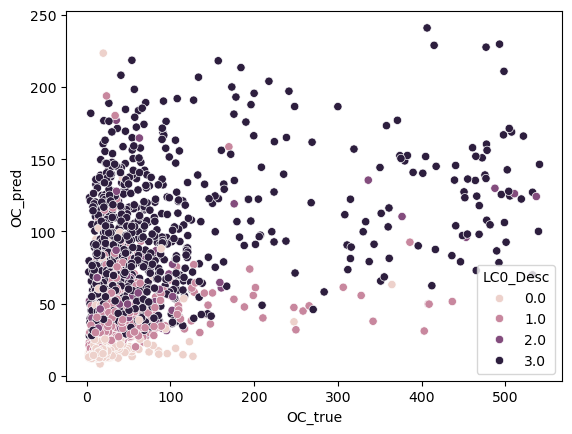

In [103]:
sns.scatterplot(prediction_df, x='OC_true', y='OC_pred', hue='LC0_Desc')

## LightGBM

In [87]:
NOTES = 'LightGBM only with more params for tuning - least cloudy image in last 31 days with additional indexes. Stratify by OC in 10 bins and LC1_Desc combined. min max scaler on numerical values.'

# List of model types to run
model_types = [
    # 'xgboost', 
    'lightgbm', 
    # 'catboost', 
    # 'random_forest', 
    # 'svr'
    ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = 'stratify_bin' # "LC0_Desc"
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
model_type = model_types[0]

print(f"\nTraining model: {model_type.upper()}")
trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

if TUNE:
    trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
else:
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

trainer.evaluate()
trainer.compute_feature_importances()
trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-08 16:12:19,396] A new study created in memory with name: no-name-c7b765c3-d74c-4237-b01d-876ada87b1fa



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.709

[I 2025-08-08 16:12:19,975] Trial 0 finished with value: 3935.027604456847 and parameters: {'n_estimators': 233, 'max_depth': 7, 'learning_rate': 0.017998762609187778, 'num_leaves': 65, 'min_data_in_leaf': 60, 'feature_fraction': 0.8332880003521834, 'bagging_fraction': 0.7098705131626064, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.8001775163015956, 'colsample_by_tree': 0.8338719284654694, 'reg_alpha': 5.380625613231947e-08, 'reg_lambda': 0.003864937003461287}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7331762347763152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7331762347763152
[LightGBM] [Warning] bagging_fraction is set=0.9185604221058684, subsample=0

[I 2025-08-08 16:12:21,591] Trial 1 finished with value: 5064.585692587489 and parameters: {'n_estimators': 415, 'max_depth': 11, 'learning_rate': 0.19413217962014992, 'num_leaves': 149, 'min_data_in_leaf': 51, 'feature_fraction': 0.7331762347763152, 'bagging_fraction': 0.9185604221058684, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.8279762464593386, 'colsample_by_tree': 0.7988822351813016, 'reg_alpha': 0.00031438485201118623, 'reg_lambda': 0.010412733576375833}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:22,191] Trial 2 finished with value: 4998.0660590847465 and parameters: {'n_estimators': 785, 'max_depth': 3, 'learning_rate': 0.0041735830616042805, 'num_leaves': 72, 'min_data_in_leaf': 40, 'feature_fraction': 0.9311876834734967, 'bagging_fraction': 0.9852061764772053, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.9151189405901787, 'colsample_by_tree': 0.8881674727963516, 'reg_alpha': 0.003255944468152412, 'reg_lambda': 0.0003261375586185726}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:23,004] Trial 3 finished with value: 5571.101062302846 and parameters: {'n_estimators': 135, 'max_depth': 12, 'learning_rate': 0.0009810636361914122, 'num_leaves': 114, 'min_data_in_leaf': 45, 'feature_fraction': 0.7577782856936361, 'bagging_fraction': 0.8389515626642261, 'bagging_freq': 1, 'min_child_samples': 64, 'subsample': 0.9113249021794778, 'colsample_by_tree': 0.7898151203024026, 'reg_alpha': 2.539956936733662e-05, 'reg_lambda': 7.294541015472326e-07}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7577782856936361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7577782856936361
[LightGBM] [Warning] bagging_fraction is set=0.8389515626642261, subsample=0.9113249021794778 will be ignored. Current value: bagging_fraction=0.8389515626642261
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7366616786809584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7366616786809584
[LightGBM] [Warning] bagging_fraction is set=0.9606137357408422, subsample=0

[I 2025-08-08 16:12:23,700] Trial 4 finished with value: 4252.0768076859795 and parameters: {'n_estimators': 160, 'max_depth': 10, 'learning_rate': 0.021819330787893092, 'num_leaves': 65, 'min_data_in_leaf': 58, 'feature_fraction': 0.7366616786809584, 'bagging_fraction': 0.9606137357408422, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.8683826899477843, 'colsample_by_tree': 0.9241610793936811, 'reg_alpha': 0.0004918491263863077, 'reg_lambda': 6.452201625393744e-06}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:24,082] Trial 5 finished with value: 4458.294439711306 and parameters: {'n_estimators': 519, 'max_depth': 3, 'learning_rate': 0.18064013835191242, 'num_leaves': 125, 'min_data_in_leaf': 32, 'feature_fraction': 0.863463025089693, 'bagging_fraction': 0.9516147081144436, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.8473595930211025, 'colsample_by_tree': 0.8475957538254728, 'reg_alpha': 1.3749150218778296e-07, 'reg_lambda': 6.828939759507414e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:26,640] Trial 6 finished with value: 6166.344408023363 and parameters: {'n_estimators': 425, 'max_depth': 11, 'learning_rate': 0.00033766258153843754, 'num_leaves': 104, 'min_data_in_leaf': 31, 'feature_fraction': 0.8318157635363888, 'bagging_fraction': 0.8963001327072728, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.7538896601619773, 'colsample_by_tree': 0.7825046097520086, 'reg_alpha': 2.0648414627165987e-06, 'reg_lambda': 0.003467659421946657}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8318157635363888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8318157635363888
[LightGBM] [Warning] bagging_fraction is set=0.8963001327072728, subsample=0.7538896601619773 will be ignored. Current value: bagging_fraction=0.8963001327072728
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091820663723331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091820663723331
[LightGBM] [Warning] bagging_fraction is set=0.930435071402809, subsample=0.

[I 2025-08-08 16:12:28,974] Trial 7 finished with value: 4853.188461644304 and parameters: {'n_estimators': 794, 'max_depth': 12, 'learning_rate': 0.0063161925527327025, 'num_leaves': 43, 'min_data_in_leaf': 44, 'feature_fraction': 0.8091820663723331, 'bagging_fraction': 0.930435071402809, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.7085588594811276, 'colsample_by_tree': 0.615866000563042, 'reg_alpha': 5.108270576727618e-07, 'reg_lambda': 0.026347074618641404}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091820663723331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091820663723331
[LightGBM] [Warning] bagging_fraction is set=0.930435071402809, subsample=0.7085588594811276 will be ignored. Current value: bagging_fraction=0.930435071402809
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-08 16:12:29,551] Trial 8 finished with value: 4780.98893387474 and parameters: {'n_estimators': 582, 'max_depth': 4, 'learning_rate': 0.12345404293402763, 'num_leaves': 112, 'min_data_in_leaf': 53, 'feature_fraction': 0.8227030443396666, 'bagging_fraction': 0.9777195334756691, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.684864024826792, 'colsample_by_tree': 0.7411576233335385, 'reg_alpha': 2.43513430933555, 'reg_lambda': 0.20170543274009908}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:31,487] Trial 9 finished with value: 6181.71302158856 and parameters: {'n_estimators': 297, 'max_depth': 15, 'learning_rate': 0.00010282050535061228, 'num_leaves': 103, 'min_data_in_leaf': 44, 'feature_fraction': 0.9388806902681216, 'bagging_fraction': 0.8052969886311134, 'bagging_freq': 2, 'min_child_samples': 62, 'subsample': 0.7112216456026889, 'colsample_by_tree': 0.9857224739011115, 'reg_alpha': 1.0684702267067714, 'reg_lambda': 3.484807374759831e-08}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9388806902681216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388806902681216
[LightGBM] [Warning] bagging_fraction is set=0.8052969886311134, subsample=0.7112216456026889 will be ignored. Current value: bagging_fraction=0.8052969886311134
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9967022275548696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9967022275548696
[LightGBM] [Warning] bagging_fraction is set=0.7073088126782593, subsample=0

[I 2025-08-08 16:12:33,485] Trial 10 finished with value: 4125.139124188693 and parameters: {'n_estimators': 992, 'max_depth': 7, 'learning_rate': 0.02558852486956274, 'num_leaves': 27, 'min_data_in_leaf': 20, 'feature_fraction': 0.9967022275548696, 'bagging_fraction': 0.7073088126782593, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.9885405762494189, 'colsample_by_tree': 0.6567407690737234, 'reg_alpha': 1.4081096843604879e-08, 'reg_lambda': 1.0247038275787743}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9967022275548696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9967022275548696
[LightGBM] [Warning] bagging_fraction is set=0.7073088126782593, subsample=0.9885405762494189 will be ignored. Current value: bagging_fraction=0.7073088126782593
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9954155469297326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9954155469297326
[LightGBM] [Warning] bagging_fraction is set=0.7118618166000587, subsample=0.

[I 2025-08-08 16:12:34,834] Trial 11 finished with value: 4158.3305872063875 and parameters: {'n_estimators': 952, 'max_depth': 7, 'learning_rate': 0.022421391406769, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.9954155469297326, 'bagging_fraction': 0.7118618166000587, 'bagging_freq': 3, 'min_child_samples': 8, 'subsample': 0.99208835929546, 'colsample_by_tree': 0.6774336807529188, 'reg_alpha': 2.610192420157907e-08, 'reg_lambda': 4.20652652389783}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9954155469297326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9954155469297326
[LightGBM] [Warning] bagging_fraction is set=0.7118618166000587, subsample=0.99208835929546 will be ignored. Current value: bagging_fraction=0.7118618166000587
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGB

[I 2025-08-08 16:12:35,803] Trial 12 finished with value: 3979.014834768864 and parameters: {'n_estimators': 640, 'max_depth': 7, 'learning_rate': 0.030801254063697707, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.8953299371600191, 'bagging_fraction': 0.7063767848525209, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.6276724156452418, 'colsample_by_tree': 0.7031153158404431, 'reg_alpha': 1.1280437434338957e-08, 'reg_lambda': 5.479030163600142}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8953299371600191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8953299371600191
[LightGBM] [Warning] bagging_fraction is set=0.7063767848525209, subsample=0.6276724156452418 will be ignored. Current value: bagging_fraction=0.7063767848525209
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8890540120345438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8890540120345438
[LightGBM] [Warning] bagging_fraction is set=0.778251616390281, subsample=0.6

[I 2025-08-08 16:12:37,560] Trial 13 finished with value: 4305.702813945077 and parameters: {'n_estimators': 696, 'max_depth': 7, 'learning_rate': 0.04892577455879212, 'num_leaves': 54, 'min_data_in_leaf': 30, 'feature_fraction': 0.8890540120345438, 'bagging_fraction': 0.778251616390281, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.6093480237223198, 'colsample_by_tree': 0.7406246374091403, 'reg_alpha': 1.7228306631093644e-06, 'reg_lambda': 5.846726824810055}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:38,209] Trial 14 finished with value: 4372.692716598003 and parameters: {'n_estimators': 295, 'max_depth': 5, 'learning_rate': 0.004488605524763799, 'num_leaves': 85, 'min_data_in_leaf': 37, 'feature_fraction': 0.7838190265522413, 'bagging_fraction': 0.7533376151657047, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.6315596592291131, 'colsample_by_tree': 0.6982238035804601, 'reg_alpha': 0.023533287649153332, 'reg_lambda': 0.06673154326146905}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:39,912] Trial 15 finished with value: 4117.936531247708 and parameters: {'n_estimators': 627, 'max_depth': 8, 'learning_rate': 0.00855561111648005, 'num_leaves': 40, 'min_data_in_leaf': 60, 'feature_fraction': 0.8895977395339966, 'bagging_fraction': 0.7478288577748059, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.7752544886984761, 'colsample_by_tree': 0.8733871647665198, 'reg_alpha': 2.2115668175460935e-05, 'reg_lambda': 0.0006909840808648378}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:40,865] Trial 16 finished with value: 4996.997126910117 and parameters: {'n_estimators': 464, 'max_depth': 5, 'learning_rate': 0.0016419900725769398, 'num_leaves': 79, 'min_data_in_leaf': 25, 'feature_fraction': 0.9098223046818021, 'bagging_fraction': 0.8604326232141971, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.6579465175018854, 'colsample_by_tree': 0.6033471516086082, 'reg_alpha': 8.013535910928688e-08, 'reg_lambda': 1.7196775731885008e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9098223046818021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9098223046818021
[LightGBM] [Warning] bagging_fraction is set=0.8604326232141971, subsample=0.6579465175018854 will be ignored. Current value: bagging_fraction=0.8604326232

[I 2025-08-08 16:12:41,551] Trial 17 finished with value: 4862.012681905183 and parameters: {'n_estimators': 285, 'max_depth': 9, 'learning_rate': 0.04468705456554602, 'num_leaves': 54, 'min_data_in_leaf': 52, 'feature_fraction': 0.8585626884405562, 'bagging_fraction': 0.7391874485529186, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.7507648776188115, 'colsample_by_tree': 0.7282372346917564, 'reg_alpha': 1.180979705143402e-08, 'reg_lambda': 0.27534548138885745}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:42,924] Trial 18 finished with value: 4603.087804010057 and parameters: {'n_estimators': 747, 'max_depth': 6, 'learning_rate': 0.0675231483629581, 'num_leaves': 34, 'min_data_in_leaf': 26, 'feature_fraction': 0.9546830418890326, 'bagging_fraction': 0.8023955560640613, 'bagging_freq': 3, 'min_child_samples': 21, 'subsample': 0.8141736945137473, 'colsample_by_tree': 0.8435795461339839, 'reg_alpha': 4.5080128816410983e-07, 'reg_lambda': 0.0027359751726254472}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9546830418890326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9546830418890326
[LightGBM] [Warning] bagging_fraction is set=0.8023955560640613, subsample=0.8141736945137473 will be ignored. Current value: bagging_fraction=0.8023955560

[I 2025-08-08 16:12:46,567] Trial 19 finished with value: 4298.301035907178 and parameters: {'n_estimators': 893, 'max_depth': 14, 'learning_rate': 0.012117022191920906, 'num_leaves': 92, 'min_data_in_leaf': 36, 'feature_fraction': 0.7928103014088352, 'bagging_fraction': 0.7027569574202184, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.7865251000997597, 'colsample_by_tree': 0.9481211620069858, 'reg_alpha': 2.354221079325519e-05, 'reg_lambda': 1.3588027294599859e-07}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7928103014088352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7928103014088352
[LightGBM] [Warning] bagging_fraction is set=0.7027569574202184, subsample=0.7865251000997597 will be ignored. Current value: bagging_fraction=0.7027569574

[I 2025-08-08 16:12:47,401] Trial 20 finished with value: 5547.928388343751 and parameters: {'n_estimators': 226, 'max_depth': 9, 'learning_rate': 0.0021584923204968037, 'num_leaves': 57, 'min_data_in_leaf': 56, 'feature_fraction': 0.8524544974717007, 'bagging_fraction': 0.7749981447180537, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.8804441892890836, 'colsample_by_tree': 0.8298082465525065, 'reg_alpha': 0.063934571380624, 'reg_lambda': 2.6481826748306708e-06}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8524544974717007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524544974717007
[LightGBM] [Warning] bagging_fraction is set=0.7749981447180537, subsample=0.8804441892890836 will be ignored. Current value: bagging_fraction=0.7749981447180537
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8835434653917921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8835434653917921
[LightGBM] [Warning] bagging_fraction is set=0.7293246937356951, subsample=0

[I 2025-08-08 16:12:48,773] Trial 21 finished with value: 4605.676551103424 and parameters: {'n_estimators': 638, 'max_depth': 8, 'learning_rate': 0.00893571341982609, 'num_leaves': 40, 'min_data_in_leaf': 60, 'feature_fraction': 0.8835434653917921, 'bagging_fraction': 0.7293246937356951, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.7787824097209003, 'colsample_by_tree': 0.8770856379087142, 'reg_alpha': 2.4179301906219002e-05, 'reg_lambda': 0.000542696937237568}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[LightGBM] [Warning] bagging_fraction is set=0.7557190621853171, subsample=0.7423437760252423 will be ignored. Current value: bagging_fraction=0.7557190621853171
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[LightGBM] [Warning] bagging_fraction is set=0.7557190621853171, subsample=0

[I 2025-08-08 16:12:49,789] Trial 22 finished with value: 4342.000106555325 and parameters: {'n_estimators': 617, 'max_depth': 8, 'learning_rate': 0.01840017148545832, 'num_leaves': 20, 'min_data_in_leaf': 48, 'feature_fraction': 0.9054309948192564, 'bagging_fraction': 0.7557190621853171, 'bagging_freq': 3, 'min_child_samples': 14, 'subsample': 0.7423437760252423, 'colsample_by_tree': 0.8964462312260257, 'reg_alpha': 4.345273048848317e-06, 'reg_lambda': 6.55268020580818e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[Ligh

[I 2025-08-08 16:12:50,537] Trial 23 finished with value: 4960.423147014365 and parameters: {'n_estimators': 521, 'max_depth': 6, 'learning_rate': 0.0800962551117142, 'num_leaves': 39, 'min_data_in_leaf': 56, 'feature_fraction': 0.875919296483278, 'bagging_fraction': 0.72873533633523, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.6603680713446664, 'colsample_by_tree': 0.8261115374243422, 'reg_alpha': 1.350491556698674e-07, 'reg_lambda': 0.001145014856271263}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:51,673] Trial 24 finished with value: 4656.673802744753 and parameters: {'n_estimators': 368, 'max_depth': 8, 'learning_rate': 0.010756429305522725, 'num_leaves': 53, 'min_data_in_leaf': 60, 'feature_fraction': 0.83646116883108, 'bagging_fraction': 0.7780828513284308, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.6026676846086688, 'colsample_by_tree': 0.7627869134074361, 'reg_alpha': 0.00015301159882048104, 'reg_lambda': 0.017219329704694506}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.83646116883108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.83646116883108
[LightGBM] [Warning] bagging_fraction is set=0.7780828513284308, subsample=0.6026676846086688 will be ignored. Current value: bagging_fraction=0.7780828513284308
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=37 wi

[I 2025-08-08 16:12:53,024] Trial 25 finished with value: 4650.696490050531 and parameters: {'n_estimators': 666, 'max_depth': 6, 'learning_rate': 0.0028285290079864247, 'num_leaves': 30, 'min_data_in_leaf': 49, 'feature_fraction': 0.958711752951411, 'bagging_fraction': 0.8273499566487541, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.7131827692156621, 'colsample_by_tree': 0.8638796309498653, 'reg_alpha': 7.519737666611526e-08, 'reg_lambda': 4.7737933610369204e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.958711752951411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.958711752951411
[LightGBM] [Warning] bagging_fraction is set=0.8273499566487541, subsample=0.7131827692156621 will be ignored. Current value: bagging_fraction=0.8273499566487541
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9155095559328578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9155095559328578
[LightGBM] [Warning] bagging_fraction is set=0.7458896268383255, subsample=0.9

[I 2025-08-08 16:12:55,194] Trial 26 finished with value: 4702.316079468799 and parameters: {'n_estimators': 877, 'max_depth': 9, 'learning_rate': 0.03566796151305685, 'num_leaves': 45, 'min_data_in_leaf': 55, 'feature_fraction': 0.9155095559328578, 'bagging_fraction': 0.7458896268383255, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.9293775979441339, 'colsample_by_tree': 0.9417564192286956, 'reg_alpha': 6.258856526004541e-07, 'reg_lambda': 0.6264910056312971}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-08 16:12:55,943] Trial 27 finished with value: 5172.700942650838 and parameters: {'n_estimators': 545, 'max_depth': 5, 'learning_rate': 0.29178203932998176, 'num_leaves': 64, 'min_data_in_leaf': 40, 'feature_fraction': 0.8917930802820786, 'bagging_fraction': 0.868415411939179, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.7971432890963859, 'colsample_by_tree': 0.9962361459302638, 'reg_alpha': 5.7462499099923015e-06, 'reg_lambda': 0.06725134376165477}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8917930802820786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8917930802820786
[LightGBM] [Warning] bagging_fraction is set=0.868415411939179, subsample=0.7971432890963859 will be ignored. Current value: bagging_fraction=0.868415411939179
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8422033673930603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422033673930603
[LightGBM] [Warning] bagging_fraction is set=0.7011352277664987, subsample=0.8

[I 2025-08-08 16:12:58,927] Trial 28 finished with value: 4988.293560035385 and parameters: {'n_estimators': 686, 'max_depth': 10, 'learning_rate': 0.0009200427093528883, 'num_leaves': 71, 'min_data_in_leaf': 58, 'feature_fraction': 0.8422033673930603, 'bagging_fraction': 0.7011352277664987, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.8322865742535625, 'colsample_by_tree': 0.8143893995262107, 'reg_alpha': 0.0013776384798438815, 'reg_lambda': 0.004278886978491552}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8422033673930603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422033673930603
[LightGBM] [Warning] bagging_fraction is set=0.7011352277664987, subsample=0.8322865742535625 will be ignored. Current value: bagging_fraction=0.7011352277

[I 2025-08-08 16:12:59,953] Trial 29 finished with value: 4358.31517481187 and parameters: {'n_estimators': 452, 'max_depth': 7, 'learning_rate': 0.007033582363837503, 'num_leaves': 29, 'min_data_in_leaf': 50, 'feature_fraction': 0.7131407462643853, 'bagging_fraction': 0.7229041164994264, 'bagging_freq': 3, 'min_child_samples': 39, 'subsample': 0.9525908531025352, 'colsample_by_tree': 0.9134777127328935, 'reg_alpha': 6.412798222022611e-05, 'reg_lambda': 0.00013321580088091923}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7131407462643853, colsample_bytree=1.

100%|===================| 12059/12078 [01:14<00:00]        

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0

In [92]:
# Save predictions
prediction_df = trainer.X_test
prediction_df['OC_true'] = trainer.y_test
prediction_df['OC_pred'] = trainer.y_pred_test

In [99]:
prediction_df.to_csv("data/modelling/prediction_csvs/lightgbm/20250803_lightgbm_predictions_experiment14.csv", index=False)

<Axes: xlabel='OC_true', ylabel='OC_pred'>

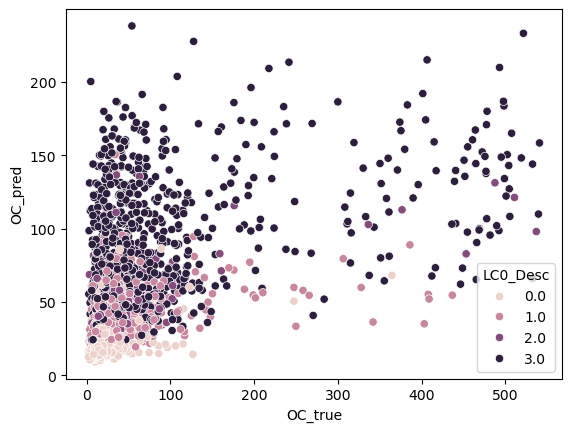

In [98]:
sns.scatterplot(prediction_df, x='OC_true', y='OC_pred', hue='LC0_Desc')

## CatBoost

In [104]:
NOTES = 'CatBoost only with more params for tuning - least cloudy image in last 31 days with additional indexes. Stratify by OC in 10 bins and LC1_Desc combined. min max scaler on numerical values.'

# List of model types to run
model_types = [
    # 'xgboost', 
    # 'lightgbm', 
    'catboost', 
    # 'random_forest', 
    # 'svr'
    ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = 'stratify_bin' # "LC0_Desc"
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
model_type = model_types[0]

print(f"\nTraining model: {model_type.upper()}")
trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

if TUNE:
    trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
else:
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

trainer.evaluate()
trainer.compute_feature_importances()
trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-08 16:56:20,026] A new study created in memory with name: no-name-69b73963-984c-4d39-9c69-9141c333cc97



Training model: CATBOOST


[I 2025-08-08 16:56:20,945] Trial 0 finished with value: 4709.986262321348 and parameters: {'depth': 5, 'learning_rate': 0.00045580032359954264, 'l2_leaf_reg': 0.04341872992644065, 'iterations': 612, 'bagging_temperature': 0.8853129245118829, 'random_strength': 0.4652226445932699, 'rsm': 0.9179598300908323, 'border_count': 172}. Best is trial 0 with value: 4709.986262321348.
[I 2025-08-08 16:56:22,911] Trial 1 finished with value: 4981.994857496227 and parameters: {'depth': 7, 'learning_rate': 0.0002484463597161608, 'l2_leaf_reg': 8.826405800783647, 'iterations': 1211, 'bagging_temperature': 0.7333073529253652, 'random_strength': 0.08967296968590899, 'rsm': 0.9360021415380502, 'border_count': 41}. Best is trial 0 with value: 4709.986262321348.
[I 2025-08-08 16:56:23,243] Trial 2 finished with value: 5877.408676422542 and parameters: {'depth': 3, 'learning_rate': 0.0006116558796987284, 'l2_leaf_reg': 0.04945090227375296, 'iterations': 473, 'bagging_temperature': 0.8714917663948989, 'ran

In [105]:
# Save predictions
prediction_df = trainer.X_test
prediction_df['OC_true'] = trainer.y_test
prediction_df['OC_pred'] = trainer.y_pred_test

In [106]:
prediction_df.to_csv("data/modelling/prediction_csvs/catboost/20250803_catboost_predictions_experiment14.csv", index=False)

<Axes: xlabel='OC_true', ylabel='OC_pred'>

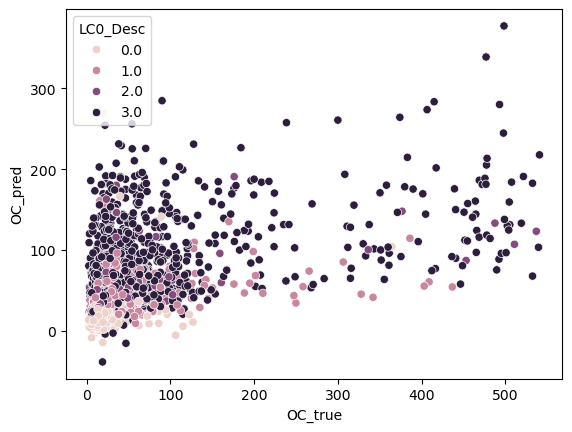

In [107]:
sns.scatterplot(prediction_df, x='OC_true', y='OC_pred', hue='LC0_Desc')

## LightGBM

In [ ]:
NOTES = 'LightGBM only with more params for tuning - least cloudy image in last 31 days with additional indexes. Stratify by OC in 10 bins and LC1_Desc combined. min max scaler on numerical values.'

# List of model types to run
model_types = [
    # 'xgboost', 
    'lightgbm', 
    # 'catboost', 
    # 'random_forest', 
    # 'svr'
    ]

# Shared configuration
TARGET_COL = 'OC'                     # Target to predict
ID_COLS = ['point_id', 'N']                    # Unique identifiers
DROP_COLS = ['survey_date', 'stratify_bin', 'QA_RADSTAT']               # Columns to drop from input
TEST_SIZE = 0.2                           # Train-test split size
USE_LOG_TARGET = False                     # Whether to log-transform the target
TUNE = True                               # Whether to run Optuna tuning
CUSTOM_PARAMS = {}                        # Provide your own params if TUNE = False
N_TRIALS = 30                             # Optuna trials
TIMEOUT = 300                             # Optuna timeout in seconds
stratifyby = 'stratify_bin' # "LC0_Desc"
results_file = f"experiment_tracking/raw_experiment_log_{TARGET_COL}.xlsx"
params_file = f"experiment_tracking/best_params_{TARGET_COL}.xlsx"
importance_file = f"experiment_tracking/raw_feature_analysis_{TARGET_COL}.xlsx"

SAVE_MODEL = True

# Loop over models
model_type = model_types[0]

print(f"\nTraining model: {model_type.upper()}")
trainer = ModelTrainer(df=enc_df, target_col=TARGET_COL, id_cols=ID_COLS, drop_cols=DROP_COLS, model_type=model_type, notes=NOTES)
trainer.prepare_data(test_size=TEST_SIZE, stratifyby=stratifyby)

if TUNE:
    trainer.tune_hyperparams(n_trials=N_TRIALS, timeout=TIMEOUT)
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, save_model=SAVE_MODEL)
else:
    trainer.train_final_model(use_log_target=USE_LOG_TARGET, custom_params=CUSTOM_PARAMS, save_model=SAVE_MODEL)

trainer.evaluate()
trainer.compute_feature_importances()
trainer.save_results(model_log_path=results_file, importance_log_path=importance_file)

[I 2025-08-08 16:12:19,396] A new study created in memory with name: no-name-c7b765c3-d74c-4237-b01d-876ada87b1fa



Training model: LIGHTGBM
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.709

[I 2025-08-08 16:12:19,975] Trial 0 finished with value: 3935.027604456847 and parameters: {'n_estimators': 233, 'max_depth': 7, 'learning_rate': 0.017998762609187778, 'num_leaves': 65, 'min_data_in_leaf': 60, 'feature_fraction': 0.8332880003521834, 'bagging_fraction': 0.7098705131626064, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.8001775163015956, 'colsample_by_tree': 0.8338719284654694, 'reg_alpha': 5.380625613231947e-08, 'reg_lambda': 0.003864937003461287}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7331762347763152, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7331762347763152
[LightGBM] [Warning] bagging_fraction is set=0.9185604221058684, subsample=0

[I 2025-08-08 16:12:21,591] Trial 1 finished with value: 5064.585692587489 and parameters: {'n_estimators': 415, 'max_depth': 11, 'learning_rate': 0.19413217962014992, 'num_leaves': 149, 'min_data_in_leaf': 51, 'feature_fraction': 0.7331762347763152, 'bagging_fraction': 0.9185604221058684, 'bagging_freq': 3, 'min_child_samples': 40, 'subsample': 0.8279762464593386, 'colsample_by_tree': 0.7988822351813016, 'reg_alpha': 0.00031438485201118623, 'reg_lambda': 0.010412733576375833}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:22,191] Trial 2 finished with value: 4998.0660590847465 and parameters: {'n_estimators': 785, 'max_depth': 3, 'learning_rate': 0.0041735830616042805, 'num_leaves': 72, 'min_data_in_leaf': 40, 'feature_fraction': 0.9311876834734967, 'bagging_fraction': 0.9852061764772053, 'bagging_freq': 2, 'min_child_samples': 81, 'subsample': 0.9151189405901787, 'colsample_by_tree': 0.8881674727963516, 'reg_alpha': 0.003255944468152412, 'reg_lambda': 0.0003261375586185726}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:23,004] Trial 3 finished with value: 5571.101062302846 and parameters: {'n_estimators': 135, 'max_depth': 12, 'learning_rate': 0.0009810636361914122, 'num_leaves': 114, 'min_data_in_leaf': 45, 'feature_fraction': 0.7577782856936361, 'bagging_fraction': 0.8389515626642261, 'bagging_freq': 1, 'min_child_samples': 64, 'subsample': 0.9113249021794778, 'colsample_by_tree': 0.7898151203024026, 'reg_alpha': 2.539956936733662e-05, 'reg_lambda': 7.294541015472326e-07}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7577782856936361, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7577782856936361
[LightGBM] [Warning] bagging_fraction is set=0.8389515626642261, subsample=0.9113249021794778 will be ignored. Current value: bagging_fraction=0.8389515626642261
[LightGBM] [Warning] min_data_in_leaf is set=45, min_child_samples=64 will be ignored. Current value: min_data_in_leaf=45
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.7366616786809584, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7366616786809584
[LightGBM] [Warning] bagging_fraction is set=0.9606137357408422, subsample=0

[I 2025-08-08 16:12:23,700] Trial 4 finished with value: 4252.0768076859795 and parameters: {'n_estimators': 160, 'max_depth': 10, 'learning_rate': 0.021819330787893092, 'num_leaves': 65, 'min_data_in_leaf': 58, 'feature_fraction': 0.7366616786809584, 'bagging_fraction': 0.9606137357408422, 'bagging_freq': 2, 'min_child_samples': 89, 'subsample': 0.8683826899477843, 'colsample_by_tree': 0.9241610793936811, 'reg_alpha': 0.0004918491263863077, 'reg_lambda': 6.452201625393744e-06}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:24,082] Trial 5 finished with value: 4458.294439711306 and parameters: {'n_estimators': 519, 'max_depth': 3, 'learning_rate': 0.18064013835191242, 'num_leaves': 125, 'min_data_in_leaf': 32, 'feature_fraction': 0.863463025089693, 'bagging_fraction': 0.9516147081144436, 'bagging_freq': 2, 'min_child_samples': 80, 'subsample': 0.8473595930211025, 'colsample_by_tree': 0.8475957538254728, 'reg_alpha': 1.3749150218778296e-07, 'reg_lambda': 6.828939759507414e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:26,640] Trial 6 finished with value: 6166.344408023363 and parameters: {'n_estimators': 425, 'max_depth': 11, 'learning_rate': 0.00033766258153843754, 'num_leaves': 104, 'min_data_in_leaf': 31, 'feature_fraction': 0.8318157635363888, 'bagging_fraction': 0.8963001327072728, 'bagging_freq': 3, 'min_child_samples': 79, 'subsample': 0.7538896601619773, 'colsample_by_tree': 0.7825046097520086, 'reg_alpha': 2.0648414627165987e-06, 'reg_lambda': 0.003467659421946657}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8318157635363888, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8318157635363888
[LightGBM] [Warning] bagging_fraction is set=0.8963001327072728, subsample=0.7538896601619773 will be ignored. Current value: bagging_fraction=0.8963001327072728
[LightGBM] [Warning] min_data_in_leaf is set=31, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=31
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091820663723331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091820663723331
[LightGBM] [Warning] bagging_fraction is set=0.930435071402809, subsample=0.

[I 2025-08-08 16:12:28,974] Trial 7 finished with value: 4853.188461644304 and parameters: {'n_estimators': 794, 'max_depth': 12, 'learning_rate': 0.0063161925527327025, 'num_leaves': 43, 'min_data_in_leaf': 44, 'feature_fraction': 0.8091820663723331, 'bagging_fraction': 0.930435071402809, 'bagging_freq': 2, 'min_child_samples': 27, 'subsample': 0.7085588594811276, 'colsample_by_tree': 0.615866000563042, 'reg_alpha': 5.108270576727618e-07, 'reg_lambda': 0.026347074618641404}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8091820663723331, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8091820663723331
[LightGBM] [Warning] bagging_fraction is set=0.930435071402809, subsample=0.7085588594811276 will be ignored. Current value: bagging_fraction=0.930435071402809
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=27 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set

[I 2025-08-08 16:12:29,551] Trial 8 finished with value: 4780.98893387474 and parameters: {'n_estimators': 582, 'max_depth': 4, 'learning_rate': 0.12345404293402763, 'num_leaves': 112, 'min_data_in_leaf': 53, 'feature_fraction': 0.8227030443396666, 'bagging_fraction': 0.9777195334756691, 'bagging_freq': 2, 'min_child_samples': 88, 'subsample': 0.684864024826792, 'colsample_by_tree': 0.7411576233335385, 'reg_alpha': 2.43513430933555, 'reg_lambda': 0.20170543274009908}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:31,487] Trial 9 finished with value: 6181.71302158856 and parameters: {'n_estimators': 297, 'max_depth': 15, 'learning_rate': 0.00010282050535061228, 'num_leaves': 103, 'min_data_in_leaf': 44, 'feature_fraction': 0.9388806902681216, 'bagging_fraction': 0.8052969886311134, 'bagging_freq': 2, 'min_child_samples': 62, 'subsample': 0.7112216456026889, 'colsample_by_tree': 0.9857224739011115, 'reg_alpha': 1.0684702267067714, 'reg_lambda': 3.484807374759831e-08}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.9388806902681216, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9388806902681216
[LightGBM] [Warning] bagging_fraction is set=0.8052969886311134, subsample=0.7112216456026889 will be ignored. Current value: bagging_fraction=0.8052969886311134
[LightGBM] [Warning] min_data_in_leaf is set=44, min_child_samples=62 will be ignored. Current value: min_data_in_leaf=44
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9967022275548696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9967022275548696
[LightGBM] [Warning] bagging_fraction is set=0.7073088126782593, subsample=0

[I 2025-08-08 16:12:33,485] Trial 10 finished with value: 4125.139124188693 and parameters: {'n_estimators': 992, 'max_depth': 7, 'learning_rate': 0.02558852486956274, 'num_leaves': 27, 'min_data_in_leaf': 20, 'feature_fraction': 0.9967022275548696, 'bagging_fraction': 0.7073088126782593, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.9885405762494189, 'colsample_by_tree': 0.6567407690737234, 'reg_alpha': 1.4081096843604879e-08, 'reg_lambda': 1.0247038275787743}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9967022275548696, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9967022275548696
[LightGBM] [Warning] bagging_fraction is set=0.7073088126782593, subsample=0.9885405762494189 will be ignored. Current value: bagging_fraction=0.7073088126782593
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9954155469297326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9954155469297326
[LightGBM] [Warning] bagging_fraction is set=0.7118618166000587, subsample=0.

[I 2025-08-08 16:12:34,834] Trial 11 finished with value: 4158.3305872063875 and parameters: {'n_estimators': 952, 'max_depth': 7, 'learning_rate': 0.022421391406769, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.9954155469297326, 'bagging_fraction': 0.7118618166000587, 'bagging_freq': 3, 'min_child_samples': 8, 'subsample': 0.99208835929546, 'colsample_by_tree': 0.6774336807529188, 'reg_alpha': 2.610192420157907e-08, 'reg_lambda': 4.20652652389783}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9954155469297326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9954155469297326
[LightGBM] [Warning] bagging_fraction is set=0.7118618166000587, subsample=0.99208835929546 will be ignored. Current value: bagging_fraction=0.7118618166000587
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=8 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGB

[I 2025-08-08 16:12:35,803] Trial 12 finished with value: 3979.014834768864 and parameters: {'n_estimators': 640, 'max_depth': 7, 'learning_rate': 0.030801254063697707, 'num_leaves': 20, 'min_data_in_leaf': 21, 'feature_fraction': 0.8953299371600191, 'bagging_fraction': 0.7063767848525209, 'bagging_freq': 3, 'min_child_samples': 6, 'subsample': 0.6276724156452418, 'colsample_by_tree': 0.7031153158404431, 'reg_alpha': 1.1280437434338957e-08, 'reg_lambda': 5.479030163600142}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8953299371600191, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8953299371600191
[LightGBM] [Warning] bagging_fraction is set=0.7063767848525209, subsample=0.6276724156452418 will be ignored. Current value: bagging_fraction=0.7063767848525209
[LightGBM] [Warning] min_data_in_leaf is set=21, min_child_samples=6 will be ignored. Current value: min_data_in_leaf=21
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8890540120345438, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8890540120345438
[LightGBM] [Warning] bagging_fraction is set=0.778251616390281, subsample=0.6

[I 2025-08-08 16:12:37,560] Trial 13 finished with value: 4305.702813945077 and parameters: {'n_estimators': 696, 'max_depth': 7, 'learning_rate': 0.04892577455879212, 'num_leaves': 54, 'min_data_in_leaf': 30, 'feature_fraction': 0.8890540120345438, 'bagging_fraction': 0.778251616390281, 'bagging_freq': 3, 'min_child_samples': 100, 'subsample': 0.6093480237223198, 'colsample_by_tree': 0.7406246374091403, 'reg_alpha': 1.7228306631093644e-06, 'reg_lambda': 5.846726824810055}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:38,209] Trial 14 finished with value: 4372.692716598003 and parameters: {'n_estimators': 295, 'max_depth': 5, 'learning_rate': 0.004488605524763799, 'num_leaves': 85, 'min_data_in_leaf': 37, 'feature_fraction': 0.7838190265522413, 'bagging_fraction': 0.7533376151657047, 'bagging_freq': 1, 'min_child_samples': 43, 'subsample': 0.6315596592291131, 'colsample_by_tree': 0.6982238035804601, 'reg_alpha': 0.023533287649153332, 'reg_lambda': 0.06673154326146905}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:39,912] Trial 15 finished with value: 4117.936531247708 and parameters: {'n_estimators': 627, 'max_depth': 8, 'learning_rate': 0.00855561111648005, 'num_leaves': 40, 'min_data_in_leaf': 60, 'feature_fraction': 0.8895977395339966, 'bagging_fraction': 0.7478288577748059, 'bagging_freq': 3, 'min_child_samples': 23, 'subsample': 0.7752544886984761, 'colsample_by_tree': 0.8733871647665198, 'reg_alpha': 2.2115668175460935e-05, 'reg_lambda': 0.0006909840808648378}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:40,865] Trial 16 finished with value: 4996.997126910117 and parameters: {'n_estimators': 464, 'max_depth': 5, 'learning_rate': 0.0016419900725769398, 'num_leaves': 79, 'min_data_in_leaf': 25, 'feature_fraction': 0.9098223046818021, 'bagging_fraction': 0.8604326232141971, 'bagging_freq': 3, 'min_child_samples': 63, 'subsample': 0.6579465175018854, 'colsample_by_tree': 0.6033471516086082, 'reg_alpha': 8.013535910928688e-08, 'reg_lambda': 1.7196775731885008e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9098223046818021, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9098223046818021
[LightGBM] [Warning] bagging_fraction is set=0.8604326232141971, subsample=0.6579465175018854 will be ignored. Current value: bagging_fraction=0.8604326232

[I 2025-08-08 16:12:41,551] Trial 17 finished with value: 4862.012681905183 and parameters: {'n_estimators': 285, 'max_depth': 9, 'learning_rate': 0.04468705456554602, 'num_leaves': 54, 'min_data_in_leaf': 52, 'feature_fraction': 0.8585626884405562, 'bagging_fraction': 0.7391874485529186, 'bagging_freq': 3, 'min_child_samples': 51, 'subsample': 0.7507648776188115, 'colsample_by_tree': 0.7282372346917564, 'reg_alpha': 1.180979705143402e-08, 'reg_lambda': 0.27534548138885745}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:42,924] Trial 18 finished with value: 4603.087804010057 and parameters: {'n_estimators': 747, 'max_depth': 6, 'learning_rate': 0.0675231483629581, 'num_leaves': 34, 'min_data_in_leaf': 26, 'feature_fraction': 0.9546830418890326, 'bagging_fraction': 0.8023955560640613, 'bagging_freq': 3, 'min_child_samples': 21, 'subsample': 0.8141736945137473, 'colsample_by_tree': 0.8435795461339839, 'reg_alpha': 4.5080128816410983e-07, 'reg_lambda': 0.0027359751726254472}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9546830418890326, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9546830418890326
[LightGBM] [Warning] bagging_fraction is set=0.8023955560640613, subsample=0.8141736945137473 will be ignored. Current value: bagging_fraction=0.8023955560

[I 2025-08-08 16:12:46,567] Trial 19 finished with value: 4298.301035907178 and parameters: {'n_estimators': 893, 'max_depth': 14, 'learning_rate': 0.012117022191920906, 'num_leaves': 92, 'min_data_in_leaf': 36, 'feature_fraction': 0.7928103014088352, 'bagging_fraction': 0.7027569574202184, 'bagging_freq': 1, 'min_child_samples': 32, 'subsample': 0.7865251000997597, 'colsample_by_tree': 0.9481211620069858, 'reg_alpha': 2.354221079325519e-05, 'reg_lambda': 1.3588027294599859e-07}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.7928103014088352, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7928103014088352
[LightGBM] [Warning] bagging_fraction is set=0.7027569574202184, subsample=0.7865251000997597 will be ignored. Current value: bagging_fraction=0.7027569574

[I 2025-08-08 16:12:47,401] Trial 20 finished with value: 5547.928388343751 and parameters: {'n_estimators': 226, 'max_depth': 9, 'learning_rate': 0.0021584923204968037, 'num_leaves': 57, 'min_data_in_leaf': 56, 'feature_fraction': 0.8524544974717007, 'bagging_fraction': 0.7749981447180537, 'bagging_freq': 3, 'min_child_samples': 72, 'subsample': 0.8804441892890836, 'colsample_by_tree': 0.8298082465525065, 'reg_alpha': 0.063934571380624, 'reg_lambda': 2.6481826748306708e-06}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8524544974717007, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8524544974717007
[LightGBM] [Warning] bagging_fraction is set=0.7749981447180537, subsample=0.8804441892890836 will be ignored. Current value: bagging_fraction=0.7749981447180537
[LightGBM] [Warning] min_data_in_leaf is set=56, min_child_samples=72 will be ignored. Current value: min_data_in_leaf=56
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8835434653917921, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8835434653917921
[LightGBM] [Warning] bagging_fraction is set=0.7293246937356951, subsample=0

[I 2025-08-08 16:12:48,773] Trial 21 finished with value: 4605.676551103424 and parameters: {'n_estimators': 638, 'max_depth': 8, 'learning_rate': 0.00893571341982609, 'num_leaves': 40, 'min_data_in_leaf': 60, 'feature_fraction': 0.8835434653917921, 'bagging_fraction': 0.7293246937356951, 'bagging_freq': 3, 'min_child_samples': 16, 'subsample': 0.7787824097209003, 'colsample_by_tree': 0.8770856379087142, 'reg_alpha': 2.4179301906219002e-05, 'reg_lambda': 0.000542696937237568}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[LightGBM] [Warning] bagging_fraction is set=0.7557190621853171, subsample=0.7423437760252423 will be ignored. Current value: bagging_fraction=0.7557190621853171
[LightGBM] [Warning] min_data_in_leaf is set=48, min_child_samples=14 will be ignored. Current value: min_data_in_leaf=48
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[LightGBM] [Warning] bagging_fraction is set=0.7557190621853171, subsample=0

[I 2025-08-08 16:12:49,789] Trial 22 finished with value: 4342.000106555325 and parameters: {'n_estimators': 617, 'max_depth': 8, 'learning_rate': 0.01840017148545832, 'num_leaves': 20, 'min_data_in_leaf': 48, 'feature_fraction': 0.9054309948192564, 'bagging_fraction': 0.7557190621853171, 'bagging_freq': 3, 'min_child_samples': 14, 'subsample': 0.7423437760252423, 'colsample_by_tree': 0.8964462312260257, 'reg_alpha': 4.345273048848317e-06, 'reg_lambda': 6.55268020580818e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9054309948192564, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9054309948192564
[Ligh

[I 2025-08-08 16:12:50,537] Trial 23 finished with value: 4960.423147014365 and parameters: {'n_estimators': 521, 'max_depth': 6, 'learning_rate': 0.0800962551117142, 'num_leaves': 39, 'min_data_in_leaf': 56, 'feature_fraction': 0.875919296483278, 'bagging_fraction': 0.72873533633523, 'bagging_freq': 3, 'min_child_samples': 29, 'subsample': 0.6603680713446664, 'colsample_by_tree': 0.8261115374243422, 'reg_alpha': 1.350491556698674e-07, 'reg_lambda': 0.001145014856271263}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2025-08-08 16:12:51,673] Trial 24 finished with value: 4656.673802744753 and parameters: {'n_estimators': 368, 'max_depth': 8, 'learning_rate': 0.010756429305522725, 'num_leaves': 53, 'min_data_in_leaf': 60, 'feature_fraction': 0.83646116883108, 'bagging_fraction': 0.7780828513284308, 'bagging_freq': 3, 'min_child_samples': 37, 'subsample': 0.6026676846086688, 'colsample_by_tree': 0.7627869134074361, 'reg_alpha': 0.00015301159882048104, 'reg_lambda': 0.017219329704694506}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.83646116883108, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.83646116883108
[LightGBM] [Warning] bagging_fraction is set=0.7780828513284308, subsample=0.6026676846086688 will be ignored. Current value: bagging_fraction=0.7780828513284308
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=37 wi

[I 2025-08-08 16:12:53,024] Trial 25 finished with value: 4650.696490050531 and parameters: {'n_estimators': 666, 'max_depth': 6, 'learning_rate': 0.0028285290079864247, 'num_leaves': 30, 'min_data_in_leaf': 49, 'feature_fraction': 0.958711752951411, 'bagging_fraction': 0.8273499566487541, 'bagging_freq': 2, 'min_child_samples': 22, 'subsample': 0.7131827692156621, 'colsample_by_tree': 0.8638796309498653, 'reg_alpha': 7.519737666611526e-08, 'reg_lambda': 4.7737933610369204e-05}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.958711752951411, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.958711752951411
[LightGBM] [Warning] bagging_fraction is set=0.8273499566487541, subsample=0.7131827692156621 will be ignored. Current value: bagging_fraction=0.8273499566487541
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=22 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.9155095559328578, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9155095559328578
[LightGBM] [Warning] bagging_fraction is set=0.7458896268383255, subsample=0.9

[I 2025-08-08 16:12:55,194] Trial 26 finished with value: 4702.316079468799 and parameters: {'n_estimators': 877, 'max_depth': 9, 'learning_rate': 0.03566796151305685, 'num_leaves': 45, 'min_data_in_leaf': 55, 'feature_fraction': 0.9155095559328578, 'bagging_fraction': 0.7458896268383255, 'bagging_freq': 3, 'min_child_samples': 48, 'subsample': 0.9293775979441339, 'colsample_by_tree': 0.9417564192286956, 'reg_alpha': 6.258856526004541e-07, 'reg_lambda': 0.6264910056312971}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unkn

[I 2025-08-08 16:12:55,943] Trial 27 finished with value: 5172.700942650838 and parameters: {'n_estimators': 545, 'max_depth': 5, 'learning_rate': 0.29178203932998176, 'num_leaves': 64, 'min_data_in_leaf': 40, 'feature_fraction': 0.8917930802820786, 'bagging_fraction': 0.868415411939179, 'bagging_freq': 2, 'min_child_samples': 12, 'subsample': 0.7971432890963859, 'colsample_by_tree': 0.9962361459302638, 'reg_alpha': 5.7462499099923015e-06, 'reg_lambda': 0.06725134376165477}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=2, subsample_freq=0 will be ignored. Current value: bagging_freq=2
[LightGBM] [Warning] feature_fraction is set=0.8917930802820786, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8917930802820786
[LightGBM] [Warning] bagging_fraction is set=0.868415411939179, subsample=0.7971432890963859 will be ignored. Current value: bagging_fraction=0.868415411939179
[LightGBM] [Warning] min_data_in_leaf is set=40, min_child_samples=12 will be ignored. Current value: min_data_in_leaf=40
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8422033673930603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422033673930603
[LightGBM] [Warning] bagging_fraction is set=0.7011352277664987, subsample=0.8

[I 2025-08-08 16:12:58,927] Trial 28 finished with value: 4988.293560035385 and parameters: {'n_estimators': 686, 'max_depth': 10, 'learning_rate': 0.0009200427093528883, 'num_leaves': 71, 'min_data_in_leaf': 58, 'feature_fraction': 0.8422033673930603, 'bagging_fraction': 0.7011352277664987, 'bagging_freq': 3, 'min_child_samples': 20, 'subsample': 0.8322865742535625, 'colsample_by_tree': 0.8143893995262107, 'reg_alpha': 0.0013776384798438815, 'reg_lambda': 0.004278886978491552}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8422033673930603, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8422033673930603
[LightGBM] [Warning] bagging_fraction is set=0.7011352277664987, subsample=0.8322865742535625 will be ignored. Current value: bagging_fraction=0.7011352277

[I 2025-08-08 16:12:59,953] Trial 29 finished with value: 4358.31517481187 and parameters: {'n_estimators': 452, 'max_depth': 7, 'learning_rate': 0.007033582363837503, 'num_leaves': 29, 'min_data_in_leaf': 50, 'feature_fraction': 0.7131407462643853, 'bagging_fraction': 0.7229041164994264, 'bagging_freq': 3, 'min_child_samples': 39, 'subsample': 0.9525908531025352, 'colsample_by_tree': 0.9134777127328935, 'reg_alpha': 6.412798222022611e-05, 'reg_lambda': 0.00013321580088091923}. Best is trial 0 with value: 3935.027604456847.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.7131407462643853, colsample_bytree=1.

100%|===================| 12059/12078 [01:14<00:00]        

[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0.8001775163015956 will be ignored. Current value: bagging_fraction=0.7098705131626064
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=79 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] Unknown parameter: colsample_by_tree
[LightGBM] [Warning] bagging_freq is set=3, subsample_freq=0 will be ignored. Current value: bagging_freq=3
[LightGBM] [Warning] feature_fraction is set=0.8332880003521834, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8332880003521834
[LightGBM] [Warning] bagging_fraction is set=0.7098705131626064, subsample=0

In [ ]:
# Save predictions
prediction_df = trainer.X_test
prediction_df['OC_true'] = trainer.y_test
prediction_df['OC_pred'] = trainer.y_pred_test

In [ ]:
prediction_df.to_csv("data/modelling/prediction_csvs/lightgbm/20250803_lightgbm_predictions_experiment14.csv", index=False)

<Axes: xlabel='OC_true', ylabel='OC_pred'>

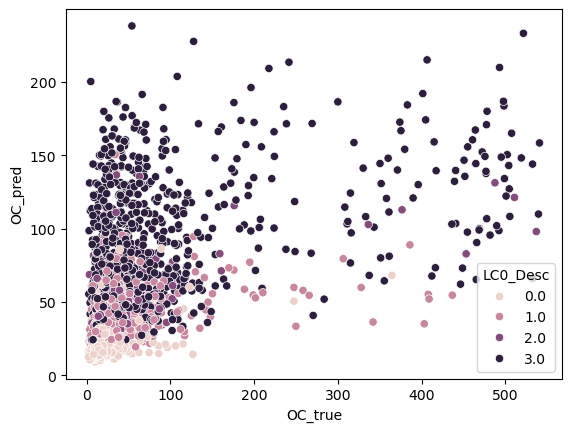

In [ ]:
sns.scatterplot(prediction_df, x='OC_true', y='OC_pred', hue='LC0_Desc')

## Feature Importance

## Recursive Feature Elimination

In [135]:
# Train RFE wrapper with XGBoost
rfe_model = XGBRegressor(**best_params, objective='reg:squarederror', random_state=42)
selector = RFE(estimator=rfe_model, n_features_to_select=10, step=1)
selector = selector.fit(X_train, y_train)

# Get selected feature mask and names
selected_mask = selector.support_
feature_names = X_train.columns.tolist()
selected_features = [name for name, keep in zip(feature_names, selected_mask) if keep]
print("✅ Selected features:", selected_features)

# Subset the data using .loc for DataFrames
X_train_selected = X_train.loc[:, selected_mask]
X_val_selected = X_val.loc[:, selected_mask]
X_test_selected = X_test.loc[:, selected_mask]

# Refit final model on selected features
final_model_selected = XGBRegressor(**best_params, objective='reg:squarederror', random_state=42, early_stopping_rounds=10,)
final_model_selected.fit(
    X_train_selected, y_train,
    eval_set=[(X_val_selected, y_val)],
    verbose=True
)


✅ Selected features: ['LC0_Desc', 'LU1_Desc', 'grazing', 'daylight_duration', 'soil_temperature_7_to_28cm_max', 'soil_moisture_0_to_7cm_mean', 'w2_mean_wind_gusts_10m_max', 'w2_mean_cloud_cover_max', 'w4_mean_cloud_cover_min', 'w4_mean_cloud_cover_max']
[0]	validation_0-rmse:0.55213
[1]	validation_0-rmse:0.54633
[2]	validation_0-rmse:0.54110
[3]	validation_0-rmse:0.53649
[4]	validation_0-rmse:0.53214
[5]	validation_0-rmse:0.52836
[6]	validation_0-rmse:0.52476
[7]	validation_0-rmse:0.52161
[8]	validation_0-rmse:0.51847
[9]	validation_0-rmse:0.51568
[10]	validation_0-rmse:0.51316
[11]	validation_0-rmse:0.51081
[12]	validation_0-rmse:0.50864
[13]	validation_0-rmse:0.50652
[14]	validation_0-rmse:0.50474
[15]	validation_0-rmse:0.50305
[16]	validation_0-rmse:0.50159
[17]	validation_0-rmse:0.50033
[18]	validation_0-rmse:0.49902
[19]	validation_0-rmse:0.49785
[20]	validation_0-rmse:0.49672
[21]	validation_0-rmse:0.49554
[22]	validation_0-rmse:0.49450
[23]	validation_0-rmse:0.49337
[24]	validat

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=1.0, device=None, early_stopping_rounds=10,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.05, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [141]:
# Get booster from your final model
booster = final_model.get_booster()
feature_names = X_train.columns.tolist()

# --- 1. Feature importances from XGBoost ---
# Raw importances
gain = booster.get_score(importance_type='gain')
weight = booster.get_score(importance_type='weight')

# Map f0, f1... to actual feature names
gain = {k: v for k, v in gain.items()}
weight = {k: v for k, v in weight.items()}

# Fill missing features with 0
all_features = set(feature_names)
gain = {f: gain.get(f, 0) for f in all_features}
weight = {f: weight.get(f, 0) for f in all_features}

# --- 2. Permutation importance (on validation set) ---
perm = permutation_importance(final_model, X_val, y_val, n_repeats=5, random_state=42, scoring='neg_root_mean_squared_error')
perm_imp = dict(zip(X_val.columns, perm.importances_mean))

# --- 3. RFE mask/rank (already computed earlier) ---
rfe_model = XGBRegressor(**best_params, objective='reg:squarederror', random_state=42)
rfe = RFE(estimator=rfe_model, n_features_to_select=10)
rfe.fit(X_train, y_train)
rfe_rank = dict(zip(X_train.columns, rfe.ranking_))
rfe_binary = {k: 1 if v == 1 else 0 for k, v in rfe_rank.items()}  # 1 if selected, 0 if not

# --- 4. Combine into DataFrame ---
# Create a DataFrame
df = pd.DataFrame({
    'Gain': pd.Series(gain),
    'Weight': pd.Series(weight),
    'Permutation': pd.Series(perm_imp),
    'RFE Selected': pd.Series(rfe_binary)
}).fillna(0)

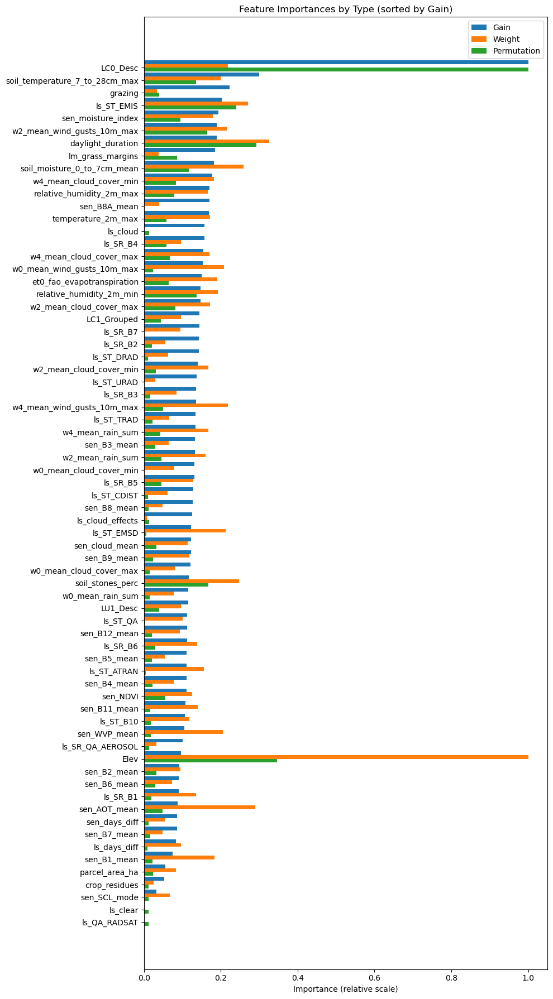

In [145]:
# Normalize each metric to 0–1 scale
scaler = MinMaxScaler()
df[['Gain', 'Weight', 'Permutation']] = scaler.fit_transform(df[['Gain', 'Weight', 'Permutation']])


# Sort by Gain
df = df.sort_values(by='Gain', ascending=False)

# --- 5. Plot ---
fig, ax = plt.subplots(figsize=(10, 18))
# fig.set_figheight(14)
bar_width = 0.3
index = np.arange(len(df))

# Plot each metric as a separate bar
ax.barh(index, df['Gain'], bar_width, label='Gain')
ax.barh(index + bar_width, df['Weight'], bar_width, label='Weight')
ax.barh(index + 2*bar_width, df['Permutation'], bar_width, label='Permutation')
# ax.barh(index + 3*bar_width, df['RFE Selected'], bar_width, label='RFE (1=kept)', color='grey')

# Axis config
ax.set_yticks(index + 1.5 * bar_width)
ax.set_yticklabels(df.index)
ax.invert_yaxis()
ax.set_xlabel('Importance (relative scale)')
ax.set_title('Feature Importances by Type (sorted by Gain)')
ax.legend()
plt.tight_layout()
plt.show()

In [ ]:
# FEATURE SELECTION
features = [
    'OC', 'N', 'point_id',

    'LC0_Desc', 'relative_humidity_2m_max','soil_stones_perc',
    'sr_B12_mean',
    'LU1_Desc',
    'w2_mean_wind_gusts_10m_max',
    'et0_fao_evapotranspiration',
    'w2_mean_cloud_cover_max',
    'soil_temperature_7_to_28cm_max',
    'sr_AOT_mean', # Feature 10
    'sr_B11_mean',
    'sr_B3_mean',
    'daylight_duration',
    'soil_moisture_0_to_7cm_mean',
    'w0_mean_wind_gusts_10m_max',
    'Elev',
    'temperature_2m_max',
    'ls_SR_B3',
    'w2_mean_cloud_cover_min',
    'w4_mean_wind_gusts_10m_max', # Feature 20
    'LC1_Grouped',
    'ls_ST_EMIS',
    'sr_WVP_mean',
    'sr_B5_mean',
    'w4_mean_cloud_cover_min',
    'sr_B1_mean',
    'sr_cloud_mean',
    'w4_mean_cloud_cover_max',
    's1_VV_mean',
    'ls_SR_B6', # Feature 30
    'sr_B9_mean',
    'sr_B8_mean',
    'sr_moisture_index',
    's1_VH_mean',
    'ls_SR_B4',
    'ls_ST_CDIST',
    'ls_ST_B10',
    'sr_B4_mean',
    'w4_mean_rain_sum',
    'w2_mean_rain_sum', # Feature 40
    'ls_ST_DRAD',
    'sr_B7_mean',
    'ls_ST_EMSD',
    'sr_B2_mean',
    'sr_B8A_mean',
    'sr_EVI',
    'sr_B6_mean',
    'relative_humidity_2m_min',
    'ls_ST_QA',
    'w0_mean_rain_sum', # Feature 50
    'ls_SR_B7',
    'ls_SR_QA_AEROSOL',
    'ls_ST_TRAD',
    'sr_NDVI',
    'ls_ST_ATRAN',
    'ls_SR_B2',
    'ls_ST_URAD',
    'ls_SR_B1',
    'ls_days_diff',
    'ls_SR_B5', # Feature 60
    # 'w0_mean_cloud_cover_max',
    # 'parcel_area_ha',
    # 'sr_days_diff',
    # 's1_days_diff',
    # 'w0_mean_cloud_cover_min',
    # 'grazing',
    # 'sr_SAVI',
    # 'lm_grass_margins',
    # 'crop_residues',


]

df = df[features]